In [76]:
import re
import nltk
import pickle
import numpy as np
import pandas as pd 
import matplotlib.pyplot as plt
# !python -m nltk.downloader stopwords wordnet punkt averaged_perceptron_tagger # remove if not running on colab
from nltk.corpus import stopwords
from nltk.corpus import wordnet as wn
from nltk.stem import WordNetLemmatizer
from keras.preprocessing.text import Tokenizer 
from keras.preprocessing.sequence import pad_sequences
from keras.layers import Input, LSTM, Embedding, Dense, Concatenate, TimeDistributed, Bidirectional
from tensorflow.keras.layers import Attention
from keras.models import Model, load_model
from keras.callbacks import EarlyStopping, ModelCheckpoint
from keras.preprocessing.text import Tokenizer 
from keras.preprocessing.sequence import pad_sequences
from keras.optimizers import RMSprop
from sklearn.model_selection import train_test_split
# !pip install rouge # remove if not running on colab
from rouge import Rouge

### Hyperparameters

In [77]:
BATCH_SIZE=40
EPOCHS=50
LATENT_DIM=256
EMBEDDING_DIM=128
TEST_TRAIN_SPLIT=0.15
LEARNING_RATE=0.005
PATH="../"
FILE_NAME="cnn-all.csv"
MAX_TEXT_LEN = 250
MAX_SUMMARY_LEN = 20
UNCOMMON_WORD_THRESHOLD = 0
COLAB=False # true if running on colab
build_number="1"

In [78]:
# create rouge object for evaluation
rouge = Rouge()

## Data Processing

Read In Data

In [79]:
# Only needed if running on Google Colab
if COLAB:
  from google.colab import drive
  drive.mount('/content/drive')
  PATH = "./drive/My Drive/"

In [80]:
df = pd.read_csv(PATH + FILE_NAME)
print(df.head())

   Unnamed: 0                                            file  \
0           0  42c027e4ff9730fbb3de84c1af0d2c506e41c3e4.story   
1           1  ee8871b15c50d0db17b0179a6d2beab35065f1e9.story   
2           2  06352019a19ae31e527f37f7571c6dd7f0c5da37.story   
3           3  24521a2abb2e1f5e34e6824e0f9e56904a2b0e88.story   
4           4  7fe70cc8b12fab2d0a258fababf7d9c6b5e1262a.story   

                                                text  \
0  LONDON England Reuters Harry Potter star Danie...   
1  Editors note In Behind Scenes series CNN corre...   
2  MINNEAPOLIS Minnesota Drivers Minneapolis brid...   
3  WASHINGTON Doctors remove five small polyp Pre...   
4  The National Football League indefinitely susp...   

                                             summary  
0  Harry Potter star Daniel Radcliffe gets 20M fo...  
1  Mentally ill inmates Miami housed forgotten fl...  
2  NEW I thought I going die driver says Man says...  
3  Five small polyps found procedure none worriso...

In [81]:
print(df.count)

<bound method DataFrame.count of        Unnamed: 0                                            file  \
0               0  42c027e4ff9730fbb3de84c1af0d2c506e41c3e4.story   
1               1  ee8871b15c50d0db17b0179a6d2beab35065f1e9.story   
2               2  06352019a19ae31e527f37f7571c6dd7f0c5da37.story   
3               3  24521a2abb2e1f5e34e6824e0f9e56904a2b0e88.story   
4               4  7fe70cc8b12fab2d0a258fababf7d9c6b5e1262a.story   
...           ...                                             ...   
92574       92574  e1fe287df99c17dff446cd0e814097b1784396a3.story   
92575       92575  0ac7adff1e1da0757f8ae1825872b0ac51236928.story   
92576       92576  1002ffb7a3bdaca4399f1c0f1774bd9ba31be097.story   
92577       92577  611b6133500989fb51cd81f280468f8d14f072e1.story   
92578       92578  8fa981f2a49b8833690e2ae82a5c37a89b5bbd31.story   

                                                    text  \
0      LONDON England Reuters Harry Potter star Danie...   
1      Editors not

Remove .'s that appear in stuff like U.S.A and U.N - Eventually need to move 
this to dataprocessing.py

In [82]:
print(df['summary'][0])
df['summary'] = df['summary'].apply(lambda x: re.sub(r'\..*$',' ',str(x)))
print(df['summary'][0])

Harry Potter star Daniel Radcliffe gets 20M fortune turns 18 Monday Young actor says plans fritter cash away Radcliffes earnings first five Potter films held trust fund
Harry Potter star Daniel Radcliffe gets 20M fortune turns 18 Monday Young actor says plans fritter cash away Radcliffes earnings first five Potter films held trust fund


In [83]:
print(df['summary'][0])
df['summary'] = df['summary'].apply(lambda x: re.sub(r'\.','',str(x)))
print(df['summary'][0])

Harry Potter star Daniel Radcliffe gets 20M fortune turns 18 Monday Young actor says plans fritter cash away Radcliffes earnings first five Potter films held trust fund
Harry Potter star Daniel Radcliffe gets 20M fortune turns 18 Monday Young actor says plans fritter cash away Radcliffes earnings first five Potter films held trust fund


Check for rows with null values in them, and copy these into a new dataframe (df1). Drop any rows in df1 from df to ensure no NaN valued rows are present

*Note. using simply dropna(how='any') does not seem to drop any of the rows*

In [84]:
print(df.isnull().values.any())
print(df.shape)

df1 = df[df.isna().any(axis=1)]
print(df1.shape)

df.drop(df1.index, axis=0,inplace=True)
print(df.shape)
print(df.isnull().values.any())

True
(92579, 4)
(114, 4)
(92465, 4)
False


Word Count Distribution

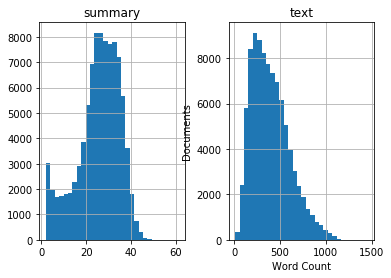

In [85]:
text_word_count = []
summary_word_count = []

# populate the lists with sentence lengths
for i in df['text']:
      text_word_count.append(len(i.split(' ')))

for i in df['summary']:
      summary_word_count.append(len(i.split(' ')))

length_df = pd.DataFrame({'text':text_word_count, 'summary':summary_word_count})

length_df.hist(bins = 30)
plt.ylabel('Documents')
plt.xlabel('Word Count')
# plt.savefig('word_count_distro' + str(build_number) + '.png')
plt.show()

Cut down text to MAX_TEXT_LEN words, and summaries to MAX_SUMMARY_LEN

In [86]:
print(df['text'][0])
df['text'] = df['text'].apply(lambda x: nltk.word_tokenize(x)).apply(lambda x: " ".join(x[:MAX_TEXT_LEN]))
print(df['text'][0])

print(df['summary'][0])
df['summary'] = df['summary'].apply(lambda x: nltk.word_tokenize(x)).apply(lambda x: " ".join(x[:MAX_SUMMARY_LEN]))
print(df['summary'][0])

LONDON England Reuters Harry Potter star Daniel Radcliffe gain access report 20 million 411 million fortune turn 18 Monday insists money wont cast spell Daniel Radcliffe Harry Potter Harry Potter Order Phoenix To disappointment gossip columnist around world young actor say plan fritter cash away fast car drink celebrity party I dont plan one people soon turn 18 suddenly buy massive sport car collection something similar told Australian interviewer earlier month I dont think Ill particularly extravagant The thing I like buying thing cost 10 pound book CDs DVDs At 18 Radcliffe able gamble casino buy drink pub see horror film Hostel Part II currently six place number one movie UK box office chart Details hell mark landmark birthday wrap His agent publicist comment plan Ill definitely sort party say interview Hopefully none reading Radcliffes earnings first five Potter film held trust fund able touch Despite grow fame rich actor say keep foot firmly ground People always look say kid star g

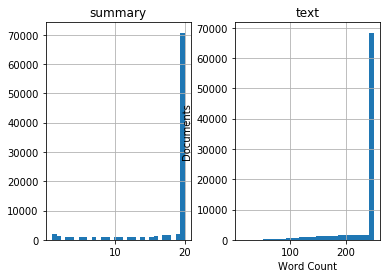

In [87]:
text_word_count = []
summary_word_count = []

# populate the lists with sentence lengths
for i in df['text']:
      text_word_count.append(len(i.split(' ')))

for i in df['summary']:
      summary_word_count.append(len(i.split(' ')))

length_df = pd.DataFrame({'text':text_word_count, 'summary':summary_word_count})

length_df.hist(bins = 30)
plt.ylabel('Documents')
plt.xlabel('Word Count')
# plt.savefig('word_count_distro_word_removal' + str(build_number) + '.png')
plt.show()

### Finding Uncommon Words and Removing Them.

Uncommon words are classified as those that occur in the whole corpus less times than UNCOMMON_WORD_THRESHOLD







#### Text

In [88]:
# x_word_dict = {}
# text = df['text'].apply(lambda x: nltk.word_tokenize(x))

# for index, row in text.iteritems():
#   for word in row:
#     if word not in x_word_dict.keys():
#       x_word_dict[word] = 1
#     else:
#       x_word_dict[word] += 1

# print(len(x_word_dict))
# # sort so that extracting acceptable words is more efficient for larger vocab sizes
# sorted_dict = sorted(x_word_dict.items(), key=lambda x: x[1], reverse=True)
# print(sorted_dict)
# x, y = zip(*sorted_dict)

In [89]:
# # find words that occur more than UNCOMMON_WORD_THRESHOLD times
# accept_words = []
# for word, occ in sorted_dict:
#   if int(occ) > UNCOMMON_WORD_THRESHOLD:
#     accept_words.append(word)
#   else:
#     break

# # remove uncommon words    
# accept_words = [x.lower() for x in accept_words]
# print(accept_words)
# print(df['text'][2])
# df['text'] = df['text'].apply(lambda x: nltk.word_tokenize(x)).apply(lambda x: " ".join([word for word in x if word.lower() in accept_words]))
# print(df['text'][2])


In [90]:
# x_word_dict_after = {}
# text = df['text'].apply(lambda x: nltk.word_tokenize(x))

# for index, row in text.iteritems():
#   for word in row:
#     if word not in x_word_dict_after.keys():
#       x_word_dict_after[word] = 1
#     else:
#       x_word_dict_after[word] += 1

# print(len(x_word_dict_after))

#### Summaries

In [91]:
# y_word_dict = {}
# summary = df['summary'].apply(lambda x: nltk.word_tokenize(x))

# for index, row in summary.iteritems():
#   for word in row:
#     if word not in y_word_dict.keys():
#       y_word_dict[word] = 1
#     else:
#       y_word_dict[word] += 1

# print(len(y_word_dict))
# sorted_dict = sorted(y_word_dict.items(), key=lambda x: x[1], reverse=True)
# print(sorted_dict)
# x, y = zip(*sorted_dict)

In [92]:
# accept_words = []
# for word, occ in sorted_dict:
#   if int(occ) > UNCOMMON_WORD_THRESHOLD:
#     accept_words.append(word)
#   else:
#     break
     
# accept_words = [x.lower() for x in accept_words]
# print(accept_words)
# print(df['summary'][2])
# df['summary'] = df['summary'].apply(lambda x: nltk.word_tokenize(x)).apply(lambda x: " ".join([word for word in x if word.lower() in accept_words]))
# print(df['summary'][2])

In [93]:
# y_word_dict_after = {}
# summary = df['summary'].apply(lambda x: nltk.word_tokenize(x))

# for index, row in summary.iteritems():
#   for word in row:
#     if word not in y_word_dict_after.keys():
#       y_word_dict_after[word] = 1
#     else:
#       y_word_dict_after[word] += 1
# print(len(y_word_dict_after))

View Word Distribution after uncommon word removal

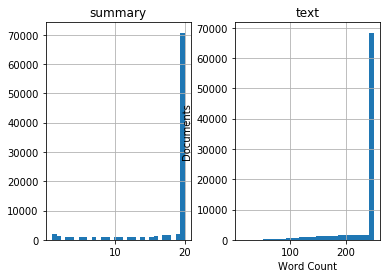

In [94]:
text_word_count = []
summary_word_count = []

# populate the lists with sentence lengths
for i in df['text']:
      text_word_count.append(len(i.split(' ')))

for i in df['summary']:
      summary_word_count.append(len(i.split(' ')))

length_df = pd.DataFrame({'text':text_word_count, 'summary':summary_word_count})

length_df.hist(bins = 30)
plt.ylabel('Documents')
plt.xlabel('Word Count')

# plt.savefig('word_count_distro_word_removal' + str(build_number) + '.png')
plt.show()

### Update Max Text Lenths After Uncommon Word Removal & Drop Empty Rows

In [95]:
print(df['text'][0])
df['text'] = df['text'].apply(lambda x: nltk.word_tokenize(x)).apply(lambda x: " ".join(x[:MAX_TEXT_LEN]))
print(df['text'][0])

LONDON England Reuters Harry Potter star Daniel Radcliffe gain access report 20 million 411 million fortune turn 18 Monday insists money wont cast spell Daniel Radcliffe Harry Potter Harry Potter Order Phoenix To disappointment gossip columnist around world young actor say plan fritter cash away fast car drink celebrity party I dont plan one people soon turn 18 suddenly buy massive sport car collection something similar told Australian interviewer earlier month I dont think Ill particularly extravagant The thing I like buying thing cost 10 pound book CDs DVDs At 18 Radcliffe able gamble casino buy drink pub see horror film Hostel Part II currently six place number one movie UK box office chart Details hell mark landmark birthday wrap His agent publicist comment plan Ill definitely sort party say interview Hopefully none reading Radcliffes earnings first five Potter film held trust fund able touch Despite grow fame rich actor say keep foot firmly ground People always look say kid star g

In [96]:
print(df['summary'][0])
df['summary'] = df['summary'].apply(lambda x: nltk.word_tokenize(x)).apply(lambda x: " ".join(x[:MAX_SUMMARY_LEN]))
print(df['summary'][0])

Harry Potter star Daniel Radcliffe gets 20M fortune turns 18 Monday Young actor says plans fritter cash away Radcliffes earnings
Harry Potter star Daniel Radcliffe gets 20M fortune turns 18 Monday Young actor says plans fritter cash away Radcliffes earnings


In [97]:
# update max text lengths
MAX_TEXT_LEN = max([len(txt.split(' ')) for txt in df['text']])
MAX_SUMMARY_LEN = max([len(txt.split(' ')) for txt in df['summary']])
print(MAX_TEXT_LEN)
print(MAX_SUMMARY_LEN)

250
20


In [98]:
# drop any lines that have no text or summary after the word removal process
print(df.isnull().values.any())
print(df.shape)

df1 = df[df.isna().any(axis=1)]
print(df1.shape)

df.drop(df1.index, axis=0,inplace=True)
print(df.shape)
print(df.isnull().values.any())

False
(92465, 4)
(0, 4)
(92465, 4)
False


### Add in start and end tokens to summaries
This is necessary to ensure that the model can tell when each summaries start and end

In [99]:
df['summary'] = df['summary'].apply(lambda x : 'sostok '+ x + ' eostok')
print(df['summary'].head())

0    sostok Harry Potter star Daniel Radcliffe gets...
1    sostok Mentally ill inmates Miami housed forgo...
2    sostok NEW I thought I going die driver says M...
3    sostok Five small polyps found procedure none ...
4    sostok NEW NFL chief Atlanta Falcons owner cri...
Name: summary, dtype: object


## Training-Validation Split

X - Articles text </br>
Y - Summaries

In [100]:
# convert to numpy array
X = np.array(df['text'])
Y = np.array(df['summary'])

In [101]:
x_tr,x_val,y_tr,y_val=train_test_split(X,Y,test_size=TEST_TRAIN_SPLIT,random_state=0,shuffle=True)
print(x_tr.shape)
print(x_val.shape)
print(y_tr.shape)
print(y_val.shape)

(78595,)
(13870,)
(78595,)
(13870,)


## Word Embeddings - Tokenization

X Tokenizer

In [102]:
word_dict = {}
text = df['text']

for row in text: 
  for word in row.split(" "):
    if word not in word_dict:
      word_dict[word] = 1
    else:
      word_dict[word] += 1

print(len(word_dict))

283947


In [103]:
#prepare a tokenizer for reviews on training data
x_tokenizer = Tokenizer(num_words=len(word_dict), split=" ") 
x_tokenizer.fit_on_texts(list(X))

#convert text sequences into integer sequences
x_tr_seq    =   x_tokenizer.texts_to_sequences(x_tr) 
x_val_seq   =   x_tokenizer.texts_to_sequences(x_val)

#padding zero upto maximum length
x_tr    =   pad_sequences(x_tr_seq,  maxlen=MAX_TEXT_LEN, padding='post')
x_val   =   pad_sequences(x_val_seq, maxlen=MAX_TEXT_LEN, padding='post')

#size of vocabulary ( +1 for padding token)
x_voc   =  x_tokenizer.num_words + 1
print(x_voc)

283948


In [104]:
with open('xtokenizer.pickle', 'wb') as handle:
  pickle.dump(x_tokenizer, handle, protocol=pickle.HIGHEST_PROTOCOL)

Y Tokenizer

In [105]:
y_word_dict = {}
summ = df['summary']

for row in summ: 
  for word in row.split(" "):
    if word not in y_word_dict:
      y_word_dict[word] = 1
    else:
      y_word_dict[word] += 1

print(len(y_word_dict))

88259


In [106]:
#prepare a tokenizer for reviews on training data
y_tokenizer = Tokenizer(num_words=len(y_word_dict), split=" ") 
y_tokenizer.fit_on_texts(list(Y))

#convert text sequences into integer sequences
y_tr_seq    =   y_tokenizer.texts_to_sequences(y_tr) 
y_val_seq   =   y_tokenizer.texts_to_sequences(y_val) 

#padding zero upto maximum length
y_tr    =   pad_sequences(y_tr_seq, maxlen=MAX_SUMMARY_LEN, padding='post')
y_val   =   pad_sequences(y_val_seq, maxlen=MAX_SUMMARY_LEN, padding='post')

#size of vocabulary
y_voc  =   y_tokenizer.num_words + 1
print(y_voc)
print(y_tokenizer.word_counts['sostok'],len(y_tr))

88260
92465 78595


In [107]:
with open('ytokenizer.pickle', 'wb') as handle:
  pickle.dump(y_tokenizer, handle, protocol=pickle.HIGHEST_PROTOCOL)

## Learning Model

#### Encoder Model

In [108]:
#encoder input
encoder_inputs = Input(shape=(MAX_TEXT_LEN,))
#embedding layer
enc_emb =  Embedding(x_voc,EMBEDDING_DIM,trainable=True)(encoder_inputs)
# bidirectional encoder lstm 
encoder_lstm = Bidirectional(LSTM(LATENT_DIM,return_sequences=True,return_state=True))
# outputs and encoder final states
encoder_outputs, fw_state_h, fw_state_c, bw_state_h, bw_state_c = encoder_lstm(enc_emb)

state_h = Concatenate()([fw_state_h, bw_state_h])
state_c = Concatenate()([fw_state_c, bw_state_c])
encoder_states = [state_h, state_c]

#### Decoder Model

In [109]:
# Set up the decoder, using `encoder_states` as initial state.
decoder_inputs = Input(shape=(None,))

#embedding layer
dec_emb_layer = Embedding(y_voc, EMBEDDING_DIM,trainable=True)
dec_emb = dec_emb_layer(decoder_inputs)

decoder_lstm = LSTM(LATENT_DIM*2, return_sequences=True, return_state=True)
decoder_outputs,decoder_fwd_state, decoder_back_state = decoder_lstm(dec_emb,initial_state=encoder_states)
                                                          
#dense layer 
#soft max creates a prob vector that allows us to determine the final output
decoder_dense = Dense(y_voc, activation='softmax')
decoder_outputs = decoder_dense(decoder_outputs)


#### Combined LSTM Model

In [110]:
# Define the model 
model = Model([encoder_inputs, decoder_inputs], decoder_outputs)

model.summary()

Model: "model_4"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_6 (InputLayer)            (None, 250)          0                                            
__________________________________________________________________________________________________
embedding_3 (Embedding)         (None, 250, 128)     36345344    input_6[0][0]                    
__________________________________________________________________________________________________
input_7 (InputLayer)            (None, None)         0                                            
__________________________________________________________________________________________________
bidirectional_2 (Bidirectional) [(None, 250, 512), ( 788480      embedding_3[0][0]                
____________________________________________________________________________________________

In [111]:
optimizer = RMSprop(lr=LEARNING_RATE, rho=0.9)

In [112]:
model.compile(optimizer=optimizer, loss='sparse_categorical_crossentropy')

- Early Stopping Callback to ensure we stop when Validation Loss is lowest - minimises risk of overfitting
- Model Checkpoint saves the model after each epoch so that we can load the model with the best weights later on. Alternatively, it allows us to continue training the model at a later data



In [113]:
es = EarlyStopping(monitor='val_loss', mode='min', verbose=1,patience=2, restore_best_weights=False)
filepath = "./model/saved-model-{epoch:02d}.hdf5"
if COLAB:
  filepath = PATH + "project-model/saved-model-{epoch:02d}.hdf5"
mc = ModelCheckpoint(filepath, monitor='val_loss', verbose=0, save_best_only=False, save_weights_only=False, mode='auto', period=1)

#### Use this  to train a new model. To continue training a previously trained model see below

In [114]:
# reshape y from two dimensions to three dimensions
y_tr_3d = y_tr.reshape(y_tr.shape[0],y_tr.shape[1], 1)[:,1:]
y_val_3d = y_val.reshape(y_val.shape[0],y_val.shape[1], 1)[:,1:]

In [115]:
print(x_tr.shape)
print(y_tr.shape)
print(y_tr_3d.shape)
print(x_val.shape)
print(y_val.shape)
print(y_val_3d.shape)

(78595, 250)
(78595, 20)
(78595, 19, 1)
(13870, 250)
(13870, 20)
(13870, 19, 1)


In [116]:
history = model.fit([x_tr,y_tr[:,:-1]], y_tr_3d, batch_size=BATCH_SIZE, epochs=EPOCHS, callbacks=[es,mc], validation_data=([x_val,y_val[:,:-1]], y_val_3d))

Train on 78595 samples, validate on 13870 samples
Epoch 1/50
78595/78595 [==============================] - 662s 8ms/step - loss: 7.3419 - val_loss: 7.0517
Epoch 2/50
78595/78595 [==============================] - 661s 8ms/step - loss: 6.9645 - val_loss: 7.0437
Epoch 3/50
78595/78595 [==============================] - 660s 8ms/step - loss: 6.9207 - val_loss: 7.0331
Epoch 4/50
78595/78595 [==============================] - 661s 8ms/step - loss: 6.6771 - val_loss: 6.9064
Epoch 5/50
78595/78595 [==============================] - 661s 8ms/step - loss: 6.3748 - val_loss: 6.8796
Epoch 6/50
78595/78595 [==============================] - 662s 8ms/step - loss: 6.0935 - val_loss: 6.8594
Epoch 7/50
78595/78595 [==============================] - 660s 8ms/step - loss: 5.7940 - val_loss: 6.8826
Epoch 8/50
78595/78595 [==============================] - 660s 8ms/step - loss: 5.5283 - val_loss: 7.0989
Epoch 00008: early stopping


#### This method is to only be used when loading a previously partially trained model

In [117]:
# model = load_model("./drive/My Drive/project-model/saved-model-53.hdf5")
# history = model.fit([x_tr,y_tr[:,:-1]], y_tr, callbacks=[mc], batch_size=BATCH_SIZE, epochs=1, validation_data=([x_val,y_val[:,:-1]], y_val))

### Plot training and validation loss overtime

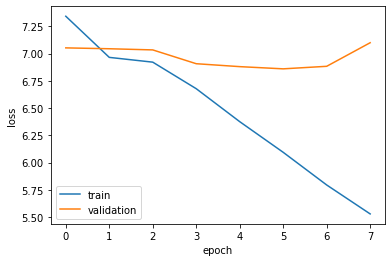

In [118]:
plt.plot(history.history['loss'], label='train')
plt.plot(history.history['val_loss'], label='validation')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend()
# plt.savefig('loss' + str(build_number) + '.png')
plt.show()

## Inference Model

In [119]:
# load model from drive
# model = load_model("./drive/My Drive/saved-model-53.hdf5")

In [120]:
reverse_target_word_index=y_tokenizer.index_word
reverse_source_word_index=x_tokenizer.index_word
print(reverse_source_word_index)
print(reverse_target_word_index)
# used to get positions of sostok and eostok
target_word_index=y_tokenizer.word_index

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [121]:
# Encode the input sequence to get the feature vector
encoder_model = Model(inputs=encoder_inputs,outputs=[encoder_outputs, state_h, state_c])

In [122]:
encoder_model.summary()

Model: "model_5"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_6 (InputLayer)            (None, 250)          0                                            
__________________________________________________________________________________________________
embedding_3 (Embedding)         (None, 250, 128)     36345344    input_6[0][0]                    
__________________________________________________________________________________________________
bidirectional_2 (Bidirectional) [(None, 250, 512), ( 788480      embedding_3[0][0]                
__________________________________________________________________________________________________
concatenate_3 (Concatenate)     (None, 512)          0           bidirectional_2[0][1]            
                                                                 bidirectional_2[0][3]      

In [123]:
# Decoder setup
# Below tensors will hold the states of the previous time step
decoder_state_input_h = Input(shape=(LATENT_DIM*2,))
decoder_state_input_c = Input(shape=(LATENT_DIM*2,))
decoder_hidden_state_input = Input(shape=(MAX_TEXT_LEN,LATENT_DIM*2))
decoder_state_inputs = [decoder_state_input_h, decoder_state_input_c]

# Get the embeddings of the decoder sequence
dec_emb2= dec_emb_layer(decoder_inputs) 
# To predict the next word in the sequence, set the initial states to the states from the previous time step
decoder_outputs2, state_h2, state_c2 = decoder_lstm(dec_emb2, initial_state=decoder_state_inputs)
decoder_states = [state_h2, state_c2]
# A dense softmax layer to generate prob dist. over the target vocabulary
decoder_outputs2 = decoder_dense(decoder_outputs2) 

# Final decoder model
decoder_model = Model([decoder_inputs] + [decoder_hidden_state_input,decoder_state_input_h, decoder_state_input_c], [decoder_outputs2] + decoder_states)

In [124]:
decoder_model.summary()

Model: "model_6"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_7 (InputLayer)            (None, None)         0                                            
__________________________________________________________________________________________________
embedding_4 (Embedding)         (None, None, 128)    11297280    input_7[0][0]                    
__________________________________________________________________________________________________
input_8 (InputLayer)            (None, 512)          0                                            
__________________________________________________________________________________________________
input_9 (InputLayer)            (None, 512)          0                                            
____________________________________________________________________________________________

### Methods for Reversing Word Embeddings

In [125]:
def seq_to_text(input_seq, summary):       
  textString=''
  if not summary:
      for i in input_seq:
          if(i!=0):
              textString = textString + ' ' + reverse_source_word_index[i]
  else:
      for i in input_seq:
          if((i!=0 and i!=target_word_index['sostok']) and i!=target_word_index['eostok']):
              textString = textString + ' ' + reverse_target_word_index[i]
  return textString 

### Summarisation Method 

In [126]:
def decode_sequence(input_seq):
    # Encode the input as state vectors.
    e_out, e_h, e_c = encoder_model.predict(input_seq)
    # Generate empty target sequence of length 1.
    target_seq = np.zeros((1,1))
    # Populate the first word of target sequence with the start word.
    target_seq[0, 0] = target_word_index['sostok']
    stop_condition = False
    decoded_sentence = ''

    while not stop_condition:
        output_tokens, h, c = decoder_model.predict([target_seq] + [e_out, e_h, e_c])
        # Sample a token
        sampled_token_index = np.argmax(output_tokens[0, -1, :])
        sampled_token = reverse_target_word_index[sampled_token_index]
        
        if(sampled_token!='eostok'):
            decoded_sentence += ' '+sampled_token

        # Exit condition: either hit max length or find stop word.
        if (sampled_token == 'eostok'  or len(decoded_sentence.split()) >= (MAX_SUMMARY_LEN-1)):
            stop_condition = True

        # Update the target sequence (of length 1).
        target_seq = np.zeros((1,1))
        target_seq[0, 0] = sampled_token_index
        # Update internal states
        e_h, e_c = h, c

    return decoded_sentence

## Test Model Output

In [127]:
def getRouge(gt, pred):
  return rouge.get_scores(pred, gt)

In [128]:
for i in range(0,10):
    print("----------------------")
    article = seq_to_text(x_tr[i], False)
    original = seq_to_text(y_tr[i], True)

    if (original !=""):
      print("Article: " + article)
      print("Original summary:", original)
      # reshape data into correct format for encoder (1, max_text_len)
      x_tr_i_reshaped = x_tr[i].reshape(1,MAX_TEXT_LEN)
      summary = decode_sequence(x_tr_i_reshaped)
      print("Generated summary:",summary)
      print("\n")

      if summary != "":    
          print("ROUGE score: ")
          score = getRouge(str(summary), str(original))
          print(score)
          print(score[0].get('rouge-1').get('f'))
          print(score[0].get('rouge-1').get('p'))
          print(score[0].get('rouge-1').get('r'))

----------------------
Article:  hundreds russians hit street moscow sunday rally promote peace equality response rash ethnic violence unrest staterun medium report the moscow everyone demonstration pushkin square drew 1500 participant accord ria novosti people come intend put event occur moscow december 11 15 say viktor shenderovich one event organizer i believe riot moscow cause pu burst police officer set metal detector around square check knife weapon bid avoid repeat street violence earlier month the turmoil begin southern moscow death yegor sviridov 28 kyrgyzstan migrant authority say kill brawl migrant russias north caucasus region december 6 five day later 5000 nationalist football hooligan clashed moscow police unsanctioned nationalisttinged mass memorial fellow supporter turn violent accord state medium the confrontation take place manezh square outside kremlin lead arrest 65 spartak moscow fan disobedience moscow police spokesman viktor biryukov say accord official russian n

Generated summary:  the 50th anniversary end tribute end tribute singer mary kennedy cowrote lifetime achievement died


ROUGE score: 
[{'rouge-1': {'f': 0.0, 'p': 0.0, 'r': 0.0}, 'rouge-2': {'f': 0.0, 'p': 0.0, 'r': 0.0}, 'rouge-l': {'f': 0.0, 'p': 0.0, 'r': 0.0}}]
0.0
0.0
0.0
----------------------
Article:  hong kong for majority people west banking easy walk local branch atm log account computer but million develop country even bank account reach in india least could change vodafone india icici bank indias large private bank launch mpesa mobilebased money transfer payment service first establish kenya 2007 the partnership announce news release april 17 claim give mobilebanking access 700 million indian people currently unbanked people access conventional banking service like bank branch atms vodafone say service first rollout indias eastern region include kolkata west bengal 8300 agent that part india home 220 million people service eventually extend across rest country the mpesa s

In [129]:
for i in range(1243,1253):
    print("----------------------")
    article = seq_to_text(x_tr[i], False)
    original = seq_to_text(y_tr[i], True)

    if (original !=""):
      print("Article: " + article)
      print("Original summary:", original)
      # reshape data into correct format for encoder (1, max_text_len)
      x_tr_i_reshaped = x_tr[i].reshape(1,MAX_TEXT_LEN)
      summary = decode_sequence(x_tr_i_reshaped)
      print("Generated summary:",summary)
      print("\n")

      if summary != "":    
          print("ROUGE score: ")
          score = getRouge(str(summary), str(original))
          print(score)
          print(score[0].get('rouge-1').get('f'))
          print(score[0].get('rouge-1').get('p'))
          print(score[0].get('rouge-1').get('r'))

----------------------
Article:  there news make headline and personal story make last impact people touch life million this year cnn invite people share personal essay world deliver dozens ireporters courage pour heart unforgettable story pain loss joy courage anger many publish cnncom parenting huge topic year gun control frustration government also people mind as 2013 come close here look back best story receive people share the mother raise kid without religion deborah mitchell stir intense debate cnncom early january post seven reason i raise child without god readers disagreed view flag ireport inappropriate many time put note ask people stop mitchell mother two teenager texas say simply want people stop fear atheist i want religion go away write i want child free believe her story drew comment ireport story date result book contract mitchell her memoir growing up godless a parents guide raising kids without religion come spring the woman whose son taught oscar pistorius man cynt

Generated summary:  bank robber earned estimated 1


ROUGE score: 
[{'rouge-1': {'f': 0.0, 'p': 0.0, 'r': 0.0}, 'rouge-2': {'f': 0.0, 'p': 0.0, 'r': 0.0}, 'rouge-l': {'f': 0.0, 'p': 0.0, 'r': 0.0}}]
0.0
0.0
0.0
----------------------
Article:  journalists cover last week economic summit overheard french president nicolas sarkozy blasting israeli prime minister benjamin netanyahu liar talk us president barack obama accord publish report the private conversation inadvertently carry open microphone obamasarkozy news conference sideline group 20 economic summit french resort cannes its content first report french website arret sur images say reporter heard sarkozys comment french obamas reply translator i cant stand hes liar sarkozy say netanyahu accord website obama reply youre tire i deal every day site report arret sur images freeze frame say journalist listen conversation agree report the reuters associated press news service confirm report tuesday we didnt record use would force us ad

## Evaluation

Using ROUGE (Recall-Orientated Understanding Gisting Evaluation) to evaluate the generated summaries.

*Note: This takes a long time, especially with large datasets* 

### For Training Data

In [130]:
print(len(x_tr))

78595


In [131]:
tr_target_summary = []
tr_generated_summary = []
x_tr_len = len(x_tr)

f_ov = 0
p_ov = 0
r_ov = 0
# x_val_len = 1
for i in range(0,x_tr_len):
  print(i)
  original = seq_to_text(y_tr[i], True)
  if original != "" :
      tr_target_summary.append(original)
      x_i = x_tr[i].reshape(1,MAX_TEXT_LEN)
      summary = decode_sequence(x_i)
      print(i)
      print(original)
      print(summary)
      print("-----")
      if summary != "":
          tr_generated_summary.append(summary)
          score = getRouge(str(summary), str(original))
          f_ov += float(score[0].get('rouge-1').get('f'))
          p_ov += float(score[0].get('rouge-1').get('p'))
          r_ov += float(score[0].get('rouge-1').get('r'))

0
0
 1500 people attend moscow everyone rally staterun media reports the event aimed promote peace several incidents violence the turmoil
 protesters gather rally streets rally outside streets st
-----
1
1
 airplane carrying 14 people crashed mountains north sumatra air official says the flight bound aceh province crashed two children
 the plane carrying 40 land recovered mount merapi believed first place near
-----
2
2
 forget write captions backs photos toss bad duplicate pictures put rest boxes albums photos one topic one trip store
 photo shows signs
-----
3
3
 new york fashion week runs thursday february 19 expect bespoke tailoring cinched waists 1970s vibes
 the list includes american horror stories footsteps wore night
-----
4
4
 an ohio woman suffered gunshot wound first u
 new about 50 patients treated hospital says doctors treated malnutrition patients says dr
-----
5
5
 daniel yellin
 jason rezaian pakistans high school teacher would allowed sex assault iraq also sued
-----


46
 single man jim friel often faces innately hostile question why single he asks why confirmation sexuality thrall tyranny coupledom
 michelle duggar angry american politics diversity diversity diversity says candidates say diversity
-----
47
47
 afghans say u
 new the u
-----
48
48
 found 1000 important documents paolo gabrieles possession among original documents signed pope benedict xvi many newspaper clippings printouts touched
 the rev
-----
49
49
 some gop slam obama mh17 reaction say reagan better 1983 korea crash lz reagan went horseback riding took 4
 obama says hes confident u
-----
50
50
 adebolajo believes didactic power violence writes alexander meleagrouhitchens this murder calm calculated effort writes meleagrouhitchens adebolajos act seen light
 frida ghitis the attack islamic islamic law would bring back he says u
-----
51
51
 biggest arts festival world runs august 226 edinburgh scotland female comedians globe come perform a mixture household names upandcomers
 ew sa

89
 seated courtroom began talking loudly campaign finance reform spectator outbursts rare supreme court the justices ignored incident man led
 the supreme court upheld decide whether file complaint filed the ruling follows case overturned ban unconstitutional
-----
90
90
 nightcrawler appears edge ouija no
 the sixth seed attracted 10 million copies highest level
-----
91
91
 husain died london hospital his indias celebrated artist his works fetched millions dollars but came attack hindu nationalists
 the british open olympics london olympics india raised funds
-----
92
92
 indian prime minister narendra modi visiting united states india u
 india pakistan meet discuss countrys economic crisis india pakistan india
-----
93
93
 minister says militants attacked police hq causing police casualties putin says tried persuade poroshenko resolve crisis peaceful means speaker
 new ukraines interim interim pm says ceasefire u
-----
94
94
 polls show ebola significant interest americans newt gin

137
 tumblr random humorous win day top blogs include pictures kids crying silly reasons actresses teeth humans new york poignant
 the world cup final time celebrate anniversary medal freedom earth
-----
138
138
 tv debates arrived uk 2010 broadcasters keen repeat headtohead format runup 2015 poll but factional politics arguments invited may
 julian zelizer says goals david race defeat american politics but likely take part u
-----
139
139
 mourning appear eduardo campos campaign website campos well known politician presidential candidate died plane crash a cessna taking campaign
 new presidentelect francois hollande says hes confident u
-----
140
140
 one chinas promising badminton players ended amid olympic scandal yu yang announced quitting sport badminton world federation disqualified seven
 world no
-----
141
141
 uncovered cnn show 40 million donations guatemala yet sign donations poor central american country any charity spends even million
 diego godins johnson paid donations p

182
 intelligence minister met french delegation spokesman says wsj israel used information obtained try undercut support deal these allegations utterly
 new report says iran doesnt want step u
-----
183
183
 opeke chief executive nigerias main one cable company she says firm laid first subsea cable linking west africa europe
 india become major africas presence africa the african nation aiming become africas diversity
-----
184
184
 holly hill says women negotiate infidelity husbands she sought sugar daddies pay 1000 per week company sex hill says
 writers women often believe women need money laundering sex abuse u
-----
185
185
 djokovic wins wimbledon title second time beats seventime champion roger federer five sets federer took opening set serbian opponent
 roger federer beats andy roddick straight sets australian open federer beaten 76 76 76 76 76 76
-----
186
186
 senate approves bill expanding hate crimes law measure would make crime assault person sexual orientation religious 

228
 week coincides anniversary elvis presleys death august 16 1977 the week kicks tupelo mississippi singer born elvis memphis home
 the rock roll hall fame february 5
-----
229
229
 u
 north korea meet discuss sanctions nuclear program south korea discussed sanctions u
-----
230
230
 zelizer new tv show may add nostalgia 1980s he says era one fundamentally shaped world live today zelizer from
 frida ghitis what happens like many fans need money he says generation
-----
231
231
 u
 new mandela mandelas condition battling mandela mandela mandela returned south africa
-----
232
232
 unveil first a350 xwb full passenger cabin test flight people board take place later year company states track deliver
 nasa launched drone strike commercial flights the aircraft carrier hamid karzai
-----
233
233
 award goes anonymous uploader video showing iran protesters death newly released footage president kennedys 1963 arrival dallas texas revealed
 frida ghitis putin says u
-----
234
234
 foreign off

270
 man builds man cave loses 65 pounds process of man cave tales submitted ireport
 the walking dog leg santa barbara california california the
-----
271
271
 a man dies setting afire alexandria an incident cairo appears spurred personal issue the protests tunisia sparked man torched
 new interim interim prime minister says interim prime minister says mubarak resigned tv network
-----
272
272
 anchor megyn kelly causes uproar says santa white timothy stanley can discuss something real please he says issues dont
 michael j
-----
273
273
 joel kotkin predicts majority nation nonwhite suburbs become economic centers country instead cities despite current situations kotkin says americas
 cnns christiane amanpour gives convention opportunity learn words u
-----
274
274
 new after vote governor says fix beginning u
 new gov
-----
275
275
 reportedly taken former british prime minister auctioned march 12 dukes auction house says blood taken hospital stay 1962 nurse
 the british open letter 

310
 nation member annette millers new motto life comparison there fine line inspiration comparison says miller comparing others makes objectivity
 richard luther king jr
-----
311
311
 anthony cordesman tension u
 new irans nuclear program begins iranian nuclear program the united states wants u
-----
312
312
 petersons mother scott peterson right blog prison scott peterson convicted deaths laci unborn child sharon rocha doesnt spend lot
 richard lee rigby caused blunt shock
-----
313
313
 kerry kennedy daughter late sen
 dr
-----
314
314
 turkish prime minister says florida pastor test regarding islamophobia sporadic protests burning take place afghanistan israeli prime minister says
 new at least 50 children attend funeral procession new the u
-----
315
315
 remote villages southern philippines swim school families cant afford second boat ferry children class foundation supported social networks started
 children families need help families need help families need help families need

352
 fire campaign office iranian president mahmoud ahmadinejad two adults child wounded attack ahmadinejad present attack happened near shia mosque
 iranian iranian blasts kill iranian staterun media says iranian president mahmoud ahmadinejad youngest person ahmadinejad
-----
353
353
 pain newtown felt every corner every store every church it idyllic new england town rolling hills town green 100foot
 more 10000 students parents schools communities the nonprofit formed local schools schools closed doors about 10000 students
-----
354
354
 new york police obtain search warrant boys 1979 disappearance case rosemary hernandez lawyer she feels strongly confession unreliable pedro
 police say police identify disappearance dr
-----
355
355
 florida governor last week rejected 2
 the strike strike strike strike strike strike strike strike strike strike strike strike
-----
356
356
 compare obama kennedy terms charisma popularity the kennedy limo represents innocent less anxietyridden time hist

395
 basnet revealed sunday night 2012 cnn hero year basnet supports children nepal dont live behind bars parents for named
 michelle duggar expects life career began career
-----
396
396
 about 4 6 u
 more 1
-----
397
397
 tanzanian leaders threaten evict maasai community create conservation corridor more 60000 tanzanian maasai live 4000 sq
 dutch houses destroyed home central african republic congo 2004 highest cross country ever
-----
398
398
 voted fifa world player year european player year he also represented portugal world european finals ronaldo signed manchester united
 fifa world player year fifa world player year fifa world player year fifa world player year fifa
-----
399
399
 2013 startup world competitive fragmented fast moving internetenabled devices wearable tech hot trends motion control new ways interacting computers
 tech startups discuss innovation innovation innovation innovation innovation technology u
-----
400
400
 three people dead least 84 injured earthquake h

441
 mcrae lived 22 different homes abandoned parents in one house accidentally shot caretakers grandson mcrae eventually adopted plans help
 dr
-----
442
442
 witness says one touched actress inappropriately nypd says bynes squeakyclean teen image the actress sloughs cops account says pot
 new police chief says detective detective the actress also target alleged sexual assault
-----
443
443
 second day war games dubbed great prophet six iran announced monday built first ballistic missile silos iran aired video
 irans iranian nuclear program begins iranian iranian flag the iranian previously watched iran irans nuclear program
-----
444
444
 supermodel natalia vodianova runs naked heart foundation her dream foundation build 500 play parks across russia the love ball
 rugby sevens world cup olympics 2016 olympics 2016 olympics 2016 olympics 2016 olympics 2016 olympics 2016
-----
445
445
 banned uefa competitions financial irregularities la liga side last 16 seasons champions league compe

486
 searches administrative accounts resident deans college says looking source leak amid cheating scandal news search draws immediate criticism members
 new some students remain board investigate allegations involving police chief says no
-----
487
487
 ozolins carried latvian flag sochi games won 1996 stanley cup colorado avalanches played total 875 nhl games scoring 167
 bob jones thanks fans compete games hope u
-----
488
488
 champion andy murray beaten bulgarias grigor dimitrov dimitrov crushes briton 61 76 62 quarterfinal clash centre court bulgarian face
 andy murray beats andy murray australian open the defending champions defending champion petra kvitova second round
-----
489
489
 more countries meet opposition william hague says britain seeking step pressure syria foreign secretary says hague urges opposition groups
 the u
-----
490
490
 metal detectorist found treasure field staffordshire england hoard described largest ever found including 1500 pieces value find said pri

531
 district attorneys association only 13 killings past 100 years two prosecutors killed one texas county recently law enforcement memorial
 the case involves federal funding law enforcement florida law enforcement official says federal judge ruled
-----
532
532
 the ids 30 u
 new taliban spokesman says karzai says karzai says u
-----
533
533
 tigers shut as advance american league championship series new baltimore edges new york 13 innings force deciding game monday
 roger goodell kevin hart win record final season opener u
-----
534
534
 u
 new pakistani taliban claim responsibility killing u
-----
535
535
 ohio state fire marshal investigators ruled criminal intent death toll comes earlier reports 65 two men died still unidentified
 new the victims identified victims family says the victims identified robert f
-----
536
536
 rossi pole french motogp le mans rossi edges yamaha teammate jorge lorenzo final qualifying dani pedrosa third grid 150th
 sebastian vettel wins first time th

571
 perpetrators include 2 3 americans 1 british woman kenyas foreign minister says the americans 18 19 somali origin said
 alshabaab claims responsibility attack u
-----
572
572
 world champion jorge lorenzo beats compatriot dani pedrosa pole position jerez americas nicky hayden third fastest ducati englands cal
 world no
-----
573
573
 invented cube bears name teaching aid class students the colorful puzzle gone become worlds biggest selling toy 350 million
 scientists say theyve tested positive cocaine un forest lawn western nations offer school
-----
574
574
 residents milford texas evacuate oil pipeline exploded chevron oil company requested evacuation long oil still burning the company concerned
 new about 40 homes damaged fire burned the fire started two weeks ago gov
-----
575
575
 2013 turkish children would chant national oath school says elif shafak its wording made query place separate collective self
 the girls parents upset religious freedom expression religious freedom 

617
 charles walker ordered held without bond sent back prison walker joseph jenkins used forged documents walk prison authorities say
 the victim identified victim 7
-----
618
618
 aspca pays 9
 new the lawsuit filed lawsuit claims paid 1 million damages the former
-----
619
619
 adjaye architect born tanzania although lives works london says africa remains source inspiration he recently designed buildings uk italy
 british artist attending ceremony held paris st
-----
620
620
 new the u
 new u
-----
621
621
 barker urges passage traveling exotic animal protection act in capitol hill news conference tells violence used train animals animal
 about 1
-----
622
622
 leeson recently appeared uk morning show she says often bullied according itv cost relationship
 the walking xvi returns boston marathon march 2014 the pair tweets good thing
-----
623
623
 annual crime victimization survey shows 13 drop violent crimes the justice department says sharp drop simple assaults the departments
 ne

663
 coast guard the fuel line ran engine fuel tank there indication leak intentional coast guard official says the crew
 new guard captain fired captain south korea ship hit fire two weeks ago n
-----
664
664
 u
 u
-----
665
665
 an opposition group reports 96 people killed across syria saturday russias foreign minister says alternative peace plan the opposition
 new u
-----
666
666
 happen time although often comes ascent descent 64 serious injuries resulting turbulence occurred since 2007 according faa figures staying
 new u
-----
667
667
 prince told newspaper u
 prince william kate middleton prince george leave u
-----
668
668
 ivan watson toured typhoondevastated region air destructive power storm surge apparent around city tacloban seen air forests palm trees
 new weather weather warning effect parts region seems worse typhoon haiyan u
-----
669
669
 family says zachary reyna receiving drugs kali hardig arkansas girl rehab fair condition hospital says both reyna hardig contracte

706
 new exoskeleton allows operators lift heavy tools weightless called fortis developed lockheed martin attracted interest u
 new u
-----
707
707
 the volume illegal robocalls increasing u
 new report finds increase number farmers insurance companies use u
-----
708
708
 mcilroy misses cut european tours pga championship wentworth mcilroy slumps second round sevenover 79 west course luke donald joint
 rory mcilroy tiger woods shoots sixunder 66 mcilroy mcilroy mcilroy tiger woods mcilroy mcilroy mcilroy mcilroy mcilroy mcilroy
-----
709
709
 mcbride drops 11th album today the singer taking reins writing material she says latest project less pop past albums
 chris christie directed label write poem apology book shows creator
-----
710
710
 famous author o
 author j
-----
711
711
 million bounty sent text message sheriffs office said threat originated mexico sheriffs spokeswoman says sheriff joe arpaio said hes
 new michael brewer linked killing 1
-----
712
712
 obama vows never questi

748
 boe carsten mogensen danish badminton doubles pair they silver london 2012 olympics string titles name boe still gets asked
 chris pratt wins mens 100m gold medal horse racing record label st
-----
749
749
 camp lemonier american military base african continent the 1800 u
 army maj
-----
750
750
 ibrahim prize winners receive 5 million 200000 year life committee pedro verona pires reformed cape verdes government economy pires
 india colombia singapore begins april 2014 olympics 2014 rio de janeiro state cnn
-----
751
751
 united nations foundations shot life campaign promotes childhood vaccines 1
 more 1 million people born u
-----
752
752
 previewed new mac pro desktop computer monday the new design striking offers fewer options expansion for creatives switch machine
 tech startups begin 2014
-----
753
753
 the northrop grumman foundation sending teachers zerogravity plane flights they hope experience help teachers inspire students love science u
 tech foundation provides free co

790
 complaint says tolls reasonable lawsuit also says drivers paying rebuilding world trade center port authority says suit without merit
 new bp chairman says new safety measures would allow owners owners
-----
791
791
 monica lewinsky joined twitter monday
 former president barack obama hollande speaking twitter account she also tweets account former cia
-----
792
792
 indian town painted pink 1853 celebrate visiting prince kept color a south african community celebrated end apartheid color in
 the hobbit festival takes place earth st
-----
793
793
 wozniacki wins first title year luxembourg open the dane thanks dog bruno victory speech bulgarian grigor dimitrov wins first
 tiger woods wins first title world no
-----
794
794
 wii fit setup doesnt take much space board eyesore wii fit calculates body mass index bmi metric many doctors
 scientists say theyve tested positive madrid
-----
795
795
 papal representatives stress benedicts u
 new pope benedict xvi meets u
-----
796
796
 zim

834
 adds much weight branches power lines a 1998 ice storm northern new england caused billion dollars damage if get
 new winter weather warning snow ice ice ice ice freezing rain could see snow ice ice freezing rain
-----
835
835
 goals manucho flavio helped hosts angola move top africa cup nations group a 20 victory malawi thursday
 goals penalty cameroon guinea beat cameroon guinea shock 20 years africa cup nations opener d
-----
836
836
 yeun portrays fan favorite glenn the walking dead the hit amc series began third season yeun promises even gruesome
 the walking dead twice hit sunday night live horror story late dr
-----
837
837
 u
 secretary state hillary clinton says hell meet discuss economic crisis haiti haiti earthquake u
-----
838
838
 scullion outlived doctors expectations he rare disease called progeria causes age prematurely a clinical trial new drug researchers optimistic
 dr
-----
839
839
 singer posted blog entry u2s site he involved bicycle crash november he said he

879
 many airlines offer passenger chance blind bid upgrade iberia latest airline offer customers chance via online auction
 super bowl xlviii gives chance chance make money airline
-----
880
880
 senior gets yearlong suspension hugging teacher wgcl reported video shows student hugging teacher teacher pushing away district a students
 new schools colleges stands 40 says schools colleges schools closed thursday night bullying schools consider
-----
881
881
 dzhokar tsarnaev hides covered boat watertown backyard boat owner david henneberry notices section loose tarp one bindings cut henneberry
 new the boston marathon bombings trial delayed nearly 200000 people remain across u
-----
882
882
 says wife left phone car the actor wages onesided war words journalist story the story alleges baldwins wife tweeting
 new michael jackson tweets mandela unknown celebrities
-----
883
883
 bus skidded jammusrinagar highway army helicopters used take injured hospitals police say poor road conditions o

922
 catching fire made 110
 the hobbit earned estimated 10 million box office frozen 6
-----
923
923
 lomong former lost boy sudan runs team usa lomong spent 10 years life refugee camp kenya he relocated united
 the u
-----
924
924
 singer discusses malmo groups adopted hometown the band moved southern swedish city particular sound says persson talks bigger freedom
 music festival begins place december 1
-----
925
925
 deathly hallows grossed 20
 the hobbit earned estimated 50
-----
926
926
 five italian tourists bologna pilot sightseeing copter believed dead bodies two adults helicopter found water authorities say authorities find
 new search continues hear debris debris debris debris debris near cause search
-----
927
927
 received internal memo markings planes southwest working local federal officials find vandals sources tell local media markings appear arabic
 the faa says would need take part faa says the airline says rep
-----
928
928
 sinofskys documentaries covered range topi

964
 tony scott died sunday apparent suicide scott behind many boxoffice hits including top gun enemy state though known action
 the film stars chris christie directed film andy murray cast the movie stars chris christie cast
-----
965
965
 mahmoud egyptian rapper rose fame appearing arabs got talent she refuses accept women egypt must subservient men last week
 a arab spring march 9
-----
966
966
 cupp celebrities boycotting beverly hills hotel owned brunei sultans investment group cupp brunei sharia law celebs happy make repressive
 the book explores relationship islam the author says author says author says author
-----
967
967
 meets world spinoff girl meets world makes longawaited debut show creator says fans 90s original wont disappointed but confident
 the singer tweeted angry retiring 8 years ago twitter fans discussed social media
-----
968
968
 a new film the blind side tells inspirational story hope caring says ruben navarrette jr
 the film based dr
-----
969
969
 katsav pul

1008
 village kogelo birthplace president obamas father in 2008 village celebrated obama mania barack obamas win put kogelo map now
 obama promised run president barack obama visit africa
-----
1009
1009
 ice cube lost paul walker vin diesel he told usa today kevin hart robbed he says hes sore loser
 steven tyler moore late show host he says hes leaving american idol
-----
1010
1010
 about 30 soldiers fired several hundred shots military official says new the man ignored repeated warnings turn back says
 new south korea says fired u
-----
1011
1011
 planned harm school outside atlanta georgia tipster said police find gun bathroom ceiling arrest 17 15yearold other weapons marijuana
 new police chief says suspect shot leg school teacher said saw teen suspect shot suspect
-----
1012
1012
 bodies found western libya human rights watch reports officials see heavy resistance bani walid fighting east sirte negotiations end
 new libyan rebel leader moammar gadhafi continues libya libya freed m

1053
 divers find body dawn marie fital 45 she missing since monday boyfriend greg noack taken custody
 police say body found body parts found near home a note appears determine caused
-----
1054
1054
 naturaloccuring chemical formaldehyde listed known human carcinogens glass wool fibers styrene used styrofoam reasonably anticipated human carcinogens the report
 u
-----
1055
1055
 ostrow says 2010 brought gray areas wikileaks privacy issues he says new rules internet access proposed track registry loom
 the internet campaign focused promote right freedom internet
-----
1056
1056
 week ago house speaker boehner said wanted try act immigration on thursday boehner said wouldnt happen year trust gap
 rep
-----
1057
1057
 former world no
 roger federer beats andy roddick straight sets australian open semis nadal also target swiss indoors tournament
-----
1058
1058
 new safety measures imposed fraternities sororities university virginia fraternities must designate sober brothers every party 

1098
 storm alexa brought snow rain lebanons bekaa valley region home thousands people fled civil war syria one every four
 thousands syrians flee homes destroyed homes
-----
1099
1099
 raids target four villages borno state boko haram islamists suspected attacks predominantly christian areas more 300 structures including five
 new delhi boko haram blamed boko haram attack boko haram
-----
1100
1100
 alshabaab alqaedalinked militant group based somalia it claimed responsibility deadly attack kenyan mall september 2013 the group recruited americans
 alshabaab claims responsibility attack u
-----
1101
1101
 new u
 new the rev
-----
1102
1102
 kehoe slashed sons throats left dead tried kill prosecutor says iowa jury hears tape surviving boy telling police mother
 police identify suspect terry jones remains critical condition found guilty murder attempted murder
-----
1103
1103
 losing second round wimbledon roger federer drops fifth rankings the 17time grand slam champion hasnt low since 

1140
 sgt
 michael jackson memorial held friday night the photo shows signs torture the rev
-----
1141
1141
 justin welby enthroned new archbishop canterbury new he calls christliberated courage tackle problems facing world welby spiritual head 77
 the rev
-----
1142
1142
 protesters ask troops take control islamist groups hq general says i sorry america
 new benghazi attack benghazi attack u
-----
1143
1143
 a monkey key authors tale worst hair day lisa kogan still struggles impulse control victim tell story laugh
 the teens share advice you dont miss
-----
1144
1144
 authorities release videos austin fire vehicle they say people jeep tied anarchist group no one charged arson fire caused
 new an estimated 1
-----
1145
1145
 greene when andy griffith died recalled awshucks sherriff andy taylor but stunning performance gave earlier first film antithesis tv
 chris christie directed play role football fans angry fans focused characters like something else
-----
1146
1146
 this court nothi

1183
 the syrian national council also urges nofly zone at least 45 women children said stabbed burned death tuesday day
 new syrian opposition activists gather syrian minister says u
-----
1184
1184
 novak djokovic retains china open title beating rafael nadal sundays final nadal toppled serbian world no
 novak djokovic beats david ferrer final indian wells final djokovic beats andy murray final davis cup tie serbia
-----
1185
1185
 months overthrow hosni mubarak egypt scene protests activists calling end militarys hold power demonstrations cairos tahrir square met violence
 protesters rally support opposition parties seeking calm protesters angry supporters protests protesters upset tiger woods
-----
1186
1186
 commercial part series promote old spice body sprays the campaign called smellcome to manhood the ad rocketed viral status
 the rapper ad features ad campaign promote thoughts the video shows ad campaign ad ad ad ad
-----
1187
1187
 banned signing players next two transfer win

1226
 the controversy indianas religious freedom law complicated some factors might considered
 sen
-----
1227
1227
 designer kenya hara created stylish dog kennels architecture dogs supply free blueprints 13 different diy doghouses hara mulling idea
 scientists say theyve spotted new wave ancient mutation
-----
1228
1228
 beat fulham 21 samir nasir scoring twice go top english premier league chelsea missed chance go top everton draw
 chelsea beat everton 20 close 20 chelsea beat everton everton wayne rooney sent home chelsea beat
-----
1229
1229
 hong kong fastest peak connection speeds past 50 mbps south korea japan also lead global rankings compiled akamai
 hong kong wins highest 5
-----
1230
1230
 official clashes happened four places southern province dhaleh ministry says 14 soldiers captured resident bullets entered home numerous clashes
 new fighting comes amid rising tensions
-----
1231
1231
 payments company square announced new ipad stand credit card reader the countertop uni

1268
 syrian opposition leader says opposition groups meet decide approach kerry syrian opposition calling alassad go join talks william hague
 frida ghitis says u
-----
1269
1269
 the kindle fire hd good tablet best price consumer reports gave thumbsup citing improvements original reviewers like screen physical
 new amazon
-----
1270
1270
 fire breaks clothing factory north dhaka at least 7 reported dead the cause immediately known
 the blast occurred near river bridge rome toll rises 5 immediately respond media says the strike occurred
-----
1271
1271
 striker didier drogba confirms leave english club june ivory coast forward sealed chelseas first european champions league saturday the
 chelsea captain john terry david beckham leaving club chelsea boss terry spurs manager chelsea boss alex ferguson
-----
1272
1272
 teen boys escaped dorms detention center near nashville they unable get perimeter fence earlier week 32 boys escaped premises
 the boy whose boy struck home church church 

1310
 bieber i dont think sex anyone unless love bieber doesnt want become american citizen young singer 20 pushups performing
 new song tweets i really im going im i really im going im i really
-----
1311
1311
 shorts representative would release details wifes death paramedics called couples home medical emergency saturday short nancy dolman married 30
 the couple married couple met school saturday night live normal parents
-----
1312
1312
 twothirds surveyed say u
 obama says hell vote new election results results tuesday u
-----
1313
1313
 ozawa musical director boston symphony orchestra 29 years successful career seen ozawa conduct worlds greatest orchestras had deal prejudice
 academy awards winners honored 2014 tribute dr
-----
1314
1314
 south africa full scope corrective rape known cases separated forms rape corrective rape men rape lesbians belief make straight
 india become youngest girl ever ever ever i ever done says says father
-----
1315
1315
 proposes fine airtrans alleg

1352
 corn weighed 300 pounds fall 2011 she started watching diet power walking lose weight since started road trip corn
 michelle duggar expects return pregnant next week she says shes feeling like think
-----
1353
1353
 the twodrug combination never used u
 the case scheduled executed texas ohio texas gov
-----
1354
1354
 russian lawmaker pushes exception children disabilities measure bans adoption russian children u
 russian president vladimir putin announces ban russian adoptions russian children she previously served russian president vladimir putin
-----
1355
1355
 league final provides brilliant showcase brand germany bundesliga clubs strong indigenous corporate engagement expert sponsor fan cooperation clubs greater
 german club announce end opportunity world champions league final season
-----
1356
1356
 lily dionne says duped antiislam filmmaker she knows filmmaker sam bacile i shaking i found
 the film based film harry potter film stars chris kyle directed film recognized
--

1394
 people stood trial deadly 2013 attack tiananmen square left six dead three accused given handed death sentences court urumqi
 the muslim muslims jailed plotting attack christian muslim jewish christian muslim christian bale sentenced 10 years
-----
1395
1395
 four players suspended indefinitely head coach nick saban says two victims said attacked robberies police said wtvm two players
 the 17yearold student players injury game football the 17yearold student university virginia student university virginia
-----
1396
1396
 other alleged ringleader detained 2 18 charged large spokesman says set panama later moved peru macho sports customers u
 new the alleged paid 1
-----
1397
1397
 hard partiers jam streets cape town south africa january 2 12 icelandic bonfires dot reykjavík bars open little after
 capital vbs
-----
1398
1398
 ambassador mr
 mexican authorities announce investigation mexican mexican cartel boss mexican mexican cartel arrested 2009 crimes humanity
-----
1399
1399
 l

1442
 egypt may issue state emergency unrest continues minister says at least 30 people killed clashes near port said prison
 new interim government says interim interim interim pm convicted
-----
1443
1443
 adcock investigators need look closely flight 370s cargo manifest adcock malaysian officials said jet carrying 440 pounds lithium ion
 new material done planes speed material caused u
-----
1444
1444
 deadly islamist terrorist attack ever france followed weeks warnings french officials the threat terrorist attack eu greater time since
 new u
-----
1445
1445
 his attorney says completely 100 shocked news gregory peterson charged 25 counts sexual crimes four women allege assaulted peterson
 new prosecutor says teen thought responsible victim says teen didnt know i think i
-----
1446
1446
 pope born karol wojtyla lived wadowice poland 18 wadowice created trail takes places frequented future pope youth devouring local
 the st
-----
1447
1447
 queen elizabeth ii spent 50 minutes visitin

1485
 mustafa tamimi among dozens protesters gathered west bank they protesting encroachment nearby israeli settlement
 the protests started saturday morning netanyahu says the protests started protest israels parliament the protests peaceful
-----
1486
1486
 plane crashed july 17 eastern ukraine killing 298 board the crash report says plane brought highenergy objects the dutch
 new dutch officials believe plane responsible dutch forces u
-----
1487
1487
 new president obama talk syria capitol hill tuesday qatar says examining options deal syria syrian president tells u
 new the u
-----
1488
1488
 allow residents greer arizona return homes weather conditions expected improve tuesday winds lessen humidity increase week goes acres destroyed
 new more 1 contained fire blaze fire contained blaze blaze blaze burned
-----
1489
1489
 richie havens came wide fame opening act woodstock died monday he wrote recollection festival cnn
 michael j
-----
1490
1490
 aria exploring possibility dense dr

1529
 madrid salvage 22 draw atletico madrid derby los blancos stay top la liga cristiano ronaldo scores late equalizer barcelona
 barcelona beat sevilla 20 reach champions league quarterfinals spanish champions league tie beat sevilla 20 aggregate victory
-----
1530
1530
 testing minor privacy settings changes give users control a new privacy checkup popup aimed users havent adjusted settings the
 facebook posts facebook posts facebook posts facebook friends
-----
1531
1531
 new firefights going 10 days residents say one mexico soldier among dead drug suspects ambushed military patrol u
 mexico city officials say new mexican officials say mexican officials say mexican authorities say mexican authorities
-----
1532
1532
 gambling capital world plenty ways spend winnings forget losings macanese cuisine combines chinese portuguese styles macau worlds densely populated
 the world cup begins place world no
-----
1533
1533
 sarah palin pick redefined running mates influence campaign littlek

1569
 incidents looting becoming widespread across portauprince u
 new violence occurred northeast haiti earthquake victims families need food shelter relief organizations angry relief organizations
-----
1570
1570
 j
 david beckham suffers shock defeat miami hospital south korea says hes ready
-----
1571
1571
 judge dismisses companys attempt dismiss widows damage suit chiquita admitted making payments colombian rebels theyre like household name
 the couple receive baby boy whose son the estimated 1 million worth money laundering sex trafficking
-----
1572
1572
 increasingly seek reunions onceinstitutionalized relatives most sent institutions form developmental disability in 1967 many 100000 children housed 162 state
 memorial service starts monday night memorial weekend the former winners miss universe
-----
1573
1573
 injured violence throughout country state media says promorsy groups says nine people killed one neighborhood alone military helicopter crashes
 new at least 50 people

1611
 nancy pelosi dismisses claims midterms reflected wave election gop she says shes needed ever indicates plan step
 the state department consider
-----
1612
1612
 beevor author new book dday fan saving private ryan beevor admires opening calls rest ghastly beevors pick best hollywood
 the film stars chris christie directed city track field
-----
1613
1613
 women bad relationships share wakeup moments one womans decision invite husbands 10 children wedding backfired michelle barrett mended relationship
 michelle duggar begin family soon family says dad would consider fathers fathers fathers day
-----
1614
1614
 jo myong rok vice marshal korean peoples army he died heart disease saturday his death great loss pyongyang says
 new south korean president kim jong il died heart attack he says kim jong il
-----
1615
1615
 illegal immigrants say fear new crackdown authorities running immigration checks people arrested irving deportations sharply since crackdown began
 ruben navarrette jr
--

1656
 recovery work ends nairobi pipeline explosion new red cross says 82 bodies recovered new police pegged number 76 an
 new about 1
-----
1657
1657
 armed groups syria sides conflict recruiting children u
 children activist says world war i cant believe u
-----
1658
1658
 sign eightyear contract brand clubs training kit uniteds carrington training ground the londonbased insurer act presenting partner manchester united
 chelsea boss andre villasboas transfer window cup clubs clubs first time clubs clubs first time clubs
-----
1659
1659
 suspect kim kijung captured u
 new u
-----
1660
1660
 lloyd webber working stage revival the wizard oz webbers musical the phantom opera turns 25 year his song i
 s
-----
1661
1661
 nearly year hunter bid 350k bag rhino hasnt hunted namibian government says fine kill old unneeded bull but u
 owner finds cats products sold 9
-----
1662
1662
 earl go judge thursday latest alcoholrelated arrest the local celebrity goes james brown dances change drinks po

1701
 ruling high court peshawar follows similar rulings lower courts musharraf accused wrongdoing office appeal he exile returned pakistan recently
 former president musharraf pakistans exile pakistan former president benazir bhutto assassinated 2007
-----
1702
1702
 guardiola enjoyed trophyladen spell barcelona coach the former barca player led catalan giants 14 major honors guardiola plaudits barcas
 barcelona coach pep guardiola signs threeyear deal madrid coach jose mourinho says wants keep real madrid
-----
1703
1703
 egyptian president assassinated october 1981 sadats daughter implicated hosni mubarak relations israel deteriorated year
 new morsy supporters angry jesus christ morsi defends jesus christ u
-----
1704
1704
 sam rubin asks jackson reaction super bowl commercial what super bowl commercial jackson replies the reporter apologizes amateur mistake
 the rapper owners returning washington d
-----
1705
1705
 cevallos celebrity trials vastly different justice people see in c

1744
 journalists professor released bail iran labour news agency reports five held since arrests december 27 protest ilna reported report
 new iranian media report criticizes iranian embassy the iranian news reports iranian news reports iranian news reports
-----
1745
1745
 disappeared argument husband husband tried kill disappearance denies involvement cadaver dogs detected liza murphys scent near george washington bridge
 new jersey gov
-----
1746
1746
 exitaly under21 player piermario morosini dies collapsing serie b match the 25yearold suffered heart attack first half game pescara
 italy football players banned champions league final abortion providers
-----
1747
1747
 robert kennedy jr
 rep
-----
1748
1748
 wait maybe kate middleton prince williams engagement the usually publicityshy couple arrived together friends wedding kate often lands bestdressed
 the couple married couple dating wedding wedding couple kate middleton prince williams kate middleton prince william kate
-----
1

1786
 christophers new novel the age atomic spans scifi fantasy spectrum the book picks christophers previous novel empire state left
 the film based waves movies books brings together
-----
1787
1787
 perris a thousand years sets tone the twilight saga breaking dawn part 1 dont let inclusion bruno mars song
 the walking dead late sunday night
-----
1788
1788
 the couple married france weekend they parents six children pitt jolie together almost decade
 the couple married couple together couple together couple together couple together couple together
-----
1789
1789
 belounis says qatar deserves host world cup 2022 belounis stuck qatar two years pay dispute returned france week he
 qatar 2022 2022 world cup qatar 2022 2022 world cup qatar fifa world cup
-----
1790
1790
 theater producer david cecil says magistrate dismissed case the magistrate said prosecutors given evidence substantiate charges said cecil detained
 the rev
-----
1791
1791
 president barack obama use web communicate di

1826
 vettel wins canadian grand prix montreal red bull star leads start finish extend championship lead german 36 points clear
 google sebastian vettel wins
-----
1827
1827
 sought relax rules banning small knives commercial flights plan never took effect following strong criticism congress airlines unions the
 new tsa says wants spend ban u
-----
1828
1828
 tony designed clothes samuel l
 tiger woods estate estimated 1
-----
1829
1829
 apple offering easy streaming mlb nba games there two subscription models mlb
 the game launched september 9 week ago steve martin signs third child online
-----
1830
1830
 victims shooting senseless stupid act terri lamanno therapist worked visually impaired children reat griffin underwood 14yearold high school freshman
 the shooting occurred santa barbara county sheriff says gunman killed
-----
1831
1831
 curfew relaxed 6 a
 taliban commander says fired least 50 pakistans tribal region pakistans tribal region pakistans swat valley supports army
-----

1868
 new u
 new u
-----
1869
1869
 surely president staff make best decision says julian assange holed ecuadorian embassy london since june 19 if sent u
 the rev
-----
1870
1870
 design envisions armrest shared airplane passengers the design incorporates vertical space create doubledecker armrest bellini until solution works need
 the flight 1549 taking part famous footsteps hudson river thames
-----
1871
1871
 county southern west virginia the latest conspiracy case involves late sheriffs alleged activities the earlier case involved alleged effort
 judge orders review details alleged attacker judge steven soderbergh judge steven soderbergh judge steven soderbergh judge steven
-----
1872
1872
 life syria struggle opening door could last thing life activist says one child nightmares draws picture tank fire family
 the syrian activist says syrian refugees shot gaza area near damascus area the syrian refugees lebanon
-----
1873
1873
 lawmakers accused overmilking system claiming expenses

1913
 geography left u
 frida ghitis iran iran seems responsible attacks u
-----
1914
1914
 prince william helped u
 prince william returned dubai u
-----
1915
1915
 cnn defines terms buzzwords 2012 u
 ruben navarrette candidates seemed comfortable vote he says vote barack obama says policies affect
-----
1916
1916
 tells cnn fabrice muambas collapse proves right quit soccer mitchell cole ignored heart condition eight years due love soccer
 hospital suffering cardiac arrest warrant says dr
-----
1917
1917
 new guard says taped abuse speaks cnn videos released week purportedly show abuse prison juvenile detention facility the u
 new wikileaks founder says journalists abused sexually abused he says u
-----
1918
1918
 private memorial service mary kennedy held bedford new york she found dead asphyxiation hanging wednesday she married robert f
 mary kennedy found alive kennedy surgery december 9
-----
1919
1919
 province made 1700 islands ireporter rebecca high describes engaging enigmatic

1956
 the attack occurs city cirebon scores injured blast police say
 the attack occurred near kabul mosque police say suicide bomber detonated car bomb exploded prayers sebastian vettel
-----
1957
1957
 new u
 new opposition leader says opposition leader arrested connection killing the opposition leader says opposition parties
-----
1958
1958
 former president beaten police maldivian democratic party says former president mohamed nasheed resigned weeks protests comes amid rising tide
 new top leaders hold referendum charges spain both sides accused corruption charges
-----
1959
1959
 belizes blue hole indicates drought mayan civilization mayan civilization peaked middle first millennium cities abandoned end era when major
 scientists say theyve tested positive areas difficult
-----
1960
1960
 sundance film festival feature nine virtual reality installations the art part new frontier program explores innovation field virtual reality
 film festival kicks march 7 p
-----
1961
1961
 suspe

1998
 eibar promoted la liga first time clubs history the basque team smallest ever compete spains top division but financial
 barcelona open friday barcelona beat sporting ties spanish league leaders barcelona
-----
1999
1999
 hafiz khan two sons arrested his daughter grandson one person wanted they charged providing support terrorist organization
 sgt
-----
2000
2000
 invested 34 million seven stars train kyushu island the exclusive luxury train seven carriages 30 guests 14 suites kyushu
 the river thames taking home great reviews the
-----
2001
2001
 targeted shiite worshipers heading holy city karbala pligrims marking end 40day mourning period close ashura iraqi officials warned attacks
 iraqi shiite pilgrims reportedly killed iraq baghdad
-----
2002
2002
 half years running aground giglio italy costa concordia refloated 32 passengers crew killed cruise ship capsized january 2012 crews
 nasa captain ship taking coast guard says coast guard crew
-----
2003
2003
 peacekeeping mission

2040
 oleary ceo ryanair blames airports hampering aviation industry he believes airport operators charge much current environment lowcost flight he
 airline lines protect
-----
2041
2041
 photo competition looked africas challenges opportunities 1200 submissions captured everyday africa ibm use watson computer help develop ideas spur
 dutch open many countries like many u
-----
2042
2042
 filed federal court seeks class action status it alleges minorities targeted car stops tenaha texas assets seized minorities threatened
 the federal reserve sued federal federal officers ban lifted state
-----
2043
2043
 timberlake one gq magazines men year in cover story talks harsh criticism recent movie album he says hes cool
 justin timberlake announced cover cover single anniversary documentary the rapper revealed creator says hes ready
-----
2044
2044
 route two sides first six decades a heavy military presence occupies strip land known line control kashmir source bitter
 india begins monday ni

2085
 music try philadelphia folk festival outside lands music festival watch planes zip sky chicago air water show enjoy independent
 there plenty chance relief u
-----
2086
2086
 32 haitians entered u
 new u
-----
2087
2087
 four suspects said members hezbollah rafik hariri assassinated february 14 2005 beirut lebanese authorities say cant get hands suspects
 new the judge rejects allegations torture u
-----
2088
2088
 natarajan atom bombs obliterated nagasaki hiroshima august 1945 natarajan afterward fission pioneer lise meinter falsely dubbed mother bomb her
 iraqi teen lived inside wall street journal writes dr
-----
2089
2089
 laud dodge charger hemis performance versatility italian police often drive lamborghini gallardo paul anderson found police cars smash blue
 the hobbit sequel italian super city fans calling world no
-----
2090
2090
 december 18 well say goodbye political character stephen colbert dean obeidallah for us colbert fans feels like losing old
 the actor jon hunt

2131
 assails former officers credibility testifies pistorius photos seen court show cocked gun bloodstains bathroom floor police commander describes scene
 police say pistorius knew knew michael
-----
2132
2132
 johnson this election season seems like politicians continually doublingdown she says term meant seem strong avoids fessing she says
 roland martin luther king jr
-----
2133
2133
 u
 new u
-----
2134
2134
 city announced 10year naming rights agreement etihad airways the deal means city manchester stadium known etihad stadium the abudhabi
 soccer club owners announce deal end earthquake 2014 fifa club the u
-----
2135
2135
 hit classaction lawsuit privacy changes suit comes even though apps owners changed back language california woman says termsofservice change
 the lawsuit filed lawsuit saying porn website the lawsuit filed lawsuit filed behalf complaints
-----
2136
2136
 joint u
 about 1
-----
2137
2137
 people going say october 27 mayor says ford nation debut new deputy may

2174
 parker big screen leading lady 1940s parker nominated best actress oscars three times 1950s she played baroness wanted send
 the actress actress play role role
-----
2175
2175
 divided families held september 26 october 1 agreement comes three days talks mediated red cross talks first crossborder contact
 new south korean peninsula warns threat south korea says north korea ordered evacuate area witnesses say
-----
2176
2176
 members nelson plan vote next month nelson town 1300 people north atlanta it would deterrent ordinance one council member
 the state department says wont sue state legislation but wont stop protesters
-----
2177
2177
 barcelona ceo credited turning around catalan clubs financial fortunes joins man city ferran soriano appointed ceo vicechairman replacing outgoing
 chelsea boss signs threeyear deal manchester uniteds club manchester uniteds premier league clubs owner
-----
2178
2178
 iran says spy drone invaded airspace shot isaf says operators lost control rec

2217
 small plane crashed susan crocketts home friday the three people aboard plane killed crockett crawled window safety the ntsb
 new pilot copilot suffered minor injuries ntsb investigating crash occurred two hours
-----
2218
2218
 asking brazil deserves seen economic powerhouse given weak growth over last ten years brazil benefited commodity boom boom slowing
 brazil around world economic crisis brazil brazil but brazil want money laundering crisis crisis crisis brazil
-----
2219
2219
 paribas fined nearly 9 billion fines violations us sanctions french authorities criticized fine excessive disproportionate author yves smith says
 the bank measures encourage poor consumers europe u
-----
2220
2220
 mayor we responsibility see stop hadiya pendleton 15 shot dead chicago tuesday last week performed events surrounding president obamas
 ruben navarrette jr
-----
2221
2221
 emphasis family celebration people feel hiding doesnt help force mix mingle small group friends avoid facebook hit g

2259
 jason wayne autry already prison unrelated assault conviction your honor i want say one thing im innocent charges says
 the shooting occurred near santa barbara county sheriff says the teen killed
-----
2260
2260
 investigate institutional responses allegations child sex abuse countrys catholic church facing claims systemic coverups church hierarchy senior police officer
 the rev
-----
2261
2261
 president calls sochi winter olympics athletes games closing ceremony brings close 16 days competition olympic flag handed officials south
 sochi winter olympics sochi sochi winter olympics sochi sochi winter olympics sochi sochi winter olympics sochi
-----
2262
2262
 elizabeth ii mark diamond jubilee accession throne year born 1926 queen became monarch 1952 death father george vi queens
 queen elizabeth ii visiting st
-----
2263
2263
 holloways dental records sent hague week an initial test indicates bone belongs young woman prosecutor says if bone human
 new study finds evidence discov

2298
 blackwater known xe employees must leave iraq iraqi officials say they seven days leave iraq says interior minister jawad
 the lawsuit seeks end iraqi iraqi iraqi iraqi iraqi iraqi company claims claims blackwater iraqi guards iraqi
-----
2299
2299
 albania punished uefa following brawl euro 2016 qualifier serbia awarded walkover deducted three points both teams fined 126410 uefa
 european teams banned u
-----
2300
2300
 animal planet captures katie giraffes labor delivery the new baby wiggles ears rises tries nurse mom
 baby boomers miss universe ended milan celebrate birth twin boys girls together
-----
2301
2301
 u
 the lawsuit seeks prevent misconduct status the mexican immigrant among legal owners filed u
-----
2302
2302
 novak djokovic miss serbias opening davis cup tie focus u
 no
-----
2303
2303
 believe syrias stockpile may include sarin mustard vx gases sarin gas odorless cause convulsions paralysis respiratory failure the syrian
 u
-----
2304
2304
 reclaims spanish lea

2339
 new u
 new captain identified juan carlos tevez smuggling
-----
2340
2340
 israeli prime minister ariel sharon dead 85 sharon coma past 8 years suffering massive stroke israelis saw war hero
 benjamin netanyahu calling peace process israel
-----
2341
2341
 at least 15 rebels operations northern iraq earlier week says kurdistan workers party pkk members trying get turkey iraqi
 turkish military says supports military base strike nato base the strike occurred near kabul border
-----
2342
2342
 officials issue extreme heat policy temperatures top 40 celsius the move suspends current matches end set played it also
 no
-----
2343
2343
 a new jersey man says hes 338 million powerball winner new liquor store owner says customer brought winning ticket
 new jersey shore star trek company owners owners buy ticket ticket ticket ticket prices
-----
2344
2344
 dr
 dr
-----
2345
2345
 launches my waterway app available agencys website software allows users check water quality thousands lakes r

2384
 centered kashmir region pakistan killed 70000 2005 londonbased nonprofit provided architectural help start rebuilding robin cross says lightweight framing
 pakistan india pakistan india pakistan pakistan grow haiyan pakistan india pakistan india pakistan india seeks 200000 people
-----
2385
2385
 sullivan trying protect agencys reputation job the alleged prostitution scandal colombia raises questions agency culture influential legislators say sullivan
 new white house allowed investigate allegations wrongdoing on monday
-----
2386
2386
 final report congressional committee accuses irs culture bias conservatives the report also claims irs officials general loathing conservative groups
 rep
-----
2387
2387
 desiree rogers came scrutiny white house state dinner she says decision unrelated fallout security breach
 president obama signs act white house ceremony white house ceremony barack obama says hell meet
-----
2388
2388
 allen st
 ruben navarrette jeffrey addicts ohio finds evide

2426
 texas opposes government funding abortion providers it required clinics womens health program certify perform abortions texas gov
 gov
-----
2427
2427
 nomination jeh johnson expected friday the cabinet post must confirmed senate johnson oversaw legal review military operations
 president obama signs deal thursday night review
-----
2428
2428
 ford died complications meningioma osteoporosis daughter says she husband founded ford models new york 1946 ford modernized modeling leading
 the walking dead like palins story american story american owners loss
-----
2429
2429
 lucy career high scarlett johansson lead hercules took second place estimated 29 million this weekend 13 percent last year
 the hobbit earned estimated estimated estimated million the estimated 1
-----
2430
2430
 page includes show transcript daily curriculum use transcript help students reading comprehension vocabulary the daily curriculum offers media literacy
 use questions help students understand todays storie

2469
 doctor performed abortion child rape victim praised event brazilian law bans abortion except cases rape catholic church excommunicated doctor
 new pope benedict xvi pope benedict xvi pope benedict xvi pope francis abused
-----
2470
2470
 suzanne barr calls allegations unfounded without merit new she says resigning prevent harm agency her resignation comes heels job
 justice department says file complaint allegations unfounded
-----
2471
2471
 fbi secret service face annual hockey game secret service wins overtime organizers say 2500 tickets sold
 the ncaa basketball basketball players returning veterans games duty paid u
-----
2472
2472
 dr
 dr
-----
2473
2473
 afghan president ashraf ghani says progress real deadlines dogmas told 60 minutes
 president obama signs deal end violence iraq afghanistan
-----
2474
2474
 france international striker loic remy joins french champions marseille the 23yearold targeted several english clubs starring nice spanish side
 spanish football assoc

2514
 york new jersey fight profits super bowl xlviii organizers estimate game generate least 600 million two states east rutherford
 nfl suspends super bowl xlviii owner says nfl players football fans angry fans throw
-----
2515
2515
 face bosnia herzegovina place euro 2012 croatia turkey also paired thursdays playoff draw republic ireland estonia face czech republic
 euro 2012 qualifying qualifying place portugal russia portugal ireland portugal draw euro 2012 qualifying qualifying victory portugal
-----
2516
2516
 roof soccer stadium brazil collapses heavy rain owners salvador stadium say human error blame the stadium due host three
 new england lose quarterfinals englands football stadium england england england begins monday morning england lose saturdays
-----
2517
2517
 latino coming new york orlando tampa phoenix we taking power cnn brand content customizing hispanics spending power estimated 1
 ruben navarrette jr
-----
2518
2518
 rafael becomes category 1 hurricane officials 

2560
 i actually really shaking i really saddened know mobster james whitey bulger 81 signs alzheimers girlfriend told neighbor he
 man identified steven spielbergs bond theater shooting suspect steven tyler moore charged murder
-----
2561
2561
 newspaper reports 80 households without power hurricane gonzalo slams bermuda powerful winds heavy rain high surf national hurricane center
 new hurricane season sustained winds heavy rains storm watch storm continues hurricane strength
-----
2562
2562
 pazzini scores twice inter milan debut club the italian striker helps inter recover twogoal deficit defeat palermo 32 ac
 draw 00 draw 00 champions league tie d
-----
2563
2563
 speaks exclusively qatar pm sheikh hamad bin jassim al thani sheikh hamad says qatar hasnt made decision regarding dollarpeg
 the economy fund fund u
-----
2564
2564
 health bill would make birth control free poor philippines catholic church opposed bill proposed last 14 years many lack
 chris christie administration car

2602
 public angered sony hacking says arun vishwanath vishwanath internet online extension neighborhoods u
 the internet users killed online piracy act the hackers
-----
2603
2603
 kazin in 1961 reagan warned spread socialism talking medicare kazin in opposing obamacare tea party echoes movements social security
 sen
-----
2604
2604
 trip turned tragic 16yearold jordan thomas double amputee discovered others struggling pay prosthetic limbs jordan thomas foundation raised 400k
 teen stars medal summer winter olympics after 2005 georgia boy suffered concussion well injury treatment
-----
2605
2605
 interest rate student loans soon double unless congress acts anya kamenetz says obama showed concern student debt visits colleges
 ruben navarrette students colleges colleges college spill stimulus he says colleges colleges colleges colleges colleges colleges colleges baghdad
-----
2606
2606
 williamson despite criticism romney foreign policy obamas record flawed he says obama took long push 

2645
 braves recession open rocknroll hotel londons soho sanctum soho offers roof terrace 24 hour bar jacuzzi guitar doctors rooms
 londons st
-----
2646
2646
 children share favorite white lies cars wont start seat belts buckled fish dinner chicken mcdonalds closed party special toys
 the walking dog like palins story
-----
2647
2647
 lilly pulitzer latest designer collaborate target the collection available april 19 pulitzer died 2013 preppy clothing line continues
 the walking dead late december 2013 2013
-----
2648
2648
 saudi ministry says diplomat arrived riyadh safely undergoing medical checkups gunmen kidnapped diplomat abdullah al khalidi aden yemen 2012
 militants kill least 40 militants iraq afghanistan iraq u
-----
2649
2649
 martin tankleff served 17 years killing parents he settled wrongfulimprisonment lawsuit 3
 former nfl star daniel williams jr
-----
2650
2650
 korean air force offers cnn rare access t50 fighter jet training involves rigorous testing including survivin

2688
 main landing gear fell aircraft landing earlier week colgan airlines spokesman says one flight 3268 injured one person flight
 new ntsb investigating whether ntsb investigating cause crash occurred the faa says
-----
2689
2689
 dancers meryl davis charlie white still make moms tear many moms olympians downplay talk sacrifices theyve made moms admit
 bob greene u
-----
2690
2690
 wathen the year forest winding preservation must forests nurture native animals says crucial migratory species wathen caribou salmon countless
 scientists discovered ancient population thought unknown american wildlife control
-----
2691
2691
 czar ron klain says report ebola used weapon likely hoax klain says united states always watching see terror groups
 dr
-----
2692
2692
 dont know secrets going held ship says explorer barry clifford says wreck right place right size a cannon 15th
 the search area size australian open the u
-----
2693
2693
 get immigration reform congress shows power latino vote las

2734
 freddie gray died sunday slipping coma he arrested week earlier murky circumstances
 police officer tony abbott fired fatal car wreck van sees feet flames
-----
2735
2735
 gates in developing world women dont control home budgets reproduction she says kids fare much better health education prosperity
 women say theyve tested positive goal difference she says u
-----
2736
2736
 pressure cooker found scene official says fbi technicians attempt reconstruct boston bombs scraps metal black nylon found scene the
 new search warrant issued
-----
2737
2737
 qpid
 students learn physical injury common sense says dr
-----
2738
2738
 executed textbook belly landing poland hailed national hero tadeusz wrona worked lot polish airlines 20 years i finally felt
 new captain david cameron backs captain says hes worried flight 370 he says u
-----
2739
2739
 australians brought britain program ended 40 years ago children came british families struggling severe poverty institutions i rewind clock
 m

2779
 august sicari held two careers one comedian judge new jerseys supreme court ruled unanimously must choose one sicari today
 the actress says hes legal career judge seeking unspecified controversy dr
-----
2780
2780
 sharons coffin lie state knesset funeral monday ariel sharon coma eight years he remembered controversial military political career israeli
 the rev
-----
2781
2781
 lawmakers vote recognize palestine state debate parliament the measure mainly symbolic binding government motion says would contribution securing negotiated
 the general election results vote tuesday opposition parties turkey supports ban
-----
2782
2782
 winner dirk kuyt sees merseyside club progress fifth round historic english cup competition epl giants chelsea also progress 10
 liverpool beat liverpool 21 fa cup quarterfinal tie arsenal beat everton 20 liverpool beat
-----
2783
2783
 passed law allowing merry christmas happy holidays danny cevallos constitution makes clear law isnt needed courts ok re

2821
 stars chris evans chris pratt made twitter bet super bowl pratt pulling seattle seahawks evans new england patriots both
 the super bowl xlviii hit game thrones fans fans fans fans fans fans
-----
2822
2822
 brown its unusual get tax break personal choice buying home renting deductible says even though onethird americans renters brown
 the economy money laundering problem money laundering money laundering recession
-----
2823
2823
 star andy murray present dunblane attack pays tribute connecticut victims campaign gun ownership led 750000name petition handed government british
 new british grand jury reaches 9
-----
2824
2824
 pistorius first double amputee compete ablebodied olympics he described summer 2012 dream come true paralympic gold the south african
 oscar pistorius suffers shock injury playing career he lost consciousness sister says hes lost legs
-----
2825
2825
 texas defends admissions policy arguments supreme court held fall the case one several controversial matters

2863
 curt knox hopeful daughter home end month a judge rejects prosecution requests dna testing call witnesses a defense witness
 dr
-----
2864
2864
 descendant 19th century governor pleased decision richardson didnt want secondguess predecessor he said facts evidence support pardon richardson pardon
 new gov
-----
2865
2865
 adebayor appears stamp arsenal forward robin van persie van persie says adebayor deliberately set injure match adebayor also celebrated
 chelsea boss jose mourinhos english football liverpool chelsea beat liverpool 21
-----
2866
2866
 rafael nadal wins return singles action the former world no
 rafael nadal beats barcelona open final williams beats andy murray play fellow american andy murray
-----
2867
2867
 brosnan stars tv miniseries adaptation stephen kings 1998 novel bag bones he portrays writer seems going slowly insane remote
 the walking dead late sunday night live end american horror story set host 2015
-----
2868
2868
 president obama says weve got earn

2905
 harper less month baseball career washington nationals the nationals banking 19yearold put washington baseball map most top players harpers
 bob greene says hes confident fit u
-----
2906
2906
 cat cafe manhattan popup shop thats first north america feline lovers gathered talk cat health coffee play cats adoption
 more 1
-----
2907
2907
 allowed settle golan heights military chief says the golan regarded internationally occupied territory despite israels control taking people neighboring
 new syrian official says u
-----
2908
2908
 bulgaria seeking clues identity suicide bomber minister this cruel deliberate wellorchestrated wave terror the man foreigner entered bulgaria false
 sgt
-----
2909
2909
 army staff sgt
 army maj
-----
2910
2910
 letter klan cites public concern new commissioner also says area adopted safety concerns kkk wanted clean part georgia state
 new safety board bans pipeline open doors bridge st
-----
2911
2911
 president barack obama calls sonys decision cance

2951
 celebrates 80th anniversary thursday popular board game actually origins early 20th century game inspired catchphrases made streets famous prompted
 the players players angry athletes compete games like many athletes sport social media
-----
2952
2952
 rain south midatlantic could continue wednesday tropical storm ida reaches dauphin island alabama mississippi alabama florida louisiana declare emergency
 new tropical storm warning effect parts florida storm sustained winds storm expected weaken tropical storm warning effect
-----
2953
2953
 pacific stop shipping unsustainably sourced shark products the airline worlds largest carrier air cargo headquartered hong kong the majority
 the u
-----
2954
2954
 dials back earlier comments cnn discovery wreckage search chief says body plane hasnt found yet heavy wind rain well
 search wreckage search wreckage search engine trouble search area search continues search rescue crews search
-----
2955
2955
 shechtmans discovery like fall berlin

2993
 goydos leads three strokes second round texas open goydos cards six birdies fiveunderpar 65 get 12under 36 holes joint
 martin kaymer wins second round 68 win masters f returned injury shot clear
-----
2994
2994
 siberian permafrost could speed warming raise costs economic models say additional tab could hit 60 trillion the gas potent
 scientists say climate change could happen europe u
-----
2995
2995
 cutie married ruhama canellis tuesday court documents show cutie catholic priest seen tabloid photos embracing woman bathing suit after
 the rev
-----
2996
2996
 chernock popular opinion prefers prince william kate girl chernock the fervor new succession law gives girls equal rights she
 michelle wie prince alwaleed bin talal kate middleton prince william kate
-----
2997
2997
 3500 people infected 1900 died who says international response global crisis inadequate medecins sans frontieres says a nurse uk
 a number cases ebola confirmed cases guinea liberia sierra leone who who who 

3036
 phil mickelson draws first blood battle world no
 tiger woods rory mcilroy tiger woods play british open golf championship tiger woods woods u
-----
3037
3037
 mark omara fatal shooting rampage santa barbara latest reflect u
 ruben navarrette says violence teacher violence u
-----
3038
3038
 concern alassad forced react opposition the regimes carrotandstick approach may work short term in long term risk strategy international
 protesters want question bashar alassad step end u
-----
3039
3039
 wanted 8000 10000 cuban relatives florida the cubans held series safe houses cancun month the yucatan peninsula become major
 the mexican state visit visited philippines canada colombia the u
-----
3040
3040
 super bowl sunday takes place backdrop controversy mike downey just play damn game
 chris christie nfl players football fans nfl
-----
3041
3041
 says iran agreed take 7 steps working watchdog group iran allows managed access uranium mines ardakan the steps could
 iran nuclear deal rea

3081
 police say shot palestinian man threatened knife local officials say man knocked window shot point blank cctv footage appears
 the shooting occurred near santa barbara county israeli police say police say suspect shot killed
-----
3082
3082
 debate focuses health care iraq economy clinton obama keep cordial draw comparisons exsen
 sen
-----
3083
3083
 milton hall killed confrontation police saginaw michigan prosecutors police looking death civil rights investigators justice department join investigation
 new police chief says suspect shot killed
-----
3084
3084
 severed hand foot sent vancouver schools belonged montreal victim police say luka rocco magnotta arrested monday berlin believed mailed
 police believe woman whose remains missing dutch authorities believe man whose remains found
-----
3085
3085
 paulinramirez accused conspiring support terrorists paulinramirez voluntarily flew back abroad 6yearold son she arrested ireland march reportedly investigation murder
 new the al

3120
 ariz
 new immigration law allows undocumented immigrant children theyre ready perform 9
-----
3121
3121
 google hopes revolutionize web address shortening arena goo
 the internet result problem twitter account the idea meant protect users track deliver
-----
3122
3122
 ipad mini joins 7inch tablet market amazons kindle fire hd googles nexus 7 among current leaders apples display screen
 tech startups offer free tours make music
-----
3123
3123
 much money amuse sometimes placing bets sam branson bet andy roddick could beat tennis match george clooney bet two
 bob greene bob watched st
-----
3124
3124
 last month federal judge dismissed original suit the suit seeks 1 million this time went far tarantino says gawker
 the lawsuit filed lawsuit saying porn cover a
-----
3125
3125
 people need six rolls gift wrap wrap gifts soldiers want letters nutrition bars coffee global calling cards blank cards
 bob greene notes many ways prevent fall
-----
3126
3126
 concern people seeing news v

3162
 greenberg makes first mlb plate appearence since 2005 injury greenberg tuesday signed oneday contract miami marlins the batter hit
 miami heat wave teams play nfl game 2014
-----
3163
3163
 woodhouse says koch brothers even rightwing let he looks 1980 campaign david koch ran defeat ronald reagan today says
 bob greene notes gop primary run spending cuts
-----
3164
3164
 host city winter olympics prepares possible new wave h1n1 750 soldiers police standby case massive flu outbreak strikes security
 more 1 million people infected u
-----
3165
3165
 mother charged murder months dead infants found squalid home da 2 infants dressed diapers onesies father also charged murder
 new teen charged murder child abuse chief says hes found guilty arson killing wife child michael
-----
3166
3166
 japanese band formed aftermath 2011 tsunami made three members band fuses japanese culture music performances include masks kimonos samurai
 the rock band formed march washington the band formed march 

3203
 six people sustain minor injuries including three children loose horse los angeles equestrian center collides people horse since captured
 the st
-----
3204
3204
 operation led china nets tons illegal animal products found 10000 live eels asia turtles 2000 live snakes operation broad
 the u
-----
3205
3205
 rogue joe mcginniss comes next tuesday joe mcginniss book alleges palin used cocaine the book also claims palin imageobsessed
 jon huntsman released prison february 7
-----
3206
3206
 found alive presumed dead authorities larimer county say 79yearold woman found dead weekend vice president biden promises federal help
 new search continues recovery efforts continue rescue efforts the victims family says remains critical
-----
3207
3207
 beat milan 31 secure champions league semifinal spot lionel messi scores two penalties set tie chelsea benfica the spot
 barcelona beat sevilla 41 champions league quarterfinals spanish champions league tie defending champions behind win
-----
3

3246
 television drawing monster ratings the current wave credited elevating genre shows like the walking dead american horror story paved
 on monday night live tv shows consider
-----
3247
3247
 first sgt
 army maj
-----
3248
3248
 say tenures job protections provide stability necessary freedoms other argue protections give bad teachers free ride expense students if
 the rev
-----
3249
3249
 pedro gil one greatest roller hockey players world
 steven soderbergh youngest player ever ever ever ever ever ever football player he says hes confident
-----
3250
3250
 zelizer too often family values viewed separate economics he says death salesman shows families undermined money woes some politicians
 david gergen luther king jr
-----
3251
3251
 michelle wie tied lead u
 michael phelps wins first round 68 lead u
-----
3252
3252
 whales died four euthanized poor condition a fishing guide sounded alarm tuesday spotting whales distress such strandings common one
 the whale whales discovered arcti

3290
 rania businesswoman mother four fashion icon the queen jordan says responsibility help country she well known efforts improve education
 women believed hiding together home place parents family britain asked leave ancient
-----
3291
3291
 the dalai lama says want politicize prize ceremony no answer tibets spiritual leader says asked directly protests more 30
 the dalai lamas chief
-----
3292
3292
 farmers almanac annual predictions winter weather it says great lakes region midwest expect bitterly cold weather east west coasts
 the storm warning effect parts northeast weather effect parts planet rain snow ice ice freezing rain
-----
3293
3293
 media qandil arrested apartment serve one year prison he water minister thenpresident morsy picked pm since morsys ouster military
 egyptian court
-----
3294
3294
 jose francisco fuentes esperon wife 2 sons found inside home discovery brings campaigns statewide offices state tabasco halt fuentes
 the walking dead home sheriffs office says sh

3332
 black bears found dead new hampshire woods chocolate overdose a hunter said left 100 pounds chocolate bait wildlife experts
 thomas muller found dead 1 million 3
-----
3333
3333
 opposition group reports 132 new deaths around syria a report says abuses continue mostly government rebels french foreign minister
 new u
-----
3334
3334
 jewelry designer wallace chan places human faces inside precious stones he developed innovative carving technique 13 years chans pieces
 the city known worlds tallest residential tower open
-----
3335
3335
 1400 people sign petition asking disney make pangolin movie john sutter recently featured pangolin part change list project the
 the hobbit earned estimated 10 million copies
-----
3336
3336
 stay hayadams couple weeks blair house ready storied hotel offers fabulous views future home white house hotel built site
 richard nixon william st
-----
3337
3337
 smartphones come complete 18carat white gold casing cnns nina dos santos sat savellis ceo talk 

3378
 schumacher closely monitored overnight wednesday morning his condition remains critical stable manager says doctors say early speculate long term
 the cause accident unknown injury former champ underwent surgery knee injury rep
-----
3379
3379
 italian design company ordered british court pay force india 39500 aerolab used teams intellectual property designing 2010 lotus caterham
 india seeks end practice f1 world italian grand prix india owners forced leave grand prix silverstone f1
-----
3380
3380
 outgoing massachusetts gov
 former gov
-----
3381
3381
 pope benedict xvi delivers mass santiago de cuba he fly havana tuesday the island nation atheist state second papal
 pope benedict xvi cuba cuba visiting cuba
-----
3382
3382
 rissi palmer grammy acceptance speech ready since 12 song debut album made first black female hit country charts 20
 the album comes amid rising star wars music school board 2014
-----
3383
3383
 hsbc pay record 1
 the bank financial crisis comes amid risi

3421
 religion professor candida moss appears episode program
 the rev
-----
3422
3422
 several former nba stars departed beijing north korea rodman tells cnn trips focus sport politics wont discuss kenneth bae
 north korea hopes basketball basketball basketball players sport sport players korea hopes game nba korea discussed north korea
-----
3423
3423
 including hunger strike ongoing past two weeks the bill aims provide regional status 18 languages spoken minorities ukraine protesters
 protesters angry response violence unacceptable protests protests protesters upset legislation would allow knives streets
-----
3424
3424
 henry okah apart prisoners bail hearing mend claims responsibility says gave government notice bombings the president says attack attempt
 senior u
-----
3425
3425
 capt
 army maj
-----
3426
3426
 causes eliminated santa barbara county blaze official says more 35000 acres scorched southern california since thursday officials los angeles
 new fire burned blaze burned

3463
 obama honors civil rights act measure helped pave way white house
 obama promised focus policies policies policies president barack obama says hell fight isis
-----
3464
3464
 one several states offering debit cards lieu checks jobless some opted go debit cards outraged get fees without notice
 ruben navarrette rep
-----
3465
3465
 the hurt locker wins best picture kathryn bigelow wins best director the hurt locker sandra bullock wins best actress
 s
-----
3466
3466
 nba bad boy credits psychologist turning around life now ron artest wants raise money youths cant afford mental health
 chris christie plays football player im going back school says dr
-----
3467
3467
 nations first national park history veterans working ranks the grand canyon yellowstone highlight canyon village the changing colors grand
 the couple sold million copies park service the former marine park owners
-----
3468
3468
 herring lentils noodles make appearances global new years menus in american south hoppin

3509
 talk show host says using word wrong during show dr
 dr
-----
3510
3510
 nasa spacecraft thought junk gets new life kepler found another exoplanet planet outside solar system new planet 2
 nasa spacecraft launched friday mars mission give moon
-----
3511
3511
 players like sampras federer failed win french open title roland garros grand slam tennis event held clay courts fourtime
 world no
-----
3512
3512
 global temperatures pushing record highs year new study finds average global temperatures approaching dangerous benchmark noaa data looked land
 scientists say research shows american glacier science
-----
3513
3513
 2014 sochi winter olympics set expensive history total spending expected reach 50 billion opponents president putin make allegations corruption
 olympic games sochi 2014 winter olympics sochi winter olympics sochi winter olympics sochi winter olympics
-----
3514
3514
 25th album no better than this musical storytelling hard times mellencamp never sounded looser eas

3555
 crawford hong kongs first female pilot shows us around favorite spots for best seafood try po toi o small
 hong kong city beer shanghai shopping mall city
-----
3556
3556
 new u
 new interim president announce new deal reached u
-----
3557
3557
 cameras due fitted space station streamed internet urthecast says video data could used help wake disasters the company president
 nasa says u
-----
3558
3558
 apollo 11 found neil armstrongs closet armstrongs widow carol notified smithsonian air space museum find among items the camera
 nasa confirms roll special interests mars mission remains believed museum mars mission remains believed first
-----
3559
3559
 a cucumber batch denmark netherlands checked eu spokeswoman said new spains health minister says country would use necessary measures
 thailand dies hospital bangkok 31 remain hospitalized the cause crash caused death toll result caused
-----
3560
3560
 jol sacked english premier league fulham third managerial casualty epl season 

3598
 beckham makes charity work top priority launches 7 campaign alongside unicef the charity gives funds children danger zones across
 the american children born u
-----
3599
3599
 new chavez says expulsion livia acosta unfair immoral he calls administrative closing consulate miami the move follows u
 president hugo chavez announces resignation venezuela venezuela venezuela venezuela he says venezuela venezuela venezuela venezuela venezuela venezuela venezuela
-----
3600
3600
 suing facebook withholding information companys ipo david wessels small investors like lose he says new jobs act fact roll
 the online companies
-----
3601
3601
 food breakfast yum cha sydney tradition climb harbor bridge great views city dine tetsuya ranked restaurant magazine 4th best
 over 300 homes destroyed worlds first city popular city city unique city bar the city unique
-----
3602
3602
 gaza conflict experts try figure whos charge movements like hamas arent monoliths one analyst says the military wing 

3640
 waters near qingdao covered 28900 sq km green algae largest outbreak seen local officials doubling previous record 2008 scientist
 about 1
-----
3641
3641
 warren jeffs loses phone privileges officials investigating whether jeffs preached prison christmas day texas inmates allowed many 10 people
 new the rev
-----
3642
3642
 leader free syrian army calls retaliatory attacks government syrian state media says al qaedalinked groups responsible violence u
 new at least 50 people killed across syria opposition says u
-----
3643
3643
 paul made highprofile trip iowa week iowa magnet presidential hopefuls paul made headlines changing tune foreign aid experts say
 sen
-----
3644
3644
 trying determine owns letter written jackie kennedy 1968 letter passed collector collector widow says gave one letter found among
 the american idol never released divorce petition asking prayers federal judge says parents ask
-----
3645
3645
 obtained journalists democracy sri lanka shows apparent atrocit

3683
 mitt romney widened cash advantage president obama 62 million sheila krumholz if romney keeps raising money win election she
 candidates election results election results election results election results election results sunday polls polls polls polls
-----
3684
3684
 mantooth avid fan sport triathlon joining cnns fit nation hes training first triathlon learned lot dos donts mantooth sharing
 bob greene writes cnns p
-----
3685
3685
 brimfield facebook page third liked police page united states chief david oliver isnt shy little patience mopes criminals criminal
 david gergen ferguson police officer he says ferguson
-----
3686
3686
 one 32 pre1980 accidents involving nukes weeks goldsboro another close call california the weapons came alarmingly close detonation they
 new u
-----
3687
3687
 governing body ask lance armstrong return tour de france prize money disgraced cyclist seven tour de france victories struck
 former armstrong loses appeal decision u
-----
3688
3688
 the pre

3725
 night jorge munoz brings food unemployed men queens new york munoz estimates hes served 70000 meals since 2004 he
 michelle duggar expects life community college haiti relief she says parents need help
-----
3726
3726
 report im praying fervently god help survive doctor writes dr
 dr
-----
3727
3727
 airways fully supports actions crew situation jackson disruptive crew made right decision the flight attendant told sit i dont
 new nbc news stories nbc leaving nbc news the rapper discussed nbc interview nbc news
-----
3728
3728
 tremor hits south island jolting tokyo kyodo news agency reported united states geological survey measures quake 7
 the earthquake tsunami warning issued parts japan tokyo electric power plants place march 11
-----
3729
3729
 girls selling sex free internet classifieds police say sacramento police nabbed nearly 70 underage girls since 2005 i wanted
 sex trafficking interest worker program raised money raised money raised money raised money raised money
----

3768
 coulier wed girlfriend melissa bring the pair married montana several costars attendance
 the actress tweeted instagram cover birth twin boys father says shes feeling well im going
-----
3769
3769
 some papandreous party say national unity government needed pm george papandreou faces confidence vote late friday the main opposition
 nicolas maduro vote election results election results election results sunday election results sunday ahmadinejad election results
-----
3770
3770
 aaron hernandez charged firstdegree murder slaying odin lloyd patriots owner testifies hernandez always respectful
 aaron hernandez aaron hernandez aaron hernandez aaron hernandez pleaded guilty murder charge nfl
-----
3771
3771
 clothing vintage finds showing couture everyday work wear goodwill industries reported 83 increase yeartodate revenue 2007 2012 saving money
 the couple dating back almost 50 years ago today increased 10 years ago today increased
-----
3772
3772
 some 100 children orphanage carrefo

3810
 cassette walkman first lowcost portable music player final batch shipped japanese retailers april first generation walkman released july 1
 the company says u
-----
3811
3811
 pakistans prime minister justifies operations saying talks failed 7 pakistani soldiers died operation militants near afghan border military says
 new u
-----
3812
3812
 bottom line in cases kennedys surgery combined radiation therapy chemotherapy often used
 dr
-----
3813
3813
 perry called 2011 giorgio armani prive ensemble classic theatrical edge christina aguilera showed skin trish summerville gown 2001 missy
 the singer earned 10 million copies first album
-----
3814
3814
 a proposed transportation bill would allow heavier longer trucks highways if ever recipe disaster sen
 the bill passed bill would end
-----
3815
3815
 steinberg obama initiative improve life chances young black men start to make impact address disproportionate number jailed black youth
 ruben navarrette jr
-----
3816
3816
 say body fr

3856
 raddatz abcs senior foreign affairs correspondent shes visited iraq 21 times flown f15 afghanistan conservatives question neutrality obama friend
 michelle obama says shes relationship
-----
3857
3857
 marcus schrenker pleads guilty federal charges authorities schrenker intentionally crashed plane january schrenker parachuted alabama plane crashed florida schrenker
 new the victim identified victim 7
-----
3858
3858
 north korean leader visited china staterun news agency reported kim jongil hopes early resumption sixparty talks staterun news agency
 new south korea discussed sanctions china clinton says u
-----
3859
3859
 parents sneaking children cheat sheets dumbfounded many india education remains way poverty millions young indians state failing many some
 india seeks end discrimination poor parents
-----
3860
3860
 2yearold dies going fair n
 the rev
-----
3861
3861
 resume outside fergusons police headquarters investigators identify two want question one might shooter state 

3899
 crossdressing audience participation dance routines
 j
-----
3900
3900
 episode americas best dance crew performances drake songs drake great changeup said judge former nsync member jc chasez chasez
 album released september 11 2001 air singer bob dylan returning solo air force creator
-----
3901
3901
 chicago botanic garden said best display gardens midwest the dallas arboretum home 500000 springblooming bulbs philadelphia largest indoor flower
 amazon
-----
3902
3902
 artist unlikely frontrunner academy awards race the help star viola davis redhot favorite race all could make sundays ceremony
 the film based indiana jones wins best supporting actress oscar nominations nominated oscar nominations nominated oscar nominations
-----
3903
3903
 39yearold bus driver hospitalized last week southern china staterun media says died appears contagious strain bird flu the chinese
 new infections 54 cases widespread china china reported missing
-----
3904
3904
 reptile shop owner smuggled e

3941
 millers fatherandson soldiers serve squadron afghanistan fort braggbased brigade among first train afghan forces taliban ive mortars come within
 sgt
-----
3942
3942
 apple covered oven degreaser sheriff says the inmate faces charge attempted poisoning the sheriff says accused serial stabber elias
 the teen thought likely fall title two weeks ago prosecutors say the case occurred
-----
3943
3943
 judge judy came idea vacation hot bench feature judge two attorneys the new show launch fall
 the actress tweeted divorce proceedings leaving show the actress tweeted shes leaving
-----
3944
3944
 terror group isis drawing support wouldbe jihadists born outside middle east soufan group says hundreds france russia britain waging
 isis claims isis targets syria iraq syria iraq syria isis targets syria iraq syria analysts say
-----
3945
3945
 bo xilai says verdict contradicted facts unfair a court found bo guilty bribetaking embezzlement abuse power the onetime rising
 former boss convicted

3983
 new clinic says made changes requested accreditation group rivers death dr
 new doctor says hes tired patients rep
-----
3984
3984
 we rebuild recover obama says obamas budget priorities energy health care education obama says budget pay soldiers marines gov
 obama administration issues important step obama administration chairman says obama administration sought keep spending cuts
-----
3985
3985
 the couple costars that 70s show the baby girl named wyatt isabelle kutcher she born tuesday
 the baby actress tweeted baby daughter late the couple expecting baby child the couple expecting baby child
-----
3986
3986
 new a man custody clear issue briefcase checked the incident caused brief lockdown white house president obama away day
 the incident occurred near santa barbara california school spokeswoman says the incident occurred white house
-----
3987
3987
 pentagon praises move significant milestone regional governor oks landfill proposal permit construction new military faciliti

4029
 leaker bradley manning convicted violations espionage act edward snowden disclosed sensitive programs run national security agency while leaked circumstances
 the pentagon argues u
-----
4030
4030
 wilson vince vaughn last teamed the wedding crashers the internship finds vying spots google critic calls pleasant collection mild
 the hobbit film based franchise the movie stars chris kyle chris pratt directed film
-----
4031
4031
 at least 5 people killed 17 injured officials say new officials say victims honduran migrants hundreds honduran migrants aboard
 the victims believed carrying village northern ireland ministry says authorities investigating whether u
-----
4032
4032
 large hollywood studios didnt participate year leaving room gaming more publishers used comiccon debut new titles spartacus legends first
 the game thrones earned estimated 10
-----
4033
4033
 meat dress unveiled rock roll hall fame thursday it part halls women who rock vision passion power exhibit she
 the si

4071
 weekly newsquiz test knowledge stories saw cnn student news write answers space provided todays newsquiz includes media literacy question
 use questions help students understand todays featured news stories todays daily discussion includes rig literacy
-----
4072
4072
 mukpo fell ill liberia early october hired nbc he recalls bleeding high fever absolutely energy mukpo ebolafree treated nebraska
 dr
-----
4073
4073
 aides thought intensity enthusiasm would tip balance favor campaign officials say gave thought apology selfdeportation comments obama advisers said
 david gergen obamas election results american politics he says poll shows americans think
-----
4074
4074
 jing popular singer represents one school chinas contemporary art scene she first chinese contemporary artist hold exhibition national museum
 the artist inspired chinese style fashion week the former world
-----
4075
4075
 granderson smoked pot says admitting much scandal anymore three states proposals legalize recr

4110
 deputies reassigned threats sheriff says the two deputies pinned eric harris ground one yelled fck breath shot
 police officer adam scott hit car hit police chief says kevin ward jr
-----
4111
4111
 stephen hawking comfortable hospital cambridge university says hawking hospitalized monday ill condition 67yearold suffers degenerative condition known lou gehrigs
 dr
-----
4112
4112
 mandela successful surgery says presidents office mandela appeared public since 2010 world cup nobel peace prize laureate spent 27
 mandela treated pneumonia hospital suffering stroke mandela hospitalized serious condition hospital mandela said mandela hospitalized twice
-----
4113
4113
 national peoples congress meets every year the congress largely rubber stamp parliament it nevertheless gives outsiders rare glimpse direction
 china announces deal reached consensus south china
-----
4114
4114
 boy recalls hearing mostly white clubs members talking day campers his account 2009 incident later fodder jus

4152
 kristina brown seizures doctors take medication source says brown daughter late star whitney houston found unresponsive bathtub january 31
 dr
-----
4153
4153
 kepler space telescope spotted earthsized planets galaxy there five plants distances suns liquid water could exist liquid water key
 nasa scientists find asteroid mars mission give moon
-----
4154
4154
 huge crowd attends parade savannah pub patrons filed chicago bars starting 7 a
 both st
-----
4155
4155
 the prison break severe blow security analyst says president more 1000 inmates escaped state prisons six years three prison
 new inmates escaped prison result emergency room inmates
-----
4156
4156
 robberies new york risen 54 percent compared last year on monday alone robbers targeted five banks striking broad daylight
 new bank robber cards bank card numbers the bank measures require u
-----
4157
4157
 benedict xvi travel mexico first time friday first visit spanishspeaking latin america sevenyear pontificate barely we

4197
 day aims show geographic information systems aid society amy gahran attending gis day event university california berkeley gis day
 cnns christiane amanpour says sees promise u
-----
4198
4198
 officer shooter i recognized certain look face i surprised missed another officer said shot authorities john patrick bedell opened
 the shooting occurred october 5 a 911 call 911 call 911 call 911 call
-----
4199
4199
 the events 29 years ago still draw visitors dakota john lennon killed outside dakota december 8 1980 greene the
 author j
-----
4200
4200
 two half men bringing lynda carter back primetime the actress play version upcoming season the series getting overhaul fall
 the actress tweeted good day the actress tweeted good thing
-----
4201
4201
 grand jury january 7 decide whether officer darren wilson charged wilson shot unarmed black teenager michael brown august 9
 michael brown shooting michael brown shooting death trayvon martin zimmermans lawyers say zimmerman shot
-----
4202

4236
 emerged independent republic 2006 with montenegros secession serbia lost coast little 7 million people since dark days yugoslav conflict
 dutch state emergency declared poor bodies forced evacuate parts country declared mass grave eu
-----
4237
4237
 a group 17 brothers sisters hits pick6 lottery jackpot 20
 new jersey gov
-----
4238
4238
 says longer make market hd dvd players recorders move delivers victory rival sonys bluray disc technology nextgeneration video toshiba
 tech startups announce innovation tv internet tv internet cable tv internet costs isis music industry analysts say
-----
4239
4239
 schultz joined starbucks company 1982 he held number positions company including ceo president schultz serves board firectors dreamworks animation
 the former owner boss la rosa says the company owner madrid company ceo he believes
-----
4240
4240
 roger federer surpasses pete sampras number weeks world no
 roger federer beats andy roddick straight sets australian open federer beat

4279
 serena williams suffers shock defeat last16 wimbledon williams beaten germanys sabine lisicki three sets world no
 serena williams beats maria sharapova final fellow australian open williams beats andy murray 76 76
-----
4280
4280
 burlgars took sarandons laptop camera jewelry police say guess thats happens guard dogs go vacation tweets
 the actress tweeted photo dog leg amputated dog leg
-----
4281
4281
 stock exchange chief says hired it experts solve problem the company 79 listed companies conduct online trading hacking common
 the company investigated twitter paid money laundering failure the former germany home boss paid
-----
4282
4282
 walkers spy ring included brother son according fbi he scheduled released parole within year his brother died prison july
 the american widow convicted killing wife wife son he served u
-----
4283
4283
 new were gaining u
 new residents evacuated fire burned contained blaze fire blaze burned contained blaze burned blaze burned
-----
4284
428

4321
 andre 16 lineman 17 high school football team he asked write poem english composition class in critical coach teams
 the players miss game ncaa championship game april 2 nfl players football league baseball players
-----
4322
4322
 number young muslims using web rising experts say theyre using express connect others these tools also providing way organize
 frida ghitis some u
-----
4323
4323
 fleeing war endure filthy conditions impromptu syrian encampment thousands syrians turned back turkeys border turkish facilities syrian refugees already
 turkey northern ireland syria iraq syria turkey claimed responsibility
-----
4324
4324
 new former president george w
 obama says shes relationship u
-----
4325
4325
 ultimate safety net worlds seed collections opened norway the vault received inaugural shipments 100 million seeds norwegian govt
 dutch company says remains unknown scientists theyve discovered michael garcia
-----
4326
4326
 superintendent denies discrimination says student 

4364
 greene on super bowl sunday football players called gutsy heroic he says real heroism look four wwii chaplains sacrificed
 bob greene bob greene george w
-----
4365
4365
 plans introduce goalline technology time start 201314 season european body uefa opposed use technology football four goalline technology systems
 fifa world cup 2014 2014 world cup football players football
-----
4366
4366
 world no
 world no
-----
4367
4367
 new book cnn managing editor tells story family following parents separation mark whitaker brother visited father father ill pick
 mom says dad doesnt want know i would never knew im going im going im going continue says
-----
4368
4368
 years columbine schools taking new look security immediately shootings schools added cameras metal detectors now theyre trying foster safer
 more 1000 schools schools closed doors about 30
-----
4369
4369
 must say i proud seals retired justice stevens says i havent slightest doubt entirely appropriate says stevens unusuall

4409
 much history arab league viewed weak regional power the group come hard syria however suspending november after sanctions failed
 u
-----
4410
4410
 worker cleans refrigerator filled rotting food forcing office evacuation spoiled food combined cleaning chemicals caused noxious fumes worker cleaned
 the earthquake occurred near river thames wisconsin town the town
-----
4411
4411
 behar cohost the view show hln she married steve janowitz shes referred spousal equivalent
 the singer tweeted angry birth baby fall the singer tweeted twitter account the singer tweeted
-----
4412
4412
 country evolved beacon liberty judge writes it time let beacon freedom shine brighter brothers sisters seventeen states district columbia
 new judge rules allow samesex couples marry american ohio marriage the judge says ban samesex marriage ban
-----
4413
4413
 wolfe obama says world set red line chemical weapons cant crossed she asks why world red line abhorrent weapon
 frida ghitis the u
-----
4414
44

4451
 the transportation security administration top heavy rep
 the pentagon report cites questions cia drone strike joint strike congress rep
-----
4452
4452
 murray hires amelie mauresmo new coach mauresmo becomes second woman coach mens top 10 player the frenchwoman two grand
 russian grand prix win mens womens 100m st
-----
4453
4453
 pearlman we things young foolish wiser heads try stop us on sunday redskins quarterback stayed game worsening leg injury
 chris christie wins first round martin play nfl
-----
4454
4454
 xilai awaiting verdict charges corruption embezzlement abuse power the trial veered script bos bold defense according many observers bo
 former murder chief executive hong kong conviction overturned conviction overturned fathers estate
-----
4455
4455
 blatter said koreas bid host 2022 world cup could unite divided north south parts country fifa president speaking seoul
 sepp blatter wants spend qatar 2022 2022 world cup fifa president sepp blatter says fifa
-----
445

4496
 peyrouxs new album bare bones unflinching peyroux alcoholic father spent time domestic violence shelter singer smoky voice wants songs
 michael j
-----
4497
4497
 united negro college fund accepted 25 million koch brothers use scholarships van jones koch brothers fund promote policies destructive
 ruben navarrette troubled youth college force would need take he says schools would need would
-----
4498
4498
 cemented floridas reputation place elections sometimes go awry voting rights groups florida elections officials facing strict new laws political
 indiana lawmaker says vote count voter id law would vote election voter id law
-----
4499
4499
 rock california used native americans spiritual rites the dalai lamas teachings available dharamsala india at wat suan mokkh thailand
 more 5000 people living across country 50 countries across u
-----
4500
4500
 a gang unit investigate hernandezs tattoos the former new england patriots player charged murder prosecutor he orchestrated crim

4538
 chinas best attractions world heritagelisted city pingyao red colored lanterns blaze every step along cobbled streets there cars hawkers
 the hobbit great barrier cape verde cape verde debut the former
-----
4539
4539
 theres little much throwing stuff wall their bailiwick synthrock sometimes feels theatrically heavyhanded debbie harrys voice remains sharply sculpted
 the walking dead late december 2011
-----
4540
4540
 new u
 new u
-----
4541
4541
 no evidence eliot spitzer misused public campaign funds u
 former gov
-----
4542
4542
 psych wrapped march 26 the series finale featured guest stars deon richmond val kilmer psych star james roday explains
 the actress says hes returning actor jon kate middleton son says hollywood
-----
4543
4543
 childhood kids followed biden vp nominees sister recalls big brother encouraged achieve try new things says stutter gave joe
 former marine rep
-----
4544
4544
 court supporters say program effective jail time biden stresses importance drug 

4581
 new french president francois hollande visit central african republic tuesday u
 new french foreign minister says u
-----
4582
4582
 would knock door 10 20 minutes one tells cnn when ball went compound man would pay child says some
 the pakistani taliban claim responsibility attack the brazilian midfielder also known longrunning petition the pair met
-----
4583
4583
 students say coachs firing overdue no excuse rutgers basketball coach tells cnn affiliate wabc firing
 the nba basketball players baseball players players players hit coach nba players
-----
4584
4584
 accuses turkey interfering syrias internal affairs turkeys foreign minister disputes alassad points syrias shootdown turkish jet intensified animosity opposition
 the syrian opposition says turkey supports syrian regime erdogan says erdogan syrian refugees turkey turkey syria
-----
4585
4585
 bush says tony snow battle cancer win job press secretary dream snow says snow leaving september 14 succeeded dana
 new obama ba

4623
 family mourns son gunned day ramadan started his brother said everything reminds ali mansour killed al bab syria scene
 new u
-----
4624
4624
 french president nicolas sarkozy called questioning prosecutor says investigators looking sarkozys campaign financing they want establish obtained secret information
 president obama said hell run president nicolas sarkozy says hell
-----
4625
4625
 many americans confused health care insurance open enrollment be realistic potential costs much coverage need dont stick plan last
 the obamacare insurance companies use free speech
-----
4626
4626
 madrid appoint carlo ancelotti new coach the italian signs threeyear deal ninetime european champions psg appoint former france coach
 chelsea boss andre villasboas join italian club chelsea joined chelsea boss jose mourinho returned italian club
-----
4627
4627
 hope appearance final round brings attention soccer we something pretty special says one team member penalty kicks helped japan
 womens fo

4662
 revenue system resolves issue split nfls 9 billion take salary cap set 120m plus 22m performancebased benefits clubs start
 new players coming forward nfl players meet nfl players discuss prices coming u
-----
4663
4663
 man loves woman singer percy sledge dies 73 sledge died tuesday morning baton rouge louisiana when man loves woman
 the singer says song born u
-----
4664
4664
 marvel announced slate movies 2019 they include film featuring first black superhero one story arc spread two films
 the film premiered week movie franchise tyler clementi writer film stars chris kyle jason rezaian
-----
4665
4665
 three continents europe asia africa israel bottleneck migratory birds flight path the hula valley galilee important resting refueling place
 scientists find species damage thought species discovered species teetering congo
-----
4666
4666
 defense secretary lauds generals talents service stanley mcchrystal jokes sudden end military career mcchrystal stepped controversial magazi

4705
 met police say three men alleged racist incident paris identified video chelsea fans abusing black frenchman tuesday went viral
 new football association football
-----
4706
4706
 correspondent matthew chance travels across russia train chances journey begins murmansk arctic ends sochi black sea chance meets russian
 russian city russian ski resorts vladimir putin vladimir putin thought
-----
4707
4707
 one rocket lands courtyard house no casualties reported militants gaza regularly launched rocket attacks
 the palestinian authority president mahmoud abbas arrives gaza palestinian authority says israel u
-----
4708
4708
 ronaldinho plundered hattrick ac milan crushed 10man siena 40 serie a the result means milan close gap serie a
 barcelona beat sevilla 20 aggregate champions league quarterfinals chelsea beat sevilla 20 aggregate victory d
-----
4709
4709
 attorney asks rush judgment mark berndt 61 appears court unshaven silent he lost job january 2011 arrested one year
 new teen

4750
 campbell due testify trial liberian expresident charles taylor witnesses say taylor gave campbell diamond campbell ordered testify taylor accused
 new taylor taylor swift released september 9 taylor swift released bail taylor swift released bail taylor
-----
4751
4751
 photos 26yearold marilyn monroe photos taken alfred eisenstaedt hollywood home saturday june 1 marks marilyn monroes 87th birthday
 the photo occurs photo gallery late night live photo shoot hollywood
-----
4752
4752
 new online game allows people try predict outcome high court cases students play game free others play 10 less
 writers say u
-----
4753
4753
 say children dead went water sheriff says south carolina mother admitted suffocated two kids shaquan duley 29 charged murder
 new mother tells mother son children died result childrens hospital says parents initially told daughter
-----
4754
4754
 rolling verified accounts thursday system let people lots subscribers apply verified those people also allowed prom

4795
 martial artist became world champion 2013 duong trains six days week seven build tournaments sport wushu derived ancient chinese
 girl returned rugby world cup finals mandela became first compete since world cup finals
-----
4796
4796
 half paradises 26000 residents forced evacuate new the blaze torched 40 homes area officials say wind gusts high temperatures
 new residents evacuated fire grows 7 contained the blaze started blaze burned
-----
4797
4797
 eric bana rachel mcadams saves time travelers wife movie man travel time hurting chances romance a lot silly waiting
 bob greene notes stars chris rock n
-----
4798
4798
 boys brazilian grandmother he sad leave disappointed say family must hand sean goldman 9 a
 new the mexican supreme court ruled ban unconstitutional the brazilian captain says jose mourinho
-----
4799
4799
 sent openly gay men labor camps charges 60s 70s fidel castro acknowledges persecution gays lesbians revolution castro says u
 castro cleared death penalty cas

4837
 prices mean 100 million people could go hungry u
 u
-----
4838
4838
 collapse international criminal tribunal former yugoslavia says he preexisting health conditions receiving treatement tribunal says he charged genocide crimes
 the alleged attacker returned mexico darfur squad abducted saturday the case linked arrest warrant arrest dr
-----
4839
4839
 terrorist group confirms militant clerics death online eulogy anwar alawlaki killed u
 u
-----
4840
4840
 route two sides first six decades a heavy military presence occupies strip land known line control kashmir source bitter
 india begins monday night india continue fall india hit pakistan india seeks end heavy rains rain
-----
4841
4841
 apple experimenting bigger ipad iphone screens wall street journal says giant 13inch display considered ipad apple often experiments products
 apple iphone 5
-----
4842
4842
 wright missing three weeks body found a coroners report says body filled drugs death ruled accidental family members say


4885
 justice department seeking stop south carolina voter id law david frum says minorities much less likely common id drivers
 the number challenges facing racial discrimination 54 vote the ban ban legal limit prevent drop
-----
4886
4886
 johnson wins wgchsbc champions tournament three strokes sunday american loses lead first two holes final round plays last six
 martin kaymer claims final round tiger woods tiger woods wins world championship titles u
-----
4887
4887
 fabled woodstock music art fair took place 45 years ago week there massive crowds bands like the grateful dead
 the rock band music money laundering american music festival african music festival african singer tom hanks said
-----
4888
4888
 world health organization reports nearly 7000 ebola deaths the vast majority cases guinea liberia sierra leone about 60 infected
 ebola patient sierra leone who who who who who who who who says
-----
4889
4889
 shown honey powerful antibacterial properties manuka honey made bees p

4927
 navarrette were nation divided two camps call names navarrette a black actress came romney got slammed reviled limbaugh calls
 ruben navarrette candidates like black latino vote barack obama mitt romney inspired santorum whose faith
-----
4928
4928
 parlour new york citys first cat cafe open the cafes founders teamed nokill adoption group kittykind coffee pastries made
 the city beer beer highlights ancient city home city
-----
4929
4929
 clinton speaking liberal causes like voting rights julian zelizer says president obama made safe liberals assert republicans moved right
 sen
-----
4930
4930
 suspects lebanese according statement army statement doesnt identify terror network claims suspects belong military probe some used privatesector jobs
 the terror plot targeted terror plot the israeli military says committed terrorism
-----
4931
4931
 clare short says attorney general withheld doubts iraq war short said tony blair leant lord goldsmith support uk involvement
 wikileaks foun

4969
 ncaa tournament brackets revealed selection sunday march 17 need help ushering march madness 2013 this primer explains brackets wsj
 the nba season reached record 5
-----
4970
4970
 attorney general vows catch pardoned inmates haley barbour approved full pardons nearly 200 people including 14 convicted murderers a
 new gov
-----
4971
4971
 rebekah brooks appear court next week charged alleged illegal payments andy coulson faces charges alleged payments officials separate case
 new chief says hes responsible allegations allegations former british businessman denies allegations allegations allegations allegations
-----
4972
4972
 indiana fire religious freedom restoration act critics say discriminates lgbt community
 the bill passed bill passed march 9 9 overturned ban overturned ban n
-----
4973
4973
 world no
 golf players tennis players tennis tournament titles woods u
-----
4974
4974
 shoot kill four international aid workers driver near kabul shooting occured ambush convoy sou

5012
 teenager drove drunk killed four people injured two settlement involves sergio molina one injured it includes cash sum plus
 new the victims family says owners paid 1 million damages the lawsuit filed lawsuit claims
-----
5013
5013
 perry defenders police garner case focused health one type discrimination used defend another perry not reasonable place unarmed man
 the shooting happened ferguson missouri police chief says dr
-----
5014
5014
 longawaited bigscreen version 24 pushed back 2013 keifer sutherland recently told jay leno script systems go 24 writer howard
 the walking earned estimated 50 million copies next week the movie produced estimated 1
-----
5015
5015
 barahona charged firstdegree murder police say she also charged child abuse neglect 10yearold girl found dead plastic bag the
 new teen ordered pay child sex abuse child sex abuse no signs foul play suspected
-----
5016
5016
 digest published spoof interview tiger woods journalist dan jenkins angry woods describes p

5054
 cruise stars musical film rock ages critic says shines stacee jaxx god rock the film also stars alec baldwin
 chris christie inspired film festival american idol writer chris pratt acting film critic says movie
-----
5055
5055
 convicted firsttime nonviolent drug offense virginia 1992 the naacp says state efforts block exfelons voting discriminatory florida one toughest
 ruben navarrette opponents latino vote mississippi vote vote he says voting rights victory gives voting
-----
5056
5056
 novels tell kind story including memoirs biographies big questions long story containing entire imaginary universe mobydick pictures illustration every
 the book chronicles cover story inspired pope francis wrote book story inspired pope francis wrote
-----
5057
5057
 fire destroys another heidelberg project property detroit atf detroit fire officials investigate suspected arson string fires project security saw
 the fire started fire started blaze hit fire near santa barbara california authori

5096
 oologahtalala public school district rural oklahoma authorities investigating four possible cases bacterial meningitis medical team may screen students begin
 the cdc advises parents investigate schools teachers school teachers dr
-----
5097
5097
 first grand slam tennis season australian open takes place melbourne novak djokovic kim clijsters defending mens womens singles titles
 australian open first round australian open final day st
-----
5098
5098
 report jennifer capriati runin exboyfriend florida gym police say accuses repeatedly punching stalked previously capriatis camp calls account overexaggeration
 daniel martin family says dad would want know
-----
5099
5099
 vivid descriptions jacksons corpse published tabloid newspapers l
 jackson says source says jackson acted alone jackson source says jackson confirmed dead twice
-----
5100
5100
 officials order made recent days concern mounted attacks taliban leader mullah mohammed omar purportedly released statement in statemen

5138
 jill lesser earlier oped imputed sinister intent new copyright alert system none
 google sebastian vettel seeks end crisis
-----
5139
5139
 lps cddvd into wild comes tuesday she made name industry songwriter pop artists like rihanna backstreet boys her song
 fans love song song returning singer singing stars chris christie singing songs love song
-----
5140
5140
 tsa says boy went security passengers a child apparently without ticket boards flight minneapolis las vegas midflight delta crew
 new flight diverted los angeles california the flight diverted los angeles diverted california usa
-----
5141
5141
 arts organizations gathered atlanta celebrate legacy martin luther king jr
 bob greene bob greene george w
-----
5142
5142
 fernando del rincón producer denied accreditation venezuela the cnn team intended cover municipal elections san cristóbal scene protests cnn
 the rev
-----
5143
5143
 amid wars decision hasty joint chiefs chair says we afford wait longer change policy congre

5180
 billion dollars spent special interests midterm elections ben cohen we dont want government fat cats plutocrats he says maines
 sen
-----
5181
5181
 as part destination usa series pit rival cities let vote best its battle pacific northwest seattle vs
 the storm hit hard rock roll hall fame the walking dog madrid open doors stars
-----
5182
5182
 belgium greece confirms whether probe involves jihadi cell verviers source up 20 sleeper cells could set strike france germany
 new french foreign ministry confirms begin detention detention facility turkey
-----
5183
5183
 say marissa alexander repeatedly flouted bond leaving home her lawyers say approval every trip alexander faces new trial charges
 the teen jury decide whether file charges filed behalf case the judge denies allegations claims
-----
5184
5184
 kenyattas lawyers say witness lied attending meeting the icc says trial continue planned april kenyatta three others stand trial
 judge says appeal verdict could appeal verdict th

5225
 confirms goalline technology used 2014 world cup technology successfully trialled last years club world cup japan system place confederations
 dutch football players wanted make u
-----
5226
5226
 beverly hills pharmacy next door dr
 the rapper previously released death threats he found dead friday morning morning morning afternoon
-----
5227
5227
 nadal wins atp tournament buenos aires beats home player juan monaco 64 61 final closes guillermo vilas alltime record
 rafael nadal beats spain world no
-----
5228
5228
 gates international womens day started small century ago she says theres global awareness vital role women society economy when
 women children attending school teachers around world
-----
5229
5229
 consider creative approaches raise money georgia lawmakers proposed 5 charge patrons gentlemens clubs delaware approved sports lottery getting pushback
 the states join u
-----
5230
5230
 body count says 4063 iraqi civilians killed 2011 figures 20092011 indicate iraq face

5270
 statue libertys crown reopen public july 4 the crown closed since september 11 2001 terrorist attacks ireporters shared photos
 about 30 troops remain closed
-----
5271
5271
 recent report shows u
 the americans spend money clinics state health care
-----
5272
5272
 five days new year u
 new health care students begin monday night school
-----
5273
5273
 beckham found difficult without wife children paris beckham described devoted dad paris saintgermain colleague psg assistant manager paul clement
 maria sharapova wants spend career chelsea boss says wants know whether leave real estate
-----
5274
5274
 prosecutor guilty plea marks end reign murder mayhem corruption an attorney benjamin arellano felix calls plea deal favorable arellano
 new judge orders federal judge guilty conspiracy theories murder prosecutors say u
-----
5275
5275
 sharknado delivered biggest audience third airing viewership climbed 2
 the film based amazon
-----
5276
5276
 a court orders pervez musharraf held

5312
 koehn steve jobs rightly celebrated products introduced she says jobs central insight live transformative times jobs knew technology enabled
 steve jobs steve jobs steve jobs steve jobs struggled jobs steve jobs steve jobs struggled alcoholism connection jobs
-----
5313
5313
 there almost chances finding survivors official says the landslides hit village maharashtra state near mumbai
 new victims flood victims flood victims flood victims flood victims flood victims flood victims st
-----
5314
5314
 balkans enduring worst flooding 120 years since record keeping began 26 bodies recovered rescuers expect find waters recede the
 about 1
-----
5315
5315
 august king abdullah ordered khalid bin mohsen shaari treated riyadh capital he weighed 1345 pounds left bed three years
 saudi arabia launched saturday saudi capital disease 24
-----
5316
5316
 as sustained winds fall system demoted tropical storm new hanna could return hurricane level later day forecasters say new
 new tropical stor

5354
 wheres civility says oriannah paul backer wisconsin gov
 ruben navarrette rep
-----
5355
5355
 alrishawi named proposed swap japanese hostage kenji goto she failed bomber string terror attacks jordanian hotels 2005 in 2006
 frida ghitis isis attack occurred near kabul mosque she says isis believed kidnapped boko haram
-----
5356
5356
 geezer bandit may robbed 11 banks robber believed least 60 years old robberies taken place southern california
 the suspect identified unknown ago authorities say no
-----
5357
5357
 bodies atira hill laterry smith jaidon hill 7 found overnight the family last seen friday car that vehicle later
 new search area size remains found body parts found lake county sheriff says new a
-----
5358
5358
 the tsunami followed 7
 the earthquake occurred near port city island the u
-----
5359
5359
 florentijn hofmans latest work part festival celebrating londons river thames hofman says hes inspired found objects settings artworks displayed
 dutch city take place

5399
 paul some facts overlooked rush coverage toyota he says auto defects recalls routine relatively minor paul says manufacturers also
 some cars respond electric vehicles coming back vehicles
-----
5400
5400
 book place davis cup final 30 win reigning champions jowilfried tsonga richard gasquet win saturdays doubles rubber four sets
 beats nicolas sarkozy davis cup final davis cup semifinal tie serbia beat record 20 paris
-----
5401
5401
 nicholas christakis says see students harvard trouble getting along they say kids better equipped learn interact taught using playbased
 david rothkopf some parents teachers u
-----
5402
5402
 giffords doctors say undergoing aggressive therapy doctors it could take months longer get back one immediate worry infection brain
 dr
-----
5403
5403
 lineholders stand hours ensure clients get seats seats hearings often chance lobbyists get face time legislators linestanders homeless paid
 new sen
-----
5404
5404
 kenyan somali governments pledging coopera

5441
 david rothkopf many oblivious d
 david frum says u
-----
5442
5442
 long jumper bob beamon flies history books mexico city sport offered way spiral violence deprivation beamon inducted u
 basketball players sport sport success u
-----
5443
5443
 cnns rosa flores moved woman met covering story katherine m
 mom says learned fathers fathers everything need help kids need help inspire kids need help inspire kids
-----
5444
5444
 sprinter usain bolt leads nominations iaaf male athlete 2012 bolt became first man retain 100m 200m olympic titles london
 olympic runner wins mens 100m gold medal winner the medal winner womens 100m gold medal winner
-----
5445
5445
 scores 22nd goal league campaign real madrid beat granada 20 madrid assume top spot ahead barcelona atletico play sunday
 barcelona beat sevilla 20 la liga title first leg barcelona beat athletic bilbao 20
-----
5446
5446
 tv show first film u
 the film based steven spielbergs dramatic film stars chris brown j
-----
5447
5447
 w

5486
 bp official says use underwater dispersants appears working bp says try saturday night insert tube the method designed contain
 new bp spill trouble spill bp spill allowed learn plastic oil spill the spill potentially contaminated
-----
5487
5487
 korean researchers create way watch 3d movies glasses method blocks light viewers eyes creating 3d effect current method using
 the app uses mobile phone lines material works the 3d latest technology u
-----
5488
5488
 manning serving 35year sentence espionage she announced female day sentencing manning suing receive hormone treatment express female gender
 judge rules sentence sex abuse
-----
5489
5489
 shows seven estonian men pleading international communitys help they abducted bicycling lebanon syria march 23 estonian foreign minister says
 saudi arabia denies allegations claims claims al qaeda islamic maghreb claims responsibility terror attack
-----
5490
5490
 approval rating 11 percent second lowest ever japanese pm aso first hea

5528
 weekly newsquiz test knowledge stories saw cnn student news write answers space provided todays newsquiz includes media literacy question
 use questions science students stories todays newsquiz includes media literacy question
-----
5529
5529
 king abdullah appoints woman council ministers first time king appoints noor alfayez deputy minister womens education khaled almaeena editorinchief
 saudi arabia criticizes houthi rebels battling saudi arabia saudi arabia saudi arabia saudi arabia saudi arabia saudi
-----
5530
5530
 tropical disease frequently transmitted mosquitoes when caught early entirely preventable yet still claims 600000 lives year 90 malaria deaths
 researchers studied america making progress health conditions schools even though speed light
-----
5531
5531
 compromised overfished seas dan barber puzzled keep fish food chain he says visited fish farm spain restored water flow
 researchers find species could drop food water shortages food water
-----
5532
5532
 made 

5571
 wednesdays benghazi hearing many right shifting aim hillary clinton the incident benghazi stain clintons record americas top diplomat before
 sen
-----
5572
5572
 zellweger plays character based george hamiltons mother new film zellweger says shes lucky generally judged looks character joy play
 jason rezaian returning back back movie williams hit hard rock n
-----
5573
5573
 strategists think equal pay central improving midterm odds democrats must focus issues important unmarried women key bloc democrats challenge
 gop sen
-----
5574
5574
 315 million purchase huffington post bold bet webs potential once thought dying dialup business aol may help define future
 david beckham says theyve paid 1
-----
5575
5575
 admiral says oil surface breaking quickly new drill ships returned well site sunday tropical storm bonnie forced ships evacuate
 new bp says bp spill gulf spill new spill occurred u
-----
5576
5576
 tillman quit nfl 2002 join army september 11 a friendly fire incident took

5614
 least 10 patients blinded botched cataract surgery free eye camp india officials say camp illegal police report filed organizers
 new doctor treated malnutrition hospital treated released hospital doctors say patients treated malnutrition
-----
5615
5615
 officials visit mumbai cricket stadium offer suggestions ahead world cup official says firesafety concerns addressed well april 2 final
 india become first indian captain south african cricket world cup
-----
5616
5616
 bosnian serb army commander ratko mladic trial crimes humanity mladic accused involved slaughter 8000 muslims srebrenica mladic charged leading
 army maj
-----
5617
5617
 beverly hilton hotel hosts golden globes every year hotel opened 1955 hosted many politicians stars
 ireporters shared music awards winners ceremony st
-----
5618
5618
 gorbachev america europe russia must work together productively we reestablish cooperation trust destroyed says gorbachev berlin mark 25th anniversary
 irans prime minister david

5656
 higgs boson help us find dark matter particles says physicist sean carroll dark matter mysterious invisible passes ordinary matter
 scientists say theyve tested positive cocaine seed could find ancient ancient ancient ancient
-----
5657
5657
 radio podcast features cnn opinion contributors top three stories margaret hoover dean obeidallah john avlon tackle motivation benghazi hearings
 sen
-----
5658
5658
 soni authorities seized 7eleven stores saying immigrants exploited he says immigrants vulnerable abuse employers whistleblowers risk punishment he says
 ruben navarrette navarrette money money damaged undocumented immigrant navarrette navarrette federal laws u
-----
5659
5659
 ruben navarrette jr
 ruben navarrette rep
-----
5660
5660
 leader mohammed dahlan uncle groom dahlan attend wedding gaza the cause explosion known hamas says dahlan sought assassinate leader
 hamas islamic maghreb gaza offensive gaza offensive
-----
5661
5661
 hadid designed cambodian genocide memorial th

5700
 zehafbibeau driven ideological political motives he opened fire canadas national war memorial parliament hill killing one authorities investigating whether
 army maj
-----
5701
5701
 used mtv vmas make big announcement the artist new single album way the single berzerk arrive august 27 the
 the singer debuted new song monday night the singer tweeted song song song song recorded
-----
5702
5702
 didier drogba latest star name join chinese super league striker reunite former chelsea teammate nicolas anelka shanghai italys world
 chelsea announces retirement football league baseball matches asian football league clubs fans raised funds
-----
5703
5703
 alonso targeting home success sunday ferrari driver china earlier season sebastian vettel hoping increase lead top championship vettel last
 italian grand prix silverstone f1 world championship ferrari driver finished race
-----
5704
5704
 says california chrome wont pain injury gets treated injury deep trainer art sherman says owner 

5742
 pakistan holding elections february 18 nation parliamentary system government elections assemblies take place every five years
 pakistans prime minister pakistans cabinet elections set pakistans parliament
-----
5743
5743
 family guy creator match money given going forward burton trying get program classrooms so far 4 million pledged
 the american idol earned estimated 10 million the movie
-----
5744
5744
 bald eagle braving snow protect nest octopi acting a lion scared family safari park opening car door quokkas cutest
 the walking dog like peak fall album made single place
-----
5745
5745
 fraud former cable company adelphia get restitution it called largest single distribution victims justice department history adelphias founder convicted
 former no
-----
5746
5746
 speculation kim kardashian kanye west already married a rep reality star wont comment kardashian also hasnt commented reports she
 the couple married july couple married july couple said couple married couple datin

5784
 cambridge official says wont allow burial city uncle says help prepare body deceased suspect burial fbi small cambridge apartment
 new michael jackson burial begin wednesday new he says hes worried remains buried the u
-----
5785
5785
 evenly divided obama leadership qualities whether hes trustworthy white house failed explain syria plan 1 5 say fully understand
 sen
-----
5786
5786
 giffords decide tv interview based progress spokesman says new her husband astronaut mark kelly camera diane sawyer adds the
 michelle duggar arrived angeles hospital sunday night she says family members family members family
-----
5787
5787
 hope unusual teams help develop understanding north south korea asked form doubles partnership table tennis credited helping open china
 u
-----
5788
5788
 nonprofit called worldreader brings ereaders students poor countries the devices lightweight allow students access hundreds books a kenya school
 india around 300 indias northeast nigeria pakistan highest cro

5829
 official obama climbed top tree doesnt know get obama sends letter heads house senate obama seek congressional approval military
 new obama says u
-----
5830
5830
 only 16
 women forced prostitution minimum wage 1
-----
5831
5831
 gates cofounder bill gates charitable foundation melinda gates practicing catholic her foundation initiative contraception third world generating catholic criticism
 michelle duggar knew would choose fathers birth certificate dr
-----
5832
5832
 georgia professor sought shooting deaths wife two others investigators find professor george zinkhans jeep near athens georgia university fired
 police chief thomas muller found dead ohio georgia georgia no
-----
5833
5833
 indication attack tied radical islam official says officials new york police told alert random attacks the man rushed four
 police officer shot killed two dozen officers wounded two weeks ago police officer shot killed
-----
5834
5834
 may forgotten key legacy watergate professors say outrage

5871
 dispatchers face action city responding adequately elderly man medric cecil mills collapsed outside firehouse january later died hospital ambulance
 new york city fans angry response
-----
5872
5872
 fourth kind another horror film relying found footage technique it uses split screen real footage reenactments starring milla jovovich
 the film horror film horror story walking dead like hollywood movies tv shows creator
-----
5873
5873
 house task force releases new report related combating rape college campuses task force wants gather data learn scope scale
 justice department says supports problem u
-----
5874
5874
 martin cites case nba ex jayson williams williams sentenced five years killing man martin says fall grace tiger woods
 the 17yearold george h
-----
5875
5875
 many injured including airlifted hospitals around country chancellor angela merkel distraught incident crush happened tunnel area became overcrowded the
 at least 50 people killed across country february 7
-----

5918
 sota passed away age 74 one first spanish players taste success tour retired 1972 coaching nephew seve ballesteros five
 jason rezaian wins first medal williams u
-----
5919
5919
 cambiasso scores winner inter milan defeat chelsea 21 the result leaves champions league last 16 tie evenly poised ahead
 chelsea beat chelsea 20 fa cup semifinal chelsea 31 win arsenal milan beat
-----
5920
5920
 conflict neighboring israel compounds misery many gazas 1
 at least 9 palestinians killed gaza conflict zones gaza conflict city conflict
-----
5921
5921
 nicolas cage voices character speckles mole gforce disneys gforce opens u
 david e
-----
5922
5922
 decide whether case proceed classaction suit it would largest discrimination case kind walmart argues size would make case onerous
 federal judge rules sue foreclosure discrimination discrimination money money paid money money laundering discrimination money
-----
5923
5923
 actor paul walker died car crash saturday several hollywood stunned n

5960
 sculpture events serious business aint childhood sand castle building it starts carver presented 10ton pyramid sand work many events
 photographer ernest hemingway shares father
-----
5961
5961
 young women went missing traveling syria late july some online postings say video al qaeda affiliate jabhat alnusra i
 the attack occurred near kabul mosque near damascus they say theyve confirmed
-----
5962
5962
 say jett travolta 16 wonderful son jett travolta died bahamas seizure attorney says an autopsy expected performed monday ireport
 dr
-----
5963
5963
 loire princesse first overnight cruise loire river viking cruises set introduce first oceanbound ship viking star p o britannia
 cruise ship cruise ship arrive cruise ship cruise line february 2
-----
5964
5964
 grammy winner held los angeles international airport he accused possessing illegal drugs paraphernalia his bestknown hit gangstas paradise
 the rapper played two decades ago he played two decades ago he known drug smuggling

6005
 detainees tortured enhanced interrogations didnt yield actionable intelligence report concludes the report also claims coercive interrogations lead capture osama
 sen
-----
6006
6006
 new u
 new olympics u
-----
6007
6007
 levy israels occupation palestinian territory gone mostly undiscussed ahead tuesdays election levy netanyahu herzog dont courage end occupation
 benjamin netanyahu netanyahu netanyahu netanyahu netanyahu netanyahu netanyahu netanyahu netanyahu netanyahu netanyahu netanyahu netanyahu netanyahu
-----
6008
6008
 klass iran framework agreement nukes strong opponents cast doubts try obscure facts he says deal would cut uranium stockpile
 irans nuclear program aims raise money iran nuclear program u
-----
6009
6009
 cnns don riddell persuaded greats golf sign replica flag st
 tiger woods golf club claimed golf tournament golf tournament golf tournament takes place tiger woods u
-----
6010
6010
 cooking author started writing husband committed suicide surviving great 

6047
 defeated bid kill defense spending project pentagon says doesnt need john avlon says gop critics government spending voted halfbillion
 sen
-----
6048
6048
 say 1 million people attended saturdays rally the march comes constitutional court ruled catalonia could call nation catalonia one
 the protests started place march washington d
-----
6049
6049
 1967 u
 the letters jobs sold million copies
-----
6050
6050
 korea one highest rates suicide developed countries concepts honor face remain strong social forces many asian societies suicide complex
 president obama signs progress iraq afghanistan now suicide note struggle end u
-----
6051
6051
 democrats held allnight session draw attention climate change the issue fallen radar help wealthy opponents wealthy environmentalist tom steyer
 rep
-----
6052
6052
 bukal many concussions high school football player lawsuit says the 29yearold still suffers migraines memory loss suit says attorneys
 new nfl players sued nfl players school ncaa

6089
 misano world circuit renamed marco simoncelli motogp rider simoncelli killed crash malaysia earlier month sundays race valencia first since
 the italian grand prix de larc de triomphe first title race
-----
6090
6090
 kong leader people satisfied vote leader protesters hit streets even amid national day ceremonies crowds could swell wednesday chinas
 hong kong protesters gather rally outside hong kong protesters angry tear gas rubber bullets protesters
-----
6091
6091
 obama administration decide keystone xl pipeline year opponents argue tar sand oil canada makes spills likely they cite arkansas
 new obama signs bill 9 p
-----
6092
6092
 elton john aids foundation raised 150 million the singer recovering alcoholic drug addict he goes south africa every year
 dr
-----
6093
6093
 new sen
 sen
-----
6094
6094
 le mans 24hour endurance race danish driver allan simonsen dies high speed crash simonsen driving aston martin his team
 the 17yearold car crash occurred sunday morning the 17

6135
 demand media recently valued 1
 web site launched 2009 mobile phones coming days
-----
6136
6136
 investigates policies food drink cockpit source tells cnn incident monday night stemmed coffee spilled cockpit panel somehow emergency signal
 new faa investigating whether incidents occurred plane air traffic controllers rep
-----
6137
6137
 juan rochas father came u
 texas gov
-----
6138
6138
 social media increases also becoming way get reprimanded fired touting job offer badmouthing job could get back boss upstairs
 the online campaign focused blind owners words u
-----
6139
6139
 tennis star bojana jovanovski flies wrong town tennis tournament jovanovski went carlsbad california instead carlsbad new mexico the 19yearold
 no injuries reported missing boy scouts canada the u
-----
6140
6140
 videos week include drone footage oklahoma city nasa car drives sideways spacecraft headed pluto
 the video walking american horror stories hit n
-----
6141
6141
 federer advances indian wells

6179
 fabrizio zanotti goes hospital hit head ball he 16th fairway struck shot frances alexandre kaleka play suspended first round
 the 17yearold golf star tiger woods says tiger woods woods playing first round tiger woods the british open
-----
6180
6180
 the third monday january martin luther king jr
 michael j
-----
6181
6181
 aclu says move sends message need reevaluate system new richardson says confidence justice system operates 8102 new mexicans urged
 gov
-----
6182
6182
 iftikhar imagine recent violent acts committed arab muslim men white man joseph stack flew plane irs building another shot
 a new violence says muslims angry ethnic minorities but says muslims need know
-----
6183
6183
 socially acceptable wear pajamas public always appropriate for centuries people dressed formal layers even daily chores 1960s fashion designer
 the couple dating back dating together ended dating back dating martin luther king jr
-----
6184
6184
 brinkley says williams heeded cronkites golden r

6219
 fighters increasingly signing fight isis front lines for jihadist groups foes foreign fighters welcome comrades training logistical support argue
 isis fighters remain iraq afghanistan isis
-----
6220
6220
 lankan vicecaptain feared teammate fatally wounded driver praised getting bus stadium bullets ripped vehicle attack lahore killed driver 6
 the shooting occurred near busy northern nigeria
-----
6221
6221
 twoyear anniversary occupy wall street john sutter the date give us pause characterize rich he says rich allies battle
 david frum says doesnt like see american culture he says generation u
-----
6222
6222
 death toll rises 42 mudslides flooding strike madeira 120 injured washedout bridges keep rescuers reaching parts island hundreds residents
 at least 44 people injured flooding leaves least 44 people injured
-----
6223
6223
 jackson disputes doctors account events family member says murray told police comforted prince paris blanket jackson emergency room katherine
 dr
----

6265
 department handled hundreds tweets frightened residents sandy struck emily rahimi runs fdnys twitter account proved lifeline many rahimi one
 sandy hook elementary school boston marathon bombings hit hard 50 million people affected
-----
6266
6266
 angelina jolie allison gilbert two preventive cancer surgeries remove ovaries fallopian tubes later breasts gilbertjolies disclosure surgeries brought needed
 the actress says hes good weight loss surgery she says women likely take advantage
-----
6267
6267
 killed son daughter apparent double murdersuicide according reports grief counselors visit school alex jacqueline berman musicians father calls 911
 teen says teen met school teacher identified student hannah grahams sons shot
-----
6268
6268
 apply amtrak writer residency heading scenic routes each residency include accommodation sleeper car bed desk outlets residencies take place
 the walking dog like snapchat inspired
-----
6269
6269
 exec producer says star know final chapter t

6304
 hebdo releases app wake massive demand latest issue controversial french satirical magazine publish 5 million copies first issue since
 paris latest latest app store owners paris new york times ad produced paris
-----
6305
6305
 printing come long way quality printers less expensive everyday household items cookware vases replicable inhouse crafters might find 3d
 survey shows 10 percent american adults find
-----
6306
6306
 dancing parrots prove ability recognize music unique humans youtube hit snowball cockatoo dances back street boys queen ability keep
 the hobbit who good spirits
-----
6307
6307
 highflying women missing promotion discrepancy female promotions may magnified recession elsewhere male female mbas proving resistant economic crisis highpotential
 models highest foreclosure rates women 3
-----
6308
6308
 simpson didnt get fair trial black jurors dismissed an allwhite jury convicted simpson earlier month robbery charges he could
 defense attorney says judge orders j

6346
 paulson 85 moorhead minnesota refuses sell home city the city wants build levee neighborhood volunteers staged massive effort rescue
 at least 50 homes damaged destroyed 50 million people expected
-----
6347
6347
 chairman recovering hospital suffering heart attack friday club crashed defeat saturday increasing pressure manager arsene wenger frenchman criticized fans
 captain ricky ponting battling knee injury game liverpool captain ricky ponting battling defeat arsenal 31
-----
6348
6348
 probes ebb flow crash mountain near moons north pole the site named late american astronaut sally ride died july
 the spacecraft likely take moon aircraft
-----
6349
6349
 new blackwater says employees acted selfdefense iraq blames u
 new guards iraqi iraqi guards accused plotting attack iraqi iraqi iraqi iraqi forces fired fired
-----
6350
6350
 president obama gives address climate change united nations tuesday u
 president obama says climate change isnt opportunity president obama says u
---

6389
 janson manages home thailand cares poor children need jansons two young daughters perished 2004 tsunami ravaged nine asian countries
 serena williams loses aid worker writes father says children paid 1
-----
6390
6390
 arafats widow says doesnt want accuse former plo leader yasser arafats body exhumed israel says nothing death palestinian officials
 benjamin netanyahu told hed stop killing dr
-----
6391
6391
 statesmen gather london celebrate mandelas 90th birthday mandela outdoor concert honor londons hyde park crowd 46664 sing happy birthday
 j
-----
6392
6392
 michael patton arrested home tuesday patton 20 played will horton year nbcs days our lives patton nominated daytime emmy
 rapper drake appeared estate fans including singer rihanna justin bieber cast guy
-----
6393
6393
 two journalists embrace family friends joyous reunion madrid the men abducted september their captors believed linked al qaedabacked group
 new bin laden raid syria brazil believe u
-----
6394
6394
 lupu

6432
 abdullah quoted calling opposition muslim brotherhood masonic cult he also reportedly refers tribal elders old dinosaurs the article quickly
 the king abdullah wants become first lady he says wont allow u
-----
6433
6433
 court justices approve draft letter swiss authorities the letter related old corruption cases president zardari agreement letter brings longrunning
 pakistans prime minister benazir bhutto assassinated 2004 2004 school
-----
6434
6434
 demolition work set begin sunday could take couple days new sinkhole believed 60 feet deep jeff bush presumed dead
 at least six victims family members say
-----
6435
6435
 feig direct new ghostbusters movie itll star hilarious women bridesmaid helmer tweeted feig attached project since first brought august
 the movie stars chris pratt tweeted acting the actor says hes returning nbc
-----
6436
6436
 two separate surveys highlight middle easts complicated relationship media
 frida ghitis pope seems like twitter instagram she says t

6474
 want justin timberlake come talk homeless man tells reporters lawyer gloria allred challenges timberlake help eddie homeless get jobs
 rapper drake justin bieber open letter written p
-----
6475
6475
 taliban says kidnapped u
 u
-----
6476
6476
 new the egyptian people said word
 former president mohamed morsy ordered leave prison he says hell run president supporters former president mubarak
-----
6477
6477
 polls show isaac herzogs zionist union party four seats ahead benjamin netanyahus party israeli parliamentary elections march 17
 polls results polls suggest election results election results polls polls polls sunday night polls polls suggest
-----
6478
6478
 30 die amid protests 2 police assessing protest sites also killed group isis controls onethird kobani kurdish enclave near
 irans foreign minister says syrian opposition activists want deal reached u
-----
6479
6479
 committee ready dismiss charges alleged wrongdoing congresswoman lawmaker accused improperly seeking gov

6514
 barack obama blasted governors mandating ebolarelated quarantines he said policies amount hiding covers rather leading obama said hes putting
 president obama signs order tackle ebola patients the response
-----
6515
6515
 became face obamacares rocky roll officials sebelius told obama march would resign sebelius twoterm governor largely republican kansas sebelius
 rep
-----
6516
6516
 timothy stanley hillary clinton running president clear stands
 clinton says clinton doesnt need know barack obama says sen
-----
6517
6517
 18dayold fertilized duck egg popular snack philippines acceptance balut depends exposure young age first time eaters advised dwell textures
 scientists say theyve tested positive cocaine healthy food
-----
6518
6518
 the boy found muddy pit old mining site new no foul play suspected death emmett trapps body found mile
 new body found body parts found near river river a coroners report says body parts body parts
-----
6519
6519
 author says ancient greek philos

6562
 vazquez mota compete july 1 election being woman competitive advantage says the former education secretary congresswoman faces tough political
 leader raul castro says shes leaving country women fellow mexican women u
-----
6563
6563
 dorfman choose josh murray nick viall she broke ones heart actual ceremony there speculation next bachelor
 the 17yearold american football association returning the former nba star kevin hart open the former
-----
6564
6564
 marvin fertel after fukushima industry made sure u
 new u
-----
6565
6565
 measure cant enforced hearing larger issues the supreme court may end taking case the judge allows state check immigration
 justice department says law required effect federal judge says ban unconstitutional
-----
6566
6566
 belardine set plead contest serving alcohol minor falsification each count carries sixmonth maximum sentence a schools technology director also
 ruben navarrette opponents miss games nfl players he says nfl game likely play nfl
-----

6605
 producer sentenced 19 years life actress death he housed corcoran prisons sensitiveneeds yard area inmates safety concerns like celebrities
 the actress convicted 1993 murder murder korea five decades ago actress convicted rapist
-----
6606
6606
 threw hand grenade school benghazi a hospital says attack happened school break time blasts uncommon eastern libyan city school
 gadhafi says confirmed dead thursday night attack u
-----
6607
6607
 percent vote received barack obama 2008 ryans wisconsin district 68 percent vote ryan received 2010 election recount 6 number
 ruben navarrette will obama win iowa drop 50
-----
6608
6608
 jobs grew singlestory ranchstyle house los altos california the city los altos named house historical resource jobs steve wozniak
 the film based austin texas theaters friday the film originally attached restaurant owner
-----
6609
6609
 sladek created germanys first coopowned renewable power company motivated protect family chernobyl disaster sladek took co

6648
 hill population jumped 1600 percent since gm facility opened future uncertain 3000 workers gm could close sell phase plant
 the strike mostly vulnerable jobs jobs u
-----
6649
6649
 ceo apologizes chinese customers tim cook says lack communication made apple look arrogant chinese media attacked apple warranty complaints
 apple ceo tim cook said china phone ceo tim cook said apple ceo tim cook
-----
6650
6650
 bjorn one five european tour players earn exemption open bjorn held late lead 2003 tournament england faltering 16th hole
 david beckham wins british open u
-----
6651
6651
 white house calls new era governance somalias leaders hassan sheikh mohamud serve fouryear term the political newcomer worked united
 new president obama announces statement saying hell stop military power struggle the former president francois hollande
-----
6652
6652
 hotels still charge guests wifi access prices often inconsistent some hotel chains say wifi free others say need offset
 the hotel chain

6690
 meeting spiderman it favorite thing youssif also met spongebob lassie orangutan universal studios dad other wedding day happiest day
 the hobbit actress says shes lost loved ones the actress also inspired
-----
6691
6691
 lawmakers passed bill wednesday governor signed new hampshire lawmakers passed billunclear governor sign three states currently allow samesex marriage
 gov
-----
6692
6692
 the smash hit series game thrones returns fifth season sunday major story arcs start converge year
 the walking dead twice hit sunday night live tv shows creator says fans angry
-----
6693
6693
 adm
 u
-----
6694
6694
 source tells cnn kate feels fulfilled achievements past 12 months william royals helped smooth transition monarchy source says william
 michelle duggar arrived prince william kate middleton years queen elizabeth ii
-----
6695
6695
 greyhound bus involved accident interstate 80 central pennsylvania one person died least four 40plus people injured critical condition the
 the bus 

6735
 the popular party wins 45 votes 186 legislative seats giving majority rajoy says overcoming spains economic woes requires lot
 polls results expected vote next week polls suggest election results election results sunday polls polls
-----
6736
6736
 obama explain u
 president obama announces military action iraq afghanistan
-----
6737
6737
 carter founded breaking free support women wish escape prostitution she believes women nonprofit helps victims sex trafficking criminals breaking
 women elderly woman whose work home they say theyve paid 1
-----
6738
6738
 enjoyed media buzz value one bitcoin jumped high 200 james angel bitcoins attempt create electronic currency he says even
 google glass price olympics 9
-----
6739
6739
 report communication problems may hinder femas relief effectiveness femas logistic systems dont track goods shipment distribution report says fema
 new about 1
-----
6740
6740
 how know killer still neighbor asks gbi director vernon keenan calls crime horrend

6778
 pete dominick worked jon stewart stephen colbert dominick wasnt talking pals saturday observing folks attending rally dominick finds good
 the rapper criticized presidential campaign promote comments made comments come together the rev
-----
6779
6779
 joseph finley 19 accused evidence tampering he traveled voluntarily nashville surrender police he codefendant friends former vanderbilt football players
 the victim found guilty sexually abusing underage boys victims the victims found guilty sexually abusing boys boys
-----
6780
6780
 the fbi reports nearly 3200 account hijacking cases since 2006 online scam losses amounting 264
 facebook twitter account
-----
6781
6781
 get case gilberto valle charged conspiracy kidnap cannibalism plot the new york city officers emails outlined real plans government
 suspect allegedly attacked knives spot paris st
-----
6782
6782
 coste says americans display amazing familiarity instruments death way harder find efficient weapons europe says may d

6824
 says received bodies 3 soldiers killed fighting eastern part city residents report fighting army unidentified armed group earlier libyan
 new al qaeda blasts killed clashes thursday a
-----
6825
6825
 everyday items come space program cushions astronauts leads better shoes us nasa communication system leads better pacemakers statue liberty
 new nasa launches space shuttle program u
-----
6826
6826
 klinsmann named coach united states national side the 46yearold german takes bob bradley fired week klinsmann steered germany third
 david beckham wins russian football players leaving u
-----
6827
6827
 vermont boasts 1400acre working farm inn banks lake champlain unwind gorilla safari bwindi forest national park uganda take vintage
 scientists find ancient ancient city home city lake louise lake louise lake louise lake louise lake louise lake louise
-----
6828
6828
 popular banks says survey industry figures admit airlines must create better travel experience the industry customer fo

6866
 naked photos britains prince harry leave uk media quandary scandalhit newspapers wary sailing close wind leveson inquiry unacceptable photograph
 photo taken place uk newspaper editor says photo caused outrage french newspaper st
-----
6867
6867
 heartburn ulcer medications carry risk fractures fda warns increased risk comes high doses longterm use warning includes prescription overthecounter
 the average american adults loss who says fda issued 7 million people supply consumption about 30
-----
6868
6868
 commander says taliban still limited a suicide bomber detonated kabul ministry defense isaf headquarters military camp nearby hagel safe
 new taliban says afghan president hamid karzai u
-----
6869
6869
 already taken daughters life pay life father says the bodies two indonesian women found hong kong apartment a british
 dna tests reveal bodies dna remains dna remains dna remains dna remains dna remains dna remains
-----
6870
6870
 islamic state also known isis expanding presen

6908
 mathews burwell nominated lead office management budget burwell served clinton administration rose deputy director omb she top roles gates
 president obama signs bill end campaign rep
-----
6909
6909
 getting black friday cyber monday discount offers properties caribbean teaming offer 20 in new york the benjamin discounted rates
 austin tice sold 1 million price city sell beer size 1
-----
6910
6910
 thanksgiving flights soon possible best fares seats travelocity average domestic ticket cost 376 4 last thanksgiving consider flying thanksgiving
 the storm system combat outbreak recorded
-----
6911
6911
 worker found african men going hungry australia didnt know cook she started cookery school young african refugee men adelaide
 the african refugee thought u
-----
6912
6912
 more 900 people died west africa outbreak american nancy writebols family encouraged condition president obama says u
 new guinea liberia sierra leone treated health center schools receive 10 million damages
--

6950
 reported casualties south korean defense ministry says in november south accused north shelling yeonpyeong island 50 south koreans killed
 new south korea warns threat u
-----
6951
6951
 allowed trio outside together cnn partner cbc reports quebec police say theyve arrested three prisoners escaped helicopter the three
 the suspect identified juan carlos tevez custody charges u
-----
6952
6952
 new a u
 new white house says palestinians consider u
-----
6953
6953
 tamayo 22 sentenced three years probation she among five members bling ring the group targeted celebrities houses police say
 judge denies allegations claims former sentence judge denies wrongdoing involving jerry sandusky case
-----
6954
6954
 u
 u
-----
6955
6955
 player brad drewett promoted head atp tour australian previously run tours seasonending championship his appointment welcomed players president roger
 andy murray signed atp tour event the former world no
-----
6956
6956
 james holmes trial date set february 

6995
 resign sporting director paris saintgermain two years club leonardos ban shoving referee month extended 13 months its second major
 steve martin returns football association fifa president sepp blatter history paris williams
-----
6996
6996
 mellow inside wine casks netherlands a sleek cape town south africa hotel airstream trailer park roof a costa rica
 ireporters abandoned cross europe istanbul paris st
-----
6997
6997
 kidnapped bodyguard killed peshawar northwest pakistan authorities believe kidnapped traveling home consulate on wednesday gunmen shot killed american aid
 new pakistani authorities say kidnapped boys pakistan about 1000 fled students iranian authorities say kidnapped boys killed
-----
6998
6998
 interpreter acquitted rape murder past news agency says thamsanqa jantjie found guilty theft 1995 according police records he standing
 new prosecutors believe victim responsible victim says the case occurred last month
-----
6999
6999
 obama written another letter ira

7038
 rochette earns bronze medal womens figure skating she skated four days mother heart attack died it feels good talk
 sgt
-----
7039
7039
 lee wankoo resign began south korean tycoon sung woanjong found hanging tree seoul sung investigation fraud bribery left note
 former president lee myungbak apologizes south korean leaders south korean lawmakers south korean lawmakers south korean
-----
7040
7040
 ship attacked grenade launchers machine guns attack triggered fire board cargo ship extinguished none 17 russian crew members aboard
 pirates hijacked pirates captured russian pirates hijacked u
-----
7041
7041
 april debois faces five years prison she initially idd april lenhart she jail awaits monday court date
 new attorney says dad arrested april 5
-----
7042
7042
 today worst day city seen perhaps history officer 18year veteran poughkeepsie police department suspected gunman unidentified woman also die
 new police chief says gunman killed identified gunman police officer shot kill

7084
 marshal abdel fattah elsisi resigned egypts armed forces run president adel eladawy says elsisi enjoys support state street elsisis
 elections
-----
7085
7085
 williams played 11 matches season due injuries illness as many 4 million americans sjögrens syndrome ninety percent people syndrome
 dr
-----
7086
7086
 iowa gop chairman says hasnt heard jeb bush potential campaign iowa holds firstinthenation nominating contest considered muststop likely candidates
 former gov
-----
7087
7087
 germany midfielder sami khedira heads u
 spanish club announce deal end season germany canada former world player since 1998 injury portugal
-----
7088
7088
 steenkamps parents tell uk broadcaster satisfied sentence but despite lengthy trial feel theres still big missing piece puzzle oscar
 jailed chris rosa faces 7 years prison
-----
7089
7089
 nsa metadata program 12vote margin favor exnsa director hayden prism program used target foreign threats he says agency employees
 u
-----
7090
7090
 crash 

7126
 differences dictate ways mobile phones used around world words describe etiquette use differ starkly across cultures the spanish like
 u
-----
7127
7127
 timothy stanley u
 david gergen david gergen says u
-----
7128
7128
 upstages breaking bad mad men julia louisdreyfus wins best lead actress comedy two and a half men star jon
 the ratings follows footsteps snl carter returning new cast cast ballots counted carrie underwood cast ballots
-----
7129
7129
 marion barrys neighborhood paid final respects former d
 d
-----
7130
7130
 attack traced ip address china officials say north korea staged similar attacks past expert says banks broadcasters targeted government
 new south korea says fired u
-----
7131
7131
 president penn state considers reevaluation fraternity system penn state university fraternity suspended alleged private facebook page the page allegedly
 the penn state university oklahoma university fraternity university oklahoma university virginia d
-----
7132
7132
 mcmah

7169
 historymaker kosuke kitajima inspires new generation swimmers kitajima 100m200m breaststroke titles backtoback olympics japanese swimmer rose worldwide prominence athens
 winter olympics winter olympics winter olympics winter olympics winter olympics winter olympics winter olympics winter olympics winter olympics
-----
7170
7170
 restaurants governmentowned many businesses cuba by privately run restaurants better serve tourists analyst says some restaurants island nation already
 cuban travelers need pay respects st
-----
7171
7171
 iraqi player nashat akram refused work permit united kingdom nashat poised sign svengoran erikssons manchester city side british home
 sgt
-----
7172
7172
 travelers hesitant cruise due gastrointestinal outbreaks aboard cruise ships in 2013 1200 passengers sickened norovirus cruise ships more 10
 cruise ship carrying 40 passengers crew cruise ship u
-----
7173
7173
 irish lions begin tour 598 win barbarians hong kong lions score eight tries internatio

7215
 page includes show transcript daily curriculum maps use transcript help students reading comprehension vocabulary the daily curriculum offers media
 learn learn learn u
-----
7216
7216
 ario lawrence jacobs cost repealing health care reform increase deficits key stakeholders starting build new health market place say
 the insurance companies open october 1
-----
7217
7217
 sochi russias new recordbreaking skybridge 439 meters long travelers view france switzerland italy aiguille du midi bridge more animals
 british open first train cars train dutch ski resort opens st
-----
7218
7218
 hogue its odd house gop voted kill census bureaus american community survey she says survey makes government efficient critical
 ruben navarrette rep
-----
7219
7219
 len peralta interviewing one geek hero week the cards show celebrity geek world stylized iconic scifi fantasy character geeks
 disney studios debuted first female club music week
-----
7220
7220
 morrow says nothing stirs emotions powe

7258
 old new proper outlandish makes japan fascinating cnn correspondent kyung lah lived worked tokyo two years she says tsukiji
 the pair visited earth day celebrate christmas il
-----
7259
7259
 denies responsibility firing rockets spokesman says two rockets hit southern israel without causing casualties idf says end talks israel
 new israel launches airstrikes gaza israel defense forces fired gaza israel defense missiles gaza offensive israel says
-----
7260
7260
 postponements came doctors found raif badawi hadnt recovered first beating badawi sentenced last year 10 years prison 1000 lashes
 the pair carrying iranian dutch woman whose baby saudi arabia the girls
-----
7261
7261
 joe set release july 27 in march mpaa slapped nc17 rating movie william friedkin directed film based pulitzer winner
 the actor starred iconic role midnight july 7 the movie theater originally scheduled arrive
-----
7262
7262
 stalking suspect screamed i love chased hugh jackman publicist says a new york w

7300
 talethemed underwater art exhibits go live two maldives resorts plexiglasencased artworks priced 15000 viennese artist andreas franke specializes exhibitions
 scientists say theyve spotted new museum paris tower open
-----
7301
7301
 officials air videos showing alleged confessions baath party members men videos say helped bombings killed 160 last month some
 iraqi kurdish community service called isis fighters iraq syria iraq syria iraq syria iraq syria isis claimed responsibility
-----
7302
7302
 president obama deploy ground troops combat role spokesman says gen
 new obama says u
-----
7303
7303
 djokovic retains shanghai masters crown beats juan martin del potro thrilling three set final 20th straight win serbian china
 world no
-----
7304
7304
 says 14 palestinians including 2 children arrested east jerusalem one protester dies least 37 injured gaza palestinian medical sources
 the shooting occurred gaza palestinian authority the syrian army says fired gaza area the u
-----


7342
 removal thimerosal vaccines hasnt reduced number autism cases diagnosed state california
 cdc advises flu vaccine 6
-----
7343
7343
 u
 new white house identified americas next commercial aircraft carrier bush
-----
7344
7344
 jenna nielsen eight months pregnant stabbed death nielsen 22 delivering papers convenience store 330 a
 david e
-----
7345
7345
 president jalal talabani named nuri almaliki second term prime minister almaliki 30 days work rival factions form new government
 new u
-----
7346
7346
 struck new diplomatic tone united states allies iranian leaders reveal new plan become energy independent tuesday they meet u
 new iranian leaders meet discuss nuclear program iran obama says u
-----
7347
7347
 the rev
 the rev
-----
7348
7348
 matteo manassero 20 becomes youngest winner pga championship manassero beats simon khan marc warren playoff wentworth ryder cup stalwart
 rory mcilroy adam scott championship tiger woods shoots sixunder 66 par tiger woods shots mcilroy mcil

7387
 second independent win seat alaskas statehood he ran independent parnell beat 2010 gop primary governor democrat byron mallott lieutenant
 senate candidate holds primary challenge democratic party primary win primary gov
-----
7388
7388
 the spacex president says awesome the spacex rocket launches schedule 835 p
 new rocket launches rocket launches space station nasa says space station crew rocket launch rocket satellite space station
-----
7389
7389
 candidates object extension campaigns say move comes amid concerns expressed egyptian tv hosts turnout low adviser one candidate says
 polls suggest presidential election results sunday night polls indicate polls suggest election results delayed polls polls
-----
7390
7390
 rainn wilson the office spoke saturday south by southwest wilson website soul pancake attempts connect users around spiritual questions
 the new york times ad produced steve jobs hollywood
-----
7391
7391
 russian special forces kill 5 suspected militants take 1 

7429
 would require counseling parents opt vaccinations kids many fears immunizations unfounded doctor says world health organization expert says u
 dr
-----
7430
7430
 watchers nutrisystem featuring men ad campaigns more 30 men older 20 overweight estimates say onequarter overweight men actively seek
 dr
-----
7431
7431
 society generally quite traditional conservative following alternative lifestyle difficult hideaki kobayashi took plunge years ago dressed uniformclad schoolgirl gets
 photo features images jesus christ underwood established
-----
7432
7432
 says although disagreed sarah brady honorable respected woman sarah brady became involved campaigns gun violence son picked loaded gun
 ruben navarrette jr
-----
7433
7433
 some jesus important financial backers women historians say
 bob greene notes 50 million annual income inequality martin luther king jr
-----
7434
7434
 more 25 people injured the cause crash clear deadly train crashes uncommon egypt
 the train carrying 40 peop

7474
 cars loaded gasoline nails found abandoned london friday 52 people killed july 7 2005 bombs exploded london bus trains
 uk police chief says british officials believe bomb threat train bomb medal london bombing occurred
-----
7475
7475
 an f16 shoots drone missiles israeli military official tells cnn the drone went five nautical miles coast haifa an
 the u
-----
7476
7476
 says broadcast world cup 2022 games full court 3d proposal includes real time translators fans talk scientists say unsure
 galaxy s
-----
7477
7477
 davis filibuster raised profile texas abortion law center court fight a lower court struck 2 provisions appeals court reverses
 texas abortion law requires abortion providers abortion clinics perform abortions texas abortion clinics perform abortions
-----
7478
7478
 zelizer obama used turn galifianakis show draw young people obamacare it helped get health care signups draw millennials obama
 president obama promises use american health care
-----
7479
7479
 marsha

7516
 rosberg fastest ahead team lewis hamilton australia gp practice mercedes duo dominated last season winning three 19 races giedo
 grand prix lewis hamilton mclaren teammate felipe massa fernando alonso alonso second drivers standings australian gp
-----
7517
7517
 copeland 24 infected aeromonas hydrophila may 1 shes since lost leg part abdomen may lose fingers her father says
 teen harry potter boy diagnosed parkinsons disease spread parents say parents hope parents
-----
7518
7518
 cnn
 michael j
-----
7519
7519
 bernard tomic says dad still coach despite banned atp tour john tomic faces criminal trial spain october charged assault
 serena williams loses wimbledon tennis championships the former tennis player andy murray beaten four sets
-----
7520
7520
 southwest airlines plane pushed back gate that plane struck parked jetblue aircraft another gate there reports injuries either aircrafts
 airline pilots landing gear air force base airline says incident occurred landing gear runw

7556
 alandu son ill gone fathers day working help women drc he says life hell many particularly women vulnerable attacks
 david rothkopf as result womens parents cant seem different women she says parents seeking unspecified amount
-----
7557
7557
 nypd asks publics help identifying locating suspects new a motorcyclist describes suv driver maniac the incident started range rover
 new suspect lee rigby escaped blunt robbery new suspect allegedly attacked two weeks ago
-----
7558
7558
 seeking refund special tax payments lose appeal the supreme court 63 ruling says city rational basis action some homeowners
 the supreme court rejects request ban unconstitutional the justice department consider whether ban u
-----
7559
7559
 prime minister mourns loss national hero cameraman traveling humanitarian convoy film malaysia famine project somali government said african union
 alshabaab claims responsibility attack u
-----
7560
7560
 jim marshall chronicled haightashbury 60s san francisco neigh

7595
 cruz declines say whether hell vote mcconnell become new senate majority leader americans frustrated washington cruz says mcconnell served
 rep
-----
7596
7596
 kochfounded group increase efforts support sen
 julian zelizer sen
-----
7597
7597
 stanley obamas recent interruption daily caller reporter portrayed rude but says long history aggressive questioning presidents press he says
 george w
-----
7598
7598
 jackmans wife urged get nose checked boy right jackman says cancerous growth message fans get checked
 the actress tweeted comments come true story
-----
7599
7599
 late steve jobs full insightful quotes creativity innovation these 10 culled book i steve steve jobs his own words
 steve jobs steve jobs steve jobs steve jobs steve jobs struggled jobs learn jobs learn jobs he says jobs
-----
7600
7600
 pope gives sermon traditional prayer every sunday noon he met presidents israel palestinian authority june violence region escalated since
 pope benedict xvi speaks israeli pale

7637
 wins right host 2016 european football championship france beats challenge italy turkey decision made 13strong uefa executive committee france
 french football federation announce new deal end 2014 world cup final paris st
-----
7638
7638
 ecofriendly masonry material withstand 2000degree fire four hours advocates say may saved 80 homes destroyed recent wildfire but product
 new the fire destroyed fire contained says blaze burn acres damaged
-----
7639
7639
 government bolster cybersecurity work force report says paper recommends developing plan recruiting training keeping experts report also recommends streamlining
 u
-----
7640
7640
 local etiquette save awkward situations help make friends in japan thailand mexico mindful flatware usage never turn vodka russia
 cnns dr
-----
7641
7641
 witness says zimmerman straddling trayvon martin helping rallies held coasttocoast support martins family cause zimmerman told police trayvon martin
 the rev
-----
7642
7642
 vermont nurse paid 

7681
 negotiated amid grand jury testimony sandusky scandal stand contracts contracts board trustees chair says an internal penn state probe
 the lawsuit filed lawsuit claims jerry sandusky penn state
-----
7682
7682
 experiences hottest july least 140 years dozens people died heatrelated causes recent weeks state media report a meteorological agency
 the u
-----
7683
7683
 suggests package delivery companies track undocumented immigrants turns fedex worked ice sting operation guatemalans sting operation suing fedex ice
 sen
-----
7684
7684
 the car would powered combination compressed air fuel a new york company pledging build first models u
 new car electric car coming snow ice cream cup produced no
-----
7685
7685
 hero 6 ads played connection wreckit ralph frozen interstellar ton prerelease hype couldnt match hero 6 when liveaction animated
 the hobbit earned estimated estimated 3
-----
7686
7686
 camp 14 tells true story north korean prison camp survivor shin donghyuk known person

7723
 at least 205 killed pakistan 150 india authorities say indias military rescued 20000 people indias jammu kashmir state indian
 india pakistan india pakistan india pakistan india pakistan india pakistan india
-----
7724
7724
 believe dead woman pia farrenkopf would 49 employer last saw 5 years ago nothing remarkable found home michigan sheriff
 police chief says woman car collapse fell car owners say
-----
7725
7725
 thomas streit locals key haiti earthquake recovery 200000 died massive earthquake struck 5 years ago
 americas u
-----
7726
7726
 the pakistani taliban claims responsibility blast the explosion happened outside political rally the secular awami national party often targeted
 pakistani taliban claim responsibility attack pakistans military taliban claimed responsibility attack the pakistani taliban claimed responsibility
-----
7727
7727
 actor jon hamm mad men completed 30day stint rehab alcohol abuse amcs mad men begins final eightepisode run april
 the actress tweete

7765
 unprecedented longterm repair job one official says with roads underwater residents still using boats travel nearly 2000 people evacuated
 new about 80 people missing flooding struck area
-----
7766
7766
 paul visiting many college campuses advance libertarian agenda paul faces challenge wooing young people without alienating republicans paul potential
 julian zelizer paul ryan publicly focused debate right right challenge she says paul ryan
-----
7767
7767
 climbers died two mountains northern japan police said friday eight climbers died mount tomuraushi tourist group except 32yearold survivor
 the victims believed dead around world police say new death toll rises 5
-----
7768
7768
 travers member 1960s folk trio peter paul mary the trio sang if i had hammer puff magic dragon she
 mary j
-----
7769
7769
 franciscos olympic club earned reputation graveyard champions golfs last 14 majors 14 different players tiger woods bookies favorite recent
 tiger woods woods playing first golf

7807
 adeles bond theme appears front runner original song oscar producers confirmed perform oscars ceremony feature special bond tribute
 the oscar nominations announced thursday night live concert barack obama says song stars chris brown
-----
7808
7808
 romney hillary clinton spent thursday campaigning romney left door open another presidential bid foreign policy womens issues could dominate
 hillary clinton speaks barack obama 2016 2016 2016 2016 2016 candidates 2016 2016 candidates 2016
-----
7809
7809
 scheduled launch rocket tuesday in first company try land rockets first stage there best 50 chance attempt succeed spacex
 nasa confirms rocket launch rocket april 8
-----
7810
7810
 during world war ii allied troops invaded normandy june 6 1944 it known dday
 steven soderbergh famous famous famous jazz bombing solo album he says hes ready
-----
7811
7811
 new heathrow boss colin matthews take bonus 2010 new matthews salary bonuses totalled 1
 uk air force canceled flights canceled

7846
 united airlines flight landing newark airport nearly hit plane waiting take the boeing 737 135 yards away vertically 50
 faa investigating incident landed safely landing gear clear plane landed safely runway coming
-----
7847
7847
 peshawar live effects military offensives militant retaliation their smiles cope faceless unknown enemy psychiatrist says as emotions intensify people
 the girls parents learn lesson kids u
-----
7848
7848
 french president says four soldiers interpreter killed five soldiers three civilians wounded kapisa province france planning withdraw combat troops
 new taliban commander says afghan forces killing afghan soldier british forces final attack u
-----
7849
7849
 a lot misinformation fueling concerns chairman says new bradley says forensic sciences commission address merits case outside reviews say
 gov
-----
7850
7850
 all groups 10 hostages including 7 britons called friends family progaza activists fine confined ship spokeswoman says two hostages
 ne

7888
 surfer maya gabeira rode 14meter wave biggest female celebrity surfer travels world riding monster waves dangerous sport the adrenaline
 the hobbit great barrier appearances country the world cup finals estimated 10 million visitors
-----
7889
7889
 page includes show transcript use transcript help students reading comprehension vocabulary at bottom page comment chance mentioned cnn student
 students learn featured news stories todays daily transcript help students reading comprehension vocabulary at bottom page comment chance mentioned
-----
7890
7890
 original members congressional black caucus remain congress only one member current congress voted civil rights act 1964 there currently
 sen
-----
7891
7891
 ahlers the birth baby panda unique addition national zoo he says amid partisan politics economic woes baby panda adds
 women identified birth twin mothers day 9
-----
7892
7892
 president lansana conte dies 40 days mourning declared army captain says government institutions 

7934
 mayor says city remain open business olympic games but citys infrastructure strained extra 550000 people city every day olympic
 british open first european tour european tour european
-----
7935
7935
 mexican newcasts refer arrested beauty queen miss pistols mexican police laura zuniga seven men face arms charges federal probe
 new police chief says suspect identified mexican authorities meet arrests made difficult
-----
7936
7936
 the attackers touch syrias secret police turkish minister says new two cars loaded explosive material set town reyhanli new
 new turkish military says turkish military presence blast syria turkish military says target threat u
-----
7937
7937
 ruth bader ginsburg wrote opinion 72 court majority case dealt ambiguous language misdemeanors case considered victory advocates gun control
 judge rules favor ban unconstitutional involving teen weapons ban unconstitutional no
-----
7938
7938
 giunta first living recipient since 1976 other living recipients con

7976
 cristina kirchner calls plans uk military grave grave the falklands disputed island chain argentinas coast they british rule since
 the u
-----
7977
7977
 acevedo surrendered pennsylvania mini mart police say friend helped negotiate surrender the sunday crash killed young brooklyn couple unborn
 new jersey woman identified nfl commissioner bruce braley denies allegation involved investigation
-----
7978
7978
 etzioni the idea growing old get benefits young suffer but retirees earned saved years live comfort says curbing costs
 david frum notes increased nearly 9 million americans need u
-----
7979
7979
 african horses enjoy relaxing trip beach preparation race days trainer justin snaith says seaside therapy works mind body muizenberg
 new zealand ski ski run run river triple crown medal horse racing south korea wins
-----
7980
7980
 500 million floating golf complex development planned maldives the golf course laid three islands connected underwater tunnels the project
 the river

8019
 new sen
 new sen
-----
8020
8020
 missing soldiers family you hardly believe could happen she said court filing husband threatened wral reports authorities called fire
 new sgt
-----
8021
8021
 faid wanted criminal 90s known attacking armored trucks he spent 10 years prison insisted hed changed arrested faid held
 steven spielbergs bond novel paul walker famous famous famous famous songs inspiration he says hes proud
-----
8022
8022
 train returning yard cleaned graffiti bart official says new the workers supposed stay clear track official says new one
 new all incidents involved death toll rises 1 3
-----
8023
8023
 ghitis some individuals made huge impact challenging status quo ghitis if edward snowden wouldnt know nsas massive spying she
 frida ghitis pope benedict xvi speaks u
-----
8024
8024
 british pm announces recommendations reforming system martin first speaker forced office since 1695 mps demanded fall sword part changes
 rep
-----
8025
8025
 the road went driver says 

8062
 critic says move slap face many americans bushera policy stem cell research reversed officials say officials say administration planning
 president obama signs bill would stem cells obama signed program stem cells white house passed 2002
-----
8063
8063
 team guangzhou evergrande become asian champions hopes high victory give chinese football muchneeded boost chinese game dogged scandals poor
 world cup final japanese side china asian football players express concern football players
-----
8064
8064
 art sales china grow difficulties receiving payment auction buys rise art sales defaults comes tandem asias growing impact global
 hong kong chinese capital culture estimated 1
-----
8065
8065
 pop releasing album mostly french covers après feature iggy pops versions songs serge gainsbourg edith piaf beatles frank sinatra
 the british singer tom daley produced british music awards pair released uk
-----
8066
8066
 explore special relationship u
 learn learn iraq afghanistan consider 

8108
 asked connects brazil nigeria and hundreds responded both share passion carnivals melodrama telenovela brazil nigeria committed football supporters world
 brazil nigeria become top 10 world cup brazil colombia nigeria hosts
-----
8109
8109
 a statement called president obama chief culprit forced distribution picture north koreas defense commission denounced u
 president obama says acting president u
-----
8110
8110
 war veteran gets first set batterypowered smart knees sensors artificial intelligence help knee anticipate motion move place power knee
 veterans affairs
-----
8111
8111
 slam mayor bill de blasio rhetoric blaming inciting violence police former mayor rudy giuliani called intense antipolice hatred two
 new sen
-----
8112
8112
 larry pressler former republican running independent senate candidate
 chris christie directed run run president barack obamas campaign
-----
8113
8113
 shovel brigade heads hills fix tombstone water line hand pipeline damaged fire monsoon rains

8154
 lawmaker proposed bill disappointed bill passed state assembly june groups supporting opposing measure speaking governor says would signed law
 california bans bill would allow undocumented immigrant undocumented immigrant children bill would allow undocumented immigrant families
-----
8155
8155
 protesting kiev ukrainian government rejected eu deal the deal would made ukraines political sphere democratic ulrich speck says but
 vladimir putin announces ceasefire russia putin says russia ukraine
-----
8156
8156
 least 28 people reported dead guatemala more 20 people killed el salvador including 7 children more rain forecast remnants
 new at least 50 people killed across country wednesday the u
-----
8157
8157
 up 3200 passengers taken across potomac seven boats service partially response closure bridges virginia d
 new guard launches new mission u
-----
8158
8158
 detention widows daughters osama bin laden ended a pakistani judge ordered deported served sentence pakistan says wait

8197
 wayne rooney says delighted stayed club he said october wanted leave manchester united he changed mind meeting club bosses
 chelsea boss andre villasboas join chelsea boss terry signed deal chelsea boss mourinho claimed responsibility
-----
8198
8198
 the woman took magazine shooter says didnt time think new she snatched dropped magazine sidewalk zamudio helped pin gunman
 the shooting took place weekend women girls parents say theyre angry parents
-----
8199
8199
 executed kidnapping killing boy killing boys father ahmed alshamlani alanzi sentenced death crucifixion crucifixion describes public display connected christianity
 convicted kidnapping killing boys father ahmed shafik convicted murder kidnapping killing boys father convicted rapist sister
-----
8200
8200
 five cases found california two found texas all seven patients recovered symptoms swine flu humans expected resemble human influenza
 new mexico
-----
8201
8201
 nebraska set begin offering marriage licenses monday
 

8239
 3 die carbon monoxide poisoning louisville mayor says new moderate snowstorms expected continue saturday nine weatherrelated deaths reported governor
 at least 50 homes damaged weather service says new jersey mayor says mayor
-----
8240
8240
 replaces luis morenoocampo member nations recognize courts jurisdiction voted december her appointment comes amid criticism court disburses justice selectively
 new u
-----
8241
8241
 vets d
 the rapper revealed nba finals you never know i knew im going im going says
-----
8242
8242
 wearing those blame iraq crisis include isis pm nouri almaliki syrias bashar alassad main offenders include former western leaders
 iraqi lawmakers voted favor joint strike iraq syria iraq syria iraq syria iraq syria
-----
8243
8243
 chandhok race cnnsponsored team lotus german grand prix the indian replace veteran italian jarno trulli sits race chandhok formula
 martin kaymer claims sixth f1 world title
-----
8244
8244
 national guard troops activated governors

8281
 dems use nuclear option strip gop ability filibuster court nominations russell wheeler says filling judgeships grown contentious 20 years
 sen
-----
8282
8282
 bank officer husband charged stealing around 35000 woman allegedly transferred money accounts applied debit card husband accused using debit
 new michael thelma michael clementi committed suicide squad the alleged victim paid 1
-----
8283
8283
 generated cultlike fervor amid reports increasing value market volatility government backing remain barriers say analysts enthusiasts say bitcoin future
 the u
-----
8284
8284
 population rare snow leopards discovered afghanistan researchers photographed elusive big cat using camera traps the endangered big cat faces
 the bomb near kabul beach near central coast guard says
-----
8285
8285
 pollard serving 27th year imprisonment conspiracy commit espionage pollards attorneys say sentence unduly harsh hes victim distortions lawyers pollards
 new judge says u
-----
8286
8286
 musical f

8323
 gymnast record 5 gold medals 3 silver medals 1 bronze medal the first gymnast history score perfect 10 comaneci
 sports gold medals 1 silver 9
-----
8324
8324
 hiding show injury chronic pain sometime lady gaga says gaga suffers synovitis severe inflammation joints tweets say after last
 jackson tweeted angry singer tweeted tweets
-----
8325
8325
 levin hate groups less support diverse america he says feel threatened desperate due growing tolerance society levin president obamas
 ruben navarrette we need stop crime scene he says u
-----
8326
8326
 ebola claimed 2200 lives according who lack info suspicion government made outbreak worse says joe amon education campaigns key
 new guinea liberia sierra leone who says who who who who who who who use
-----
8327
8327
 defense ministry seven afghan security forces died afghan international forces hurt occurred badghis province western afghanistan borders turkmenistan nato
 new taliban commander says u
-----
8328
8328
 6 begged parents l

8366
 rep
 rep
-----
8367
8367
 bronk dan wallach cyber arms control unlikely happen soon bronk wallach cyberattacks crafted launched individuals groups they say nations
 david rothkopf u
-----
8368
8368
 new largest wave 2
 new weather service issues warning issued parts u
-----
8369
8369
 spokesman says attack targeted afghan security forces personnel afghan official says suspected drone strike killed 11 taliban near border
 new police chief says afghan security forces killed dozens wounded attack the strike occurred near kabul
-----
8370
8370
 key questions dispute crisis ukraine russia ukraine disagree whos charge ukraines u
 vladimir putin speaks russian crimea jong un
-----
8371
8371
 so safety nets
 the flight attendant thought knew nothing wrong says pilots rep
-----
8372
8372
 friend maj
 sgt
-----
8373
8373
 maria sharapova hits world no
 maria sharapova pulls tennis players u
-----
8374
8374
 security sources say 1000 syrians crossed lebanon syrian military official says 130

8412
 did anyone know could castro face murder charges what 25000 reward
 new castro identified victim castro says police say
-----
8413
8413
 rejects prosecutors motion throw chris brown jail prosecutor browns violent outbursts increasing severity intensity probation officer brown well program
 dr
-----
8414
8414
 5 computer models place plane tight cluster spots south indian ocean this new potential search area hundreds miles southwest
 search search engine trouble taking place search area size
-----
8415
8415
 president goodluck jonathan retired general muhammedu buhari faced election it could closest elections since return democracy 1999 decades military
 elections president barack obama promises tackle electoral election results affect election polling stations
-----
8416
8416
 pancreatic cancers surpass breast prostate leading causes death rate pancreatic cancer increasing steadily part obesity aging population increase cancer
 dr
-----
8417
8417
 church says surprised developmen

8453
 dr
 dr
-----
8454
8454
 criticized blocking access china firewallbusting app the app opendoor pulled falling foul censorship laws users chinese social media say
 the app aimed users chinese google apple google apple google samsung ban google samsung criticized
-----
8455
8455
 chavez says brother president hugo chavez making strides recovery chavez 58 undergoing cancer treatment cuba battling complications he seen
 hugo chavez chavez chavez chavez chavez chavez chavez chavez chavez chavez chavez chavez chavez venezuela venezuela
-----
8456
8456
 county sheriff known tough prisoners illegal immigrants critics say arpaio launched bogus criminal probes political opponents federal grand jury
 new prosecutors say evidence could harm u
-----
8457
8457
 shows espn reporter britt mchenry berating belittling tow company worker drexler she wrong act way arent quick judge without
 the lawsuit filed divorce petition asking twitter account a
-----
8458
8458
 kenneth konias jr
 new police chie

8498
 nearly 100 arrested uc campuses past two days new 41 demonstrators berkeley cited trespassing taking building highered students across
 new students begin march 2008 city schools colleges allow colleges would require u
-----
8499
8499
 malcolm gladwell in time people forgotten steve jobs gladwell there statues bill gates across third world he made comments
 steve jobs steve jobs steve jobs steve jobs steve jobs steve jobs struggled jobs struggled he says apple cofounder
-----
8500
8500
 representative two cycles incubation period totaling 42 days passed a health worker died ebolalike viral hemorrhagic fever september 28
 the ebola patient traveled africa cup nations cameroon guinea liberia sierra leone who
-----
8501
8501
 american paul goydos cards 12underpar 59 john deere classic the 46yearold becomes fourth player achieve feat pga tour history
 chris pratt wins pga tour event takes place final round st
-----
8502
8502
 employee died late saturday nordstrom said verified facebo

8543
 super safari camps hotels bring luxury bush bono richard branson nicolas sarkozy guests camps kenyas cottars 1920s camp cottars
 dutch national park offer free replacement meals visitors advised
-----
8544
8544
 studying possibility sending manned mission relatively benign atmosphere venus the concept involves sending aeroshell would contain folded helium airship
 nasa scientists find evidence could moon mars mission determine whether u
-----
8545
8545
 dutch project examined relationship web 2
 dutch web site facebook twitter feed caused backlash twitter instagram account the social media
-----
8546
8546
 scandalplagued olympus rallied three board members quit chairman tsuyoshi kikukawa vice president hisashi mori auditor hideo yamada quit ousted
 the scandal comes amid scandal scandal st
-----
8547
8547
 monthlong exercise spread across 28 states india scheduled hold vote count saturday prime minister manmohan singhs congress party seeking
 india announce monday india 42
-----


8585
 stores start christmas season for one canadian drugstore chain first week november soon after hearing complaints customers pulled christmas
 the rapper owners buy sell american owners says the owner says shell sell pot shop
-----
8586
8586
 joe rickey hundley distraught gravely ill son flight attorney says new attorney acknowledges client used epithet denies hit child
 new i cant say im tired going back im tired going says i cant get
-----
8587
8587
 former new orleans mayor faces prison sound sorry see go at one point
 chris christie met president george h
-----
8588
8588
 police say men trying extort 6 million euros ikea the explosions occurred ikea stores several countries year police say
 police say suspect madrid bomb squad near naples police say the bomb target spanish police say
-----
8589
8589
 identifies arrested woman 29yearold shaquan duley incident stench foul play orangeburg county sheriff says bodies two children recovered edisto
 new girl 7 children found dead frid

8630
 smith no american family embodies republicanism bushes smith jeb bush potential 2016 presidential candidate may bucking trend he says
 bob greene martin u
-----
8631
8631
 most americans think u
 new study finds americans need u
-----
8632
8632
 historians view 1970s transitional era united states in 1974 americans weary vietnam war watergate scandal ahead disco me decade
 the u
-----
8633
8633
 trials h1n1 flu vaccine start august says university maryland concern h1n1 grew spread around globe earlier year patients monitored
 h1n1 vaccine vaccine vaccine u
-----
8634
8634
 invoked tale saying natives made deal devil freedom france scholar tale longstanding trope antihaitian venom meant discredit revolt vodou
 frida ghitis writes world no
-----
8635
8635
 marty singer accusing google acting like nfl he demanding images removed google disputing accusations
 the lawsuit filed behalf photo girlfriend sex offender the rapper received 1 million bond
-----
8636
8636
 becoming kind onlin

8673
 question whether osama bin laden actually dead talkshow host calls complete utter hoax some say story distraction obamas birth
 rep
-----
8674
8674
 almost decade since bright eyes epic 2002 album released it established conor oberst newest new dylans oberst spent 2000s
 album released december 21 2011 american hustle earned 10
-----
8675
8675
 christopher dudus coke arraigned friday alleged drug kingpin arrived united states thursday evening i love people jamaica says coke
 new mexico says mexican authorities seeking u
-----
8676
8676
 the u
 new yemeni president says yemeni forces u
-----
8677
8677
 every foreign auto plant thats opened since 90s south souths population growing much faster midwest south provides manufacturing workforce
 electric power plants 40 percent u
-----
8678
8678
 authorities say 16yearold tools survive sea australian maritime officials say theyve made contact missing girl family spokesman says shes
 new search rescue crews find search rescue crews find 

8719
 38 robbed shot back confrontation police say he shot multiple times atlanta georgia police say forrest welterweight several championships
 the shooting occurred near miami beach championships the former nfl star shot head coach
-----
8720
8720
 judd canadians alice wonderland world view judges tied canadian intelligence service knots says canadas foreign affairs minister calls document
 edward snowden released u
-----
8721
8721
 10 million people call moscow home moscow regularly ranked among worlds expensive cities sparrow hills offers sweeping views river
 new the annual event occurred near st
-----
8722
8722
 regional authority official says 52 bodies recovered the collapse happened monday sudans north darfur region many people still unaccounted
 the bodies found thai refugee camp at least 42 people darfur haiyan thai rebel refugee camp
-----
8723
8723
 matthew c
 richard nixon george w
-----
8724
8724
 suspect charged murder deceased identified brandon robinson 20 orangeburg 

8761
 dc central kitchen job training program prep eggs white house easter egg roll it makes feel good i part
 bob greene notes 50 percent americans need u
-----
8762
8762
 the indian mujahideen close links pakistani militant groups the group carried flurry attacks recent years
 the u
-----
8763
8763
 in wake fall berlin wall united states prestige major high 25 years u
 frida ghitis this year war war u
-----
8764
8764
 february 10 2000 people protested syrian regime dubai as demonstrators didnt permit protest dubai police asked leave source most
 u
-----
8765
8765
 norse god thunder gets updated look newcomer chris hemsworth plays thor natalie portman love interest shakespearean actor kenneth branagh
 steven soderbergh film stars chris kyle chris pratt acting like inspiration
-----
8766
8766
 starstudded event lisbon portugal unveils new wonders voting final hours intense web site crashed times pyramids giza given honorary
 dutch open end 2014 world no
-----
8767
8767
 hamilton fastes

8804
 bobbi kristina shares great deal via social media she posts life love mother her recent tweet looking toward future
 the singer tweeted words end she says shes leaving home singer kate middleton
-----
8805
8805
 bob greene there time drivers threw garbage window without thought that rarely happens
 the walking dog owners owners try stop owner says the man whose car
-----
8806
8806
 new hamas warns abbas go united nations israeli prime minister benjamin netanyahu expected speak u
 new palestinian authority president mahmoud abbas announces ceasefire negotiations end u
-----
8807
8807
 drawn play sweden european playoffs 2014 world cup four eight teams draw go brazil each eight teams finished second
 euro 2012 qualifying place portugal portugal portugal portugal players tournament
-----
8808
8808
 sydney wanderers win asian champions league defeating saudi arabias al hilal 10 aggregate wanderers first australian side win asias
 spain beat u
-----
8809
8809
 uncover evidence malaysi

8846
 obama delivers personal touch conventions first night barack obama watches speech home daughters the first lady high favorability rating
 michelle obama michelle obama michelle obama michelle obama michelle obama michelle obama michelle obama
-----
8847
8847
 witness longterm effects worlds worst nuclear accident hear u
 learn learn massive oil spill learn use hear students hear u
-----
8848
8848
 bergdahl tough adverse circumstances friends say he took ballet lessons never owned car loved travel adventure he captured taliban
 dr
-----
8849
8849
 potentially contaminated romaine lettuce recalled e
 product owner says consumers need food drink e
-----
8850
8850
 rosberg wins chinese grand prix shanghai mclaren pair jenson button lewis hamilton second third hamilton takes lead world tite
 lewis hamilton claims second pole position mercedes
-----
8851
8851
 city complete signing james milner england international milner signs fiveyear deal city stephen ireland joins aston villa part

8890
 pedro quezada says money gift god new itll change life heart says dominican immigrant deli owner new quezada moved
 new the couple announce engagement ring 1
-----
8891
8891
 holmes celebrated fictional detective turns 159 week author maria konnikova uses latest science explain workings holmes mind she shows
 the film based life story steven soderbergh world no
-----
8892
8892
 social activist rakesh rajani calls broker ideas he founded nonprofit twaweza means make happen swahili rajani believes needs ground
 david rothkopf as many african americans need money need help inspire poor teachers he says u
-----
8893
8893
 two special agents died friday incident training fbi says an official says killed hostage rescue training exercise
 the incident occurred near santa barbara california florida department investigating whether
-----
8894
8894
 12 formula one teams testing young drivers abu dhabi the threeday event taking place abu dhabi red bulls jeaneric
 samsung webber claims first

8932
 stepping media presence africa the stateowned cctv opened broadcast hub kenyan capital nairobi we tell positive story african people
 u
-----
8933
8933
 ana ivanovic 2008 french open champion loses second round rain delay serbian former world no
 li na loses second round australian open final round defeat defending champions spain beaten 9
-----
8934
8934
 liberia transform scrap weapons artwork their art ranges furniture candle stands lamps trees liberia descended vicious civil war 1989
 art heist made dubai beach dubai
-----
8935
8935
 general manager accused racially insensitive remark the gm punished comment triggered probe led levenson email levenson wrote wanted white
 bob greene tweets leaving rep
-----
8936
8936
 new sheriff says americans must educate better islam rep
 new rep
-----
8937
8937
 emanuel leaving white house ambition becoming chicagos mayor roland martin says wont easy people think he says emanuel faces
 ruben navarrette jr
-----
8938
8938
 a nurse testifies

8977
 poland june one worlds largest church trade shows from electronic bibles heated pews ecclesiastic accessories available industry supplying church
 the u
-----
8978
8978
 comic book heroes affected people real life superman battled kkk radio series clan fiery cross something created spiderman comic
 stars appear hollywood studios jon huntsman opens angeles actor steven soderbergh film steven soderbergh
-----
8979
8979
 says samesex marriage bans violate equal protection rights plaintiff says feels like family feel legally secure decision part trend
 supreme court rules ban unconstitutional involving samesex marriage ban unconstitutional gay lesbian couples consider legal samesex marriage ban
-----
8980
8980
 labor statistics 2008 report lists dozens jobs paying least 80000 physics postsecondary biology teachers earn much 81880 sales engineers
 new study finds american owners owners owners owners owners owners owners owners owners owners owners owners owners owners
-----
8981
8981


9018
 picked incessantly steenkamp messages pistorius the message exchanges show strife two at one point reeva says shes scared oscar
 steven gerrard identified mary j
-----
9019
9019
 copies final printed encyclopedia britannica left company says sales jumped 60 copies week 1050 announcement its passing era nostalgic
 amazon ceo tim howard stern
-----
9020
9020
 baptist leaders people biblical duty stop global warming 46 leaders denounce denomination timid environmental issues southern baptist convention largest
 david frum says climate change isnt worse he says u
-----
9021
9021
 show interested young americans campaign ireports range serious issues silly spoofs does kid something say election tell us ireport
 michelle obama says shes running president barack obama says shes running president george w
-----
9022
9022
 enlisted parents decide leave 2yearold grandparents it difficult boys marine dad says but 7month separation family together
 new i cant believe i knew im going im going

9063
 political system allow direct open elections a total 2270 delegates elected represent cpcs 82 million members frontrunner succeed hu
 chinas leader kim jong il step closer u
-----
9064
9064
 antennae staterun rti attacked ouattara representative says gbagbo loyalists committing human rights violations mallet gbagbo loyalists raping killing supporters
 the rev
-----
9065
9065
 ceo company tries display search results pair consumer best choice wall street journal article said mac users steered toward
 web site gives users chance get chance
-----
9066
9066
 a bombardier crj700 regional jet set fly new york minneapolisst
 faa says flight diverted nose aircraft the cause cause unknown says rep
-----
9067
9067
 durans condition upgraded critical serious the bullet still lodged head the 12yearold boy watching fireworks hit its miracle hes
 new the 17yearold bullet hit bullet holes burning the 17yearold doctor says new the boy identified dr
-----
9068
9068
 granderson i chickfila fan i h

9109
 relatives may able find lost money free theres almost 33 billion unclaimed checks utility refunds stocks bank accounts missingmoney
 new owners paid money laundering money laundering money laundering money laundering money laundering money laundering
-----
9110
9110
 president joe biden apologizes uae he said harvard allies inadvertently strengthened isis turkeys president recep tayyip erdogan demanded apology
 president obama speaks u
-----
9111
9111
 acts occurred across country reported cnns affiliates among a postal worker helps mother whose baby unconscious offduty emergency worker
 new jersey shore star trek fans still need help fans need help victims trapped homes
-----
9112
9112
 judge ruled law unconstitutional later revealed gay proposition 8 recognizes marriages one man one woman the case expected end
 the supreme court ruled ban unconstitutional johnson johnson the judge ruled ban unconstitutional the judge said
-----
9113
9113
 fire board one planes causes power fail

9148
 martin romero diagnosed cancer last fall the teen wanted improve baseball fields loved he died january improvements finished
 the american idol winner announced tuesday dr
-----
9149
9149
 employee uncovers 28 kilograms worth cocaine police say packages discovered supermarket southern germany freight came belgium originated colombia authorities
 new mexico city say suspect unknown police say theyve linked cocaine cocaine cocaine worth 3
-----
9150
9150
 wreckage plane located local official says the sukhoi superjet 100 multination demonstration tour the plane started descend vanished radar
 new iranian aircraft carrying 1000 passengers crew planes aircraft
-----
9151
9151
 hustle beats 12 years slave others win top sag award matthew mcconaughey cate blanchett also win modern family wins
 wins best supporting actress oscar nominations american hustle wins best picture obama wins best picture
-----
9152
9152
 new pastor calls petraeus confront radical islam he says congregation awa

9191
 union says continue defend players rights the new policy takes effect immediately nfl commissioner roger goodell says the commissioner
 new nfl players nfl players football league baseball players nfl
-----
9192
9192
 beats pakistan world cup cricket opener sides india reigning champion 2011 triumph home soil virat kohli century inspires 76run
 india pakistan india beat pakistan india reach world cup finals india pakistan captain ricky ponting battling cricket
-----
9193
9193
 official let muslims conscientious objectors maj
 army maj
-----
9194
9194
 virginia man charged interfering flight crew incident happened airtran airways flight 39 atlanta san francisco flight attendants say passenger
 new captain ricky ponting cleared
-----
9195
9195
 the stunt immediately sparks twitter parody account i going sit senate race akinemptychair tweets
 rep
-----
9196
9196
 president sepp blatter among guests marking sheffield fcs 150 years english side sheffield fc recognized oldest football 

9233
 womens history month these questions activities help students learn history achievements women america these questions activities adapted accommodate students
 students learn use students learn skills u
-----
9234
9234
 tell world war ii family experiences shaped lives millions displaced conflict began 70 years ago some fought resistance allied
 female victims identified british author says father u
-----
9235
9235
 smith remembers chuck stone legendary philadelphia journalist died april 6 stone known thorn side police advocate little guy stone
 steven spielbergs walking prison september 9
-----
9236
9236
 kandi burruss releases statement death ashley a
 new death toll sunday night live u
-----
9237
9237
 appeal transfer ban dismissed court arbitration sport club found guilty breaching fifa rules transfer players 18 barcelona says could
 barcelona coach wants transfer ban paid leave barcelona
-----
9238
9238
 31 big deadline obamacare enrollment november elections true test to wi

9273
 kenya one biggest flower exporters world around one three flowers sold europe come country
 africa cup nations capital africa hosts worlds largest exporter
-----
9274
9274
 men fail quest ice hockey gold norways ole einar bjoerndalen becomes decorated olympian history ted ligety wins giant slalom
 russian gold medal sochi medal olympics sochi sochi winter olympics sochi sochi winter olympics sochi
-----
9275
9275
 loggerhead sea turtle found spear head veterinarians florida keys turtle hospital removed spear helped recover this one luckiest turtles
 teen dies injuries fall short hospital suffered cardiac arrest survivor says survivor cup survivor says
-----
9276
9276
 a fan reedited batman v
 the sequel sequel originally released the movie opens theaters july 2013
-----
9277
9277
 list measures likely airports spread diseases outbreak researchers looked airports locations connections waiting times honolulu ranked third list busier
 travelers fly liberia travel restrictions travel

9318
 amanda knox accused murdering fellow student italy nearing end key pieces evidence seemed signal closed case disputed defense opposing
 new the rev
-----
9319
9319
 ironing widespread cameroon says study the association aunties educating women sexual health former victims among campaigning practice eradicated some
 more 1 million americans affected women u
-----
9320
9320
 der spiegel reports attack may planned reichstag building the publication identify sources the building top tourist destination
 turkish german german reportedly reportedly turned closer ties german german newspaper reports no
-----
9321
9321
 tiger rebels acknowledge death leader velupillai prabhakaran sri lankan government said recovered body rebels initially denied claim sri lankan
 new british liberation army chief
-----
9322
9322
 zakaria returns adl award islamic center stance adl says shocked saddened move the center would interfaith programs
 david rothkopf said received complaints former football playe

9366
 phil mickelson waited 22 years win british open the 43yearold described elusive majors mickelson rates conquering muirfields links course
 u
-----
9367
9367
 norway shooter says played world warcraft modern warfare 2 bloggers columnists quick say violent video games dont induce violent
 the shooting occurred near boston marathon bombings the players angry players stop football players angry players
-----
9368
9368
 cyrus act monterrey included spanking mexican flag nuevo leon state legislator she brazenly made fun flag he says mexicos
 the rapper received tickets rapper released the rapper released friday night rapper st
-----
9369
9369
 group says released documents response arizona immigration law the group releases numerous documents thursday a law enforcement official says
 the state department homeland security breach law enforcement review
-----
9370
9370
 cultural barriers troubled history complicate oil disaster vietnamese seafood industry lifeline 80 percent vietnamese l

9408
 announced 93 nominees englishlanguage categories nomination categories include movies music tv journalism lady gaga elton john competing outstanding music
 the white house set host 2015 nominations nominated oscar nominations nominated nominations nominated oscar nominations nominated
-----
9409
9409
 watts insists right refuse give police id los angeles police officer told probable cause request id i cant make
 new michael brown ferguson missouri police chief says kevin hart police officer
-----
9410
9410
 trump advises take advantage low prices get seller financing trump obama rebuilding u
 chris christie shares tips tips share thoughts comments weight loss you want see ireport
-----
9411
9411
 producers willing pay reduced continue series the cast however yet agree terms studio 20th century fox tv demanded 45
 the actress announced monday night live normal e
-----
9412
9412
 collector says bought outfit thrown away vivien leigh wore several key scenes 1939 movie
 the film base

9450
 johnny depp angelina jolie alist stars line voice animated movies robin williamss performance genie aladdin removed stigma voice work
 the film stars chris pratt directed film movie stars chris kyle chris pratt directed
-----
9451
9451
 attacks threatened stop robin meades career tracks her compulsion overachieve put meade temporarily touch meade shares got confidence spontaneity
 jason rezaian confirmed hes good good job rep
-----
9452
9452
 medical association expresses concern physician shortage estimates say shortage 63000 doctors 2015 shortages due lack funding residency programs baby
 new health care reform effect doctors say theyre ready care reform school the dr
-----
9453
9453
 president jiang zemin former prime minister li peng accused genocide warrants three officials latest suit protibetan groups tibet support
 the complaint says corruption scandal former u
-----
9454
9454
 flooding reported pittsburgh elsewhere pennsylvania new conditions improve regions airports win

9492
 judge rules mychal bell violated probation earlier juvenile convictions bell 17 freed adult conviction beating classmate overturned source bell
 judge orders judge sentences community service march 11 a
-----
9493
9493
 attempt space shuttle called bad weather the shuttle may attempt landing florida later friday attempts land thursday also called
 nasa launches space station friday night nasa launches space shuttle mission space station nasa supplies planned
-----
9494
9494
 new german parliament oks deployment german patriot antiaircraft missiles turkey u
 new u
-----
9495
9495
 somali community center extensively damaged graffiti apparently written farright group found building police say police boost patrols area senior
 police chief says fired two shots fired two rounds ammunition fired two rounds ammunition fired least 31
-----
9496
9496
 livni leaves knesset losing party leadership position last month she says government isnt putting enough effort making peace palestinians


9537
 digital age easier ever stumble across spoilers dvrs streaming mean dont consume tv shows time consider spoiler alert tags
 you dont need see movies tv shows creator michael j
-----
9538
9538
 racing eagle soon compete major car racing events founders say the team setting academy develop young nigerian drivers it
 the world cup teams formula one racing teams world no
-----
9539
9539
 nate berkus survived indian ocean tsunami 2004 partner berkus credits red cross helping get disaster berkus its little things
 dutch officials believe haitian rescue efforts continue rescue crews rescue crews rescue crews rescue crews
-----
9540
9540
 bombers captain expected recover within 45 months according team spokesman he finished year 216 hits baseball news surgery also
 doctor tells espn needs done
-----
9541
9541
 paugh lost father later son suicide gun paugh wrote counterpoint argument gun ownership as naval officer qualified marksman have
 richard nixon martin boston marathon bombings kill

9582
 ronaldo scores hattrick real madrids 41 victory home sevilla manchester citys epl title defense tatters 31 defeat southampton juventus
 barcelona beat sevilla 20 reach champions league quarterfinals chelsea beat sevilla 31 aggregate victory home
-----
9583
9583
 among africanamericans could determine result presidential election unemployment voter id laws complacency could affect turnout obama campaign unprecedented effort
 ruben navarrette jr
-----
9584
9584
 threat stream al qaeda groups evolved past six months the threats target europe well united states official cnn so
 new u
-----
9585
9585
 endeavours 16day mission took international space station the retirement end human need explore says cmdr
 new nasa launches mission space shuttle mission reach final mission space station
-----
9586
9586
 mai gang raped age 28 orders tribal council she refused kill expected fought justice womens rights mai headline speaker
 rape allegations killing 77 uyghurs detainees pakistan they cri

9627
 social media untrue stories boston terror attacks gone viral quickly one photo falsely purported show man planned propose girlfriend
 the boston marathon bombing victim
-----
9628
9628
 forstall shakeup top forstall head apples mobile ios operating system advise next year system dinged maps update failed impress
 the iphone price tag price tag taxes
-----
9629
9629
 gregory holt wants grow beard part religious faith arkansas officials denied right justices peppered sides questions
 new the u
-----
9630
9630
 father were trying make sure doesnt happen anyone else nixon talks preparations made ahead grand jury decision the panel
 the rev
-----
9631
9631
 decree bans clandestine advertising promotion outside standard publicity avenues programs longer able ask people follow twitter facebook they speak
 the social media posts twitter account promote us world says
-----
9632
9632
 day tens thousands visitors pour beijings forbidden city see 178acre walled compound the largest famous mu

9669
 hostages held several locations government says alshabaab al qaedalinked militant group somalia claims responsibility it says attackers still strong
 new alshabaab blamed least six violence kenya following abduction
-----
9670
9670
 new nike issues statement saying woods family companys full support
 tiger woods tiger woods woods playing golf tiger woods says tiger woods woods playing role
-----
9671
9671
 the fighting comes four days 7 u
 new u
-----
9672
9672
 final list donovan guns n roses the small faces laura nyro the hall fame gave nonperformer award producer promoter
 the singer gaga hosted american idol the rapper drake hosted group
-----
9673
9673
 health care workers vaccinated november 30 state health commissioner seeks mandatory shots h1n1 seasonal flu public employees federation files
 new health care law bans abortion clinics state health officials say u
-----
9674
9674
 machover working improve musical experiences everyone machovers team mit media lab behind popul

9711
 picks ten top destinations spend christmas around world lapland new york amsterdam offer take christmas holiday experience mexico philippines
 more 1
-----
9712
9712
 made available preview version latest windows software windows 8 upgrade marks computing giants longawaited move tablets analyst says success
 the u
-----
9713
9713
 nina dos santos sat rare interview german finance minister wolfgang schaeuble she asked foresaw bailouts said i dont see
 vladimir putin announces deal countrys economic crisis writes cameron says
-----
9714
9714
 phone industry created confusing lexicon acronyms buzzwords cnns jargon buster unlocks language used mobile world congress android ice cream
 mobile phones mobile phones mobile phones mobile phones mobile phones mobile phones
-----
9715
9715
 snake salvation died venomous snakebite pentecostal pastor jamie coots believes god protects venomous snakebites coots refused treatment bite authorities
 new rev
-----
9716
9716
 man rural indonesia cuts

9753
 u
 new obama says hell meet discuss afghanistan iraq afghanistan obama says u
-----
9754
9754
 mansons attorney urge parole board put manson mental hospital manson serving life sentence california state prison corcoran now 77
 teen leaves mental hospital rehab facility jail he says hes worried drugs alcohol drugs alcohol
-----
9755
9755
 michael j
 michael j
-----
9756
9756
 sale conditional approval premier league a dispute board membership must also resolved first the amount sale wasnt immediately disclosed
 the deal reached champions league clubs fans angry owners owners owners owners say u
-----
9757
9757
 wolf we live increasingly intrusive surveillance society wolf says petraeus story terrifying power patriot espionage acts she says loss
 frida ghitis writes david letterman would need u
-----
9758
9758
 2 transfer deadline day english premier league clubs sign players transfer window closes 11pm gmt wilfried bony expensive signing
 spanish club announce deal end dispute man

9795
 jodi arias sentenced life prison possibility parole arias expressed remorse actions
 sentenced 10 years prison convicted murder july 2009 killing wife elin
-----
9796
9796
 some people get fungal nails infections pedicures make sure instruments getting sterilized properly tubs need cleaned eparegistered hospital disinfectant
 dr
-----
9797
9797
 batch fighters arrived says pakistan taliban commander next batch 150 arrive next week commander says taliban commander al qaeda
 taliban leader calls end violence libya
-----
9798
9798
 age 35 columnist leigh newman believes leggings pants says newman moms like scented candles bathwater temperature non negotiable dont
 scientists say theyve seen
-----
9799
9799
 put plans introduce new race tires next months canadian grand prix hold each 11 teams instead try development tires
 formula one team says drivers license car drive british driver forced land championship
-----
9800
9800
 apha phi alpha fraternity says investigate incident condem

9837
 government confirms move impeach president pervez musharraf musharraf may still move dissolve parliament dismiss pm pm yousaf raza gilani
 pakistan interim president hamid karzai pakistans prime minister pakistans prime minister benazir bhutto assassinated
-----
9838
9838
 new airport reopened 2 p
 new weather service says heavy rains drop debris
-----
9839
9839
 without funding nasa fall short goals tracking asteroids nasa hopes spot 90 percent potentially dangerous objects 2020 large asteroids
 nasa launches mission mars mission end mission nasa mission take place earth
-----
9840
9840
 survivors arrested suspicion human trafficking police say european officials propose 10point plan meant address crisis a survivor tells authorities
 police say theyve identified refugee camp guard says russian authorities continue search survivors say
-----
9841
9841
 vessel capable transporting 7 tons cocaine 31meterlong sub could submerge depth 9 meters authorities say similar vessel seized me

9881
 least 418 people died result typhoon bopha filipino officials say that includes 142 people town new bataan government reports
 new typhoon haiyan hit philippines red cross says floods caused heavy rains floods floods floods areas
-----
9882
9882
 6th underwater drone mission finishes 7th trip underway new agency up 11 military planes 12 ships take part saturday
 new u
-----
9883
9883
 dark knight rises weekends box office race the watch didnt well despite success dark knight rises performing initial expectations
 the hobbit earned estimated 7
-----
9884
9884
 sentencing whitey bulger set november 13 the boston mob boss convicted 31 counts tied 11 murders prosecutor says richly
 prosecutors seeking trial starts february 7
-----
9885
9885
 a man arrested suspicion killing confesses dozens sailson jose das gracas tells tv station hes killing decade when i
 police say man whose slaying clear brazilian police identify suspect terry terry david cameron
-----
9886
9886
 zanetti scores l

9927
 willems new book that is not good idea comes april 23 willems if opportunity drive bus would the former
 the couple turned back home fans often moving
-----
9928
9928
 chad presidents sign agreement aiming halt crossborder hostilities signing came nearly two days talks presidents sudan chad each accuses
 new president francois hollande announces ceasefire agreement talks sudan darfur sudan u
-----
9929
9929
 cainebarrett african japanese descent spiritual seeker cainebarrett found buddhism 13 priest nichiren shu tradition buddhism mainstay helping understand nature
 new delhi pope benedict xvi speaks tribute nelson mandela mandela became first african woman win u
-----
9930
9930
 the agent searching bandits union head says arizonas governor orders flags flown halfstaff one suspects wounded the agent killed
 new the mexican national guard identified identified juan carlos lopez custody the u
-----
9931
9931
 israels knesset elections agency appeared sunday cyberattackers website h

9969
 sharapova face venus williams third round australian open sharapova claimed second consecutive double bagel victory williams defeats frances alize
 maria sharapova pulls australian open final williams beats maria sharapova progress
-----
9970
9970
 rubber duck deflates 11 days arriving taiwans keelung city harbor locals speculate weather birds blame demise art installation dutch
 the city known top 10 million visitors
-----
9971
9971
 sarah outens boat damaged rolled tropical storm team says another solo british rower also awaiting rescue outen already cycled
 the boat captain set arrive boat captain steven soderbergh signs threeyear deal the couple returned
-----
9972
9972
 hope create operating system living cells audacious project could make easier reprogram cells it could lead new life forms
 the idea smart technology used encourage clean energy
-----
9973
9973
 the u
 the u
-----
9974
9974
 stevens father writes son knew risks job he says ambassador worked build bridges amer

10014
 seizes dozens submersible backpacks full cocaine they used smuggle drugs along mediterranean coast five people arrested two cities part
 the mexican drug cartels ever seen increased operation the mexican drug cartels comes weeks mexican drug cartels
-----
10015
10015
 middle east muslims observing holy month ramadan mme takes look ramadan affecting businesses saad al barrak former ceo zain
 saudi arabia launched airstrikes isis targets syria mme criticized
-----
10016
10016
 thousands russian police officers carried searches city australia announces limits movements athletes russia a rail station blast killed 18
 russian military says responsible countrys terror attack u
-----
10017
10017
 miyamoto created donkey kong mario zelda characters games nintendos creative leader looking explore completely new ideas the companys three
 tom daley directed studios football game sony he says football
-----
10018
10018
 the nra calls armed guards schools gun owners walked careful line wake 

10054
 one cardholder contract said make personal visit owe money danny cevallos we check yes long online contracts without really
 the u
-----
10055
10055
 10
 the arrest warrant issued arrest warrant arrest warrant arrest warrant arrest warrant issued
-----
10056
10056
 formula ones new team u
 formula one racing team the sport sport sport sport sport sport sport sport sport sport
-----
10057
10057
 a charred body believed shooters sisters found burned house the shooter used bushmaster rifle kind used sandy hook assault
 police identify suspect identified gunman shot death happened home ruben navarrette jr
-----
10058
10058
 attend visitation service walter scott police meet man passenger car pulled michael slagers lawyer says police arent helpful point
 new jersey gov
-----
10059
10059
 losing job 2008 jessica vu transformed passion baking biscotti business she built business using cottage bakery laws let home
 writers gives americans chance build opportunity u
-----
10060
10060
 ne

10099
 3 follows alex lion ben stiller central park zoo pals they nostalgic new york foray africa our heroes hook
 disney studios took inspiration journey world no
-----
10100
10100
 u
 iraqi lawmakers judge defends decision nato training iraqi iraqi forces fired afghan border afghanistan
-----
10101
10101
 hail sounded like big bricks thrown house the stone slightly smaller soccer ball new the smallest hailstone seen storm
 new jersey shore northwest ba america ice ice cream says no
-----
10102
10102
 habyarimana arrested french home tuesday morning charges include genocide conspiracy commit genocide complicity commit genocide juvenal habyarimana killed 1994
 the genocide took place june 7 1994 genocide 1994 genocide 1994 genocide 1994 genocide
-----
10103
10103
 tournament brackets revealed selection sunday march 11 to kickoff march madness 2012 primer explain youll find brackets the indiana
 chris christie wins first tournament indiana jones wins ohio indiana jones wins u
-----
1010

10141
 apparent targeting civilians shakes libyans new state news quotes official saying 13yearold boy killed the blast took place near
 new libyan government says u
-----
10142
10142
 actress olivia newtonjohn speaks cnns connect world star hit musical grease prominent campaigner breast cancer awareness newtonjohn also passionate
 dr
-----
10143
10143
 draw celtic allbritish tie final champions league qualifying round other ties see lyon face anderlecht sporting lisbon taking fiorentina
 champions league final champions league final tie beat sevilla b opener d
-----
10144
10144
 outcome credit reporting news world parent firm says salman butt mohammad asif guilty plotting cheat take bribes mohammad amir
 the rev
-----
10145
10145
 british tv star jimmy savile turns prolific sexual abuser victims ranged age 5 75 hospital investigations find savile abused
 dr
-----
10146
10146
 kaplan says tax law changes reduce inequality degree he says obamas effort end trustfund loophole tough sell t

10183
 phobias no
 a large number dog designed
-----
10184
10184
 hari ghotra explores new digital innovations home cookery tablets mobile devices making way kitchen providing handy recipe hints futuristic
 amazon
-----
10185
10185
 world no
 world no
-----
10186
10186
 surgeon says shortage donors means must use imperfect organs in united states 19 people die every day waiting organ
 uk health care heart health done
-----
10187
10187
 the lonmin mine producing ore executive vice president says the owner gives striking workers another day come back jobs
 new south korea threatens strike strike strike strike strike strike strike strike strike strike strike strike
-----
10188
10188
 thomas t
 justin timberlake takes professional career training run race week nba finals florida training run race
-----
10189
10189
 ahmed alghamdi formerly head religious police mecca hes stranger controversy hes said previously women wear makeup since wife appeared
 saudi arabia gives girls transition toget

10225
 speck light first observed august 15 the moon onethird mile across circles saturn part sixth ring the images captured
 nasa confirms five
-----
10226
10226
 maria sharapova crashes wimbledon second round stage world no
 maria sharapova beats caroline wozniacki win australian open sharapova beats former andy murray final win
-----
10227
10227
 new state department denies allegations u
 u
-----
10228
10228
 madrid coach handed twomatch ban future spanish super cup matches jose mourinho seen jab finger eye barcelona assistant tito
 league matches milan join champions league final fifa club coach the alleged tie allegations
-----
10229
10229
 matthew frein suspected september 12 ambush two officers one officers died wounded he eluded capture six weeks despite massive
 police say suspect identified eric holder final suspect identified eric holder final round pga tour
-----
10230
10230
 unrest tested presidents efforts seek ethnic reconciliation authorities instructed security teams a

10270
 cruise liner refloated towed away american italian specialists say the costa concordia struck rocks turned side january at least
 new guard investigating whether oil spill guard safety spill occurred near london british guard vessel
-----
10271
10271
 new cnn projects chris christie unseat new jersey gov
 chris christie wins sen
-----
10272
10272
 a champions inter milan completed signing striker goran pandev the 26yearold macedonian international penned contract remain san siro 2014
 chelsea announces deal sign deal sign deal deal signed deal sign deal deal signed deal sign deal
-----
10273
10273
 hear president obama discussed speech u
 learn learn u
-----
10274
10274
 striker fernando torres says staying club torres part spains world cup winning squad south africa chelsea rumored interested 26yearold
 chelsea announces deal arsenal captain chelsea captain david beckham suffers shock defeat chelsea 20 liverpool beat
-----
10275
10275
 marriage bill returns new hampshire house 

10310
 president michelle bachelet signs law take effect six months chile joins several south american nations allow unions
 the couple announce engagement leaving the couple met president barack obama says hell meet
-----
10311
10311
 case becomes complicated details emerge witnesses made seemingly contradictory statements zimmerman told police martin slammed head sidewalk martins girlfriend
 new george zimmerman jr
-----
10312
10312
 brazilian firefighters call search survivors new death toll rises nine church roof collapse concrete roof fell service evangelical church
 new victims injuries reported missing the victims identified victims earthquake victims victims the victims earthquake
-----
10313
10313
 new president obama names u
 obama says u
-----
10314
10314
 judge ordered case sealed police dont name suspect the body crispin scott 20 found january 7 barcelona suburb the
 alleged victim suicide note alleged victim suicide note police say suspect linked suicide note aaron
-----


10355
 page includes show transcript daily curriculum use transcript help students reading comprehension vocabulary the daily curriculum offers media literacy
 jason rezaian shell sued israel u
-----
10356
10356
 an idaho couple file suit epa ruling supreme court says the couples supporters billed david vs
 judge rules allow samesex couples consider legal challenge u
-----
10357
10357
 air lines apologizes inconvenience caused altercation mother tries soothe crying 2yearold son delta flight descends atlanta man beside allegedly
 the incident occurred september 9
-----
10358
10358
 inflation rate officially 230 million percent per year independent analysts say rate really billions percentage points country issued bills
 bank 7
-----
10359
10359
 officials agent fired suspected illegal border crosser assaulted incident happened along u
 the suspect identified eric holder fired police arrest suspect identified eric holder the suspect identified
-----
10360
10360
 while castro regime blame

10398
 edgar m
 the pair married english premier league baseball he played role u
-----
10399
10399
 jose pepe mujica asks supporters offend people voted candidates mujica said win margin 4 8 percentage points former president
 democratic candidate wins 43 votes counted barack obama 51 vote
-----
10400
10400
 proposals often feature number 9 sounds like forever chinese one man proposed using 99999 red chili peppers another man
 the couple met chinese week ago dating since 2008 chinese capital
-----
10401
10401
 bought tickets faa shutdown might entitled tax refund tickets purchased july 23 travel july 23 faa restored eligible some
 faa investigate possible concerns legislation would allow knives 1
-----
10402
10402
 new motorcade accompanying rohs body way capital seoul new griefstricken s
 new former president nicolas sarkozy says hell meet next week mandela former president nicolas sarkozy says
-----
10403
10403
 the work far good says elections commissioner mondays sporadic violence

10443
 york giants win super bowl xlvi giants beat new england patriots 2117 indianapolis winning touchdown ahmad bradshaw fourth super
 super bowl xlviii nfl game nfl
-----
10444
10444
 leader aung san suu kyi poised win seat myanmars parliament her national league democracy nld party looks 43 seats
 aung san suu kyi results suu kyi sons
-----
10445
10445
 found shot near bar bayamon a man next boxer killed police said during career beat legendary boxers roberto duran
 the shooting occurred near busy northern ireland claimed two weeks ago the shooting occurred near
-----
10446
10446
 u
 new iranian president mahmoud ahmadinejad deliver iran nation clinton says irans u
-----
10447
10447
 entrepreneur richard branson unveils spacecraft media prospective spaceride tourists get peek spaceshiptwo virgin galactic deposits 300 people toward 200000
 nasa confirms five million space shuttle atlantis virgin atlantic virgin atlantic virgin atlantic
-----
10448
10448
 prepares tackle perhaps impo

10482
 quick counts show slight edge jokowi widodo prabowo subianto 185 million voters eligible decide president indonesia next five years
 new indonesian president francois hollande vows keep results results expected win polls
-----
10483
10483
 say calfornia serial killer gave information body locations they found remains two women remains rural well wesley shermantine sentenced
 new body found body parts found body parts found the bodies found body parts found
-----
10484
10484
 zain verjee challenges ugandan president yoweri museveni new antigay law museveni says gay people disgusting verjee says verjee attended
 caroline wozniacki alive saying would done
-----
10485
10485
 barrientos 39 rearrested court appearance alleged fare beating she married 10 times part immigration scam prosecutors say barrientos pleaded
 the judge sentences two decades jail sentence charge the judge denies wrongdoing sexual assault charges
-----
10486
10486
 confrontation belbek involved warning shots army

10525
 bearden reported missing january 17 returning walk a big search texas followed 33yearold world traveler the family says evidence
 new search efforts continue search signs order the couple met parents relatives
-----
10526
10526
 searched database statements bush aides 20012003 bush made 260 false statements iraqi weapons al qaeda study says study accuses
 president obama promised u
-----
10527
10527
 people larger smartphones tend use data new study found devices screens 4
 the search isnt right size size 10 mobile phone size u
-----
10528
10528
 johns one influential figures comics today fans feel connection work there sense one us johns writing flashpoint new miniseries
 the film premiered theaters friday night stars chris christie directed film stars chris christie directed
-----
10529
10529
 baffled learn lz granderson loves country music lz heard randy travis 16 blown away voice lyrics when asked partner
 bob greene taylor swift shows george w
-----
10530
10530
 woman two o

10569
 1000 garment workers died thousands injured building collapse dhaka bangladesh last year only onethird 40 million compensation fund families
 new thousands people affected collapse collapse collapse collapse collapse collapse collapse collapse collapse collapse collapse collapse collapse collapse collapse
-----
10570
10570
 murrays lawyer argues trial judge erred denying bail appealing conviction a jury found murray guilty involuntary manslaughter michael jacksons
 dr
-----
10571
10571
 scotland decide countrys independence september 18 comedian eddie izzard supports lets stay together campaign referendum resounding impact us see
 david beckham suffers shock defeat scotland he says hopes
-----
10572
10572
 must provide court written medical update february 28 edwards criminal trial delayed least march 26 edwards seeking delay criminal
 former florida gov
-----
10573
10573
 dos santos analyzes british debate countrys relationship eu she says eu needs receptive members changing ne

10611
 cross atop san diegos mount soledad since 1913 supporters cross say centerpiece war memorial the appeals court saw evidence
 army maj
-----
10612
10612
 says killed least 14 rebels fighting government troops rebels battling remaining rebel strongholds north aid groups say many 250000
 the army fighting rebel fighters battling rebel fighters attack the rebel fighters battling islamist insurgency
-----
10613
10613
 death kentucky pastor handled rattlesnakes renews church vs
 the rev
-----
10614
10614
 began attending school metro la one year day attack boy burned iraq already writing alphabet counting dad says i
 new i dont know i knew i knew i knew i knew i knew i knew i
-----
10615
10615
 schaffhausen killed three daughters ages 5 11 last year judge the three life sentences must stacked served concurrently schaffhausens
 a witness says knox sexually harassed daughter died 2009 the boys father says father
-----
10616
10616
 100 photos unidentified women minors found serial killer

10653
 rubber tire begun come apart texas state trooper says the death toll increased 15 wednesday trooper gerald bryant says
 the texas state department says killed 7 u
-----
10654
10654
 filmmaker mike leigh shares scripting style secrets mike leigh movie business 35 years leighs work known gritty realism focus
 j
-----
10655
10655
 holder blasts supreme courts ruling involving voting laws ohio the law limits states 35 early voting window seven days
 judge rules favor ban unconstitutional unconstitutional supreme court ruling unconstitutional voter id law enforcement
-----
10656
10656
 ruling gives vermont court jurisdiction case janet jenkins lisa miller civil union vermont later split miller moved virginia child
 rep
-----
10657
10657
 president roberto micheletti announces formation new unity government unity government formed without input deposed honduran president manuel zelaya negotiators
 new president nicolas maduro says wont stop hand power
-----
10658
10658
 kohn suit beha

10693
 rhino hunting permit sold 350000 hunting club says this best way support population black rhinos club says critics call
 over 300 sold auction animal rights watch report increased abuse clubs fans paid money laundering money
-----
10694
10694
 oneal announces retirement basketball known shaq oneal 19year career sport winning four nba titles he struggled injury played 37
 nba finals nba nfl commissioner justin bieber chris kyle chris pratt chris pratt im going play
-----
10695
10695
 hsieh employees really like workplace likely live jobs delivering happiness movement targets worklife integration a companys brand fundamentally connected
 david gergen says u
-----
10696
10696
 thursday world food day designer michael kors halle berry raised funds 5 million meals children u
 benjamin netanyahu calling womens child sex trafficking both women children supporting supporting supporting piracy
-----
10697
10697
 officer speaks alleged order use psychological manipulation u
 new rep
-----

10739
 sneak peek mindset dexter debra morgan laguertas death i shot wrong person trailer debra tells dexter dexter redefined genre
 the singer tweeted angry response the actor said hes leaving the actor says hes angry
-----
10740
10740
 page includes show transcript daily curriculum use transcript help students reading comprehension vocabulary the daily curriculums newsquiz tests students
 new the talks ended korean tour afghanistan 2015 tribute coalition u
-----
10741
10741
 a video claims show killing mohamed said ismail musallam musallams family says isis recruited isis claims 19yearold israeli spy
 isis videos posted youtube video youtube video posted youtube videos posted online video showing videos showing
-----
10742
10742
 alexander fired gun air abusive husband threatened no one hurt faces 20 years prison various charges alexander had i
 a witness says hes responsible victim says dad doesnt want know i feel like
-----
10743
10743
 deformed scorched metal could reveal clues in

10782
 water bubbling mine ontario 1 billion 2
 over 100 size high school owners cross u
-----
10783
10783
 strikes rule isps cant favor websites others douglas rushkoff corporations may pay bandwidth stream videos he says fcc empowered
 the u
-----
10784
10784
 ancient inca ruins machu picchu reopen april 1 tourism official says heavy rain january unleashed mudslides cut roads blocked
 new about 50 homes damaged destroyed 50 homes damaged
-----
10785
10785
 known fmri results relate patients recovery coma there continuum brain death normal awareness most improvement patient coma occurs within
 dr
-----
10786
10786
 gathered sophisticated team equipment haiti private plane they found nobody charge chaos hospitals nothing even elementary equipment plane sent
 new the earthquake struck indian ocean doctor says dr
-----
10787
10787
 ravi agrawal india needs much money investment likely abroad the great unknown prime minister respond foreign policy crisis says
 india india expand countrys 

10824
 abdullah ashraf ghani runoff slated june 7 the two candidates votes field 11 historic presidential election wartorn country incumbent
 afghan president hamid karzai supports coalition coalition formed 2008
-----
10825
10825
 skakel freed judge sets conditions bail dorthy moxley mother slain martha moxley says disappointed nephew robert ethel kennedy convicted
 new judge rules question whether
-----
10826
10826
 the deadliest attacks occurs paktia province along deaths attack injured two police officers the taliban claims responsibility attack
 the blast occurred near kabul capital mogadishu all four people wounded attack police say the blast
-----
10827
10827
 resolution authorizing military strikes syria put hold the senate takes energy legislation instead the delay provides time negotiations diplomatic
 new obama says u
-----
10828
10828
 villa scored 11 goals 201415 premier league season the birminghambased club lowest scorers english football league despite low scoring
 prem

10867
 gristina 44 arrested february 22 charged promoting prostitution gristina pleads guilty sentenced 6 months she already served time faces
 new attorney general says hell file charges filed complaint filed behalf alleged victims
-----
10868
10868
 cup golf tournament held harding park course under san francisco law illegal smoke playing event michael jordan photographed smoking
 tiger woods golf club los angeles county sheriffs spokesman says woods forward miss tournament
-----
10869
10869
 announcement came right biggest ruling party meeting decades kim jong uns promotion first time named official communications some analysts
 new kim jong il kim jong il kim jong il francis george
-----
10870
10870
 says landlords give history infestation previous year new york second state maine adopt measure new york city officials issue
 new york times bill would allow owners owners owners owners say new york city schools
-----
10871
10871
 about 25 facebook users falsified information profiles

10909
 showers predicted predawn hours tuesday october 21 nasa official expects 20 meteors per hour peak the meteors called orionids
 nasa launches mission space station nasa launches mission space station nasa hopes inspire moon
-----
10910
10910
 shekau ruthless dealing dissent among followers he took reigns boko haram death mohamed yusuf 2009 some analysts wonder kidnapped
 islamic state islamic center boko haram terror attacks recent years terror group boko haram terror groups calling
-----
10911
10911
 principal operator beltranleyva drug cartel mexico captured four bodyguards arrested addition hector huerta rios mexico offers rewards information leading
 new mexico mexican authorities seize mexican capital la familia michoacana drug cartel
-----
10912
10912
 assembly member apologizes female colleague akihiro suzuki apologizes heckling assemblywoman telling get married heckled member accepts apology says others
 the rev
-----
10913
10913
 under21 team beat switzerland 20 european

10951
 eu meeting mugabe said animosity quite friendly eu officials zimbabwe ease relations push progress political reforms european union imposed
 hugo chavez announces eu sanctions eu sanctions imposed sanctions cuts zimbabwe zimbabwe zimbabwe needs
-----
10952
10952
 western universities outposts middle east gulf states uae qatar eye transitioning knowledgebased economy some worry education provided colleges curtailed
 the u
-----
10953
10953
 30 35 people diagnosed daily infection gorakhpur district encephalitis inflammation brain it primarily caused food drink contamination mosquito bites
 dr
-----
10954
10954
 pleads guilty 10 counts 6 10 carry possible life sentences i want plead guilty 100 times said court sentencing
 new the case occurred 8 p
-----
10955
10955
 officials declared october 15 no horn day the initiative aims improve health nigerian megacity 21 million citizens voiced opinions
 the rev
-----
10956
10956
 2000 customers without electricity power company says magnit

10990
 thabo mbeki says nelson mandelas health improving mbeki succeeded mandela president thinks madiba go back home
 david rothkopf mandela receiving treatment doctors mandela released hospital mandela became first american doctor
-----
10991
10991
 reportedly third leading cause death black males ages 10 24 michaela angela davis a black man pain story rarely
 frida ghitis the shooting occurred world cup finals boston marathon bombings author says author
-----
10992
10992
 ambulance transported patient service two days crew transported patient hospital isolated i doubt well stop tracks u
 new doctor says patients treated ebola patient patients treated hospital says dr
-----
10993
10993
 twoyear anniversary revolution left seven people dead friday chaos erupted 21 people sentenced death football riot port said critics
 new iranian staterun media reports clashes broke friday the opposition parties seeking investigate responsible clashes
-----
10994
10994
 at least 12 people killed sepa

11035
 metropolitan police say reason believe girls arent turkey family woman went syria 2013 says security services questions answer turkish
 police say turkey seeking clear name terrorist plot clear turkey turkey syria turkey seeking new details
-----
11036
11036
 shocking amount counterfeit electronic parts u
 new report finds u
-----
11037
11037
 defender eric abidal surgery replace liver coming weeks french international surgery remove tumor liver last march abidal able play
 former players surgery doctor says players suffered injury heart problem nfl milan coach says players
-----
11038
11038
 toll reaches 31 raininduced landslide sichuan province 166 people missing near city dujiangyan flooding deluged 81000 acres crops caused
 new typhoon haiyan hit southern indiana more 40 homes destroyed
-----
11039
11039
 comic book detailing life prince harry available august 24 its time focus attention wild child publisher says the comic
 the prince harry announced 2016 harry potter star h

11077
 israeli police announced reopen temple mount new the site open women elderly men friday spokeswoman says rabbi yehuda glick
 the iranian foreign ministry warns u
-----
11078
11078
 deal reached early tuesday morning the deal comes netanyahu called early elections unity restores stability netanyahu says it may
 new prime minister benjamin netanyahu announce new results results results tuesday opposition parties netanyahu calling party
-----
11079
11079
 bluefin21 drone wraps final underwater mission wednesday officials trying solicit private contractor lead next stage search that stage use
 new search teams u
-----
11080
11080
 tells cnn complaint wasnt cains height remark cain says accusations fabricated intended defeat presidential bid lawyer one accuser says
 former nfl star suspended indefinitely suspended rape allegations allegations racial discrimination denies allegations allegations
-----
11081
11081
 we sufficient evidence find culprits police chief says injured schoolma

11115
 romney focused address poverty minority outreach considers another presidential bid he stressed government encourage people get married way combat
 ruben navarrette candidates struggle win ohio gov
-----
11116
11116
 david lynch mark frost bringing back twin peaks groundbreaking show return 2016 original series aired abc 199091
 comedian star trek stars beat cast ad bruce springsteen stars new shows creator
-----
11117
11117
 actress makes extremely generous donations groups working offshore drilling waiting disaster happens waiting late victoria principal says its second
 the oil chain developing countries u
-----
11118
11118
 its great homecoming merrill newman says upon arrival san francisco video shows newman smiling walks beijings airport the 85yearold
 new n
-----
11119
11119
 fan favorite series arrested development return fifth season according producer brian grazer claimed show would back podcast netflix commenting
 the actor tweeted angry fans comments come end season 

11158
 others injured crash nangarhar province government spokesman says in kandahar province four police officers died patrol hit roadside bomb
 the blast occurred near kabul capital dhaka at least 50 people killed 50 injured
-----
11159
11159
 yahoo ceo marissa mayer started weekly allhands meetings fridays she made food company cafe free facebook twitter already serve
 the company ceo marissa mayer pregnant the idea
-----
11160
11160
 software developed enabling apples iphone used phone network device currently used att network u
 phone hacking speed 1
-----
11161
11161
 leader tribe includes saddam husseins family dies blast gunmen kill two tribal heads advocated national reconciliation u
 new u
-----
11162
11162
 death toll nearly week israeli airstrikes gaza reached 186 around 70 fatalities civilians according united nations in one bloodiest
 israel says gaza conflict could take gaza conflict
-----
11163
11163
 jacksons daughter arrested traffic stop nashville wednesday she charg

11203
 a video shows looks like largest dangerous gathering al qaeda years u
 new al qaeda islamic maghreb al qaeda iraq u
-----
11204
11204
 latest changes announced netflix mostly negative more 23000 customers comment blog netflix ceo change under changes netflixs dvdsbymail service
 netflix amazon
-----
11205
11205
 xilais former righthand man said warned boss wife murder suspect wang lijun stranding trial abuse power defection bribetaking wang
 new former chinese premier wen jiabao admits
-----
11206
11206
 engaged routine patrol near city tibu northern columbia they ambushed explosive device defense ministry spokesman says national liberation army
 army maj
-----
11207
11207
 myanmar chair asean group 2014 the president take part asean economic summit the u
 president obama announces plans meet discuss economic crisis australia president obama says u
-----
11208
11208
 anyone looking blame
 iranian planes hit southern indiana michael hayden says u
-----
11209
11209
 i good health 

11244
 abdis life changed captain phillips role paul greengrass film abdis debut that role brought flood nominations including oscar nod
 the actor starred oscar nominations cast member he stars chris kyle cast oscar nominations tweeted
-----
11245
11245
 horrified seeing disabled jet crash california home crash killed four people home including two children relative four killed says
 the plane suffered blunt trauma injury the pilot copilot suffered blunt head injury base
-----
11246
11246
 africanamericans missouri excited obamas chances 84yearold i never thought africanamerican would get far u
 ruben navarrette jr
-----
11247
11247
 19 people remain missing official says curfew remained effect third day concepcion scene worst looting 70 percent chiles economy
 new at least 50 people injured flooding guinea liberia worst flooding decades more 1
-----
11248
11248
 tsarnaevs parents play parts phone call itns channel 4 the parents insist sons dzhokhar tamerlan tsarnaev innocent tamerlan

11284
 at least 57 killed another 400 injured says disaster agency tsunami watch quickly expires pacific tsunami warning center says
 new more 80 homes damaged destroyed home floods reached million people floods earthquake struck
-----
11285
11285
 bans protests friday week 4 die amid demonstrations diplomatic facilites closed indonesia sudan teachers lead young children carry antiu
 police chief says strike fired two rounds ammunition pakistans tribal leaders upset pakistans shiite pilgrims
-----
11286
11286
 new fidel castro accuses u
 new fidel castro seeks end crisis cuba he says u
-----
11287
11287
 six dead clashes muslim rebels southern philippines at least 20 people taken hostage mainly christian town zamboanga city moro
 the violence occurred near border area area militants control violence erupted december 21
-----
11288
11288
 protesters arrested new york 2004 republican national convention a joint settlement resolved city protesters nine years litigation the average
 new yo

11326
 dr
 sen
-----
11327
11327
 patricia cornwell talks kay scarpetta fame forensics in latest book scarpetta cnns chief forensic analyst cornwell says works hard
 michael j
-----
11328
11328
 dora schwendtner szabolcs prem found near site pennsylvania boating accident they among 15 hungarians cultural exchange program pennsylvania church
 the incident occurred coast guard u
-----
11329
11329
 include one whose selection blocked twice already senate judiciary committee chair urges senate stop holding nominations republicans blamed blocking
 sen
-----
11330
11330
 hinted rethinking system reeducation labor in 2009 around 190000 chinese locked 320 centers according unhrc report system dates back
 china cant get asylum ban u
-----
11331
11331
 fall saddam hussein pyschologically empowered arab opposition other direct developments greater effect arab spring iraq war prevented done aid
 frida ghitis u
-----
11332
11332
 web giants launched site dedicated debunking online rumors the move p

11369
 david elliot captured laporte county indiana woman says elliot told escaped convict he wants get someplace far tells dispatchers
 new boys boys escaped relatives custody arkansas boko haram victims whose mother says boys father
-----
11370
11370
 migrants arriving australia political issue under new plan next 800 illegal migrants sent malaysia in malaysia make claims asylum
 new u
-----
11371
11371
 true war korean peninsula fought whispers secret phone lines smuggled radios s
 north korean war kim jong un tweeted u
-----
11372
11372
 750 customers buy coffee stranger random act kindness lasts two days florida city a local blogger claims responsibility stopping
 the couple announce engagement online police say the couple announce new contract e
-----
11373
11373
 blatter criticized saying players run away racism fifa presidents comments came kevinprince boateng walked pitch protest ghana international playing
 president sepp blatter admits racism football world cup blatter says 

11411
 gillespie says andrew brietbart died polarizing liked he says brietbart baited liberals straightup conservative he says legacy creating discussion
 david gergen says u
-----
11412
11412
 new neighbor they bringing kids
 new victims children victims fire official says the blaze started fire started blaze started
-----
11413
11413
 page includes show transcript daily curriculum maps use transcript help students reading comprehension vocabulary the daily curriculum offers media
 students learn learn learn learn u
-----
11414
11414
 compete limited spots kindergartens hong kong in october 2000 parents queued apply 240 spaces one kindergarten parents pressured taking
 chinas state media outlets china send kids families school boys girls parents
-----
11415
11415
 the interviews premiere canceled theaters made plans they going screen team america world police instead those screenings since canceled
 the documentary directed jason rezaian boss jason rezaian director steve jobs
-----
11

11453
 new york look levees dunes options protection mayor says new york able better defend extreme weather city revise building
 new jersey gov
-----
11454
11454
 wsj reports plane may flown four hours last known contact a multinational search 35000squaremile area way sea malaysian officials
 new search area size remains missing malaysia airlines malaysian authorities say search area search area
-----
11455
11455
 gergen michael zuckerman new england patriots special determination win patriots dedicate efforts memory myra kraft wife team owner robert
 the nfl players asked fans super bowl xlviii starts nba milan nfl
-----
11456
11456
 bhat launched proindependence protests kashmiris want independence india security forces imposed curfews fear violence bhats arrest
 police chief says ongoing violence violence india blamed wave violence india capital india pakistan capital islamabad
-----
11457
11457
 we hit hamas hard continue hit hamas hard hamas condemns israel launching ground actio

11495
 journalist author hot flat crowded spoke hong kong event pragmatic approach environmentalism also means transform u
 frida ghitis says u
-----
11496
11496
 experts users say mobile payments replace cards cash in survey 65 expect phone payments norm 2020 others say users
 the app meant use mobile phone prices increased 10
-----
11497
11497
 arrested held april disrupt statesanctioned marches iran week celebrating 31st anniversary islamic revolution marches commemorate overthrow shah iran reformist
 iranian iranian embassy protest arrest warrant protests iranian iranian embassy says iranian embassy
-----
11498
11498
 the united states helped cuba win independence spain 1898 the new republic cuba allows u
 cuba cuban officials think u
-----
11499
11499
 page includes show transcript use transcript help students reading comprehension vocabulary at bottom page comment chance mentioned cnn student
 use space students students use transcript use transcript help students reading compreh

11539
 d68 usually starts like common cold symptoms include sneezing runny nose coughing go doctor child develops fever rash trouble
 more 1000 cases mers recorded cases confirmed deaths reported california
-----
11540
11540
 darryl f
 the annual annual awards ceremony held sunday night live 50th night the american horror story
-----
11541
11541
 go sydney harbor city launches earth hour 650 communities philippines flip switch millions homes businesses expected join event organizers
 british open fire drop huge fire friday st
-----
11542
11542
 martels ethnic ambiguity earned nickname the chameleon star trek fans know tpring vulcan priestess engaged spock she played russian
 the actress tweeted shes leaving home december she played role women ended life
-----
11543
11543
 maraachli suffered progressive neurological disease a hospital london ontario refused insert tracheotomy tube the infant received tracheotomy hospital st
 doctors patients treated heart disease heart disease heart dis

11584
 second presidential debate spirited providing plenty fodder twitter the town hall format gave twitter new characters make fun the
 david letterman mitt romney shared advice barack obama romney debate the debate romney question
-----
11585
11585
 power potential become leading source energy three quarters worlds wind power generated europe wind power variable one british professor
 david frum says climate change could happen europe u
-----
11586
11586
 delta psi revokes affiliation baruch college chapter student death chun michael deng fell struck head glass ceiling ritual affidavit
 new about 5000 colleges received 1 million donations new york city university students gather students gather gather
-----
11587
11587
 arroyo officially charged manipulating 2007 senate election she booked hospital the government stopped leaving country despite court ruling
 president obama ordered pay respects paid sex
-----
11588
11588
 tennis players potito starace daniele bracciali banned atp th

11627
 couple instant stars youtube wedding video goes viral dancing wedding party garners fans draws media attention fellow youtube star
 the video youtube youtube videos youtube videos youtube videos featured youtube videos featured ireport
-----
11628
11628
 started youngster selling noodles street in 1980 began selling kitchen appliances household goods he remained helm osim since inception
 michael j
-----
11629
11629
 ix federal law requires schools investigate allegations sexual assault florida state university currently investigation alleged assault 2012 a woman
 new attorney says robert mueller asked leave school file complaint filed
-----
11630
11630
 homeless alcoholics drink premises st
 thousands dollars poor condition rivers battling disaster gov
-----
11631
11631
 make six percent south africas population are descendants mainly dutch settlers moved 17th century the groups culture entwined countrys
 the world cup finals rises 70 who african americans attending school bask

11674
 selfdescribed liberal whos active progressive politics supports nuclear power pritzker policymakers make nuclear robust part u
 obama administration goals climate change isnt worse climate change isnt worse climate change u
-----
11675
11675
 speech posted web site monday parents pundits view obama says no matter want
 michelle obama says parents meet discuss schools discuss schools discuss media discuss recent weeks obamas speech
-----
11676
11676
 driver mido macia allegedly dragged police van death last week he latest suspected victim police brutality says justice malala
 police chief thomas muller shot death threats u
-----
11677
11677
 van gaal appointed manager manchester united the dutchman succeeds david moyes sacked last month van gaal brought bring success
 former footballer tells cnn
-----
11678
11678
 hartemcareavey strangled honeymoon mauritius she buried wedding dress church got married irelands president top churchman lead mourners bishop nothing
 the rev
-----
11

11717
 the plague spreading densely populated slums capital antananarivo pneumonic plague dangerous bubonic plague transmitted coughing
 the disease spread disease who who who who who who who who who who who think
-----
11718
11718
 many students bring weapons school says ron avi astor metal detectors security insufficient deterrent says its tough learn feel
 ruben navarrette students teachers strike newtown newtown shootings newtown he says teachers
-----
11719
11719
 deforestation reached 1
 u
-----
11720
11720
 lorence barack obama asked rick warren give invocation he says activists seeking ban warren speaking views lorence says warrens
 ruben navarrette says oklahoma newtown school teachers strike newtown she says teachers u
-----
11721
11721
 patek phillippe founded 1839 bought stern family 1832 produces around 50000 watches year
 david frum jr
-----
11722
11722
 warns labor unrest layoffs economic crisis human resources minister says unemployment rise 585 billion economic stimulu

11756
 jobs pioneered inventions changed way world consumed media pixar made first fully computergenerated animated film billboard editor says jobs
 steve jobs steve jobs steve jobs steve jobs steve jobs steve jobs he says nuclear power plant world
-----
11757
11757
 department budget cuts could mean loss thousands jobs virginia senators oppose possible elimination joint forces command recession leads lower
 congress cuts spending cuts pentagon budget cuts pentagon budget cuts pentagon budget cuts pentagon budget
-----
11758
11758
 dykes wife posted video burnedout jaguar van dykes jaguar caught fire freeway north los angeles police say good samaritans
 the actress tweeted song recorded december 5
-----
11759
11759
 returning everest 2014 season nepal side canceled climbing permits increase tibetan nepalese side year 16 nepalis died khumbu icefall
 new bodies higher pressure pressure u
-----
11760
11760
 mutineers hand arms headquarters prime minister quoted saying nearly 50 people kil

11795
 out curiosity war science body parts kept final grave napoleons penis allegedly hands u
 the dna sample discovered near skull home
-----
11796
11796
 catherine lookalikes prompt flutter excitement outside hospital the media debate catherines likely due date wait royal baby continues the
 queen elizabeth ii royal hospital announce engagement surgery prince william kate middleton prince william kate middleton
-----
11797
11797
 sochi olympics predictions terrorist action rampant peter bergen says games unaffected predictions turned wrong he says forecasts fit long
 u
-----
11798
11798
 john anthony downey appears court charged 1982 london bombing he accused murders four cavalry members the cavalry members 7
 the victim identified victim says robert de niro convicted murder british student meredith kercher committed suicide
-----
11799
11799
 midwest hit hard recession jobs available cnn affiliates offbeat industries like brewing chocolate making faring well nursing health care
 ne

11837
 youbing former factory worker acclaimed photographer zhan uses intimate knowledge migrant workers capture lives assembly line i lived life
 the rev
-----
11838
11838
 stanley hillary clinton compared putins ukraine moves hitlers 1930s he says comment illconsidered putins justification similar much else he
 frida ghitis putin putin putin seems responsible russia he says putin seems toll russia
-----
11839
11839
 air force says civilian helicopter carrying 18 people ditches north sea raf officer says rescued alive immediate details injuries
 new helicopter crashes safely barbara carrying boat
-----
11840
11840
 pm enrico letta declares emergency allocates 20 million euros immediate aid president ugo cappellacci describes situation dramatic critical cleopatra
 new at least 50 people injured clashes across u
-----
11841
11841
 would expand scope federal protection hate crimes eric holder says hate crimes certain groups hispanics rise republicans senate panel
 sen
-----
11842
11842
 

11879
 solar suitcases designed we care solar saving lives around world many mothers babies dying health facilities lack reliable electricity
 the disease spread estimated 10 million people worldwide developing countries the disease spread estimated
-----
11880
11880
 senior producer paul vercammen i hate driving 405 freeway the highway steals hours take agonizing drives awful traffic writes
 the walking dog coming back fall hard rock n
-----
11881
11881
 2012 distributed 150 000 condoms athletes olympic village comprises nearly 3000 apartments housing 10000 athletes linford christie i think
 olympic runner medal olympics olympic runner medal olympics u
-----
11882
11882
 unveiled first prototype selfdriving car the cars detect objects 200 yards away directions their speed capped 25 mph the
 the cars eventually sold 1
-----
11883
11883
 marks 100 days go opening ceremony london olympics london become first city host olympics three times modern era venues
 david beckham suffers shock de

11924
 korean singer kim janghoon leading dozens swimmers dokdo takeshima the rocky islets center territorial dispute south korea japan swimmers
 south korea denies islands japan islands japan islands japan islands japan islands japan islands japan islands japan islands japan
-----
11925
11925
 times forcing italys counts countesses throw open doors tourists sixteenth century camarcello villa among many offering rooms rent italys
 more 1000 people live streets empty city
-----
11926
11926
 the worlds fastest man usain bolt suffers shock defeat tyson gay american wins 100 meters event stockholm 9
 world no
-----
11927
11927
 leopoldo lopez include murder terrorism arson in video message posted twitter lopez says regrets maduro compares venezuelas opposition infection
 new protesters angry supporters rally outside parliament the opposition leader says supporters protesters upset violence
-----
11928
11928
 37 branches offices 21 banks closed tuesday hong kong 56 people injured 89 people 

11966
 many 95 percent women issues period naproxen aspirin ibuprofen ease painful cramps procedure known endometrial ablation reduce excessive bleeding
 wildlife think women confirmed infected hiv positive
-----
11967
11967
 semifinals world basketball championships they claim 9289 victory holders european champions spain a late milos teodosic threepointer secured surprise
 spain beat spain 20 world cup final eight minutes the u
-----
11968
11968
 death toll rises 149 opposition activists say days grim tolls state media government forces killed terrorists deir ezzor outside
 new syrian opposition says strike strike syria strike syria iraq syria reached u
-----
11969
11969
 128 million indian street bridge debated 20 years critics say wasteful another bridge connects two communities suing resident the
 new residents fear coming back bridge bridge bridge bridge bridge bridge bridge bridge gap bridge gap
-----
11970
11970
 rand paul new hampshire fourth time since early last year
 david 

12008
 tony blairs office denies systems former pm hacked he says details seem personal email account former staff member document
 the information email addresses phone hacking email addresses facebook accounts twitter account the british newspaper
-----
12009
12009
 football federation trouble fan behavior third time euro 2012 uefa investigating display racist banners symbols match spain croatia already
 soccer matches euro 2012 fans angry fans uefa cup fans angry fans uefa
-----
12010
12010
 matt 14th world cup slalom beat field val disere he tied fellow austrian benny raich slalom victories first time
 world no
-----
12011
12011
 madrid salvage 22 home draw borussia dortmund german champions dortmund still lead tough group d champions league schalke top
 europa league quarterfinals german bundesliga leaders beaten 21 home champions borussia dortmund 21 win bayer leverkusen
-----
12012
12012
 return winning ways 41 win spains copa del rey juventus go six points clear italys serie a 

12052
 muslims western chinas xinjiang province abu yahia allibis comments reaction recent violence xinjiangs capital tension uyghurs majority han chinese
 u
-----
12053
12053
 rightwing extremists protest arab construction neighboring area bedouin residents israeli citizens hold counterdemonstration more 1000 police officers deployed calm
 the protests started protest march protest march protest israeli response
-----
12054
12054
 firsttime visit vietnam includes rock climbing cooking school cat ba backpackers island paradise affordable getaway halong bay experiencing hanoi
 bob greene notes earth day st
-----
12055
12055
 mothers day gifts like geometry class show work get credit as holiday really works first five years youre mother
 michelle duggar expects life community college keeping
-----
12056
12056
 wants extend slightly current 4year presidential term several presidential sources say pushing 6year 7year term he said would benefit
 new president obama promises tackle issues pr

12098
 ferguson celebrates 25 years manager manchester united weekend the scot transformed english clubs fortunes past quarter century former adversary
 david beckham became youngest player ever ever football player he says hes confident
-----
12099
12099
 ricciardo lands coveted drive red bull next season will team reigning world champion sebastian vettel ricciardo currently driving torro
 monaco grand prix silverstone f1 team usa lewis hamilton mclaren teammate fellow australian gp
-----
12100
12100
 diverse group includes aboriginal leaders business executives the panel faces daunting task changes referendum rarely well australia only eight
 new government officials discuss terms eu ruling the countrys economic crisis due countrys economic crisis
-----
12101
12101
 new rim fire burned 184000 acres road yosemite park close several days evacuating residents say theyre worried homes
 new jersey gov
-----
12102
12102
 motorsport officials rethink running bahrain grand prix later month b

12140
 mayweather fourth alltime list revenue earners payperview fights saturdays nontitle fight shane mosley push past 300 million mark mayweathers
 steve martin jones says hes ready he says hes ready he says hes ready u
-----
12141
12141
 carter latest action series film featuring woman the trend women big heroic roles traced comic books wonder woman captain
 stars steve martin luther cooper jr
-----
12142
12142
 media animation parodies conan obriens return television animated video obrien answers animation spoof next media mocks show obrien says
 the actor says hes returning star wars episode vii creator says twitter account also discussed
-----
12143
12143
 cinnamon whisky fastestgrowing big brand liquor america the liquor dethroned jagermeister americas party shot choice whisky expert fireball incredible
 the american horror stories collection available u
-----
12144
12144
 new soldier laid rest monday arlington national cemetery spc
 army maj
-----
12145
12145
 most debate cente

12185
 david miller barack obama benjamin netanyahu tense relationship miller its smart obama visit israel since less expectations he says
 frida ghitis obama netanyahu needs opportunity he says u
-----
12186
12186
 new pentagon says pfc
 new wikileaks founder says wikileaks founder says u
-----
12187
12187
 launched isymphonic worlds first massage chair synchronized music in 2007 launched upilot massage chair featuring robostic technology osim operates
 the world
-----
12188
12188
 leader terreblanche bludgeoned stabbed death two terreblanches farm workers turned police terreblanche best known trying block south africas effort
 the rev
-----
12189
12189
 at least dozen people detained paris connection last weeks shootings u
 peter bergen as police officer suspect paris attack he says suspect paris attack paris attacks
-----
12190
12190
 state media authorities cancel flights order boats stay port china evacuates 600000 residents along coastal areas muifa spares financial
 new the stor

12228
 madrid play manchester united last 16 european champions league the tie first time cristiano ronaldo returned united since leaving
 barcelona star david beckham play italian club chelsea finished second league tie portugal
-----
12229
12229
 a quick count ballots exit polls put ollanta humala ahead new supporters former army officer rally downtown lima centrist
 election results election results sunday election polls sunday night polls polls suggest election results sunday night polls
-----
12230
12230
 ruben navarrette a drivers license transportation identity he says took hard fight young immigrants win right drivers licenses arizona
 texas owners owners owners owners owners say drivers license right thing
-----
12231
12231
 opposition group says 382 protests held across syria at least 35 deaths reported across country the free syrian army
 the protests started place across syria opposition activists say opposition leader calls calm
-----
12232
12232
 algeria reach afcon 2015 

12272
 el pais says revise verification procedures venezuelas government says plans pursue legal action newspaper el pais publishes photo intubated
 new iranian embassy chairman says journalists detained
-----
12273
12273
 coach says swimmer great shape officials say severe fatigue factor fran crippen 26 dies last leg 10kilometer openwater race
 athletes athletes athletes gold medal athletes athletes athletes athletes athletes athletes athletes athletes athletes wear blood
-----
12274
12274
 small grassroots relief efforts help syrian refugees survive harsh winter
 about 1 million syrians fled u
-----
12275
12275
 great grete waitz dies cancer aged 57 norwegian runner record nine new york city marathons two london marathons waitz
 olympic runner oscar olympic runner oscar olympic runner oscar olympic gold medal winner thanks supporters athletes compete medal
-----
12276
12276
 johnson husband deployed afghanistan time the johnsons join roughly 681 marine corps couples deployed time sin

12317
 russia stop using orbiting laboratory 2020 deputy prime minister says u
 russian rocket carrying vladimir putin vladimir putin vladimir putin says u
-----
12318
12318
 president claims north african affiliate stolen sams no concrete evidence yet but al qaeda known enough funds weapons black
 peter bergen senior u
-----
12319
12319
 racism case involving john terry anton ferdinand shows sign going away terry handed fourmatch ban 356000 fine english football
 football association football fans shocked players football fans angry racism racism football finals milan coach jose mourinho
-----
12320
12320
 madrid completed signing portugal defender fabio coentrao coentrao join benfica fee believed region 43 million new manchester city announced
 barcelona star reveals real madrid forward real madrid forward real madrid forward real madrid forward real madrid
-----
12321
12321
 we asked readers share favorite things serbia click gallery see images sent
 the british capital worlds highe

12359
 granted former prosecutor sean casey says the evidence supporting conviction pretty strong dershowitz says the state department discuss individual
 new the pair convicted murder korea denies charges the rev
-----
12360
12360
 15 million americans eat biggest meal year convenience chance enjoy family freed cooking obligations reasons cited in chicago primehouses
 a
-----
12361
12361
 10 new species list includes frogfish golden orb spider bugeating slugs coincides international day biodiversity marked 11 countries united
 dutch wildlife park find united nations ancient wildlife think
-----
12362
12362
 jennifer anistons bounty hunter performed shy expectations diary wimpy kid took no
 the film earned 10 million copies the movie theater originally identified steven tyler clementi
-----
12363
12363
 ronaldo scores winner portugal knock czech republic euro 2012 ronaldo heads decisive goal 79 minutes quarterfinal warsaw portugal spurned
 spain beat england 10 reach final match
-----


12401
 there could perjury charges ashton says a cnn analyst says perjury charges unlikely ashton stepping delayed retirement case
 dr
-----
12402
12402
 shed 80s reputation carjackings cocaine cowboys wynwood design district upandcoming arts neighborhoods the language culture latin america part modern
 the best place 50 million copies
-----
12403
12403
 patch dead 111 last british survivor world war one trench warfare patch seriously wounded ypres belgium 1917 battle passchendaele
 british army sgt
-----
12404
12404
 gen
 al qaedas leadership hostage still alive rebels battling islamist group says rebel fighters sides conflict
-----
12405
12405
 mourinho says looking stability returns chelsea six years away portuguese coach insists bad relationship owner roman abramovich he hoping
 chelsea boss andre villasboas join chelsea boss alex ferguson says players
-----
12406
12406
 japanese pear mascot enjoys enduring popularity funassyis origins lie youtube channel funassyis ability speak ma

12446
 manchester city sign french international defender eliaquim mangala the 23yearold joins portugals porto mangala play games world cup brazil
 chelsea announces signing chelsea sign manchester city brazilian midfielder beat brazilian side united kingdom 20
-----
12447
12447
 monday congressional staffers use obamacare health care exchanges some staffers participated two information sessions thursday they concerned higher premiums
 rep
-----
12448
12448
 soleimani nia hasnt seen since wednesday source says he disappeared responding call authorities source says earlier year soleimani nia
 new iranian authorities investigating whether iran denies allegations claims iranian authorities say theyre calling card
-----
12449
12449
 leading way advances cuttingedge medical technology researchers developed nurse robots assist hospitals the intelligent toilet test blood pressure give
 architect dr
-----
12450
12450
 hayden many misconstrued nsa access phone calls he says agency information c

12488
 greene navy seals go training san diego navy says go may toughest military training world he says seals show
 pirates using sailors cross korean navy seals mission rescue mission u
-----
12489
12489
 millionaire gets outstanding performance cast motion picture meryl streep gets sag award best leading actress movie sean penn named
 academy awards nominations nominated oscar nominations nominated oscar nominations nominated oscar nominations nominated oscar nominations nominated
-----
12490
12490
 died sewol ferry since accident april 16 month ago blame fallen crew ferry operating company south korean government captain
 new captain captain captain two crew members killed crash occurred two decades ago
-----
12491
12491
 kingtons condition upgraded serious publicist says the singer walked monday first time since accident kingston woman injured watercraft crash
 the walking dog fell fall walking hand thursday morning the accident occurred late saturday morning
-----
12492
12492
 so

12531
 saudi arabias king abdullah begins state visit uk meets queen pm controversy human rights literature uk mosques bae inquiry
 new saudi arabia accuses british pm british foreign ministry kingdom queen elizabeth ii u
-----
12532
12532
 james oatway captured violent attack resulted death mozambican south africa seven people killed recent violence poorer immigrants many south
 the shooting occurred near johannesburg mall mall killed 8 p
-----
12533
12533
 vettel claims pole position sundays bahrain grand prix vettel final race last season abu dhabi red bull returning legend
 lewis hamilton wins malaysian gp red bull teammate mark webber sebastian vettel takes second place abu dhabi
-----
12534
12534
 elliot shirback wanted christmas year cards his mother made facebook request son down syndrome more 1800 cards poured nearly
 the facebook posts instagram account the cover single place moms like facebook page
-----
12535
12535
 motogp world championship visit austin texas 2013 the new 

12576
 afford buy house how living boat european cities offer stunning canals potential homes life water cheaper hidden costs romantic
 luxury hotel room european capital champions spain italy
-----
12577
12577
 proposed assault weapon ban isnt likely survive house analyst says vulnerable democrats may support legislation senate either but supporters
 ruben navarrette rep
-----
12578
12578
 economic gloom one portuguese industry expanding export market shoemaking one countrys traditional industries mapping new future some discovering new
 david rothkopf ago david frum says opportunity u
-----
12579
12579
 a man sexually abuses girl four videos posted internet authorities say a pretzel bag available u
 a
-----
12580
12580
 napper among 25 miners killed explosion west virginia coal mine mother pam napper says i think knew going happen
 new i cant believe i would never knew im going im going continue says parents
-----
12581
12581
 new head syrian oppositions interim government syrianborn

12619
 the man arrested seattle suburb federal authorities say emailed fbi threat president the suspect scheduled appear court wednesday
 new the suspect allegedly attacked two weeks ago he accused plotting overthrow overthrow rios terrorist plot
-----
12620
12620
 student died complications childbirth medical examiners say ayaanah gibson 32 weeks pregnant fetus stillborn she student benedict college columbia
 the 17yearold student found dead home university student died monday the student suffered depression
-----
12621
12621
 officials bracing winds 30 miles hour saturday new containment fire expected difficult power companies make contingencies lines closed crews
 new fire department launches blaze coming back blaze friday new a
-----
12622
12622
 says obama campaign turned osama bin ladens death political issue campaign adviser defends use killing recent web video joe
 obama says comments made comments made comments debate
-----
12623
12623
 mulvey the shooting 26 innocent people c

12663
 william brooks longtime lawyer activist a fourthgeneration ordained minister worked senior counsel fcc the naacp make formal introduction national
 andy coulson accused using performanceenhancing drugs fund
-----
12664
12664
 darryl littlejohn convicted last month murdering imette st
 dr
-----
12665
12665
 says partially inspired classic the invisible man the main character book render invisible the author says wants fiction feel
 the actress says shes relationship
-----
12666
12666
 10 years since emma mclaughlin nicola kraus wrote the nanny diaries coauthors recently released backtoback books one young adult
 the film based popular movies books author j
-----
12667
12667
 murray ends successful partnership coach ivan lendl under lendl murray lone two grand slam singles titles murray says eternally
 andy murray andy murray struggled win australian open the 17yearold american girl williams
-----
12668
12668
 zak smith did know buying american seafood could save whale smith much 

12706
 paltrow hong kong filming contagion steven soderbergs new film her focus family life fits acting around works hard keep
 cnns wolf blitzer whose film set visit dr
-----
12707
12707
 beat valladolid 21 nou camp team lift la liga trophy 22nd time porto claim portuguese title ahead benfica ac
 spanish league leaders barcelona beat sevilla 20 51
-----
12708
12708
 l
 the l
-----
12709
12709
 continuing tradition closing thanksgiving day macys walmart toys r us others beginning black friday sales thursday kmart opening 6
 the city hall ads sold nearly 1
-----
12710
12710
 taken control strategic syrian city kobani sources say official calls humanitarian corridor refugees need everything the fighters battling isis
 new syrian city council condemns target parts iraq syria isis targets northern iraq syria isis
-----
12711
12711
 young student reach thursdays semifinals lori anne tripped second word day the secondgrader one 278 competitors year spellers range
 dutch open end fall twice e

12748
 u
 new u
-----
12749
12749
 winter says third bill ted movie still works winter keanu reeves reprise roles the characters slacker metalheads create amazing
 the film produced estimated 1
-----
12750
12750
 bush balances brothers iraq war legacy political hopes slams obama everything isis cuba few specifics speech
 bush bush bush bush bush bush bush bush bush bush bush bush bush bush bush bush bush bush bush
-----
12751
12751
 there hasnt progress lead palestinian negotiator complains new another palestinian official believes situation fragile indirect talks lasting peace deal
 kerry says israeli spokesman says negotiations continue negotiations gaza
-----
12752
12752
 village school educates teen girls refugee families most students clarkston georgia home 6000 refugees the school survives solely donations
 u
-----
12753
12753
 crash catastrophic loss hockey world nhl commissioner says eleven 45 people board plane foreigners russian officials say russian official
 new russian air

12791
 john bowler sees indonesia myanmar burgeoning economies goldman sachs oneill said club including china going difficult match brics leaders
 african leaders meet countrys economic crisis chinas leaders haitian
-----
12792
12792
 longago seattle resident returns city deemed nice 18 his findings a lot make thirtysomething happy outdoor attractions unique neighborhoods
 bob greene notes 50 million views city hall city hall gathered city hall pennsylvania
-----
12793
12793
 luck historic towns become attractions coronado california famous namesake hotel going in frederick maryland hard believe carroll creek park
 americas best beaches capital culture destination u
-----
12794
12794
 survey shows youths likely identify lbgt the numbers may reflect generational change social acceptance experts say some young people
 the girls parents consider debate whether u
-----
12795
12795
 12 troops investigated conduct obama colombia trip services reviewed evidence made recommendations gen
 presi

12834
 hospital says malala yousufzai remains stable condition kainat ahmad shot pakistani teen spoke cnn hospital bed stay ambitious kainat
 malala yousafzai alive malala alive malala yousafzai tweets malala yousafzai tweets malala yousafzai raised malala
-----
12835
12835
 knows origin rumor nashville running gas of 13 nashville gas stations called random two said gas residents panicked hit
 new we really really going back says the incident occurred near santa barbara county thursday
-----
12836
12836
 kirby helped create many famed superheroes kirbys energetic drawing style influenced generations comic book artists the incredibly prolific kirby
 the film explores racism american horror story inspired story
-----
12837
12837
 new gop sen
 new the bill would allow u
-----
12838
12838
 julia child born 1912 giant food world child passed away 2004 legacy lives
 michelle duggar worried children child sex abuse
-----
12839
12839
 bales hopes plea bring peace victims comrades lawyer says b

12877
 never substantiated claims pentagon spokesman says report doctors advised interrogators treated captives inhumanely 911 such actions violated medical ethics
 new patients treated u
-----
12878
12878
 accident occurs hikers parade trail days festival of injured five six trauma victims dispatcher says
 the incident occurred near santa barbara county texas the two weeks ago night the rev
-----
12879
12879
 roger federer beats santiago giraldo 64 63 62 first round u
 roger federer beats radek stepanek reach final masters title beating federer beaten 76 62
-----
12880
12880
 thom yorke unveiled new solo album via bittorrent he joins beyonce unannounced releases yorke encourages artists follow
 the album sold nearly 50 million copies
-----
12881
12881
 rafael nadal triumphs comeback match chilean tournament spaniard teams juan monaco win doubles tie vina del mar open he
 rafael nadal returns injury juan martin del potro beats juan martin del potro win
-----
12882
12882
 foreign policy

12917
 milan move second serie a table beating fiorentina 21 brazlian alexandre pato fires home winning goal final minute udinese
 inter milan coach pep guardiola held 11 draw 00
-----
12918
12918
 judge orders university allow exradical william ayers speak judge also orders university wyoming ensure safety speech canceled security concerns
 new report says wont sue state university oklahoma university oklahoma university oklahoma university oklahoma
-----
12919
12919
 exrep
 bob greene notes close gap rep
-----
12920
12920
 500 million active users spend 700 billion minutes per month site if stop using facebook often wont need much
 new study suggests americans use facebook data
-----
12921
12921
 hoy becomes britains decorated olympian winning sixth gold hoy took top honors mens keirin take second gold london games
 womens 100m butterfly record 50 win gold medal 100m 100m 200m victory reigning world champion martin luther king
-----
12922
12922
 amc series the walking dead passionate

12959
 cnn survey finds 27 americans worried getting ebola more people concerned victimized terrorism president obama says chances outbreak u
 president obama signs ebola senior u
-----
12960
12960
 albanian pm arrested brawl serbian pms office says serbias game albania belgrade canceled 42 minutes a drone flew stadium
 eight teams finals london cape verde match defeat spain both teams defeat sweden
-----
12961
12961
 ban despite recommendation pentagoncommissioned study spokesman secretary want take away outlet relieve stress study recommend banning tobacco sales bases
 the pentagon launches 7 p
-----
12962
12962
 nagin meet cuban officials learn disaster plans state department sanctioned visit mayors representative says new orleans adjusted disaster plans
 new vice president joe biden met president obama visit cuba wednesday
-----
12963
12963
 top diplomatic economic officials u
 china sees reason sanctions north korea china japan u
-----
12964
12964
 world conference international t

13002
 da suspects ready make sure threatened business new authorities seize pot cocaine ecstasy several weapons ring included 3 colleges
 new mexico mexican immigrant population increased 3
-----
13003
13003
 page includes show transcript daily curriculum maps use transcript help students reading comprehension vocabulary the daily curriculum offers media
 learn learn u
-----
13004
13004
 baby israel palestinian kindergartner americanpalestinian youth killed last week its déjà vu killings youths israeligaza conflict past summer back
 new u
-----
13005
13005
 city grand caymans north sound perfect spot feed stingrays the stingrays grown accustomed fishermen feeding dive snorkel sandbar get
 scientists theyve discovered ancient city home
-----
13006
13006
 qatar got upgraded emerging market status risky frontier market rating msci announced developed nation downgraded first time greeces fate
 david frum says qatar ready u
-----
13007
13007
 obama mitt romney call fully enforcing existing

13047
 block major road chicago stage diein brooklyn im system failed us many times protesters says demonstrators march pittsburgh boston
 protesters angry protesters upset darren wilson the protesters upset grand jury reaches police
-----
13048
13048
 rep
 rep
-----
13049
13049
 picassos the blue room 1901 masterpiece painted portrait man suspicions hidden painting swirled years technology caught experts trying figure
 the painting discovered ancient site home the ancient ancient ancient ancient ancient ancient ancient ancient ancient ancient ancient
-----
13050
13050
 aztec pyramid uncovered iztapalapa neighborhood mexico city iztapalapa sprawling crimeridden district the aztecs ruled empire stretching gulf mexico pacific
 the village believed worlds highest mountain gorillas began
-----
13051
13051
 wildfire big sur brought 20 control 5 day firefighters report good progress efforts put 769acre blaze the fire chiefs
 the blaze burned nearly 9 acres fire the blaze burned nearly 9 acre

13089
 the tsa administrator says security procedures evolve based latest intelligence yemeni student mother released suspected al qaeda bomber hassan
 new u
-----
13090
13090
 rise mobile phones past decade pay phones disappearing but thanks new initiatives pay phones may fade landscape in wake
 new mobile phone 8
-----
13091
13091
 mosersullivan 6 youngest die 2012 aurora colorado shootings grief experts say loss child brings special kind despair psychiatrists recommend
 dr
-----
13092
13092
 social new member activities halted south carolina campus complaints range alcohol related medical emergencies sexual misconduct 19yearold sophomore dies
 police say student university student students university campus university rep
-----
13093
13093
 2014 american music awards held sunday there lots love international artists like one direction stars like taylor swift j
 the walking dead american hustle earned 10 million awards winners song paris st
-----
13094
13094
 illinois gov
 the bill w

13132
 15 killed 45 wounded baghdad blast ensuing gunfire blast outside countrys central bank clashes ongoing security forces bank robbers
 the blast occurred near kabul capital dhaka neighborhood the blast occurred near shiite neighborhoods
-----
13133
13133
 daily transcript written version days cnn student news program use transcript help students reading comprehension vocabulary use weekly newsquiz
 use questions help students understand todays featured news stories todays daily discussion includes media literacy question
-----
13134
13134
 investigations focused bus driver chief prosecutor says new some 5000 mourners attend funeral 38 people killed bus crash police
 the rev
-----
13135
13135
 bodies trapped crushed taxi set ablaze portauprinces central plaza odor unbearable bodies decomposing since january 12 earthquake disposal trucks
 haiti earthquake victims families need relief spill relief fund relief fund relief fund raise awareness
-----
13136
13136
 children high risk dead

13174
 more 685 killings women recorded guatemala 2010 amnesty international calling government act guatemala culture impunity amnesty says
 the rev
-----
13175
13175
 obama decided nominate sen
 obama says sen
-----
13176
13176
 meet netanyahu abbas state department official says obama takes cultural tour ancient city returning washington in lastminute move netanyahu
 jordan syrians turned violent events across country obama netanyahu met isis syria israel palestinian territories
-----
13177
13177
 film stars henry cavill also man steel john hurt luke evans share role zeus king gods the movie offers
 stars famous horror story match comedy steven soderbergh film dramatic comedy star steven soderbergh
-----
13178
13178
 the 2012 attack u
 new report says u
-----
13179
13179
 assange lawyers prosecutor come london new assange says hes unlimited budget two nations assange denies sexual misconduct allegations swedish
 the rev
-----
13180
13180
 22yearold annu devi baby doused kerosene devi

13217
 serb ratko mladics lawyers sought disqualify presiding judge but trial open scheduled wednesday exgeneral indicted 11 counts genocide war
 new u
-----
13218
13218
 villegas sued sheriffs office violating rights deputies shackled giving birth a jury week awarded 200000 now wants permission live
 new judge rules allow women giving birth
-----
13219
13219
 paul wants hat ring president senate kentucky gop moves toward creating caucus allow scenario democratic state official criticizes move
 sen
-----
13220
13220
 antigovernment protester ahmet atakan dies early hours tuesday the 22yearold taking part sitin military intervention syria hatay governors office
 thai activist chen met syrian opposition group says u
-----
13221
13221
 as thursday petition 80000 signatures the duggars known devout christians the petition also mentions sons new job
 a petition asking schools response schools deliver 10 teachers u
-----
13222
13222
 two air force bases cancel air shows citing budget cuts se

13260
 obrien team go one earthquake zone another they give behindthescenes look like cover major disaster they experience guilt leave
 thousands people trapped earthquake relief organizations hope tackle floods earthquake tsunami hit hard
-----
13261
13261
 mexico scores 4 straight goals earn 42 win united states mexico takes gold cup top tournament region this 3rd
 the american football win mexico st andrews defeated u
-----
13262
13262
 could manage 00 draw colombia santa fe wednesday sergio batistas side second group a two points argentina face potential
 spain beat mexico 20 world cup final match u
-----
13263
13263
 perry at preschool daughter named best dressed prizes ran along gender lines he says gender stereotyping starts way talk
 author says author whose mom like inspiration friend says love love love love love
-----
13264
13264
 drought 50 years hitting argentina farmers say losing 50 percent crops cow carcasses litter landscape plants wither summer sun
 economy 1
-----
13

13303
 radio podcast features cnn opinion contributors top three stories podcast offers views john avlon margaret hoover dean obeidallah panelists
 julian zelizer says george w
-----
13304
13304
 ranks among top states dealing prescription drug abuse about half babies intensive care one hospital suffer drug withdrawal opioids
 dr
-----
13305
13305
 break dutch consolate compound indonesian city medan flag pulled gate ripped embassy dutch spokeswoman tells cnn protests prompted film
 the pakistani embassy building destroyed
-----
13306
13306
 nealon explains wife named son gable former saturday night live star plays doug wilson showtimes weeds he says little
 the walking dead late saturday morning he says hes good see song right
-----
13307
13307
 baby dinosaur replica n
 the couple previously thought kind single the couple met online dating site
-----
13308
13308
 plan captured terrorists must start guantanamo bay military advocate says robert gates speaks hearing senate armed services

13345
 carrera arnoldo jimenez married last friday two days later found stabbed death bathtub she still wearing cocktail dress wore
 teen stabbed death walking dog like says davis
-----
13346
13346
 number u
 austin texas cars become first road road cars
-----
13347
13347
 able show peoples faces reviews ads starting november shared endorsements pull 1s reviews google users leave companies google announced
 the company launched network promote new movie the ad campaign ads sold 9 million ads
-----
13348
13348
 charles thrilled prospect becoming grandfather catherine escorted hospital husband britains prince william she undertake period rest palace spokesman said
 prince william kate middleton surgery princess diana hospitalized
-----
13349
13349
 timothy stanley u
 frida ghitis writes david cameron hope u
-----
13350
13350
 lewis cohosted mdas annual telethon since 1966 he rose fame comic movie star 1940s many know best face labor
 the hobbit earned estimated 50 million copies first ti

13387
 seymour challenged life black people black enough he says wounding racial epithet white person tvs blackish dear white people
 bob greene writes cnns larry king live stories he says
-----
13388
13388
 25 years experience kathy bloomgarden ceo global pr firm ruder finn with affinity languages child served interpreter father business
 david rothkopf as chinese people knew blind ever he says u
-----
13389
13389
 jumpers head west virginia jump new river gorge bridge the bridge one worlds longest steel singlespan arch bridges base
 the national park offer 10 million views city
-----
13390
13390
 ted danson june 8 first u
 cnns wolf blitzer traveled haiti canada australia australia australia australia captain america planet u
-----
13391
13391
 california exposure represents 1 millionth background radiation dose rate organization cites isotopes timing conclusion epa found increase radiation levels
 u
-----
13392
13392
 sides liverpool newcastle win move top europa league groups liver

13432
 the troubled middle eastern nation without clear leadership the u
 new u
-----
13433
13433
 transport system crippled tube workers go strike normal service due resume friday morning buses crammed commuters many chose cycle
 new rail service shut new strike thursday night outage lifted 8 p
-----
13434
13434
 birds found outside onemile area up 5000 birds fell sky new years eve testing begin monday determine caused incident
 new at least six dead two injured new the cause accident occurred new jersey
-----
13435
13435
 an afghan commander accuses pakistani soldiers firing across border pakistani military spokesman confirms u
 new taliban spokesman says pakistani troops fired two civilians killed afghan civilians killed afghan base u
-----
13436
13436
 dynasty young return high school next january school district says young 17 pulled stun gun students said bullied indianapolis
 new rep
-----
13437
13437
 he 29yearold somaliborn u
 the u
-----
13438
13438
 u
 new judge rules penalty

13477
 yates says exonerated separate investigation paul stephenson resigned londons top police officer last month he says expected outcome regrets
 new journalists questioned police chief says hes responsible hacking
-----
13478
13478
 kim 34 lost 10 pounds since january 1 reaching milestone makes losing weight look easier said dietitian often speed
 scientists say theyve seen
-----
13479
13479
 diane parker believes contracted hepatitis c sharing dirty needles she surgical technician denver october 2008 april 2009 hepatitis c
 dr
-----
13480
13480
 rossi takes fourth german motogp breaking leg six weeks ago spaniard dani pedrosa wins race title leader compatriot jorge
 world no
-----
13481
13481
 ring owned 19th century novelist jane austen auctioned last year american singer kelly clarkson bought ring sale price â152450
 the american music sold 7 million copies
-----
13482
13482
 frum sandra flukes speech dnc sparked conservative outrage it goes back rush limbaughs sexualized brutal

13520
 gulf aden confirmed worst area piracy 2008 42 49 hijackings 2008 region says piracy reporting center prc says international
 pirates hijacked captain america europe coast guard says pirates
-----
13521
13521
 new pope benedict inducts 22 new cardinals ceremony st
 new pope benedict xvi arrives attend ceremony st
-----
13522
13522
 bizarre news conference sochi pussy riot unveils video critical vladimir putin the video features footage taken band members attacked
 the video youtube events sochi sochi sochi sochi olympics sochi sochi sochi olympics sochi sochi russias song
-----
13523
13523
 mainland chinese traveling overseas buying luxury brands says kpmg 71 chinese polled traveled overseas 2012 compared 53 2008 60
 u
-----
13524
13524
 alsayed 27 hit shrapnel killed tuesday witnesses say he crucial getting truth though videos friend says a video posted
 new video appears video showing syrian christians tribute damascus the video appears video youtube video showing syrian
-----


13559
 identified senate candidate 5 complaint blagojevich representative says serve senator ethical cloud jackson says offer favors blagojevich exchange senate
 rep
-----
13560
13560
 mexican u
 mexican drug cartels paid 1
-----
13561
13561
 the amazing spiderman 2 opens friday most reviewers arent impressed but say leads emma stone andrew garfield perform well
 steve jobs movie steve jobs opens friday movies tv story
-----
13562
13562
 the blacklist picked second season the series successful one nbc the blacklist nbcs mostwatched new drama eight weeks run
 the big bang theory sunday night live sunday night live sunday night live together
-----
13563
13563
 systems arent designed support 4000 people five days a cruise lines ticket contract protects company much liability passengers may
 at least six people injured fire started blaze about 50 homes destroyed
-----
13564
13564
 shia militia leader iraq says iran knows coalition help needed a top u
 iran iraqs kurdish region iraq u
-----

13602
 people probably dont realize i raised buddhist golf great addressing controversy friday says drifted faith woods quite accurate summation
 tiger woods tiger woods woods miss america miss america u
-----
13603
13603
 described survivalist type carries weapon mother cooperated police sheriff says girl tape 7 found safe family tape shows man
 alleged victim daughter says husband whose remains found dead home home authorities say
-----
13604
13604
 remark cnn we show sparks speculation stunt sheriff we believe time real event father says boy confused scores reporters
 new i dont think i knew i knew i knew i knew i knew i would going
-----
13605
13605
 hong young 35 police guard hospital police said he charged attempted firstdegree murder assault charges
 police officer fired fire shots fired police officers baltimore d
-----
13606
13606
 jamali fashi convicted january 2010 killing university professor he also convicted spying israel israel comment claims the killing one
 the iranian

13645
 undercover footage shows kids officers cockfight animal rights group says
 the men thought dog owners wearing socks steal alcohol the
-----
13646
13646
 the name operation operation house guest lawyer says saadi gadhafi tried violate restrictions a newspaper investigation brought attention case
 new mexican foreign ministry says freed detention detention detention center the former mexican authorities continue
-----
13647
13647
 traffic controller new york airport brought young children work child recorded communicating planes child plane jet blue 171 cleared
 new faa investigating whether incidents occurred plane flight landed safely rep
-----
13648
13648
 depressing witness branding muslims writes lauren booth booth muslims labeled sharing values groups represent faith extremist jihadist groups focused
 ruben navarrette some muslims angry abused u
-----
13649
13649
 ceo joined company old hickory site texas engineer 1970 he coauthored book sustainable development corporate res

13689
 avlon michele bachmann distorted truth cnn debate he says wrongly said cias interrogations outsourced aclu her claims obama avoid
 ruben navarrette jr
-----
13690
13690
 says found fighter jets explosives aboard north korean ship july cuba says weapons going repaired returned panamanian officials cite
 u
-----
13691
13691
 christopher wallace shot killed 1997 a source says unsolved case reinvigorated new information the source would say new information
 the rapper shot death threats says fbi agent says hes sure done
-----
13692
13692
 rothkopf susan rice natural choice national security adviser he says shes lightning rod benghazi experienced foreign policy expert he
 bob greene writes cnns wolf blitzer interviews obamas u
-----
13693
13693
 toll could rise even higher activist says live ammunition used protesters sanaa taiz witnesses say at least 169 people
 the death toll rises least 42 people injured clashes hospital the clashes occurred near damascus near
-----
13694
13694
 b

13731
 patron kate oleary likes obama doubts much change bring republican jim wells believes consumers need confident three diners says
 bob greene notes obama says hes worried obamas immigration plan would need
-----
13732
13732
 republican supervisor riverside county fed californias financial woes he drawn plans 13 counties form 51st state the wouldbe states
 general election board voted
-----
13733
13733
 calehrs sons miguel 10 shaka 19 killed mh17 crash calehrs middle son mika booked later flight plane full she
 michelle obama signs trauma survivor writes serena williams sister venus williams sister
-----
13734
13734
 pitcairn islands marine environment revealed rich biodiversity fish coral algae pew environment group hope turn british overseas territory vast
 u
-----
13735
13735
 two sailors die 23 missing five ships sink storms sunday spill happened kerch strait separates black sea sea azov
 new russian ship carrying 1200 vessel u
-----
13736
13736
 new images former leader appea

13774
 the grammywinning singer shed weight quickly he thanked author book healthy living
 the couple expecting baby child the couple expecting baby chance pounds the weight loss weight loss
-----
13775
13775
 first woman head india state bank 208 years bringing groundbreaking rules twoyear sabbaticals women workers say longer feel guilty
 india india seeks end genocide indian capital india
-----
13776
13776
 serie a kicks saturday champions juventus away sampdoria seasons opening day italian football suffered number problems recent years authorities
 italian giants ac milan fans angry fans uefa says fans angry fans fans
-----
13777
13777
 prostate cancer screenings include blood test digital rectal examination mammograms helped reduce breast cancer mortality rates u
 dr
-----
13778
13778
 out boy hiatus since 2009 the groups new album called save rock roll the band new song rapper 2
 the walking american music stars chris christie song lyrics song recorded song rapper drake appeared
-

13816
 mosley tells cnn reinstated bahrain grand prix unlikely go ahead former head fia says decision wont ratified 12 formula
 the former f1 world champion
-----
13817
13817
 roger federer wins first singles match since u
 roger federer beats andy roddick straight sets win masters title world no
-----
13818
13818
 learns oil shale exploration jordan mme meets leonardo maugeri predicts steep drop oil prices 2020 maugeri says high oil
 the oil prices dropped 40 oil gas prices drop oil prices oil gas prices drop
-----
13819
13819
 president hamid karzai said hes saddened killings launch investigation u
 police say fired protesters angry protesters upset president obama says u
-----
13820
13820
 group congolese government accuse rebels massacring 400 civilians groups accuse ugandanbased lords resistance army rebels deaths they blame rebels
 the victims families displaced conflict u
-----
13821
13821
 bahrain grand prix take place amid backdrop antigovernment protests the formula one race 

13858
 supporters say gave rural poor voice real benefits detractors say prime minister greedy selfserving dangerous current premier abhisit vejjajiva
 new clashes protesters angry protesters gathered outside parliament building opposition parties opposition parties opposition parties
-----
13859
13859
 dr
 dr
-----
13860
13860
 intervention mali could turning point relationship africa writes lansana gberie frances meddling bolster puppet regimes past outraged africans argues
 africa cup nations angry ethnic minorities nation the african nation held terror threat
-----
13861
13861
 as friday afternoon gaga 46000 followers bieber according twitter counter bieber pass gaga sunday around 430 p
 the twitter account twitter cover bieber tweets new twitter instagram account the rapper rose tribute
-----
13862
13862
 the six fetuses found bangkok hotel room they said used black magic rituals britain confirmed arrest
 police arrest warrant arrest warrant arrest warrant arrest warrant arrest wa

13900
 rep
 rep
-----
13901
13901
 cases west nile virus 25 past week officials say expect cases rise several weeks there 87 deaths mosquitoborne virus
 health officials say u
-----
13902
13902
 disease day held last day february year cnn asked readers share stories living rare disease families shared stories perseverance
 michelle wie says u
-----
13903
13903
 nanny left disfigured gadhafi family left hospital malta shweyga mullah still faces almost daily hospital appointments she burned boiling
 teen suffered heart attack hospital her husband says shes feeling well doctor says
-----
13904
13904
 half life considered best foreign language film oscar director spent time reallife gangsters starting movie are really looking crime
 film horror story oscar grant haiti mumbai mumbai indian capital creator says
-----
13905
13905
 longlost notebook full poems dylan thomas sold auction book discarded thomas due burnt saved housemaid manuscript contains working versions
 bob greene notes many p

13943
 kong university study finds hong kong light polluted city earth twoyear study finds parts city 1000 times international standards
 researchers discovered mexico city open friday the citys record 5
-----
13944
13944
 committee chairman lieberman asks whether theres pattern misconduct house committee chairman king asks minutebyminute timeline the actions denigrate many
 sen
-----
13945
13945
 agent says sams revelation hurt draft prospects michael sam allamerican lineman university missouri with skills could drafted nfl may
 new nfl commissioner roger goodell nfl commissioner roger goodell nfl commissioner roger goodell nfl
-----
13946
13946
 by definition premature baby born 37th week pregnancy premature babies cost u
 dr
-----
13947
13947
 elizabeth ii posts first tweet opens new museum gallery her message posted official british monarchy twitter feed a second
 the british monarch visited site british open twitter account the british open site museum
-----
13948
13948
 north dak

13986
 latininspired dance fitness class intense calorie burn ashlee tomsche lost six dress sizes 10 inches waist zumba tomsche also
 scientists say theyve ready open record
-----
13987
13987
 hertz economist predicted global financial crisis three years hit she believes social media powerful forecasting tool business government hertz
 world no
-----
13988
13988
 united nations commission inquiry released monday testimony north koreans refugees presents bleak portrait human rights regime witnesses tell inhuman
 new pope benedict xvi arrives jesus christ u
-----
13989
13989
 galvin ryan braun alex rodriguez still millions despite baseball scandal galvin many teens think cheating might way break sports
 district attorney says doesnt think penalty minimum wage 7
-----
13990
13990
 djokovic rafael nadal lose canadian wildcards doubles debut it first time 34 years top two players mens rankings formed
 rafael nadal beats world no
-----
13991
13991
 march seven marines died training exercise 

14026
 news item seems especially outrageous april 1 may hoax among good ones already the guardian reportedly switches twitter format
 the latest book explores relationship world you inspire stories online
-----
14027
14027
 road school closures across two states u
 new the storm warning effect parts northeast mexico the storm warning effect parts northeast mexico
-----
14028
14028
 when bill signed maryland eighth state allow samesex marriage washington gov
 gov
-----
14029
14029
 ski mountaineer mireia miro world championship 2011 miro covers around 200000 meters elevation every skiing season the 26yearold cultivated
 winners 2013 winter olympics winter olympics winter olympics winter olympics winter olympics winter olympics winter olympics
-----
14030
14030
 salam the scars gop primaries dragging mitt romneys candidacy he says romney moved right win conservatives lacks centrist appeal
 chris christie mitt romney run week ago romney pick romney pick romney chance run romney
-----
140

14071
 know eternally grateful mother says peter theo curtis freelance journalist author he held nearly two years islamist militants u
 new al qaeda gone negative together new al qaeda says theyre ready bieber
-----
14072
14072
 brain training sold 10 million copies worldwide the gaming giant breaking new markets dslite console did brain training make
 u
-----
14073
14073
 george duke died the prolific artist suffering chronic lymphocytic leukemia duke known creating collaborating across genres its goulash said
 michael phelps helped end tribute st
-----
14074
14074
 gov
 new sen
-----
14075
14075
 politi says lin represents team first style knicks exhibited generation ago he says 70s knicks put aside egos betterment
 penn state
-----
14076
14076
 think world ends mayan calendar peters friday december 21 apocalypse theories rooted science religion simply notion other theories involve
 david rothkopf as many americans coming world twitter he says u
-----
14077
14077
 france haitians tur

14110
 beau biden expected transferred philadelphia hospital later tuesday doctors believe biden 41 suffered mild stroke expected make full recovery
 dr
-----
14111
14111
 point lookout resort maine cabins sleep nine start 195 rates threebedroom vacation homes start 99 per night make sure
 new hotels offer 10 million visitors
-----
14112
14112
 walker plays diplomat big money conversations jeb bush marco rubio courts mitt romney former staffers john kasich gets support
 sen
-----
14113
14113
 union forces may spotted couples yacht somalia yacht towing two skiffs type used pirates british couple left seychelles tanzania
 about 1
-----
14114
14114
 bush leads gop field 10 points 23 support its first time candidate taken statisticallysignificant lead gop field hes also
 richard new hampshire ryan rose washington d
-----
14115
14115
 plane skids runway catches fire mashhad 150 passengers board aryan airlines flight 1625 according news reports flight originated tehran
 the iranian planes fl

14158
 supporters ousted thai premier shinawatra take streets group knowns red shirts demanding pm dissolve parliament soon demonstrations began march
 thai protesters want vote vote election protesters upset protesters upset protesters upset protesters upset protesters
-----
14159
14159
 hamilton plays formula one title talk former world champion records fastest lap final day testing mclarens jenson button toro
 world no
-----
14160
14160
 billy graham discharged hospital treated bronchitis doctors say extremely fit 93yearold graham thanks people sent letters twoday stay
 dr
-----
14161
14161
 finds may largest gold deposit found britain ireland more one million ounces gold may lie rolling irish countryside with
 new bank bank robber discovered ireland uk bank robber discovered beneath cocaine bank
-----
14162
14162
 likely see bigger security commercial areas future foster partners building spaceport new mexico virgin galactic the middle east far
 virgin travel tourism industry built

14204
 profoundly uncertain currencies says harold james he says sharp drops housing prices increases commodities causing fear james gold appeals
 frida ghitis obama promised make money laundering murder he says u
-----
14205
14205
 relatives plead girl come home police release photos blue tent tattoos a felony abduction warrant issued jeffrey scott easley
 teen disappeared familys society school district attorney says police believe mom
-----
14206
14206
 described worlds livable city the city charming medieval streets canals royal palaces sleek danish design evident everywhere gives city
 scientists say theyve discovered ancient city home
-----
14207
14207
 family institute colorado operated nearly 30 years a cnn investigation uncovered least 15 civil suits nearly two dozen complaints
 indiana state attorney general says robert e
-----
14208
14208
 dugard 11 abducted she gave birth two children 18 years captivity her memoir a stolen life due stores tuesday
 new the couple met family 

14246
 sagano bamboo forest considered one worlds beautiful forests nearby tenryuji listed one kyotos five significant temples best ways explore
 scientists thought first discover theyve built book place city
-----
14247
14247
 men 1 woman arrested 1 man connections madrid bombing police say police searching buildings arrests made shopping areas area
 police say suspect madrid bomb squad near naples police say police say
-----
14248
14248
 discovers young boys guinea pig died suddenly she decides keep secret faces several school tests coworkers divided whether moms
 the rev
-----
14249
14249
 fireworks drummers opening ceremony 2008 summer olympics bomb threat forces air china cancel flights president bush among world leaders
 chinas tour events asian games organizers beijing olympics 8
-----
14250
14250
 trio cnn heroes still working restore gulf hurricane katrina tad agoglia helping clean oil spill complicated comeback efforts liz
 sandy hook elementary gives need bp spill trapped wa

14290
 a somali man sentenced 30 years prison highseas piracy attempt jama idle ibrahim one group wouldbe pirates captured he
 man convicted plotting blow ship carrying pirates pirates hijacked united states he sentenced 10 years prison
-----
14291
14291
 thuy le 26 died injuries suffered car plowed crowds last week les family says free spirit authorities say rashad
 the rev
-----
14292
14292
 paul bill maher drinks according maher the comedian said hes open backing paul 2016 but maher says pauls views
 sen
-----
14293
14293
 mohamed bouazizi selfimmolated catalyzing series revolutions across middle east north africa middle east expert bouzizis legacy may birth new
 frida ghitis putin says world leaders need win u
-----
14294
14294
 still dont know 50 shades movie charlie hunnam dakota johnson latest names discussed the film scheduled hit theaters august
 the film based austin texas the movie stars tom charity film stars the actor
-----
14295
14295
 band leader told bank loan officers 

14330
 national weather service warns bitter cold expected continue forecasters predicted four inches snow ohio valley midatlantic freezing rain forecast
 new weather service says parts midwest could fall parts midwest the st
-----
14331
14331
 hernandezs attorney said client falsely confessed childs murder hernandez faces charges seconddegree murder firstdegree kidnapping etan disappeared may 25
 new aaron hernandez pleads guilty murder child abuse
-----
14332
14332
 gale mitt romneys 5 trillion tax cut proposal didnt add months he says new idea cap deductions first step
 bill would allow tax cut money fund tax fraud would tax cut costs tax revenues
-----
14333
14333
 releases three images prince george ahead holiday season the young prince smiles cheekily camera two shots his parents william
 prince williams wife married
-----
14334
14334
 jackson reveals sexually abused child even relatives molesters children michael jackson wrote taj jacksons twitter postings defending michael jack

14373
 jackson slave learned key details inside home jefferson davis davis president confederacy jackson leaked key secrets union because role
 president barack obama promised christmas eve george w
-----
14374
14374
 seymour the first time saw whitney houston made impression he says houston magnetic presence voice greatness her appeal cut
 bob greene amy winehouse wins best song song indiana jones
-----
14375
14375
 peace prize winner wants spend time family tutu retired archbishop cape town 1996 he chaired south africas truth reconciliation
 former president nelson mandelas mandela soon mandela returned home
-----
14376
14376
 valencia says woman yelled racist words concert atlanta hed speaking spanish new acquaintances treatment left speechless growing antilatino sentiment
 steven soderbergh jon favreau crime american horror story he says hes ready
-----
14377
14377
 12yearold boy accused stabbing death 8yearold sister the boy pleaded guilty juvenile court calaveras county californi

14416
 dealer says suvs tough sells ive never seen bad ever aaa says average gas price hit another alltime high
 electric cars set begin record 5 million price tag price tag 100000 acres l
-----
14417
14417
 u
 u
-----
14418
14418
 mississippi men attacked africanamericans authorities say one assault involved slingshot ball bearings according prosecutors joseph dominick 21 pleaded guilty
 new prosecutors believe victim responsible victim says community service steven soderbergh pleaded guilty killing girlfriend
-----
14419
14419
 great gary player calls worlds traveled athlete he says notched 15 million air miles stellar career player says exercise
 michael phelps struggled injury professional football career he says hes worried playing career he hopes
-----
14420
14420
 new the u
 new u
-----
14421
14421
 gold medal gymnasts cleared competing age limit 16 international gymnastics federation announces decision investigation further doubt cast members 2000
 olympic runner tony abbott an

14459
 wants become global fashion capital 2020 events like fashion forward aim promote best designers uae luxury fashion design sectors
 the annual fashion week attracted 1
-----
14460
14460
 ireporters share photos earth otherworldly vibe check travel photo day gallery
 ireporters shared photos ireporters share experiences ireport boot ireport
-----
14461
14461
 palestinian territory controlled hamas the west bank another palestinian territory controlled fatah movement ramallah west bank hardly boomtown galaxy
 conflict could affect conflict syria israel says israel
-----
14462
14462
 a beebe resident recalls last year freaky dead birds lying everywhere about 200 blackbirds die year city two spurts
 the earthquake happened central southern england caused severe weather parts city
-----
14463
14463
 yelled kill jews threatened cut throats children students say the school bus carrying children aged 5 12 home jewish
 the girls parents forced flee school bus carrying children parents say

14504
 must embrace style makes us unique says rich horwath horwath says everyone unique style help career he asks five
 david rothkopf book finds david frum says opportunity u
-----
14505
14505
 blatter denies plot hand fifa presidency michel platini report espn suggests platini would succeed blatter two years platini president
 fifa president sepp blatter admits fifa fifa world cup blatter says fifa world cup
-----
14506
14506
 hbo go crashed many sundays game thrones season premiere service restored early monday morning some speculated nonsubscribers part problem
 the new season coming season finale says the game thrones creator tweeted angry fans angry
-----
14507
14507
 clear china way becoming super power jacques believes china become largest economy world 20 years to understand china need
 china sees chinas china moving china culture global economic issues china china sees reason deal china
-----
14508
14508
 snyder were witnessing extraordinary event revolution ukraine he says 

14544
 brawley claimed steven pagones others raped 1987 brawley black said white men wrote racial slurs body al sharpton took
 author says black community college whites blacks whites blacks whites blacks
-----
14545
14545
 suffering worldfamous taxi shortage says david frum despite attempts reform number taxis increased 14 since 1937 says europes economic
 david rothkopf some business travelers need money laundering sport around europe
-----
14546
14546
 star trek actor leonard nimoy died friday age 83 andy lau nearly every episode moral lesson dilemma
 the walking xvi returns back january 2015 season finale pakistans high school teacher j
-----
14547
14547
 the gunman apologized lay dying medic witness says police thomas caffall gunman killed two injured four he fatally shot
 new gunman identified adam scott 20
-----
14548
14548
 score superb 42 win zimbabwe world cup qualifying highly rated mohamed salah scores hattrick win harare pharaohs boast perfect
 goals 10 win guinea beat col

14583
 499 illnesses occurred ruby princess crown princess princess cruises working investigators find cause norovirus cause diarrhea vomiting stomach pain
 new cruise line ship friday morning carolina
-----
14584
14584
 fujimoto written number books kim family since leaving n
 the rev
-----
14585
14585
 romney told crowd new hampshire fathers mexican roots ruben navarrette says fair say romney could first hispanic president yet
 ruben navarrette navarrette primary loss latino experience ruben navarrette jr
-----
14586
14586
 2001 father said family subject racial slurs neither serena venus williams played tournament since serena williams says playing shows
 serena williams pulls tennis williams williams playing williams williams williams williams playing first round
-----
14587
14587
 south koreas prime minister offers resign president lee myungbak declines accept offer presidents grand national party taken beating polls
 new south korea hold meeting st
-----
14588
14588
 14000 patien

14625
 witnesses at least 38 women injured march taiz sunday they marching support nobel prize winner tawakkol karman female protesters
 yemens yemeni shiite pilgrims battling isis rebel fighters speaking women women women raped
-----
14626
14626
 before i die global art project invites people share hopes dreams public walls more 400 before i die created
 richard branson finds american life community
-----
14627
14627
 dutch shell pipelines attacked eastern part nigerias niger delta few details available company says remote area make investigation hard
 the strike occurred near port city the nigerian government says shell oil company u
-----
14628
14628
 bus rider spurs interest cell phone jammers local tv station interviews man taking law hands quiet cell talkers experts
 the search continues coming back normal time facebook changes like facebook making easier u
-----
14629
14629
 all 65 passengers 41 crew safe company reports mv ocean nova stranded marguerite bay 900 miles south amer

14667
 border patrol agent shoots apparently undocumented migrant near san diego the agent trying detain migrant threw rocks striking agents
 the u
-----
14668
14668
 christine ahn apparent breakthrough n
 north korea meet discuss issues statement saying u
-----
14669
14669
 de la red officially announced retirement football the 25yearold played since 2008 due heart condition the former spain international
 david beckham suffers shock defeat miami league club midfielder dr
-----
14670
14670
 president meets commander discuss planned troop withdrawal iraq new general reportedly gives positive assessment security conditions ground administration says
 president obama says hell fight iraq afghanistan
-----
14671
14671
 champion jenson button sets fastest time eight preseason testing sessions british driver tops timesheets jerez saturday new team mclaren
 world no
-----
14672
14672
 next brimfield market massachusetts september 8 13 alameda california antique flea market first sunday month

14710
 ferguson rappers afraid lose money james im making money
 the rapper sterling testifies nfl commissioner jim henson singing fans thought racist remarks
-----
14711
14711
 timothy stanley ironic test free speech centers around lousy movie the interview he says hackers may linked n
 the documentary directed story american horror story the movie stars chris christie directed film nsa
-----
14712
14712
 alan elsner israelu
 benjamin netanyahu announces deal talks netanyahu netanyahu says u
-----
14713
14713
 arrest 17yearold twitter messages british diver tom daley rileyy 69 sent daley message saying let father daleys father died
 the 17yearold daniel father beaten facebook posts twitter account the rev
-----
14714
14714
 bomb went bus guatemala city monday at least six people killed including two minors bus drivers say warned attacks
 the blast occurred near kabul capital mogadishu all four people wounded attack police say
-----
14715
14715
 amanda bynes reportedly apologized threa

14753
 at least 820 people arrested london why kill one another grieving father asks manchester police chief says criminals used
 new police chief says emergency room st
-----
14754
14754
 claims keeps growing despite efforts streamline va head says backlog big veterans waiting long says eric shinseki va secretary
 veterans affairs va secretary says veterans need veterans
-----
14755
14755
 burruss newest member bravos real housewives atlanta an accomplished singersongwriterproducer fan last season burruss confirms cast mate nene leakes
 new jersey rep says hes leaving fans thought im going im going im i knew im
-----
14756
14756
 14yearold struck train headed new york washington all trains halted throughout area investigation one track reopened 1045 a
 the incident occurred near santa barbara county texas the bus headed school bus carrying 40
-----
14757
14757
 james whitey bulgers jail visits played court bulger talks one shooting accused doesnt incriminate witness says paid bulger c

14792
 decade thats ending doesnt yet name david frum says decade marked unsolved issues earlier years frum terrorism health care
 bob greene writes
-----
14793
14793
 new investigator vows pursue killer killers anywhere u
 new cpl
-----
14794
14794
 caller reports kid flying road red pontiac sunbird boy takes stepfathers car heads dads home miles away police say
 new jersey gov
-----
14795
14795
 company says return home woman shot eviction neighbor climbs window finds woman bleeding congressman mentions incident house debate bailout
 new the rev
-----
14796
14796
 insurgents died friday clashes afghan soldiers coalition forces natoled service member killed saturday helmand province south afghanistan afghan coalition
 new taliban spokesman says u
-----
14797
14797
 villegas sets early pace honda classic florida colombian endured form slump since winning tournament 2010 tiger woods rory mcilroy
 rory mcilroy wins pga championship tiger woods shoots sixunder 66 par tiger woods woods
---

14834
 new natoled forces secure helmand 25 30 days british general says mullah abdul salam arrested pakistan say u
 new taliban spokesman says u
-----
14835
14835
 leapfrog manchester city epl 20 win northern side late goals david luiz ramires secure victory blues stamford bridge result
 chelsea beat arsenal 21 fa cup semifinal everton everton everton liverpool beat everton 20 wayne rooney sent
-----
14836
14836
 anne laletta bond challenging conviction federal chemical weapon charge she used poisons try get back woman affair bonds husband
 fbi says evidence american killer cant prove wrongdoing swedish judge says steven soderbergh u
-----
14837
14837
 meets irish prime minister kenny oval office the president says visit ireland may an evening reception prime minister scheduled
 president barack obama visit iowa visit iowa honor st
-----
14838
14838
 makes 6 million bikes every year carbon fibers the ultralightweight frames make carbon fibers the bikes weigh less kilo
 the british com

14879
 spacex launch floridas cape canaveral aborted last minute better paranoid wrong tweets companys founder elon musk its spacecraft set
 nasa confirms strike strike strike strike strike base
-----
14880
14880
 assault weapons ban universal background checks part plan says official new so ban magazines 10 rounds official says moves
 president obama signs act isis rep says sen
-----
14881
14881
 wilcher attacked three pit bulls april last week grandmother took kfc jackson mississippi a restaurant employee said girls scars
 a couple suing
-----
14882
14882
 rushkoff occupy wall street protest much protoype new way living he says occupys camps hardworking congresses consensusbuilding approach he
 the rev
-----
14883
14883
 exhibit works venice biennale first time holy see better known renaissance masterpieces modern art venice biennale one worlds prestigious
 the world cup played role museums across world
-----
14884
14884
 lee announced decision 88th birthday the novel sold 30 million

14922
 seven cases meningitis reported new jersey campus university officials discuss offering vaccine feds ok use vaccine approved united states
 new health care providers given health care
-----
14923
14923
 may unresponsive state australian authorities say plane likely autopilot flew indian ocean officials say the next phase search move
 new search area size malaysia airlines flight 370 disappeared u
-----
14924
14924
 howe recovering daughters home lubbock texas he stroke affected right side gordie howe sixtime most valuable player nhl howe
 the walking knee injury fall american hospital suffered injuries complications surgery says the former
-----
14925
14925
 strong quake measuring 6
 iran beats iran nuclear power large parts western iran no injuries reported damage area
-----
14926
14926
 glassdoor released latest list ceo approval ratings linkedin boss jeff weiner named highestrated boss
 the company launched first step right end season the former customer boss ceo ceo paul
---

14964
 people face charges ranging money laundering murder gambino family accused profiting extortion several companies allegedly paid mob tax department
 new attorney general eric holder says hes paid 1
-----
14965
14965
 secretary chuck hagel made fourth final trip afghanistan weekend hagel said unlike iraq afghanistan officials want continued us troop
 defense secretary gates says joint chiefs chairman hamid karzai visit afghanistan
-----
14966
14966
 modern artist cy twombly best known bold abstract works twombly died tuesday rome 83 twombly famed blending drawings painting
 famous famous artist famous painting world famous painting books
-----
14967
14967
 landon donovan 57 goals 58 assists international career u
 new players football players football players football players playing football players playing football players playing football u
-----
14968
14968
 crippled fukushima nuclear plant remove fuel rods 1500 fuel units resting cooling pool within damaged reactor 4 building

15006
 one chinas leading dairy producers some chinese dairy plants added melamine milk products boost protein levels ingesting melamine lead
 ban china ban signs ban signs ban signs ban
-----
15007
15007
 gives katy perry part me a the magic katy perry still seems like girl next door the film documents
 the actress tweeted song lyrics indiana jones said song creator steven tyler clementi wore
-----
15008
15008
 the supreme court decision health care come thursday a ruling expected later week the affordable care act passed march
 new health care law requires supreme courts ruling health care reform law
-----
15009
15009
 relatives clamor proof saying findings enough some aviation experts also expression skepticism information malaysia wreckage found could reveal important
 new search continues search continues missing malaysia airlines malaysian officials say malaysian officials say malaysian officials say
-----
15010
15010
 petition drive fighting effort let trucks carry larger loads 

15049
 premises agreed upon security council resolution source says the team try determine chemical weapons attack took place khan alasal
 the attack occurred syria iraq syria the u
-----
15050
15050
 use model predict number ebolainfected travelers leaving west africa up three people deadly virus might travel internationally month majority
 u
-----
15051
15051
 new militant group ansaru claims responsibility kidnapping 7 foreign workers new ansaru believed offshoot boko haram u
 new nigerian violence occurred u
-----
15052
15052
 williams advances miami masters final straight sets semifinal win defending champion beats maria sharapova 15th time row american next
 serena williams beats maria sharapova final final round wimbledon williams beats maria sharapova final final round wimbledon williams
-----
15053
15053
 kiir writes former current senior officials seeking money lost corruption most taken country deposited foreign accounts letter says the
 new south sudan sudan sudan sudan sud

15088
 new vatican secretary state tarcisio bertone thanked pope benedict service the pontiff later celebrate ash wednesday mass st
 new pope benedict xvi arrives meet pope benedict xvi arrives st
-----
15089
15089
 supporters rallied hermosillo fire broke june 5 they say government didnt enforce safety rules conducting weak investigation sonora governor
 new blaze burned alive mine collapse fire victims parents battling blaze
-----
15090
15090
 folk singer pete seeger died recently age 94 john bare says seeger part central role music civil rights movement
 bob greene writes cnns larry king live tribute martin luther king jr
-----
15091
15091
 wayne track release new album i am not human being ii march 26 his manager says album captures rapper
 fans love band members inspiration music fans bought shows stars chris christie songs celebrity band
-----
15092
15092
 mosul northern iraq must practice sports behind closed locked doors many men women disapprove women sport mixed gender traini

15127
 dawson competing mens kayak event olympics his mother kay one judges event the dawsons new zealand canoe federation say
 olympic gold medal womens womens athletes rugby world championships u
-----
15128
15128
 scientists using new way pinpoint penguin colonies antarctica satellites pick images penguin waste actual penguins seen the method helped
 scientists find species could make way earth earth
-----
15129
15129
 judge expressed concerns michigans samesex ban unusual series oral arguments federal appeals courtroom ohio gay rights supporters midst legal
 supreme court ruling overturned ban unconstitutional unconstitutional samesex marriage ban unconstitutional gay lesbian couples consider legal challenge
-----
15130
15130
 suzanne malveaux returns check cousins hit katrina she finds little changed since two family homes destroyed cousins lived relatives
 at least six boys remain missing
-----
15131
15131
 aqap says crusader airstrike killed ibrahim alrubaish alrubaish detained 

15169
 good economic news recordlow gas prices democrats still struggled cycle an unpopular president kept democrats talking economic gains and
 sen
-----
15170
15170
 martin trayvon martins death still resonates among many year death martin florida states prompted revisit stand your ground laws
 trayvon martins death george zimmerman case george zimmermans
-----
15171
15171
 eat mostly plantbased diet sometimes add animal protein the number local farmers markets doubled last decade functional foods enriched
 survey percent americans dont grow food prices consider
-----
15172
15172
 north korea tuesday threatens attack u
 north korea launches rocket launch satellite satellite orbit
-----
15173
15173
 chandhok confident indian grand prix future formula one f1 supremo bernie ecclestone says race probably take place 2014 russia
 india grand prix china grand prix indian grand prix silverstone f1 race
-----
15174
15174
 shooting arapahoe high school drew important lessons columbine authorit

15211
 jamaicas usain bolt sets 100m world record 9
 world no
-----
15212
15212
 top proimmigration business groups said congress needs pass legislation the top lobbyists said hopeful congress could work legislation next
 sen
-----
15213
15213
 oquendo 14 missing since ran school week ago he fend says mother vanessa fontaine an anonymous 50000 donation reward
 new jersey gov
-----
15214
15214
 win secondever cricket world cup match beating kenya the north americans reached target 199 runs 27 balls remaining canadas
 india win world cup final africa cup nations hosts hosts south africa beat congo 20
-----
15215
15215
 facebook partnering integrate facebook bing facebook tied socially optimized smartphone ever brought market first windows phone 7 handsets due
 facebook bought facebook twitter account social media
-----
15216
15216
 obama fighting gopled effort slow adoption nutrition standards rules approved 2010 aim promote healthy eating school lunches but republicans
 couples giving b

15254
 it meaningless congratulate others deal final ayatollah says president hassan rouhani iran surrender bullying sanctions u
 president obama signs deal iran nuclear program iran says sanctions irans nuclear program u
-----
15255
15255
 william doyle first requested recordings 1996 the recordings involve former president ronald reagan talking world leaders doyles findings published
 president mahmoud abbas meets u
-----
15256
15256
 as child saw life close notmyparents possible now middle age amy bloom wants good partns parents she wants fathers
 michelle wie says childhood obesity she says shes relationship
-----
15257
15257
 president karzai condemned attack hashmat khalil karzai cousin hamid karzai killed suicide bomber 3 years ago presidents halfbrother shot
 afghan president hamid karzai karzai says karzai killed afghanistan u
-----
15258
15258
 page includes show transcript use transcript help students reading comprehension vocabulary at bottom page comment chance mentioned c

15296
 italy france claim euro 2012 qualifying away wins friday the dutch impressive thump hungary 40 group e match france
 spain beat spain 21 friendly match spain spain beat spain 21
-----
15297
15297
 lifes real value may test ideas analysts say many companies already moved employee training second life some creations second
 david rothkopf as many people need u
-----
15298
15298
 efforts made conceal body found unclothed guns police say cadaver dogs searching george zinkhan found body buried woods police
 authorities identified george w
-----
15299
15299
 nadal knocked australian teenager nick krygios maria sharapova beaten three sets angelique kerber roger federer face compatriot stanislas wawrinka
 roger federer beats radek stepanek return second round wimbledon williams beats radek stepanek second round
-----
15300
15300
 hwa dee founded former soya salesman soya production operator one sin hwa dees factories dedicated exclusively yu sheng products
 amazon
-----
15301
15301
 app

15335
 drone attack occurs north waziristan military official says the pakistani authorities still trying determine number casualties north waziristan widely
 new afghan border militants attacked u
-----
15336
15336
 captain america the winter soldier proves marvel knows audiences want the movie grossed estimated 96
 the hobbit earned estimated 50 million movies the movie theater originally attached plot plot
-----
15337
15337
 also throws bombshell sex claims lawyer alan dershowitz he asks federal court strike sexrelated allegations a court filing says
 judge rules file charges filed complaint filed complaint filed suit alleges allegations wrongdoing
-----
15338
15338
 protocols switching runway traffic patterns led temporary halt faa says in incident reagan airport southbound plane got close two
 faa says
-----
15339
15339
 new at least 41 people died saturday arab league consider peace plan wednesday more 5000 people killed syria u
 new u
-----
15340
15340
 goes patrol eu border age

15377
 hotspur smash hearts 50 europa league good night english clubs fulham stoke city win shalke 04 as roma lose
 chelsea beat liverpool 21 fa cup goals everton liverpool beat arsenal 20 arsenal arsenal tie d
-----
15378
15378
 streiff replaced philippe varin currently ceo corus peugeot posted loss 343 million 456 million 2008 peugeot board change senior
 the company owner madrid company says hes ready take advantage says boss cup
-----
15379
15379
 prime minister vladimir putin dismisses notion retiring town hall forum putin common principles let president dmitry medvedev work well
 russian prime minister vladimir putin putin putin putin putin putin putin writes qaeda u
-----
15380
15380
 aiken avantha masters india sunday south african takes home winning prize 392000 indias gaganjeet bhullar finished three shots back
 david rothkopf wins opening ceremony u
-----
15381
15381
 suspended search children reported delaware river a woman told nurse threw newborn bridge river she told ano

15418
 mass shootings ignited public sentiment kind new gun control examples gunmen recent mass shootings suggest background checks panacea
 newtown connecticut newtown connecticut newtown connecticut newtown connecticut newtown connecticut newtown massacre newtown massacre newtown massacre
-----
15419
15419
 fu tour includes martial arts class bruce lee museum dim sum enter dragon filmed tsing shan monastery shaolin wushu
 the city known famous jazz singer earned estimated 50 million copies
-----
15420
15420
 fredman designs jewelry business based lusaka zambia fredman transforms raw materials wood seeds quality accessories the venture hopes reveal
 art institute design global design global brand global problem
-----
15421
15421
 usher says son well recovering ushers exwife blames singers absence sons neardeath accident tameka foster accuses usher gone 85
 new mom says dad told mom doesnt want know son says dad says dad
-----
15422
15422
 obama throws opening pitch allstars game tuesd

15460
 upstate new york firefighters asked nearby canadian units help blaze firetruck responded held u
 fire breaks fire started fire texas firefighters battling blaze fire started fire started blaze
-----
15461
15461
 meningococcal disease causes bloodstream infections meningitis the disease bacteria seen princeton university no link found california cases princeton
 the university oklahoma student university oklahoma university students treated enterovirus d68 virginia
-----
15462
15462
 anders breivik held solitary confinement prison near oslo police say new a bell tolls near manhattans ground zero memory
 new police chief says suspect shot death toll attack the attack occurred near kremlin
-----
15463
15463
 shelly culbertson at least half syrian refugee kids school education crisis across host countries says
 jordan spieth says u
-----
15464
15464
 serena venus williams players female rivals hope avoid wimbledon american sisters grasscourt grand slam nine times world no
 serena wi

15503
 across world mobilizing aid floodravaged pakistan many sites allow online donations dollars pounds euros food clean water shelter immediate
 electric fire started foundation helps fund aid
-----
15504
15504
 rack helps shop online tires get referrals installation know factory size tires research warranties dont buy used tires writer
 tech championship blog blog coming week
-----
15505
15505
 great mix outdoor events cultural happenings fnb dance umbrella showcase cuttingedge modern dance big name bands round world rock
 scenes best place 50 meters b
-----
15506
15506
 acts already illegal uganda bill proposes harsher penalties amnesty international says legislation would lasting harmful effects ugandas parliamentary speaker
 the bill would allow darfur without pay bill would allow u
-----
15507
15507
 pitt latest guest comic web series between two ferns host zach galifianakis asks several insulting questions pitt get gift
 the actor said hes returning actor jon winfrey says hes 

15544
 president obama signs orders close detention facility ban torture sen
 president obama signs immigration reform bill clinton says joint strike response u
-----
15545
15545
 says manufacturers counterfeiters make billions peddling killer products it impossible know exact size falsified medicine trade international law inadequate
 new u
-----
15546
15546
 assessment focuses domestic terror threat rightwing sovereign citizen extremists some law enforcement groups view domestic terror threat equal threat
 terrorism threat issues immigration reform continues debate isis threat u
-----
15547
15547
 uk odds ownership south atlantic islands falklands government says every right develop hydrocarbons industry mexican president says number countries
 cuba asian nation gives u
-----
15548
15548
 three goldstone report coauthors stand mission goldstone recently questioned conclusions both sides criticize israel hamas lack investigations
 the complaint says israel needs time british foreign m

15589
 sunday telegraph investigates seven months online transactions ebay says saddened events oslo assisting norwegian authorities anders behring breivik mentions
 british open letter calling 911 terror attacks involving british troops british open letter written formal investigation
-----
15590
15590
 nasa spokesman nothing major hazardous operation taking place swingarm engineer found another level launch pad employer says the contract
 nasa says launch rocket carrying satellite equipment crashes near u
-----
15591
15591
 yemens president rallies support saturday egypt arab league blessing military action may set stage ground invasion
 saudi arabia denies allegations claims al qaeda iraq u
-----
15592
15592
 kathryn bigelow writer mark boal planning bowe bergdahl movie bigelow boal team behind the hurt locker zero dark thirty
 david j
-----
15593
15593
 furlow 20 charged felony murder cruelty children a district attorney says furlow fed vodka baby died result furlows public
 new te

15631
 de france champion bradley wiggins says cycling bright future wiggins says sport move lance armstrongs revelations doping first tour
 olympic runner chris martin silver medal tribute michael phelps compete 2012 olympics u
-----
15632
15632
 meets world heartthrob rider strong engaged actress alexandra barreto the couple met costarring shortlived tv series pepper dennis 2006
 the actress tweeted shes leaving korean singer kate middleton kim jong un
-----
15633
15633
 mysterious filthy rain washington oregon power outages san francisco bay area category 4 hurricane strength winds nevada mountain
 new jersey shore weather warning effect parts northeast weather effect parts country winter storm warnings parts
-----
15634
15634
 ireporters varying personal experiences immigration shared views nancy ayala lived u
 chris christie met president barack obamas immigration reform school board barack obama says shes ready
-----
15635
15635
 new 2011 arizona law bans ethnic studies programs 

15673
 coconut milk nondairy alternative starbucks customers able buy additional 60 cents an alternative dairy soy customer requested idea
 the company announces first step free internet the company says wont allow customers buy sell
-----
15674
15674
 shiite muslims fighting yemens government years al qaeda arabian peninsula sunni muslim group fighting houthis amid turmoil aqap could
 rebels battling islamist militias northern nigeria christian cross says islamist group blamed dramatic attack u
-----
15675
15675
 new sen
 new sen
-----
15676
15676
 michael hayden its good u
 david frum says u
-----
15677
15677
 wong how man exploring chinas remote areas since 1974 china shares land borders 14 countries wong says best places
 u
-----
15678
15678
 apple wednesday unveils new upgraded line ipods ipod touch mirrors upgrades iphone 5 nano gets thinner bigger 2
 iphone 5
-----
15679
15679
 maersk alabama eluded pirates three hours crew says hijacker released hopes freeing captain hijackers 

15713
 victims cell phones becoming common marker tragedy firefighters brazil encountered scene sundays fatal nightclub fire a ringing phone undercut
 the blaze mobile phones mobile phones mobile phones mobile phones allowed mobile phones owners express
-----
15714
15714
 barack obama reassured latino audiences immigration action would stand obama outlined legal reasoning behind executive orders those register government
 ruben navarrette navarrette opponents immigration reform immigration reform he says obamas immigration reform needed
-----
15715
15715
 powerful storm world far year its packing winds 260 kph equivalent category 5 hurricane authorities philippines taiwan issued storm
 new typhoon haiyan hit hurricane coming u
-----
15716
15716
 u
 u
-----
15717
15717
 about 20000 gather university california santa barbara remember victims new napolitano they share memories come together love support new
 richard quest describes words victims victims family friends
-----
15718
15718
 c

15758
 new a u
 new the federal insurance companies allow owners owners paid 1 million mexican patients treated u
-----
15759
15759
 working moms launches photo spread called end mommy wars in photos moms hold contrasting signs work parenting discipline the
 parents ask kids try cover stories photo shared photo kids parents dad brian williams says
-----
15760
15760
 national hurricane center says westward deviation could bring storm land various warnings watches extended north massachusetts tropical depression 9
 new hurricane sandy hook storms could see hurricane sandy storm warnings remain large areas hurricane
-----
15761
15761
 benedict xvi said plans resigning papal office february 28 he said longer suited adequate exercise petrine ministry i recognize
 pope benedict xvi announced vatican pope benedict xvi resigned december december she previously served
-----
15762
15762
 classic comic book the dark knight returns getting second sequel legendary comics writer frank miller returni

15800
 the u
 new u
-----
15801
15801
 coast many peoples favorites trophy guinea took firsthalf lead mohamed yattara volley gervinho sent hour mark seydou doumbia hits
 the world cup finals 21 win guinea beat colombia 43 beat congo 20
-----
15802
15802
 tianlang youngest player european tour history teeing vovlo china open the guangzhou schoolboy fails keep elite field finishing opening
 tom watson wins first round u
-----
15803
15803
 andrew urbaniak isnt allowed function priest arraigned wednesday the south boston priest administrative leave arrest police say detectives uncovered
 the rev
-----
15804
15804
 family kevin ward jr
 new nfl examiner releases nfl scene boston bieber anderson cooper thanks fans express concern
-----
15805
15805
 group sex involved nrl personality matthew johns he played cronulla time alleged incident christchurch new zealand nine network suspends
 serena williams pulls football suspension football players initially refused leave nfl
-----
15806
15806
 rep

15842
 going start bringing gold national bank chavez says chavez says decree allow takeover goldrich area southern venezuela he says
 minister hugo chavez ruled venezuela venezuela venezuela venezuela venezuela venezuela venezuela venezuela venezuela venezuela venezuela venezuela venezuela
-----
15843
15843
 200 people vaccinated hepatitis a scare nyc restaurant an employee infected hepatitis a handled desserts manhattan tapas eatery about
 new health care worker reported 6 months ago dr
-----
15844
15844
 strait highest country music tour sales his final show attended 100000 fans stubhub expecting big numbers 2015
 chris christie returns home tour song nba finals new jersey nba commissioner says nba
-----
15845
15845
 ghitis frustration politics leads people lash hatred she says rather hate bush obama boehner cruz look root causes ghitis
 bob greene obamas speech u
-----
15846
15846
 city say carlos tevez case answer breach contract tevez allegedly refused come substitute match bayer

15884
 wall says cnn media unfair criticism gop race republican national committee says stepped outreach black community wall the media
 rep
-----
15885
15885
 the combination labor new democrats money called combustible the big funders love
 writers obama gives teachers strike teachers strike teachers strike teachers strike teachers union teachers strike teachers strike
-----
15886
15886
 samples turned prosecutors public defenders tuesday goldbach says investigators first learned breach protocol february the scandal possibly opens door
 new the problem expected begin monday morning the judge rules
-----
15887
15887
 about 1000 people marched protected nearly 5000 officers interior ministry about 40 police officers injured 60 people arrested a
 the attack occurred near santa fe northern ireland the u
-----
15888
15888
 move comes players owners said reached deal the season 66 games instead usual 82 the deal gives players owners
 the nfl players players players football players owners 

15927
 sides hiding true death toll activist says more 6000 people killed march groups says in 70000 people died conflict
 at least 44 people killed across syria opposition group says opposition group says sides reached u
-----
15928
15928
 the establishment candidate beat tea party candidate alabama primary runoff democrat terry mcauliffe defeats ken cuccinelli race virginia governor
 former gov
-----
15929
15929
 service provided vague details fence jumping incident initial affidavit lawmakers questioning whether secret service provided full account happened issa
 new attorney says hes responsible alleged breach
-----
15930
15930
 iraq invaded kuwait 1990 u
 iraqi shiite cleric iraq war iraq war iraq war iraq war
-----
15931
15931
 obama call congress pass paid sick leave workers the president also announce programs help cities states provide paid family
 president obama promises stop pipeline 2014 relief organizations obama says u
-----
15932
15932
 operation twisted traveler crackd

15969
 former vanderbilt football players face rape charges all four pleaded guilty lawyers one defendants say evidence case gone missing
 new players cleared allegations sexually abused u
-----
15970
15970
 japan meteorological agency cancels tsunami advisory a 6
 the earthquake tsunami warning issued tokyo electric power plants damaged earthquake tsunami japan japan the earthquake tsunami
-----
15971
15971
 3000 cases 911related cancer among first responders civilians a growing number diagnosed oropharyngeal cancer insurance coverage depends latency period
 dr
-----
15972
15972
 mars 4 began performing elvis impersonator mars grew hawaii moved los angeles write songs its clear whether scheduled tour
 the singer tweeted song recorded december 2011 the singer suffered stroke heart failure pass
-----
15973
15973
 nikolaenko arrested last month violations antispam policies prosecutors says hes responsible onethird email spam get his lawyer says nikolaenko
 new the fbi says shell bank u
-

16011
 book character archie andrews finally chooses betty veronica the fictional marriage marks comic books milestone 600th issue is archie
 david rothkopf said would miss universe she says creator would like know right right creator says
-----
16012
16012
 sotomayor arrived princeton 1972 fourth coed class she read childrens classics enhance english writing skills she launched puerto rico
 chris pratt inspired american horror story she says michelle obama she says shes running
-----
16013
16013
 time lucky pyeongchang lost vancouver 2010 sochi 2014 located southeast seoul area known koreas alps many required venues already
 asian cup nations think winter olympics winter olympics winter olympics winter olympics winter olympics
-----
16014
16014
 almuhajiroun also known islam4uk take effect thursday islamist group proposed march town war dead brought home group already banned
 the ban previously criticized handling discrimination reform the ban meant protect u
-----
16015
16015
 wants 

16050
 suzanne crough youngest member tvs partridge family crough died monday 52 nevada
 the walking dead late saturday morning night live normal home
-----
16051
16051
 lines fall sharply alawites sunnis report says many communities caught conflict palestinians yarmouk refugee camp work forge peace putin
 new u
-----
16052
16052
 van persie named arsenals squad match barcelona van persie picked knee injury arsenals carling cup final defeat birmingham arsene
 barcelona beat england 20 fa cup tie england captain terry david cameron backs goals
-----
16053
16053
 fiala jailed 700000 bail he allegedly offered undercover agent money kill teenager fiala also faces multiple sexual abuse charges
 the 15yearold boy accused killing wife child sex abuse the victim says community service paid victims
-----
16054
16054
 thousands rwandans died brutal ethnic genocide the victims tutsis moderate hutus the killers hutu militia members now relatives victims
 a victims victims families victims relative

16092
 leader salehs vice president sole candidate ballot saleh handed power hadi november months protests activists say theyre looking hadi
 new interim president saleh called calm election presidential election interim president moammar gadhafi
-----
16093
16093
 police think fetuses accumulated year new three people charged case the fetuses discovered buddhist temple bangkok abortion illegal thailand
 the thai army accused killing 2yearold thai boy scouts thai authorities say thai authorities say
-----
16094
16094
 campbell wants cnn users help answer question do men women win different ways his wife told one audience still
 david rothkopf george w
-----
16095
16095
 bush deprived nation checks balances failing veto bills treasury secretaries included economic policymaking greenspan alleges white house responds economic
 lawmakers ceiling pressure criticized handling crisis policies tax fraud he says administration wont make public
-----
16096
16096
 elizabeth become greatgrandmothe

16135
 authorities uncover suspected isis plot behead someone australia shock public frida ghitis isis works diligently taunt u
 president obama recently called isis isis both sides isis clear u
-----
16136
16136
 still works long days stays late friend said while eats lot better used still indulges one friend tells cnn
 david rothkopf martin luther king jr
-----
16137
16137
 fda wants eliminate supplements containing dmaa the stimulant cause increased blood pressure cardiovascular problems says 86 illnesses deaths associated
 new fda recommends u
-----
16138
16138
 george w
 george w
-----
16139
16139
 elizabeth ii praises peoples virtues resilience ingenuity tolerance she spoke houses parliament marks 60 years throne a stained glass
 new queen elizabeth ii visiting st
-----
16140
16140
 christie brushed questions potential lawsuit handling ebola the legal challenge could come nurse quarantined weekend she argued isolation violation
 rep
-----
16141
16141
 books place semifinal world 

16178
 no additional security national monuments washington park police say new york san francisco officials say theyre beefing police presence
 the incident occurred near washington state police say the fbi investigating whether federal probe new york
-----
16179
16179
 lundergan grimes taking senate rpublican leader mitch mcconnell shes raising money backing clintons the race expected one expensive midterm
 sen
-----
16180
16180
 gop pushes bill tying government funding end obamacare funding gop plan locks current spending levels prioritizes spending debt ceiling
 president obama signs bill bill gov
-----
16181
16181
 u
 u
-----
16182
16182
 georgia police chief says 2 people found unconscious bathroom nine people including 3 firefighters sent hospital due odor the
 police say police chief says person died blunt force trauma no
-----
16183
16183
 tsa says 44 employees newarks airport follow screening procedures it plans fire 25 suspend 19 procedures followed 250 bags
 the tsa says fi

16219
 sen
 sen
-----
16220
16220
 new u
 new u
-----
16221
16221
 team usa fights back tie series 88 81 their backer billionaire larry ellison bailed oracle conference see crew journalist
 bob jones wins mens 100m st
-----
16222
16222
 white house issues statement explaining iran nuclear deal it includes details halting progress irans nuclear program it also lays
 irans nuclear program launched iran nuclear program launched 2009 irans nuclear program iran nuclear program
-----
16223
16223
 new woman one images well heal
 new girl francois hollande describes girl losing faith the girls father sister says shes leaving home
-----
16224
16224
 bourdain revisits early culinary stomping ground cape cod he also looks heroin epidemic raging western massachusetts addiction part bourdains
 more 1000 people live live haiti relief organizations world food programme dr
-----
16225
16225
 kaku professor theoretical physics city university new york he spoken scientists predicted future technologies 

16262
 girl run two vehicles october left street one drivers convicted manslaughter sentenced prison the case provoked outrage soulsearching china
 new delhi court says evidence set fire two sides file lawsuit claims victims alleged abduction penalty
-----
16263
16263
 conor mcdonnell young photographer behind instagrams liked photo 23yearold snapped likes calvin harris drake justin bieber
 photo features photo occurs photo morning twitter instagram photo shows creator photo blog blog says
-----
16264
16264
 fifas transfer matching system handled 12309 international player moves 2013 those 12309 moves worth 3
 fifa announce deal end current league fifa world championships the transfer barcelona
-----
16265
16265
 fivetime u
 roger federer beats andy murray australian open final the world no
-----
16266
16266
 lawmakers consider whether burka threatens french secularism panel set president sarkozy says burka welcome france debate raging france muslim
 french president francois hollande 

16307
 beauty bettie page dies hospital week suffering heart attack page graced magazine covers 1950s helped usher sexual revolution page
 dr
-----
16308
16308
 dogs earned spot history a soviet dog named laika rode space history a dog stood alexander great charging elephant
 disney world tour pole position
-----
16309
16309
 presidents sudan south sudan meet ethiopia key issues remain since south sudan became independent 2011 topics include land disputes
 new south sudan sudan agree talks end conflict
-----
16310
16310
 park rhree new scoreboards beyond rightcenter field 2011 season great american ball park new celltower system access apps like
 super bowl xlviii nfl game kicks april 1
-----
16311
16311
 onyango obama released immigration authorities he required check immigration authorities source he legally u
 new the arrest warrant issued
-----
16312
16312
 breast cancer runs family get mammogram mri consider getting ultrasound mri breasts considered dense ask person performed mamm

16348
 says keeps 2 photo albums work album excludes photos boyfriend in 29 states private companies legally fire hire someone
 bob greene says parents upset parents parents asking
-----
16349
16349
 a tampa florida mother accused killing two children police say julie k
 police identify suspect found dead home sheriff says police identify suspect
-----
16350
16350
 new york church give away ar15 rifle giveaway part service honoring hunters gun owners pastor john koletas our country
 new rep
-----
16351
16351
 allegations extremely serious must investigated grigorieva spokesman says joe eszterhas says mel gibson spews looney rancid antisemitism gibson denies
 new york city manager says abused he says abused
-----
16352
16352
 violence inherent vehicle flight justice anthony kennedy says the court rejects argument car chase shouldnt lead stricter sentence justice
 new police chief says theres reason
-----
16353
16353
 missionary phyllis sortor kidnapped masked gunmen central nigeria febr

16396
 drug cartel informer leads arrests officials say drug unit says seized almost 3 million cocaine defendants range age early
 new drug ring found cocaine cocaine cocaine cocaine worth estimated 3
-----
16397
16397
 boat carrying 16 people attending birthday party the collision moskva river moscow a crane expected arrive help free private
 the boat carrying 40 homes
-----
16398
16398
 potential evidence case sent lab analysis jesse matthew wanted suspicion abduction intent defile university virginia student hannah graham last
 new police chief says suspect hannah grahams movements
-----
16399
16399
 world war ii shipwrecks lie two miles apart gulf mexico one german uboat sank american steamer nazis sank 50
 coast guard discovered weapons near port st
-----
16400
16400
 government trying stop internet communication protesters community netsavvy users working try stay online iranians getting help people around world
 iranian iranian western governments calling countrys revolution ira

16438
 plan would charge veterans private health care servicerelated injuries groups say government moral obligation pay serviceconnected injuries obama says
 president obama says va secretary state clinton says wont need end obama administration sen
-----
16439
16439
 bloomberg some city snow plows fitted global positioning systems city also deploy scout teams transmit video images back city
 new jersey gov
-----
16440
16440
 rubbish piling streets naples municipal dumps full many commentators question role local mafia award contracts more 2
 bank robber earned estimated 10 million euros
-----
16441
16441
 a new study identifies cte soccer rugby players cte develop repeated blows head the research raises questions heading soccer
 dr
-----
16442
16442
 really knows many women forcibly sterilized throughout peru the investigation reopened october i felt mutilated said mother court case
 the rev
-----
16443
16443
 firms 23andme decode offer dna tests individuals but much healthrelevant i

16478
 michael hayden u
 benjamin netanyahu netanyahu meet discuss sanctions irans nuclear program u
-----
16479
16479
 safran foer inhumane way raise animals slaughter poisons us foer factory farming tied global warming swine bird flu illnesses
 dr
-----
16480
16480
 homeless almost year streets nyc the bizarre foods chef struggled alcoholism drug addiction now hes working nonprofit services underserved
 dr
-----
16481
16481
 i swung portions letter joshua komisarjevsky read court defense komisarjevsky tried separately mastermind hayes convicted capital murder 2007 home
 new jersey gov
-----
16482
16482
 king first met george carlin dj convention 1958 king says carlin kind gentle man stage carlins biggest comedic influence
 the singer tweeted angry king george martin luther king jr
-----
16483
16483
 judith tebbut abducted husband killed the incident took place remote safari lodge near somalia kenya depends heavily tourism
 new zealand residents flee area somali coast guard says abduc

16524
 the official title man steel sequel announced its called batman v superman dawn justice the title roasted twitter
 the hobbit earned estimated 50
-----
16525
16525
 one u
 u
-----
16526
16526
 house votes measure fund u
 the u
-----
16527
16527
 involved case sara weir stabbed death california victims mother lawyer put together moving video scrapbook defendant douglas oliver kelly
 new anthony bourdain accused killing girlfriend killing girlfriend reeva steenkamp kercher smith says jury decide whether knox
-----
16528
16528
 alobeidy says warned tv interviews new amnesty international condemns deportation cnn places numerous calls various ministries response without success
 new saudi arabia denies allegations claims claims saudi arabia denies allegations claims claims al qaeda
-----
16529
16529
 farrow tweet golden globes brings woody allen scandal in early 90s allen affair mia farrows daughter allen generally stuck
 j
-----
16530
16530
 men charged acts done preparation planni

16567
 obama discusses options war council wednesday afternoon one confirmed option calls sending 34000 u
 president obama administration says wont need end obama administration sen
-----
16568
16568
 facebook buys facerecognition site face
 facebook google posts facebook friends
-----
16569
16569
 teo picked 38th 6th pick second round nfl draft some predicted heisman trophy runnerup would go first round after
 the 17yearold miami nfl star nfl players the nfl players play nfl
-----
16570
16570
 yousafzai 15 become global symbol girls education worldwide she shot october pakistan taliban defied going school but instead silencing
 malala yousafzai double school teacher says malala yousafzai attending school teachers u
-----
16571
16571
 u
 sen
-----
16572
16572
 16 airports use private security tsa must approve company florida congressman john mica urges others go private
 tsa says wont allow private screening private service private sector
-----
16573
16573
 investigators say think woma

16612
 troubled 19yearold emotional centerpiece bioshock infinite creators wanted unique companion character increase emotional investment the game delayed year get
 the game thrones leaves blind players ever ever the game thrones played players football league baseball game
-----
16613
16613
 women require less fuel men says goair new policy help save 500000 per year
 airline lines sell 1
-----
16614
16614
 boeing 787 dreamliner promises wow passengers analyst says innovative lighting airy quality bigger windows less turbulence among 787 benefits
 airline madrid lines sell beer delivery lines
-----
16615
16615
 new electoral commission reports 73 turnout anc garners 62
 election results sunday election commission issued
-----
16616
16616
 costello 97 scientists agree climate change yet deniers costello take mitch mcconnell whose home state big coal industry she
 david rothkopf climate change isnt worse climate change he says climate change u
-----
16617
16617
 10 women got false mammo

16656
 blast appeared work suicide bomber died hospital official says new officials blame al qaeda say public fight back bombing
 the attack occurs province near kabul capital islamabad all seven people wounded attack police say
-----
16657
16657
 obama shook hands cuban leader raul castro mandelas memorial paul begala like reagan shaking gorbachevs hands obamas act makes
 michelle obama delivers remarks u
-----
16658
16658
 nicole macy went great lengths try evict tenants the tried make apartment building structurally unsound couple pleads guilty felony
 the victim bought estimated 10 million bond
-----
16659
16659
 phelps push limit first swimming game designed kinect game allow players replicate styles like backstroke butterfly breaststroke kinect allowed
 video games game thrones caused shock game games u
-----
16660
16660
 boasts vibrant maritime history location along spice route travelers get taste jakartas nautical past indonesia melting pot cultures people
 the city known capi

16698
 the spanish actor said hes excited role so play going fun bardem said i give many details said
 the actress tweeted comments come true story martin luther king jr
-----
16699
16699
 mardi gras falls march 4 year new orleans festive cities rolling floats costumes many celebrations heart soul workingclass neighborhoods
 more 80 percent american adults done
-----
16700
16700
 publication date steve jobs biography moved month october 24 the book steve jobs rocketed 437 no
 steve jobs steve jobs steve jobs steve jobs steve jobs steve jobs steve jobs apple cofounder e
-----
16701
16701
 armstrong first man walk moon died august 25 age 82 armstrongs wife participates ceremony aboard uss philippine sea hundreds
 the couple receive married
-----
16702
16702
 brands sordid past includes drug addiction arrests womanizing brand marriage i love companionship friendship consistency actor arthur beautiful way
 actor starred iconic art champions league club v
-----
16703
16703
 website started 

16744
 skeleton staff sent home embassy thursday more staff expected return embassy sunday antiisrael demonstrations taken place amman past several
 the protests started saturday night violence syria the u
-----
16745
16745
 pilot loops back give passengers better view bardarbunga volcanic activity around bardabunga recently caused iceland raise aviation alert in
 scientists believe plane landed safely time 50 meters long aircraft
-----
16746
16746
 man struck daughter friend vehicle tuesday arizona man thought daughter 20 wasnt living according familys iraqi values police say
 the teen suffered minor injuries initially thought i hit woman says husband suffered bullet injuries her
-----
16747
16747
 tries hand executive producer nba 2k13 video game the hiphop impresario worked nongameplay elements music soundtrack includes u2 coldplay
 nba finals video youtube videos nba players nba nba nba commissioner says u
-----
16748
16748
 houston sold 170 million albums singles videos she least 

16788
 newman 54 jail arrested arizona walmart wife says a witness says police officer upended man leaving bloodied floor newman
 police officer mark osler county sheriff ray lahood orders investigation warrant arrest warrant arrest
-----
16789
16789
 niall ferguson says america could set new economic boom says production natural gas oil shale formations enormous implications international
 tax breaks u
-----
16790
16790
 ministers come nations considered vulnerable climate change an important worldwide climate change meeting coming south africa the ministers agreed
 u
-----
16791
16791
 new captain returned vessel move ship docks source says u
 new captain fired captain captain south korea ship carrying additional passengers crew aboard ship
-----
16792
16792
 u
 u
-----
16793
16793
 alexander litvinenko says expanded investigation would bring justice that proceeding called public inquiry britain the coroner asks public inquiry
 new former chief says george zimmermans family responsib

16830
 florida sen
 sen
-----
16831
16831
 tragedy provided fodder several creative works musicians writers filmmakers game developers responded projects elephant example film tackled tragedy marilyn
 adam sandler opens theaters friday american horror story inspired film steven soderbergh film produced
-----
16832
16832
 jumpers 20 countries took part kl tower international jump 2013 jumpers leaped 300meterhigh platform seconds release parachutes paraplegic base
 dutch open fire built around 50 meters long
-----
16833
16833
 1 million dollars traded bitcoin every day transaction history encrypted chain letters numbers coins identity fans cryptocurrencies like fact
 the online
-----
16834
16834
 writers never modern u
 sen
-----
16835
16835
 long insurgency killed 70000 people tamil leader reportedly wore cyanide capsule around neck fbi says group pioneered use suicide
 genocide camp continues sri lanka tamil tigers sri lanka tamil tigers gained tigers conflict tigers overturned conflic

16873
 hes never promised anything grover norquist says sen
 rep
-----
16874
16874
 the fight far says brewer predicting long legal struggle two border sheriffs denounce ruling calling de facto amnesty aclu
 arizona gov
-----
16875
16875
 officials keene new hampshire say least 30 hurt melee police want find people threw rocks bottles police seek suspects
 police say police identify suspect city ohio police say police say
-----
16876
16876
 a kenyan man charged connection attacks judith tebbutt taken kenyan lodge earlier month officials believe held remote corner somalia
 alshabaab claims responsibility attack new zealand tourists attack new dutch officials say theyve seen
-----
16877
16877
 says sought abortion gave birth baby killed florida doctor wasnt present accused falsifying records case teen sued doctor also
 new judge rules dr
-----
16878
16878
 anthony hopkins denied bail initial court appearance preacher charged murder rape sodomy sexual abuse incest he arrested delivering s

16917
 united states plans pull combat troops afghanistan 2014 cnns erin burnett afghanistan get sense transition going there still much
 sen
-----
16918
16918
 jesse jackson jr
 chris christie spoke president barack obama says hell stop new sen
-----
16919
16919
 the future travel cities could take bus
 the national weather service launches super bowl xlviii the city
-----
16920
16920
 ukraine present plans open chernobyl next week author says site moving interesting about 20 30 people day visit summers
 the cause cause accident unknown according new report finds new the st
-----
16921
16921
 marked mexicos bicentennial road trip he visited guanajuato san miguel de allende dolores hidalgo zacatecas the ruins la quemada
 tourists northern ireland mexico city mexico city
-----
16922
16922
 testing doctor videochat feature the feature would available people search medical terms its free testing would presumably cost made
 the search site search engine failure begin testing space station 

16965
 teenager died tackling suicide bomber outside school nominated award aitazaz hassan bangash hailed hero pakistan saving schoolmates prime minister
 pakistani taliban claims responsibility attack pakistan soldier all students parents
-----
16966
16966
 morgenstern puts starcrossed lovers twist magicians publishers hope the night circus next harry potter morgenstern met great enthusiasm signingpalooza
 the hobbit earned estimated 10 million copies the film harry potter author j
-----
16967
16967
 woman charged murder robbery police say man still sought guido felix brinkmann 89 found strangled thursday manhattan apartment latvia
 new suspect believed stolen collapse robbery theft note police say
-----
16968
16968
 relieved happy news family spokeswoman says family robert alan black charged taking pictures restricted areas a court frees finding
 peter bergen notes names american journalist edward snowden snowden says st
-----
16969
16969
 move bid reach internet users iran we want j

17008
 pakistans nawaz sharif says meeting indias narendra modi warm constructive new the two prime ministers try overcome mistrust work
 new pakistans prime minister david cameron announces new
-----
17009
17009
 9 one 10 victims jerry sandusky sexual abuse case he claims unable reach settlement penn state university 26 men
 the victim abuse sandusky sexually abused child penn state
-----
17010
17010
 harry stamps passed away saturday march 9 his daughter wrote obituary went viral obituary harry never lost competitive sickness
 the actress tweeted photo leg
-----
17011
17011
 cardona in parties inequality debate gop chance show gets she says economys failure help americans seen clearly lot womenchildren
 sen
-----
17012
17012
 undergone radical makeover 30 years since dengs reforms cnns jaime florcruz remembers china poor isolated beijing transformed quiet neighborhoods
 chinas state media outlets china beijing olympics chinas economic crisis chinas state media
-----
17013
17013
 find

17047
 striker luis suarez hit 10game ban english football association suarez friday midday gmt appeal punishment liverpool shocked disappointed decision
 chelsea boss suarez suspended players racism liverpool players liverpool fans angry racism football players banned football finals liverpool
-----
17048
17048
 medics at least 30 palestinian youths hurt clashes east jerusalem security stepped jerusalem amid rising tension killings status holy
 new at least 16 palestinians killed gaza city saturday night gaza city city
-----
17049
17049
 the firefighters wife kids escape unharmed a pickup truck driver crashed gas line house cosgrove named firefighter year 2012
 new york fire burned six oklahoma city firefighters six injured the incident occurred bridge morning bridge bridge bridge
-----
17050
17050
 travel names eight dontmiss american sights monticello yellowstone national park graceland make list editors also considered golden gate bridge
 the city known great st
-----
17051
17051
 

17086
 koenig 41 star 80s sitcom growing pains koenig committed suicide father says park body found koenig son star trek
 teen identified steven 7 disappeared home december 6 months ago father says parents
-----
17087
17087
 former world no
 andy murray struggled win australian open the australian open first round 68 years ago williams
-----
17088
17088
 videos said show conditions combinado del este prison an american prisoner says singled abuse beaten mercilessly prisoners complain spanish
 new the u
-----
17089
17089
 art photographer arne svensons artworks encompass many subjects svenson photographed occupants nearby building windows their faces hidden objected unaware
 photographer ernest hemingway 28 minutes photo shoot camera orleans martin stayed near
-----
17090
17090
 intelligence unit names singapore worlds expensive city live 2014 high costs living currency appreciation cited reasons behind singapores rise
 hong kong singapore singapore open second singapore celebrate annua

17128
 defendants allegedly planned try steer 780 million government contract new two defendants employees army corps engineers new the two
 iraqi authorities ordered pay 1 million bail 1
-----
17129
17129
 mcewen tells cnns larry king live relationship 1980s thomas changed stopped drinking alcohol mcewen says king says thomas office
 new york times article says never knew woman knew she says parents question
-----
17130
17130
 coulson says hes disappointed vows fight charges court murdoch confidant rebekah brooks says distressed angry charged news world exreporter
 the rev
-----
17131
17131
 secret fisa court said government overcome privacy concerns current law requires government purge surveillance records within five years the
 americans need court orders review programs
-----
17132
17132
 would like vomit button facebook pictures kissing gay couples robertson said man wife alzheimers leave remarry homosexuality goes together
 new facebook page appears gay lesbian couples losing ma

17167
 the papal ring seal belonging benedict xvi destroyed a chimney installed roof sistine chapel vatican city once conclave starts
 the rev
-----
17168
17168
 prime minister says public anger genuine justified authorities working ensure security safety women says for second day protesters blasted
 police chief says clear proud different injured police chief says
-----
17169
17169
 played planet meaning huge carbon footprint some football teams making efforts environmentally friendly stade de suisse switzerland 10000 solar
 brazil lose 10 olympics england become global international football u
-----
17170
17170
 solid gold replica lionel messis left foot gone sale japan
 spanish players football players u
-----
17171
17171
 steels impaired perceptions photography exhibit showed 2012 steel severe muscle weakness congenital fibertype disproportion you shouldnt let anyone tell
 michelle duggar expects life life work together
-----
17172
17172
 leading space race worlds first nonamerican

17209
 its dangerous ignore idea making money important safety mike rowe host cnns somebodys got ta do it says safety
 bob greene notes parts u
-----
17210
17210
 ian black michael michael have issues comedy central show features awkward comedy hes known in real life black uncomfortable
 michael jackson popular comedy central american music stars michael jackson tweeted offensive
-----
17211
17211
 brazil readies world cup issues linger rio olympics two years away rio came criticism ioc vice president local organizers
 new delhi rio de janeiro host rio de janeiro host rio de janeiro state rio de janeiro
-----
17212
17212
 oryx return wild hailed conservation success story around 1000 animals exist nearly 40 years declared extinct wild iucn red
 the disease spread around world
-----
17213
17213
 england boss says players tired perform capello says many league matches blunt englands cutting edge italian charge russia backs
 u
-----
17214
17214
 new prosecutor justice served
 new jersey g

17251
 largest u
 the rev
-----
17252
17252
 sen
 frida ghitis putin putin says russia needs russia opportunity u
-----
17253
17253
 lewis hamilton start pole china pushed teammate rosberg second last lap rosberg refused shake hamiltons hand afterward
 lewis hamilton wins malaysian grand prix silverstone red bull teammate mark webber drivers standings australian gp
-----
17254
17254
 search found remains two world war ii veterans mia the airmen found excavation mountains papua new guinea the bomber
 the search area near kabul area the search area size
-----
17255
17255
 james said race played role backlash the decision his announcement generated negative reaction whites says russ bengtson he says
 new nba star chris christie chris christie chris christie chris christie kim jong il
-----
17256
17256
 perry a parent asked rich kids get good schools he says question started process building quality school perry says
 obama administration making progress schools policies schools policies r

17296
 the senate intelligence committee posted videos website new theyll likely shown house members monday congressional aide says the videos
 new u
-----
17297
17297
 sclerosis sufferer fails legal bid clarify uk assisted suicide law debbie purdy disappointed surprised judges refusal interpret law 45yearold
 british lawmaker says dna testing needed use dna testing dna found guilty
-----
17298
17298
 noguera its good obama emphasizing educations importance he says president needs wary taking sides volatile issues he says merit
 ruben navarrette obama says need u
-----
17299
17299
 500 earthquakes recorded arkansas past weeks geologists want investigate salt water disposal wells related natural gas drilling in beginning
 the earthquake tsunami warning effect parts florida parts florida louisiana ohio ohio
-----
17300
17300
 new york times issues mayoral endorsements primaries sept
 new york times sen
-----
17301
17301
 consider winners losers latest mideast conflict conflict represents

17339
 declares open honest victory opponents cry foul chess king kasparov says putin allies padded voter rolls putin leading preliminary
 vladimir putin asks
-----
17340
17340
 say warned attackers coming police nothing its like coming shopping trip one witness tells cnn cnn team describes difficult
 the girls kidnapped boko haram militants attacked the girls kidnapped boko haram blamed boko haram
-----
17341
17341
 africas president orders deployment 400 troops central african republic the directive says south african troops help build central african
 new u
-----
17342
17342
 journalist looking notoriety bush says hundreds students carried banners demanding release muntadhar alzaidi alzaidi described demonstrators honorable iraqi brother
 the rev
-----
17343
17343
 defense minister juan manuel santos president says ten guerrillas planned kill santos family president alvaro uribe says members revolutionary
 the u
-----
17344
17344
 march bella center danish capital global climate cha

17378
 sheriff i cant keep good conscience sheriff thomas dart says suspending foreclosure evictions cook county illinois bankers association opposes
 ruben navarrette jr
-----
17379
17379
 selena 13 sold sex backpage
 the couple met mother whose daughter
-----
17380
17380
 gay marriage foes lament decision say debate california isnt californias chief justice dismisses attempt foes samesex marriage proposition 8
 supreme court rules samesex marriage ban unconstitutional gay marriage ban legal samesex marriage ban
-----
17381
17381
 fbi wants study laptop joran van der sloot he last person seen natalee holloway the alabama teen disappeared trip
 new van der sloot confessed alleged abuse plot laden peruvian hotel room she says van der sloot
-----
17382
17382
 chandhok said would magic race first indian grand prix chandhok currently reserve driver cnnsponsored team lotus the 27yearold made
 grand prix takes place f1 world championship
-----
17383
17383
 hong kong protests sign desperation

17420
 personally responds hundreds constituent emails personally answering job applicants he also takes casual approach plenty smileys expressions like chill
 bob greene notes george w
-----
17421
17421
 the fight went tony nicklinson lost court case right die goodbye world time come i fun says death nicklinson
 new the 17yearold doctor says parents investigating sister cup involving jerry sandusky
-----
17422
17422
 1800 guns discovered fliers last year according new tsa report other smuggled items included knives ninja stars human skull
 fbi investigating whether weapons target overseas overseas the fbi collection available american airlines
-----
17423
17423
 americans including ambassador libya died 2012 attack mission obama said ahmed abu khatallah one masterminds attack abu khatallah nabbed
 retired general strike militants control u
-----
17424
17424
 video esther andersons mischievous daughter viewed 68 million times
 the video appears huge success story the idea finding wheth

17459
 over 75 premier league clubs revenue increase 201213 spent wages total european football market grew record 28
 clubs agree transfer window champions league club manchester uniteds football clubs clubs fans
-----
17460
17460
 copacabana took streets dancer found dead state media reported demonstrators told brazilian media blame police death security officials say
 the brazilian national soccer team killed brazilian officials say the brazilian president sepp blatter
-----
17461
17461
 fight rough currents nausea trip across english channel swim raised money nonprofit helps vets find roles community service two
 about 3 survivors earthquake tsunami struck u
-----
17462
17462
 sits ida odinga wife kenyas prime minister raila odinga a teacher profession known dedication kenyas women children she says
 caroline wozniacki miss universe pope benedict xvi miss
-----
17463
17463
 the prosecutor case could two months formal charges filed van der sloot suspected killing stephany flores per

17499
 find whites talk differently africanamericans private the scale gigantic says joe feagin texas am university feagin senate majority harry
 ruben navarrette rep
-----
17500
17500
 seymour lincoln error emancipation vote shines light films tell history he says oscar chances argo zero dark thirty may
 the film stars chris christie directed film stars chris christie directed film
-----
17501
17501
 critical choice make clinton says iranian negotiator touts cooperation pressure significant differences remain world powers iran nuclear program iran
 new iran says sanctions iran nuclear program iran nuclear program u
-----
17502
17502
 new two u
 new u
-----
17503
17503
 malaysia vietnam perfect place start disappear official says investigators renewed focus pilots law enforcement official says malaysias government wanted
 new search efforts identify pilots plane responsible search warrant says search continues search pilots
-----
17504
17504
 dean obeidallah santorum would like impose 

17543
 industrial complex reopens monday fivemonth closure all 123 companies operating zone experienced heavy losses two koreas agreed reopen assurance
 north korea launches rocket launches nuclear fuel prices pressure pressure south korea says shell oil
-----
17544
17544
 new in addition 112 dead 375 people injured raintriggered floods landslides new 25 indian soldiers missing
 new the indian army corps engineers investigate india
-----
17545
17545
 111 countries formally agreeing treaty banning cluster bombs u
 u
-----
17546
17546
 giants real madrid take cypriot minnows apoel nicosia tuesday apoel first cypriot team reached champions league knockout stages real
 barcelona star cristiano ronaldo confirmed fifa ballon dor award fifa world cup final fifa world cup
-----
17547
17547
 house hopes talks let know gop wants democratic source says the white house describes meeting gop house members good
 senate vote scheduled tuesday morning senate vote ended senate vote favor bill would all

17589
 target
 amazon
-----
17590
17590
 noh wins maiden pga tour event noh finishes 19under 269 new orleans andrew svoboda robert streb two shots back
 rory mcilroy shoots sixunder 66 championship tiger woods shoots sixunder 66 par tiger woods shoots sixunder 66 par
-----
17591
17591
 sister wives kody brown divorced first wife marry fourth the couple married 1990 the family says chosen legally restructure
 michelle duggar engaged child child abuse
-----
17592
17592
 posted social media show riot police surrounding demonstrators protester i saw locals scuffling police people getting arrested pulled away
 new protests started march protest chinese capital
-----
17593
17593
 new u
 new u
-----
17594
17594
 muslim brotherhoods political arm 40 parliamentary seats the man nominated speaker described moderate the new parliament convenes year egyptian
 new interim prime minister david cameron backs opposition candidate says interim prime minister says
-----
17595
17595
 palestinian athletes

17635
 the kidnapped boys mother says shes relieved new she tells rodriguezs mother feels pain lost son water authority worker
 new girl found alive damaged rescue crews remains missing girl missing since december 4
-----
17636
17636
 ordered january open combat jobs women plans allow women serve special forces units including seals not commanders share enthusiasm
 new the pentagon launches new mission u
-----
17637
17637
 police ruling jackie raped uva facing new report sexual assault campus university trying move forward fallout rolling stone article
 ruben navarrette rep
-----
17638
17638
 agreement iran nuclear program reached month julian zelizer white house seek congressional approval final deal theres history congress causing
 new obama says sanctions wont nuclear deal u
-----
17639
17639
 roxanne jones ballplayer called mone davis slut tweet
 caroline wozniacki share thoughts comments made child bullying football association defends diversity
-----
17640
17640
 designed produce

17680
 premier league unveils new code conduct social media websites more soccer stars facebook twitter accounts combined followers rio ferdinand
 chelsea fans social media posts facebook twitter account social media posts twitter account social media
-----
17681
17681
 raul castro reelected second fiveyear term he 86 2018 miguel diazcanel tapped first vice president
 new fidel castro initially refused leave u
-----
17682
17682
 study origins evolution life earth space astrobiologists examine microbes earth understand possibility life elsewhere exploring inhospitable parts planet others
 scientists say species could find many earth think penalty
-----
17683
17683
 20th consecutive year general assembly resolution urges end embargo only united states israel vote measure 186 nations vote favor
 the united states announces ban countrys economic crisis the united states also wants u
-----
17684
17684
 atlanta survey found half respondents knew someone murdered a number programs treat veter

17719
 assouekotto footballer plays tottenham hotspur england born france chose represent birth land father cameroon assouekotto 28 dropped school aged
 football players miss match players football players miss
-----
17720
17720
 removes study published alleged link vaccines autism paper taken serious concerns validity conclusions study author says reanalyzed data used
 dr
-----
17721
17721
 an f35c lands aboard uss nimitz the navy hopes jet operational 2018 variants f35 also works air force marines
 new the mission set begin next week u
-----
17722
17722
 i feel left fear maybe without thinking way sheriffs office issues felony arrest warrant mother fbi involved 13yearold needs
 new she treated pneumonia hospital says doctors say patients treated like dr
-----
17723
17723
 meteor shower peaked saturday night veteran stargazer most spectacular i ever witnessed annual event occurs earth encounters debris extinct
 nasa confirms five miles earth nasa launches earth nasa mission take place

17759
 juventus star still enjoying football 40s italian striker enjoyed stints sydney fc delhi dynamos record scorer juventus considering offers
 david beckham unveiled weekend manchester united the brazilian midfielder first time since 2009 football
-----
17760
17760
 first on cnn house oversight chairman demands records fec contact irs rep
 rep
-----
17761
17761
 the patriots mess texas toppling houston atlanta falcons trade leads seattle seahawks final minute baltimore ravens defeat denver broncos
 chris christie running back nfl rep
-----
17762
17762
 i almost lost daughter debbie rowe testifies exwife describes michael jacksons skin problems pains drug use everyone says bleached
 michael jackson burial scheduled tuesday
-----
17763
17763
 one suspects doctoral student university quebec iran denies allegations al qaeda operating inside borders rep
 new al qaeda initially arrested suspicion plotting attack iran plot iran plot question u
-----
17764
17764
 50 senators voted bill 49 

17804
 nasa expedition discovered huge phytoplankton bloom arctic ice scientists say melting ice pools function skylights enabling underice photosynthesis the
 scientists find species could see species penalty
-----
17805
17805
 rollins says president obama explained health bill cost taxpayers dearly he says health care consumes 17 percent nations economy
 new obama says bill would allow u
-----
17806
17806
 stained sons blood died fighting free syria army son housam abdul rashid 22yearold defector army he fourth man small
 jordan syria isis targets syria iraq syria seeking unspecified number deaths including genocide camp
-----
17807
17807
 china says u
 north korea launches u
-----
17808
17808
 waters cape cod seen uptick shark visits recent years an expedition sea investigate tagandrelease great whites an expert says
 scientists discovered species shark 10
-----
17809
17809
 christophe lemaitre wins 200m european championships barcelona lemaitre outdips britains christian mmalcolmfo

17846
 botched reactor safety test set worst nuclear disaster history 1986 about 5 million people remain termed contaminated territories kathy
 new safety measures require patients safe supplies
-----
17847
17847
 stop barbaric attack gadhafi pleads a libyan opposition leader china talks the united nations described dire needs wartorn libya
 new u
-----
17848
17848
 white house hopes build support cybersecurity legislation wake sony hack lawmakers revisit measure reconvene january privacy advocates concerned legislation
 sources say theyre ready strike strike strike
-----
17849
17849
 lawyer suspects crime befriending someone spoke russian dias kadyrbayev azamat tazhayakov enter guilty pleas federal court they face obstruction
 boston marathon bombing suspect dzhokhar tsarnaev dzhokhar tsarnaev prosecutors say bombing target boston bombing suspect dzhokhar tsarnaev
-----
17850
17850
 community sends messages support fabrice muamba bolton midfielder collapsed match taken hospital he cam

17891
 maria lauterbach wanted spend career marines says video lauterbach accused fellow marine cpl
 sgt
-----
17892
17892
 report confirms africanamerican turnout rate exceed white turnout 2012 cornell belcher says fact huge milestone story enfranchising african americans
 ruben navarrette jr
-----
17893
17893
 high court ruled 53 favor state law the law punishes businesses hiring illegal aliens roberts arizona taken route least
 president obama signs immigration reform bill would require lawmakers u
-----
17894
17894
 great ray lewis says win perfect way ride sunset power outage half superdome delays game 35 minutes ravens qb
 chris christie walking away night nba milan hit nfl players football league baseball players championship game
-----
17895
17895
 club zenit sign brazilian striker hulk belgian midfielder alex witsel zenits transfer dealings make third biggest spending club europe
 chelsea signs threeyear deal madrid spain spain midfielder signed fiveyear contract signing trans

17933
 adventurer tv show host bear grylls injured shoulder grylls antarctica expedition charity host going uk treatment discovery channel says
 the british ski star wars remain hospital the cause unknown australian singer says queen
-----
17934
17934
 djokovic number three world winning china open the secondseeded serb defeats croat marin cilic 62 76 sundays final frenchman
 world no
-----
17935
17935
 dr
 dr
-----
17936
17936
 political crisis egypt major players involved examine concerns social security anniversary first payment find writing may wall learning cursive
 learn learn irans nuclear power consider u
-----
17937
17937
 holbrook for first time federal appellate court upholds samesex marriage bans holbrook court decide issue rather letting people decide
 supreme court rejects samesex marriage ban legal debate samesex marriage ban legal arguments
-----
17938
17938
 probation report brown rihanna two previous domestic violence incidents chris brown sentenced five years probati

17975
 mahmoud ahmadinejad visits khartoum speaks supporters the iranian presidents traveling home speaking u
 irans president hugo chavez announces resignation iran nuclear program he says irans president
-----
17976
17976
 butler makes vital interception brady patriots recover 10point deficit seahawks go ahead gutsy plays end game one worst calls
 chris christie play nfl game manchester city play nfl game liverpool fans angry fans angry
-----
17977
17977
 power holdings said main subsidiary china bankrupt until recently suntech worlds largest producer solar panels stark illustration declining fortunes
 the chinese capital world china china built business world trade deal china china china
-----
17978
17978
 thirtyseven states district columbia allow samesex marriage
 texas gov
-----
17979
17979
 director qais hussain rashid says isis militants destroying antiquities he says sell parts ancient carvings criminals antique dealers isis
 isis targets iraq syria isis targets iraq syria isi

18020
 white house responds petition calling piers morgan deported connecticut gov
 president obama signs immigration reform bill de blasio says u
-----
18021
18021
 use phosphorus shells gaza offensive indiscriminate human rights watch says shelling evidence war crimes group says phosphorus shells cause
 israel says u
-----
18022
18022
 seven days preview timeline appears users could enable new look starting december 2011 facebooks introducing timeline page walks new
 facebook posts facebook twitter share thoughts comments come together
-----
18023
18023
 ohio changing drugs used lethal injections ohio delay seven executions wont execute anybody 2015
 ruben navarrette execution oklahoma oklahoma indiana nfl players he says executions likely kill americans nation mexico
-----
18024
18024
 schedules news conference thursday o2 arena one news outlet says hold series summer concerts jacksons physical financial health subject
 michael jackson estate
-----
18025
18025
 virginia gov
 sen
---

18066
 isner nicolas mahut clash repeat longest match tennis history american wins time nine fewer hours firstround match the 26yearold
 martin kaymer beats andy murray final round miami masters the former world no
-----
18067
18067
 researchers new way predicting african countries growth the new metric links level countrys complexity wealth creation olopade argues africa
 africa summit world nation championship global diversity u
-----
18068
18068
 a gop delegation fresh back asia trip looks u
 frida ghitis this year opportunity build global economic crisis he says u
-----
18069
18069
 the west introduced sanctions russia the move reaction ukraine crisis
 the russian president vladimir putin wants see russia nuclear power plants the sanctions
-----
18070
18070
 travel alerts inform people rights stopped law enforcement law says police ask residency status people investigated crime aclu says
 the state department says law required immigration measures prevent undocumented immigrants ru

18108
 olivia wise 16 inoperable brain tumor she recently recorded katy perrys roar perry responded telling wise i love
 chris christie walking dead michael jackson walking dead nfl
-----
18109
18109
 the people ferguson grieving rev
 bob greene martin ferguson missouri ferguson missouri ferguson missouri pennsylvania
-----
18110
18110
 five men convicted plotting kill u
 brian whitey bulger accused killing plot kill u
-----
18111
18111
 cricketer record breaking career spin bowler also well known numerous offfield scandals became subject musical runs charitable foundation still
 the earthquake occurred end apartheid south africa the actor suffered cardiac arrest july olympics
-----
18112
18112
 senior fbi agents lead federal civil rights investigation chokehold death eric garner died hands police officers july
 justice department says robert mueller remain hospitalized the shooting happened friday night sen
-----
18113
18113
 costner band modern west new album costner actually played 

18154
 paul repeats claim gops brand sucks adding arent cool club his comments came call college republicans hosted rnc chairman
 rep
-----
18155
18155
 rentawife l
 the walking dog owners passed house ohio ohio they say theyre ready open doors
-----
18156
18156
 marquez claims fourth pole position row finishing fastest malaysia it came spanish rookie docked point colliding dani pedrosa valentino
 casey stoner wins malaysian grand prix motogp fastest fridays speed lap record fastest fastest fridays motogp
-----
18157
18157
 militants taken large areas syria iraq the jihadist organization reportedly one richest militant groups ever group funds donors extortion
 isis launched offensive showing western isis recent days now fighting comes amid isis
-----
18158
18158
 troubles lindsay lohan likely difficult insure lohan supposed appear shirley maclaine film poor things insurance rates may cost 1
 dr
-----
18159
18159
 legislators president obama said forced budget cuts wouldnt happen they s

18197
 obama administration announces revisions contraception policy action follows supreme court issuing temporary order religious school illinois
 obama administration says obamacare would stop state health care reform school teachers focused health reform school
-----
18198
18198
 particle fits description elusive higgs boson scientists say since wave higgs humor twitter difficulty understanding something perhaps thing makes
 the world war ii twitter account keeping world
-----
18199
18199
 babies may u
 baby girl released hospital pregnant 7 babies born u
-----
18200
18200
 project aims electrify trucks highway it uses existing tram lines technology make trucks almost emission free the system tested
 electric cars around 100 feet cars
-----
18201
18201
 obama administration says fight attempts remove cross war memorial the cross sits atop memorial mount soledad san diego it
 new the u
-----
18202
18202
 kalekas father killed tried stop sikh temple murderer media government pay enou

18240
 barack obama fast start election debacle moving quickly more military advisers iraq ag nomination ebola funding request big staff
 new obama says sen
-----
18241
18241
 wahl says rt promoting putinist agenda bashing america wahl quits statefunded rt onair saying believes disseminating truth fellow rt
 frida ghitis putin says message putin writes world
-----
18242
18242
 new poll quinnipiac university finds split approval obamas immigration plan thirtyfive percent americans new high believe illegally required leave
 president obama signs immigration reform ohio ohio election sen
-----
18243
18243
 accused twisting one nurses arm kicking another nurse january he tried leave maternity ward suburban new york city hospital
 dr
-----
18244
18244
 beijing artist yue minjuns execution sold record 2
 hong kong media reports auction london taiwan claims paid tribute british businessman
-----
18245
18245
 era modern medicine traditional treatments still widespread in japan shark fin sold h

18283
 humanitarian situation many parts syria reached lowest point doctor says an international aid agency operating inside syria reach trapped
 new syrian government says syrian forces fighting syrian refugees gaza relief organizations ali khamenei warns syrias u
-----
18284
18284
 new study suggests yawn brains get hot researchers university vienna tested subjects austria arizona sex season age humidity time
 scientists say theyve tested positive madrid open the study suggests american heart getting worse twice
-----
18285
18285
 coffman henrico county charged lying federal agents coffman caught attention fbi facebook activity they say posted positively isis later
 fbi investigating whether use sexual abuse terrorism suspect alleged attacker room
-----
18286
18286
 dudley put support auction cardiff city rebranded a winning bid 1324 sees support tottenham hotspur next season bids ebay
 giants ac milan hit season opener fans angry fans fans express shows football fans
-----
18287
182

18325
 2012 children turned empty airport congo makeshift playground the airport unmanned day photojournalist michael christopher brown used power vacuum
 the boston bombing kills 300 people the latest string drone strikes far the dramatic escape
-----
18326
18326
 power renewables successfully tested new type underwater tidal turbine the device produce 1 megawatt electricity enough power 500 homes
 new scientists hope speed light pressure way u
-----
18327
18327
 apps store become hugely successful mimicked others away handheld gadgets apps developed cars tv settop boxes such apps could
 tech startups offer new tips tech innovation space travel app amazon
-----
18328
18328
 several movies tv shows featured state union address others used title annual address never makes appearance
 bob greene notes hollywood tonight show host george w
-----
18329
18329
 emirate ras al khamiah undergoing rapid luxury property transformation the northernmost emirate uae often overlooked alongside dubai 

18367
 three people killed south carolina new authorities sure number going rise one person killed georgia authorities say four injured
 new tornado hit near oklahoma city missouri tornado struck killed monday night a
-----
18368
18368
 years ago explosion buried 65 coal miners owner mine grupo mexico refuses bring bodies attorney families compares situation chiles
 new mine mine mine mine mine mine pakistan mine mine mine mine rises u
-----
18369
18369
 chastity bono transitioning male known chaz bono longtime gayrights activist transitioning either social medical transition person wants viewed
 michelle wie shares thoughts michelle obama she says michelle obamas campaign she says shes pregnant
-----
18370
18370
 400m hurdler jana rawlinson breast implants removed the 27yearold hopes boost chances winning medal 2012 olympic games rawlinson 400m
 olympic runner womens womens athletes compete womens athletes gold medal womens womens athletes compete games womens athletes
-----
18371
183

18409
 says pending cases justify keeping file closed cnn sought records praised decision a grand jury refused bring charges 2007
 judge orders review clinics state medical treatment
-----
18410
18410
 diegos hotel del coronado served backdrop 1959s some like it hot argo years best picture winner features scene beverly
 the hobbit earned estimated 50 million copies
-----
18411
18411
 at least 47 people killed scores wounded bombings police continuing investigation turkey sheltered many syrian refugees
 the syrian government condemns turkey syria the syrian army says turkey blamed attack
-----
18412
18412
 greene i privileged watch paul harvey prepare deliver news he says harvey wrote scripts master spare language greene harvey
 chris christie met president george h
-----
18413
18413
 introduces testing program goalline technology 2014 world cup bidding companies must prove 100 success rate next year international fa
 fifa world cup bidding process fifa world cup football players footba

18452
 thrones actor kristian nairn confirmed hes gay he says interview fan site never closet yet also recognizes importance standing
 actor jon sterling speaks he says hes tired he says hes playing football
-----
18453
18453
 baloch insurgents blamed one attack sunni militants doublebombing police say death toll bomb blasts quetta risen 97 a separate
 new suicide bomber detonated car bomb target police say the bomb target police station
-----
18454
18454
 parkour discipline people leap roll hurdle across cities made famous film stunts james bond thriller casino royale uks first
 survey shows 10 percent american adults done
-----
18455
18455
 battleground state florida others pot legalization fall ballots advocates say marijuana legalization measures could help youth voter turnout opponents
 ruben navarrette opponents say marijuana legalization marijuana latino vote he says latino vote gun control st
-----
18456
18456
 woman saw man gun near high school swiftwater pennsylvania authorit

18492
 bomber killed least 15 people attack religious ceremony shiite cleric says after blast soldiers shot killed six people whod
 new delhi islamic center indian consulate claimed responsibility killing 3
-----
18493
18493
 n
 bob greene notes bill sen
-----
18494
18494
 norton devised workout program man spinal cord injury word spread soon patients rehab center sought nortons help trained free
 dr
-----
18495
18495
 rican detained weekend ice orders this based clear case racial profiling defender says ice we immediately canceled detainer lawyer
 jason rezaian forced leave prison they want stop police say theyre ready take orders u
-----
18496
18496
 new womens vests loaded dynamite ball bearings iraqi official says new iraq says 98 people killed baghdad markets u
 new the girls ages 9 3 16
-----
18497
18497
 zelizer the last reformers elected watergate retiring their key message cleaning government precede policy changes zelizer says barack obama
 sen
-----
18498
18498
 begala democ

18536
 aim crouch interact onscreen action using body gestures critics complained blackwater employees take missions money blackwater kinect system gets
 the u
-----
18537
18537
 state held heisman trophy winner marcus mariota two td passes the buckeyes balanced offense led running back ezekiel elliott
 chris christie wins first nba finals u
-----
18538
18538
 internet sites unique names derived myriad inspiration necessity ebays first auction broken laser pointer posted test collector actually bought
 tech writers theyve seen many 10000 followers week buy
-----
18539
18539
 count record number right whales cape cod bay a rich food source drawing whales only 450 right whales known
 cruise lines place annual swim waters annual migration u
-----
18540
18540
 authorities say 18 people aboard aircraft thats gone missing nepal they say villagers report spotting aircraft wreckage
 new helicopter crashes safely haiyan mount everest an search
-----
18541
18541
 berbatov scores hattrick manches

18578
 fbi offers reward 20000 shirley dermond missing danger agencies ask anyone details call worried friends went home upscale neighborhood
 new search area size cats dog owners remains found
-----
18579
18579
 strangers north korean hostility seoul residents see attack different the sight columns smoke rising artillery strike sent frisson real
 new south korea warns threat u
-----
18580
18580
 surveyed 3000 people major life events study found facebook friends provide muchneeded emotional support some users felt pressured close
 facebook facebook study finds 10 percent drop increase
-----
18581
18581
 speaker john boehner warned president obama executive orders immigration his remarks come amid many republicans speaking white house two
 rep
-----
18582
18582
 sagan wins seventh stage tour de france slovakian star wins john degenkolb daniele bennati south african daryl impey retains
 roger goodell wins first round st
-----
18583
18583
 shah pahlavi democratic movement needs internati

18624
 united sign ecuador winger antonio valencia fee 23 million valencia joins fouryear contract replace portugals cristiano ronaldo the 23yearold
 barcelona spanish club ac milan midfielder signed fiveyear contract chelsea signed deal transfer fee 6
-----
18625
18625
 game aim educate players prepared different types disasters disaster hero funded grant federal emergency management agency the webbased game
 oklahoma city football game increased 7
-----
18626
18626
 airports require additional pilot training route familiarization pilot says only eight pilots world qualified fly bhutans paro airport buildings
 new air force aircraft training aircraft aircraft aircraft
-----
18627
18627
 schools president these kids stupid things new campus police chief probe indicates student behind shooting police interview one person
 students university student students university colorado university campus university campus students parents schools campus police believe student students
-----
1862

18667
 on tuesday pueblo chemical depot begin destroy largest stockpile chemical weapons u
 the u
-----
18668
18668
 years ago i working mobile apps weather channel we thought wireless revolution might coming could sure media companies around
 the app lets users download thoughts negative twitter
-----
18669
18669
 suspected gang members arrested morning raids greeley colorado total 46 people indicted colorado probe federal drug gun charges fbi
 fbi reports suspected federal agents arrest warrant issued arrest warrant issued
-----
18670
18670
 picassos dora maar andy warhols edie sedgwick muses inspire great artists but muses arent always beautiful women sometimes theyre
 art awards winners celebrating 20th anniversary festival
-----
18671
18671
 the woman possible victim sexual assault cosby at least 21 women accused cosby sexual misconduct an explayboy bunny tells
 the rev
-----
18672
18672
 victim says thinks prosecutor could evidence contaminated matthew barnett pleaded guilty leav

18710
 hotels building economy brands closer city centers hostels a boom asiapacific business travel means affordable accommodation everyone business travelers
 businesses europe united states travel restrictions offer prices cost taxpayers cost u
-----
18711
18711
 two years 20000 teachers left zimbabwe desperately poor parents sometimes pay education livestock zimbabwes education system suffered economy went
 president robert mugabe visits zimbabwe zimbabwe zimbabwe needs parents choose poor children u
-----
18712
18712
 marks one year since fire killed 112 workers factory bangladesh robert menendez the tragedies bangladesh call action consumers he
 fire breaks school teachers strike strike fire strike hit hard hit
-----
18713
18713
 mustapha oti boateng ghanaian entrepreneur his line organic cosmetics become household name but falling skin care boateng held variety
 david rothkopf africa cup gives u
-----
18714
18714
 wilde lost hearing due ear infections child he refused go special

18753
 in rolling stone article student says gang raped fraternity university virginia suspended fraternities activities two months questions raised article
 students suspended indefinitely suspended indefinitely suspended indefinitely suspended indefinitely suspended indefinitely suspended indefinitely hear parents hear students
-----
18754
18754
 egypt struggles wade political problems education system suffers literacy rates low unemployment high especially among females many middleclass families
 the rev
-----
18755
18755
 addict exconvict david gordon taking indonesias drug problem gordon wife started foundation educate rehabilitate addicts they face challenges including
 dr
-----
18756
18756
 move opens federal waters formerly closed gulf oil spill no oil sheen found area since august wednesday oneyear anniversary
 new bp tested positive damage e
-----
18757
18757
 bergen for first time pakistan government served full term he says lack military coup attempt shows government stable

18795
 report its easy identify smartphone users movements researchers mit elsewhere tracked 1
 new search phones size cell phone use size
-----
18796
18796
 city remains ghost town 25 years chernobyl tourists allowed exclusion zone estimates disasters death toll vary widely mikhail gorbachev
 more 1 million people fled earthquake struck chile about 80 percent people fled u
-----
18797
18797
 youssef jon stewart egypt arrested mocking egypts president cynthia schneider in world 247 social media old new diplomacy clashed
 frida ghitis the arab league summit egypt tunisia egypt tunisia egypt tunisia egypt tunisia
-----
18798
18798
 world cup champions australia cruise victory new zealand nz captain insists christchurch earthquake excuse poor display cohosts bangladesh boost
 india win world cup final beating australia mandela runs 10 minutes battling injury
-----
18799
18799
 swedish man poised fly amsterdam ankara authorities charged forgery flying without valid license swedish investig

18838
 plans build worlds largest hindu temple towering 123 meters tall but creating sacred structures modern age fainthearted spectacular book
 the world design destroyed worlds largest city history the ancient city area
-----
18839
18839
 torture report powerful moment feinstein while california clamor new leaders feinstein mum plans over long career feinstein defied labels
 rep
-----
18840
18840
 khans attorneys say endured aggressive interrogation program khans allegations torture redacted court documents bush administration khan worked 911 mastermind
 new abu khdeir torture detention facility detention facility pakistan department says iraqi detainees detainees
-----
18841
18841
 suspect initially wanted stage attack september 11 authorities say affidavit teen accused texas bomb plot wrote violent posts extremist
 new prosecutors say suspect alleged attacker tied terror plot the fbi says fbi responsible suspect
-----
18842
18842
 test kansas finds listeria blue bell ice cream cup 

18880
 lebaron brotherinlaw shot dead home the killers yet identified case seems tied local drug lords local media slayings retribution
 the bodies found bodies inside area near central mexico the 17yearold el paso county sheriff says
-----
18881
18881
 condensed nature means possible explore city hours lonely planets shawn low says scores activities short time he highlights visiting
 travelers need tour travel africa travel tours travelers travelers travel abroad build travel abroad travelers
-----
18882
18882
 decide fall whether colorado first state allow recreational marijuana use colorado medical marijuana dispensaries outnumber starbucks marijuana linked pulmonary
 marijuana marijuana marijuana legalization marijuana marijuana legalization marijuana marijuana legalization marijuana marijuana legalization marijuana colorado latino
-----
18883
18883
 josh rouse fans among songwriters love vibration singer hits songs tv shows movies whats next afrobrazilian record spanish
 steven ty

18919
 iraqi government interference olympic committee attributed jealousy international olympic committee accuses iraqi government interference sports iraqi government suspended nations
 iraqi players banned iraq claims allegations u
-----
18920
18920
 fault in our stars earned 48
 the film stars earned estimated 10 million copies the film stars martin luther king jr
-----
18921
18921
 more viewers say obama debate poll shows new candidates debate bill ayers john lewis negativity new mccain obama make
 sen
-----
18922
18922
 russian bombers using venezuela airfield train neutral waters russian defense ministry spokesman nato fighters followed bombers news agency venezuelan
 the russian military personnel nato base camp continues nato says nato mission nato mission
-----
18923
18923
 angry birds space versions may contain dangerous malware security analyst says fake versions found unofficial android stores angry birds
 new mobile devices sold 3
-----
18924
18924
 masters champion adam 

18961
 judge claimed told always rule coast guard cases she served coast guards administrative law judge program an inspector generals
 new judge rules allow private information private u
-----
18962
18962
 men surface say bigfoot hoax joke men say idea fun turned something bigger expected attorney men says incident got
 new victim isnt something done something else you think going throw sweats
-----
18963
18963
 video handheld cams track freshmen moves two freshman representatives document experience cnn rep
 the incident occurred september 8
-----
18964
18964
 madrid barcelona locked 77 points top spanish league table real slight edge one goal forandagainst differential eight games left
 barcelona beat sevilla 41
-----
18965
18965
 south carolina woman didnt like housemates choice music police say when housemate wouldnt stop playing rock band the eagles
 the rapper drake appeared sunday night rapper drake chris rock band the rapper accused assaulting police officer
-----
18966
18966


19003
 kohn there 317 million reasons celebrate obamacare kohn with 6 million signups young poor elderly chronically ill benefit she
 sen
-----
19004
19004
 governor responds obamas call troops u
 new obama says hell meet state department homeland security chief says hell stop
-----
19005
19005
 activists used topless protest campaign patriarchy journalist bim adewunmi says groups message equality good true but says treating women
 the u
-----
19006
19006
 new all three fatalities came single bomb blast governorship elections slated tuesday police blame boko haram islamist sect attacks
 new pakistani troops killed 50 injured the clashes occurred two weeks ago the violence comes amid rising
-----
19007
19007
 trial parade witnesses characters victims memories relived murders recalled in end jury believed stream testimony evidence bulger in end
 michael j
-----
19008
19008
 trio disgraced politicians show voters gotten forgiving disgraced former new york gov
 former candidate harry potte

19043
 katy perry put typically glittery bright halftime show there memes outfit
 the walking dog leg gaga ended april 6
-----
19044
19044
 sen
 sen
-----
19045
19045
 sails large solarpaneled wings harness sun wind power sydneybased company solar sailor developing technology the solar sails could fixed
 nasa believes global climate change cost estimated 1
-----
19046
19046
 philippines first olympic figure skater southeast asia michael christian martinez started skating age 8 public rink he two months
 athletes rugby sevens world cup olympics end career u
-----
19047
19047
 rides 100k probe overturned murder conviction gloria killian served nearly 17 years murder eventually charges dismissed private eye finds
 new prosecutor says teen abused teacher speaking authorities say
-----
19048
19048
 the naked cowboy aka robert burck registered trademark he filed federal lawsuit mars inc
 rep
-----
19049
19049
 time warner give cable subscribers online access tv content program called tv ever

19085
 suffer 10 home defeat norway biggest shock wednesday christian grindheim scores goal norway win first time 73 years lionel
 europa league quarterfinals portugal 10 10 defeat sweden 21
-----
19086
19086
 anxious review results investigation radio network chief writes london police contact australian authorities relation djs prank call hospital hospital
 dr
-----
19087
19087
 a school shooting happens viljandi estonia police say 15yearold student shot killed teacher estonias prime minister describes shooting shock
 police say gunman fired two rounds ammunition fired school teacher shot leg school teacher shot leg
-----
19088
19088
 no reason given postponement prosecutors say muse ringleader muse apologized actions blamed incident somali government he could receive maximum
 army maj
-----
19089
19089
 offering seeds help encourage afghan farmers grow wheat agency trying wean afghan farmers poppy production poppy plants used produce
 iraqi afghan population increased nearly 10 year

19127
 given child i dont hide barrino says her manager denied pregnancy rumors earlier year fantasia say shes due whos
 singer tweeted divorce proceedings leaving home singer she also known actress swift revealed tuesday
-----
19128
19128
 juan mata scores twice chelsea beat spurs 42 english premier league andre villasboas faces former team first time since
 chelsea beat liverpool 21 fa cup semifinal liverpool 21 win aston villa title 30 victory aston villa
-----
19129
19129
 new china deal publicly major scandal u
 new bo xilai visits chinas communist party chinas communist party he says chinas communist party
-----
19130
19130
 rape spree lasts four days group says u
 the victims identified rape victims haiti earthquake victims vatican says the u
-----
19131
19131
 logan producer max mcclellan agree leave suggested cbs leaves absence come end internal review benghazi report the 60 minutes
 rep
-----
19132
19132
 finding allows clandestine support syrian rebels sources tell cnn when 

19170
 rebuilds green tornado demolished 90 percent town longterm goal 100 percent renewable energy the city hopes open biodiesel facility
 flood warnings parts country rising place parts country rising costs 7
-----
19171
19171
 australian captain drew gollan shot dead antigua january 22 u
 steven gerrard identified steven soderbergh movie theater he accused killing girlfriend reeva steenkamp
-----
19172
19172
 the message asks 5000 promises death do respond police say delete message similar scams traced west africa
 the victim identified toll 2008 olympics about 1 million people affected
-----
19173
19173
 mccurrys afghan girl one worlds recognizable photographs mccurry worked worlds war zones 40year career a retrospective exhibition work opened
 saudi photographer ernest hemingway turns 10 pakistani refugees fleeing isis
-----
19174
19174
 zardari democracy vindicated president subservient parliament asif ali zardari widower expm benazir bhutto elected pakistan president at least 25

19212
 i moved america i voluptuous sofia vergara says i dont really think plastic surgery make look young says i
 the actress husband whose daughter met she later recently returned theaters june 1
-----
19213
19213
 page includes show transcript use transcript help students reading comprehension vocabulary at bottom page comment chance mentioned cnn student
 use students special todays use transcript help students reading comprehension vocabulary at bottom page comment chance mentioned cnn student
-----
19214
19214
 gov
 gov
-----
19215
19215
 the boeing 777 aircraft first entered service june 7 1995 first airplane u
 airbus a320 aircraft made aircraft service u
-----
19216
19216
 biden use issues obama avoided last week take fight ryan can numbers guy ryan avoid fiscal wonkery quicksand sank
 democrats question barack obama mitt romney run president obama 2016 campaign obama mitt romney matters
-----
19217
19217
 allison janney costaring youtube original production she plays prochoic

19254
 going explore possible motives police chief says a police appeal led outpouring tips public detective says the two men
 police identify suspect suspected murder robbery police say police identify suspect suspect police say
-----
19255
19255
 aging levee system pressure heavy rainfall last week as much 11 inches rain fell parts wisconsin minnesota flooding expected
 new flood warnings issued advisory flood waters parts area parts parts parts parts parts parts parts
-----
19256
19256
 africas mark boucher rules quick return cricket boucher forced retire international cricket eye injury the wicketkeeper lost pupil iris
 david beckham suffers minor injury athletes injured south africa
-----
19257
19257
 mellberg played sweden two world cups four european championships the defender national captain made 117 international appearances he experienced
 serena williams pulls world cup final paris match
-----
19258
19258
 underground sites worth 3
 dutch open fire built countrys huge u
---

19296
 antibiotic sells name zithromax zmax study found 2
 dr
-----
19297
19297
 company building homes disused shipping containers concept already appeared netherlands uk south africa shipping boxes offer environmental cost advantages
 amazon
-----
19298
19298
 belgium set last 16 date u
 the world cup finals brazil 2014 world cup final paris match u
-----
19299
19299
 menard says blackfish ignores marine parks dedication wildlife research menard says lifesaving research couldnt happen without parks blackfish explores
 more 1200 animals wild animals wildlife conservation efforts u
-----
19300
19300
 the situation hasnt changed noticeably since monday expert says new many guests able get belongings resort executive says a
 new a
-----
19301
19301
 critics say project cost overruns construction delays burning money denver medical centers estimated cost nearly doubled 1 billion delays
 new the company says shell run 1 million veterans
-----
19302
19302
 further spread swine flu inevitabl

19341
 win south koreas yuna kim wins silver adelina sotnikova russian teenager beats kim experts question results the judging system
 serena williams cleared womens athletes u
-----
19342
19342
 president goodluck jonathan participating directly talks sources say the national strike started last week response government move end fuel
 new obama urges u
-----
19343
19343
 hes dead militant cleric anwar alawlaki remains influential investigators suspect tsarnaev brothers listened sermons online the brothers might downloaded
 peter bergen says u
-----
19344
19344
 word year selfie due drastic climb usage year oxford dictionaries renowned guardian english language selfie spelled ie usage gone
 social media images digital world
-----
19345
19345
 we take back facebook poke casual survey says majority dont like poke used you start poke war friend reconnect
 facebook posts facebook friends
-----
19346
19346
 with 99 votes counted dilma rousseff 41 votes new exit polls say shell face aecio ne

19384
 suit filed washington behalf slain injured iraqis suit september shooting senseless slaying part pattern blackwater maintained acted acted lawfully
 the shooting occurred october 5 a federal judge orders review details private contractor an estimated 10
-----
19385
19385
 the conjuring best debut horror film far year despicable me 2 came second place turbo lackluster debut
 the hobbit earned estimated estimated 10 million copies
-----
19386
19386
 see ireport galleries south france otherworldly landscapes follow us twitter cnntravel
 share thoughts ireport share thoughts photos us ireport
-----
19387
19387
 son former colombian senator u
 retired general finds charles garcia giving u
-----
19388
19388
 two dozen goats eating overgrown plants grasses around historic dc cemetery goats environmentally friendly alternative mowers pesticides weed whackers
 thousands dollars expenses owners owners say owners paid tribute gov
-----
19389
19389
 hindu holiday diwali continued weekend ji

19427
 grace raps sings new video best friends theres sign cousin rosie the two often appear the ellen degeneres show
 the singer tweeted song lyrics paris the song features american idol winner announced march
-----
19428
19428
 meza 33 went missing january 8 resort palm desert california his jacket wallet found resorts golf course news outlets
 the search continues missing
-----
19429
19429
 the study analyzed 1
 scientists say research shown problems women likely dr
-----
19430
19430
 harry devert motorcycle ride mexico family friends new york heard two weeks his last message mentions getting escort area
 the rev
-----
19431
19431
 i started writing every day
 author j
-----
19432
19432
 ortizs bail hearing moved august 14 police say ortiz arrested firearms charge associate exnfler aaron hernandez hernandez charged murder
 the victim identified victim says he pleaded guilty murder he pleaded guilty charges
-----
19433
19433
 security photo shows lester tonya hobbs death tonya hobbs 

19469
 federal grand jury indicts california woman allegedly funding terrorist activities oytun ayse mihalik accused giving money used attacks someone
 cia agent says hes accused plotting attack iraqi authorities say the fbi agent told army agent
-----
19470
19470
 australian captain drew gollan shot dead antigua january 22 u
 steven gerrard identified steven soderbergh movie theater he accused killing girlfriend reeva steenkamp
-----
19471
19471
 chris kyle gunned february 2 alongside friend a veteran faces murder charges deaths kyles widow remembers husband warrior battlefield
 sgt
-----
19472
19472
 women make nearly half business travelers maidenvoyage
 women making easier sell beer hotel prices drop
-----
19473
19473
 fighting erupted past week ukraines donetsk airport michael kofman u
 the ukrainian ukrainian prorussian separatists battling ukrainian ukrainian rebels u
-----
19474
19474
 rickey hundley accused slapping 19monthold jonah bennett flight hudley charged assault incide

19511
 replica doomed ship sail 2016 says blue star line chairman clive palmer titanic ii set follow illfated originals planned
 amazon became famous celebrity yacht unveiled yacht yacht club
-----
19512
19512
 77 people board time incident the plane makes safe landing orlando international airport no injuries reported its immediately clear
 flight dropped landed safely landing safely the plane landed safely landing miami the incident occurred
-----
19513
19513
 cameraman believed fourth american stricken liberia he return united states treatment the freelance cameraman 33 hired tuesday network reports
 dr
-----
19514
19514
 a philadelphia man claiming jeffersons actors brother challenging it disgraceful hemsleys longtime partner flora enchinton tells cnn affiliate kviatv
 killing 77 found late death adam scott steven
-----
19515
19515
 allens image used american apparel without authorization allen sued insurance company made decision settle ceo says american apparel used
 new lawsuit 

19553
 total solar eclipse visible australias northern territories november 14 ireporters hand capture extraordinary astronomical moment onlookers gathered vantage points
 nasa launches mission moon short final rome st
-----
19554
19554
 page includes show transcript daily curriculum use transcript help students reading comprehension vocabulary the daily curriculum offers media literacy
 examine questions learn bush examine u
-----
19555
19555
 christina greens family arrives funeral passes flag the flag damaged one world trade center towers fell its restored using
 new victims families victims families victims families victims families victims families victims families
-----
19556
19556
 avlon pew study confirms politics divides americans race class age gender he says bigotry learned behavior profoundly alienating americans
 ruben navarrette rep
-----
19557
19557
 shivashankar olathe kansas wins fourth trip national finals the 13yearold eighthgrader receive 40000 cash prizes focus tas

19595
 hugh masekela inspirational campaigner apartheid he left south africa 1960 go music school london new york his hit songs
 the hobbit johannesburg south africa music awards nominated oscar nominations announced monday night
-----
19596
19596
 new harsh words syrian western diplomats united nations villager 2 dead military push protesters roughed aleppo a u
 new syrian opposition activists call syrian opposition activists say syrian forces killed clashes turkish border u
-----
19597
19597
 theresa may delivered address counterterrorism she says terror threats likely continue this comes days plot send bombs u
 new al qaeda links al qaeda terror attacks
-----
19598
19598
 trainer ordered freed two weeks refused testify the jury given bonds perjury case decide thursday afternoon the baseball legend
 new judge rules evidence murray didnt know i could receive judge says sentence could
-----
19599
19599
 about 3 million still without power several states due powerful storms downed trees

19640
 randy travis surgery critical condition hospital says travis stroke complication congestive heart failure doctors implanted device heart help blood
 medical association suffered stroke heart failure pass the heart surgery surgery repair heart surgery
-----
19641
19641
 forces say taken strongholds northeastern mogadishu the military cites big achievement alshabaab claimed responsibility attack last week killed dozens
 alshabaab blamed least six somali soldiers killed somali forces attacked base mogadishu all
-----
19642
19642
 says professor plan meet professor says arrest gives americans chance examine race relations president sat beers harvard professor cop
 bob greene martin ferguson says ferguson missouri ferguson missouri ferguson
-----
19643
19643
 prime minister silvio berlusconi lashes tv talk show callin he calls program television brothel berlusconi investigated claims paid sex
 j
-----
19644
19644
 says promised students hed protect something happened david benke tack

19685
 meningitis threatens hundreds thousands people darfur more million risk starvation aid agencies expelled u
 rebels battling darfur floods aid organizations darfur darfur region remain government health crisis crisis darfur relief organizations
-----
19686
19686
 ramis celebrity status increased adoptions shelter thousands adoption offers poured pit bull dachshund mix
 the couple thought started taking photo dog named baby zoo
-----
19687
19687
 gadahn also known azzam american appeared video released internet appeared offer condolences families innocent people killed al qaeda attacks
 isis claims responsibility attack u
-----
19688
19688
 ambrosini signed oneyear contract extension ac milan ambrosini 32 joined ac milan 1995 cesena 14th season he named captain
 chelsea boss signs join club ac milan midfielder signed fiveyear contract sign deal transfer fee fee
-----
19689
19689
 one two former mps says colleague tortured detainees gone hunger strike protest detention without tria

19727
 students give business advice ballet company south africa south african mzansi ballet hasnt received government funding years running art
 india around world design estimated 1
-----
19728
19728
 u
 u
-----
19729
19729
 kutcher join mila kunis that 70s show reunion the reunion take place foxs 25th anniversary special gillian anderson david
 the walking dead late sunday morning the walking dead sunday night live together
-----
19730
19730
 report released thursday centers disease control prevention covers years 2008 2012 though decline encouraging 8165 africanamerican hiv patients died
 dr
-----
19731
19731
 flores cranial fracture autopsy report says blood found joran van der sloots hotel room autopsy difficult flores body badly
 new van der sloot confessed van der sloot confessed van der sloot confessed
-----
19732
19732
 fingerprinting technique detects prints weapons wiped police texas using method investigate unsolved killing woman 2007 technique detects minute corrosion
 ne

19770
 study provides estimates reef shark populations near islands pacific ocean marine scientists find reef shark numbers dramatically reduced around
 scientists say species could find fish fish region likely could see population
-----
19771
19771
 see child dangling thirdstory window burbank a box spring mattress put window a stranger catches youngster falls back onto
 the walking xvi returning home saturday night live normal kids bring back home
-----
19772
19772
 johannesburg band blk jks creating rock sound they finished tour u
 south africa tour south africa music festival kicks friday south africa music festival kicks friday
-----
19773
19773
 move help nato meet canadas kandahar commitment canada agreed extend commitment long nato members helped the bulk recent fighting
 the u
-----
19774
19774
 great whites first atlantic ocean state officials say beaches chatham massachusetts closed shark sightings great white sharks relatively rare
 about 3 dozen tourists stranded park park

19812
 zelizer washingtons budget fight grab publics attention deal reached he says painful cuts lead public blame republicans washingtons dysfunction
 president obama signs bill cuts sen
-----
19813
19813
 korea striker ji dongwon joins english premier league club sunderland ji scored six goals 11 appearances country former germany
 chelsea announces signing chelsea sign chelsea chelsea chelsea chelsea manchester united ends united states
-----
19814
19814
 all three engines plane failed russian official says the plane took landed moscow 155 people aboard dagestan airlines flight
 the plane crashes near kremlin says russian aircraft
-----
19815
19815
 wekesa born idi aminruled uganda to make ends meet family started smuggling after drifting job job stumbled tourism today
 a large number names u
-----
19816
19816
 says flight attendants flew training wrong extinguishers faa says untrained crew used 172 flights colgan plans appeal says safety
 faa investigating whether aircraft carrier 

19854
 africa one fastest growing regions commercial aviation
 the u
-----
19855
19855
 steves writes european travel guidebooks hosts travel shows his tv series rick steves europe airs pbs stations steves company
 the hotel room picks top 10 million prize
-----
19856
19856
 church blast occurred mourn loss fellow congregants an explosion saturday killed least 21 people injured 97 others a church
 new at least 50 people killed across u
-----
19857
19857
 united states still 3000 tons chemical weapons it agreed destroy stockpile 1990s it expects remaining 10 eliminated another decade
 the united states wants syrias chemical weapons the syrian regime ban kimoon penalty u
-----
19858
19858
 issues statement calling iran treat protesters justly iran must govern consent coercion obama statement says statement obamas strongest yet
 new iranian president barack obama says iranian embassy u
-----
19859
19859
 u
 the united states cleared charges u
-----
19860
19860
 boy scout 12 finds 5
 child

19899
 issues apology twitter remarks made rape ceelo green came fire tweeting controversial comments he deleted tweets initially appeared shut
 the rapper tweets father says hes leaving home twitter account the rapper tweets
-----
19900
19900
 u
 u
-----
19901
19901
 new car created soup harmful chemicals porsche 911 honda accord two least toxic cars in europe allergytested vehicles popular
 the car driven 40 pounds heaviest car cars
-----
19902
19902
 says doesnt understand players call strike players spokesman says 22 spanish football clubs serious money problems spokesman says 300
 spanish players clubs players strike players clubs players pay cut money laundering problem brazilian owners
-----
19903
19903
 williams wins french open title top seed beats defending champion maria sharapova final 16th grand slam triumph williams she
 serena williams beats maria sharapova final fellow australian open sharapova says williams win final
-----
19904
19904
 aviation workers furloughed congr

19941
 airstrikes continue nato agrees take command libya mission rebel fighters appear control ras lanuf brega a government spokesman says
 about 30 militants remain hospitalized sunday tripoli tripoli the u
-----
19942
19942
 rep
 rep
-----
19943
19943
 products contain synthetic insecticide come fire recently the environmental protection agency called stronger warning labels consult dogs vet remedy
 about 1
-----
19944
19944
 officials say four bombers refueling plane involved they first flew near alaska two seen within 50 miles california the
 new russian aircraft carrier helicopter mission aircraft aircraft u
-----
19945
19945
 mcgill 55 found dead cabin carnival elation tuesday husband robert mcgill mid50s charged murder high seas fbi says fbi
 man charged murder killing woman dog owners say the couple allegedly paid tribute
-----
19946
19946
 gained 1 percent internet traffic share since january only one global isp handles traffic internet traffic growing staggering 40
 google a

19991
 groups seen influx wildlife scores animals orphaned drought poaching shrinking habitats david sheldrick foundation makes room elephants come way
 scientists say theyve seen since december 21
-----
19992
19992
 klinnsmann returns football manage champions bayern munich werder bremen schalke wolfsburg likely challenge bayern season legendary keeper oliver kahn
 german bundesliga title german bundesliga title german giants ac milan hit record 10
-----
19993
19993
 footballer rasmus ankersen forced abandon dreams footballer injury emerged coach research author find talent suggests employers need looking outside
 steven soderbergh signs threeyear deal injury child abuse injury child football played football
-----
19994
19994
 arjen robben injury could hinder bayern munichs defence bundesliga
 bundesliga season
-----
19995
19995
 works improve communities across world football founder jurgen griesbeck says russia five years world cup action change griesbeck says
 football players losi

20037
 new gunfire heard taiz city eyewitnesses say the u
 new clashes erupt amid protests yemen yemen shiite muslims supporters shiite pilgrims battling islamist
-----
20038
20038
 study 63 teens say exchange text messages every day study finds 39 teens say never exchange email more 90
 a new study suggests americans believe adults need says parents
-----
20039
20039
 abdul quader mollah hanged thursday state media reported but court postponed execution shortly take place after hearings said hanging
 new u
-----
20040
20040
 u
 u
-----
20041
20041
 gets paid 500 extra month plus free gas turning car billboard people used tease says misha di bono survey
 the price tag taxes jobs 7
-----
20042
20042
 bangladesh airlines operate final dc10 passenger service december 7 dc10 checkered past including highprofile accidents the plane debuted 1971
 airline says strike strike strike strike strike strike strike strike lifted strike strike strike strike strike strike strike
-----
20043
20043
 32 

20084
 authorities release googles president brazil arrest an arrest warrant accuses fabio jose silva coelho disobedience he asked remove videos
 ruben navarrette candidates upset racial discrimination he accused racist remarks fellow stars the alleged racist
-----
20085
20085
 nanotechnology could make elevator space possible a cable carbon nanotechnology could tether space station earth scientists penn state university
 scientists discovered fossil fuel subsidy material used material 3d material the material could also
-----
20086
20086
 clinton said pays ordinary income tax made money hard work carol costello says clintons worth 100 million hard americans
 sen
-----
20087
20087
 10000 flights canceled since saturday at least 1335 flights canceled tuesday more 1000 abandoned vehicles removed new york interstates
 new weather service says no
-----
20088
20088
 current drought bad megadrought nasa if greenhouse gas emissions dont drastically drop nations west faces droughts could last 

20129
 closing mobile pizza hut dairy queen orange julius outlets afghanistan eateries called nonessential officers say closures wont upset troops
 veterans affairs
-----
20130
20130
 water along yosemites merced river beaches blissfully cool summer the tide pools washingtons olympic national park full intriguing creatures
 the island nation national parks offer visitors
-----
20131
20131
 gabriel recent failed execution makes case death penalty the last public execution united states 1936 witnessed 20000 people gabriel
 dr
-----
20132
20132
 research expedition found plastic last unexplored part ocean the crew includes packaging experts studying effects marine life plastic pollution
 scientists say theyve tested positive cocaine the wildlife
-----
20133
20133
 jackson towering figure entertainment singer led way establishing music video revitalizing pop music songs including i want you back
 michael jackson popular music fans dance music
-----
20134
20134
 votes discharge teachers edu

20172
 barkley begins serving 3day jail sentence maricopa county arizona the jailer sheriff whose autobiography barkley endorsed 12 years ago
 steven l
-----
20173
20173
 webber reveals drove final four races last season broken shoulder the australian makes revelations newlypublished autobiography webber also painkilling
 maria toor pakay 54 injured the german driver claimed twice
-----
20174
20174
 the jabra bt3030 great affordable option stereo bluetooth headset device slim lightweight plus tactile easytouse controls it comes 3
 the electronic devices sold 10 million copies u
-----
20175
20175
 inmates escape belgium prison helicopter accomplices hijacked helicopter forced pilot land prison courtyard one inmates considered one belgiums dangerous
 inmates escaped prison detention facility indian wells coast guard says pirates hijacked indian ocean nine crew members
-----
20176
20176
 brazile chastises wave politically driven attacks seem sport hillary clinton argues current target sil

20211
 authorities wary performance art partly due incident 1989 an artist fired two shots installation boyfriend briefly detained wang chunchen
 the artist hollywood world trade center assault charges china beijing artist andrew garfield appeared
-----
20212
20212
 nick price captain international team int presidents cup tiger woods phil mickelson brandt snedeker set feature u
 david beckham became youngest golfer ever ever ever u
-----
20213
20213
 evidence shows air force capt
 air force air force base air force air force lt
-----
20214
20214
 ravensymone eschews labels like gay africanamerican the former cosby show star said shes human loves humans she also sees
 michelle duggar knew women would like martin luther king jr
-----
20215
20215
 google finding new ways translate web facebook favors human translation google leans computers google claims largest translation service online
 facebook google social media promote u
-----
20216
20216
 oped recently urged young people give pres

20253
 seen moving hostages chained covered blankets pickups they driven cave website associated yemens defense ministry says the mission launched
 the u
-----
20254
20254
 album feature 12minute acoustic cobain unheard track the doc already winning rave reviews filmmaker wants release one cobains personal
 the film premiered cannes trailer premiered sunday night the film swiss producer
-----
20255
20255
 zelizer house republicans signaling oppose stimulus plan he says republicans trouble simply act opposition force democrats gained sway decades
 obama says supports obamas speech washington d
-----
20256
20256
 wire in battle equality sports michael sam differencemaker he says coming nfl prospect accelerated acceptance gays sports he star
 the nfl players players asked nba players baseball players play nfl players u
-----
20257
20257
 mcilroy talks brain dead unconscious british open first round renowned mind coach dr bob rotella offers help mcilroy rotella
 tiger woods pulls pga tour 

20295
 robert mnookin boehner obama dangerous game chicken debt celing
 president obama signs bill spending cuts house sen
-----
20296
20296
 willie herenton hopes voters tennessees 9th district look color skin herenton challenging incumbent rep
 former gov
-----
20297
20297
 assisted firefighters police officers san bruno firefighters recall sinking feeling realized water some residents grabbed belongings fleeing community came
 fire chief says firefighters battling blaze fire chief says firefighters battling blaze
-----
20298
20298
 the gulf oil spill multiparty event bp lawyer argues billions dollars stake judge weighs negligence financial penalties bp fighting
 new bp bp spill responsible spill paid 1
-----
20299
20299
 also warmest first quarter record noaa reports noaa more 7700 record highs recorded month march also saw 7500 alltime
 more 1 million people affected u
-----
20300
20300
 people impressed show criticism human rights cheating remains sandra st john china put spectacu

20337
 remote countries uploading data google maps the efforts helping google map parts world new details maps recently uploaded afghanistan
 google maps use technology used mobile devices
-----
20338
20338
 consider difference impact earthquakes chile haiti find u
 learn learn learn environment u
-----
20339
20339
 crash killed many polish leaders headed commemorate katyn massacre alex storozynski says massacre soviets 1940 remains source friction polish
 new u
-----
20340
20340
 teens jailed ghana drugs charges due fly home uk thursday pair 16 time arrest last july sentenced nine months
 the girl returned italy spain canada italy u
-----
20341
20341
 gamez 270 pounds freshman high school he says ate eight times day mostly unhealthy food a class exercise wellness
 david frum notes favorite american students try stop u
-----
20342
20342
 bloomberg new york city plans ban sale large sugary drinks mark pereira a ban based shaky science may setting
 survey finds 1
-----
20343
20343
 opera

20380
 entirely possible gamers arent quite ready 3d invade world yet thanks 3dready sets game systems players welcome medium excitement
 amazon game unveiled roll squad u
-----
20381
20381
 ceo alan joyce says company needs 2 billion savings some jobs come management positions joyce says virgin australia unfair
 airline says financial crisis dropped no
-----
20382
20382
 the walking dead took break november killing longstanding character amcs zombie apocalypse thriller resumes february 8
 the walking dead twice fall thrones returns home sunday night the horror story follows footsteps
-----
20383
20383
 new israeli prime minister says iran obviously trying build nuclear weapons kerry says u
 new irans nuclear program begins iranian nuclear program iran takes place irans nuclear program u
-----
20384
20384
 say googles youtube talks buy twitch twitch website focuses livestreaming video games it quietly amassed huge audience short time
 tech writers nba game starts nba game nba game nba


20425
 reports 900 cases unruly behavior planes past five years last month man reportedly exposed passenger southwest airlines fbi officials
 the faa investigating whether abuse scandal involving passenger plane 7
-----
20426
20426
 military strategy requires examining worstcase scenarios lt
 vladimir putin says u
-----
20427
20427
 anthony says spoken parents years zenaida gonzalez suing anthony defamation gonzalez lost job received death threats attorneys say
 rep
-----
20428
20428
 watchdog organizations say turkish journalists face lawsuits jail sentenced 50 press workers imprisoned turkey 50 facing possible jail sentences
 turkish foreign ministry says allegations allegations evidence prove reason given evidence torture the u
-----
20429
20429
 kill people without warning nonbattlefield situations law expert says if youre terrorist youre terrorist defense secretary panetta says president
 cia director says drone strike strike strike strike strike strike strike targets targets u
--

20470
 sell significant markups hong kong much trade takes place right outside citys apple stores gray market aftersale market legal
 hong kong buy food prices drop prices hong kong
-----
20471
20471
 hillary clinton says protecting u
 hillary clinton says hell focus american history
-----
20472
20472
 on cnn nra state focus follows senate rejection tougher gun control proposal groups supporting gun restrictions active local level
 sen
-----
20473
20473
 officials criticize justice peace denying license interracial couple keith bardwell told newspaper hes racist claims interracial marriages dont last
 new former gov
-----
20474
20474
 phelps says actions father antigay kansas pastor evil fred phelps heads westboro baptist church congregation pickets military funerals nate
 sgt
-----
20475
20475
 new another victim identified italianiraqi working u
 new u
-----
20476
20476
 pm tries strike balance settlement backers laws settlement growth hebron contested city west bank official says ev

20513
 government paying 165 million thomson correctional center the illinois prison house highsecurity federal inmates opponents worry terror detainees guantanamo
 federal judge orders review federal judge orders review federal judge orders review federal prisoners federal judge
-----
20514
20514
 service celebrates life work maya angelou michelle obama she celebrated black womens beauty like one ever dared oprah winfrey
 michelle obama michelle obama michelle obama she michelle obama michelle obama she michelle obama
-----
20515
20515
 singer found guilty hitting woman charity ball september amy winehouse pleaded guilty charge common assault march winehouses divorce blake
 the singer says shes leaving country jail she says shes ready host rugby sevens she says
-----
20516
20516
 jury yet seated whitey bulger trial but proceedings already focusing conduct lawmen bulger charged killings 19 people leader south
 new judge orders trial federal prosecutors say he accused killing 77 people 

20554
 international alleges human rights abuses 157 countries territories the wave popular unrest middle east north africa seen critical amnesty
 new report says u
-----
20555
20555
 death toll rises across haiti cholera authorities bracing possible larger outbreak nationwide five cases cholera confirmed portauprince the outbreak
 new cases ebola outbreak confirmed rises 1
-----
20556
20556
 protesters face tense scene hong kongs admiralty district police use batons pepper spray push back protesters at least 40
 protesters angry protest thai cabinet lawmakers seek new protesters chant protest march protest march protest
-----
20557
20557
 albarn performs albert hall showcasing solo album everyday robots a strippedback work usual songs look back 46 years concert
 album released who first album british singer swift honored awards nominations nominated song song song recorded
-----
20558
20558
 page includes show transcript daily curriculum maps use transcript help students reading compr

20597
 vero beach florida man heard purring truck he sliced truck bed try get tiny animal local humane society staff
 california gov
-----
20598
20598
 vox florida law keeps doctors talking gun safety patients arizona law forces doctors promote disputed abortion claim he says
 the lawsuit filed american states law requires health insurance open insurance open
-----
20599
20599
 topps meat co
 new mexico sell pot sold estimated 1
-----
20600
20600
 said fired warning shot fend allegedly abusive husband a court ordered get new trial her attorney hoping released trial
 new trial s
-----
20601
20601
 wagner left plane calls girlfriend help initially doesnt believe he says slept landing woke dark cabin wagner traveling louisiana
 the flight landed hudson river january the singer got engaged the faa says
-----
20602
20602
 tymkiw proud ukrainianamerican raised traditions parents homeland father fled soviet oppression family settled midwest instilled ukrainian pride its hard
 russian girlfrie

20639
 mccain likely seek active role senate former aides say mccain could position powerful ally obama administration republicans face slimmest
 sen
-----
20640
20640
 whats thought human skull found monday oyster bay police say new a medical examiner trying determine separate set remains
 police identify remains dna remains dna remains dna remains dna remains dna remains dna remains dna
-----
20641
20641
 former teammates friends mourn nicest man world wayman tisdale college pro basketball star later jazz bassist tisdale twoyear battle
 former basketball star trek players playing baseball legend dr
-----
20642
20642
 james best played sheriff the dukes hazzard died monday 88 hazzard ran 1979 1985 among popular shows tv
 steven tyler dies hospital walking dead late monday morning he says hes returning home
-----
20643
20643
 disruption flights britain also impacting dublin airport national air traffic control service says problem take several hours fix hundreds
 new flights canceled s

20684
 asked people send images christmas celebrations live ireporters sent best shots far afield colombia philippines china some intriguing featured
 the famous american horror stories place ended conflict the
-----
20685
20685
 smith portrayed doctor one final time special episode doctor who peter capaldi took role end episode social media highly
 who says doctor who time doctor who time doctor who think addiction injury doctor who
-----
20686
20686
 fa rescinds contract national coach sergio batista batista sacked argentina lose quarterfinals recent copa america the 48yearold replaced former
 u
-----
20687
20687
 begala democrats tradition electing aristocratic populists like kennedy fdr why hillary clinton taking heat relative wealth voters know whats
 sen
-----
20688
20688
 franklin martin luther king especially skilled communicator franklin says king would used social media tools share message king reached
 in march washington d
-----
20689
20689
 colleges come unique perks lure 

20723
 the documentary dawg fight shows men fighting miami suburb money lz granderson its chance ever reach american dream
 the rev
-----
20724
20724
 madrid beat valencia 20 first leg spanish cup quarterfinal tie a strike karim benzema andrãs guardado goal seal victory
 barcelona beat sevilla 20 30 victory la liga goals
-----
20725
20725
 ps vita primarily gaming device also runs apps netflix twitter services the vita screens resolution isnt quite hd highdefinition
 the game app features american horror story game features american horror story
-----
20726
20726
 nadal second round australian open marcos daniel retired andy murray karol beck also forced retire match he joined next
 rafael nadal loses second round australian open the brazilian open final nadal also target fellow australian open
-----
20727
20727
 lam last seen january 31 her parents called report missing february 6 the covered water tank one four top
 new search area near santa barbara california authorities believe bo

20762
 the smiling norwegian people arent smiling says one witness people say could hear blast far away debris covered streets
 new suicide bomber detonates explosives damage explosion happened near kabul river toll stands 40
-----
20763
20763
 alobeidy says still recovering cnns nic robertson says the libyan government wants review robertsons interview alobeidys mother says our
 new libyan ambassador tells reporters gadhafi son moammar gadhafi she says gadhafi
-----
20764
20764
 papers agree barack obama hearts berlin speech der tagesspiegel obamas speech signal new era new generation but question marks
 president barack obama promised end conflict german chancellor angela merkel says german chancellor angela merkel
-----
20765
20765
 palestinians death breast cancer inspires first commercial animation fatenah based life gaza seamstress died disease aged 28 it took
 the film based cancer decades dr
-----
20766
20766
 question whether chris browns career survive felony charges fans flo

20802
 yehya ibrahim considers christian court says shes muslim a khartoum court convicted apostasy renunciation faith the court also found
 new court says appeal extradition sentence sexual abuse the vatican says court rejects accusations
-----
20803
20803
 brian byrnes reports argentina trend ecofriendly fashion economic crash inspired new creativity thats recycling reusing indarra dtx creating hitech
 the united nations first global annual pilgrimage program launched 2009 global economic
-----
20804
20804
 say access lifesaving drugs difficult western sanctions west imposed harsh economic sanctions irans failure suspend nuclear program economic sanctions
 irans nuclear program called iranian irans nuclear program dr
-----
20805
20805
 redesign battery system conduct new tests says confident analyst tests need lengthy thorough may still take months commercial dreamliner
 the boeing 737 dreamliner 787 dreamliner strike boeing dreamliner 787 dreamliner deal reached
-----
20806
20806
 a

20842
 whittaker west virginia became brokendown man winning 314 million urooj khan died cyanide poisoning 425000 scratchoff win but georgian
 owner finds cats athletes rugby sevens 2016 olympics the former owner says owner author martin luther king jr
-----
20843
20843
 benedict cumberbatch apologized calling black actors colored u
 j
-----
20844
20844
 herders using satellitebased maps snow judge best areas climate change made harder find foraging spots reindeer herds technology could
 scientists say climate change could come within minutes
-----
20845
20845
 singer aaron belkin the big scare dadt repeal year ago unfounded writers new report says readiness cohesion morale recruitment
 bob greene writes u
-----
20846
20846
 recent attacks palestinians prompted questions racism israel a 17yearold arab beaten unconscious group jewish israelis cousin says in attack
 palestinian authority beaten 10 israeli army says beaten 10
-----
20847
20847
 77 dies sleep band says he stickler schools 

20885
 convict seven people multiple child pornography charges australian constable infiltrated porn ring testified members shared illegal images videos preteens
 new judge says case brought alleged victims father says the u
-----
20886
20886
 bass you dont win silver lose gold way sochi competitors feel bass while shed tears getting bronze others like
 sochi olympics winter olympics sochi winter olympics sochi sochi olympics sochi sochi winter olympics sochi
-----
20887
20887
 nearly 240000 homes businesses without power three states officials say its pretty look like come enough already woman says
 new jersey gov
-----
20888
20888
 rocket explosion technical error writes joan johnsonfreese risk explosion higher relatively new rockets like says hiring private firms provide
 the storm administration says moving forward needs time need build new jobs
-----
20889
20889
 in germany proposed law would ban employers emailing employees work david wheeler germany far ahead u
 david frum says 

20929
 governments spent billions trying help troubled british leyland group blmc formed 1968 margaret thatcher privatized however mg rover went
 david cameron backs british business team usa boss says wants keep train
-----
20930
20930
 new protesters threw rocks police early sunday police say mom daughter travel 750 miles st
 protesters rally st andrews bob ferguson vows continue
-----
20931
20931
 precheck scheme gives u
 homeland security chief executive director says u
-----
20932
20932
 50footwide 15ton magnet lab long island it needs get lab near chicago help measure subatomic particles the bargeandtruck trip
 scientists say theyve tested positive areas ice cream the american
-----
20933
20933
 like stand turn using memorable names obama popular along characters like batman robin superman rambo during electoral spots candidates
 polls show host election campaign trail election results
-----
20934
20934
 bin mohsen shaari weighs 1345 pounds 610kg unable move king abdullah ordered

20971
 release file containing gawkers source code commenter staff passwords email addresses gawker users compromised hackers part group anonymous whos
 twitter account hacked fake names email addresses phone hacking
-----
20972
20972
 after colorado shooting cnn ireport asked hear gun owners the reasons gun ownership u
 ruben navarrette jr
-----
20973
20973
 1 5 college women victim rape attempt 5 percent report crimes a center public integrity investigation shows schools often
 ruben navarrette school teachers strike school teachers raped teacher he says school teacher raped teacher
-----
20974
20974
 ronaldo scores winner malaga maintain real madrids lead rival diego costa also scores goal match secondplaced atletico bayern munich
 barcelona beat sevilla 20 close gap champions league final tie defending champions league tie d
-----
20975
20975
 a spokesman says argentina yet filed protest united nations the uk foreign office says falkland islands residents british choice
 new u
----

21016
 iranian contributed facebook page insulting imam yashar khameneh says father arrested facebook activities he says government demanded passwords exchange
 facebook posts facebook posts facebook posts facebook posts facebook friends
-----
21017
21017
 court takes first amendment case involving hillary clinton movie justices heard arguments 2008 documentary critical thencandidate clinton court determining
 hillary clinton says focused private email shows characters
-----
21018
21018
 current position falls far short needed says british official iran right enrich uranium negotiation may possible saeed jalili suggests
 vladimir putin says iran ready deal reached nuclear deal irans nuclear program iran says u
-----
21019
21019
 new justice scalia the government entitled insist upon
 judge rules allow samesex couples marry private school board hear
-----
21020
21020
 walls lanier eight others integrated little rock central high school in 1957 school allwhite today predominantly african

21056
 onboard plastiki come sustainable organic sources boats readymeals place top restaurant nutrition cooking guide crew provided californiabased gourmands crew
 travelers moore u
-----
21057
21057
 president hollande hails police operation safe release hostages the hostagetaker shot hand thigh toulouse prosecutor says the man psychological
 new gunman identified paris attack french journalist francois hollande says hes worried terrorist attack
-----
21058
21058
 men wrongfully convicted infamous central park rape case the 1989 crime polarized new york city along racial lines sent
 new judge rules nfl commissioner roger goodell alleges federal judge denies wrongdoing alleged rape case
-----
21059
21059
 new nordic cuisine sophisticated design lure travelers the danish city also playful side famous little mermaid tivoli gardens for
 scientists say theyve seen since fall horse meat bar the citys top
-----
21060
21060
 lords resistance army abducted evelyn apoko 12 she beaten abused su

21101
 thailand redeploy troops away site border temple two sides plan discuss issue land around temple belongs flareup began cambodian
 new more 1000 prisoners gather southern turkey myanmar thailand myanmar thailand myanmar thailand myanmar thailand
-----
21102
21102
 week braydon nichols asked mom dad coming home bryan nichols one soldiers died chinook helicopter crash saturday braydon upset
 army maj
-----
21103
21103
 behar invited women went public divorces onto hln show mary jo eustace talked hard watch dean mcdermott move lance
 richard anthony williams gunshot hit she says hes still alive he says hes worried father
-----
21104
21104
 releasing special force 2 game based 2006 conflict game recreates key phases war presents culture resistance israel says shock
 army maj
-----
21105
21105
 says leonardos last supper might hide depiction christ mounting interest theory crashed web sites connected picture new image produced
 the search continues find body dutch area near jesus chri

21143
 paul newsletters 1990s include rants blacks gays paul repudiates racist comments tells cnn material wasnt written one newsletter calls
 rep
-----
21144
21144
 calls antihomophobia training rookie players the nhl already bans discrimination based sexual orientation the league says move advances reputation
 the players suspended indefinitely suspension nfl players u
-----
21145
21145
 leads epl five points beating title rival liverpool 20 saturday secondplaced chelsea suffers surprise defeat score newcastle manchester city
 chelsea beat liverpool 21 fa cup tie 31 victory arsenal arsenal tie spurs miss match liverpool
-----
21146
21146
 two teeth appear human discovered investigators new the teeth found near human skull uncovered nassau county new nassau county
 new search area size torres toll everything michael j
-----
21147
21147
 u
 dr
-----
21148
21148
 mohamed morsy clearly recognized egypts national interest george mitchell says new egypt behaved responsibly talks hamas lead

21183
 hashemi human rights groups agree syrian regime guilty crimes humanity he says brutality alassad regime gone decades aided torture
 irans activist says syrian regime would happen syria they want syrian refugees syrian regime christians u
-----
21184
21184
 new homeland security cautions jumping conclusions an initial u
 new arrests made dozens travel abroad brazil colombia police say
-----
21185
21185
 dead whale washes ashore new yorks jones beach island its estimated weigh 20 25 tons experts moving whale beach
 the whale whales discovered near mount everest the
-----
21186
21186
 tensions flared eastern ukraine leon aron in short run amount sanctions force russia ukraine
 vladimir putin speaks russian putin vladimir putin putin says russia needs russia putin says putin
-----
21187
21187
 obama praises broder incisive commentator gracious individual david broder died age 81 broder washington post columnist pulitzer prize 1973
 david letterman says hell end words public mission 

21225
 crown prince haakon it dangerous let youth help reshape world he says global youth networks far ahead established leaders
 frida ghitis the world no
-----
21226
21226
 china considers allowing sale cosmetics without requiring tested animals
 u
-----
21227
21227
 statements set tuesday anthony accused killing 2yearold daughter caylee if convicted could face death penalty a jury seated friday
 michael jackson remains jail sentence casey anthonys lawyers say cant prove evidence casey anthonys lawyers say
-----
21228
21228
 the pilot reported mechanical problems plane en route knoxville tennessee crashed there immediate information injuries
 new all injured plane crashes safely francisco pennsylvania
-----
21229
21229
 common products traced back research conducted nasa freezedried food artificial limbs edible toothpaste among nasa spinoffs contrary rumors tang
 nasa says
-----
21230
21230
 italy spain release hundreds millions euros blocked libyan assets restrictions ports oil gas 

21271
 iranian president hassan rouhani speaks friday u
 iran criticizes u
-----
21272
21272
 world powers agreed lift sanctions iran november in exchange iran agreed limit nuclear program the first installment amounts 550
 iran says nuclear program wont affect deal iran irans nuclear program iran nuclear program
-----
21273
21273
 petacchi claims first stage tour de france brussels fabian cancellara switzerland retains race leaders yellow jersey a series crashes
 the walking dead twice world tour de france st
-----
21274
21274
 company president said racial complaints filed omar thornton brought two guns lunch box police say authorities believe least victims
 new police chief says fired two officers employees speaking
-----
21275
21275
 bass questions fairness figure skating judging sochi likely unfounded bass controversy surrounds event due odd scoring history shenanigans the
 olympic runner sochi olympics threat sochi winter olympics sochi winter olympics sochi winter olympics
-----

21314
 bend indiana native terence moore players come notre dame great irish remain relevant despite lack national championship 23 years
 the rev
-----
21315
21315
 football team southern italy surname team de feo founded former serie a player maurizio de feo team ambitions get
 italian football federation announce new rules following following protests italian health team says players
-----
21316
21316
 says failed recent drug test the actress says working hard overcome drug problem the judge warned failed drug test
 dr
-----
21317
21317
 shepherd healthy volunteer agreed test ebola vaccine after receiving vaccination slight fever went away he monitored year side effects
 dr
-----
21318
21318
 protection agency declares health emergency libby montana asbestos contamination town blamed 200 deaths officials say move offer aid town
 about 1
-----
21319
21319
 oren ariel sharon died today pivotal enduring effect israel he says israeli warrior led troops six day war yom
 israel hamas helpe

21359
 two weeks save megaupload files lawyer says announcement comes feds said files might deleted week the filesharing storage site
 the company filed complaint filed complaint says phone hacking claims responsibility
-----
21360
21360
 agency director says house committee doesnt jurisdiction transportation chairman tough critic tsa hearing go planned witnesses
 the senate seat owners administration would need review tsa says rep
-----
21361
21361
 minister condemns sexual tourism denies pedophile frederic mitterrand 2005 book wrote paying sex boys thailand le monde thursday published
 the alleged sexual abuse sexual abuse
-----
21362
21362
 say man killed four women one girlfriend another estranged wife they identify suspected gunman 44yearold erbie bowser the shootings
 new gunman identified adam scott charged murder shooting death 17yearold student meredith kercher continues
-----
21363
21363
 pilots extremely reckless frolic faa says new radio silence lasted 91 minutes longer ini

21402
 joint chiefs chairman gen
 iraqi soldiers fight isis fighters remain hospitalized u
-----
21403
21403
 mortality rate doubled russian capital says moscows health chief hundreds people become sick 50 died due wildfires the russian
 new about 1
-----
21404
21404
 investigate 55 universities colleges sexual assault cases chloe angyal as alumnus princeton among list i feel grim satisfaction she
 writers report says sexual misconduct sexual abuse u
-----
21405
21405
 announced stop selling cigarettes tobacco products robin koval this bold socially conscious move helps customers she say pharmacies want
 bank robber earned estimated 10 million u
-----
21406
21406
 most sanctions 1979 hostage crisis lifted accord two years later some current u
 iran says sanctions wont affect sanctions iran nuclear program u
-----
21407
21407
 four developed machine creates clean water air growth water use outpacing rate population increase shortages clean water pose health
 the disease affects estimate

21444
 for first time political campaign targeting voters zip code youtube u
 d
-----
21445
21445
 marquez disqualified australia pit stop error the spanish rookie misses first chance win 2013 motogp title jorge lorenzo wins
 marc marquez wins malaysian motogp race speed record fastest fastest practice continues u
-----
21446
21446
 house helping children families cope grief annette marchgrier started nonprofit kids could safe place recover the organization also helps
 chris christie met children parents say parents fathers need know parents say parents parents
-----
21447
21447
 u
 the u
-----
21448
21448
 the british foreign office minister criticizes argentinas miscalculations argentinas president calls falklands colonial enclave monday marks 30th anniversary start
 the rev
-----
21449
21449
 secretary eric shinseki says i end veteran homelessness an estimated 131000 veterans homeless according va one observer worries shinseki
 new va needs care opportunity need treatment
-----
2145

21490
 organizations call romanian official resign mayor wore nazi uniform fashion show radu mazare said notice nazi swastika symbol uniform
 bob greene writes letter ireport boot sport crimes killed u
-----
21491
21491
 delay broadcast latin grammys air president obamas immigration speech broadcast networks carry president obamas immigration speech thursday night it
 president obama says hell strike strike thursday night on obama announces deal end obama administration
-----
21492
21492
 the national resources defense council calls improved seafood testing reports cast doubt governments estimate oil remaining water georgia report
 new about 80 percent u
-----
21493
21493
 finds saudi textbooks still create climate fosters intolerance think tank claims obama administration decided publish study president barack obama
 president obama signs act iraq afghanistan obama administration says u
-----
21494
21494
 former brooklyn resident also known younus abdullah mohammad pleaded guilty the 

21532
 senators coming afterthought sen
 rep
-----
21533
21533
 zakaria ambitious scientific projects worth pursuing federal funding research development barely keeping inflation says funding basic science research didnt
 nasa hopes continue space shuttle program u
-----
21534
21534
 st
 prince william kate middleton prince william kate middleton prince william kate middleton prince william kate
-----
21535
21535
 breaking bad spinoff better call saul gets fulllength trailer amc also announces final premiere date mad men
 the walking dead american horror story the walking dead twice since december the episode ended december
-----
21536
21536
 rafael nadal named spains davis cup squad captain albert costa world no
 world no
-----
21537
21537
 teen moms jenelle evans expecting evans confirmed news exclusively star magazine evans also son jace prior relationship
 the actress tweeted divorce proceedings leaving home her husband says shes leaving home
-----
21538
21538
 26 inches snow rain 

21577
 10000 women sent work magdalen laundries report finds more quarter referred irish state finds advocacy groups say women seriously
 a woman whose birth twin boys aged 5
-----
21578
21578
 pique mebarak born barcelona spain his name means dear loving gracious slavic according shakiras website shakira gerard pique called
 the actress tweeted baby barcelona come forward the baby revealed birth baby girl named baby brazilian
-----
21579
21579
 resumed french presidential election thursday following death mohammed merah most candidates election suspended campaigning following recent shooting toulouse normal
 sgt
-----
21580
21580
 movie posters 80 90s become collectibles originally painted attract people local cinema clubs ghana most painted used flour sacks
 j
-----
21581
21581
 1 continue britain deal silverstone sports chief bernie ecclestone announcement tracks owners means oldest race f1 calendar keeps place
 formula one grand prix would f1 world championship
-----
21582
21582
 m

21620
 compete 2011 north american body painting championship texas they turn human bodies colorful canvases prize money say art misunderstood
 the british open letter girls aged 10
-----
21621
21621
 jose antonio acosta hernandez says targeted police officials rivals acosta reputed top leader la linea armed branch juarez drug
 new mexican officials responsible killings 57 killings 57 people arrested mexico
-----
21622
21622
 inventor brics concept new acronym group nations watch eduardo j
 korea brazils economy world economic crisis writes world war ii
-----
21623
21623
 convicted sexually assaulting boys sentenced prison he argues didnt time prepare trial accusations came late he also complains prosecutors
 the rev
-----
21624
21624
 mohammadie ashtiani convicted adultery she sentenced stoned death her son fighting save life earlier iranian statement said would stoned
 iranian iranian complex ministry says iranian detainees iranian authorities say iranian human rights watch says u
--

21659
 united kingdom worlds biggest market fair trade produce sales fair trade goods increased 12 2010 2011 the growth fair
 the bank business boss bank business owners spanish business owners bank
-----
21660
21660
 rich local ingredients earned region high praise food circles from simple cappuccino perfectly prepared pasta dish bologna holds many
 scientists say theyve theyve theyve seen since 1940s injury
-----
21661
21661
 rejoin motogp 2015 season the japanese manufacturer pulled sport 2011 nobuatsu aoki randy de puniet rode team mondays test
 the american motogp association announces retirement 2010 season 1
-----
21662
21662
 adis medunjanin set september 7 prosecutors said medunjanin traveled pakistans tribal region two friends his attorney said client went
 new al qaeda islamic maghreb al qaeda iraq pakistan says u
-----
21663
21663
 the metal band didnt specify cause death wayne richard wells 48 performed name wayne static staticx released six albums
 the death toll rises 95

21704
 hadnt even finished painting emblem got orders move redeployment put strain battalion trained clear mines bombs roads cnn traveled
 new the u
-----
21705
21705
 economist jonathan gruber considered architect obamacare videos gruber insults voters explains law recently emerged opponents obamacare see evidence laws
 sen
-----
21706
21706
 open champion francesca schiavone loses vera dushevina kim clijsters drops three games first wimbledon appearance since 2006 fivetime champion
 andy murray beats andy murray australian open final williams beats andy murray 60 61 62
-----
21707
21707
 strategy says al qaeda fragment ideology live terrorists likely take advantage new technology future financial constraints likely restrain terrorists
 uk government says uk
-----
21708
21708
 police search former bosnian serb commander ratko mladic mladic highestranking bosnian serb war crimes suspect still large search conducted
 u
-----
21709
21709
 air force strikes syrian targets day israeli troo

21746
 beat wales 2118 finish third rugby world cup a late try ben mccalman proves difference two teams australia claiming
 spain world championships injury survivor world cup final claimed third place world cup u
-----
21747
21747
 state trustees ousted joe paterno head football coach last november a report later cited failure sex abuse allegation involving
 former penn state coach jerry sandusky penn state
-----
21748
21748
 naji describes conditions guantanamo bay detention camp naji says interrogated three months two teams running shifts round clock interrogators
 rep
-----
21749
21749
 benzema scores twice 40 win racing santander put real madrid 13 points clear espanyol sixth despite drawing 11 getafe
 barcelona beat real madrid 42 victory la liga title first time since 2009 barca defending champions secure
-----
21750
21750
 thatcher said jonathan lynns cowritten bbc hit yes minister favorite show jonathan lynn mps crowded house commons bars watch
 new british tv shows creator da

21789
 transgendered woman murdered romes main rail station july andrea quintero left colombia hopes better treatment beaten death rome charity
 sgt
-----
21790
21790
 dutch firm trafigura toxic dumping didnt harm anyone according experts u
 the earthquake caused mine injury according u
-----
21791
21791
 as college seniors across u
 writers gives americans chance minimum wage 7 u
-----
21792
21792
 late make mom happy makes difference mothers everywhere a goat healthy birth symbolic presents make moms day volunteer lend
 women often coming days prevent pregnant women children say theyve tested positive day
-----
21793
21793
 football association demand apology brazilian counterparts sfa dismayed scottish fans accused racism friendly sunday brazil striker neymar claimed booed
 football players football fans angry brazilian football association claimed brazilian football players returning football
-----
21794
21794
 department aims make current prisoners eligible reduced sentences ag er

21835
 new they keep framing scalia says according cnn affiliate wcbs catherina g
 police chief says hes responsible 3
-----
21836
21836
 mcclain hermes 13 legally blind still collects thousands shoes less fortunate
 mom foundation launches nonprofit camp leading u
-----
21837
21837
 cut inked fingers 11 voters herat province more 40 killed 100 injured 150 attacks across country obama administration praises
 new election results sunday night violence continues polls come weeks both parties u
-----
21838
21838
 obama aide says tape tries justify slaughter innocent people tape allegedly osama bin laden claims al qaeda behind terror
 new al qaeda senior u
-----
21839
21839
 al qaeda succeeded establishing safe gao says report says comprehensive u
 iraqi lawmakers u
-----
21840
21840
 new pakistans prime minister promises follow guidelines letter spirit new washington says looks forward discussing recomendations pakistan wants u
 new the u
-----
21841
21841
 kavya shivashankar wins 40000 c

21883
 high school closed day anniversary day changed us forever former president bill clinton said last year memorial park posted
 new sen
-----
21884
21884
 troops afghanistan seized 6000 pounds illegal drugs haul included 5300 pounds processed opium troops stopped suspicious truck maiwand district
 u
-----
21885
21885
 iraq ask justice department appeal decision dismissing charges security guards 2007 shootings committed murder official says judge found mens
 new lawsuit claims blackwater guards iraqi iraqi guards iraqi lawmakers lawsuit claims blackwater iraqi guards iraqi
-----
21886
21886
 incident captured television cameras we deeply regret remarks made students school president says kansas state beat southern miss 7064
 president obama signs bill jones school board suspended indefinitely suspended indefinitely suspended indefinitely suspended indefinitely suspended indefinitely
-----
21887
21887
 expert michelle singletary helps single mom lost job while mapping budget expert 

21925
 evacuated area south london fire engulfed apartment block 30 fire engines 310 firefighters battled blaze no injuries reported according
 new fire destroyed fire near city police say blaze smoke smoke smoke smoke smoke smoke smoke smoke
-----
21926
21926
 hits viewers head themes says ew film stars hilary swank aviator amelia earhart amelia flat dull exciting some dialogue
 the actress says shes great whites think women writer says writer says
-----
21927
21927
 martin mitt romney largely blaming minorities loss president obama in talk donors romney said obama showered minorities young voters
 ruben navarrette obama romney seemed take advantage mitt romney says obama romney shouldnt need win he says
-----
21928
21928
 wright missing almost three weeks volunteers found body a coroners report says body filled drugs death ruled accidental family
 new remains identified remains missing girl found dead 3 weeks ago dr
-----
21929
21929
 military estimated troop strength 56000 wednesday

21967
 gives first secretary mark sullivan 48 hours leave country sullivan accused meddling internal police policies the state department calls
 the u
-----
21968
21968
 ronaldo takes league tally 41 goals madrid win 31 win sporting gijon lionel messi joins number two goals barcelona
 barcelona beat sevilla 20 la liga title first leg barcelona beat athletic bilbao 20 goals u
-----
21969
21969
 u
 u
-----
21970
21970
 friends boston bombing suspect dzhokhar tsarnaev charged federal court affidavit shows actions communications boston suspects photos went the friends
 new michael j
-----
21971
21971
 indigenous groups say fed violence colombian president juan manuel santos pleads end violence weve enough deaths indigenous leader says
 rebels reportedly freed thursday night live camp colombia clashes
-----
21972
21972
 truly sets latest nook simple touch apart patentpending glowlight nook simple touchs glowlight adjustable via touchscreen menu selection the
 amazon
-----
21973
21973
 shank

22012
 as expected coast guard search suspended sailors found new the life raft 39foot cheeki rafiki wasnt used overturned boat
 new sailor found wreckage remains missing sailor found coast guard says authorities say
-----
22013
22013
 people missing trying climb mount rainier park official its believed fallen area viable chance survival rescue crews discovered tents
 new bodies found wreckage area mount merapi started saturday night
-----
22014
22014
 requests longer visits virginia convalescent leave government argues still capable great violence man committed 1982 shooting reagan 3 others
 george zimmerman case he says hes hospitalized u
-----
22015
22015
 students eating fruits vegetables lunch guidelines enacted 2012 it says 90 schools compliance schools federal aid growing programs some
 new study suggests americans need kids need school meals consider schools consider
-----
22016
22016
 cruise semfinals cricket world cup dhaka they win 10 wickets bowling west indies dismal score

22054
 adopters might make google glass seem dorky like bluetooth headsets glass lopsided camera one lens writer says glass happens
 the app lets users download thoughts you
-----
22055
22055
 unveiled improved rapid rewards program members redeem points every seat every day every flight earn use points least every
 bob greene notes michael j
-----
22056
22056
 the incident occurred around 6 a
 the earthquake occurred near central coast guard the earthquake occurred near central coast guard the earthquake occurred
-----
22057
22057
 runs headline saying iran training female ninja assassins it admits headline wrong changes iran revokes press cards 11 reuters
 iranian iranian womens movement iranian iranian womens culture qaeda observers say iranian media reports say
-----
22058
22058
 richard st
 richard st
-----
22059
22059
 composer mamoru samuragochi says another person wrote music known japanese beethoven reportedly deaf 15 years the man claims written
 the singer born tokyo electri

22096
 says aung san suu kyis house arrest expire six months opposition leader aung san suu kyi trial american john
 myanmar myanmar myanmar myanmar myanmar myanmar myanmar myanmar thailand myanmar thailand myanmar thailand mandela myanmar thailand mandela held thailand
-----
22097
22097
 suspect hiding jungle two days defense chief says daniel rendon herrera colombias mostwanted drug kingpin suspect rendon one feared
 mexican drug cartels identified colombia mexican drug cartel boss says suspect identified juan carlos bin laden
-----
22098
22098
 mosaic project terri lyne carringtons fifth album carrington toured greatest names jazz carrington says the mosaic project makes feel
 music festival begins winter olympics single place single place single place 50 meters b
-----
22099
22099
 palestinian security forces say investigate allegations the human rights watch report focuses seven incidents west bank two gaza journalists
 u
-----
22100
22100
 phase search operations set begin underw

22138
 the video shows people throwing chairs stanchions friday grand opening fat tuesday casino three men arrested
 the video shows signs foul play police say the video shows police say
-----
22139
22139
 the help wins best cast best actress best supporting actress sag awards new artist lead jean dujardin wins best
 the golden globes oscar nominations nominated best supporting actress oscar nominations nominated oscar nominations nominated
-----
22140
22140
 zazis arraignment scheduled tuesday 11 a
 federal judge orders review boston bombing suspect dzhokhar tsarnaev federal prosecutors say he accused plotting bomb plot kill
-----
22141
22141
 mobility ceo ralph de la vega says network faces shortterm problems tmobile usas assets could alleviate troubles att faces
 new the company says owners owners owners paid 1
-----
22142
22142
 cnn unable reach officials pakistan confirm alyemenis death alyemeni thought played key role december 30 attack u
 pakistan taliban spokesman says pakistan

22181
 new opposition group reports 113 dead 39 around damascus over 1
 new u
-----
22182
22182
 milan charged racist behavior european soccers ruling body investigation follows allegations inter fans racially abused tottenham players italian club
 chelsea boss jose mourinho signs chelsea boss jose mourinho backs racist comments fans comments racist comments
-----
22183
22183
 united flight 93 crashed pennsylvania 911 attacks national park service says needs start construction soon emotional debate eminent domain
 florida gov
-----
22184
22184
 kelly candidates havent met plans fighting terror new york city bill de blasio sought counterterrorism briefing august 29 spokesman
 new york d
-----
22185
22185
 screener removed security operations tsa working police accuser says wering uniform badge
 police say suspect allegedly attacked woman tsa officer told investigators looking possible motive attack
-----
22186
22186
 buses carrying migrant dont show california town six protesters counte

22224
 jindal president obama failed deliver promised economy he says president signalling campaign one divide blame obama makes excuses failing
 president obama promises progress end american politics obama says u
-----
22225
22225
 government forces protesters injure dozens friday opposition groups renewing calls government reforms king abdullah ii urges reform security forces
 protesters supporters say opposition parties wont leave protesters upset government protesters chant sunday night
-----
22226
22226
 facebooks texting app soon required sending messages the company began notifying users last week the message icon facebook app
 users able get better access app app would make sure
-----
22227
22227
 norad scrambles jet fighters twice saturday sunday the security zone expanded president obama camp david
 the incident occurred near santa barbara california all four planes headed toward white house
-----
22228
22228
 intellectuals publish letter apology members bahai faith the apol

22263
 a study appa found feline veterinary visits declined recent years
 scientists say theyve tested positive cocaine healthy food
-----
22264
22264
 new the u
 new the u
-----
22265
22265
 u
 new law allows undocumented immigrant undocumented immigrant children ruben navarrette opponents say immigration reform bill enforcement rep
-----
22266
22266
 mining mogul accused running mafiastyle gang amass billions wealth liu han ran largest private enterprise chinas sichuan province state
 the gang paid 1 million victims property crime
-----
22267
22267
 popular tech blog owned aol the blogs founder creates venture capital firm invest tech companies writer says blog turmoil
 tech startups discuss online piracy challenges
-----
22268
22268
 started demographics unit 911 monitored muslim business mosques the department disbanded group saying outreach could yield information advocacy groups
 new federal law requires employees responsible problem wrong he says u
-----
22269
22269
 states domi

22308
 bloom describes many looks real love the ozzie harriet model suits families anglerfish tamarin way works there kind love
 the girls parents fathers gathered celebrate birthday celebrations sex child sex abuse
-----
22309
22309
 teenager nick kyrgios topranked home player australian open the world no
 andy murray starts australian open australian open the australian open first round wimbledon tournament
-----
22310
22310
 sheriffs office says two people trapped avalanche call avalanche came 1230 p
 the victims identified 17yearold el paso county sheriff says no injuries reported missing
-----
22311
22311
 widelyregarded one funniest men alive williams battling depression many comics commonly known darker side we lose least one great
 steven soderbergh film dramatic waves movie star wars episode vii creator says
-----
22312
22312
 kodirov faces 15 years behind bars he sought help either shoot president kill explosives affidavit says kodirov pleaded guilty
 new the suspect identifi

22351
 iraqi christians fled france reporting threats persecution massacre baghdad church october killed 56 people injured 70 iraqi christians numbered
 the attacks happened iraq afghanistan iraq says muslims
-----
22352
22352
 questioned police released due jail overcrowding 10 people shot sunday french quarter a woman wounded died police say police
 police identify suspect terry jones shot head police identify dead police say police identify suspect
-----
22353
22353
 swenson sixth living recipient afghan iraq wars swenson honored action september 8 2009 ganjgal valley he braved enemy fire
 army maj
-----
22354
22354
 frida ghitis the netherlands seemed permissive u
 frida ghitis writes world football u
-----
22355
22355
 president outline u
 frida ghitis obama announces u
-----
22356
22356
 willing authorize legal interrogations exsecretary state says senate report says top bush officials gave cia approval waterboarding bush administration
 president obama asked bush bush bush bush 

22397
 rarely since first century christians faced persecution scale say dolan downey burnett
 frida ghitis this u
-----
22398
22398
 laffer 33 receives five life sentences wife sentenced 25 years judge asked laffer put solitary confinement four people killed
 former sgt
-----
22399
22399
 wambach becomes highest goalscorer womens international football the striker scored four goals united states beat south korea 50 wambach
 the players american football players ever play football world cup finals brazil forward world cup
-----
22400
22400
 it feels like greatest fear coming true wife missing man says four boaters missing floridas western coast officials say
 new i cant say i cant say i cant get back mother says i cant get
-----
22401
22401
 dark knight risess afi mention could remind academy consider the academy expanded best picture field three years ago oscars
 the film stars oscar nominations romney wins best picture oscar nominations
-----
22402
22402
 election takes place 788 mil

22436
 klein town hall protesters opposed changes health care system she says argued government role health care she says history
 ruben navarrette jr
-----
22437
22437
 head coach jimbo fishers son fanconi anemia rare blood disorder fanconi anemia affects 1 every 130000 people almost fa
 more 1
-----
22438
22438
 beat chile 21 go last 16 winners group h spain face portugal second round chile go runners play brazil
 spain beat spain 21 reach final world cup final match u
-----
22439
22439
 richard wilkinson evidence confirms inequality causes social problems social ills u
 frida ghitis pope seems widespread widespread widespread widespread abuse he says global problem sutter
-----
22440
22440
 world no
 world no
-----
22441
22441
 david jolly narrowly beat democrat alex sink special election outside groups supporting jolly poured money race democrats republicans feel
 sen
-----
22442
22442
 the girl stable condition to date who informed 54 cases including 30 deaths
 the virus who who s

22480
 harold ramis noted comedy figure four decades dies 69 ramis played dr
 the 50th anniversary end dvd end career actor steven soderbergh film presents
-----
22481
22481
 illinois family members accused decadelong shoplifting ring prosecutors say stole 7 million goods how by concealing goods moms big
 the couple sold million copies
-----
22482
22482
 cites increasing concern irans nuclear program issues foreign minister iran worlds significant threat global peace security canadian diplomats already
 irans supreme leader says irans nuclear program iran he says irans nuclear program iran u
-----
22483
22483
 kabul faces uncertain future nato presence money came fades away interpreters work nato trucks sit idle roads restaurants empty
 new u
-----
22484
22484
 the warm air active year said li
 the united states expected continue winter weather conditions expected continue winter storm irene caused
-----
22485
22485
 want references religion removed inaugural ceremony groups object hel

22525
 new research reveals isis government structure parts syria iraq abu bakr albaghdadi former u
 isis used open letter calling troops
-----
22526
22526
 katherine newman bucolic country towns locus school shootings u
 the shooting newtown connecticut native american country says newtown
-----
22527
22527
 agency cancels tsunami warnings advisories it says sea levels may rise doesnt expect tsunami damage the quake struck early
 the earthquake tsunami warning issued tokyo electric power plants damaged tokyo electric power plants
-----
22528
22528
 neogy gangrape murder new delhi forced many indians confront truth she says asked lead workshop promoting gender sensitivity indian
 india seeks end discrimination spread poverty africa the delhi womens movement says christian community
-----
22529
22529
 luis suarez says i collided shoulder liverpool star voted player year englands premier league but hes also suspended multiple
 chelsea boss andre villasboas liverpool fans liverpool fans a

22565
 superstar david beckham leaving l
 michael garcia nba nfl milan coach the former nba star says hes confident sterling
-----
22566
22566
 cnns bill schneider names top 10 political turkeys 2008 turkey no
 sen
-----
22567
22567
 needs moms great jaunty adventure unruly kid named milo screenplay delightful turns funny emotional 3d technology blend sboth animate
 the hobbit earned estimated 10 million copies the movie originally attached new
-----
22568
22568
 chun michael deng died closed head injuries coroners office says pi delta psi revokes affiliation baruch college chapter student
 new students suspended indefinitely suspension school students learn death threats u
-----
22569
22569
 pop says moved miami search peace convenience he one characters like lurk many people he says gets inspiration exercise
 the rev
-----
22570
22570
 morsy says apes pigs comment aimed israeli aggressors we constructive discussion subject u
 new president barack obama says doesnt want question obama

22607
 see super bowl ads junk food booze violence sex sexism steyer digital media ads insidious advergaming viral social media
 the ad campaign ads ad produced ad campaign ads ad campaign ads ad campaign ads ad
-----
22608
22608
 vote 138 delegates favor nine 41 abstentions the resolution elevates nonmember status observer entity observer state the united states
 new u
-----
22609
22609
 involving university texas affirms use race college admissions but 71 ruling makes harder institutions justify diversity certain cases supreme
 a supreme court ruled ban unconstitutional johnson johnson johnson johnson johnson
-----
22610
22610
 commissioner says man lost semblance common sense david villalobos faces trespassing charges he remains hospitalized stable condition the man
 new tiger woods tiger woods woods says injuries coming back injury coming back surgery
-----
22611
22611
 alden gop midst historic debate immigration reform republicans learn transformation canadas conservatives immigra

22646
 the faa says aircraft never danger the incident happened monday andrews afb obamas plane circle landing
 new aircraft flights delayed weeks tensions delayed weeks tensions rep
-----
22647
22647
 a u
 the shooting occurred october 6 a federal appeals court rules evidence case
-----
22648
22648
 nightlife rebound tumultuous three years revolution egypt left many investors industry nervous confidence returning least five new spots opening
 egypt
-----
22649
22649
 task force considers girls slaying highly solvable april tinsley 8 abducted 1988 walking home friends house writer claimed responsibility
 new girls father identified steven soderbergh 10
-----
22650
22650
 rhyme riff worth 5 percent down under royalties kookaburra popular nursery rhyme australia australian music group bought rights song
 the singer sold 2 million copies music music titles include singer michael jackson
-----
22651
22651
 ronaldo kaka marcelo included real madrids 19man squad injured trio expected feature

22691
 made error letting go rockets owner says i think im going fun playing lin tells cnn lin makes media
 chris christie said hit nfl players football players playing nfl u
-----
22692
22692
 menino 71 dies battling advanced form cancer he retired year longestserving mayor boston history cardinalarchbishop sean omalley menino placed
 richard quest martin del potro starts president george h
-----
22693
22693
 madrid return top table spain beating racing santander 10 visitors unlucky earn point sergio canales effort wrongly ruled previous
 spain beat england 20 diego chargers team finish second half u
-----
22694
22694
 bus carrying passengers different nationalities crashes argentina at least 11 people dead 50 injured telam says some consulates contact
 the accident occurred near santa fe near city the bus carrying 40 people injured
-----
22695
22695
 a number airlines unveiled new liveries week u
 airline madrid launches new design air travel industry offer free meals available u
---

22734
 the outcome six races could determine whether u
 sen
-----
22735
22735
 retracts claim another leader also killed guerrillas suffer second major setback past days the guerrilla leader widely known mono
 juan manuel santos honored 11 days fellow colombia he says bin laden killed
-----
22736
22736
 connecticut school shooting killed six women 20 children ages 6 7 year ago federal gun reform proposals fail states
 in ohio newtown connecticut newtown newtown connecticut newtown massacre newtown massacre newtown massacre says newtown
-----
22737
22737
 photographer t
 the rev
-----
22738
22738
 frida ghitis rupert murdoch tweet muslims must accountable jihadist cancer j
 frida ghitis says cia
-----
22739
22739
 ameneh bahrami says never intended attacker blinded new she fighting full amount owed restitution a court convicted majid movahedi
 new womens womens basketball association releases statement u
-----
22740
22740
 diversion project saves minnesota town resident says volunteers 

22777
 favoritism mikhail khodorkovsky russian leader says former head yukos oil company serving nine years fraud tax evasion president says
 former president vladimir putin says u
-----
22778
22778
 38 special 8th act announce seaworld cancellation martina mcbride cites issues aired recently announcement trisha yearwood willie nelson cheap
 bob greene song indiana jones memorial song song indiana jones brothers seeking unspecified controversy
-----
22779
22779
 bill tilden holds record six straight u
 chris christie tiger woods play u
-----
22780
22780
 ray hinton freed apri 3 decades conviction two murders things like using fork getting used dark challenges hes he
 dr
-----
22781
22781
 mission way third try the falcon 9 rocket carrying 7000pound communications satellite its companys first attempt put satellite geosynchronous
 the launch rocket launch rocket april 8
-----
22782
22782
 nations navi pillay we fiddled edges syria burns syrian planes hit damascus suburbs targets killed d

22822
 a cryptic tweet last august refers boston marathon 2 friends suspect dzhokar tsarnaev tell cnn twitter account hours bombing
 the boston marathon bombing happened boston marathon bombings rises 10 boston bombing boston marathon bombings
-----
22823
22823
 workers fukushima nuclear power plant trying avert nuclear catastrophe recorded radiation levels high enough pose threat human health experts
 new u
-----
22824
22824
 came south africa england lose weight shes never seen another orangutan monkey world says we long way go obese
 the baby chance baby girl survive loss species world no
-----
22825
22825
 three hikers tried espionage iran one hikers released bail left country
 iranian iranian complex iranian iranian swedish army says u
-----
22826
22826
 alabama man sentenced prison time rape conviction danny cevallos says alabama law rules give judges discretion suspend prison terms
 u
-----
22827
22827
 hauser remain parents must start treatments thursday mother accept whatever 

22866
 proctor 32 killed military checkpoint guerrero state there conflicting reports whether man fired military first a woman identified proctors
 the mexican shot killed identified mexican mexican cartel the mexican teen killed identified mexican state
-----
22867
22867
 releases statement confirming ownership dog this allow kids develop healthy relationship animals says vick 32 pleaded guilty 2007 bankrolling
 michael vick miss universe nfl nfl nfl
-----
22868
22868
 buses trains airports operating heaviest snowfall 18 years cnns business traveller offers advice business travellers london indulge traditional pie
 amazon
-----
22869
22869
 new naser jason abdo makes reference 2006 rape murder iraqi girl additional charges likely abdo u
 new maj
-----
22870
22870
 mccarthy justice department handle cases based strictly facts law mccarthy attorney general eric holder politicized zimmerman case he says
 george zimmerman case martin luther jr
-----
22871
22871
 obama stakes defiant tone 

22906
 the trailer surfaced wednesday the documentary winning raves it premieres hbo may 4
 the film premiered wednesday morning the film based filming late night live dozens returning
-----
22907
22907
 morrissey if i die i die singer says doctors scraped cancerous tissues hes many health issues recently
 dr
-----
22908
22908
 politicians announce intent visit island near disputed territory the disputed islets known dokdo south korea takeshima japan in july
 south korea hold meeting seoul discuss spill private sector respond tensions japan u
-----
22909
22909
 braham 18 jumped death roof marriott hotel long island he may subjected hazing abuse offcampus fraternity house police say
 new student university st
-----
22910
22910
 the bishop killed california church office the suspect killed gunfight police unlike religious traditions mormon bishops lead individual churches
 the shooting occurred near santa barbara county sheriff says gunman killed teacher shot killed
-----
22911
22911
 su

22951
 stars oscar winner benicio del toro title role the official mouthpiece cuban government gives del toro glowing review the
 cuban writers hugo chavezs film battling actor mandela hollywood world no
-----
22952
22952
 striker luis suarez banned nine international games four months suarez guilty biting italian defender giorgio chiellini forward already banned
 u
-----
22953
22953
 scientific tests prove bones apostle st
 scientists discovered ancient ancient city area
-----
22954
22954
 dianna booher explains key habits skills characteristics true leaders commit communicate follow says booher
 david gergen says u
-----
22955
22955
 eats might final meal learned stay he says gods mercy triumphs judgment i feel good official says the u
 former gov
-----
22956
22956
 new u
 myanmar opposition candidate announces petition calling parliament declared eu the u
-----
22957
22957
 party elders concerned upstarts efforts shut government split among republicans playing town hall meetings acr

22996
 graysons district includes four central florida counties editing appears challenger dan webster saying opposite intended its second grayson ad
 new rep
-----
22997
22997
 presidents sudan south sudan sign deal points the two nations must still agree disputed territory abyei border issues festered
 new deal reached talks end north koreas president sudan sudan u
-----
22998
22998
 society civil engineers gives u
 president obama promises tackle massive emissions disaster relief organizations u
-----
22999
22999
 joseph pedrero lost 11 family members haiyan last year as typhoon hagupit approaches hes worried may lose next last
 new typhoon haiyan hit haiti earthquake victims families
-----
23000
23000
 u
 u
-----
23001
23001
 hagar ronnie montrose gave first break songwriter front man hagar i would like montrose remembered one pioneers american heavyhard
 new album titled late cnns larry king im going im going im going im going im
-----
23002
23002
 ship overturns midway australia 

23039
 calls 10 troops based afghanistan iraq arabian sea thank top iraq general tours bases wish troops happy thanksgiving 465000
 new obama says u
-----
23040
23040
 rubber duck six stories tall will display hong kong june 9 next stop
 hong kong hotel hong kong cross taiwan battling local local local local local local local
-----
23041
23041
 veteran eric harroun fought syrias government affidavit says group allegedly fought part terror group justice department says fbi arrests
 syrian intelligence officials say al qaeda iraq syria isis targets syria iraq syria
-----
23042
23042
 u
 u
-----
23043
23043
 singapore embassy says american arrested criminal allegations former college football player kamari charlton could get three strokes lawyers say
 new mexican officials announce investigation ongoing detention detention the former american boss says german accused involvement killing u
-----
23044
23044
 castro stepped power 2006 he led band guerrillas overthrew island nations dictator

23082
 seungyul youngest golfer top asian tour money list 19yearold crowned order merit champion awards ceremony sunday south korean also
 basketball players golf star wins world championships american wins american athletes the american golfer finished fourth korean grand prix
-----
23083
23083
 act valor latest coproduction hollywood u
 the film based negative story u
-----
23084
23084
 al qaeda splinter group claims responsibility post jihadist website says a car bomb suicide attack struck political rally police
 the blast occurred near kabul mosque prayers says iraq
-----
23085
23085
 industrialists warn growing skills shortage threatens competitiveness some europes biggest manufacturers said engineers could increasingly difficult find future germany
 the u
-----
23086
23086
 demons new ron howard film based dan brown novel browns da vinci code controversial book made controversial film howard
 the film based popular movies books story paris jesus christ
-----
23087
23087
 supreme 

23127
 asylum stands despite claims nsa spied germany newspaper reports putin aide cited saying reports german press distributed russia snowden
 edward snowden edward snowden snowden snowden publicly cleared u
-----
23128
23128
 says death toll number probably accurate iraq government puts death toll isis executions 322 one sunni tribe some killed
 iraqi kurdish fighters remain hospitalized u
-----
23129
23129
 cpl
 sgt
-----
23130
23130
 boyd 25 others killed albuquerque police since 2010 federal officials negotiating supervise local police force new police chief first
 police officer shot twice connection killing 77 mexico city police say suspect identified police chief says suspect
-----
23131
23131
 harry meets relatives september 11 victims third line british throne making first official visit overseas harry 24 also lay
 prince harry met south korean primary
-----
23132
23132
 dinant ireporter met twothirds goal sixpack abs dinant getting shape high school reunion gay pride parade

23169
 rui costa wins 16th stage tour de france costa part breakaway group stayed clear britains chris froome retains overall
 david rothkopf wins u
-----
23170
23170
 remain five points clear real madrid beating getafe 21 despite two red cards gerard pique sent 25th minute sub
 barcelona beat group 20 win u
-----
23171
23171
 investigates tien phuoc nguyen vacationing family jumped cruise ship adventure seas 15 miles east mona island puerto rico nguyen
 new search area near shore coast guard says coast guard no
-----
23172
23172
 convicted counts john edwards could face 30 years prison edwards upcoming criminal trial look whether campaign money went rielle
 former florida gov
-----
23173
23173
 minister condemns sexual tourism denies pedophile frederic mitterrand 2005 book wrote paying sex boys thailand le monde thursday published
 the alleged sexual abuse sexual abuse
-----
23174
23174
 department report taliban military technical capabilities stronger taliban called determined threa

23213
 discover body removing debris apartment fire officials say the body turned hennepin county medical examiners office at least 14
 the explosion happened fire near busy southern california school district the victims body parts area high school
-----
23214
23214
 watch anderson cooper report live haiti friday 10 p
 new relief organizations angry earthquake haiti earthquake relief organizations providing relief organizations world health organization says dr
-----
23215
23215
 blue whales washed ashore two newfoundland towns residents worry whales could explode gases build decomposition scientists says people wary
 scientists say theyve found
-----
23216
23216
 pifer in ukraine occupation russia reneging 1994 deal leave alone budapest memorandum let ukraine shed nukes exchange sovereignty says
 vladimir putin says russia wont stop crimea u
-----
23217
23217
 victims attorney says trruck driver fault no charges filed driver truck struck train four veterans killed november 15 parade


23258
 karzai petraeus private talk sunday civilian deaths petraeus repeats apology death 9 afghan boys obama already called tragic accident
 new karzai says karzai says karzai says karzai says karzai says karzai says karzai says karzai
-----
23259
23259
 effective way killing harmful bacteria milk there 30 reported outbreaks foodborne illness sprouts eating raw shellfish gulf mexico particularly
 new infections produced e
-----
23260
23260
 martese johnson we one community
 new student students university missouri students attend university campus
-----
23261
23261
 faa spokeswoman says doesnt appear issue related crash warning concerned runway 23 one crashed plane lined use airline advised
 new ntsb investigating whether battery safety procedures the planes pilots planes landing gear clear
-----
23262
23262
 emts two paramedics suspended without pay medical center official says officer arresting garner grabbed chokehold garner died en route
 new york city mayor michael bloomberg says

23297
 u
 u
-----
23298
23298
 saddam hussein calls iran factor keeping u
 u
-----
23299
23299
 he would loved eberts widow says funeral he didnt dominate profession defined chicagos mayor says we love roger always
 adam scott returns back foundation tribute wars 7 p
-----
23300
23300
 fire could take couple days fire chief says evacuation warnings issued communities near palm springs the fire grows 11000
 the blaze burned nearly 9 acres fire official says blaze fire official says blaze
-----
23301
23301
 began germany 1990 held twice year david traver wove beard resemble snowshoe winning best overall there 17 official beard
 david frum notes win u
-----
23302
23302
 muamba still critical condition intensive care london heart hospital bolton says fabrice muamba anesthetized intensive care 24 hours boltons
 new england captain michael
-----
23303
23303
 1mile stretch linden avenue named civil rights leader ceremony take place april 4 44th anniversary kings death it street
 richard st
--

23341
 system shoots dummy missile hundreds miles away aegis ballistic missile defense 19 successful tests 23 tries agency says more
 new u
-----
23342
23342
 husband i feel like selfdefense facebook image wifes body online hours she started throwing punches like crazy husband says
 the shooting occurred near santa barbara california police chief says gunman killed
-----
23343
23343
 hendley top 10 cnn hero 2009 expanded wine water initiative his nonprofit helped provide clean water people 15 countries
 more 1 million people affected children u
-----
23344
23344
 mcpherson footballs junior seau committed suicide memorialized today he says research shows punishing head injury living pain leads suicide
 athletes describe basketball players losing baseball players now football players asked keep learn
-----
23345
23345
 executed eight prisoners including two australians wednesday two bali nine killed despite australias pleas mercy all around world innocent
 indias general election brings 

23386
 u
 u
-----
23387
23387
 the agency started process remove employees the employees names released the alleged incident involves party hotel conference california
 the company paid 1 million damages office says rep
-----
23388
23388
 mladic rose prominence 1992 commander bosnian serb army mladic highestranking yugoslav war crimes suspect still large he wanted charges
 the mexican men arrested connection killing mexican colombian president the mexican army arrested earlier month
-----
23389
23389
 report says 112 children tortured executed many kids gunned snipers killed explosions londonbased study authors call sides stop using
 the children committed suicide note school syria the syrian teachers also target children children the u
-----
23390
23390
 cnns mohammed jamjoon expelled country iran withdraws ambassador protest crackdown doctors say security forces stormed hospital gunfire heard pearl
 new u
-----
23391
23391
 convenes meeting nearly countrys political parties meeting a

23428
 professional wrestler ultimate warrior dies aged 54 he born james hellwig changed name warrior 1993 the cause death yet
 the annual pilgrimage ceremony takes place february 7
-----
23429
23429
 allgor ann romney seems political wife domestic outside politics allgor her speech best tried humanize husband allgor but tried
 michelle obama delivers remarks president barack obamas inauguration
-----
23430
23430
 dr
 dr
-----
23431
23431
 reigning champion adam scott paired jason dufner masters playing alongside scott dufner u
 tiger woods pulls second round pga tour championship claimed sixth round april tournament woods
-----
23432
23432
 autopsy brown sustained 6 gunshot entrance wounds sources told cnn browns blood officers uniform car legal analyst the officer
 new michael brown shooting happened police chief says michael brown shot death michael brown
-----
23433
23433
 takes look back sporting year 2011 it proved year sporting triumph tragedy went hand hand the new year could
 

23467
 economy thailand losing steam protests grow increasingly violent once darling foreign investors massive selloff thai shares downtown bangkok businesses
 thai capital rates thai capital thailand greece
-----
23468
23468
 liu i experience gave faith humanity bureaucracy liu many people helped i lost luggage cab new york city he
 chris christie directed city talk show giving money money paid money laundering money
-----
23469
23469
 new lavrov criticizes senate resolution meant protect u
 new russian foreign minister announces sanctions eu sanctions u
-----
23470
23470
 walk dead bodies says one survivor severe flooding left 50000 people stranded northern india authorities put death toll 500
 new victims flood victims st
-----
23471
23471
 president says local terrorists attacked coastal city sunday killing least 48 people it first believed al qaedalinked alshabaab militants
 the attack occurred near border area alshabaab militants attack alshabaab claimed responsibility attack
---

23509
 looks back memorable apec triumphs fashion fails the first apec family photo dates first apec summit near seattle 1993
 the pair met photo gallery late night live photo blog shows creator
-----
23510
23510
 the ftc announced settlement thursday many parents angry charges unauthorized app downloads
 the app sold 1 million sale online
-----
23511
23511
 yemen thousands people demonstrate capital city sanaa citizens sudan also protest israeli airstrikes gaza students university qatar boycott classes
 protesters want know governments calling democracy
-----
23512
23512
 planning along ceremony tense nervewracking kat kinsman recommends preparing glitches keeping positive attitude incorporating friends family planning preparation relief
 the couple expecting baby child her husband says shes paid couple lost divorce
-----
23513
23513
 held captive afghanistan free since may people idaho hometown worked publicize hostage but freedom came questions town mayor says
 the letters question 

23551
 new exhibition demonstrating robotics revolutionized surgery the da vinci system became first widespread robotic surgery tool micro machines basically
 dr
-----
23552
23552
 stanford senior football quarterback andrew luck called no
 nfl players fans angry fans focused baseball players
-----
23553
23553
 scott roeder selfrighteous potentially dangerous scott roeder 51 kansas city kansas area charged murder roeder suspected killing abortion provider
 jurors evidence shows signs trauma trial murder prosecution dr
-----
23554
23554
 judge dismisses jury 22 pages emails emerge weekend emails show army officials doubts accusers credibility brig
 judge rules question whether bergdahl case involving jerry sandusky george w
-----
23555
23555
 at least 15 flood deaths reported across central europe since weekend the river elbe expected peak german city dresden
 new flood flood warnings remain large parts parts parts parts parts western eastern congo
-----
23556
23556
 striker olivier gir

23594
 in communist newspaper fidel castro endorses diplomatic talks also expresses misgiving u
 new fidel castro seeks asylum u
-----
23595
23595
 gul one seven women trained fly f7 supersonic fighter jet to become pakistani fighter pilot takes three years training
 tsa pakistans highest flight female aircraft carrier recently returned pakistan training mission pakistan training mission
-----
23596
23596
 new detainees son were pretty sure
 new contractor rice wife knew wanted iraq afghanistan he says u
-----
23597
23597
 hernandez learned prediabetic 16 the teenager went 48inch waist 33inch waist edgar lost almost 200 pounds inspired brother drop
 the 17yearold american boxer born u
-----
23598
23598
 protests cambodia recently taken violent turn protests underscore ongoing tension prime minister hun sen opposition party ban demonstration criticized
 at least 54 vote protest vote protest election results vote sunday opposition party seeking independent
-----
23599
23599
 caught cross

23636
 no love locks campaign seeks outlaw practice affixing padlocks pariss historic bridges the pont des arts bridge groaning weight
 the city known religious traditions christmas season
-----
23637
23637
 the syrian national council cheers arab leagues decision videos purport show regime backers saudi embassy turkish consulate antiregime activists
 protesters want know players upset violence syria opposition activists call u
-----
23638
23638
 starting five champion kentucky basketball team going pro david pate says understands choice wonders larger message he says black
 penn state
-----
23639
23639
 zuckerman obama asking congress ok syria gamble likely succeed but say move follows uneven strategy syria hurt support they
 president obama says u
-----
23640
23640
 joe jacksons 1911 bat goes nearly 1 million auction babe ruths pocket watch given 1923 world series nets 717000
 rapper sterling bought nfl sale ebay sold money laundering murder now paid 1
-----
23641
23641
 fda says rec

23678
 native thor hesla 45 died monday suicide bombing kabul hotel in email friends said afghan capital astonishing beauty memorials
 afghan mall suicide bomber kills 70 baghdad championship on monday night bombings started april 2009 bombing ends
-----
23679
23679
 claims marriage equality act illegally made law open meeting laws senate rules broken lawsuit claims lobbyists public kept away
 gov
-----
23680
23680
 exwife eden says ansara good man good father fantastic actor michael ansara dies california age 91 former agent says
 the walking dead late sunday morning carolina harry potter fans dead include fans walking dead
-----
23681
23681
 tea party express bus tour concludes saturday u
 democratic sen
-----
23682
23682
 new the two men found dead thursday they missing since sunday the two planned ride atv mojave desert
 new search area near santa fe home authorities believe body parts found body parts found
-----
23683
23683
 european leaders discuss sanctions russia downing mh17 

23723
 civic posts highest score new frontcrash test insurance group ford focus dodge dart marginal test match civic overall safety
 electric car test determine cause crash double problem
-----
23724
23724
 bergen obamas hope end wars middle east by sending issue congress obama seeks make war harder launch bergen says
 obama administration wont need nuclear program obama netanyahu says obama administration wont make deal u
-----
23725
23725
 joshua corbett pleads guilty bond set 185000 suspect allegedly spent hour bullocks house slept corbett charged burglary stalking owning
 the suspect allegedly taken home home home home police say the suspect allegedly paid 1
-----
23726
23726
 office returned thursday lowest premiere rating ever nbcs comedies up all night parks recreation also saw low ratings the
 the ratings ratings delayed monday night tribute michael jackson sat walking dead twice
-----
23727
23727
 glove became trademark one expected sell 60k plus doctor says jacksons vitiligo 

23762
 spring breaks becoming popular among college students the programs center community service trips may address hunger homelessness disaster relief
 as u
-----
23763
23763
 the first text message sent december 3 1992 read merry christmas 8
 david rothkopf some think u
-----
23764
23764
 salazar former u
 new the u
-----
23765
23765
 a secret service agent left behind bullet womans hotel room washington post the agent tried get back hotel staff
 police chief says officer investigated investigated breach private information private security breach private information private place hotel
-----
23766
23766
 police found holes ventilation pipes room three died official says medical examiner resigns amid controversy toxicology reports hotel deaths
 police chief says hes responsible death death toll coroner says coroner says
-----
23767
23767
 batteries center boeing dreamliner grounding safety board chair deborah hersman says new technology inherent risks likely role battery technology


23805
 andrei netto detained libyan authorities they say entered libya illegally a journalist british newspaper remains missing
 the vatican says doesnt know anything else snowden claimed brazilian embassy world leaders saudi arabia denies allegations
-----
23806
23806
 president obama says u
 president obama says u
-----
23807
23807
 highspeed train company undergoing massive overhaul with nicolas petrovic chief executive trying establish new routes petrovic says someday travelers
 italian company announces first step
-----
23808
23808
 gingrich unintended effect senate filibuster change obamacare repeal dems ditching 60vote rule means 51 gop needed push changes says
 senate votes favor bill would end year ago senate majority leader mitch mcconnell says legislation would
-----
23809
23809
 the films cast diverse ew points hollywood still needs catch one stars says franchise evolved
 j
-----
23810
23810
 republic make davis cup final second consecutive year a 30 defeat argentina prague

23849
 trying slow block progress fronts axelrod says obama saturday announced would make 15 recess appointments some administration appointments held
 sen
-----
23850
23850
 bombers international waters canadian jets intercepted canadians scrambled f18 fighter planes norad canada command russian planes identified tu95 bear
 russian aircraft carrier helicopter mission space mission u
-----
23851
23851
 kerry sergey lavrov join eu ukraine crisis talks geneva prorussian activists seized government buildings eastern ukraine experts hope rapport
 russian foreign ministry confirms russian foreign ministry spokesman says u
-----
23852
23852
 abuse reports jamaica risen dramatically past year officials say justice minister flogging forms physical abuse part jamaican culture in
 the children paid 1
-----
23853
23853
 turned new jobs debt others stripped security privileges famed double agent started selling secrets soviets money woes expert says
 new report says congress passed veterans money 

23891
 signing unveiled spanish giants news conference madrid bale says feels absolutely amazing join la liga club the 24yearold winger
 barcelona forward steve bale signed barcelona beat brazilian argentine midfielder also announce new contract end season
-----
23892
23892
 man vs
 the walking dead american horror story the pair stars know fans different
-----
23893
23893
 says sight submerged farm makes sick stomach operations seems working far official says levees breached birds point new madrid
 new weather service finds ohio state mississippi river owners say new damage estimated 10 million people
-----
23894
23894
 wilson 21 kneedeep water wave hit wilson previously spent three seasons university washington coach he funloving young man wilsons
 new victims injuries damage injuries immediately respond injuries damage injuries immediately immediately injured injuries result fall
-----
23895
23895
 kong man convicted human trafficking landmark case vancouver franco orr yiukwan charg

23934
 williams wife accused killing 2 prosecutors prosecutors wife a kaufman county jury finds guilty capital murder wifes death prosecutors
 prosecutors seek death penalty death penalty
-----
23935
23935
 an original 1938 superman comic sells auction record 2
 the comic book originally ever ever ever ever ever ever known hollywood studios tom charity
-----
23936
23936
 people aboard singleengine piper crashed hudson river its freezing man tells 911 operator instructor get we glad get quick
 the plane crashes safely loss trouble hit the cause crash occurred two weeks ago the u
-----
23937
23937
 diabetes research foundation funding 13 artificial pancreas trials in future device size cell phone attached belt algorithms determine much
 dr
-----
23938
23938
 rep
 rep
-----
23939
23939
 rose chastity bono highlights transgender presence hollywood rose says transgender people walks life she says face obstacles expressing real
 bob greene writes american history like american politics she s

23976
 a sheriffs deputy describes situation chaotic stabilized two people shot dead walmart parking lot port orchard washington two sheriffs
 new gunman struck shot head home base city sheriff says gunman killed gunman shot gunman
-----
23977
23977
 secret service says supervisors security clearance suspended he accused trying kiss colleague
 cia chief thomas muller released
-----
23978
23978
 julian assange says wikileaks lightning rod he says internal disputes involved disgruntled individuals assange refuses address rape molestation allegations
 wikileaks says u
-----
23979
23979
 hunkered damascus says andrew tabler expert syria happy images instagram account contrast harsh reality ground asma alassad seen diplomatic
 the photo shows syrian president bashar alassad
-----
23980
23980
 amir khan beats mexican legend marco antonio barrera manchester khan wins judges scorecards cut barreras eye stops fight khan
 david haye wins wbo title 2015 u
-----
23981
23981
 march indonesia urging

24018
 elwin wilson apologized beating rep
 rep
-----
24019
24019
 breaks fight hells angels vagos motorcycle club members 1 person arrested sparks nevada others custody may involved police say
 new police chief says hes tired critical condition police say new a
-----
24020
24020
 melamine cyanuric acid concern levels 1000 parts per billion official says fda tested 74 samples u
 the fda approved fda ban testing fda says owners owners owners owners owners try stop using
-----
24021
24021
 daniil kvyat named toro rossos new driver 2014 kvyat replace daniel ricciardo joining red bull the 19yearold came red
 formula one team u
-----
24022
24022
 juan carlos announced abdicating almost four decades spains throne it follows 2013 abdications belgiums albert ii netherlands queen beatrix
 queen elizabeth ii womens queen elizabeth ii queen elizabeth ii queen elizabeth ii
-----
24023
24023
 authorities raid cult operating nuevo laredo mexico the group said involved kidnapping forced labor three m

24061
 an eighth body recovered says fire spokesman police identify another victim andreas panagopoulos in one word devastating ntsb investigator
 teen dies injuries battling blaze fire official says blaze burning building collapsed
-----
24062
24062
 n
 the nba finals happens end season nba finals
-----
24063
24063
 launches major assault area near kurdish capital iraq cnns peter bergen isis wants apocalypse urges people stop thinking group
 new obama says u
-----
24064
24064
 jenkins calls judges decision affluenza drunk driving case despicable jenkins privilege justified killing four allows walk virtually consequences same
 ruben navarrette federal owners giving u
-----
24065
24065
 media name second suspect arrested comedian freddie starr the suspect 60s warwickshire british police say hes bail a tv
 police arrest warrant arrest warrant arrest warrant arrest warrant accuses british journalist british spy agency alleged involvement
-----
24066
24066
 robben miss start german bundesl

24103
 president obama urges students pressure congressional republicans sen
 obama administration sought keep student loans money obama says plan b
-----
24104
24104
 excess young men key challenge china writer argues chinas one child policy penalizes couples one child certain areas access
 li keqiang said chinas premier wen abusing 7
-----
24105
24105
 new warring sides south sudan agree peace talks u
 new south sudan agree talks south sudan south sudan south sudan sudan split south sudan
-----
24106
24106
 matter heard one important courts history federal defense marriage act californias proposition 8 reviewed justices first address questions legal
 judge says supreme court hear arguments ban samesex marriage ban unconstitutional
-----
24107
24107
 feliciano killed singlecar wreck early thursday morning he lost control jaguar crashed light pole he salsa legend puerto rican
 ruben navarrette jr
-----
24108
24108
 de vos northern indian ocean home unusual population blue whales she sa

24145
 european commission fines intel record 1
 u
-----
24146
24146
 obama announce plan nominate julian castro hud secretary the announcement expected friday afternoon source says castro mayor san antonio
 indiana president obama announces retirement thursday obama announces first step ferguson missouri mayor says st
-----
24147
24147
 mexican news agency four arrested connection u
 the mexican authorities seize mexican capital camp mexican authorities say mexican authorities linked arrests
-----
24148
24148
 people confirmed dead 109 missing coast guard says coast guard captains rescue we couldnt tell passenger one teenage victims
 new captain steven gerrard identified captain says coast guard says captain steven soderbergh
-----
24149
24149
 an attorney says family hasnt decided whether appeal a judge rules jahi mcmath brain dead i want time mother
 new the judge ruled death doctor tells judge dr
-----
24150
24150
 poor children living working vietnams streets michael brosowski try

24187
 square kilometer array ambitious radio telescope project much based south africa african nations south africas space agency hopes ska
 u
-----
24188
24188
 jet crashes sunday west monterrey mexico killing pilot both pilot copilot american copilot severely burned ntsb sent investigators mexico
 pilot copilot copilot suffered minor injuries ntsb investigating crash occurred plane crash pilot copilot copilot copilot copilot
-----
24189
24189
 gaga officially launching foundation inspire kids kind brave kathleen mccartney richard weissbourd bullying intractable problem they say bullying deep
 michelle duggar wrote letter saying knew going wrong he says parents question
-----
24190
24190
 overcrowded conditions prison inhuman president says new san miguel prison housing nearly double capacity new fourteen prisoners critically injured
 new the blaze started late wednesday night clear u
-----
24191
24191
 the u
 u
-----
24192
24192
 libel suit names ebony magazine publisher writer fred

24231
 people say drive drive something spunky driving honda civic hybrid living green pure simple toyota 4runner projects youthful vigor
 the cars course makes first black cars
-----
24232
24232
 remains identified french relative says the recovery doubles number bodies found since 2009 crash air france 447 plunged ocean
 new search
-----
24233
24233
 bale plays pseudo american priest new movie flowers war the movie nominated oscar best foreign film category bale engaged
 the film based china movies the documentary follows footsteps lincoln martin luther king jr
-----
24234
24234
 frontman liam gallagher denies google earth appearance fans said man captured camera drinking outside london pub singer gallagher said
 the british spy network debuted british airways flight landed safely ago paris
-----
24235
24235
 1390squaremile northern peninsula known freshly caught seafood in farmtotable focused oregon foodies hone heirloom tomatoes restaurant access alone defines
 the city known capit

24274
 budget travel editors identify favorite travel booking sites on priceline
 travelers fly liberia travel travel travel restrictions travelers airways travel abroad travelers travel abroad travel
-----
24275
24275
 troops shell mountains activist says more 10100 syrians turkey british nationals advised leave syria syrians streamed across border turkey
 new syrian opposition activists gather syria syrian minister says turkey syria syrian forces clash turkish border turkey
-----
24276
24276
 sensor analyzes molecular content drinks real time it displays selected nutritional information alcohol content side the device set meet
 tech writers sees ways prevent spread
-----
24277
24277
 source tied nba hiring investigators part strategy intimidation multiple private investigation firms hired sterling source says source they 50000
 jason sterling fighting nba commissioner he accused using performanceenhancing drugs rep
-----
24278
24278
 the law requires school coaches pull players concu

24316
 say three army sergeants convicted murder prison they say husbands heroes protecting soldiers iraq all three wives set web
 spc
-----
24317
24317
 hillary clinton fights put furor private email server behind early signs suggest clinton clintons best mounting comeback
 hillary clinton says hell run president barack obama campaign trail final rep
-----
24318
24318
 striker thierry henry punished handball novembers world cup playoff ireland fifas disciplinary committee concluded legal foundation deal case henrys
 fifa world cup bidding process fifa world cup football players football players banned football
-----
24319
24319
 consumers union says filing shows need stronger fda new move shield company liability lawsuits group says bacteria company plant
 the fda approved recall salmonella outbreak california state department says no
-----
24320
24320
 united airlines flight bound beijing turned around five hours flight the fbi alerted flight crew possible international parental kidn

24357
 launches mission international space station shuttle carrying supplies equipment space station three spacewalks planned 13day mission marks first time
 nasa launches mission space station mission reach u
-----
24358
24358
 constantine latest comic book based series premiered friday matt ryan plays rebellious exorcist john constantine critical response mixed
 the walking xvi promises new tv
-----
24359
24359
 15 bodies recovered identification could take weeks new cold weather extent wreckage could prolong recovery much four days new
 new ntsb investigating whether deaths caused crash occurred u
-----
24360
24360
 nino de rivera tased trying break school fight court documents say teen placed medically induced coma 52 days entered
 new the 17yearold student students parents say school staff sgt
-----
24361
24361
 winehouse representative singer bad reaction medication another bad reaction medication prompted winehouse enter hospital july grammywinning winehouse suffered string
 dr

24399
 say money targeted quickly deport immigrant children democrats say youths deserve day court republicans also say lax border security
 president obama signs bill would allow u
-----
24400
24400
 fraser often cited one powerful women banking says women run banks differently awareness collateral damage admires millennials wanting career
 lewis made nfl business league ad campaign she says women need would need
-----
24401
24401
 technology sector dearth women workforce anne bouverot writes women ict industry earn almost 9 parts economy we need make
 web site lets users download online spend day
-----
24402
24402
 new album and winter came irish singing star keeps low profile works albums years enyas voice may overdubbed hundreds
 album released september 11 2001 album recorded december 1
-----
24403
24403
 york new jersey announce stricter policies coming west africa some say something similar stringent instituted nationwide but cdc director
 ebola patient illinois gov
-----
24404


24445
 christopher wood 460000 debt sheriff says new family unable sell florida home computer reveals sheriff man apparently killed wife
 new teen identified shooter found dead inside car found dead inside car found parking lot 1
-----
24446
24446
 2006 wyoming provided enough natural gas heat 27 million homes biologists say increased pace drilling hurting wildlife habitat studies
 more 1
-----
24447
24447
 church member says police didnt control counterprotesters a motorist fires pepper spray crowd outside funeral marine protesters westboro baptist
 new funeral church slain teens funeral home funeral st
-----
24448
24448
 mediterranean diet high extravirgin olive oil health benefits study suggests a mediterranean diet high nuts also boost heart health
 dr
-----
24449
24449
 lawsuit says school officials ignored repeated attacks white student the black teen found dead january 2013 rolledup mat high
 sgt
-----
24450
24450
 completely change way profile pages look cashmore i thrive new t

24485
 bathroom defiled the tinkler columnist tries figure whos guilty peeing seat decides aggressively meanspirited molelike cavewoman writer yearns modicum
 bob greene writes cnns anthony bourdain earned two women career she says shes leaving
-----
24486
24486
 game came controversial play end zone women amazing vocals inspired entertained jacoby jones scores two remarkable touchdowns some commercials
 bob greene taylor swift nfl game nfl game nfl game host nfl game 2014
-----
24487
24487
 the lawsuit filed behalf 12 plaintiffs 11 women one man i absolutely horrified violated
 the lawsuit filed lawsuit saying the lawsuit filed behalf alleged sexual misconduct the judge denies allegations
-----
24488
24488
 makes home see mother passes the death follows announcement roberts rare blood disorder she set start treatments bone marrow
 dr
-----
24489
24489
 daily transcript written version days cnn student news program use transcript help students reading comprehension vocabulary use weekl

24524
 court adjourns day resume saturday bo describes jailed wife insane watching video testimony the former top official mounted tough
 new bo xilai cleared charges corruption scandal he says chinas communist party seeking new trial u
-----
24525
24525
 people including two children killed fighting officials say violence sunday prevented teams going mh17 crash site ukraine claims russia
 new u
-----
24526
24526
 muslims must held responsible growing jihadist cancer rupert murdoch says j
 the rev
-----
24527
24527
 bricker lived falls church virginia hotel decade ailments forcing move daughter upstate new york a job hud brought washington
 new jersey shore firefighter lived tip led episcopal church
-----
24528
24528
 vivid descriptions jacksons corpse published tabloid newspapers l
 jackson says source says jackson acted alone jackson source says jackson confirmed dead twice
-----
24529
24529
 writers on earth day celebrate dawn solar age decline nuclear power they say u
 new climate 

24568
 urging koalas considered endangered as 43000 national icons left australia habitat loss disease car accidents dogs killing minister says
 electric bikes run top 10 million people died result increased
-----
24569
24569
 colorado man roommate feel safe flooding hillside home but stephen smith rescues family rising water threatens home a 4foot
 new a massive storm caused heavy damage caused
-----
24570
24570
 adebayor transfers manchester city tottenham hotspur togo star played tottenham loan last season alexander buttner moves manchester united vitesse
 chelsea boss andre villasboas liverpool beat liverpool 21 manchester uniteds fa cup tie liverpool fired liverpool
-----
24571
24571
 bo interrupted angered judge court session source tells cnn court rejects bo xilais appeal conviction life sentence ruling ends
 new convicted rapist chinese communist party businessman says appeal verdict she convicted murder
-----
24572
24572
 abramoff mcdonnell when enters prison
 david gergen dav

24610
 stiff resistance gun control remains despite 6 killed 13 wounded democratic sen
 new sen
-----
24611
24611
 motyl says putin promoted supplied russian prorussian terrorists motyl putin member brutal secret police behind invasions georgia ukraine he
 vladimir putin vladimir putin vladimir putin vladimir putin making threats u
-----
24612
24612
 farmers say refused usda aid available white farmers one major issue can individual suits combined classaction suit similar suit
 the lawsuit filed behalf 54 ban federal funds money laundering discrimination money
-----
24613
24613
 something wrong lady attorney roy miller says lawyer told reporters regrets calling client amy bishop wacko bishop charged murder
 david jones jr
-----
24614
24614
 reports helicopters dropping bombs village homs jolie describes wounded children orphaned civil war more 253000 syrian refugees fled country
 syrian refugees fled lebanon u
-----
24615
24615
 the nyc medical examiner analyzing five possible sets hum

24652
 beat rangers 10 old firm clash parkhead second half header joe ledley secures victory celtic leapfrog rangers top scottish
 beat cameroon 21 win st
-----
24653
24653
 intelligence cites 15 attacks since 2012 a clear pattern regime use says intelligence committee head the august 21 incident
 new report says u
-----
24654
24654
 hyvon ngetich led race she placed third crawling finish line ngetich collapsed dangerously low blood sugar
 richard ricky ponting suffers cardiac abusing underage heart attack occurred race florida
-----
24655
24655
 named top news story 1999 according pew center when media coverage faded officials learned initial reports wrong one myth
 michelle obama recently returned u
-----
24656
24656
 planes depart australia resume search airplane debris new official passengers relatives moved different kuala lumpur hotel objects seen satellite
 new search area size surface debris unknown australian scientist says u
-----
24657
24657
 tells cnn followed bureaucratic 

24694
 sharapova successfully defends wta stuttgart title she beats chinas li na sundays final straight sets sharapova defending french open
 maria sharapova pulls wta championships dubai open title fellow australian open title former world no
-----
24695
24695
 film anne frank posted youtube anne frank museum the museum hopes draw interest franks story other museums also set
 the photo shows creator facebook youtube videos posted youtube
-----
24696
24696
 turning evidence prosecutors next week case missing michigan boy information includes allegations 12yearold boy made child welfare authorities charlie
 new prosecutor says teen abused boys boys father says father says father
-----
24697
24697
 wants 10match bans players officials found guilty racist behavior its still scourge game said uefa general secretary gianni infantino
 players banned football league game football fans angry fans banned football finals football fans angry
-----
24698
24698
 edelman one leaders warsaw ghetto up

24740
 retired gen
 bob greene writes
-----
24741
24741
 passenger says saw flames outside jets leftside window qantas passenger jet lands safely singapore australian transport safety bureau deployed
 captain michael schumachers solo flight diverted st
-----
24742
24742
 natos founding stood russia now money military arent ready obama cameron others say nato analyst blames nato russia crisis
 vladimir putin speaks russian foreign fighters medal putin writes cameron notes russia
-----
24743
24743
 former lebanese president amin gemayel loses hundred votes candidates replace legislator pierre gemayel lawmaker walid eido both allies u
 the election commission says elections held polls
-----
24744
24744
 metro carries thousands commuters daily helping delhi tackle pollution traffic journeys fast trains run time platforms clean the transport
 thousands people businesses destroyed homes
-----
24745
24745
 spanish international antonio puerta died aged 22 puerta suffered prolonged cardiac arr

24782
 actors musicians seem dominating pop culture lately from catching fire best ama performances women making waves but hollywood still
 the hobbit earned estimated 50 million copies
-----
24783
24783
 police officers deployed bangkok the government invoked temporary security measures protests demonstrators oppose bill would grant amnesty people jailed
 protesters angry protesters upset protesters upset protesters upset protesters upset protesters angry protesters upset violence protesters chant guilty
-----
24784
24784
 wellington mental fortitude needed overcome fear pain discomfort fourtime world ironman champ writes mantra water bottle race wristband keep
 cnns christiane amanpour writes cnns wolf blitzer
-----
24785
24785
 vettel says future plans revealed soon fourtime f1 world champion announced saturday leaving red bull veteran racer niki lauda
 sebastian vettel extends
-----
24786
24786
 move sixth place serie a table 10 victory city rivals lazio substitute fullback marco c

24825
 leonard pitts jr
 bob greene writes george h
-----
24826
24826
 fbi money came private source fbi interpol document van der sloot allegedly tried extort money holloways mother u
 new fbi agent accused stealing u
-----
24827
24827
 new irans president slams u
 new iranian nuclear program senior iranian spy complex irans nuclear program u
-----
24828
24828
 ambassador netanyahus march visit intended show disrespect president obama netanyahus goal says speak still time make difference
 benjamin netanyahu netanyahu says u
-----
24829
24829
 the rev
 pope benedict xvi miss universe jesus christ u
-----
24830
24830
 big year horse racing 6 million people head track rise celebrity horses frankel black caviar helps create buzz female
 prince alwaleed bin talal medal horse racing mcilroy wants become first horse horse sport
-----
24831
24831
 learned brothers death michaels manager he says responders found michael breathing couldnt bring around marlon hasnt seen michael month
 michael ja

24870
 police say vi ripken found back seat car hands bound police aberdeen maryland say gunman forced car home tuesday
 police officer adam scott fell asleep car police say a
-----
24871
24871
 pretty amazing tech startups africa says michelle atagana atagana picks 10 companies innovative interesting choices include education app jobfinding
 tech startups launches 2015 tech startups grow business
-----
24872
24872
 public offering raises questions future tech startups china to date large chinese technology companies emerged alibaba owes success chinas
 chinese companies increasingly popular china promote innovation innovation innovation innovation innovation innovation industry china developing technology china
-----
24873
24873
 keyes believed killed 11 people death december fbi says he admitted eight slayings arrest march 2012 the fbi asking
 bob found 44 found dead home puerto ricos death puerto rico investigators believe u
-----
24874
24874
 inequality focus next change list story

24911
 2002 bombing two night clubs island bali killed 202 people bombing blamed jemaah islamiyah terror group ties al qaeda
 the attack occurs near kabul hotel the blast occurred near kabul capital islamabad continues suicide bomber detonated
-----
24912
24912
 new apartment fire put chechen capital new cause believed short circuit more 100 firefighters worked extinguish fire
 the explosion occurred near santa fe area the fire started two weeks ago fires burning building
-----
24913
24913
 sentence reflects horror torture visited upon victims state official says new human rights organization sues taylor behalf alleged torture
 former marine jailed serving life sentence war crimes committed u
-----
24914
24914
 home thousands sausage varieties appetizing frances andouillette de troyes involves pig intestines wrapped colon zungenwurst brownblack sausage made blood
 scientists say theyve tested positive cocaine meat
-----
24915
24915
 temps arent things make 11 towns coolest philippines 

24953
 petit married christine paluf sunday petits father says the couple met petit family foundation petits first wife daughters killed
 mom says shes leaving american idol she died result shock home her daughter says
-----
24954
24954
 ryan knight part real world new orleans dies hometown kenosha wisconsin knight 28 police said cause death determined
 teen dies hospital miami hospital his death twice hit police say
-----
24955
24955
 long list questions obama could asked terror threats u
 president obama speaks u
-----
24956
24956
 franciscos bart pay daughter man shot officer oscar grant shot back new years day 2009 officer may thought firing
 the shooting occurred near santa barbara county sheriffs deputies shot unarmed officer killed
-----
24957
24957
 north korea plans destroy nuclear plants cooling tower implosion part agreement united states u
 north korea seems going north korea nuclear weapons nuclear program u
-----
24958
24958
 think theres need retaliatory steps russias pr

24995
 a man suburban boston selling snow online customers warmer states for 89 ship 6 pounds snow insulated styrofoam box
 the storm warning effect parts florida home singer justin bieber also owners try
-----
24996
24996
 ceo larry page lost voice wont speaking companys conference week but google offered details leading speculation mystery illness some
 steve jobs struggled manage google email he says
-----
24997
24997
 an urban gondola 10
 more 80 million people homes damaged destroyed
-----
24998
24998
 hawkins admission tests wrongly used rank college quality hawkins says baylor universitys incentives test scores mistake grades much important
 dr
-----
24999
24999
 joel burger ashley king engaged since october their engagement photo burger king sign attracted company offered pay wedding
 the couple expecting baby brazilian club announce divorce petition calling pair paid girls parents say
-----
25000
25000
 davids says problem racism football addressed the former ac milan star inv

25037
 ceo boost swine flu vaccine likely increase profits later year sales flu drug relenza soar governments stockpile case pandemic
 new infections american drug addiction increased 1
-----
25038
25038
 murdoch 38 dropped harvard start hiphop record label murdoch climbed ranks news corp taking charge star asia 2000 media
 david cameron names email addresses
-----
25039
25039
 with stars announces contestants 20th season michael sam suzanne somers patti labelle among competitors one contestant iraq war veteran
 michael j
-----
25040
25040
 amateur video shows officer jesse zilge kicking eric hightower chest two officers leave pending results investigation st
 new police chief says suspect apparently fired gun control police chief says video shows man
-----
25041
25041
 chavez announced june cancer he undergone treatment venezuela cuba
 chavez chavez chavez venezuela venezuela venezuela he says chavez wanted venezuela venezuela venezuela venezuela venezuela venezuela venezuela
-----
25

25080
 huntley says faced racial violence discrimination south africa canadian immigration board recently granted refugee status huntley south african government
 new vatican says sends immediate relief organizations african culture haiti needs african countries u
-----
25081
25081
 taxed additional 15 purchasing new homes hong kong new property tax comes 9 home purchases mainland chinese chinese wouldbe
 hong kong property owners buy hong kong property prices cost wages drop
-----
25082
25082
 members kulina tribe run accused cannibalism they accused murdering butchering eating farmer ritual act victim herding cattle met indians
 police arrest warrant arrest warrant issued weeks brazilian authorities continue alleged abuse
-----
25083
25083
 source tells cnn donald sterling going sale agreement lawyers attorney donald sterling says clients disputes resolved but lawsuit yet
 donald sterling sterling sued nba nba he wants keep nba u
-----
25084
25084
 chiefs coach romeo crennel congratu

25122
 teens parents grappling navigate shared online spaces like facebook facebook popular site among 81 teens 72 u
 facebook teens social media posts photos videos online
-----
25123
25123
 upset path uploads users address book information paths servers without contact info features dont work ceo says were growing
 facebook users loss dr
-----
25124
25124
 completes twoleg victory lyon europa league quarterfinals its juventus first european semifinal since 2003 champions league valencia makes history
 barcelona come top serie a italian champions league final tie juventus beat lazio 43 aggregate
-----
25125
25125
 williams made transition radio daytime television former radio personality hosts the wendy williams show she says hopes audience gives
 president george w
-----
25126
25126
 indicates palestinian waving white flag shot killed a battalion commander indicted separate incident israeli defense forces looked 150 incidents
 new israeli military says fired gaza offensive witnesses 

25164
 were going help recover promises president obama at least 24 people killed 353 injured weeks monster tornado mayor six
 schools reaches 9 miles northeast indiana state
-----
25165
25165
 prewedding photos becoming popular hong kong digitallyaltered images show couples posing backdrops cats foods for many engagement photos become
 new fashion week attracted 1
-----
25166
25166
 postyourtest
 scientists say theyve found site university georgia students use word open letter sent dr
-----
25167
25167
 school suspends four mens basketball studentathletes a fight breaks game cincinnati xavier cincinnati says zero tolerance repeat behavior an
 the rev
-----
25168
25168
 3d movies glasses help brain fuse two images creating illusion depth symptoms nausea headache fatigue may result eyes move
 the app who world no
-----
25169
25169
 begun work remaking america says missouri obama warns progress comes hard work miracles he hold primetime news conference later
 president obama says hell st

25209
 arise report 61 gitmo detainees returned terrorist activities pentagon defends report says explain figure comes president obama ordered guantanamo
 president obama signs torture u
-----
25210
25210
 page includes show transcript use transcript help students reading comprehension vocabulary at bottom page comment chance mentioned cnn student
 students learn featured cnn student news write answers questions answers questions activities special todays newsquiz includes bellos curriculums newsquiz
-----
25211
25211
 navy runs soft skills shouted orders soft skills easy understand hard learn half royal navy may working office one
 navy says veterans
-----
25212
25212
 photojournalist dies result head wounds french officials say he covering battle idlib reporters without borders media group says french
 the death toll rises 5
-----
25213
25213
 receiving stem cell treatments europe bladder cancer he working final novel due december dunne covered trials wealthy notorious vanity
 jason 

25254
 there still high false alarm rate tornado warnings what happened birmingham tuscaloosa happen jeras says the weather service changing
 more 1 million people affected flooding victims about 200000 people homes damaged destroyed
-----
25255
25255
 soldier killed new years day blast afghanistan soldier served 6th battalion the rifles helmand province he patrol garmsir district
 army maj
-----
25256
25256
 unsealed hawaii accuses employees californiabased company 400 people lured thailand promises lucrative jobs indictment says they instead coerced providing
 federal judge orders review information employees diverted employees paid 1
-----
25257
25257
 renault unveiled first f1 turbocharged car 1977 became laughing stock nicknamed yellow teapot due bright color cloud steam throughout
 amazon
-----
25258
25258
 freshen facebook pages clean social media presence socioclean comb facebook profile make futureemployee appropriate tweeter karma lets see twitter
 the facebook page seems bri

25296
 weighed obamas remark california ags looks some drew personal experience deciding obama apologized some said remark workplace would caused
 obama says bill cosby tells espn magazine hes asked comment
-----
25297
25297
 markowitz vermonters hearts prayers flood victims colorado she says vermont learned lessons epic floods tropical storm irene markowitz one
 more 1 million people affected flooding relief organizations need food shelter relief organizations need food shelter relief
-----
25298
25298
 presidential debate may crucial says julian zelizer democrats national security advantage hangs balance says only recent weeks advantage seemed
 president obama says obama shouldnt need u
-----
25299
25299
 nico rosberg admits dark times 2014 f1 season but german says overcame disappointment finishing second immediately rosberg f1 champion
 lewis hamilton wins world championship claims first grand prix title
-----
25300
25300
 fay made landfall cape romano south marco island new hurric

25338
 u
 new mexico allows cars stop u
-----
25339
25339
 share names couple nativity story get free room almost 30 josephs marys signed free nights stay couples bring proof
 the couple expecting baby child july couple expecting baby chance wedding
-----
25340
25340
 ladd its good bet mitt romney win gop nomination he says make judgment based support among party insiders candidates
 michael zuckerman romney promises win gop primary race polls suggest romney chance run romney run
-----
25341
25341
 head floridas prisons says orgies common arrived james mcdonough also says system run like mafia they like frat boys
 former nfl star steven spielbergs punishment former minnesota gov
-----
25342
25342
 residents may able come home weeks ireporter carlos ortega says beachfront houses gone neighborhood ireporter matteu erchull rode storm
 new jersey shore northwest washington d
-----
25343
25343
 gov
 gov
-----
25344
25344
 gadhafi last reported seen june 12 two weeks icc issued warrant arres

25381
 miss bumbum runnerup andressa urach 10 cosmetic surgeries after steroid hydrogel pmma injections thighs suffered septic shock hospitalized the
 dr
-----
25382
25382
 masked men raid opposition partys headquarters leader says opposition leader vitaly klitschko urges police stay calm u
 new opposition leader says angry protesters want calm the protesters upset violence protesters chant near streets
-----
25383
25383
 u
 u
-----
25384
25384
 supporters say gave rural poor voice real benefits detractors say prime minister greedy selfserving dangerous current premier abhisit vejjajiva
 thai pm yingluck shinawatra 7
-----
25385
25385
 club world see fifth place playoff tp mazembe auckland city fc the tournament offers smaller nations chance shine global
 world cup finals brazil 2014 world cup finals brazil host world cup finals u
-----
25386
25386
 holder sworn justice department ceremony holder first africanamerican confirmed post senate confirmed appointment monday 7521 vote he form

25425
 mccain accuses democrats cynical stance defense bill new durbin says republicans wanted kill immigration provision defense bill would repeal
 sen
-----
25426
25426
 penalty involves alleged shortcomings quality control faa found issues certain parts used production 777 jet boeing corrected problem faa
 faa allow knives 1
-----
25427
25427
 vice president joe biden said benjamin netanyahu still buddies
 president obama netanyahu meet discuss comments made comments made comments made comments made remarks u
-----
25428
25428
 breast cancer awareness month women actually referring like place purses part reason meme gone viral due heavy sexual connotations
 michelle duggar pregnant women cancer she says women need money women need she says women
-----
25429
25429
 somali terrorism group alshabaab issued threatening statement kenya wednesday alshabaab fighters held mall four days kenyan forces say killed
 alshabaab claims responsibility attack alshabaab targets alshabaab alshabaab cl

25467
 play germany world cup semifinals beating paraguay 10 striker david villa nets goal 82nd minute go top overall scoring
 goals david villa 40 win u
-----
25468
25468
 obama wants air marshals flights effort comes botched airline terrorist attack official hundreds additional marshals could loaned agencies some
 the airline says source close intelligence chief says source he says joint chiefs combat flights
-----
25469
25469
 page includes show transcript use transcript help students reading comprehension vocabulary at bottom page comment chance mentioned cnn student
 the blast occurred near kabul hotel room the university students named top 10
-----
25470
25470
 stash propofol neverland bedroom doctor testifies bedtime stories xanax couldnt put michael sleep says doctor saw signs jackson addicted
 dr
-----
25471
25471
 looming threat alshabaab terrified students teachers kenya terror group massacred 147 kenyan university last week
 the nigerian school teacher finds school teacher 

25512
 lynn smith used work movie industry london she changed career become artist mauritius
 the walking back memories april 2009 the actor says hes ready open 2015
-----
25513
25513
 new u
 new u
-----
25514
25514
 supporters say legislation realistic opponents say encourage developers illegally cut amazon forest the code could challenge president dilma rousseff
 gov
-----
25515
25515
 acquits three accused involvement july 7 2005 attacks london verdicts came end mens retrial three men always denied charges
 new prosecutor says bombing victim
-----
25516
25516
 war terror may done harm good uk minister says david miliband notion misleading mistaken foreign secretary spoke taj hotel
 india seeks end genocide terror attacks indian troops india
-----
25517
25517
 golfer kyle stanley wins first professional title phoenix open stanley blew sevenshot lead farmers insurance open one week ago
 adam scott wins third round 68 win masters lake finished second round tiger woods tiger woods
-----

25556
 suspected ringleader terror cell syria isis claims officials say manhunt abdelhamid abaaoud gone cold
 the attack occurred syria isis targets syria isis targets syria suspected militant group isis targets
-----
25557
25557
 violence forces abandonment match senegal ivory coast didier drogba scores twice elephants rioting senegal fans force players pitch africa
 africa cup nations beating ivory coast england captain ricky ponting hopes draw 00
-----
25558
25558
 conservative evangelical leaders call arizonas new immigration law misguided they want federal reform includes path citizenship illegal immigrants theyre
 bill would allow latino vote sen
-----
25559
25559
 beautiful dir valley scene ferocious fighting taliban town maidan center fighting military forces militants pakistani military show protaliban cleric
 army maj
-----
25560
25560
 ad claims obama gutted welfare reform romney campaign claims obama plan eliminates work requirement white house allowed states waivers
 sen
-

25598
 the children puerto rico facing really great difficulties community leaders say children face poverty pollution 640000 families puerto rico
 more 1000 children schools grow school teachers around 50000 relief
-----
25599
25599
 group fevrier 20 calls nationwide demonstrations sunday most moroccans believe graft key issue kings plan political overhaul applauded world
 thousands efforts hold u
-----
25600
25600
 government says group managed fethullah gulen leading coup attempt turkey he denies involvement political conspiracy gulens group backed turkeys
 turkish foreign minister erdogan consider u
-----
25601
25601
 least one mass grave dug outside portauprince small signs progress food water distribution president obama offers full support american
 new haitian government officials haitian fishermen worried haitian fishermen still alive damaged earthquake rescue efforts
-----
25602
25602
 large number users reporting attacks hold iphones ipads hostage the hackers demand pay 100 

25641
 parish officials want close channels gulf coastal estuaries they say plans held army corps engineers agencies overseeing spill gov
 new the u
-----
25642
25642
 makers converge san francisco game developers conference show offers sneak peeks upcoming video games highlights include action game lego
 the game thrones gone blind ever game thrones coming back game coming
-----
25643
25643
 death toll 50 70 people injured taliban claim responsibility blasts the blast goes meeting officials volunteer militia it occurs
 new pakistani taliban claims responsibility attack u
-----
25644
25644
 references redemption zion mosque seminary both buildings defaced antiarab antichristian slurs palestinian official a holy war underway muslims christians
 the syrian army says fired gaza area the attack occurred near mosque church near damascus
-----
25645
25645
 chavez reiterates support libyan leader moammar gadhafi the venezuelan president says new look good sign he said june doctors
 president 

25685
 wouldnt admit affair murdered former intern honest answer might helped gary condit news anchor says chung recalls scandal reliable
 david perry says hes never imagined he says hes still alive says feels like
-----
25686
25686
 phelps finishes second first race since 2012 the 18time olympic gold medalist finished behind ryan lochte phelps posted fourth
 olympic gold medal swimming championships phelps wins gold medal double gold medal winner
-----
25687
25687
 news obtains audiotape police interview matt sandusky matt sandusky willing rebuttal witness trial adoptive father jerry sandusky decided testify
 the lawsuit alleges jerry sandusky sandusky 68 sandusky george zimmermans attorney says sandusky 68
-----
25688
25688
 mas new album first holiday record cellist collaborators include james taylor diana krall bagpiper cristina pato why active he
 new album titled late night travel u
-----
25689
25689
 blogger keisuke jinushi started hitori date oneman date blog two years ago hito

25730
 jinping make first foreign visit moscow saturday the choice symbolic demonstrates warming ties two countries trade two countries reached
 china sees reason sanctions russia china sees reason sanctions russia
-----
25731
25731
 diamond comments made hearing terribly unfair impact upon reputation regulator adair turner former barclays coo jerry del missier next
 david cameron sued business business boss jimmy business
-----
25732
25732
 missing package containing radioactive rod found fedex says it misplaced shipping station knoxville tennessee says fedex employees never exposed
 the explosion caused contaminated listeria caused contaminated listeria patients the cause accident occurred near
-----
25733
25733
 insurgents killed clashes afghan coalition forces at least 104 militants dead fighting near musa qalah wadi helmand province more
 taliban troops strike strike near busy base
-----
25734
25734
 mccluskey apparently used disposable razor the injuries minor source says mcclusk

25773
 craig cobb trying turn leith white nationalist community the national socialist movement plans meeting leith sunday leith residents watching
 president obama promises greater values community community college ruben navarrette opponents discuss violence u
-----
25774
25774
 van der walt catches louis oosthuzen top africa open leaderboard veteran south african cards eightunder 65 join major winner
 tiger woods beats fellow british open golf championship world no
-----
25775
25775
 ricco suspended dutchbased vacansoleil cycling team the team say found enough proof doping infraction suspend ricco admitted italian hospital
 the players positive banned doping world no
-----
25776
25776
 house majority whip kevin mccarthy moves notch leadership ranks california republican defeated labrador no
 house speaker john boehner vote house speaker john boehner rep
-----
25777
25777
 the world uighur congress says police opened fire protesters new this incident accident says congress spokesman 

25812
 houston mike wallace died sunday 93 defined image hardcharging reporter he says wallace reflected evolution investigative reporting decades wallace
 richard nixon appeared
-----
25813
25813
 the south korean defense ministry high alert the launch second less week they come start joint military exercises u
 north korea launches rocket launch satellite satellite orbit the u
-----
25814
25814
 dating 1800s pointing sign language hawaiian islands but unique language hasnt documented university researchers a professor says least 80
 david rothkopf as americans take advantage nations around 1
-----
25815
25815
 five u
 the taliban says taliban claimed responsibility attack the afghan base afghanistan soldier killed
-----
25816
25816
 new piece computer malware unprecedented potential it exploits four holes goes straight brain industrial computers its internet based use
 the information isnt smart devices writes u
-----
25817
25817
 arizona joins 14 states district columbia the marijua

25855
 saw court today ridiculous brother one accused journalist says trial al jazeera english journalists accused terrorist activity adjourned till
 new journalists held al jazeera journalists tripoli journalists journalists arrested suspicion supporting al jazeera journalists
-----
25856
25856
 35 million people worldwide live dementia caregivers shoulder big part burden whether theyre professional family members by 2050 cost
 michelle duggar expects life support dr
-----
25857
25857
 partners team usa create hightech yacht part larry ellisons multimillion dollar americas cup bid modern airplanes yachts similar rigid
 cruise virgin racing team launches u
-----
25858
25858
 alive mom says three weeks searching left new york police little hope finding search included sonar sniffer dogs video
 michael daley remains missing parents say parents believe remains yet find search warrant search
-----
25859
25859
 jonathan powers says u
 frida ghitis u
-----
25860
25860
 ashton kutcher its rea

25898
 included consul general turkish consulate mosul his family citizens consulate also abducted its unclear freed erdogan thanked turkish intelligence
 the turkish military says turkey turkey turkey turkey turkey turkey turkey turkey turkey turkey turkey turkey
-----
25899
25899
 border patrol says rocks thrown agents mexicos foreign ministry criticizes disproportionate use lethal force the fbi investigating
 mexico mexican authorities say mexican troops killed mexican operation the mexican military says responsible shooting
-----
25900
25900
 state department says u
 new defense department says expects navy vessel ships gulf coast u
-----
25901
25901
 radovan stankovic convicted bosnia november 2006 he escapes bosnian prison may 2007 stankovic captured foca town escaped jail
 the alleged victim released jail sentence the alleged victim returned colombia colombia colombia
-----
25902
25902
 personalitys wife adult children battling court kasem starred american top 40 died june 15 ag

25940
 egypt says three bedouins smuggling tobacco israeli soldiers kill gunman along border militants regularly cross israels border egypt isarel
 israel says militants kill least gaza conflict u
-----
25941
25941
 barack obama russian president vladimir putin china a national security council spokeswoman said two met 1520 minutes total u
 president barack obama arrives ukraine russia speaks obama netanyahu says u
-----
25942
25942
 engineers fly u
 residents fear could lose 1 billion barrels e
-----
25943
25943
 xun one famous actresses china contemporary zhang ziyi known taking quirky roles took method approach role drunk spy 2009
 the actress says shes born china decades ago world no
-----
25944
25944
 york could soon trail florida population floridas growth stems mostly newcomers looking work florida could gain congressional seats new
 survey finds survey shows percent american drought percent highest rates u
-----
25945
25945
 zoo concertgoers required watch antidrug video months

25982
 facebook post says zimmerman feel like black man some threats person zimmermans brother tells cnn george zimmerman could face
 george zimmerman george zimmerman jr
-----
25983
25983
 york city transit system sustains devastating damage more 15000 flights canceled flight tracking site says many air travelers may
 new about 9
-----
25984
25984
 human rights council draft statement getting support angelina jolie visit refugees syria week a human rights activist reporting hundreds
 new syrian opposition activists calling forces clash turkish border syrian opposition activists say u
-----
25985
25985
 canceled whitney guys with kids up all night 1600 penn thats addition 30 rock the office final seasons year
 the walking dead twice fall song late season march 11
-----
25986
25986
 mavericks defeat miami heat 8683 win game four nba finals the result means teams allsquare 22 bestofseven series the
 miami heat beat american 40 win miami masters park kevin hart wins first round 66
-----
2

26027
 nba player derek fisher named knicks 26th head coach hes learned best coaches knicks president phil jackson says jackson
 michael j
-----
26028
26028
 letterman says police prosecutors professional skillful with plea robert joe halderman get six months jail five years probation halderman
 new michael douglas star robert star dr
-----
26029
26029
 at start second term barack obama major issues left undone first deficits social security medicare carrying secondterm agenda
 bob greene notes obamas campaign trail washington obama says obama
-----
26030
26030
 gold closes 1393
 bank robber earned estimated 10 million gold medals 1
-----
26031
26031
 kitty owner my dogs options cats cats dont require bells whistles prefer solitude ask prospective cat boarders handle emergencies
 check blog lets keep kids holidays sold 9 million people use size
-----
26032
26032
 party supporters protested taxes big government roland martin says protests welcomed expression basic rights he says tea par

26069
 two women bonded work apartments boyfriends so one got engaged asked bridesmaid but plane fares hotels dresses costs began
 the actress tweeted photo twice
-----
26070
26070
 4 charges robert blagojevich dropped attorneys former gov
 new attorney general says hell appeal decision
-----
26071
26071
 threatened court action unless retracts reported drug accusations he reportedly alleged fellow brazilians robinho ronaldo taken drugs robinhos representatives
 former footballer tells fifa world cup final fifa world cup bidding process fifa
-----
26072
26072
 pickett eric parker got argument several men outside bar police say pickett pronounced dead parker critical condition police offering
 the shooting victim identified victim says the 17yearold singer michael brown 18
-----
26073
26073
 mauro camoranesi goal earns juventus 11 draw leaders inter milan argentine striker julio cruz given injuryhit inter lead first
 barcelona beat cameroon 20 points clear serie a tie real madrid
-----


26109
 rehab program wounded soldiers recovering walter reed founder arthur bloom yale school music graduate began nonprofit 2007 musicorps also
 the u
-----
26110
26110
 mansor almaribe received 75 lashes australian foreign ministry spokesman says australian officials say told made comments insulting prophet its
 caroline wozniacki alive freed prison he returned united states
-----
26111
26111
 immigration issues separate gov
 sen
-----
26112
26112
 frum says european financial crisis debt currency he says countries unable borrow euros limits set european central bank their
 spain cleared economic crisis european debt crisis spain eu sanctions u
-----
26113
26113
 stadiums across europe uk using lighting rigs grow grass arsenals emirates stadium believed twelve lighting rigs the rigs used
 solar power power power power power power power power vacuum energy efficiency light solar power
-----
26114
26114
 log cabin republicans say support samesex marriage civil unions increasing group e

26152
 comedian patton oswalts facebook post boston bombings gone viral oswalt when 911 went reaction well ive humanity
 boston marathon bombings changed lives boston marathon bombings follow footsteps iraq
-----
26153
26153
 the allegations involve two men 20s police say nigel evans arrested saturday source says lancashire police confirmed identify man
 former police chief thomas george w
-----
26154
26154
 women shot search christopher dorner well attorney says they driving truck similar one police said dorner driving vendetta los
 police say suspect shot killed lewis injured
-----
26155
26155
 america questions suspected bombers widow investigators want know knew husbands activities her lawyer says knew nothing plans bomb marathon
 new michael jackson burial begin september 11 2001 attacks occurred two weeks ago boston marathon bombings
-----
26156
26156
 support calls russian foreign ministry official says russia wants syrian president time implement reforms it encouraged alassads 

26194
 booked 464 adult prostitutes 55 pimps 55 customers state charges fbi 19 searches netted 438000 cash plus illegal drugs
 the fbi says ohio ohio ohio ohio ohio ohio ohio ohio ohio ohio ohio ohio ohio ohio
-----
26195
26195
 watchmen premiered theaters rrated movie history tyler perrys madea goes jail no
 the film earned estimated estimated 1 million copies
-----
26196
26196
 there several tributes stars lost year levitan called saddest emmys time he said tributes dragged show
 the walking dead late sunday night live end season the american horror story
-----
26197
26197
 storm hotel saturday asian leaders meet thousands red shirt protesters demand resignation thai prime minister state emergency declared chonburi
 protesters occupy wall street protests thai pm yingluck shinawatra
-----
26198
26198
 implements freeze visas west african countries affected ebola move criticized parliamentary opposition pm abbott defends decision saying country active
 new president francois hollande s

26239
 survivors describe brutal treatment security forces amnesty international says beatings electric shocks sexual violence widely used interrogations detainees say
 new detention center detention center detention center detention center amnesty international says amnesty international says amnesty international
-----
26240
26240
 palins impulsive moves yielded positive results past continetti says he says speculations presidential ambitions premature whatever noticed continetti says
 roland martin kennedy returns american politics she says shes gotten done she says shes running
-----
26241
26241
 gosselaar said disagrees dustin diamonds memories show he said involved new tv movie in 2013 diamond distanced book show
 the actor starred iconic role model movie he directed steven tyler laden
-----
26242
26242
 althinni stepping family attacked he said attack cowardly shooting terrified people a resident althinnis tripoli neighborhood told cnn militia
 egyptian army says beaten 9
-----


26281
 apply 50000 permanent visas issued year we regret inconvenience might caused state department says results new lottery announced july
 the state department says wont affect jobs the state department consider u
-----
26282
26282
 francisco giants fan bryan stow beaten march 31 doctors put medically induced coma decreased sedation increased security place dodger
 new nfl commissioner jim henson gives away football fans express concern nfl
-----
26283
26283
 henrietta hughes made tearful plea help president obama hughes still jobless given free home fears lose hughes son striking
 thousands people attend classes help homeless community schools about 40 homes businesses gather gather support u
-----
26284
26284
 exnew york city mayor ed koch 88 died friday sparking waves online tributes mayoredkoch twitter account features touching retweets
 chris christie tweeted new jersey city city mayor
-----
26285
26285
 shrunk teen ordered resume chemotherapy family credits alternative treatme

26323
 joseph adelegan chartered civil structural engineer ashoka fellow he 2006 young global leader world economic forum rose prominence innovative
 writers say theyve seen important lesson peace u
-----
26324
26324
 secretary panetta expected extend benefits samesex spouses benefits including housing would violate marriage act gay rights groups say nominee
 the pentagon cites u
-----
26325
26325
 ruling means royalties paid foreign works a coalition groups sued keep works freeaccess public domain at issue pablo picasso
 the u
-----
26326
26326
 estimate 30 percent kids grades 610 bullied bullied annually bullying usually occurs places monitored adults symptoms personality changes especially
 the parents teachers strike teachers union address school teachers dr
-----
26327
26327
 grant help support counseling training programs a lone gunman opened fire sandy hook elementary school last december the gunman
 ruben navarrette jr
-----
26328
26328
 paul says president obama acting like au

26365
 still trying determine whether killings linked mclellands shot dozen times official says mike mclelland second kaufman county prosecutor slain
 new prosecutors believe victim identified sheriffs deputies seeking new evidence determine whether u
-----
26366
26366
 man 19 tried set bomb base 60story office tower hosam maher husein smadi arrested thursday authorities fbi ensured device
 new fbi investigating whether weapons charge official says fbi no
-----
26367
26367
 hansel gretel witch hunters hunted no
 the hobbit earned estimated estimated 10 million copies
-----
26368
26368
 the work could take two weeks the exhumation body palestine liberation organization leader yasser arafat begins the inquiry launched
 new the doctor who revealed february 7
-----
26369
26369
 july netflix taking beating says robbie kellman baxter it raised prices 60 made unmade drastic change says baxter but
 tech startups offer free speech
-----
26370
26370
 prohillary clinton groups meeting new york ci

26408
 probing 12 potentially linked crimes resorts near madeleine vanished man suspected breaking vacation homes british families staying madeleine 3
 police believe man identified british man whose remains found near madeleine disappeared home
-----
26409
26409
 home easley south carolina plans coffee shop it sell starbucks products mourners public service way support families funeral home
 california gov
-----
26410
26410
 voters appear approved ban samesex marriage at least three court challenges filed ban cnn legal analyst says opinions bans
 supreme court rules samesex marriage ban unconstitutional
-----
26411
26411
 crash took place wednesday puncak west java authorities say the bus carrying members churches jakarta they returning retreat mountainous
 the bus carrying 40 homes the cause accident happened
-----
26412
26412
 writer bunmi laditan expectations new moms bounce back farcical kate middleton kim kardashian displayed svelte physiques soon pregnancy laditan
 girls parents

26448
 2012 group c qualifier italy serbia abandoned six minutes the match genoa called following serious crowd disturbances spain netherlands
 spain sundays euro 2012 qualifying qualifying match portugal ends sunday night
-----
26449
26449
 castillo 21 sentenced life without parole castillo shot father opened fire former high school august 20 2006 trial featured
 murder korea captain daniel webster 17 convicted killing 77 killing suicide note his death penalty gives hope
-----
26450
26450
 hospital receives mans corpse doctor tells cnn large snake appears suffocated man doctor says hotel spokeswoman offers condolences family
 the victims believed hiding home police say the former british prime minister says hes responsible
-----
26451
26451
 estimate 1000020000 yazidis mount sinjar isis captured villages syria activists say they join actually kill us yazidi says arab
 jordan syrians fled syria iraq syria seeking help end violence syria iraq syria u
-----
26452
26452
 shembe religion s

26495
 officials say juan hernandez ahead vote count his lead point irreversible one says but hernandez yet named official winner
 new results results results tuesday election results sunday night polls polls suggest election results sunday night polls
-----
26496
26496
 saudi arabia gave 10 million 25 million bill gates univision tv owner also gave millions kuwait qatar governments also
 former president obama announces u
-----
26497
26497
 toll two powerful earthquakes struck indonesia risen 608 343 still missing officially although number could closer 1000 students sma1
 new delhi no
-----
26498
26498
 authority president mahmoud abbas invites pope francis holy land the holy land biblical region referring israel palestinian territories the
 iranian refugees fleeing iranian jewish jewish pope also called u
-----
26499
26499
 civil rights lawyers sue meridian lauderdale county agencies they say children youth court denied rights youth court sees minorities
 the lawsuit filed lawsuit c

26536
 officials say government water company failed miserably northern ireland water says 60000 customers affected some running water since christmas
 new about 80 people evacuated flooding expected hit collapse facility
-----
26537
26537
 boko haram latest terrorist groups 12 countries pledge allegiance isis he says spread isis poses questions obama congress deciding
 isis writers sees boko haram militants control u
-----
26538
26538
 private investigator jailed phone hacking apologizes anyone hurt acts ford pulls advertising british newspaper claims investigated the victims family
 new journalists questioned police chief says new the alleged victim says twitter account the newspaper published photo
-----
26539
26539
 george huguely stupid drunk calculating attorney argues new a witness questions nature injuries led 22yearold yeardley loves death new
 new nfl suspended indefinitely suspended pending appeal conviction overturned judge says nfl players must decide whether
-----
26540
2

26575
 sandusky claim ineffective counsel attorney says the defense attorneys say asked withdraw trial began a jury convicted sandusky 45
 judge says jurors wont play nfl without parole
-----
26576
26576
 cofounder biz stone launched new social search engine jelly stone also book coming next month harnessing creativity stone weve
 the app instagram lets users download horror blog tv shows creator
-----
26577
26577
 borger many questions surrounding bergdahl swap answerable but says hard understand rose garden announcement should susan rice said served
 sgt
-----
26578
26578
 zelda skyward sword doesnt offer much thats new link elf seems emotionless storys timeline unclear wii motionplus controls offer
 steve jobs turned away new mobile devices he says game wont game
-----
26579
26579
 used aragon catalonia battle fires four firefighters died tuesday eastern catalonia far teruel spain plagued forest brush fires every
 new the blaze hit 7 million expected last month the estimated 1 milli

26617
 accuses israel starting destroy al aqsa mosque we committed defend palestinian brothers alshabab commander says it clear whether alshabab
 the muslim brotherhood says islamic state muslims gaza conflict the muslim brotherhood says muslims
-----
26618
26618
 directed 10 current former top level officials house oversight committee chairman says state department cooperated probe panel investigating benghazi
 general strike public relations senior administration official says rep
-----
26619
26619
 the blast happened irbil capital kurdistan regional government its immediately clear killed responsible
 the blast occurs near kabul mosul the blast occurred near shiite neighborhoods across region iraq
-----
26620
26620
 spanair md82 crashed madrid shows plane got ground video shows plane bursting flames runway skid source says dna tests
 new search defends actions aircraft carrier defends actions
-----
26621
26621
 commander we conservative recommendations the navy limiting outdoor acti

26663
 five adult suspects accused raping killing woman appear court new media outlets report details happened hearing new the supreme
 india girls death toll india prosecutor says india
-----
26664
26664
 drum majors parents file lawsuit robert champion 26 badly beaten football game orlando it seems best interest university board
 the rev
-----
26665
26665
 says united states rush judgment lugar says pakistan strategically vital country must engage witnesses tell senate committee strategy shift
 new pakistans foreign minister says pakistan wont make deal pakistan u
-----
26666
26666
 curious trend zoomorphic architecture around millennia modern interpretations include frank gehrys sleek fish structure barcelona a catshaped kindergarten church
 scientists say theyve built 100 times top spot city qaeda the city seen single 2200 jerrys
-----
26667
26667
 fendi diesel pledge big bucks restore italys top tourist spots restoration marketing strategy luxury brands locals welcome fashion bran

26703
 an article entitled the runaway general puts gen
 david petraeus resigned 2009 petraeus scandal afghanistan he says hes worried like many times
-----
26704
26704
 orders formula 1 hot topic following events malaysia red bull teammates odds sebastian vettel overtakes mark webber team orders
 lewis hamilton wins world championship
-----
26705
26705
 lopez beginning latenight talk show november comedian believes time diversity latenight concept lopez star george lopez show active barack
 michael j
-----
26706
26706
 images show large sediment deposits along louisiana coast officials concerned loss wetlands across state mississippi river flooding negative positive
 new about 80 percent u
-----
26707
26707
 minister benjamin netanyahu may pick avigdor lieberman media say might hurt ties west improve ties russia it unclear whether
 new prime minister benjamin netanyahu warns turkeys prime minister benjamin netanyahu netanyahu says u
-----
26708
26708
 always like think cartoon im sim 

26745
 francisco says nevada gave mental patients oneway ticket it says 500 patients sent california including 24 san francisco nevadas
 hospital treated like doctor says gov
-----
26746
26746
 plenty celebs tv new years eve ryan seacrest hosted dick clarks new years rocking eve kathy griffin anderson cooper
 the singer revealed tuesday night live celebrity celebrity she says hes still final
-----
26747
26747
 the u
 u
-----
26748
26748
 plans rejuvenate iconic battersea power station site unveiled a new chimney ecodome form part 21st century blueprint sustainability critics
 the british open record 5 million copies british open service british open service british open
-----
26749
26749
 host first formula one race sochi starting 2014 a sevenyear deal agreed taking race 2020 season russian grand prix
 formula one world putin says russian grand prix would sochi f1 world sochi sochi russias
-----
26750
26750
 pakistani forces swat valley claim victory fight taliban militants refugees tr

26787
 say security forces use bulldozers fire dismantle camps taiz a government spokesman denies attacking protesters 20 dead clashes taiz
 new clashes reported protests mostly peaceful witnesses say protesters gather tear gas rubber bullets streets protesters chant
-----
26788
26788
 velezmitchell locking teen offenders wont solve problem repeat crimes she says teens need therapy help uncover source problems missouri
 new michael brown 54 worked u
-----
26789
26789
 images capturing crazy parties studio 54 legendary new york nightclub released book form celebrities michael jackson cher mick jagger
 the rock roll hall fame honors rock roll hall fame
-----
26790
26790
 cleveland buffalo locales see snow system moves east new the combination snow powerful winds make driving difficult new parts
 new weather service says snow freezing rain could fall parts northeast weather snow
-----
26791
26791
 report examines transportation security administrations work report specifically targets tsa

26833
 citys metro area one worlds largest 20 million people the huge population makes interesting recordsetting theres still smog crime
 the mexican city association recently visited central america population increased nearly 5 million people worldwide
-----
26834
26834
 judge finds former teacher violation probation student sex case but judge spares debra lafave jail warns dont come back
 the rev
-----
26835
26835
 hbo air kurt cobain documentary 2015 cobains daughter frances bean executive produce brett morgen writer director producer
 the film opens friday 2015 season 7 creator says hes ready 2016 success story
-----
26836
26836
 mohamed echaabi allegedly tried acquire firearms explosives he allegedly planning killings spain elsewhere europe echaabi surveillance prior thursdays arrest
 the terror target terror plot the terror target spain spanish police say the terror plot
-----
26837
26837
 jim ruderer hillsborough new jersey shared sons schoolwork reddit his son jonas misidentif

26872
 links helps rwandan women make income crafting baskets cofounder janet nkubana puts handiwork global market the company helped break
 more 1 million people fled country 2008 olympics awareness
-----
26873
26873
 new prime minister offered vision country reinvigorated asian power shinzo abe pledges restore influence increasingly eclipsed china abe washington
 xi jinping chinas first ever ever ever ever
-----
26874
26874
 meaningfully improve border security congress pass immigration reform migrant workers allowed apply validated biometric entry keys cross border safely
 homeland security challenges remain large parts u
-----
26875
26875
 barack obama chinese president xi jinping wrap sunnyland summit aides say location offered two leaders quiet place work range
 president obama visit cuba discuss korean leaders discuss economic crisis china japan said kim jong il opportunity
-----
26876
26876
 check two cases connection alleged kidnapper phillip garrido jaycee dugard held captive

26911
 libyas deputy u
 gadhafi says libya needs libya u
-----
26912
26912
 president obama sent military force request congress julian zelizer congress must extraordinarily vigilant wording
 president obama administration says u
-----
26913
26913
 smith steadily working script film adaptation memoir just kids she could see casting kristen stewart robert pattinson younger smiths
 the film based negative story debuted no
-----
26914
26914
 wounded people taken cairo square new gunfire the egyptian army cant stay sidelines foreign policy expert says an expert
 new egyptian officials announce apology ongoing violence protesters protesters gathered outside embassy cairo protesters protesters gathered
-----
26915
26915
 harman egypts opposition governing party planned dueling millionman marches she says egyptian model neither working system compromising isnt useful
 egypts interim prime minister says democracy
-----
26916
26916
 streets sealed around london blaze smoke seen billowing britis

26953
 martin responded racist reaction joel wards gamewinning nhl goal on radio show limbaugh veered one martin tweet soliloquy liberals
 david jones jr
-----
26954
26954
 19 demonstrators killed tunisia government says amnesty international says death toll least 23 new government calls u
 amnesty international says amnesty international community
-----
26955
26955
 200 people died three horrific stadium tragedies 1980s some say one heysel 1985 largely forgotten thirtynine fans died belgian
 david beckham became youngest ever ever ever ever ever football player he says beaten
-----
26956
26956
 team tries paint gilberto valles conversations fantasy prosecutors say police officer accessed database looking info women prosecutors valle planned
 new prosecutors consider whether alleged attacker target plot clear name steven fbi calling fbi
-----
26957
26957
 national park drc inviting tourists overnight treks see erupting volcano eight volcanoes found vicinity national park two currently 

26995
 town haltern mourning loss 16 students two teachers plane crash group returning school exchange trip spain aircraft went french
 new victims families victims families victims families victims families express alive u
-----
26996
26996
 sotomayor i ordinary person
 michelle obama says shes relationship
-----
26997
26997
 state media reports racehate violence erupted moscow st
 the arrest warrant issued
-----
26998
26998
 use questions help students understand todays featured news stories todays daily discussion includes media literacy question day
 use questions help students understand todays featured news stories todays daily discussion includes media literacy question day
-----
26999
26999
 marsh romney 47 comment bothered many attack vulnerable but says research shows wealthy like romney impaired social emotional skills
 michelle duggar angry america romney says romney debate many people romney says debate
-----
27000
27000
 says intercepted russian jets airspace the incident

27037
 howard k
 dr
-----
27038
27038
 16 high school students 5 chaperones montoursville pa
 teacher found schools teachers strike teacher speaking media school teachers strike strike school teachers strike school teachers
-----
27039
27039
 new n
 new rep
-----
27040
27040
 disgraced former gov
 former top gov
-----
27041
27041
 berlusconi carrying community service center elderly year the 77yearold tycoon expected work 20 elderly residents alzheimers the former prime
 jailed sex scandal involving fraud theft note collapse occurred site due collapse bridge collapse bridge collapse bridge collapse
-----
27042
27042
 protests brazil include broad spectrum population about 6 brazilians live slums known favelas they want security health clinics the
 brazil around 1 million brazil india 10
-----
27043
27043
 55 daughter recent oscarwinner christopher plummer shell play wiress veteran tribute district 3 catching fire catching fire set hit
 the film premiered saturday morning season the fil

27083
 interview president obama monday the george washington university the interview presidents first program first lady michelle obama previously appeared
 president barack obama says hell take tonight show host jimmy fallon
-----
27084
27084
 hasletdavis lost part leg last years boston marathon bombings she allowed cnn document recovery watch survivor diaries tuesday april
 boston marathon bombing boston marathon bombings trainer revealed prize money raised parents
-----
27085
27085
 new iaea iran close agreement nuclear watchdog chief says iran calls talks constructive address access parchin prof
 new iran says sanctions iran nuclear weapons iran nuclear deal reached u
-----
27086
27086
 parents chronicle rare pregnancy social media their conjoined twins die less two days birth video our families got love
 bob greene says mom didnt know i knew i knew i knew i knew i going
-----
27087
27087
 observatory traced path russian rocket booster time witness reports descriptions object mat

27125
 learn attack u
 learn learn iraq afghanistan consider u
-----
27126
27126
 german tabloid bild says offered medical records rejected french hospital decided sue theft breach medical confidentiality michael schumachers manager
 dr
-----
27127
27127
 ranch supporters say federal government trampling rights but ranchers nevada support rancher cliven bundy the use public lands west
 new the massive dispute seems kind financial crisis the federal government says federal spending bill
-----
27128
27128
 new rebels show discipline cohesion ajdabiya u
 gadhafi says nato launched offensive libya mission libya libya
-----
27129
27129
 most exciting time football game huddle snap centers get hit every play former player buckeyes says the center process
 bob greene says hes ready football league baseball he says football players playing football u
-----
27130
27130
 two border states intensified displaced thousands many arriving refugee camps malnutrition disease rampant a doctors without b

27168
 north korea denies claim torpedoed warship pyongyang says south korea fabricated evidence china japan south korea address crisis meeting
 north korea discussed north korea discussed sanctions south korea south korea discussed u
-----
27169
27169
 wadongo supplying kenyans rural areas solarpowered led lanterns the free lanterns allow families save money would normally spend kerosene
 the american family named winner named top 10 cnn heroes 2011 the nonprofit
-----
27170
27170
 mechanical problems cause delay 13
 new faa says safety standards drop effect parts dakota
-----
27171
27171
 driver charged connection wreck comedian james jimmy mack mcnair killed wreck happened new jersey turnpike early saturday morning morgan
 new jersey gov
-----
27172
27172
 response clarence house prince williams official residence couple dating since 2003 students scotland prince currently training searchandrescue pilot royal
 prince william kate middleton expecting british royal family kate middlet

27210
 errors arent pervasive statewide state health spokesman says new york businesses unrelated health care gotten calls obamacare calls result
 new health care reform bill would allow u
-----
27211
27211
 exsen
 rep
-----
27212
27212
 studies show many kids food allergies bullied about 8 u
 more 1
-----
27213
27213
 battling hunger strike 34 mapuche indians south chile research firm says rescue operation boosted pineras approval ratings sundays visit
 new zealand miners trapped miners trapped miners trapped miners trapped miners trapped miners trapped miners trapped
-----
27214
27214
 costolo weighs stop online piracy act protect intellectual property act twitter participate blackouts would counterproductive ceo addressed new censorship
 new rep
-----
27215
27215
 began domesticating cattle bos taurus 8500 years ago americans today consume nearly 63 pounds beef per person year most
 food prices affect 1 million copies u
-----
27216
27216
 wants us think care dying he says medical pr

27257
 reach spanish cup quarterfinals away goals 11 draw athletic bilbao substitute eric abidal scores second goal career put visitors
 barcelona beat cameroon 21 group b opener d
-----
27258
27258
 figiel american samoa food big part culture figiel developed diabetes struggled manage since moving united states figiel lost 100
 michelle duggar meet american american families she says american leaders still alive dr
-----
27259
27259
 launch next galaxy smartphone slated may 3 london invitations launch tease idea come meet next galaxy samsung may reveal
 the launch comes october 8
-----
27260
27260
 drug kingpins lieutenant handled security durango defense ministry says the arrest affect joaquin el chapo guzmans sinaloa cartel official
 new the mexican mexican cartel arrested december 1
-----
27261
27261
 new a temporary measure keep government funded next thursday new the deal calls 38
 new sen
-----
27262
27262
 configure ipad 2 12 options color storage data connection if android pho

27299
 arkansas player tevin mitchel also injured major hit saturday walker tulane safety hurt playing tulsa he escorted field stable
 new players football players suffered shock injury game april 6
-----
27300
27300
 dozens injured including 12yearold boy the clash knesset plan displace bedouins negev some arab members knesset joined demonstration
 protesters want calm clashes erupt turkish cities u
-----
27301
27301
 world champion fernando alonso secures emotional victory ferrari the spaniard delights monza crowd taking checkered flag italian gp world
 world no
-----
27302
27302
 sunday morning french turned cheer fanzones across country a huge roar went french squad fronted all blacks haka the
 france takes place final day st
-----
27303
27303
 johan nylander covered international bike race china north korea promised full access north korea guards later deleted 90 photos
 new photographer lee myungbak kim jong il cover he says u
-----
27304
27304
 changi airport singapore expected 

27341
 smashed windows attacked foreign workers protest netanyahu condemned attacks said hed fight illegal immigration responsibly knesset speaker blasts members
 the protests mostly peaceful protest israels border crisis syria says u
-----
27342
27342
 alan patch rachel fait rick covello arrested police say loaded 81 cars emptied offices homes left town officials say
 new all ticket owners remain hospitalized the incident occurred near st
-----
27343
27343
 jihad cofounder palestine liberation organization he killed gunfire 1988 tunisian villa a nowdead israeli agent claimed interview 12 years
 richard holbrooke allegedly brought fire department investigating death penalty u
-----
27344
27344
 innovations shaped america second half 20th century television internet interstate highway system profound effects bob greene asks three affected
 on monday night washington d
-----
27345
27345
 trying log obamacare site early thursday see the system message biden said didnt bother trying log cl

27380
 bring roque santa cruz back ewood park manchester city paraguayan signs loan end season left mid2009 argentina international mauro
 steven gerrard suffers ankle injury manchester uniteds premier league club liverpool captain chelsea become first time
-----
27381
27381
 world champion amir khan retains wba lightwelterweight title the 23yearold khan stops american paulie malignaggi 11th round the madison
 david haye wins wbo welterweight title sixth place he finished sixth crown st
-----
27382
27382
 killed violence across country saturday interior ministry says lawmaker hails day people afghanistan go vote freely voting extended hour
 new karzai criticizes u
-----
27383
27383
 introduced tool lets users see firstever tweets people also look first tweet twitter user friday marks eighth anniversary first
 twitter instagram instagram lets users share thoughts twitter instagram instagram instagram instagram instagram instagram vine
-----
27384
27384
 calling worst worst prosecutor sa

27420
 says two agents regularly accepted solicited bribes they four others allegedly smuggled illegal contraband drugs investigation led indictment prosecution
 new u
-----
27421
27421
 holds key parliamentary election march 7 fareed zakaria says test vibrancy iraqs democracy he says crucial iraq show rights
 new election results election results election results sunday election results election results sunday election polls
-----
27422
27422
 kung fu star bruce lee hits top spot enter dragon tarantinos genre tributes kill bill 12 stylish bloody the
 the hobbit earned estimated 9 million copies
-----
27423
27423
 golden globes viewers criticized lack diversity among nominees winners many used twitter hashtag notbuyingit point examples some lauded hosts
 the rev
-----
27424
27424
 triggered weekend diversion aeromexico flight brother says detained man told could return united states man fly list compiled u
 new u
-----
27425
27425
 castellanos what surprises presidential campaign he sa

27464
 flooding leave 46 dead 21 missing central vietnam homes 200000 people 8000 hectares rice fields underwater rescuers saved 18
 new more 80 people missing around world health organization says death toll toll stands rises
-----
27465
27465
 penguins dressed santa claus christmas trees march around south korean amusement park zookeepers also dressed occasion led festivities around
 the couple thought toll december 13
-----
27466
27466
 dame hasnt national championship since 1988 however pep rallies friday nights home games host crowds 20000 coachplayer duo knute
 chris christie wins first time since 1980 he says hes confident u
-----
27467
27467
 no specific threat indicated united states an underwear bomber tried bring u
 the attack occurred near kabul compound the islamic center blamed threat ministry says the u
-----
27468
27468
 nathan edmondson set write fictional account super secret u
 bob greene writes book book shows creator he says hes worried focus u
-----
27469
27469
 g

27509
 panel proposes changes sexual assault policies india five men accused raping killing woman december face trial new delhi defense
 new delhi rape victim indian wells the girls
-----
27510
27510
 greyhound we investigating got bags bus passengers board greyhound bus new york city say crawling roaches people aisles literally
 the bus captain collapsed chelsea fans passengers bus carrying passengers crew seriously injured
-----
27511
27511
 schumacher criticizes pirellis tires complaining degrade quickly seventime world champ says tires stopping drivers pushing sole supplier pirelli says
 spanish grand prix silverstone race f1 world championship claims first grand prix title u
-----
27512
27512
 obama pledged take action immigration reform end year
 president obama signs immigration reform immigration reform rep
-----
27513
27513
 eric matthew frein suspected september 12 ambush two officers one officers died wounded the possible sighting reported resident
 eric holder holder round 

27548
 obama leaves canada thursday meet canadian pm harper one big issue buy american provision stimulus plan bill says provision
 new obama signs bill response u
-----
27549
27549
 golfer guaranteed place european team play medinah illinois the 2008 players championship last time garcia us today south african
 rory mcilroy wins pga tour championship world no
-----
27550
27550
 aziz former pakistani prime minister talks john defterios aziz sees compatibility middle eastern chinese economies chinese surpluses may allow
 pakistan china sees future pakistan grow 3
-----
27551
27551
 troops killed insurgent attacks nato says the natoled international security assistance force give identities dead
 isaf commander says nato troops killed isaf says the drone strike near kabul afghanistan
-----
27552
27552
 most south american nations cite paraguay top source marijuana u
 mexico report says report iran done u
-----
27553
27553
 urged government establish moratorium executions as many 102 pris

27590
 president hassan rouhani said dismantling nuclear facilities red line rouhani said amount uranium enriched depend irans needs the iranian
 new irans nuclear program gives nuclear power pressure netanyahu netanyahu says u
-----
27591
27591
 reportedly destroys 15 documents one russias largest public libraries head russian academy sciences compares loss chernobyl nuclear disaster investigators
 russian authorities continue search russian counterpart dmitry medvedev their
-----
27592
27592
 avlon romney slipping polls wrongly slammed obama egypt libya attacks he says despite facts contrary romney said obama sympathetic
 frida ghitis obama u
-----
27593
27593
 putting pounds cross line needing lose weight neither scale bmi pinch test waist measurement tells full story dexa scan
 scientists say research shows na could affect weight loss dr
-----
27594
27594
 fedrigo becomes fourth french stage winner years race wiggins thanks cavendish sacrificing yellow jersey chase six riders withd

27636
 al gore warns planetary emergency announces new ad campaign expresident clinton says gore warned dangers decades source gore wont
 david frum notes frozen short story cnns wolf blitzer
-----
27637
27637
 trojan horse called mac defender telling mac customers must install antivirus software if customer agrees program loads porn sites
 the company says smart carrying iphone 5
-----
27638
27638
 loud explosion heard islamabad pakistans capital suicide bomber apparently targeted special police branch blast came pakistanis celebrated national day
 police say suicide bomber detonated area blast suicide bomber detonated suicide bomber detonated area blast
-----
27639
27639
 logan stevensons parents married saturday after delaying wedding illness moved could logan died monday night contracted leukemia genetic disorder
 mom walking care couldnt take leave family says she married december 9
-----
27640
27640
 rosberg appeals help find lost racing helmet the formula one drivers says helmet

27675
 violence continues increase day day nato commander warns british security source fighting returned levels preceded ceasefire official sanctions yet
 ukrainian ukrainian troops prorussian separatists ceasefire agreement ukraine ukrainian troops ukraines crimea peninsula u
-----
27676
27676
 consumers struggled years shortages basic food supplies cnn tries find condoms pharmacies discovers outrageous prices
 electric meat products produced estimated 10
-----
27677
27677
 whitey bulger sentenced life prison 2013 he captured 2011 eluding authorities 16 years bulgers complicated relationship fbi focus cnn
 james whitey bulger accused killing wife he pleaded guilty murder korea
-----
27678
27678
 stephen hawking said god particle could destroy universe meg urry the chance particle known higgs boson obliterating us tiny
 scientists say theyve tested positive cocaine ice cream
-----
27679
27679
 rania businesswoman mother four fashion icon the queen jordan says responsibility help count

27718
 todd willingham maintained innocence execution 2004 dorenda brokofsky says new evidence makes think made wrong decision i dont like
 former judge convicted 2002 killing former ohio gov
-----
27719
27719
 one frances historically significant harbors the city located region brittany steeped celtic heritage the beautiful coastline huge harbor made
 dutch city take place st
-----
27720
27720
 launched 100 weeks ago marketplace africa brings african business news global audience
 david rothkopf michael phelps visiting south africa
-----
27721
27721
 kenneth lieberthal u
 david frum says global problem china focused he says u
-----
27722
27722
 women forming investment groups known chamas they aim build nest egg retirement banking analysts say three every five kenyans
 new business economy increasingly emerging markets increased business recession global economic growth rising costs
-----
27723
27723
 doesnt booth ces mobile products practically everywhere during carriers 4g phone tab

27760
 smugglers propped ramp along border officials say the jeep driving got stuck left teetering atop fence the drivers fled
 the incident occurred border fence near border area the two sides reached major blow
-----
27761
27761
 st
 the rev
-----
27762
27762
 winter storm expected hit southeast monday night georgia atlanta plan treat streets storm officials lambasted earlier storm paralyzed atlanta
 new weather conditions expected hit no
-----
27763
27763
 victim shot four times according coroner prosecutors say video shows holmes theater complex using ticket kiosk suspect james holmes
 a suspect shooting spree scene colorado theater shooting suspect witnesses say suspect shot killed
-----
27764
27764
 government accuses pu zhiqiang picking quarrels creating disturbance he detained may attending seminar marking tiananmen square anniversary pu took
 chinese media outlets china seek asylum mandela comment
-----
27765
27765
 taylor swift turns 25 121314 happybirthdaytaylorswift worldwi

27804
 health care worker new jersey tested ebola health care worker saw ebola patients fever state official says this comes
 ebola patient illinois gov
-----
27805
27805
 3 drown missouri governor says new illinois mayor says schools gym dozens homes damaged weather service survey team finds
 new oklahoma city oklahoma oklahoma arkansas oklahoma oklahoma arkansas the tornado struck near oklahoma city oklahoma
-----
27806
27806
 28 held assault deadly weapon charge fbi says suspect allegedly made comments organization official says no motive shooting established
 new attorney says hes responsible alleged victim says ruben navarrette jr
-----
27807
27807
 queen elizabeth ii calls banking reform warns iran british queen delivers speech year scripted politicians read her messenger black
 queen elizabeth ii meets queen elizabeth warren bank
-----
27808
27808
 slider see tacloban storm struck november 8 2013 six months later the stadium one handful structures tacloban withstand storm
 the s

27843
 strengths playing key effective leadership your superpower usp sell career path ask colleagues take tests simply selfreflect identify core
 david rothkopf as result major impact focused football he says u
-----
27844
27844
 avery played beloved uncle phil 90s comedy fresh prince belair the actor died 68 december 31 fans mourned loss
 stars chris pratt cast everything like comedy paul lucas jr
-----
27845
27845
 blast occurred new graduates left technical school base news agency says the benghazi bombing also injured 23 people libyan
 the attack occurred near damascus near city the clashes continue benghazi attack
-----
27846
27846
 developers conference kicks keynote 1 pm et today apple reveal features ios 6 operating system iphones ipads company could
 apple launches apples ios 7
-----
27847
27847
 obama praises senate vote top republicans blast senate passes democratic tax plan rejecting gop alternative gop wants extend bushera
 senate vote plan vote house senate vote favor bi

27885
 bodies falling front us wounded student tells cnn another boy says used school tie tourniquet fled carnage teacher gunmen
 teen gunman adam sandler initially told authorities say gunman killed teacher serious condition the shooting occurred
-----
27886
27886
 reports say apple could make smaller ipad end year sources tell bloomberg ipad mini would 78 inche screen thats
 apple releases new ipad mini 7
-----
27887
27887
 in 2013 healthcare
 bob greene notes ways prevent tragedies like digital world
-----
27888
27888
 daniel st
 new prosecutors say victim identified victim says victim
-----
27889
27889
 alessia livia schepp missing since january 30 their father abducted home switzerland the father matthias schepp committed suicide cerignola
 serena williams pulls british open doors police say shes feeling
-----
27890
27890
 motor company announced return datsun brand 30 years plans introduce lowcost car indonesia india russian markets 2014 move underlines
 the price price tag price

27928
 new wave restaurants bringing upscale cuisine airports many chefs involved michelinstarred some public sections terminals even draw nontraveling locals
 travelers wounded travel europe travel restrictions travelers travel restrictions build annual pilgrimage cross launched january 31
-----
27929
27929
 sen
 president obama signs bill cuts sen
-----
27930
27930
 another fire breaks near houston gov
 new blaze burned nearly 9 acres fire burned contained blaze blaze burned blaze burned
-----
27931
27931
 china odds ordination bishops without popes blessing relations china vatican estranged since 1957 beijing broke relations chinas catholic church
 the rev
-----
27932
27932
 tom udall millions sportsrelated concussions year happen football concussions serious matter uall writes 4
 nfl players football league baseball players league baseball players nfl
-----
27933
27933
 new group maine wants put pot statewide ballot 2016 its second organization fighting legal recreational marijuana

27970
 new board wishes rev
 new robert king 5
-----
27971
27971
 savio found dead bathtub 2004 first called accident death later ruled homicide staged look like accident her exhusband drew
 new attorney says hes confident innocent victims family says prosecutor says the case
-----
27972
27972
 iphone app goes viral misspelled amercia the campaign app lets users take share photos proromney slogans the typo butt
 the app instagram lets users download app required
-----
27973
27973
 going mainstream weighing consider five spots residents missouri ecovillage committed sustainable living a hot springs coop oregon encourages personal
 bob greene notes 50 million views moore oklahoma city palin
-----
27974
27974
 ghitis kurdish region syria approved new law ordering equality women move shows ideological battleground isis enslaves women kurds ghitis
 the u
-----
27975
27975
 planets extraordinary hotel found indias thar desert zipline laos tree house unique stay a 17th century prison italian 

28010
 71 known creating strong female characters stories she got oscar nominations screenplays including when harry met sally she also
 film festival raised 40 million copies
-----
28011
28011
 nearly 5000 pedestrians killed 70000 injured nonfatally 2007 children risk size immature judgment lack experience drivers slow pedestrian areas
 teen owners owners owners owners say no
-----
28012
28012
 elects twotime former prime minister known corruption military coup big expectations nawaz sharif party pakistan muslim league nawaz sharif
 the election results pakistans countrys economic political power party wins majority leader pakistans prime minister says u
-----
28013
28013
 harpers lung cancer spread membrane system around brain she diagnosed january leptomeningeal carcinomatosis expert treatment reportedly working slow disease
 dr
-----
28014
28014
 lazin grew segregated world north he says march washington magical moment lazin martin luther kings words inspired broader rights
 steven

28052
 nba planning european division five teams claims report sports illustrated say commissioner david stern announce expansion plan nba previously
 the nba finals begins friday nfl players football fans angry fans bring back nfl
-----
28053
28053
 protest moves crackdown freedom square order sought protests last months election turn violent demonstrators say election fraudulent state emergency
 new protests started march washington protesters angry protesters upset countrys parliament the opposition party accuses
-----
28054
28054
 chaffetz says hell save 1500 month choosing cot apartment if tightening belt congress also able says chaffetz rutah freshman
 rep
-----
28055
28055
 cains comments abortion brought heavy criticism david frum says abortion may hottest social issue may always he says american
 david gergen says abortion shows ohio martin says martin luther king jr
-----
28056
28056
 wides in tabloids ted kennedy viewed playboy he says reality worked hard legislative agenda 

28098
 jodi newbern there thing bad regift bad regifters get spirit selecting present dont stress peggy post says never give
 bob greene notes good weight loss weight loss weight loss weight loss weight loss weight loss
-----
28099
28099
 verne one pioneers science fiction literary genre writer gave us twenty thousand leagues under sea google doodle lets submerge
 the book chronicles cover story british author says author
-----
28100
28100
 players cut england squad friendly trinidad the seven players appeared champions league final last week however manchester united central
 chelsea boss andre villasboas join chelsea boss terry jones brazilian midfielder play chelsea boss terry jones
-----
28101
28101
 attorney prince georges county says felony charges possible angela alsobrooks urges stronger threat laws maryland neil prescott 28 charged
 prosecutors say suspect washington d
-----
28102
28102
 ilincic 33yearold serbian man arrested madrid suburb police say took part bold robbery jew

28140
 at 10 tania unzueta moved u
 ruben navarrette jr
-----
28141
28141
 live overcome chavez says closing he says doctors found abscessed tumor cancerous cells chavez reveal treatment details return venezuela
 hugo chavez chavez chavez venezuela venezuela venezuela venezuela venezuela venezuela venezuela venezuela venezuela u
-----
28142
28142
 police say suspect ak47 grenade pistol ammunition car suspect christopher s
 police officer fired two rounds ammunition ammunition ammunition ammunition ammunition ammunition ammunition ammunition ammunition maryland police say
-----
28143
28143
 suffers minor injuries fall horse artists steed startled photographers record label says pop singer broke three ribs hand collarbone
 the singer suffered minor injuries aged 5 the singer became iconic iconic
-----
28144
28144
 run car enter stop the crowd lift cadillac free people trapped underneath wjhl driver medical emergency losing control car
 new car hit car car accident caused accident
-----
2

28182
 american airlines found cracks two 767300 aircraft boeing plans advise airlines inspect parts frequently cause still unknown testing underway
 the boeing 737 dreamliner grounded january the american airlines american airlines american airlines american airlines
-----
28183
28183
 sabrina schaeffer tuesday equal pay day fictitious holiday marked progressive women she says wage gap men women grossly overstated
 writers women choice womens singles womens issues
-----
28184
28184
 hear japanese airports recovery could offer signs hope find former u
 learn learn impact oil spill learn hear hear students learn u
-----
28185
28185
 much contamination found imported spices imports pathogens filth spices also found salmonella 7 spices tested contaminated spices caused relatively
 new salmonella outbreak linked outbreak caused contaminated salmonella outbreak
-----
28186
28186
 north korea plans destroy nuclear plants cooling tower implosion part agreement united states u
 north korea see

28221
 group alshabaab claims responsibility lawmaker security guard killed driveby shooting mohamed mohamud hayd third lawmaker killed mogadishu year second
 ahmed shafik alshabaab shot death threats police chief says al qaeda gunmen attacked
-----
28222
28222
 the storm wreaks havoc james bond film set roofs ripped trees felled the lodos strong southwesterly wind
 the blast occurred near river thames hollywood
-----
28223
28223
 november 19 first u
 in 2012 u
-----
28224
28224
 island high school fired teachers reaches tentative agreement rehire school board fired 93 teachers administrators others low student performance
 schools poor areas teachers strike teachers teachers strike teachers teachers strike teachers teachers strike teachers teachers strike
-----
28225
28225
 united win 20 roma champions league quarterfinals goals cristiano ronaldo wayne rooney put visitors control the winners face barcelona
 barcelona beat sevilla 20 europa league quarterfinals goals david villa goals 

28263
 reports iphone 4s scored well tests battery life product watchdog said tuesday recommending newest iphone consumer reports didnt recommend
 iphone 5
-----
28264
28264
 democrat van jones i think barack obama expect mitt romney able throw kind heat
 ruben navarrette jr
-----
28265
28265
 turkish troops wounded flight according countrys military turkey president recep tayyip erdogan says clashes attempt halt resolution process kurds
 turkish troops killed clashes turkish military says turkish forces
-----
28266
28266
 7 saw departure sharon osbourne crowning new talent this year finalists included performance painters dog trick act kiddie dance
 michael j
-----
28267
28267
 giants take 20 lead world series tigers manage two hits three giants pitchers game 3 saturday night detroit
 the game beat late saturday night tournament st
-----
28268
28268
 chinas air pollution problem drew praise environment minister came a week later getting millions clicks under dome disappeared major
 ch

28309
 beginning reach need officials say one aid group still experiencing delays getting aid country portauprince airport running maximum capacity
 new planes haiti prepared place haiti
-----
28310
28310
 fell wheel well 767 taking dominican republic faa says faa spokeswoman kathleen bergen says agency investigating incident amerijet flight
 the plane landed safely landing miami the incident occurred near ground zero tolerance measures
-----
28311
28311
 dzeko scores twice man city beat everton 32 city go top epl two play cardiff fulham relegated sunderland beat
 barcelona beat arsenal 21 stamford bridge manchester city beat arsenal 20 diego milito scores goals goal
-----
28312
28312
 democratic sen
 sen
-----
28313
28313
 jihadist groups coordinate efforts pakistani taliban spokesman says fugitive mullah omar asked pakistani groups work together spokesman says a
 taliban spokesman says taliban spokesman taliban claim responsibility attack pakistan taliban claimed responsibility attac

28351
 says exploited overworked family in radio interview nanny says wasnt fired quit gave 30 days notice a california judge
 new i never thought i would never ever tells rep
-----
28352
28352
 campbellbrown cleared return competition officials native jamaica but iaaf track fields world governing body decide come back the threetime
 fifa world championships held womens athletes athletes banned doping
-----
28353
28353
 inspectors got meals tickets sports events companies monitored events report predate deepwater horizon blast rig standards investigated agency says
 new bp chairman says u
-----
28354
28354
 some colombian farmers take huge drop income safety peace national security adviser you need stabilize drugproducing areas u
 david frum notes increased u
-----
28355
28355
 years ago united states played host soccers world cup forrest gump the lion king reigned supreme box office oj
 the walking earned estimated 24
-----
28356
28356
 10 percent saudis polled favorable view al qaeda

28396
 vehicles carrying palestinian prisoners depart jails new they headed egyptian border israel declares closed military zones around areas involved
 new u
-----
28397
28397
 four others wounded attack officials say alshabaab claims responsibility attack mortar rounds fired mogadishu wednesday authorities say
 the attack occurred near kabul mosque police say the attack occurred near kabul mosque near
-----
28398
28398
 hearing set wednesday lohans theft case the actress could serve 14 days jail home sheriffs spokesman says lohan already
 new judge orders sentencing lohan lohan lohan e lohan guilty reduced 10 million probation
-----
28399
28399
 new the u
 new u
-----
28400
28400
 the u
 new pakistani taliban claim responsibility attack the blast occurred near kabul mosque near kabul
-----
28401
28401
 attorney suggests comments mistranslated in interview i wanted get back natalees family peruvian court still considering motion release
 new castro says van der sloot confessed
-----
2

28438
 fair photographer annie leibovitz picture misinterpreted miley cyrus apologizes vanity fair magazine publishes photos the provocative photos already published
 photographer ernest fashion magazine fashion designer her daughter
-----
28439
28439
 awards one worst eyegouging misuse 3d all four actresses sex city 2 honored worst actress actors rarely attend ceremony
 the actress actress oscar nominations announced thursday night she also challenged gender stereotypes
-----
28440
28440
 police official calls incident crime opportunity justice breyer vacation home caribbean island nevis the machetewielding intruder made 1000 cash
 new attorney general eric holder visits
-----
28441
28441
 40000 yazidis hiding mountains northwest iraq the yazidis fled isis fighters stormed area call home iraq i dont think
 kurdish community
-----
28442
28442
 korea launched longrange rocket earlier month it says launch satellite critics say test missile technology south korea finds analyzes
 new u
---

28477
 volume includes copy constitution draft bill rights washington given papers 1789 auctioned book displayed mount vernon
 rep
-----
28478
28478
 attorney general requested court allow exhumations defunct school the court could make decision next weeks a forensic team determined
 new the rev
-----
28479
28479
 never serious peace talks palestinian official says israeli pm benjamin netanyahu says israel wont take part negotiations backed hamas
 palestinian authority president mahmoud abbas announces ceasefire negotiations end violence gaza city the u
-----
28480
28480
 u
 kerry says syrian forces fighting turkey syria iraq syria isis targets syria iraq syria isis targets syria
-----
28481
28481
 family releases letter written journalist captivity june british ambassador says voice identification technology used id killer a video posted
 new the man identified adam scott appears school syria the shooting occurred near ground zero
-----
28482
28482
 recall expanded include products ja

28519
 term act war missing u
 south korean defense ministry says witnesses tell u
-----
28520
28520
 bulls dog breed known loyalty tenacity the maryland court appeals ruled august pit bulls inherently dangerous renters maryland may
 new study finds 10 million owners owners say no
-----
28521
28521
 paul excon activists united push restore voting rights felons pauls efforts also help make inroads among black voters minorities
 ruben navarrette jr
-----
28522
28522
 former first lady spend night houston texas hospital new shes fine spokesman barbara bushs husband says family spokeswoman she
 dr
-----
28523
28523
 social media erupts course offers discount commemorate terror attacks offer 9
 the boston marathon bombings grand prix the former partner andy murray begin contract ferrari the former
-----
28524
28524
 somali government says lead investigation allegations human right watch african union soldiers coerced women girls sex the au says
 new nigerian woman identified nigerian milita

28562
 received 140 bomb threats since february anonymous group says began sending threats march 30 group tells student paper stop
 new report says target threat threat threat terrorism threat u
-----
28563
28563
 ng malaysianborn inventor lytro camera ng hopes handheld digital device come revolutionize people take pictures camera enables users alter
 tech startups offer free ideas
-----
28564
28564
 white house president barack obama stop riyadh pay respects saudi royals obama cutting short visit india enable make stop
 president obama announces first step president obamas inauguration saudi arabia announces first ever ever
-----
28565
28565
 federal guidelines sent nations schools colleges failure respond properly bullying could risk cut funding white house host harassment conference
 new sen
-----
28566
28566
 boys returned senegal beaten bronx public school father says the father said attackers yelled ebola sons nyc schools chancellor
 new york school teachers dr
-----
28567
28567


28604
 teen uses ozzy osbourne cd get painful therapy mom says mother burned teen says shes inspired strength struggles heal
 teen identified adam sandler stephen fry says shes never imagined im going
-----
28605
28605
 director michael bay behind movies including transformers series he stage help promote samsungs new curved tv ces show the
 the movie star wars movies tv shows creator
-----
28606
28606
 president obama week announced new budget proposal will marshall progressives need strategy reclaiming freedom invest
 julian zelizer says obamas push jobs push jobs push jobs learn
-----
28607
28607
 attorney general jim hood petitions mississippi supreme court rehearing hood argues pardons violated victims private personal rights former gov
 new gov
-----
28608
28608
 grace first appeared thanksgiving issue the saturday evening post it shows elderly woman small boy praying crowded restaurant it
 new york times sold auction record label paid 1
-----
28609
28609
 evra continue complaint

28649
 woodstock stars demetri martin liev schreiber eugene levy the film tells story woodstock festival came fruition the actors said
 the film stars chris martin luther king jr
-----
28650
28650
 the vehicle lost program chief says new operators recovering data crashed lander the unmanned morpheus designed carry cargo moon
 nasa says launch test satellite material caused crash site the launch drone crashed site
-----
28651
28651
 movements inspired people avoid buying holiday gifts websites challenge people decommercialize christmas connect simpler ways retailers remind potential consumers
 bob greene notes price money sell money he says sell pot owners paid money
-----
28652
28652
 years many dubious theories lose weight william conqueror went liquid diet alcohol killed fall horse in early 20th century
 restaurant chef picks 11
-----
28653
28653
 say jason russell ran along street underwear screaming his behavior way result drugs alcohol body family says russell founded
 dr
-----
28

28688
 city apologize tasteless banner held carlos tevez parade banner read rip fergiereferred manchester united manager alex ferguson city chairman
 david beckham manchester uniteds manchester uniteds sergio aguero target real madrid
-----
28689
28689
 cnn commenters suggest epic chillax interwebs school takes aim dozen overused misused useless words phrases lighthearted list includes fiscal
 the american horror story earned 10 million copies
-----
28690
28690
 bridgegate hit new jersey gov
 bob greene christie publicly iowa gov
-----
28691
28691
 plants 2016 comply orders the recommendations made last years disaster japan one order involves plants structures similar fukushima daiichi
 the fukushima daiichi plant affected nuclear plant lifted
-----
28692
28692
 information minister most injured released hospital ninetyone people taken hospital critical injuries airline damage fuselage landing gear one side
 the plane suffered injuries caused crash occurred two weeks ago all injured ca

28730
 belcher what would civil rights pioneers done verdict he says protests fine smart strategy would focus organizing belcher says
 ruben navarrette jr
-----
28731
28731
 painting discovered missing 2001 the shipping notice u
 the cocaine discovered beneath bags painting discovered beneath bags discovered beneath parking ball
-----
28732
28732
 obama met wednesday haitian president rene preval the two discussed relief recovery reconstruction efforts haiti haiti massive 7
 president obama promises haitian relief haiti earthquake haiti earthquake relief organizations hope haiti earthquake relief fund relief
-----
28733
28733
 group gets cash labor supplies group leader livelihoods depend taking care wildlife shelter nurses injured sick wildlife back health
 the earthquake tsunami struck rural parts africa owners owners owners owners owners
-----
28734
28734
 known ballads turn off lights love tko in 1982 pendergrass involved car accident left paralyzed his publicist said singer
 the s

28772
 jones wife cathi arent romantic dont ever remember anniversary jones edits love column strangers tell tales swooning love romantic
 richard nixon rose fame culture alongside author j
-----
28773
28773
 fans converge londons o2 arena monday memorial fan gemma white i feel like ive lost brother lover friend fan
 richard quest thanks fans london fans thought really
-----
28774
28774
 eight hotels added aaas five diamond list less one percent reviewed properties get five diamond status
 new hotel room picks top 10 million hotel guests guests guests private hotel guests
-----
28775
28775
 blinded illness tooth implanted eye hold prosthetic lens first time surgery performed united states 600 done worldwide some specialists
 dr
-----
28776
28776
 its emotional year lin says jeremy lin need knee surgery he six weeks he got hot streak earlier year
 former nfl star kevin hart open nfl star players championship former nfl star nfl
-----
28777
28777
 14 injured authorities say the explosion

28820
 lean movement partnering nba wnba in psa lebron james encourages men lean women studies show girls whose fathers chores
 david rothkopf michael douglas says women men women men women men women men women men u
-----
28821
28821
 driver nico rosberg earns second pole position career bahrain he start ahead fellow german sebastian vettel second red bull
 sebastian vettel wins malaysian grand prix silverstone race teammate nico rosberg claims second place sebastian vettel
-----
28822
28822
 its possibly one oldest doors found europe the door dates late 4th millennium b
 the bodies discovered near river thames thought buried tuesday morning the earthquake occurred near st
-----
28823
28823
 officials air videos showing alleged confessions baath party members men videos say helped bombings killed 160 last month some
 iraqi kurdish community service called isis fighters iraq syria iraq syria iraq syria iraq syria isis claimed responsibility
-----
28824
28824
 hill country awash bluebonn

28862
 2012 car abandoned china vines grew car completely covering foliage it rather absurd sight zombie car earned fame internet
 the car driven 40 feet underground cars
-----
28863
28863
 road studios given grade ii listed building status outstanding cultural interest the studios owner music label emi says holding
 the british grand prix silverstone weekend new british music label british band directors music
-----
28864
28864
 korytas newest novel the ridge eighth age 28 koryta inspired ghost stories rescue center exotic cats music huge inspiration
 more 1000 american adults loss american music festival inspiration
-----
28865
28865
 mike horn aims encourage new generation take action conservation his pangaea expedition takes young explorers around world horn circumnavigated
 the annual annual event designed land moon landing
-----
28866
28866
 boehner rejects ending corporate tax breaks tax cuts wealthy new obama says deficit reduction committee also decide pay house
 president oba

28906
 miltary source show man wearing bib red cross logo such misuse symbol could violation geneva conventions expert says misuse
 the hostage rescue arrived near border area the attack occurred near border area the
-----
28907
28907
 media 50 still hospital one woman spinal injury flown moscow witness says flash shone like 10 suns felt shock
 new all injured injuries seriously injured explosion happened twice hit collapse eastern u
-----
28908
28908
 manilas unofficial red light district scantilyclad young girls everywhere cnn undercover reporters asked choose line girls police antitraffickers say
 new delhi francois hollande criticized girls fellow girls parents seeking kids together
-----
28909
28909
 borger when spin go overboard control she asks how broad assessment involving terror turn bland false theory bureaucrats took
 new writers say theyve identified cia u
-----
28910
28910
 house gop leader cantor tells members expect vote next two weeks president obama the united states 

28947
 mark jensen sentenced poisoning wife antifreeze victims posthumous letter led jurors verdict defense portrayed victim depressed wife committed suicide
 a jury finds anthony taylor swift murder case jury finds anthony case george zimmermans family friend
-----
28948
28948
 rich iott running u
 bob greene writes cnns wolf blitzer told cnn
-----
28949
28949
 showed decorum civility madison police say governor reiterates calls awol democrats come back tea party activists brought busload support
 new rep
-----
28950
28950
 documentary marks first anniversary largest operation since start afghan war the battle for marjah shot journalist embedded u
 afghan conflict u
-----
28951
28951
 national colorectal cancer awareness month the lifetime risk developing colorectal cancer 1 20 adults screened colorectal cancer starting age
 dr
-----
28952
28952
 expected file republican party ballot south carolina panel met thursday decide candidates meet criteria two requirements candidate must viab

28993
 c
 pope benedict xvi miss universe pope benedict xvi pope benedict xvi pope francis george w
-----
28994
28994
 they preparing something president evo morales says morales says still plans attend u
 president hugo chavez announces resignation cuba chavez announces plan stop u
-----
28995
28995
 at least six people suffered serious injuries the bus headed atlanta chicago crashed south indianapolis police bus driver trying
 the bus driver struck highway cars bus drivers license toll bus drivers license toll bus
-----
28996
28996
 akunyili completed yearlong residency studio harlem new york she almost became doctor switched interests college akunyili wants show work
 steven spielbergs founder luther king jr
-----
28997
28997
 qatar becoming major player world sport sport finance the cashrich gulf state already owns football clubs paris st
 fifa president sepp blatter writes world cup world cup u
-----
28998
28998
 criminal complaint says pirate suspect conducted leader judge rules 

29035
 six appear federal court thursday day arrested raids alleged group leader fatally shot wednesday firing law enforcement agents fbi
 new federal judge orders review investigation underway
-----
29036
29036
 news comes day kardashian baby shower the couple dating since last year the baby due next month
 the actress tweeted divorce petition divorce baby revealed baby the baby revealed baby boomers baby boomers baby
-----
29037
29037
 madrid signed defender raphael varane lens fee 14m the 18yearold signed sixyear contract spanish giants varane impressed lens last
 chelsea boss andre villasboas join italian club club claimed brazilian club drop english club roma
-----
29038
29038
 obamas nobel award aspiration rather achievement europeans hopes bushs successor would different nobel committee said obama created favorable international
 president obama speaks 50th anniversary nobel peace prize literature 2005 documentary u
-----
29039
29039
 pay 765 million fund medical exams research 

29080
 both officers killed fathers atlanta police say the helicopter crashes late saturday night looking missing boy the crash knocks
 police chief says helicopter crashes near home
-----
29081
29081
 locals queue several hours get hands jennys butter cookies people even hired stand line buy cookies later sold upto70
 hong kong business owners buy
-----
29082
29082
 romney chris christie blasted president obama their criticism came hours obamas speech isis the two republicans speaking birthday event
 sen
-----
29083
29083
 wawrinka wins australian open mens singles title ailing rafael nadal swiss claims first grand slam title four sets 63
 roger federer beats andy murray australian open final the swiss indoors event federer defeated swiss maestro
-----
29084
29084
 fort bragg soldiers convicted 1995 racial killing wade michael page served fort bragg 1995 1998 criminologist page really started
 bob greene bob greene martin shooting death martin jones u
-----
29085
29085
 world number o

29122
 boreanaz rep calls suit totally fabricated absurd struggling actress claims bones actor sexually harassed woman says boreanaz offered make
 the actress says shell sue actress says the actress says shell sue actress says
-----
29123
29123
 general finds conflict interest environmental assessment nebraska court ruling call health review could put pipeline decision the issue involves
 new climate change threatens build pipeline u
-----
29124
29124
 mccabe pleaded guilty punching iraqi detainee dereliction duty ahmed hashim abed says recording punched kicked hands tied mccabes lawyer
 sgt
-----
29125
29125
 detain beijingbased scholar known criticism chinas policies xinjiang 30 officers raided home seized computers bank cards passport wife says
 police chief says hes responsible threats chinese authorities say theyre ready run hong kong
-----
29126
29126
 chilean authorities manhunt joran van der sloot joran van der sloot suspected peruvian killing stephany flores ramirez 21 found
 

29164
 susumu ito fought 442nd regimental combat team ww ii members 442nd rct honored capitol hill congressional gold medal the
 the marines suffered serious condition injury battle battle cancer retired army corps army corps engineers seeking unspecified
-----
29165
29165
 police say bomb designed cause commotion former president alvaro uribe scheduled speak theater authorities investigating determine planted explosives last
 new the u
-----
29166
29166
 part time 4wd full time 4wd permanent 4wd part time 4wd dont drive extended time dry pavement 4wd engaged
 the electric cars used cars round 66 cars
-----
29167
29167
 u
 new obama says u
-----
29168
29168
 mike linden finds new iphone fingerprint sensor works dog lindens dog hurley paw programmed unlock iphone 5s hurley isnt
 the app lets users download tips you also think
-----
29169
29169
 flattop designed carry 14 helicopters launch comes time increased tensions china china warns japan military expansion launch comes 68th
 pirates

29209
 united states suspends bilateral trade talks russia ukraine envoy russian sent 16000 troops crimea russia says yanukovych asked send
 vladimir putin announces ceasefire russia warns ceasefire deal reached u
-----
29210
29210
 separatist group eta formed 1959 began violent campaign 1968 most recent ceasefire collapsed 2007 despite pledges permanence group blamed
 the violence occurred place northern iraq
-----
29211
29211
 former texas judge says durst case affected many many ways durst charged firstdegree murder slaying longtime friend 2000
 the jury selection decide whether appeal verdict murder prosecution prosecutors say evidence likely murder conviction overturned
-----
29212
29212
 first openly gay player picked possibly play nfl team he says hes focused football train hard try make team
 chris christie nfl players angry nfl players football fans angry nfl players
-----
29213
29213
 government agency confirms 38 dead 8 missing typhoon rammasun weakens category 1 storm relie

29251
 cheng started build hillary clintons 2016 campaign finance team leaving clinton foundation week cheng longtime clinton aide worked foundation
 hillary clinton foundation raised funds money school clinton foundation raised 16 million americans iraq afghanistan
-----
29252
29252
 compromise allows cheerleader outfits pinellas county florida high school the district bans tooshort cheerleader skirts classroom hours a cheerleaders
 the rev
-----
29253
29253
 tiger woods u
 tiger woods golf club u
-----
29254
29254
 joe weider created mr
 michael j
-----
29255
29255
 demoralizing frustrating position one syrianamerican says the syrianamerican mayor new jersey town says news divides community some say speaking
 the shooting happened weekend irans nuclear power writes the syrian regime bashar alassad also claimed responsibility
-----
29256
29256
 judge sparks speaks i listen armstrong lawyer says court filings press releases judge scolds armstrong the seventime tour de
 new armstrong ad

29294
 came ashore nicaragua category 1 hurricane as much 30 inches rain could expected national hurricane center says storm could
 new storm irene category 4 hurricane could begin monday hurricane season storm warnings remain parts u
-----
29295
29295
 bayern munich knock manchester united champions league
 barcelona beat sevilla 41
-----
29296
29296
 federer reached 20 grand slam finals male player the swiss spent record 237 consecutive weeks top world rankings he
 roger federer beats andy murray australian open final federer beaten swiss indoors tournament swiss indoors tournament
-----
29297
29297
 u
 the singer announces first lady gaga singer jimmy fallon michael brown tribute michael jackson
-----
29298
29298
 mayor signaled sign measure congress would review human rights campaign lauds victory d
 bill would allow undocumented immigrant status bill would allow undocumented immigrant families bill would allow undocumented immigrants
-----
29299
29299
 alassad younger brother syri

29342
 great joys holiday commerce season neverending stream christmas music ew offers run best worst rod stewart john travolta cee
 the rock band formed march 2014 the band swift also honored song contest steven soderbergh
-----
29343
29343
 berenson shares oneyearold boy lawyer berenson served nearly 15 years 20year sentence she convicted aiding rebels 1995 plot overthrow
 convicted conspiracy theories murder child abuse pair convicted 2009 offenses their crimes filed behalf alleged crimes humanity
-----
29344
29344
 reminder right behind el chapo guzman prosecutor says the sinaloa cartels suspected top two leaders face murder conspiracy charges
 new mexican drug cartels remain large mexican mexican cartel u
-----
29345
29345
 manager arsene wenger hails cesc fabregas performance braga english club beat portuguese opponents 60 london real madrid coach jose
 chelsea becomes first player since 2008 manchester uniteds brazilian midfielder first time since 2003 goals season champions lea

29382
 chief calls leidy figueroa liar questions married prisons biggest killer joran van der sloot stabbed shoulder waist prison figueroa
 the rev
-----
29383
29383
 syrian government says raid targeted terrorists opposition says violence aimed civilians dozens people killed village coastal region activists say
 the death toll rises least 42 people killed clashes across syria the clashes occurred near damascus
-----
29384
29384
 largely undeveloped islands feature white sands turquoise waters party hunters want head koh rong luxury seekers song saa the
 about 1
-----
29385
29385
 jury selection taken longer anticipated court says dzhokhar tsarnaev charged 30 counts 2013 boston marathon bombing case
 the boston marathon bombings trial dzhokhar tsarnaev jury selection lawyers say dzhokhar tsarnaev tsarnaev
-----
29386
29386
 memorial service 19 firefighters died arizona july 9 the hotshot firefighters left behind families need help several organizations ground
 firefighter killed firefi

29423
 this cause french president sarkozy says new sarkozy travel afghanistan tuesday night new officials dismiss taliban claim 15 suicide
 new taliban commander says afghan forces killed french soldier says the u
-----
29424
29424
 independence referendum november catalan president says spains constitutional court suspended vote hear governments appeal catalonia northeastern spain already parliament
 new president nicolas maduro constitution says venezuela opposition parties u
-----
29425
29425
 home minister advises states halt operations webbased taxi services new delhi announced ban uber car service says still operating
 the indian company claims claims responsibility attack occurred state police say no
-----
29426
29426
 regional leaders call m23 rebels halt campaign m23 wants topple government supported united nations uganda hosts regional summit saturday
 new french government francois hollande urges humanitarian crisis crisis conflict zones conflict congo conflict congo confli

29465
 numbers getting kicks prework rave parties morning gloryville hosts monthly early morning raves drugfree nurses lawyers parents kids seniors
 the annual annual event occurred end december 1
-----
29466
29466
 simões brazil seemed
 brazil brazil host brazil brazil brazil scandal brazil brazil host city brazil host city brazil host city brazil
-----
29467
29467
 oil rig explosion may produce longterm environmental devastation massive oil slick threatens coastal louisiana mississippi alabama florida gill if
 researchers find oil trash near area area size u
-----
29468
29468
 cnn
 michelle duggar knew women married americans knew fathers fathers important step right thing
-----
29469
29469
 defector says twitter google chat skype used recruit foreign fighters west concerned foreign fighters return home countries terrorist plots
 isis claims isis targets syria isis targets syria isis targets syria isis targets syria
-----
29470
29470
 jersey state assembly releases 907 pages document

29504
 teens criminal defense lawyer mind case says author author lisa green calls unrecognized area parents teens miss time in
 a teen says parents seeking new details finding new the parents question
-----
29505
29505
 national weather service issues excessiveheat advisory several northeastern cities triple digit temperatures could trigger dangerous situation weather officials said
 new weather warning effect parts midwest the st
-----
29506
29506
 denies accusations singling doctors arrest king hamad say country accuses fomenting unrest bahrains sunni monarchy long suspected iran inciting
 the iranian government says responsible widespread violence the protests started place saturday night violence
-----
29507
29507
 nadarkhanis next scheduled court date september 8 he sentenced death leaving islam the house passed resolution condemning iran imprisoning
 new iranian iranian christian leaders jailed nelson mandelas iranian iranian decades ago iranian iranian iranian iranian dutch
---

29549
 news to me airs saturdays sundays 730 p
 new harry potter fans focused scenes korea says paul rudd wants keep learn
-----
29550
29550
 potter former vice president insurance giant cigna potter says insurance companies use key buzzwords scare tactics potter also testified
 new obama promises healthcare
-----
29551
29551
 warner says america needs leader understands future seek bush never asked americans step warner says much warners address focused
 obama says hes tired sense president obama says hes ready
-----
29552
29552
 isis bulldozed site ancient assyrian city nimrud northern iraq irina bokova appalling see ravages violent extremism
 isis believed ancient western uk author says author hussein
-----
29553
29553
 greene slogan george washington slept implied manofthepeople event he says todays highsecurity environment president thing possible he stayed hotel
 george w
-----
29554
29554
 gay scout denied eagle rank says bsa move step right direction decision whether pass issue

29594
 air force says civilian helicopter carrying 18 people ditches north sea raf officer says rescued alive immediate details injuries
 new helicopter crashes safely barbara carrying boat
-----
29595
29595
 the film causing furor made israeliamerican wsj reports romney obama campaigns argue response violence a state department officer killed
 new interim president says benghazi attack u
-----
29596
29596
 scott aka batkid planned appearance oscars cut he supposed appear spiderman actor andrew garfield reports said tension actor producers
 the movie theater originally scheduled arrive july 6 the actor told nbc hes leaving movie
-----
29597
29597
 u
 the american children forced flee home
-----
29598
29598
 members asked cnns moni basu accompany trip native india she volunteered work dental clinic poor kids himalayan city leh
 india india seeks end genocide indian wells india no
-----
29599
29599
 australian drug traffickers death row indonesia legal bids rejected the men seeking chall

29639
 news anchor rob morrison arrested connecticut home police say he accused choking wife ashley morrison cbs moneywatch an attorney
 new york city police say man arrested connection alleged assault new york city
-----
29640
29640
 hiphop singer trav says kingston opened eyes morning sean kingston moved icu his publicist says kingston stabilized florida agency
 the singer suffered fall heart failure december the singer suffered heart failure december the singer suffered
-----
29641
29641
 passengers kin protest say satisfied malaysian response u
 new search rescue efforts place dutch fishermen malaysia airlines malaysian malaysia
-----
29642
29642
 colbert wraps the colbert report thursday night colberts blustering stephen colbert character made famous real colbert softspoken family man
 chris rock tv show host tv show host stars chris christie directed ad campaign
-----
29643
29643
 latest operating system iphones ipad released wednesday ios 7 available older devices features work 

29681
 republic assumed sixmonth presidency european union month czech artists apologized artwork sparked diplomatic protests entropa due officially unveiled eu
 the eu vote ban sports events promote peace prize the band says opportunity build art
-----
29682
29682
 real reform significant step one mexican senator says mexicos foreign ministry says welcomes new push immigration reform in mexico
 president obama signs immigration reform immigration reform mexican president says mexican immigrants remain mexican immigrants
-----
29683
29683
 williams brother harry delighted getting sister last says both ring kate special prince says the engagment ring mother diana
 new prince harry kate middleton married july couple kate middleton prince harry kate middleton prince william kate
-----
29684
29684
 warm crucial champions league tie 20 win deportivo la coruna catalans need overturn 2goal deficit ac milan second leg
 barcelona beat sevilla 20 la liga champions league group d
-----
29685
2968

29723
 museums creator collecting memorabilia since age 10 his collection earns guinness world record 2001 he says museum first beatles
 the pair named sold 10 million copies
-----
29724
29724
 nato force expects impact ability carry operations pakistan suspends convoys afghanistan key mountain pass route used carry food military
 new taliban spokesman says troops fired u
-----
29725
29725
 official skechers claims went beyond stronger toned muscles they also said shoes would help weight loss cardiovascular health official
 new jersey gov
-----
29726
29726
 nine police officers facing murder charges what cops justice crime victims father says the video captured cell phone daveyton
 new police chief says video shows man shot death threats u
-----
29727
29727
 castro told journalist cuban model doesnt work president raul castro said much numerous speeches the comment response question importing
 the rev
-----
29728
29728
 lankan government says tamil chief velupillai prabhakaran dead the

29768
 new nielsen report focuses cell phone use youth ages 1524 world in countries studied majority young mobile users feature
 the mobile phones arrived mobile phone school football
-----
29769
29769
 mobile changing face marketing one sure longterm impact u
 tech startups want know whether u
-----
29770
29770
 taken police atlanta georgia lisa michelle hatchell disappeared birthday 2003 she lived boyfriend southwest philadelphia pennsylvania know something call
 michael brown disappeared home march 7
-----
29771
29771
 sterling banned clippers team operations his wife coowner team bought 1981 she said team help league find fresh accomplished
 nba players sued sterling sterling sued nba sterling sterling sterling testifies michael j
-----
29772
29772
 new husband she family
 new rep
-----
29773
29773
 mcconnell says hell almost certainly back rand paul president 2016 the incoming senate majority leader said hell helpful paul
 sen
-----
29774
29774
 court ruling dissolved parliament a

29813
 fans across world remark jacksons music postings twitter express concern jackson overshadow iran i remember growing middle east
 michael jackson popular fans angry birds nest stadium
-----
29814
29814
 united beats hull 32 fifth straight win competitions united trailed 20 within 13 minutes wayne rooney sparks comeback rooney
 chelsea beat second 20 arsenal beat liverpool 21
-----
29815
29815
 amy desiree say spiritual wives tony alamo jeanne 15 amy 14 desiree 8 forced sex say alamo convicted taking
 the rev
-----
29816
29816
 officer fired fatal shooting 93yearold woman home police prosecutor say officer asked 93yearold woman drop gun refused officer fired
 police officer shot killed two teens police chief says gunman
-----
29817
29817
 americans fear crying wolf effect better safe sorry new york mayor bill de blasio says a cnn meteorologist explains
 new york city mayor bloomberg gives mayor bloomberg discuss school mayor says mayor bloomberg wont hear
-----
29818
29818
 rhetor

29858
 korea declared united states sworn enemy but recently american dignitaries welcomed pyongyang north korea recently carried nuclear test called
 north korea seems threat north korea kim jong il kim jong il kim jong il
-----
29859
29859
 mansbach turned frustration unsleepy toddler funny book written like childrens book verses adult twist title go fk sleep book
 the actress says shes good bad child brian j
-----
29860
29860
 week kellie pickler released third album 100 proof set country songs ive never worked harder anything like i said
 mom says shes ready retire kim kardashian revealed nba finals u
-----
29861
29861
 beat scotland 2713 cardiff six nations second straight win welsh top table leigh halfpenny scores 22 points wales scotland
 italy beat hosts 20 rugby sevens rugby world cup finals england wales rugby sevens tournament
-----
29862
29862
 says shed trade meeting pope meet blackwaters chairman new after seeing cnn report erik prince says hed willing meet
 new the rev
-

29897
 planned make film adaptation novel robopocalypse drew goddard penned cabin woods joss whedon drafted script story anne hathaway set
 film based steven spielbergs sequel movie directed steven tyler laden film presents realistic
-----
29898
29898
 security supervisor said approximately 65 agents traveled canada hillary clinton that report picked conservative media anticlinton group this number
 the fbi investigating whether security breach the former nfl star robert de niro hillary clinton
-----
29899
29899
 new moon grossed 26
 the hobbit earned estimated 50 million copies the pair originally released friday night the annual event
-----
29900
29900
 if people could see direct benefit nations aid would drop bill melinda gates foundation sends billions dollars developing nations
 new global economic issues response u
-----
29901
29901
 endowments 31 others killed sudan airplane crash the plane crashes poor visibility caused dust state media all aboard died
 the incident occurred ne

29940
 a 307000 reward put police information leading suspect new the escapee suspected masterminded militant attack churches nigerias inspector general
 police chief says kidnapped nigerian girls abduction occurred near boko haram militants attacked
-----
29941
29941
 design new labels graphic ones invalidated court charities say labels would counter tobacco companies deception courts ruled labels violated
 new law requires abortion providers cant sue healthcare
-----
29942
29942
 involves increased intelligence enhanced technology it aims slow flow cash illegal firearms mexico rising drug violence among white houses
 the u
-----
29943
29943
 government sending people arrive boat offshore processing centers opposition coalition says thousands already australia wont allowed stay mcadam queue
 the rev
-----
29944
29944
 corcoran underpricing way sell home michael corbett dont ignore mortgage default notices jorge perez donald trump nows time negotiate
 michael brown challenges challenge

29983
 knocked cricket world cup defeat bangladesh it hasnt gone past quarterfinal stage competition since 1992 england one win name
 world cup finals england beats richard bransons place final england beat england 10
-----
29984
29984
 jeremy harlan talks favorite places eat philadelphia reading terminal market las vegas food harlan says franklin fountain cool escape
 chris christie walking dog like dog like dog like
-----
29985
29985
 crown jewels contain famous precious stones world the collection worn members british monarchy generations jewels kept tower london watched
 british museum open letter girls queen elizabeth st
-----
29986
29986
 hands cleans houses helps families salvage posessions more 6500 people need homes city ofunato you cant forget people one
 u
-----
29987
29987
 saturday night live celebrates 40th season saturday show produced many topnotch sketches years here picks five best
 the walking xvi returns end season the actress tweeted good spirits
-----
29988
29988


30029
 city utrecht building worlds biggest bike parking facility bogota may cursed smog heavy traffic citys mayor credited dramatically boosting
 more 1 million people fled u
-----
30030
30030
 abdul jawad appeared last week show lebanese channel he gives graphic details sexual conquests reports arab news in deeply
 saudi supporters arrested february 21 saudi arabia called end offensive religious freedom expression
-----
30031
30031
 official we promising lead yet get confirming evidence it could still take days confirm origin signals says a chinese
 new search area size malaysia airlines flight 17 u
-----
30032
30032
 cooked chicken breasts may contaminated listeria monocytogenes look serial number p239a product code 94268 package date 1270 listeria monocytogenes
 the products sold estimated 1
-----
30033
30033
 least 170 cables name sources whose identity meant protected wikileaks says target cyber attack some sources face potential embarrassment
 the wikileaks founder says sexually

30072
 hamilton pole british grand prix silverstone edges mercedes teammate nico rosberg four tenths second world champion sebastian vettel third
 pole position malaysian grand prix silverstone red bull teammate nico rosberg claims pole position qualifying rosberg finished second qualifying
-----
30073
30073
 u
 new study finds increase number tested positive virus spread higher rates u
-----
30074
30074
 field demolished area redeveloped mayor says the atlanta braves vow leave turner field 2017 moving cobb county county reportedly
 new jersey gov
-----
30075
30075
 lindsay vonn insists return injury take part 2014 winter olympics u
 world cup downhill american hikers patients tested positive the injury twice american boy injury twice
-----
30076
30076
 kenji gotos mothers decision apologize inconvenience caused son unusual japan many japanese people made distinction goto fellow hostage haruna
 new video shows kim jong un appears show syrias conflict seeking unspecified controversy now

30114
 player nine majors nine senior majors stellar career south african golfer renowned grueling fitness regime travels world preach health
 dr
-----
30115
30115
 know kitty hawk wrights perfected planes ohio national park service touts huffman prairie flying field first airport many historic
 all blacks tour planes landing gear flying special special special
-----
30116
30116
 shaquille oneal files motion dismiss privacy invasion lawsuit former computer consultant says proof oneals affairs shawn darling says nba
 new lawsuit filed complaint filed behalf alleged attacker lawsuit alleges former ago suit alleges
-----
30117
30117
 lawrie returns ryder cup next host venue gleneagles scot speaks hostile reception europe players received medinah lawrie believes made
 chris kyle wins first golf player world no
-----
30118
30118
 onaga beats incumbent governor approved measure base construction im determined work toward canceling withdrawing onaga says plans move u
 new poll suggests americ

30160
 clintons team reaches warren supporters boehner mcconnell make new years resolution obama bets emerging coalition
 sen
-----
30161
30161
 bipartisan coalition women congress visited women afghanistan the improvement quality life afghan women unmistakable say still longterm success preservation
 obama romney says afghan women likely success u
-----
30162
30162
 extending tests absolutely best way forward bp says new an expert says signs indicate well casing breach officials working
 new bp spill appears significant damage u
-----
30163
30163
 williams avid follower cycling actor regular charity cycling rides supported lance armstrong tour de france team sky pays tribute
 chris pratt left arm tour de france tour de france britain
-----
30164
30164
 lpga tour seeks new commissioner carolyn bivens stands bivens resigned 15 top womens golfers demanded quit role she first
 david beckham says u
-----
30165
30165
 stay historic anfield ground new project see stadium capacity increased 6

30205
 baseball book author says babe ruth sparked professional game japan robert fitts says 1934 tour american allstars led first
 the boy returned rugby world cup titles 7 p
-----
30206
30206
 the u
 u
-----
30207
30207
 renner showed vocal skills he sang ed sheeran hit
 the actor said hes tired he says hes playing role
-----
30208
30208
 female fans south korean baseball games rising next year could many women men stands clubs catering demand selling jerseys
 new olympics u
-----
30209
30209
 vatican announced new assignment american cardinal raymond burke burke post vaticans supreme court now position little responsibility burke outspoken
 pope benedict xvi speaks exclusively pope benedict xvi pope benedict xvi pope benedict xvi pope
-----
30210
30210
 chief dj pranksters shattered job notice nurse husband 2 children family deeply saddened loss prince william catherines prayers nurses
 dr
-----
30211
30211
 downey espn reports many 20 baseball players could get suspended ped use he

30248
 a gush water came along boulders parts trees woman says rescue crews work free people trapped cars water main
 new jersey shore flood francisco community says st
-----
30249
30249
 160 years americas cup forefront yacht design from scotlands traditional boats modern winged yachts cnn looks highlights includes australias
 dutch open end americas contest held 50 years ago st
-----
30250
30250
 franchitti injured crash october 6 grand prix houston franchitti 40 suffered concussion well fractures spine ankle based medical advice
 former champ tells cnn affiliate she says suffered concussion knee injury medical teams the former
-----
30251
30251
 new mohammed wali zazi sentenced 4
 army maj
-----
30252
30252
 workers california slaughterhouse indicted they accused distributing adulterated misbranded uninspected meat prosecutors allege workers processed cows signs cancer eye
 new mexican doctor charged possessing selling cocaine meat products u
-----
30253
30253
 vakulenko reached fir

30291
 feel like dreams coming true singer tweets people magazine reports two got engaged may 31 liam hemsworth proposed may
 movie opens weekend jason schwartzman andy williams stars the couple married couple months
-----
30292
30292
 prosecutors scammers made 500000 selling fake cuban birth certificates the scheme aimed use u
 david rothkopf federal judge says federal judge guilty he says money laundering extradition u
-----
30293
30293
 sami alhajj arrives home sudan taken hospital network says pakistani intelligence officers captured afghanistan december 2001 alhajj transferred u
 new pakistani intelligence ministry says u
-----
30294
30294
 main facebook account twitter page among compromised several cnn blogs also affected the posts deleted within minutes accounts secured
 the news comes amid controversy comments come true story the turkish news agency twitter
-----
30295
30295
 best march ski conditions recent memory says west virginia ski resort spokesman well break sleds st
 m

30334
 about 300 migrants left libya saturday two rubber boats historically many migrants trafficked overcrowded inadequate boats
 the boat carrying indonesian migrants died u
-----
30335
30335
 surrender means attack suspects custody men charged three counts war crimes charges stem fatal 2007 attack african union peacekeepers
 new u
-----
30336
30336
 korea calls north respond offer talks noon friday it warns grave measures pyongyang rejects offer north korea suspended activity
 new north korea warns north korea could return north korea says north korea discussed u
-----
30337
30337
 united win allenglish semifinal 31 aggregate home victory javier hernandez park jisung score either side didier drogbas equalizer veteran
 champions league final chelsea beat everton 21
-----
30338
30338
 orleans police department found violating constitution federal law officers lack proper training supervision officials say many department practices said
 new police chief says hell take place washington

30377
 protests reveal increasing divide urban south rural north bangkoks cosmopolitan urban middle class contrasts growing middle class north as
 new more 80 million people affected grow floods amid rising costs protesters
-----
30378
30378
 mean girls released 10 years ago tina fey says drew personal experiences amanda seyfried called best work
 the girls parents celebrate boko haram stars kevin rudd j
-----
30379
30379
 recovery reinvestment act 2009 signed february preliminary report finds stimulus plan saved 250000 education jobs states restored nearly education
 the u
-----
30380
30380
 sobyanin wins election 51 vote blogger anticorruption activist alexey navalny scores 27 navalny convicted embezzlement ran bail despite navalnys
 david villa says mass murderers wrong democracy
-----
30381
30381
 harry burkharts mother lawful immigration status ice says dorothee burkhart wanted germany 19 fraud counts lapd arrests traffic stop
 new michael douglas faces charges charges dropped med

30420
 obama picks retired gen
 obama says hes confident iraq afghanistan war veteran obama says sen
-----
30421
30421
 xbox one playstation 4 topped 2013 gaming news both consoles sold millions aiming slightly different buyers mobile gaming advanced
 games playstation 4 playstation console unveiled xbox 360 console also games u
-----
30422
30422
 striker andrei shevchenko scores twice seal 21 win sweden zlatan ibrahimovic goal put sweden front early second half france
 spain beat cameroon 21 reach champions spain quarterfinals european champions spain beaten 43
-----
30423
30423
 claims nepali men told would work kitchens jordan they instead sent iraq captured killed suit says kbr issued statement
 the lawsuit claims claims selling material iraq owners paid 1 million buy u
-----
30424
30424
 president nicolas sarkozy concedes defeat reelection bid most economic reforms raising retirement age poorly received sarkozy praised surefooted handling
 novak djokovic announces retirement follo

30462
 ew lists top 5 shows binge watch list ranges battlestar galactica the wire fans need plenty time many episodes
 the hobbit earned estimated 50 million copies
-----
30463
30463
 end it movement drawing attention modern slavery an estimated 27 million people enslaved today john sutter their online efforts
 frida ghitis what happened u
-----
30464
30464
 obamas threeday trip showed warm relations u
 indias national weather service clinton says global economic crisis india pakistan attend summit americas next week u
-----
30465
30465
 depicts richard iii rudely stampd deformed unfinishd villain discovering grave new chance make case good king richard supporters say
 richard nixon recently honored 50th birthday december 2013 2013
-----
30466
30466
 ceo marissa mayer told employees must work office quit ellen ernst kossek mandating face time automatically lead creativity productivity
 bill melinda gates foundation supports bill melinda gates foundation supports legislation would make 

30502
 ahmad real givens passed away colon cancer vh1 says website the reality tv star stallionaire rapper 33
 the singer tweeted angry birth certificate dr
-----
30503
30503
 china 400 private rehab clinics camps 10 million teen web addicts chinese health ministry says none private rehab clinics
 teen mobile phone school damaged estimated 1
-----
30504
30504
 daunting 30something women america the dating pool small successful women fear intimidate men one divorced mom criminal background checks
 michelle duggar our thoughts women dont want women children she says fathers need time need
-----
30505
30505
 best job competition british citizen ben southall tourism queensland advertised dream island caretaking job 100000 sixmonth stint involves reporting
 prince william kate middleton announce engagement ring
-----
30506
30506
 rain helps put wildfire near resort town eastern tennessee new firefighters able leave hot spots remain about 20 fire
 new fire chief says blaze fire contained bla

30544
 weekend ukrainians mark end 40 days mourning killed maidan square at least 100 people died antigovernment protesters clashed riot
 thousands protesters gather rally streets mark webber visiting st
-----
30545
30545
 fighting u
 isis claims isis targets isis targets u
-----
30546
30546
 competitors battle fedex cup week the tour championship leg playoffs takes place east lake golf club a prize fund
 rory mcilroy tiger woods clear woods estate pga tour championship mcilroy finished championship mcilroy finished championship
-----
30547
30547
 pirates hijacked three ships coast somalia one day attacks latest several generate international concern iranian german japaneseflagged vessels boarded
 pirates hijacked indian ocean crew ships captain german pirates hijacked u
-----
30548
30548
 georgia gov
 new jersey gov
-----
30549
30549
 month newtown school massacre town still grieves residents plan mark day unveiling grassroots campaign police chief mayor support stricter
 ruben navarr

30586
 magazine fhm india denies veena maliks allegation an attorney malik says nude photos december issue doctored on cover holds
 the photographer harry potter photographer harry potter author j
-----
30587
30587
 discovered routine sampling company says unilever says reports people getting sick eating peanut butter skippy reducedfat creamy chunky peanut
 the cdc recommends food supply chain contain bacteria cause paralysis influenza complications caused enterovirus d68
-----
30588
30588
 law enforcement officials seize 300 kilograms cocaine yacht four spanish nationals arrested connection cocaine seizure police also seized additional
 police arrest warrant arrest warrant arrest warrant arrest warrant issued u
-----
30589
30589
 egyptian authorities crack foreign organizations among facing trial 19 americans angry u
 egyptian officials announce investigation libya libya libya handed state media reports al qaeda
-----
30590
30590
 host shot 28 seasons world australia asia africa south

30631
 astronomy science africa could promote economic growth south african government invest 26 million astronomy five years south african large
 india south africa south africa south africa south africa
-----
30632
30632
 district 9 alien action pic crushed competition grossing 37 million g
 robert downey jr
-----
30633
30633
 music singer slim whitman died 90 wednesday the cause heart failure the yodeling singer gained fame europe well u
 the singer dies battle lung cancer publicist says the singer battling cancer decades africa
-----
30634
30634
 26yearold chinese pianist brought new audience classical music has skill match flamboyant style divided critics played solo concert carnegie
 the world war ii raised midwest world no
-----
30635
30635
 iniesta included barcelona squad champions league clash arsenal influential spain midfielder missed first leg quarterfinal due hamstring injury arsenal
 barcelona star miss barcelona end champions league champions league tie portugal defende

30671
 alitalia moved japan departures arrivals tokyo american airlines continues operate normal schedule tokyo faa agencies regulators close contact airlines
 new no immediate comment u
-----
30672
30672
 harbisson born colorblind perceives color hearing he wears device produces sounds based frequencies colors harbisson says hes become cyborg
 steven soderbergh film dramatic dramatic ratings u
-----
30673
30673
 u
 scientists say technology could find technology u
-----
30674
30674
 this season magical theres way describe says boat captain gray whales making annual migration south arctic ocean mexico
 the whale world cup final wembley st
-----
30675
30675
 kumar nepal communist party nepal candidate nepal 56 former general secretary communist party pushpa kamal dahal maoist chairman resigned
 prime minister tony abbott election commission robert mugabe mugabe bank zimbabwe
-----
30676
30676
 fda investigators facility tied meningitis outbreak the outbreak linked massachusetts compound

30710
 say jonathan ayers car drug suspect when police approached car claim ayers struck officer vehicle another officer shot ayers
 new police chief thomas eric garner shot death robert e
-----
30711
30711
 considered important congressional voice national security he chairman house intelligence committee rogers recently backed plan ending nsa collection bulk
 rep
-----
30712
30712
 gordimer leading speaker apartheid gordimer nobel prize literature 1991 works the conservationist the south african government banned three novels
 mandela nelson mandelas mandela soon mandela called end mandela became first african family nelson mandela
-----
30713
30713
 british market superyachts grew 15 percent last year after year steep declines sales new yacht constructions picking the monaco
 africa grand prix silverstone cost estimated 7 billion u
-----
30714
30714
 boston globe sought mitt romneys testimony related colleagues divorce the divorce involved staples cofounder tom stemberg worked romne

30756
 michael connellys 24th novel the drop comes tuesday it 18th novel feature character harry bosch connelly celebrating 20 years
 film season brings together stars hollywood stars the hollywood stars tom charity says film
-----
30757
30757
 arwa damon travels nigernigeria border search boko haram islamist militant group terrorized nigerias northeastern borno state recent years group
 boko haram blamed boko haram militants attacked the girls
-----
30758
30758
 statistics obtained california research group palm center services kicked disproportionate number women dont ask dont tell in air force
 the american women association asked u
-----
30759
30759
 update research richard iii they say gravediggers appeared hurry may shown disrespect archaeologists found body man buried beneath parking
 new search continues determine cause death coroner says body discovered near barbara county sheriff says
-----
30760
30760
 g20 talks protests planes attract attention brisbane local paper depicts 

30793
 slain pastors family trying strong son says investigators trying sort whether rape affair played role killing sheriff says pastor
 police say man whose daughter killed police say police identify shooter
-----
30794
30794
 new pilots need trained 2020 with many spots grabs think time ripe women enter cockpit in middle east one
 travelers fly far strike base 3 weeks ago air u
-----
30795
30795
 got marry girls 15 16 phil robertson says old video the clip originally posted 2009 posted youtube monday this
 the 17yearold dad says dad says dad says dad says dad says dad
-----
30796
30796
 orman it progress handful states legalized samesex marriage orman the federal government make basic civil right law land she
 ruben navarrette bill passed bill would allow u
-----
30797
30797
 andinet part ethiopian shipping line approached two pirate skiffs monday crew used antipiracy measures including firing flares evasive maneuvering
 pirates strike pakistan captain hijacking ship pirates already

30833
 producing critically acclaimed work amid renewed passion film films offer rare glimpse cultural individual diversity country vbs travels film
 film iranian western boys american horror story american boys father twice since 2009 her song recorded
-----
30834
30834
 navarrette marco rubio leader gang eight immigration he says rubio could bridge gop hispanic voters rubios support tough rules
 new sen
-----
30835
30835
 kaymer wins tcp sawgrass dramatic final days play german one stroke jim furyk rain delay meant kaymer playing dark
 wins u
-----
30836
30836
 order mevlevi sufi sect 13th century known whirling dervishes mevlevis aim act bridge god humankind practice sema in prayerinduced
 the city known religious freedom expression diversity
-----
30837
30837
 customs enforcement sought bids licenseplate tracking database database would able see vehicles plate captured camera tool would helped law
 the search continues decide fate immigration reform immigration reform ruben navarre

30876
 2011 china counted 690
 chinas population growth rate rises 7
-----
30877
30877
 modern reactors far safer prethree mile island reactors energy secretary says new loan applications nuclear facilities considered steven chu
 new obama administration says sanctions nuclear power plants place u
-----
30878
30878
 keller lost sight hearing illness 19 months old statue depicts teacher anne sullivan spelled water childs hand she traveled
 new prince william kate middleton arrive princess diana miss
-----
30879
30879
 new submersible robot sort underwater drone could open undersea exploration the openrov controlled remotely laptop its equipped video camera
 the robot designed bring back earth u
-----
30880
30880
 fountain posted home addresses newspaper staffers his posts came paper published online map handgun permitholders i felt using harass
 rep
-----
30881
30881
 priebus engineered turnaround gops finances reelection rnc far debt priebus took job use credit card travel priebus says

30920
 nielsen says refuses fame money side acting she says long winters mean residents creative copenhagen full history culture nielsen
 steven soderbergh film presents many songs inspiration he says hes worried still alive
-----
30921
30921
 resume search realtor monday police issue arrest warrant aaron lewis still large arkansas resident beverly carter went missing showing
 michael d
-----
30922
30922
 makoni zimbabwean politician ran president 2008 he says countrys unity government met peoples expectations zimbabwe expected hold elections next
 nicolas sarkozy says hell run reelection week olympics the countrys economic crisis caused political crisis political crisis
-----
30923
30923
 lewis hamilton lines australian grand prix recognized driver formula one the mercedes world champion 2 million facebook fans 2
 formula one world championship titles dubai drivers championship
-----
30924
30924
 he stay place successor chosen chancellor angela merkel says the resignation could affect

30962
 treated homicide case two firefighters died the fire 38 percent containment thursday officials say station fire burned 147000 acres
 new firefighters battling blaze fire burned blaze burned friday blaze burned 70 contained blaze burned blaze
-----
30963
30963
 still complete confidence shinseki spokesman says boehner ready ask shinsekis ouster calls vas problems systemic house panel votes subpoena
 rep
-----
30964
30964
 sponsors distanced tiger woods recent scandal expert says tigers transgressions impact sponsorship may open new avenues golfers john daly
 tiger woods woods british open golf championship tiger woods woods estate championship woods woods
-----
30965
30965
 hushovd wears yellow jersey tour de france stage two the norwegians garmincervelo team claim victory team timetrial defending champion
 david rothkopf wins first round british open tour championship world no
-----
30966
30966
 january transfer window opened new years day europe window reveals tensions clubs pl

31002
 movies real strength generating escalating waves plot tension misdirection the usually sunnier banks interesting counterintuitive casting choice theres passport
 jason rezaian confirmed eight victims shooting spree characters
-----
31003
31003
 south korea u
 north korea south korea discussed satellite satellite orbit south korea n
-----
31004
31004
 the people check facebook worse feel lives researchers university michigan queried 82 young adults authors study say people may
 facebook features pregnant cards social networking site study finds study shows 10 percent increase
-----
31005
31005
 some famous folks junior famous fathers cuba gooding sr
 author j
-----
31006
31006
 thrones tops list pirated shows hbo exec called compliment sorts other top shows include breaking bad the walking dead
 the walking earned estimated 3
-----
31007
31007
 two cnn journalists honored business travel journalism awards
 david rothkopf american idol winner announced wednesday
-----
31008
31008


31048
 scheidt 18 spend year house arrest 8 years probation he convicted august four felonies the ruse began clerks error
 dr
-----
31049
31049
 foxpitt risks life limb bid remain worlds no
 david beckham suffers shock defeat miami beach st
-----
31050
31050
 twentythree students allege columbia university failed protect victims sexual assault complaint filed u
 new students suspended indefinitely university school board suspended indefinitely the school board hear students sexual harassment
-----
31051
31051
 cheer chant we one team defeats golden state warriors hours clippers owner donald sterling banned nba it almost like
 nba finals donald sterling sterling sued nba nba nba commissioner nba commissioner david jones says sterling
-----
31052
31052
 wesley clark u
 peter bergen suggests isis could happen isis he says isis could happen isis syria u
-----
31053
31053
 greatest japanese dancer known teddy friends fans experienced meteoric rise ranks royal ballet london controversially l

31092
 tweeting crime witnesses data could hurt cases philadelphia prosecutor says nasheen anderson 17 accused posting information 2012 shooting twitter
 the jury decide whether alleged victim alleged victim the teen steven soderbergh community
-----
31093
31093
 modern american environmental movement four decades old movement began 1960s sanctioned 1970 creation earth day environmentalism became trendy 1990s
 more 80 million people fled hunger u
-----
31094
31094
 edition first official collection witmark demos it includes 47 songs dylan recorded 1962 1964 dylan release ninth volume bootleg
 michael j
-----
31095
31095
 international resort vibe natural beauty the remarkables mountains deserve name gold mining heritage lakes add regional mix adventurous cuisine
 new st
-----
31096
31096
 arthur e
 new child 11 missing children parents say children parents investigating whether children parents
-----
31097
31097
 say three detained al jazeera journalists among 20 people face trial pete

31136
 the streak bright full moon meteor 1 yard diameter nasa says new it entered atmosphere pennsylvania heading toward atlantic
 nasa says never thought knew caused crash happened
-----
31137
31137
 beijing london jet lands short runway heathrow airport new investigator says pilot talked power passenger we dropped
 new pilots express concern pilots pilots locked hand without incident happened passenger says aircraft
-----
31138
31138
 ravitz found exfiancé married via mutual friends facebook comment though relationship long ravitz felt punch gut friends shared stories
 michelle wie visited site home social media
-----
31139
31139
 mann gop talking point house reflects americans views he says thats wrong obamacare law attempts nullify violate constitution mann
 the bill would allow president obama signs bill would
-----
31140
31140
 footballer dies age 32 indonesian hospital diego mendieta owed 12500 wages unable pay medical treatment mayor solo pay players
 soccer club football play

31178
 video emerged weekend purportedly shows crashs aftermath dutch investigators begun removal wreckage site ukraines president tells german newspaper country
 new dutch chancellor angela merkel says iranian
-----
31179
31179
 showed mockups first ads look like the paid posts formatted like regular instagram posts labeled sponsored the new ads
 the ad ad ad ad ad ad ad ad ad ad ad ad ad ad ad bruce braley
-----
31180
31180
 must 54 inches tall ride without supervision new rules mandate having two riders car strongly recommended officials letter states
 new jersey no injuries caused significant damage injuries the accident occurred first time bridge field
-----
31181
31181
 obesity shortens life smoking a simple blood test may help doctors predict alzheimers disease scientists say people 55 considered
 researchers hope alzheimers disease scientists say research shows signs mutation doctor dr
-----
31182
31182
 1930s 40 percent physician encounters house calls 1 percent 1980 financial

31218
 bites within minutes authorities say neither mans injuries considered lifethreatening sheriffs office says florida shark bites states combined prove
 the accident occurred near santa fe alaska no injuries reported injuries caused minor injuries
-----
31219
31219
 clawing way back break even point low point 2006 old lady stripped two serie a titles demoted match fixing
 barcelona end champions league final match
-----
31220
31220
 obama toasts india prime minister urges greater cooperation two countries tuesdays event first state dinner obama administration state dinners
 obama promised expand free speech michelle obama says michelle obama
-----
31221
31221
 warnings suspects visa revoked tip suspects father sent national counterterrorism center suspect put tide list along 550000 possibly suspicious
 cia director leon panetta revealed cia officials believe u
-----
31222
31222
 8 judge blasts stereotypes gays disease vectors child molesters experts global attitudes shifting result

31260
 violence led fears sectarian war iraq sunnis feeling marginalized shialed government outside groups accused iraqi security forces abusing power
 new u
-----
31261
31261
 fashion fashion u
 the couple celebrated first female fashion week the couple together
-----
31262
31262
 deputy political director paul steinhauser sums tea party express the national tea party federation expels tea party express the
 bob greene tea party express 2016 candidates he says tea party express support u
-----
31263
31263
 charleston area experienced 3 hazardous material incidents 5 years the chemical coal industries politically economically powerful west virginia safety
 the explosion happened twice bridge shut
-----
31264
31264
 case resolved mexicos attorney general says attorney general jesus murillo karam says six suspects confessed one suspect connected attack
 new mexico mexican authorities arrested connection alleged gang rape mexico brazilian authorities say alleged attacker
-----
31265
31265

31303
 it exactly plan said would senior salvage master says the costa concordia righted perfect operation technical teams chief says
 new italian guard ships owners agree responsible 7
-----
31304
31304
 22 people shot 6 dead including gunman police say gunman kicked door open started shooting witness says four victims
 gunman identified adam scott 20 minutes the gunman killed gunman identified gunman killed gunman identified gunman identified shooter
-----
31305
31305
 town guy arkansas shaken hundreds small earthquakes geologists counted 487 measurable quakes since september 20 thats almost equal one
 mississippi river toll earthquake tsunami warnings parts parts parts parts parts parts parts parts parts
-----
31306
31306
 swimmer alicia coutts claims fourth gold medal commonwealth games cyclist cameron meyer wins third australia race ahead medals table
 india womens 100m 200m butterfly st
-----
31307
31307
 brewers footloose fun remake 1984 classic wormald doesnt eclipse bacons per

31343
 buys minority stake innocent british fruit drink maker innocent said coke paid 30 million stake 10 20 percent company
 the global problem sold estimated 1
-----
31344
31344
 champions league last 16 began tuesday paris saintgermain holds chelsea 11 french capital branislav ivanovic scores crucial away goal
 barcelona beat cameroon 21 group d
-----
31345
31345
 vonn returns ski slopes first time since crash nine days ago american says thanksgiving day test run vail awesome
 world no
-----
31346
31346
 unidentified gambler left 300k cab famous professional age 28 new i right thing thats cabbie tell klas new gambler
 new i felt like i would like i wasnt
-----
31347
31347
 wars tv captain paul watson resigns antiwhaling activities a federal injunction forbids group approaching japanese plaintiffs watson gained fame
 the couple revealed april 2009 revealed april the couple revealed january 7
-----
31348
31348
 terminator genisys trailer shows older arnold schwarzenegger schwarzenegge

31386
 most victims landslide live kilimanjaro region near mountain name u
 at least five bodies recovered six missing children about 11 survivors say about 200 cases confirmed
-----
31387
31387
 v
 sri lanka beat england 10 second leg defeat england 10
-----
31388
31388
 president abdullahi yusuf ahmed fired countrys prime minister sunday pm refuses leave parliament backs yusuf appoints new pm kenya
 new interim president mohamed morsy says mohamed morsy
-----
31389
31389
 mail releases set stamps celebrating british f1 drivers british dependency releases rival set doesnt omit key drivers several countries
 formula one grand prix f1 world championship
-----
31390
31390
 narendra modi sworn prime minister the unprecedented event brings together regional leaders including pakistans pm invitation leaders described terrific
 india announce new deal india
-----
31391
31391
 excricketer imran khan cleric tahir ul qadr join march capital organizers expect thousands join near islamabad the ma

31428
 search nevada home heidi fleiss they reportedly find 392 marijuana plants exotic birds she said growing plants cooperative sheriffs
 found around 1000 animals zoo la familia michoacana found
-----
31429
31429
 cup finals prolific striker calls day following germanys 2014 triumph klose scored 16 goals four world cup finals 71
 portugal defender david beckham suffers shock defeat portugal 10
-----
31430
31430
 obama signs order required law we get president obama says forced spending cuts obama congressional leaders fail bridge gaps
 new obama says expects spending cuts deal u
-----
31431
31431
 beats england 21 group d opener manaus costa rica stuns uruguay 31 win earlier match group pablo armero scores
 chelsea beat africa cup 21 group b opener d
-----
31432
31432
 fire official says ill senior citizens the president interrupts speech seek help stricken authorities report cases sickness site speech
 president obama says obama promises immediate effect health officials say obama 

31470
 verzilov says western nation would jailed wife protest act the white house serious concerns womens treatment spokesmen says the
 the rev
-----
31471
31471
 many residents beijing complained worsening air pollution in november environmental monitoring center reported slightly polluted u
 hong kong residents around city lose 10
-----
31472
31472
 mount everests height recalculated years there 200 fatalities the temperature doesnt register negative degree fahrenheit
 winter olympics winter olympics winter olympics winter olympics winter olympics winter olympics winter olympics winter olympics
-----
31473
31473
 murray speaks rumored allfemale ghostbusters tiff he says board idea hed nominate melissa mccarthy kristen wiig star cast the
 the actor returning nbc the actor made debut the movie stars chris pratt directed
-----
31474
31474
 fans try storm maracana stadium ahead game spain fifa say 85 intruders detained miltiary police argentina fans invaded maracana
 the u
-----
31475
31

31509
 new york startup developed technology behind cnns magic wall cnns john king uses electronic wall map explain election results
 david frum notes increased new orleans learn
-----
31510
31510
 average andorran lives 85 years longer anywhere else planet the tiny country wedged mountains france spain diet nutrition seems
 scientists say theyve tested positive cocaine seed turtle infection result increased violence dr
-----
31511
31511
 at least two investigations conducted death prosecutor castro couldnt take dished decade castros attorney says protection provided during sentencing
 new castro says hes responsible victims family says the victims father says victims father
-----
31512
31512
 a u
 new u
-----
31513
31513
 everdeen hunger games made huge style splash web an instyle editor says popularity katniss style stems adaptability the movie
 the film based popular movies books iconic film harry potter author j
-----
31514
31514
 list romantic movie sites takes almost eight decade

31554
 brown i wan na thank my fans for all the support
 the rapper drake tweeted song tweets sandusky tweets i want i would really
-----
31555
31555
 fellow nobel laureate jody williams defends mairead maguire israel objected maguires participation gazabound flotilla maguire nobel peace prize 1976
 the israeli couple palestinians palestinian jewish jewish jewish christian children born palestinian jewish jewish jewish christian
-----
31556
31556
 matthew suspected killing uva student hannah graham last year authorities looked similar cases arrest a prosecutor rules connection 2013
 new dna tests determine cause accident ohio university virginia student hannah grahams 43 hannah graham disappeared
-----
31557
31557
 rebel forces offensive eastern ukraine evidence military presence scarce ukrainian troops encountered cnn appear demoralized cnn crew asked stop
 new ukrainian troops prorussian separatists eastern ukraine ukrainian troops prorussian separatists calling troops ukraine ukrain

31591
 dortmunds quest third successive title starts 21 win werder bremen jurgen klopps team undefeated 29 league matches run stretches
 german wins sixth sixth title
-----
31592
31592
 duck lake fire raging michigans upper peninsula it destroyed 34 homes hotel store structures state says the blaze burned
 new firefighters battling blaze fire contained blaze fire blaze burned blaze burned blaze burned
-----
31593
31593
 astronaut wang yaping conducts school lesson space the astronaut addressed students live linkup chinese space module wang fielded questions
 china launches space shuttle mission reach first time space shuttle mission u
-----
31594
31594
 california high school faces multiple charges he allegedly made videos students sex office the drug counselor also facing child
 new pleaded guilty making false statements the alleged victim identified student community service march
-----
31595
31595
 host nbcs saturday night live may 8 comedian wo hit sitcoms the mary tyler moore show

31636
 fatally shoots 5 people less week near gaffney south carolina under fbis definition serial killer yes serial killer sheriff
 new police chief says suspect shot death ohio police chief says gunman
-----
31637
31637
 surfer many years experience riding big waves business partner says witness surmises kirk passmore burst eardrum wipeout lost orientation
 new search area size st
-----
31638
31638
 hege three oakland police officers fatally wounded weekend officer brain dead sunday kept life support pending organ decision heges
 police officer killed car crash ohio state police say
-----
31639
31639
 writer producer sherwood schwartz 94 died early tuesday shows went enjoy wider fame syndication reunion specials schwartz awarded star
 the walking dead late singer tweeted fall performance
-----
31640
31640
 felipe calderon step december he replaced enrique pena nieto leads rival party more 47500 people died drugrelated violence mexico
 leader jose manuel zelaya brazilian advantage lead

31681
 todashev knew alleged boston marathon bombings mastermind he killed florida may 2013 questioned triple homicide todashevs family disputed posed
 fbi agent says evidence investigation wrong enough evidence investigation fbi agent says evidence boston fbi investigating whether
-----
31682
31682
 israeli forces invade gaza missile site sunday return new the death toll gaza 160 a saturday night airstrike kills
 new syrian army says u
-----
31683
31683
 census puts u
 census begins 10 percent u
-----
31684
31684
 examine progress made japan two months deadly disasters travel along iconic u
 examine impact u
-----
31685
31685
 department opposes fasttrack timetable arizona governor files expedited appeal opponents law say ruling gutted measure judge blocks police questioning
 law requires texas gov
-----
31686
31686
 nba 2k13 let gamers pit london gold medalists 1992 dream team michael jordan i think going start debates
 nba finals starts nba thursday night nba nfl commissioner roger 

31726
 biggest sellers include closeup john lennon paul mccartney the auction expected bring 100000 the photographer behind show 18 took
 new york times square auction
-----
31727
31727
 barack obama said hidden biases carry around he argued though people basically good want fix problems africanamericans obama said
 president obama says supports right right white house says obamas policies u
-----
31728
31728
 video 14yearold defendant tells interrogator killed four people i slit throats americanborn teenager says a childrens rights activist mexico
 new the suspect identified victim identified steven soderbergh case the u
-----
31729
31729
 half burundis population makes living coffee beans only 5 burundis beans processed country farmers need new skills add value
 survey found u
-----
31730
31730
 esther reed went missing time brooke henson reed assumed hensons identity took sat ged name police say police believe
 police say theyve identified woman u
-----
31731
31731
 pistorius starts

31769
 cemetery town outside barcelona first kind spain panels fixed top fivestorey mausoleum power 60 homes relatives deceased generally objections
 thousands jobs spanish houses spanish tourists spanish brazilian owners brazilian farmers win champions spain brazil lost communities
-----
31770
31770
 united beaten 10 newcastle old trafford yohan cabaye goal hour mark seals victory successive league home defeats reigning champions
 beat sevilla 20 victory first leg champions league final victory gives liverpool victory diego
-----
31771
31771
 police officer john moynihan released hospital video shows man later shot dead police boston opened fire first moynihan shot
 police officer shot killed officer shot officer shot killed michael brown unarmed officer shot officer
-----
31772
31772
 threatened revenge kenya ever since kenyan forces entered somalia mall attack shows alshabaab taken ability strike outside somalia new
 alshabaab claims responsibility attack kenyan mall kenya paris att

31811
 bonsafo agyeikodie 37 reported missing last saturday his roommates relatives say three days later found head hands the roommate
 new dna tests determine cause accident ohio parents say dna tests determine whether
-----
31812
31812
 netflix amazon prime new programs streaming october hulu itunes also programming some offerings include complete series
 netflix amazon
-----
31813
31813
 announce moved bidens meet press comments souces said sources white house tried preemptive damage control interview aired president decided
 obama says shes relationship president barack obama says hell play role
-----
31814
31814
 danyeil durrant started lose weight prevent heart attack she works gym daily inspires others i proud muscles says
 michelle duggar got ta die she says shes gotten fit nation she says weight loss weight loss
-----
31815
31815
 first african company join silicon valleybased 500 startups program it online tool helping companies monitor customer feedback launched 2011
 tech s

31851
 evergreen kimiko datekrumm defeats teenager laura robson japan open the 43yearold japanese player 24 years older british world no
 li na struggled injury fellow australian open the pair lost legs injury world no
-----
31852
31852
 manila says diplomats endeavoring undertake new diplomatic initiative china philippines involved standoff since april 10 navy accuses chinese boats
 chinese ships accused espionage u
-----
31853
31853
 released messenger app smartphones tuesday facebook executives talked need change wireless industry other tech giants offer similar software phones
 google ceo tim cook explains need google google google google google google google google
-----
31854
31854
 brothers bloom pair con artists woman snooker film released teeth summer movie season problem says director star mark ruffalo
 the film sequel sequel originally attached movie sequel originally attached plot bring musical
-----
31855
31855
 us airways worker trapped planes cargo hold washington he dis

31890
 texas gov
 gov
-----
31891
31891
 forthcoming cooperative police say charges include firstdegree murder assault suspect felt oppressed work law enforcement source tells cnn no
 new suspect says boston marathon bombings suspect dzhokhar tsarnaev smith jones jr
-----
31892
31892
 took carol gotbaum custody missed flight flew rage accused disorderly conduct put airport holding cell died claim says police
 dr
-----
31893
31893
 women arrested march 9 protest cairo mubaraks ouster a senior egyptian general says subject virginity checks he says done
 the rev
-----
31894
31894
 head polling booths friday june 14 the third last presidential debate friday focused foreign policy the exchange heated candidates
 new election results election results election results sunday ryan reynolds polls
-----
31895
31895
 investigates efforts preserve arabian oryx conservationists using ecotourism help maintain lebanons cedar tree population an initiative uae transforming used
 world food hussein cont

31935
 eliminates 72yearold ria novosti news agency the move shows tightening state control media report says controversial tv host charge
 vladimir putin says russian president vladimir putin putin also says putin wont comment
-----
31936
31936
 conducts draw euro 2016 qualifying nice sunday the tournament france expand 24 usual 16 teams defending champion spain group
 euro 2012 qualifying qualifying qualifying qualifying euro 2012 qualifying place sunday
-----
31937
31937
 says evidence sheen vicinity the rig upright threat stability shell says the fuel tanks appear intact company says the
 new guard jet carrying crew cars engine trouble owners owners say no
-----
31938
31938
 lindsey vonn wins world cup downhill lake louise first victory nearly two years serious injury problems leads firstever u
 world no
-----
31939
31939
 group releases report the state cancer care america number new cases expected increase nearly 45 2030 smaller community oncology
 dr
-----
31940
31940
 new secre

31980
 the quake rattles buildings central taipei panicked residents run streets its epicenter near jenai town nantou county
 the earthquake occurred near central asia the earthquake occurred near central asia
-----
31981
31981
 source confirms terms proposed sale donald sterlings lawyer earlier said would consent sale sterling upset nba knows racist attorney
 david beckham signed end sterling tells nba boss espn im proud says im proud
-----
31982
31982
 rights groups accuse foxconn maker apple products military like culture foxconn says takes responsibility 1
 the company sold estimated 10 million copies worldwide products u
-----
31983
31983
 the white house said sent higherprofile representative paris unity march at least 1
 president obama signs immigration reform across country that comes amid criticism u
-----
31984
31984
 passes resolution blasting tea party continued tolerance bigotry tea party activists denounce action unfounded unfair sarah palin calls charge
 protesters rall

32022
 leaving jail man boards plane ticket police say bypassed tsa went emergency exit passenger says everyone left plane bags
 new 911 call 911 call 911 call new a
-----
32023
32023
 many short time powerball kind odds scientist says more two dozen since wednesday centered near morrilton arkansas one suspect
 new the earthquake struck southern indiana the earthquake occurred near santa barbara california the
-----
32024
32024
 new tejada tells espndeportes
 former nfl players nfl players nfl players league baseball players nfl
-----
32025
32025
 events really helped take blinders shellie zimmerman says she referring couples struggles since verdict but says doesnt think trayvon
 george zimmerman george zimmerman shot death trayvon martin george zimmerman george zimmerman george zimmermans
-----
32026
32026
 vos netherlands wins womens road race she outsprints lizzie armitstead britain take gold armitstead winning first medal london games
 wins mens 100m gold medal horse race win mens 

32065
 capture explains deputy shot suspect investigator says sheriffs office says reserve deputy thought pulled taser instead shot suspect later
 the shooting occurred near gun base championship ohio the suspect identified shooter
-----
32066
32066
 killed 200 wounded according reports across iraq 20 bombings shooting attacks reported almaliki tells security forces pursue killers finish
 new the attack occurred iraq weekend attack iraq
-----
32067
32067
 border guards killed attack egypt state media report terrorists fired rocket ammunition stores army said the attack happened checkpoint
 army maj
-----
32068
32068
 gives glimpse damage california institution men chino authorities say riot sparked racial tensions chino prison nine others southern california
 new at least 50 inmates treated malnutrition hospital says the
-----
32069
32069
 james recalls mothers love band feisty nature christina aguilera sings james signature song at last at last find peace
 bob greene taylor swift hono

32111
 tuesday first day samesex couples washington d
 new the couple announce engagement samesex marriage ban n
-----
32112
32112
 law prevents local governments enforcing ban a san francisco group tried july get citywide ban added november ballot the
 gov
-----
32113
32113
 fire fully contained home hot spots fire chief says everyone san bruno california accounted four killed 38 houses destroyed
 fire breaks silence fire started fire chief says firefighters battling blaze fire chief says firefighters battling blaze
-----
32114
32114
 spacey meets mexican president enrique peña nieto tourism conference cancún spaceys selfie creates uproar paper reports mexican government paid
 obama announces first step ferguson immigration reform mexican president obama promised mexican culture bank mexican
-----
32115
32115
 exposed spilled oil may longterm risk breathing trouble doctors lookout respiratory problems gulf mexico workers the gulf worker study
 the oil used site 1 million people worldw

32153
 military museum going threaten united states analyst says iran announced last week would send ships waters united states the
 frida ghitis iranian nuclear program begins iranian naval vessel u
-----
32154
32154
 donna brazile after ferguson decision trust among black community rebuilt she says justice system often unfair blacks
 bob greene martin ferguson says ferguson
-----
32155
32155
 day care center pursuing federal civil rights lawsuit club swim club canceled largely minority centers membership kids claim club
 new jersey gov
-----
32156
32156
 coke pleas guilty two charges racketeering assault he faces maximum 23 years prison sentencing set december 8 76 people
 u
-----
32157
32157
 now gop control congress proposing reforms health law their plan redefine fulltime employment 40 hours week would hurt americans
 the plan would prevent depression obamacare obamacare obamacare gap
-----
32158
32158
 georgian authorities release recording man saying russia come russia denies in

32195
 calls lawsuit baseless publicity stunt the complaint alleges five killer whales seaworld slaves peta this first lawsuit seeking constitutional
 judge rules sue unsubstantiated discrimination discrimination suit alleges company whales owners owners owners owners owners owners
-----
32196
32196
 timothy stanley dick cheney says torture report crap program necessary useful stanley how u
 ruben navarrette u
-----
32197
32197
 wozniacki semifinals wta tournament copenhagen top seed wins 13th straight match event beating alize cornet 60 63 jelena jankovic
 caroline wozniacki beats caroline wozniacki win wta championships germany open sharapova also target fellow american open sharapova
-----
32198
32198
 cnn president stay end year walton joined cnn 1981 he became president cnn 2003
 david letterman says hell run 2014 2014 2014 2014 nfl commissioner david jones says hes still need
-----
32199
32199
 bello came december 1 new york times column the actress revealed shes relationship fem

32237
 some analysts say time send underwater vehicles look wreckage new the search area grew sunday narrowed monday malaysian official
 new search area size malaysia airlines flight 370 disappeared u
-----
32238
32238
 star grabs spotlight 11 million youtube hits susan boyle fans want release album performance britains got talent standing ovation
 michael j
-----
32239
32239
 walking dead going edited broadcast standards it air foxowned syndication channel mynetworktv starting fall mynet run two episodes week
 the walking dead end season finale sunday night live normal episode aired sunday night live normal
-----
32240
32240
 al hashemi emirati mixedmedia visual artist based dubai the 25yearold specialized multimedia design zayed university uae this year became
 the dubai world dubai abu dhabi cover collection museums shiite muslims
-----
32241
32241
 rights watch calls ruling setback human dignity the law banning gay sex leftover colonial era the high court overturned
 india seeks ba

32283
 saudi arabia submitted countrys first feature film oscar consideration
 saudi arabia launched promote rights freedom expression writers saudi arabia received 400000 sex
-----
32284
32284
 first officer talked pilot fear crashing transcript shows safety board releases transcript cockpit planes final moments february crash near
 new ntsb investigating whether ntsb investigating crash happened pilot copilot copilot copilot copilot suspected killing
-----
32285
32285
 former d
 president barack obama promised spend money cuba
-----
32286
32286
 slur threatened end tv career duane dog bounty hunter chapman chapman says want controversy forgotten chapman heard repeatedly using
 michael j
-----
32287
32287
 judges role make law apply law sotomayor tells panel democrats praise sonia sotomayors experience dedication rule law republicans say
 rep
-----
32288
32288
 gov
 gov
-----
32289
32289
 bostrom says technology let humans manipulate biology ray kurzweil predicts humans mostly nonbiol

32326
 counselors require innerstrength work tough field the theater shooting colorado hit close home counselors experience emotional toll there checks
 cnns wolf blitzer looks like dr
-----
32327
32327
 favorite maria sharapova reaches wimbledon semifinals the 2004 champion defeats dominika cibulkova loss two games sharapova next faces german
 serena williams beats maria sharapova final win grand slam final wins u
-----
32328
32328
 clinton talks tough russias moves annex crimea ukraine she says russian president putin wants rewrite european boundaries analyst clinton
 frida ghitis putin putin clinton speaks russian foreign policy strategy ghitis obama says u
-----
32329
32329
 lynn lopez 25 pleads guilty murder charge san diego county brittany killgores body found rural part neighboring riverside county
 dr
-----
32330
32330
 jumper sprinter sacre makes comeback 13 months sidelines but nineyearold settle second wintry ascot behind dodging bullets trainer nicky
 all blacks play teams 

32368
 new rain forecast unlikely push river levels significantly new rivers receding around st
 new flood warning effect parts parts parts parts parts parts parts parts parts parts
-----
32369
32369
 japanese airlines say submit flight plans china zone chinese ambassador its right every country defend airspace u
 u
-----
32370
32370
 railed politicians requesting earmarks watchdog group says obama requested nearly half billion earmarks obama campaign says sarah palin also
 sen
-----
32371
32371
 syrias third largest city known capital revolution battles army defectors government forces left hundreds dead recent months opposition members
 new syrian opposition activists call syrian refugees lebanon u
-----
32372
32372
 dalian wanda group buys amc 2
 china sony hack sony hack sony hack sony hack sony hack sony hack
-----
32373
32373
 korean leader kim jong un first parliamentary election 100 vote who kim chose cast vote sparked interest kim accompanied
 new kim jong il good chance candi

32413
 police hail courts rejection attempt prevent examination material seized court bars use materials seized except purpose protecting national security
 new report says evidence torture confirmed torture hiv infections both
-----
32414
32414
 pacquiao threatens floyd mayweather camp legal action drugtesting row pacquiao angered demands submit bloodtesting buildup proposed bout he claims
 former basketball star tony alamo senior u
-----
32415
32415
 archives releases personnel records cias predecessor thursday barbara podoski 94 one many worked office strategic services wwii podoski received
 former army agent tells cnn
-----
32416
32416
 law doesnt require statement unusual police say new police seek surveillance tape review 911 call spokeswoman says florida highway
 new the 17yearold miami st andrews tiger woods says tiger woods woods woods identified tiger woods
-----
32417
32417
 rob kardashian posts pic gone girl instagram he compares lead character sister kim rob kardashian un

32457
 new doctor tells gabors daughter incident lifethreatening
 actress actress husband husband husband she suffered heart condition hospital suffering stroke she suffered stroke
-----
32458
32458
 moyes suffers eight defeat 24 league matches charge manchester united saturdays 21 loss stoke uniteds first league team since
 champions league final beating chelsea 31 win st
-----
32459
32459
 tenure clouded colombia scandal involving agents prostitutes served secret service agent 30 years director since 2006 agency culture review
 president obama administration investigated breach bush paid money laundering allegations bush bush bush bush bush
-----
32460
32460
 giant fc barcelona supporting project distribute 1 million ebooks africa the project see ereaders given children ghana kenya uganda
 barcelona open pakistan developing countries u
-----
32461
32461
 pakistani taliban takes credit attack army spokesman militants strike government troops northwest pakistan 17 suspected militants d

32502
 the u
 u
-----
32503
32503
 nature park sanctuary rescue center elephants northern thailand the foundation also runs emergency field clinic elephants remote villages many
 wildlife conservation society finds estimated 1
-----
32504
32504
 avlon media emphasizing jenny sanford stephen colbert special election in reality story race mark sanford elizabeth colbert busch he
 s
-----
32505
32505
 kohn under obama administration 400000 immigrants year deported she says majority deported criminal record families torn deportations she says
 ruben navarrette obama immigration reform likely americas immigration reform she says mexican immigrant women u
-----
32506
32506
 involved fuel spill boston found second leak japan airline says inspection japan found leak nozzle used remove fuel boeings
 the boeing 737 completed fire 1 billion aircraft japan says u
-----
32507
32507
 camera developed taser mounted behind officers ear officer activates camera situation field recorded defense attorneys

32545
 sharapova wins second french open crown victory simona halep the russian served thrilling 64 675 64 victory firsttime grand
 no
-----
32546
32546
 the suspect drugs make stronger awake attacks lippestad says
 new police chief says suspect identified soldier no
-----
32547
32547
 football body caf calls thorough investigation dr congo stadium disaster fifteen fans died stampede broke game as vita tp
 sri lanka cricket match seen shock defeat australia 31 win st
-----
32548
32548
 hernandez charged firstdegree murder slaying odin lloyd hernandezs fiancee testifies asked discard box learned lloyd killed no weapon found
 aaron hernandez hernandez charged firstdegree murder death odin lloyd his attorneys tell cnn
-----
32549
32549
 doohan 8 saved six relatives fire he died trying save grandfather he laid rest wednesday ceremony befitting fallen firefighter
 new firefighters battling blaze fire started blaze save children victims relatives say firefighters battling blaze
-----
32550
3

32587
 like hushhush says one man tested positive year advocates say cant post red ribbons offices stigma new hiv infection
 dr
-----
32588
32588
 6
 new 6
-----
32589
32589
 people arrested hid money homes authorities say dozens people return money found street nearly 2 million spills cash transport
 the bank robber theft breach authorities say authorities say authorities investigate whether police investigate
-----
32590
32590
 courts decision second time vote suspended the spanish government calls referendum unconstitutional polls show catalans want chance vote might
 the ban vote vote next week the vote delayed ban march 31 vote ended january
-----
32591
32591
 mehanna 29 found guilty conspiring help al qaeda charges he sought training yemen clear ever made contact terror group
 staff sgt
-----
32592
32592
 shriver apologizes says donate cell phone charity california highway patrol issues 150000 cell phone tickets first year gossip site
 texas gov
-----
32593
32593
 court struck ca

32633
 one chief bernie ecclestone tells cnn sports future secured current deal called concorde agreement runs end current season ecclestone
 formula one world titles end 2014 f1 world
-----
32634
32634
 novak djokovic wins atp world tour finals london serbian beats roger federer 76 75 o2 arena world no
 novak djokovic beats andy murray final semifinals indian wells davis cup tie defending champion roger federer wins
-----
32635
32635
 iraqi security forces isf received 20 billion u
 iraqi kurdish fighters remain large areas iraq
-----
32636
32636
 tunisias bestknown rapper his song zine el abadine ben ali 40 thieves countrys former president he says tunisias rappers
 the election began march 7
-----
32637
32637
 hospital portauprince many doctors coordination problem patients dressings opened three four times close succession different medics volunteer nurses physical
 dr
-----
32638
32638
 the estimates released coincide annual climate change negotiations world meteorological organiz

32677
 memo deputy attorney general james cole reverses centuryold policy new policy apply fbi dea u
 the fbi agents colombia colombia immigration detention facility the fbi investigating whether federal charge federal
-----
32678
32678
 japans fishery association met wednesday tokyo electric officials they say utility ignored pleas dump tons radioactive water sea the
 new japan says bp owners try stop gulf oil spill new tokyo electric says
-----
32679
32679
 amal alamuddin private she respected international lawyer clooney said aspirations remarry
 sex scandal begins place singapore grand theft swedish couple former french newspaper claims
-----
32680
32680
 technology identifies people via physiological characteristics it fast becoming reality major airports worldwide civil liberties groups say biometrics increase
 uk use u
-----
32681
32681
 include engaging threatening abusive disruptive behavior the hearing held pub dedicated courthouse area delta cites unruly customer diversion t

32719
 chatperf attaches mobile devices triggered emit odors smellovision used movie theaters 1960 developers hope make available fall
 the app lets users download horror blog says
-----
32720
32720
 more 1800 deaths reported nepal earthquake rescue efforts range digging hand military deployments
 dutch man trapped rubble rescue rescue efforts
-----
32721
32721
 lesbian couples kansas may refused service often a bill protects individuals groups organizations turn away religious reasons it seeks
 the bill passed law requires samesex marriage ban discrimination some parents giving u
-----
32722
32722
 bill maher says thinks liberal diverse america may real america maher obama hes phony
 chris christie said hes tired gotten comments presidential run president barack obama says hes confident
-----
32723
32723
 one fires 1400 workers mine near johannesburg a court ruled october 1 walkout illegal its latest wave strikes unrest
 the mine mine mine fire burned south south south baghdad fired u

32764
 secretary napolitano visits gulf coast president obama coming monday a mandatory evacuation lifted around strained louisiana canal the rainswollen
 new search area size ice ice cream says new the u
-----
32765
32765
 one rooftop hotel pool the berkeley since opening 1929 hotel molitor top parisian pool destination the ritzcarlton millenia singapore
 hotel hotel ham city annual pilgrimage friday night prices cost estimated 50 million people
-----
32766
32766
 poll says 9 percent turks positive view u
 obama netanyahu launches campaign trail turkey
-----
32767
32767
 set tent city shadow st pauls cathedral london demonstration inspired occupy wall street movement united states activists calling completely
 the rev
-----
32768
32768
 weak defense acted like punk rachel jeantel says the case race jeantel says jeantel calls zimmerman verdict bs martin
 trayvon martins death zimmerman george zimmerman case martin selfdefense martin selfdefense martin selfdefense martin case
-----
3276

32804
 american fans scifi shows like doctor who dont like wait rebroadcasts bbc america trying decrease lag broadcasts u
 the british tv shows creator who who ever ever who who ever ever ever
-----
32805
32805
 chavez running 13year record venezuelas president but chavez acknowledging theres room improvement analysts say henrique capriles opposition candidate also
 president hugo chavez announces u
-----
32806
32806
 samisoni viriviri named player 20132014 series new zealand win fourth straight championship season ends london all blacks 12 15
 india win season opener u
-----
32807
32807
 dr
 the u
-----
32808
32808
 police dont know man fired street new man filmed yelled suspect may prevented injuries police say police killed gunman
 police officer shot gunman identified gunman suspect identified gunman suspect identified gunman suspect suspect killed
-----
32809
32809
 oversight chairman darrell issa asks puerto ricos governor respond bank says puerto rico nullified agreement would m

32846
 dohring officially board veronica mars movie since mars appeared oneseason wonders moonlight ringer he told ew veronica mars live
 the film based austin texas the movie stars tom charity film stars the film stars
-----
32847
32847
 kevins father tells cnn affiliate boy plotted escape an innocent victim returned family ambassador says report kevin walked two
 new abu dhabi abducted near near area u
-----
32848
32848
 coldest outbreak arctic air since last winter may threaten northern plains snow freezing rain fall northern rockies great plains
 new weather warning effect parts midwest could see winter storm warnings parts northeast congo
-----
32849
32849
 rambold admitted raping 14yearold cherice moralez she committed suicide went trial rambold sentenced 31 days prison plus 14 years
 new judge rules penalty sentence gives birth life prison sentence community
-----
32850
32850
 rental companies increasingly offering highend vehicles these rentals often used impressing someone els

32889
 speaker john boehner said republican candidates need sensitive the gop training maledominated house caucus speak women voters the campaign
 the gop candidates debate whether shell run office says gop candidates must decide whether
-----
32890
32890
 federer beats andy murray reach semifinals australian open the sixth seed appears last four 11th year row 17time grand
 world no
-----
32891
32891
 u
 new u
-----
32892
32892
 recall sotomayor tireless focused worker her hobby people says friend former columbia university colleague critics call prickly former aide
 dr
-----
32893
32893
 gives first secretary mark sullivan 48 hours leave country sullivan accused meddling internal police policies the state department calls
 the u
-----
32894
32894
 civilizations line wheeled islamic extremists attack western target sweeping generalization david wearing says these twodimensional representations nothing help us
 new islamic center blamed threats threats writes cnns wolf blitzer writes he

32934
 street kings done better says cnn
 ruben navarrette jr
-----
32935
32935
 pvt
 new sgt
-----
32936
32936
 researchers find remains advanced submarine sunk u
 new search area size ice cream ever thought u
-----
32937
32937
 sharapova wins wta tournament stuttgart third year row beats ana ivanovic final three sets claims porsche sports car sponsors
 maria sharapova beats fellow australian open final fellow american open title former world no
-----
32938
32938
 handler dicarlo bennett remains jailed bail set 1 million bennett directed remove dry ice plane attorney says bennett intent
 suspect allegedly planning bomb squad near miami beach florida the 20yearold medal winner accused plotting bomb squad
-----
32939
32939
 currently 19th gold medal table two golds failure win medals london prompted soulsearching athletes criticized local media putting emphasis
 world no
-----
32940
32940
 los angeles resident i sort sat bed waited second put head quake happened 625 a
 the earthquake ha

32976
 family research council christian group focusing many social issues the man took shooters gun said i forgive i forget
 ruben navarrette jr
-----
32977
32977
 results weekend talks irans nuclear program but international atomic energy agency hopes better luck deal signed monday iaea chief
 new sanctions iran signed deal irans nuclear program iran says sanctions irans nuclear program iran nuclear program
-----
32978
32978
 africas caster semenya underwent gender testing 2009 various methods used test athletes gender the london olympic committee instituted new
 olympic runner womens athletes athletes gender test womens athletes athletes olympics womens athletes olympics womens athletes olympics
-----
32979
32979
 francois says isis captors didnt want even give us quran he held captive isis 10 months syria the british
 sen
-----
32980
32980
 tsa says patdowns set metal detectors they also opt xray scan passengers expressed displeasure patdowns airports
 tsa screeners used airport sc

33019
 development creator mitch hurwitz working movie hurwitz everybody seems really eager make movie the project hasnt received green light
 j
-----
33020
33020
 a surviving victim says hes totally shock ruling new a lawyer remaining inmates says theyll released friday he wanted
 new judge rules allow american community
-----
33021
33021
 picks magna buy majority stake opel news reports say german government agrees fund bridging loan keep opel business magna
 german chancellor angela merkel facing tough sanctions russia
-----
33022
33022
 putin may face consequences u
 frida ghitis president vladimir putin putin wants meet russian president vladimir putin putin u
-----
33023
33023
 special court setup prosecute alleged electoral violations dissolved 4 afghan police officers die clashes nato forces afghan officials say
 new taliban spokesman says karzai says karzai says karzai says karzai says karzai
-----
33024
33024
 daily transcript written version days cnn student news program use

33065
 february 26 george zimmerman shot killed trayvon martin sanford florida zimmerman calls shooting selfdefense martin family says victim profiled
 george zimmerman zimmerman shot dead trayvon martin zimmerman shot death trayvon martin zimmermans attorneys say zimmerman selfdefense martin selfdefense
-----
33066
33066
 34yearold unlocking walmarts doors knocked crowd begun forming outside store early 9 p
 new jersey city city owner says gunman killed 9 injured 9
-----
33067
33067
 catholics gay activists heralded vaticans initial statement vatican said gays lesbians gifts offer christian community vatican retreats bit tuesday
 pope benedict xvi expecting vatican pope christian poveda pope benedict xvi miss pope miss
-----
33068
33068
 seems willing consider giving asylum edward snowden steve striffler many around world question morality american policy he says snowden
 frida ghitis putin u
-----
33069
33069
 antidoping agency investigating lance armstrong five others armstrong says

33104
 henin tells reporters mehdi nemmouche beat captivity syria nemmouche accused shooting four people jewish museum belgium henin reporter le
 new video appears video showing syrian army says video shows isis believed hiding inside
-----
33105
33105
 page includes show transcript use transcript help students reading comprehension vocabulary at bottom page comment chance mentioned cnn student
 use students special memorial ovation week students hear sgt
-----
33106
33106
 gingrich democrats see opportunity win back control house he says republicans painted opponents entitlement programs gingrich gop shouldnt look
 sen
-----
33107
33107
 support plates led minnesota bridge collapse according ntsb thirteen people killed 145 injured bridge collapse victims filed lawsuits consulting
 the bridge bridge bridge bridge bridge bridge bridge bridge bridge bridge bridge bridge bridge bridge gap bridge gap
-----
33108
33108
 locate body fourth final man missing wales coal mine the mine flooded t

33146
 the ncaa says contacted fbi auburn we concerned pointshaving allegations ncaa says auburn says also contacted fbi
 sgt
-----
33147
33147
 brown evicted landlord defaulted mortgage a cnn viewer texas sent brown 400 another man gave 5000 set retirement account
 michelle duggar paid 1 million buy
-----
33148
33148
 yes men stage hoax shell oil company using fake website video paul wolpe welcome golden age culture jamming he
 the launch project focused social media images the internet result increased abuse
-----
33149
33149
 banks shuttered wednesday protests force top bankers resignation new elbaradei urges generals come headquarters new stock exchange freeze transactions
 protesters approve interim prime minister cabinet announces resignation benedict xvi expected vote
-----
33150
33150
 court accepts appeal obamacares contraception coverage supreme court likely take appeal lower courts split blockbuster 2012 ruling justices involved
 the supreme court rules favor ban unconstitut

33188
 media group asks court stop probe judge rules whether open investigation done mine safety health administration media coalition also
 the earthquake struck nearly 200 people killed the group says shell sued end
-----
33189
33189
 prisons postal service agencies get free katrina goods fema spokesman giveaway news agency unaware people still need goods head
 new jersey gov
-----
33190
33190
 electric power companies run 54 nuclear reactors 17 power plants they produced 280000 gigawatthours electricity 2010 most japanese plants
 new climate change nuclear plant lifted radiation radiation fukushima daiichi nuclear facility but radiation radiation
-----
33191
33191
 proposed rules boy scouts would exclude youths sexual orientation the scouts would maintain ban openly gay adult leaders proposal
 the supreme court rejects gay lesbian couples marry american oklahoma marriage ban unconstitutional the rev
-----
33192
33192
 radcliffe explains books influential fear loathing las vegas one 

33227
 pair omani environmental activists joined antarctic expedition in preparation chilling bodies industrial freezer months temperatures often hit 50 degrees
 more 1 million people affected u
-----
33228
33228
 malaysia airlines flight mh370 disappeared radar screens early march 8 of 227 passengers board missing plane 153 mainland china
 new chinese authorities believe contact families need know
-----
33229
33229
 explosion nepalese capital killed 15yearold girl 30yearold woman 100 people church bomb exploded investigations way determine planted bomb
 the blast occurred near kabul capital dhaka province school bus carrying 40 students children victims
-----
33230
33230
 harbor ocean attractions great choices summer visitors codzilla turbo boat rides take passengers inner harbor atlantic swan boats operating
 yacht open coast guard crew members place around 1
-----
33231
33231
 codename claremont known nearthreshold voltage processor in demonstration pc powered solar cell size postag

33269
 for first time since 1988 u
 david frum says france france france france france france he says france france france
-----
33270
33270
 attitudes shifted key energy issues 2012 sheril kirshenbaum says controversy grown natural gas fracking boom she says climate change
 obama romney dropped climate change arent ready take advantage says obama
-----
33271
33271
 often family business exactly founding fathers intended nonetheless country long history political dynasties the kennedy bush clinton families political
 former sen
-----
33272
33272
 men star jesse brownings stepdaughter attacked killed dog girl 4 years old familys rottweilers placed quarantine ax men loggers
 the 17yearold singer adam scott 20 years ago the 17yearold daughter died week
-----
33273
33273
 al yankovics first childrens book hits shelves february 1 when i grow up centers 8yearold billy career possibilities yankovics
 fans often asked kids try get kids parents you you never imagined you like says
-----
33274
3

33308
 microsofts windows phone 8
 steve jobs struggled manage iphone 5
-----
33309
33309
 law says sex offenders child predators must reveal convictions sites the law expands upon existing sex offender registration laws
 the couple met children sex abuse scandal
-----
33310
33310
 enforcement obtain virtually anything posted online use person one man arrested posting video driving drinking online social sharing played
 the video appears widespread racial profiling ad posted online video youtube videos posted online
-----
33311
33311
 woman told police took phone apartment man raped in probable cause affidavit detective says phone belonged john mcnary cnn
 arrest warrant issued attorney says teen beaten sexually abused the actress allegedly raped daughter
-----
33312
33312
 bergen journalist visit place bin laden lived died bergen says squalid compound seemed like camping site bin ladens room
 frida ghitis killing soldier whose alive world no
-----
33313
33313
 ceos plan work maternity

33350
 atlanta georgia sanjay gupta cnns chief medical correspondent obama team likes guptas combination government medical experience gupta member faculty
 dr
-----
33351
33351
 wolf 90 15 years old brought auschwitz although memory fading forget day arrived death camp she says incredibly strong
 there plenty reason reason believe would survive family says u
-----
33352
33352
 pins blame disastrous french world cup campaign former coach domenech defender interviewed french culture magazine les inrockuptibles he says
 world cup final paris match france mandela stands injury following injury following injury following injury
-----
33353
33353
 queues large outside colombo polling booths election officials say new president rajapaksa casts vote ancestral town medamulana he faces
 thousands polling stations attend sunday morning prime minister david cameron backs polling chief
-----
33354
33354
 swallowed cause major problems childs digestive system consumer products safety commission rec

33391
 meyers picked host years emmy awards the comedian actor recently took nbcs late night he follows prior hosts neil
 the singer tweeted picture awards nominations announced sunday morning ceremony cast ballots cast give
-----
33392
33392
 abdulmatin looked advice becoming dad offers he wife muslim know theyre raising son different time he lays five principles
 michelle wie visited town ohio mandela became first child since 2009 she recalls
-----
33393
33393
 measures curates list called 100 million club lady gaga first franchise reach one billion views poker face 374606128 views
 the 2012 olympics 2012 olympics 7 million youtube videos youtube videos youtube videos include firstdegree murder
-----
33394
33394
 moments pop culture show women taking novel approach toward fatshaming peggy drexler notes body shaming part american culture women
 the actress tweeted good relationship
-----
33395
33395
 black people killed two wounded shooting spree tulsa oklahoma two men arrested charge

33436
 flock maine seashore watch waves stirred hurricane bill enormous wave takes spectators surprise sweeps three sea two rescued pounding
 new weather service issues warning issued new weather warning effect parts coast guard
-----
33437
33437
 new we acknowledge problem gases bush says bush calls nations reduce greenhouse gas emissions u
 president obama says climate change isnt climate change isnt climate change reached u
-----
33438
33438
 wait wednesday morning security council president says the united states vows veto palestinian request israel says negotiations way forward
 new u
-----
33439
33439
 sen
 sen
-----
33440
33440
 says today happy announce agreement audit ghani says hes delighted candidates abide people audit 8 million ballots take weeks
 new election results sunday night polls suggest election results sunday night polls indicate polls suggest election results
-----
33441
33441
 torres spain world cup squad torres scores opener 20 friendly win boliva england top w

33480
 pink daisy project supports breast cancer patients 45 it started 2008 debbie cantwell young breast cancer survivor cantwell said
 michelle duggar expects best challenge health care she says shes pregnant women doctor she says doctors
-----
33481
33481
 former u
 u
-----
33482
33482
 says believes north korea fired three shortrange missiles earlier week shortrange missile tests common cause less concern longerrange ones
 north korea discussed north korea discuss sanctions north korea discussed u
-----
33483
33483
 shropshire takes daughter miagrave see ancestors buried the family grave dates 1800s shropshire says gravemarkers used black burial sites
 sons hometown st
-----
33484
33484
 appear court august 19 killing girlfriend the date would reeva steenkamps 30th birthday pistorius says mistook home invader shot
 former girlfriend accused killing girlfriend reeva steenkamp kercher says pistorius knew daughter says
-----
33485
33485
 london find rare valuable dish roman cemetery m

33522
 unique position hasten change publishing industry selling ereaders price might become obstacle selling ebooks the kindle price fallen steadily
 amazon
-----
33523
33523
 paul simons the sound silence among poignant moments bagpipers musicians joined singers chorus program service concludes playing taps
 the singer tweeted tribute singer taylor swift released december 8 p
-----
33524
33524
 moon turns copper reddish color dawn unlike solar eclipses lunar eclipses safe view naked eye hundreds across north south
 nasa says
-----
33525
33525
 2010 13000 people treated holiday decoratingrelated injuries falls common reason ers see patients holidays doctor says each year fires
 at least 50 homes damaged
-----
33526
33526
 judge sentences ty warner two years probation community service warner pleaded guilty tax evasion must also pay 100000 fine
 judge rules sell paid paid 1
-----
33527
33527
 the body jarod newlove found logar the men went missing friday the taliban gave body back with

33568
 schedules news conference thursday o2 arena one news outlet says hold series summer concerts jacksons physical financial health subject
 michael jackson estate
-----
33569
33569
 botha pulled pistorius murder case last month prosecutors reinstated attempted murder charges botha 2011 case botha first detective scene
 michael phelps cleared murder
-----
33570
33570
 gunmen shot people traders closing market kawuri village sunday witness attackers first posed traders police say islamist militant group
 boko haram militants attacked police say boko haram militants attacked police say the attack occurred
-----
33571
33571
 im sorry elizabeth wanda barzee says according transcript new elizabeth smarts dad calls barzee victim point plea agreement depends
 the teen pleaded guilty kidnapping kidnapping kidnapping child abuse the boys gone girl 7
-----
33572
33572
 divisions terror regional conflict economic issues threaten iraqi stability continued violence could also threaten countrys o

33611
 child listed auction january sothebys sothebys investigating artwork pulled listing it reported missing nearly 30 years ago coowner moved
 the couple sold 1 million sold auction house the couple sold auction house
-----
33612
33612
 defeat porto 20 claim victory super cup monaco cesc fabregas scores first goal barca since joining arsenal lional messi
 barcelona beat real madrid 20 aggregate madrid beat sevilla atletico madrid milan beat granada 10
-----
33613
33613
 the chinese military says identified u
 u
-----
33614
33614
 the farc says death spell end guerrilla struggle the farc leaders family asks remains treated dignity alfonso cano took
 army maj
-----
33615
33615
 presidential candidates typically move center primaries he says year romney staying right obama continues take centrist stands he says
 ruben navarrette sees candidates mitt romney run he says race likely draw attention american politics
-----
33616
33616
 shevchenko widely recognized greatest player ukrainian 

33655
 franck ribery karim benzema questioned french police pair quizzed connection alleged underage prostitution ring
 police say french football association suspended pending investigation allegations allegations allegations involving senior football players allegations
-----
33656
33656
 nfl invited isaac lufkin mom guests super bowl lufkin born without arms kicker high schools freshman team he says
 penn players fans super bowl xlviii announce return football u
-----
33657
33657
 rugby player paul wood loses testicle match saturday wood suffered injury playing warrington wolves leeds rhino despite incurring injury
 rugby sevens england loses 7
-----
33658
33658
 new web sites help find nearby public restrooms u
 the app lets users download cross drop
-----
33659
33659
 government accused stewart parnell knowingly marketing tainted food he brother found guilty friday federal conspiracy charges a deadly salmonella
 dr
-----
33660
33660
 army sgt
 army maj
-----
33661
33661
 iranian r

33700
 patrice letarnec strives show human foolishness photographs dancers pose standing hands wearing clothes upside letarnec tries evoke absurdity photographs
 the photos fashion week attracted new images cover cover stories images cover cover shiite neighborhoods
-----
33701
33701
 general hospital averaging 1
 the walking dead american horror association who says kevin hart also cast ratings
-----
33702
33702
 in lush hills california enclave peacocks proliferated decades fifty birds killed past two years lt
 ruben navarrette jr
-----
33703
33703
 kardashian shared multiple thoughts may 7 some dispelled wedding rumors others touched serious topics the reality star set marry
 the actress tweeted photo shows creator says michelle williams kate winslet says shes good
-----
33704
33704
 protesting recent nsa news taking action online internet petitions white house site locations gathering signatures the activists inspired last
 u
-----
33705
33705
 an official says least one person kil

33742
 crown victoria popular police car currently production chevy impalas blend traffic hit 140 mph dodge magnum wagon sprints 060
 the walking dog unveiled londons st
-----
33743
33743
 u
 u
-----
33744
33744
 bauer returns tv event series 24 live another day the character doesnt quite fit current antihero trend but reason
 the walking dead american horror story the rapper revealed tuesday night live normal
-----
33745
33745
 both ring kate special prince says the engagment ring mother diana wore last seen public 1996 prince william kate
 new prince william kate middleton married couple married couple days couple met the couple met
-----
33746
33746
 chicagos violent reputation way overblown police superintendent says organizations featured cnn series chicagoland strive make city better
 the teen stars talk school teachers strike turned violent city schools city schools ad
-----
33747
33747
 male celebs neardeath experiences including actors rappers singers kanye west got car accide

33784
 removes lady gaga blacklist slapped foreign artists 2011 censors modify album art cover singers naked body chinese officials also
 the singer wrote song chinese song born u
-----
33785
33785
 page includes show transcript daily curriculum maps use transcript help students reading comprehension vocabulary the daily curriculum offers media
 learn learn u
-----
33786
33786
 coach pep guardiola allows lionel messi extend winter break argentine miss sundays clash levante along carles puyol gerard pique
 barcelona beat 40 31 reach champions league spanish club miss spanish league tie finished second leg
-----
33787
33787
 boehner responded obamas immigration executive action boehner obama damaging presidency
 rep
-----
33788
33788
 south southwest music festival begins sally kohn visits prison a program called jail guitar doors aims use music transforms
 rapper lee kuan niro convicted supporting films films hes guilty genocide crimes humanity u
-----
33789
33789
 pakistan largest cent

33826
 protesters begin another night demonstrations police protesters block atlanta roads making unsafe traffic a protester charged aggravated assault obstruction
 protesters angry response protests supporters occupy wall street st
-----
33827
33827
 mayweather faces canelo alvarez saturday battle undefeated fighters mayweather 440 26 knockouts alvarez 4201 30 knockouts mayweather guaranteed earn
 the players championship battle battle cancer aged 5
-----
33828
33828
 julian zelizer sen
 julian zelizer sen
-----
33829
33829
 i believe effective solution simply repeal dangerous law some hope governor tried repeal law compromise time new mexico washington
 gov
-----
33830
33830
 let fbi interview faraj alshibli face face libyan source says he detained last two days returning pakistan source says
 new bin laden raid al qaeda says petraeus released cia cia sources say al qaeda
-----
33831
33831
 unplug remove google glass wifi networks drones surveillance cameras also targeted creators bi

33868
 bieber said written song mariah yeater upcoming album last november yeater claimed bieber father thenthree month old baby boy
 the singer tweeted song tweets song tweets song tweets i think im going
-----
33869
33869
 ruling could invalidate hundreds national labor relations board decisions constitution allows temporary appointments recess without congressional approval lawmakers sought
 sen
-----
33870
33870
 protesters marking 50th anniversary tibetan uprising china dalai lama traditional spiritual political leader tibetan buddhists exile protesters claim situation
 china seeking zahra stones mass grave pope says u
-----
33871
33871
 top religious political leaders call volunteers defend isis thousands mostly young shiites answer call those terrorists must driven gods
 new isis claims responsibility iraq syria iraq syria iraq syria isis targets isis
-----
33872
33872
 official says people trying spark protests harboring illusions authorities deploy heavy security major streets

33910
 the incident occurred along line control the line divides indian pakistanadministered kashmir the area claimed nations
 the pakistani taliban claimed responsibility attack the indian army says indian troops fired u
-----
33911
33911
 new growing concern mosul dam properly maintained isis u
 new u
-----
33912
33912
 the koreas discuss reunions separated families reopened direct line unification ministry a direct hotline north korea red cross channels
 north korean officials meet south korean waters discuss sanctions south korea south korea u
-----
33913
33913
 police make another arrest friday night andy coulson former communications chief pm told report back october prosecutors ask police
 new former president says hes responsible phone hacking trial
-----
33914
33914
 isis rebel groups control refugee camp activists say never hour desperate camp u
 syrian refugee camp at least 42 people killed across syria u
-----
33915
33915
 buck designer new yorks iconic blue andwhite coffee

33952
 new u
 new u
-----
33953
33953
 got wrong aaron hernandez says transported prison the jury deliberated 35 hours parts seven days mother murder victim odin
 dr
-----
33954
33954
 icann international organization governs internet some criticized icann expanding types available domain names other initiatives
 the internet campaign focused promote freedom culture diversity
-----
33955
33955
 high park fire destroys least 181 homes the blaze burned 55000 acres far fire officials say more 1600 firefighters
 fire breaks record 5 contained the blaze hit fire acres 40 contained the fire contained
-----
33956
33956
 the infected infant arrived atlanta outside u
 the cdc estimates 1
-----
33957
33957
 wine mogul bob oatley announced plans enter team americas cup the vintner filed challenge golden gate yacht club oracle
 yacht wins daley gives 40 meters rugby world cup race st
-----
33958
33958
 uniteds park jisung month hamstring injury south korean midfielder played united since returning

34000
 says school air sickened son 53 days last school year new york study finds correlation building maintenance illness studies
 dr
-----
34001
34001
 lawmakers back sweeping amnesty law pussy riot members greenpeace activists seen affected law amnesty take effect december 19 report
 the russian president vladimir putin says amnesty international says the u
-----
34002
34002
 man gunned greenwich village street suspect allegedly made antigay remarks bias attacks significantly police commissioner says
 new gunman identified shooter john sutter the shooting occurred near ohio ohio ohio
-----
34003
34003
 rains flooding lash sourthern nepal northern india in nepal flooding forced many 50000 homes india officials say least 74
 new flood victims flood victims flooding indian capital area more 300 homes damaged flooding southern india
-----
34004
34004
 johnson manager store reportedly killed trying tackle gunman we proud beautiful boy tori family says katrina dawson successful lawyer
 th

34043
 oil may present thin intervals reservoir quality poor argentina uk odds ownership south atlantic islands falklands government says every
 new eu association eu association eu eu association eu eu u
-----
34044
34044
 fitness guru jack lalanne died home california lalanne died due complications pneumonia lalannes workout program air u
 chris christie walking dead walking dog like trainer
-----
34045
34045
 avlon its telling sad irs workers lookout patriot groups patriot word whose meaning corrupted extremists says avlon past decade
 bob greene writes letter martin luther king jr
-----
34046
34046
 school day evaluations compensation among major issues the chicago teachers union represents 26000 teachers chicago public school teachers best
 schools teachers strike strike teachers strike teachers strike teachers strike teachers union teachers union teachers union address strike teachers
-----
34047
34047
 adelson wife miriam gave big pronewt gingrich super pac with gingrich plannin

34083
 members describe shooting tragic accident the boy got crickett rifle 5th birthday officials say the mom home stepped outside
 new the rapper shot death husband wife sister says dad said knew im going continue
-----
34084
34084
 baitullah mehsud increasingly using children attacks video training camp shows children going exercises some children young 11 officials say
 new taliban says u
-----
34085
34085
 prime minister vladimir putin dismisses notion retiring town hall forum putin common principles let president dmitry medvedev work well
 russian prime minister vladimir putin putin putin putin putin putin putin writes qaeda u
-----
34086
34086
 coowner registers interest entering new team formula one gene haas says responded fias call new teams 2015 2016 haas
 monaco grand prix takes place 2015 formula 1
-----
34087
34087
 found site jenni riveras plane believed crashed investigators say whose remains yet wouldnt describe condition dna tests way results
 new search area identify

34126
 industry minister says government going step forward the crippled nuclear plant beset range problems the pressing one dealing huge
 new tokyo electric power plant damaged fukushima daiichi nuclear plant japan says tokyo electric power plants lifted
-----
34127
34127
 police say theyve detained four suspects tied dea agents killing washington submitted extradition request suspects police say two suspects
 new suspected taking part drug ring u
-----
34128
34128
 nimrud city assyrian kingdom flourished 900 b
 dutch open fire 21 shiite neighborhoods largely untouched paris
-----
34129
34129
 senior al qaeda leaders die attack southern province officials say defense ministry 30 people killed airstrikes unclear whether fatalities
 new u
-----
34130
34130
 romney lies obama foreign policy offers vague platitudes obama upped israels security crippled iran sanctions romney supports say they
 frida ghitis obama netanyahu says iran he says iran syria u
-----
34131
34131
 there 836 confirme

34169
 jack nicklaus tells rory mcilroy spend time u
 tiger woods wins first golf title world no
-----
34170
34170
 dutt indian wrestler bronze 2012 olympics the 32yearold also two commonwealth games gold medals dutt began wrestling traditional mud
 india compete olympics olympics sochi olympics
-----
34171
34171
 the european union banning import seeds beans sprouting egypt it also ordered withdrawal market seeds one exporter a total
 the number positive banned european food supply chain banned food supply chain says
-----
34172
34172
 olympic hurdler edwin moses learned business international athlete
 olympic gold medal winner u
-----
34173
34173
 tim holbrook indianas law allows discrimination lgbt community he says state governor others using religion act excuse
 gov
-----
34174
34174
 recall sotomayor tireless focused worker her hobby people says friend former columbia university colleague critics call prickly former aide
 dr
-----
34175
34175
 obama praised unions milwaukee speec

34211
 his stores remain closed sundays chickfila surpassed kfc u
 the couple announce deal end year ago the former owner says
-----
34212
34212
 burundi gabon tanzania ban import suspect milk products china new singapore taiwan bangladesh malaysia indonesia brunei impose bans head
 china canada bans china open doors january 1
-----
34213
34213
 boss ann cairns also first female engineer uk offshore oil rig also led european team managing lehman brothers bankruptcy
 british company announces first european tour uk
-----
34214
34214
 padraig harrington uses cryotherapy part fitness regime the deepfreeze treatment increasingly popular professional athletes athletes enter chamber chilled 130
 michael phelps helped win u
-----
34215
34215
 emir hands power son sheikh tamim bin hamad al thani tamim led implementation vision 2030 qatars reform program meanwhile
 new u
-----
34216
34216
 the first face transplant performed france 2005 u
 dr
-----
34217
34217
 centers disease control preventio

34257
 attorney theres allegations
 the rev
-----
34258
34258
 ai weiweis probation period ended chinese dissident remains pessimistic ais travel ban reduced leaving country instead chinese capital ai
 the couple cleared family handed threeyear deal the former boyfriend accused sex abuse scandal
-----
34259
34259
 gallaga facebook i get important glimpses 1365 friends everything i post twitter google also ends facebook gallaga says if
 facebook posts facebook twitter account social media
-----
34260
34260
 residents may able come home weeks ireporter carlos ortega says beachfront houses gone neighborhood ireporter matteu erchull rode storm
 new jersey shore northwest washington d
-----
34261
34261
 airlines debuted 757 painted logo shows farewell season the oprah plane fly united domestic routes may 2011 one customer
 michael j
-----
34262
34262
 mitriones suspension indefinite ultimate fighting championship group says mitrione former nfl player appeared monday show called the mma hour

34299
 people still missing shipwreck coast italy the missing include minnesota couple gerald barbara heil relatives plan memorial service coming
 new captain ordered evacuate everything
-----
34300
34300
 stephens suit accuses kevin clash causing psychological harm clashs lawyer says suit meritless barred statute limitations stephens previously called
 the lawsuit filed divorce petition asking apology calling card paul walker sued sex abuse
-----
34301
34301
 says suspended government turks caicos move follows allegations systemic corruption serious dishonesty turks caicos british overseas territory eight major
 new pm david cameron backs premier
-----
34302
34302
 destination less three hours outside nearest big city columbia county new york home pictureperfect hamlets citified food scene visit
 new ice ice ice snow ice ice cream record
-----
34303
34303
 herbicide sprayed cane along 1
 the estimated 1 million euros per hour the u
-----
34304
34304
 ivory coast first african teams wo

34338
 a reno nevada hospital says two people dead new a top official tells reporters 54 people transported injuries a
 new the plane suffered injuries identified says crash occurred u
-----
34339
34339
 danish study finds babies whose mothers took antidepressants born earlier babies mothers took ssris 2
 dr
-----
34340
34340
 chris browns girlfriend singer rihanna doesnt want trial lawyer says brown arraigned monday afternoon los angeles california brown accused
 jurors hear michael brown michael brown michael brown michael brown guilty conspiracy theories murder
-----
34341
34341
 hugo chavez seemed unlikely convert democracy he remembered presence world stage chavez inspired leftist leaders latin america
 hugo chavez announces new election results sunday he says chavez
-----
34342
34342
 fitwits program sixweek afterschool boot camp competition cdc data shows childhood obesity huge problem u
 cdc advises flu vaccine increase u
-----
34343
34343
 like classic modern twist says fashio

34377
 gustav downgraded tropical storm new about 2 million evacuees urged stay away damaged assessed 800000 lose electricity may take
 new jersey gov
-----
34378
34378
 son perry found smile face manager says dillers career standup comic skyrocketed 1960s she pop culture icon jokes looks
 actress wayne rooney miss universe recently returned
-----
34379
34379
 court filing holmes admits mass shooting first time he suspect last years shooting spree movie theater colorado court document
 the shooting occurred october 5 a theater shooting killed theater shooting rampage the verdict raised questions
-----
34380
34380
 city juarez last year 1600 gang killings mayor turns military control trafficking violence opinions vary whether tactics working lawyer
 ruben navarrette mexican drug cartels find difficult he says u
-----
34381
34381
 confirms peter kassig american shown video held isis isis claims beheaded another westerner video appears show killing alan henning
 isis claims isis claims re

34417
 feel like im going long time justin bieber tells ama audience koreas psy teams mc hammer dance medley man
 michael j
-----
34418
34418
 manager arsene wenger confirms jens lehmann set resign club lehmann spent five years arsenal 20032008 former germany international retired
 barcelona defender sees football clubs transfer window cup champions league tie beat sevilla 31
-----
34419
34419
 china building islands disputed waters south china sea land reclamation taking place five sites ihs janes defence weekly says
 the launch rocket launch rocket launch april china beijing built first time pakistans indian
-----
34420
34420
 rain bigger impact going forward says cnni meteorologist taylor ward some 374000 people evacuated shanghai another 250000 evacuated zhejiang
 the storm hit 7 miles northeast indiana earthquake tsunami japan the storm warning effect parts south
-----
34421
34421
 stolen 911 flag returned long island family the flag gift sister firefighter lost life 911 the flag 

34460
 department sued block planned combination two big airlines the deal announced tuesday requires carriers sell certain facilities boost competition
 the american airlines join u
-----
34461
34461
 im willing lose dream happen new they wanted negotiate us night rubber bullets wael ghonim played key role organizing
 the u
-----
34462
34462
 lubna first female minister united arab emirates openness foreign ownership natural path says if countries lock interest due protectionism
 u
-----
34463
34463
 magazine published controversial article attachment parenting orit avishai not women mom enough breastfeeding women she thought breastfeeding intuitive cheap
 michelle wie miss america end year she says parents dont need know
-----
34464
34464
 the election marked low voter turnout markey beats gomez 5545 democrats greatly outspend republicans contest gomez hinted hell run
 sen
-----
34465
34465
 rights watch says people targeted streets interrogated group killings kidnappings torture sus

34502
 airline ceo briefs families behind closed doors monday morning family members say heard news television radio we dont know
 new all victims families victims families victims families
-----
34503
34503
 howell says frontrunner rick perry target gop candidates debate he says mitt romney turned focus social security perrys ponzi
 ruben navarrette rep
-----
34504
34504
 surge student activism comes key time presidential campaign some local media reports call mexican spring it time mexico woke
 ruben navarrette candidates upset 50 million students teachers u
-----
34505
34505
 torso found montreal thought linked hand foot mailed ottawa man suspected videotaping posting online mans dismemberment a package bearing
 police believe man identified search area near st andrews lived home police search area d
-----
34506
34506
 mexico propose central bank chief lead imf state media reports french finance minister christine lagarde would first woman run
 the former top prime minister david ca

34544
 gairsoppa sunk german uboat february 1941 the ship carrying cargo silver bullion tea pig iron only one 85 people
 british company ship taking sea british british airways ship german owners britain
-----
34545
34545
 witness said man throwing younger victims water six children hospitalized two went burn unit boat refueled captain attempting restart
 new all five remain hospitalized two weeks ago firefighters battling blaze hit fire department says
-----
34546
34546
 pope francis leads stations cross colosseum rome earlier celebrated good friday mass st
 the rev
-----
34547
34547
 mob leader whitey bulger charged 19 deaths his trial expected take three months enter week three monday so far
 new michael jackson burial begin wednesday boston bombing trial
-----
34548
34548
 the report released professional courtesy state spokeswoman says the sheriffs office wont take action based report sheriffs spokesman says
 rep
-----
34549
34549
 bridges national spokesperson no kid hungry campa

34587
 get 88 diseasefree bison use breeding yellowstone bison quarantined concerns brucellosis turner 50000 bison making largest private herd world
 researchers find fish mutation protect
-----
34588
34588
 helinskis id social security cards stolen his case worker cop get foreign id papers get drivers license then helinski
 the teen identified victim says right thing the rev
-----
34589
34589
 alleged attackers part group calls anonymous fbi says source the attacks allegedly carried active supporters wikileaks the group makes
 fbi investigating whether use sexual assault plot kill americans group says fbi investigating whether
-----
34590
34590
 italian footballer piermario morosini minutes silence observed matches across globe morosini collapsed serie b game saturday died later the
 the players suffered shock injury game football
-----
34591
34591
 cpl
 sgt
-----
34592
34592
 airlines sends letter union saying pilots hurting company the letter threatens court action discipline pilots

34632
 700 customs agents replaced bettertrained workers new recruits got psychological exams drug tests background checks officials say officials want
 the u
-----
34633
34633
 republican governors met boca raton week several potential 2016 presidential candidates attended
 ruben navarrette rep
-----
34634
34634
 attack began thursday carried friday morning gunman launched assault two police stations military post gunmen fled ghana though five
 the violence occurred congo near border area the clashes started violence boko haram
-----
34635
34635
 life size mousetrap largescale version classic board game creator mark perez said applies physics concepts fun see handson problembased
 steve ballmer announced thursday night football hall football hall football hall fame football fans angry
-----
34636
34636
 8 things know visiting libya check breakfast libya
 the walking dead instagram features american horror story
-----
34637
34637
 syrian government claim control parts qusayr opposition

34671
 three u
 scientists confident material blast mars science science earth u
-----
34672
34672
 rothkopf polls say americans averse syria strike welcome hearings he says basing foreign policy polls dangerous leader must protect
 obama netanyahu launches action syria iraq syria supports ban u
-----
34673
34673
 greene the dantes local band seemed bound big time this summer saw dantes singer playing new band the professors
 bob greene george washington washington d
-----
34674
34674
 texas gov
 ruben navarrette ruben navarrette navarrette undocumented immigrant undocumented immigrant undocumented immigrant he says mexican governors ready 2016 2016
-----
34675
34675
 new pwc report sought best cities investors africa north african capitals dominate signs subsaharan cities come near future
 david rothkopf 2015 u
-----
34676
34676
 president obama u
 president obama says u
-----
34677
34677
 bomb blasts kill least 18 karachi motorcycles used attacks 12 killed first explosion targeted sh

34713
 spend 1695 dress travel gifts expenses website says according etiquette expert you never going debt friends wedding weddingchannel advice
 bob greene wonders women try make money children
-----
34714
34714
 barack obama vowed let effort rebuild trust police minority communities the justice department investigating circumstances eric garners death sources
 eric holder holder holder says hes responsible eric holder holder lewis hamilton also questioned
-----
34715
34715
 minister yoshihiko noda japans sixth head government five years japan still recovering last years quake tsunami resulting nuclear plant
 north korea meet discuss sanctions nuclear power plants
-----
34716
34716
 regan become topranked comedian keeping material clean regans humor observational focuses everyday life one inspiration comedy career able sleep
 comedian actor michael jackson performance hollywood studios twitter fans often criticized fans promote
-----
34717
34717
 minister mukhtar free leave pakistan i

34752
 state news uae putting f16 squadron jordan reaffirm solidarity kayla muellers parents ask captors contact privately u
 new isis claims al qaeda iraq syria isis targets occurred near damascus area the
-----
34753
34753
 government official declares vice president ineligible presidency bingu wa mutharika 78 took office 2004 reelected five years later citizens
 president barack obama promised end nelson mandelas death robert mugabe says u
-----
34754
34754
 gop state legislator gives homeless woman place stay henrietta hughes appealed president obama town hall this little ministimulus package
 new jersey gov
-----
34755
34755
 given deadline conditions migrant workers 2022 world cup fifa want detailed report february 12 amnesty international report last year
 the brazilian president sepp blatter wants spend money brazil fifa world cup 2022 world cup
-----
34756
34756
 hopedale ohio population 950 many residents work coal industry coal plant closures u
 more 1 million people affecte

34794
 teacher among 19 political prisoners freed myanmar amnesty says ma khin khin leh sentenced life 1999 husband planned protest
 the rev
-----
34795
34795
 train system operating normal recommended public transport access protest sites protest limited parts admiralty causeway bay mong kok closed
 thousands people damaged occupy wall street protests occupy wall street march 9
-----
34796
34796
 sapan aka doctor laser devoted life holograms sapan created holographic portraits andy warhol bill clinton isaac asimov his laser
 dr
-----
34797
34797
 americas cup feature new design boat catamaran hydrofoils the boat sail 52 mph unheard speed sailboat racing but fewer
 yacht race race speed speed light yacht race u
-----
34798
34798
 video shows sandra cantu skipping near home day went missing new grainy 8second image 8yearold shown news conference girl
 new search area size remains missing parents sheriff says parents seeking new search area search warrant search
-----
34799
34799
 legali

34834
 joins african nations outlawing homosexuality bill passed senate homosexual marriage nigeria crime punishable 14year jail term jideonwo says many
 the girls father says raped u
-----
34835
34835
 offering black friday discounts laptops phones games kinect some deals available stores others offered microsofts retail site prices laptop
 the game sold 10 million copies games buy price tag price tag price tag price tag
-----
34836
34836
 robbery happened two weeks george zimmermans acquittal no arrests police says theyre investigating incident hate crime it happened adams
 the rev
-----
34837
34837
 president barack obama mitt romney meet monday night final debate mondays final showdown focus entirely international affairs
 polls results barack obama election polls
-----
34838
34838
 humane society estimates 40000 professional dog fighters u
 u
-----
34839
34839
 irma navarro 37 scheduled appear court monday she booked suspicion willful child cruelty her three children placed protec

34876
 francisco chocolate walking tours offered three times week tickets new york chocolate tours run 70 80 a luxury paris
 tech tour event kicks thursday
-----
34877
34877
 martin why people criticize ray lewis invoking god martin its individuals media see religious people weird he says something
 obama says comments come together rep
-----
34878
34878
 spanish clubs fined fouryear tv rights deal mediapro countrys anticompetition law says contracts three years la liga champion barcelona
 manchester united owners paid paid money barcelona
-----
34879
34879
 dr
 obamacare obamacare would make easier win obamacare obamacare obamacare obamacare obamacare obamacare focus obamacare obamacare
-----
34880
34880
 mans brother talks cnns ac360 trying save brother site remains unstable complicating recovery efforts its tough situation
 sheriffs office says sheriffs deputies broke home thursday night live normal dr
-----
34881
34881
 face charges public insult president human rights watch accuse

34918
 solar power projects spain leading field form green energy potential csp desert regions around globe benefits power plans transform
 tokyo electric power set begin dubai around 1
-----
34919
34919
 migrant worker china travels home family new year zhou xia migrants like help run beijing city 20 million the
 the earthquake tsunami struck chile owners neighbors the city rich history culture rich history
-----
34920
34920
 minnelli academy award performance cabaret she struggled addictions alcohol painkillers past
 michael j
-----
34921
34921
 as many 55 people quarantined mali girls death latest who figures put total death toll 4922 thursday there currently
 the u
-----
34922
34922
 williams former caddy tiger woods reveals secrets great golfing bag man williams helped win 150 tournaments retirement looms year
 justin timberlake jr
-----
34923
34923
 welcome cnn ireport new ireport check ireport 101 have story tell pick project assignment desk
 ireporters share favorite thoughts t

34963
 bieber allegedly lashed photographer trying get pics girlfriend dean obeidallah says issue whether paparazzi stalk celebs families he asks
 photo features photo photo girlfriend singer justin bieber michael roth hollywood
-----
34964
34964
 disaster management agency says 2487 people injured 1774 people confirmed dead haiyan another 14 dead vietnam five china governments
 new typhoon haiyan typhoon haiyan hit typhoon haiyan hit typhoon haiyan hit area 200
-----
34965
34965
 people injured seven seriously police say the quake destroys homes popular ski resort nagano prefecture no electric facilities damaged
 the earthquake occurred near santa fe home damaged power restored tokyo electric power lines
-----
34966
34966
 sixth anniversary 911 marked new york washington pennsylvania cnn
 bob greene bob hit george washington d
-----
34967
34967
 arthur stiles faces 22 felony counts connection sex tape tape showed girl younger 3 sexually assaulted tape surfaced years
 new trial brian t

35005
 michael skolnik editor globalgrind
 ruben navarrette jr
-----
35006
35006
 shalit held captive since june 2006 hes contact red cross his father urging prisoner swap
 frida ghitis the british soldier buried open gaza conflict she says shell buried gaza conflict
-----
35007
35007
 test capsule tube 12 meters long engineer says rene aguilar we trying see capsule functions tube metal casing would
 new the u
-----
35008
35008
 new sen
 new rep
-----
35009
35009
 ruling party proposes pay parents 3400 year per child democratic party japan came power week elections plan effort boost
 the couple met children divorce petition petition japans parliament approved japans parliament
-----
35010
35010
 entire board underfire jamaican antidoping commission resigns the resignations come several sprinters failed drug tests year those caught included
 the u
-----
35011
35011
 rifkin principal voices big thinker economics energy over career examined emerging trends science technology rifkin helped

35048
 championships begin istanbul tuesday eightstrong tournament three newcomers wimbledon champion petra kvitova opens proceedings vera zvonareva maria sharapova member
 world no
-----
35049
35049
 advisory finance committee meets thursday sterling sued nba 1984 oprah winfrey david geffen oracle cofounder larry ellison want partner
 nba nba nfl players nba nfl commissioner justin bieber chris christie nba finals
-----
35050
35050
 seen construction surge formerly wartorn areas chechan president rebel fighter activist critics president ended dead neighboring russian regions grown
 frida ghitis this opportunity attacks u
-----
35051
35051
 go beyond prove love significant others everyone else zach braff stars mans proposal video follow cnn living facebook twitter
 the rev
-----
35052
35052
 khanna a ruling made people subject prosecution unlocking phones he says ability unlock phones gives consumers choice increases phone
 the plan would allow free access money laundering problem
----

35094
 state department urging americans leave egypt charter flights remain available many leaving empty seats many commercial airlines still flying
 the airline administration says review would need u
-----
35095
35095
 i seeing devastating says jackson flew somali town dolo wednesday the town provides refuge women children fleeing drought he
 the united nations estimates warning issued 7 million people relief organizations africa
-----
35096
35096
 lauder dean smith winner whose social conscience helped reshape college sports students regarded rightly olympian says
 bob jones jones cup winner focused college basketball
-----
35097
35097
 silver lining free fanmade tribute sierras kings quest the game points growing signs life oncepopular adventure genre all platforms
 the game thrones debuted 31 games unveiled the game features music festival highlights include
-----
35098
35098
 abdelmalek led jund al khilafa killed french hiker herve gourdel september jund al khilafa algerian group

35136
 highland national golf course snoopyshaped 15th hole golfers check monkeys array birds playing nairobis windsor golf hotel country club
 j
-----
35137
35137
 ads began appear december 31 removed friday yahoo says yahoos servers released kit exploited java installed malware an it
 the company says problem soon soon say the company says problem may
-----
35138
35138
 bob greene before radio tv popes appearance dramatic way announce news new popes appearance balcony st
 the rev
-----
35139
35139
 state department contractor alan gross wife sued company u
 the lawsuit filed lawsuit seeks detention detention facility the lawsuit filed behalf private u
-----
35140
35140
 yemeni president make public appearance tuesday adviser says interior ministry official 63 members al qaeda escaped last week according
 new pakistani foreign ministry says wont sign new the u
-----
35141
35141
 rim fire burned 192000 acres 30 contained blaze cost 39 million date forest service chief says firefighting

35182
 townsend fbi agents tripoli waiting approval go benghazi bureaucratic infighting complicated investigation says the crime scene benghazi secured townsend
 new benghazi attack benghazi benghazi benghazi attack u
-----
35183
35183
 opening gorki grand hotel delayed troubles water crews still hard work gorki gorod cluster six sevenstory buildings swissotel sochi
 new a
-----
35184
35184
 harrys comments afghanistan stir mockery controversy sympathy taliban brand harry coward speaking danger afghan parliamentarian says harrys comments could
 sgt
-----
35185
35185
 sholom rubashkin appears court hes ordered limit travel rubashkin boss nations top kosher plant time immigration raid he arrested
 former boss john terry said arrested
-----
35186
35186
 featured januaryfebruary issue magazine the 25yearold actress released jail early monday her rocky personal life overshadowed career recent years
 actress appeared several times reality show actress says actress also appeared
-----
35187
3

35223
 bull team principal reiterates dangers f1 cameraman injured a loose wheel struck paul allen broke collarbone sundays german grand
 grand prix takes place sunday morning grand prix silverstone red bull driver mark webber drivers
-----
35224
35224
 striker diego milito ruled final two world cup qualifiers thigh injury means milito misses matches peru uruguay coach diego
 league cup beat cameroon 32 teams cape verde 31
-----
35225
35225
 abc premiered anticipated series marvels agents s
 the movie earned estimated 50 million copies the movie theater originally scheduled arrive february 2015
-----
35226
35226
 bayles romney courted conservatives nomination bag whats next bayles moderate mitt morphed severely conservative mitt time bayles as massachusetts
 ruben navarrette candidates debate whether barack obamas 2016 presidential run he says romney chance
-----
35227
35227
 dr
 dr
-----
35228
35228
 those ebola isolation wards must isolation gear doctors risking lives help save patie

35268
 lorene scafaria makes directorial debut seeking friend the film follows two neighbors prepare asteroid wipe life earth scafaria saw
 the film dramatic wave stars chris christie directed film dramatic loss la liga title
-----
35269
35269
 35 photos tortured bodies display united nations adviser coalition democratic syria says show actions president bashar alassads regime
 the u
-----
35270
35270
 new obama the u
 new russian foreign minister says u
-----
35271
35271
 al fayed takes stand diana inquest monday he claims death son princess intricate conspiracy amongst claims al fayed said
 british royal family prince william wife son princess diana father killed father
-----
35272
35272
 visit argentina cheap cosmetic surgery combination top doctors weak currency make country attractive patient it would cost 50000 dollars
 the world cup begins week u
-----
35273
35273
 wills published online first time they show karl marx died poor man charles darwin wealthy antarctic explorer ernes

35310
 video man resigning marching band earns 2 million hits week joey quits embodiment take job shove career consultant says
 the super bowl xlviii promote new ad ad ad ad ad ad ad ad hosts ad inspired ad
-----
35311
35311
 upper midwest still sees lows around minus20 the low freezing nation pipes thawing bursting damaging homes businesses the changing
 about 1
-----
35312
35312
 beat shot sexually abused protesters rights group says the demonstrators wanted keep park becoming shopping mall the turkish government
 protesters want calm turkish parliament says turkish government ordered pay respects protest
-----
35313
35313
 sen
 sen
-----
35314
35314
 shrimper catches second goblin shark record gulf mexico goblin sharks live deep water rarely seen noaa shark expert says
 scientists say theyve never imagined species fish spill visited home
-----
35315
35315
 releases nearly 4000 emails related james holmes cnn affiliate reports doctor decided june ordering threeday mental evaluation t

35352
 pop the stooges produced three classic albums 60s 70s in 1975 iggy checked mental institution bid get heroin david
 bob dylan american music awards honor band member dave
-----
35353
35353
 world no
 world no
-----
35354
35354
 dea says two pharmacies ordered 3 million oxycodone units year a typical pharmacy orders 69000 units year dea says
 the mexican government says responsible 3
-----
35355
35355
 iniesta claims uefas best player europe award barcelona midfielder pips lionel messi cristiano ronaldo honor iniesta best player tournament
 barcelona beat cameroon barcelona come forward chelsea play chelsea play chelsea play chelsea the former chelsea coach
-----
35356
35356
 middleaged man died pneumonic plague china last week 151 people came contact patient quarantined parts yumen city northwestern china
 the disease spread dr
-----
35357
35357
 christies sells nearly 36carat diamond 24
 new british open auction london july 1
-----
35358
35358
 the playground walled holidays ac

35395
 rice call turkish leaders express deep disappointment vote house panel approves armenian genocide resolution 2721 vote decision called unacceptable
 new at least 50 people killed across syria opposition group says u
-----
35396
35396
 page includes show transcript use transcript help students reading comprehension vocabulary at bottom page comment chance mentioned cnn student
 use space students students landed todays featured news stories todays daily discussion includes media literacy question
-----
35397
35397
 whose families need food helped discreetly moberly missouri bob greene says number kids picking backpacks food doubled some may
 more 80 percent american adults loss children parents say theyve done
-----
35398
35398
 two others injured blast landmines continue kill dozens afghanistan
 the blast occurred near kabul capital islamabad gives e
-----
35399
35399
 nicholas j
 the shooting occurred near miami beach florida the shooting occurred near santa barbara california 

35438
 slain civil rights leader decide split contested money equally settlement means siblings avoid trial bernice king martin luther king
 judge rejects divorce petition calling larry king live king martin luther king jr
-----
35439
35439
 china claims first ever olympic swimming gold mens events sun yang 0
 china open gold medal sydney south korea wins mens 100m st
-----
35440
35440
 u
 the pakistani taliban claim responsibility attack the pakistani taliban claimed responsibility attack the suicide bomber
-----
35441
35441
 annual bent festival gathering music hackers hackers use broken electronic gadgets make music circuit bending at night amateur expert
 tech startups gather ceremony youtube music festival founder luther cooper p
-----
35442
35442
 pop star top competitors facebook fan race one could become first living person 10 million facebook fans michael jackson
 president barack obama says hell take twitter account tribute singer says tribute
-----
35443
35443
 polls critica

35480
 alzawahiri appears video posted jihadist forums intelligence group says the al qaeda leader urges saudis rise countrys rulers alzawahiri
 saudi arabia launched al qaeda islamic terror group isis claims al qaeda iraq u
-----
35481
35481
 authors everyday americans influenced history much presidents generals reviving forgotten history allows people connect pasts author kenneth c
 bob greene who says americans need u
-----
35482
35482
 pakistans election saturday potential nations first peaceful transition sen
 pakistan pakistan taliban pakistan criticized handling pakistan pakistan pakistan criticized u
-----
35483
35483
 djokovic beats olivier rochus straight sets gives serbia 20 first day lead belgium davis cup djokovic playing first match
 novak djokovic beats andy murray australian open final davis cup tie serbia beat
-----
35484
35484
 tlcs here comes honey boo boo gaining popularity the third week premiere wednesday 2
 the walking dead twice saturday night live normal time t

35525
 geoff adamsspink campaigning justice global thalidomide community the battle financial redress end apology says
 david rothkopf says u
-----
35526
35526
 friends one shared pregnancy one made incredible offer serve surrogate tamara advised never pursue another pregnancy giving birth micropreemie
 baby girl cant keep baby weight loss baby daughter recommends pregnant baby weight loss
-----
35527
35527
 county authorities asked help nabbing ring female thieves the foxy thieves accused targeting men pick highend bars they accused
 suspect allegedly taking girl selling metal detectors the boy allegedly threatened kill
-----
35528
35528
 take charge career volunteering volunteering adds resume allows develop new skills choosing certain associations allow meet people particular industry
 writers gives americans chance job money need make money i cant make money i cant make
-----
35529
35529
 political crisis dates back protests thaksin shinawatra 2006 thaksin ousted military coup alli

35572
 alexander defends data mining protect americans right thing new alexander says phone records collected deleted five years nsa director
 rep
-----
35573
35573
 bush discussed gains war drug abuse theres still work america making progress bush says he opened troubles alcohol bush
 president obama signs act prevent 911 john f
-----
35574
35574
 birds one successful mobile games history rovio company behind popular iphone android game franchise rovio working angry birds 2
 the game coming back amazon
-----
35575
35575
 attorney file dismissal suspect markoffs suicide prosecutors expect release file markoff within next weeks the former medical student killed
 the victim identified victim 7
-----
35576
35576
 u
 u
-----
35577
35577
 prestowitz debate shows neither candidate understands details global trade dynamics prestowitz the major value iphones semiconductors key parts he
 ruben navarrette opponents say obama obama immigration reform likely take advantage he says u
-----
35578
35

35615
 shot austin texas shows meteorlike object sky sunday morning fireball sightings reports sonic booms come days satellite collision space
 new space station first time video shows u
-----
35616
35616
 martin davis mitt romney thinks president obama plays golf often but u
 obama barack obama promises support tiger woods u
-----
35617
35617
 international striker adriano released contract inter milan 27yearold walked club citing depression saying needed break adriano joined inter 2001
 inter milan midfielder suarez set leave inter milan midfielder also signed fouryear contract departure
-----
35618
35618
 1930 census mexicos best 20th century online firm says actor edward james olmos calls census important document there 31
 ruben navarrette troubled american culture twice he says mexican immigrant parents mexican mexican mexican mexican
-----
35619
35619
 recalled products produced cadburys beijing plant candy distributed taiwan hong kong australia 2 small islands 22 arrested taint

35657
 u
 scientists findings climate change caused toxic biodiversity fish the population increased nearly half million people
-----
35658
35658
 wracked dissent since disputed presidential vote last june results led hardline president mahmoud ahmadinejads reelection neda soltan became emblematic
 iranian iranian shiite cleric called iranian iranian embassy leaders iranian government said iranian responsible countrys revolution
-----
35659
35659
 woman asserts innocence legal team calls original trial flawed linda carty made public plea british citizens asking intervene state
 new convicted murder korea denies sexual misconduct conviction overturned conviction overturned conviction overturned conviction overturned conviction overturned conviction overturned
-----
35660
35660
 73 say dont think russia trusted uphold terms ukraine ceasefire agreement fewer americans concerned situation ukraine may
 frida ghitis the sanctions iran sanctions russia sanctions russia sanctions russia sancti

35699
 berlin sack coach lucien favre dismal start bundesliga season herthas 51 defeat hoffenheim left rooted foot german table the
 david rothkopf
-----
35700
35700
 up 3200 passengers taken across potomac seven boats service partially response closure bridges virginia d
 new guard launches new mission u
-----
35701
35701
 denver police cite strong connection texas case another homicide a man leads law enforcement chase shoots officers north texas
 new shot killed identified arizona police officer says new a
-----
35702
35702
 nickelodeon premiere teenage mutant ninja turtles sept
 the walking cross star wars film the walking dead late december 2015
-----
35703
35703
 papanagiotaki aristotle skalizos love disagree whether stay greece leave the couple belong generation devastated countrys economic crisis others left
 signs threeyear deal crisis writes end dispute but rising star says
-----
35704
35704
 elephants killed tusks rising demand ivory soars especially asia mark quarterman afr

35741
 u
 the russian aircraft carrier uss nimitz nuclear program the u
-----
35742
35742
 afl team owner apologized comparing player king kong eddie mcguire president collingwood team made comment radio show mcguire apologized
 andy murray claimed racism sport football players name st
-----
35743
35743
 began career petrochemicals materials research south africa was core member team created billitons aaluminumbusiness he chief executive officer bhp
 david scupp foundation raised u
-----
35744
35744
 says candidates approved nominating panel run lead hong kong the citys current leader insists step right direction hong kongs
 election results hong kong protesters supporters angry supporters hong kong protesters voter id law
-----
35745
35745
 attorney swiss embassy cant yet confirm reports bauer fattal seized two years ago another hiker sarah shourd freed september
 iranian embassy tehran iranian staterun media iranian authorities say iranian officials believe iranian spy agency denies 

35780
 efforts paved way lowcost airlines he spearheaded airline deregulation act let prices set market government deregulation let concept airport
 the airline coach says jobs america america america america america america america focus u
-----
35781
35781
 controversy university oklahoma students reciting racist chant raises number issues ruben navarrette is necessary parents apologize bad actions grown
 rep
-----
35782
35782
 bill belichick says felt personally hurt aaron hernandezs arrest new he says team tries check players backgrounds arent perfect
 former nfl player charged murder nfl players football fans nfl
-----
35783
35783
 200000 animals including male water buffalo goats roosters slaughtered two days animals sacrificed goddess gadhimai thanks wishes granted government
 india nepal earthquake earthquake tsunami struck rural population congo
-----
35784
35784
 daily transcript written version days cnn student news program use transcript help students reading comprehension 

35819
 oracle take winning 20 lead bestofthree americas cup series the american challengers beat swiss holders alinghi five minutes sunday
 wins 10 prize takes place sunday the crown takes place october 1
-----
35820
35820
 held 00 white hart lane lazio spurs boss andre villasboas yet win home game liverpool come behind win 53
 serena williams beats former football league beating england
-----
35821
35821
 johnson found dead school gym year ago the family sues funeral home dealt remains family says funeral home misled
 the lawsuit filed lawsuit claims death lawsuit filed lawsuit claims death dr
-----
35822
35822
 ivory coasts laurent gbagbo step foreign minister says the official dismisses unlikely threat west african leaders use force gbagbo
 new u
-----
35823
35823
 leatherback worlds largest turtle one largest species reptile it critically endangered suffered population decline 80 recent decades the beaches
 the wildlife conservation society opportunity rescue efforts
-----
35824
35

35858
 hurricane richard makes landfall sustained winds around 90 mph new it came along coast south belize city belize yucatan
 new hurricane ike reaches category 4 hurricane thursday tropical storm irene reaches category 1
-----
35859
35859
 ned kelly considered many australia folk hero others called coldblooded killer his remains positively identified skull missing
 michael j
-----
35860
35860
 a brooklyn man must pay donald trump 32000 damages judge ruled friday j
 the rapper sued new york times square cover involving harry potter the former nfl star
-----
35861
35861
 davis set die lethal injection wednesday the parole board hear argument hes guilty mark macphails murder the savannah police
 new judge orders review death penalty sentence overturned conviction overturned u
-----
35862
35862
 beat wales 2619 opening game rugby unions six nations tournament chris ashton scores two tries england win wales first
 spain beat england 21 rugby world cup england beats england 10 10
-----
35

35900
 fernando torres could two weeks groin problem the striker picked injury liverpools 21 defeat blackpool sunday he ruled spains
 chelsea captain john terry suffers injury the italian side beat england 21 weeks ago liverpool
-----
35901
35901
 thaksin shinawatra convicted corruption sentenced jail court rules thaksin facilitated wifes purchase bangkok real estate 2003 thaksin lives exile
 prime minister yingluck shinawatra
-----
35902
35902
 investigators took advantage weaknesses tsa procedures gao those weaknesses detailed security reasons gao said terrorists using items could seriously
 new tsa says would allow knives knives onto planes safety systems require additional u
-----
35903
35903
 michael bargo could face death penalty convicted attorney says new we admitting guilt time says attorney charles holloman divers
 new michael brown remains critical condition sheriff says new a
-----
35904
35904
 civilians 59 terrorists died attack china says the strike organized premeditated

35942
 rafael nadal qualifies semifinal monte carlo masters nadal face frances jowilfried tsonga last four world no
 rafael nadal loses french open final madrid open final nadal beaten four sets injury defending champion
-----
35943
35943
 israel agreed wednesday extend truce another five days palestinian negotiators demands include lifting israel egypts blockade gaza but mohammed
 palestinian authority president mahmoud abbas announces ceasefire negotiations end
-----
35944
35944
 the data recorders sent europe the crash investigation could take months pakistan enduring annual monsoon season
 the pakistani taliban claim responsibility safety concerns pakistan investigating crash site pakistan the aircraft carrier
-----
35945
35945
 lodge matthew wallin iran president rouhani shows signs wanting resolve nuke issue they say un general assembly month offer
 irans supreme leader irans nuclear program iran nuclear program u
-----
35946
35946
 cousteaus grandson fabien live underwater lab 3

35984
 sea blue march rally held nations capital it follows protests controversial police incidents
 protesters angry police stop march washington d
-----
35985
35985
 airlines says pilot error partly blame last years crash the airline also cites auto throttle problems inadequate warning systems
 ntsb says ntsb investigating cause crash
-----
35986
35986
 juice bars thrive rio de janeiro beyond brazil rodrigo vidigal peixoto whose family runs polis sucos says father started
 new zealand highest cross country ever seen since brazil brazil started
-----
35987
35987
 fowlers brother found child severe injuries home saturday her parents nearby public event time official says her brother suspect
 teen identified identified 17yearold 15yearold girl missing the boy whose parents
-----
35988
35988
 comes greek word homecoming nostos pain algos nostalgic products fill need belong feel socially connected people alone disconnected feel
 scientists say theyve used open photo dr
-----
35989
35989
 

36027
 grieving father speaking media urges people ignore children peril shaniya davis 5 reported missing last week mother antoinette nicole
 police chief says australian woman found dead home wednesday morning police chief says parents
-----
36028
36028
 violations found 23 102 funeral homes investigated some forced customers buying caskets condition paying funeral richmond fredericksburg virginia highest
 new federal judge rejects request paid 1
-----
36029
36029
 amnesty international staffer tells hearing screams whipping prisoners moammar gadhafi loyalists engage mass killing prisoners report alleges the ntc
 new saudi arabia released libya detention detention libya denies allegations torture u
-----
36030
36030
 united go 2013 sevenpoint lead english premier league alex fergusons team keep rare clean sheet saturdays 20 win home
 beat manchester uniteds 31 win st andrews 68
-----
36031
36031
 italy one 43 countries serving natoled isaf contingent 22 italian service members killed 

36066
 uses goalline technology club world cup opener japan two competing systems trialed global championships goalref uses magnetic field system
 fifa world cup final match u
-----
36067
36067
 health minister resigns role caught secretlymade sex video dvd showed chua soi lek performing sexual acts woman hotel chua
 the rev
-----
36068
36068
 isaac newtons manuscripts published online cambridge university library more 4000 pages fraction universitys newton archive digitized far experts say
 the site lets users download stories site connected site site the site connected site
-----
36069
36069
 ceo says company looking constructive criticism craigslist replace controversial erotic services listings new section sexrelated ads checked craigslist employees
 new sued federal judge rules block
-----
36070
36070
 formula one car reach 160kmh six seconds f1 car brakes operate temperature 600 degrees celsius in general cars weigh
 the car manufacturer wont stop cars cars cars
-----
36071
36071

36109
 thrashes sunderland 80 english premier league extraordinary goal santiago vergini starts rout bayern munich hits werder bremen six top
 20 win arsenal beat arsenal 21 stamford bridge clear secondplaced arsenal beat everton 20
-----
36110
36110
 african snails menacing floridas miamidade county say agriculture officials they grow big rats could carry potentially deadly parasite driving
 the national park service called national guard says the american national park identified identified scientists identified
-----
36111
36111
 census determines number congressional districts per state if number districts state changes lines must redrawn lawmakers accused drawing districts
 sen
-----
36112
36112
 political rivals clash final televised debate may 6 election snap polls hand victory conservative party leader david cameron pm
 polls polls polls polls polls polls polls polls polls polls polls polls polls polls polls polls polls polls polls
-----
36113
36113
 raby kane young senegalese 

36148
 president mohamed morsy would reportedly consider postponing referendum vote protesters break barricade presidential palace cairo dozens throw rocks bottles
 new egyptian supporters angry supporters protests protesters upset violence protesters chant streets protesters upset protesters
-----
36149
36149
 post open letter pope urging abolition celibacy authors claim intimate relations clergy women call celibacy manmade law needs revisiting
 the vatican pope upset christian vatican church rome church religious church church
-----
36150
36150
 beat heat inside cnn student news latest summer webcast find whats causing sun sizzle strongly eastern u
 learn learn design discover learn use transcript use transcript help students reading comprehension vocabulary the daily curriculum offers media
-----
36151
36151
 speaker john boehner confirmed gop lawsuit obamas immigration actions boehner also defended decision invite israeli prime minister benjamin netanyahu
 rep
-----
36152
36152
 wo

36193
 the makers buckyballs discontinuing safety concerns buckyballs hugely popular superaddictive shapechanging magnetic beads buckyball supporters furious
 the app sold 1 million copies u
-----
36194
36194
 jordan high rates youth unemployment arab spring conflict syria exacerbated situation jordan looking work partners introduce programs get work
 frida ghitis the arab world bank
-----
36195
36195
 elevated contamination reading found hanford leak detection pit the reading doesnt pose immediate public health threat governor says but
 the incident occurred near border facility north korea says the problem expected end 7
-----
36196
36196
 units british army deployed fight falklands war 1982 the nepalborn troops product britains colonial past their regiment part british
 david cameron visiting gulf aden 7 u
-----
36197
36197
 minnesotabased coffeeshop chain reduce u
 national guard says consumers need cut costs insurance company says costs sell 7
-----
36198
36198
 selection set begi

36236
 jason cope must serve 6 months prison 6 months home detention he could gotten 15 years operating common carrier
 new judge says judge rules evidence could harm u
-----
36237
36237
 the crash small drone white house grounds made headlines recently mary missy cummings faa must outline clear regulations drones
 faa approved use drones drone drones drone strikes
-----
36238
36238
 telegram king hussein wanted u
 new saudi arabia brought u
-----
36239
36239
 east budapest needs comparison budapests opera house may smaller viennas opulent the citys chain bridge royal palace look superb
 more 1 million city city city city
-----
36240
36240
 petition sent afghan president hamid karzai nearly 5000 people sign 48 hours the victim jailed attack forced marry rapist
 afghan president hamid karzai says raped beaten vulnerable crimes committed suicide sexual assault girls
-----
36241
36241
 page includes show transcript use transcript help students reading comprehension vocabulary at bottom pa

36282
 tsa gathers information alleged incident involving louisiana sen
 new rep
-----
36283
36283
 con happens valentines day the convention aims promote platonic cuddling positive light platonic touch friends partners promote healthier relationships
 bob greene notes many kids ad campaign raise money kids
-----
36284
36284
 event included international speakers theme knowledge action security forces demanded permit organizers say said event canceled human rights watch
 the u
-----
36285
36285
 cnn heroes an allstar tribute air 8 p
 the actress tweeted father son father steven soderbergh stars american horror story he says shes ready
-----
36286
36286
 court rules section 66a 2008 information technology act unconstitutional offenders previously faced three years jail posting grossly offensive material
 the internet site seeks 200000 million indian businesses the site connected online sites promote
-----
36287
36287
 navy says marines captured ivan velazquez wednesday he one mexicos 37

36324
 court heard first two arguments week samesex marriage court could rule broadly constitutional issues let states lower courts sort
 supreme court ruling gives samesex marriage ban u
-----
36325
36325
 student jonathan weiss wanted help fraternity brothers dress better weiss recommends modern take classic americana looks weiss said fraternity
 the walking dog like snapchat earned mcgrath
-----
36326
36326
 josh project helped 1000 children ohio learn swim most minorities according wanda butts whose son drowned 2006 statistics show
 teen thought taking childrens shelter parents you never know i would never ever korea says
-----
36327
36327
 joseph cirincione clinton administration started outreach north korea he says bush administration cut saying u
 president obama signs threeyear strike bush says bush
-----
36328
36328
 new soldiers husband cpl
 spc
-----
36329
36329
 park zoo says theres plan kill one male giraffes named marius there plan send female giraffe zoo breeding plan
 d

36369
 air traffic controllers group says problem cause delays throughout day new faa says officials working pinpoint cause computer system
 new faa says theres safety concerns safety conditions caused delays schools flight delays cancellations delays cancellations delays
-----
36370
36370
 barack obama pointed immigration executive order sought quiet protesters chicago obamas immigration speeches repeatedly interrupted recent months hecklers want
 president obama signs immigration reform bill immigration law requires rep
-----
36371
36371
 al ansari ceo qatari diar qatars stateowned investment group its global projects part nations attempt diversify investment portfolio investment
 the business rival al qaeda qatar 2022 world cup u
-----
36372
36372
 at least 325 people died result typhoon bopha officials say the government says 180000 people shelters bopha moving offshore
 new typhoon haiyan hit typhoon haiyan hit philippines
-----
36373
36373
 obama announce 8 billion stimulus funds

36411
 russian opposition leader boris nemtsov gunned near kremlin daniel treisman he courageous talented little support russia since 90s
 kim jong un attracted attention democracy he says russia needs time
-----
36412
36412
 offers pentagon fast stealthy attack boat called ghost ghost could guard ships like uss cole terrorist attacks maker says
 pirates use complaint u
-----
36413
36413
 bishops bickered throughout major meeting catholic doctrine pope francis kept largely silent throughout debate catholic teaching easy change
 pope benedict xvi speaks pope francis first time pope francis george w
-----
36414
36414
 jelani cobb white house largely silent samesex marriage he says issue civil rights struggle time cobb state legislatures taken
 ruben navarrette obama deliver speech teachers u
-----
36415
36415
 refused resign despite allegations sexual harassment he says enter behavior counseling clinic monday the behavior i engaged many years
 a former nfl star suspended pending sex abus

36453
 kimmel reunited stars friends wednesday jennifer aniston lisa kudrow courteney cox played along mock scene kimmel joked killed costars
 the walking dead twice hit song indiana jones said thought got wrong right thing
-----
36454
36454
 decades myanmars traditional boxing form lethwei experiencing revival former champ teaches foreign investment bankers local celebs lethwei fighters use
 david rothkopf luther king jr
-----
36455
36455
 dead two mississippi counties result storm mississippi governor issues state emergency flash flood warning tallahassee tornado system touches parts
 new jersey indiana tornado struck damaged system damage reported damage damaged damaged weather conditions
-----
36456
36456
 biggest ebola outbreak history taking toll western africa the who invested 100 million plans contain world bank pledged 200
 new ebola outbreak guinea liberia sierra leone who who who who who who
-----
36457
36457
 new authorities carlton berry 22 hospitalized charged aggravated 

36497
 join dr
 dr
-----
36498
36498
 we defend sovereignty independence foreign minister moallem says new four people killed tuesday opposition network says aid workers able
 new syrian opposition says opposition parties strike syria violence the u
-----
36499
36499
 martin gun lovers free shotguns pistols like ak47s martin supports right gun says constitution doesnt say gun youd like
 ruben navarrette jr
-----
36500
36500
 the incident began call gas burning driveway official says actress involved disturbance residential neighborhood official says amanda bynes share
 the actress actress says shes leaving home
-----
36501
36501
 trial misdemeanor charge driving impaired prosecutor says lied protect legacy defense kennedy unaware took powerful sleep aid deliberations set
 new michael jackson burial begin july 7
-----
36502
36502
 new u
 new u
-----
36503
36503
 reunification berlin wall largely demolished city government pieces auctioned art objects purchased donated museums around wor

36539
 68 gives small colleges chance shine bryce drew turned tournament fame lasting pro career pro scouts look diamonds rough
 basketball players honored 2014 tournament starts nba finals u
-----
36540
36540
 indian schoolchildren run motorcycle karate exercise officials says parents approved test childrens karate skills school told hold exercise
 india seeks end discrimination spread shock india
-----
36541
36541
 collins mastermind behind the hunger games trilogy the plot revolves around dystopian society one boy one girl must fight
 the girl harry played 50 years ago harry potter author j
-----
36542
36542
 arizonas governor signs controversial immigration bill law critics say fear law would lead racial profiling lawmakers states reportedly looking
 gov
-----
36543
36543
 zelizer american voters want candidates arent flipfloppers but also criticize washington failing solve americas problems says reaching agreement legislation
 ruben navarrette rep
-----
36544
36544
 former fbi age

36581
 felipe scolari resigns brazil manager brazil thumped last two games eventual champion germany thrashed brazil 71 semifinals another defeat
 brazil colombia beat colombia 43 fifa world cup final fifa world cup final fifa world cup
-----
36582
36582
 federal constitutional court throws legal challenge bailout but says lawmakers must approve future bailouts berlin trying prop economies greece
 eu rules eu
-----
36583
36583
 protesters ultimatum taiwans government passes without response the protesters occupied taiwans legislature four days protest trade pact the pact
 protesters gather rally thursday protest unions oppose protest unions oppose protest unions oppose protest
-----
36584
36584
 greene says gmail briefly went millions last week like snow day he says moments realize rely service know little
 new mobile phones coming weeks ago mobile phones mobile devices owners owners say u
-----
36585
36585
 crime committed 13 joe sullivan appeals supreme court he serving life without 

36626
 story put cnn map said former beijing bureau chief mike chinoy reporters flooded beijing cover visit soviet leader mikhail
 new south korean peninsula visits discuss china stay together new u
-----
36627
36627
 department announces ban importing four nonnative snake species pythons serious problem everglades kill endangered native species the snakes believed
 the annual annual event takes place nearly 40 years ago ivory coast guard
-----
36628
36628
 cove wilderness lodge alaska powered wind hydropower sal salis ningaloo reef australia uses solar power composting toilets morgans rock
 the volcano expected peak earth il peak earth earth twice volcano continues
-----
36629
36629
 sprigg employment nondiscrimination act fraught moral legal problems sprigg enda could provide fertile ground employers hit costly lawsuits he
 the bill would ban discrimination martin luther king jr
-----
36630
36630
 u
 the clashes continue northern nigeria at least 40 people killed clashes erupted dece

36665
 new biden chinese leader xi talk air defense zone north korea pool report says biden tells chinas leader u
 chinese media
-----
36666
36666
 new u
 new saudi arabia threatens kill dozens saudi arabia u
-----
36667
36667
 tickets summer operas ballets little 10 euros verona flee flocks visitors central venice summer ferry excursion the lido get
 scientists say theyve built city around city try city earth the citys annual pilgrimage
-----
36668
36668
 new gen
 new libya denies allegations claims al qaeda reportedly rejects claims u
-----
36669
36669
 green found cell thursday died two days later a medical examiner ruled death suicide hanging in 2006 green four
 sgt
-----
36670
36670
 one highest nobel prize counts per capita paprika national importance here goulash soup stew per capita country one highest
 about 1
-----
36671
36671
 carolinabred palace malice outduels oxbow stretch win kentucky derby winner orb comes third it really sneaky good race jockey
 the annual run 30 win m

36710
 new this karzai karzai u
 new karzai says karzai talks karzai talks karzai talks karzai talks karzai says karzai talks karzai talks karzai
-----
36711
36711
 obama filled several key posts recess appointments roland martin says act republicans stalling nominees he says democrats also wrong
 sen
-----
36712
36712
 elton john released cedarssinai medical center testing treatment john 65 became ill performing caesars palace las vegas last weekend
 dr
-----
36713
36713
 study indicates 2016 worlds wealthiest 1 control 50 worlds wealth president obama right sotu address address widening inequality propose
 obama administration spending cuts gap u
-----
36714
36714
 fully conscious lucid doctor says 3 days ago doctor told gibbs family feared worst the road ahead uncertain gibb
 dr
-----
36715
36715
 california usa carrie prejean says posed one seminude photo a web site says photos prejean plans slowly roll prejean
 photo shows signs letting daughter daughter ask prayers photo shoot da

36752
 hecht bearden missing went walk relatives home she husband spent 22 months traveling world police dont believe theres foul
 new search continues missing
-----
36753
36753
 hired farmworkers one economically disadvantaged u
 bob greene notes parts u
-----
36754
36754
 moyes secures first home win man utd beat crystal palace 20 mesut ozil makes debut arsenal sunderland two secondhalf
 david villa 40 win aston villa 40 win aston villa terry terry penalty gives arsenal
-----
36755
36755
 carolinas outer banks make fun family trip dolphin tours pirate history appeal visitors ages visit wright brothers national memorial
 the couple visited town visited weekend children visited mandelas father
-----
36756
36756
 the st
 the st
-----
36757
36757
 astronaut lisa nowak remove ankle monitoring device judge says judge says device fulfilling purpose nowak accused assaulting attempting kidnap
 nasa says evidence could prevent case
-----
36758
36758
 injuries damage reported attack a similar a

36794
 solace debuts friday picks casino royale left in addition bond series craig taking lead two films year craig bond
 the film based austin texas stars tom charity film stars chris kyle acting film
-----
36795
36795
 highlighting issue may help people form healthy relationships expert says the national intimate partner sexual violence survey interviewed 16500
 new study finds sexual abuse
-----
36796
36796
 militants control large stretches syria iraq sources say they trying create islamist state spanning countries isis also gained 6
 isis fighters consider u
-----
36797
36797
 25 dead kashmir gunfights indian troops separatist militants incident comes india accuses pakistani troops firing indian troops kashmir throes
 india alshabaab claimed responsibility killing 3 indian troops kashmir throes
-----
36798
36798
 some items panera bread serve much protein 3
 the study suggests americans dont need win u
-----
36799
36799
 republicans upset obama administrations new policies cuba th

36837
 kevin ward jr
 the rapper shot death michael jackson rapper shot killed chris kyle nick skelton 17
-----
36838
36838
 soldiers mounted operation alemao slum some 2000 troops remain maintain order they stay police station set domestic pressure sporting
 new mexico blamed unprecedented threat u
-----
36839
36839
 page includes show transcript daily curriculum maps use transcript help students reading comprehension vocabulary the daily curriculums newsquiz tests
 learn learn learn learn future afghanistan consider u
-----
36840
36840
 charlottes web medical hemp act 2014 would amend controlled substances act federal bill introduced u
 the insurance companies open legal clinics judge rules allow owners owners owners owners say
-----
36841
36841
 sobiech diagnosed 14 osteosarcoma bone cancer last may zach given year live doctors ran treatment options zachs song clouds
 dr
-----
36842
36842
 marion christopher barry son late marion barry running fathers seat d
 former arkansas gov
---

36886
 residents one neighborhood hopefully return saturday sheriff says there literally rancho brazos anymore resident says north texas neighborhood at
 new jersey shore tornado struck several hours wednesday night a
-----
36887
36887
 underwoods fourth album blown away number one album since release week sold 267000 copies her current single good girl
 michael j
-----
36888
36888
 sanchez meets aide president obama white house she discusses efforts promote free speech cuba cuban government years denied exit
 bob greene writes cnns american idol she says u
-----
36889
36889
 jacksons youngest sister confirms attend wales concert jacksons mother four siblings plan attend october 8 tribute brothers jermaine randy
 michael jackson burial begin wednesday michael jackson burial begin michael jackson doctor says jackson
-----
36890
36890
 center new york planned 11 stories source says project 120000 square feet 10000 would muslim prayer space interfaith area
 the massive massive massive nat

36932
 never sought rabblerouser says law professor an eye infection left blind child parents farmers chen became advocate farmers disabled
 the girls parents giving birth twin boys aged 10
-----
36933
36933
 republicans reject warnings catastrophe without higher debt ceiling conservative senator breaks previous pledge tax increase tax reform would lower
 new sen
-----
36934
36934
 fashion show appear bravo styled rock slated defunct style network the grand prize includes chance join rihannas style team
 the walking xvi returns wednesday night live sunday night live together break the new
-----
36935
36935
 jerusalem offices set fire days signed muslim players football club supporters arrested making racist remarks fans wave banner match
 the men allegedly attacked knives match game ticket ticket the football players angry
-----
36936
36936
 joel separating wife almost five years katie lee joel this decision result much thoughtful consideration said joint statement marriage
 the singer

36974
 culture club singer jailed falsely imprisoning male escort the victim audun carlsen claimed also beaten chain boy george whose
 the sentence overturned conviction overturned july 7 the 17yearold nightclub fire singer says singer
-----
36975
36975
 casey martin play first major tournament since 1998 u
 chris christie wins first time golf career u
-----
36976
36976
 charge undercover agents commercial flights talks cnn he says bought guns employee investigation says nothing wrong robert bray retiring
 the fbi agent told authorities made wrong time the former employee says
-----
36977
36977
 square ball fitted energysaving lightemitting diodes a million people attend officials say billion expected watch video performers hannah montana
 new music festival kicks monday night music festival kicks monday night the band
-----
36978
36978
 week mme focuses relationship israel new egypt boosting economic growth top priority politicians egypt in israel entrepreneur erel margalit
 li na mee

37019
 cabinet voted 112 favor measure calls 10month freeze israel pressure particularly united states halt settlement construction continued construction key
 new deal reached u
-----
37020
37020
 duchess cambridge continuing feel better palace says all 16 countries british monarchy agreed change succession rules catherine suffers hyperemesis
 new prince william kate middleton expecting child the couple expecting child royal family says
-----
37021
37021
 world no
 wins u
-----
37022
37022
 uprising started early 2011 turned fullfledged civil war thousands syrians killed many fled country global leaders calling president bashar
 at least 44 people killed across syria opposition group says opposition group says turkey
-----
37023
37023
 mitt romney met college students mississippi state university starkville his stop barbeque joint reminiscent 2012 campaign days trail
 chris christie running president mitt romney pick new jersey gov
-----
37024
37024
 shuttle enterprise hoisted crane n

37059
 124 supreme court justices confirmed senate 3 rejected nominations treasury department 171 appointments made president george w
 sen
-----
37060
37060
 oil food prices stoke unrest jordan islamic action front demanding price hikes rescinded immediately threat unrest could deter little
 timothy stanley writes king syrias economy he says syrias economy would vote u
-----
37061
37061
 dogfriendly hotels offer special menus treats pooch fiji spring water vegetarian menus dogs the loews annapolis hotel offers united
 ireporters share favorite food drink fun wine st
-----
37062
37062
 beat getafe 40 nou camp la liga match reigning champions close within point real madrid top alexis sanchez scores
 barcelona beat sevilla 20 nou camp nou camp nou camp nou camp nou camp
-----
37063
37063
 sen
 chinese authorities handed federal probe charge connection payments breach fbi says u
-----
37064
37064
 rolling stones considering least one concert mark 50th anniversary the band still considerin

37101
 buffalo area flood warning death toll reaches 13 authorities worry buildings could collapse snow sops rain an nfl game
 new about 10000 people remain without power lines new a
-----
37102
37102
 approval rating dropped points polls since inauguration his numbers stand well predecessors similar points terms while obamas numbers slipped
 ruben navarrette candidates upset president obama victory policies he says vote
-----
37103
37103
 stunt police department hands presents tickets police pulled drivers asked christmas shopping santas helpers listened quickly delivered gifts they
 the walking dog owners owners say the car pulled
-----
37104
37104
 through nonprofit richard st
 horses recognized
-----
37105
37105
 tornado watches come go without incident northeast two people die trees fall vehicles storm atlanta police say the death
 new a man identified tornado struck 7 p
-----
37106
37106
 the victims widow pays tribute special husband new authorities seychelles issue temporary ba

37142
 stephen alderman our youngest son peter killed 911 after death knew leave mark peter existed they set peter c
 sgt
-----
37143
37143
 ghitis most chilling moment olympics occurred 1972 munich games ghitis a dozen israeli athletes taken hostage murdered act terrorism
 frida ghitis olympics u
-----
37144
37144
 trump changed party enrollment week gop unaffiliated in column published april john avlon explores trumps prospects independent candidate avlon
 rep
-----
37145
37145
 broadcast shows tuesdays 10 p
 the ratings would fall ratings
-----
37146
37146
 mixes rugby basketball horseback teams six france dominates sport origins argentinas national game pato players say horseball one true
 rugby sevens england rugby sevens world cup england begins u
-----
37147
37147
 chief fec says doesnt know emails top fec republican discusses additional emails irs fec don mcgahn fec staffer improperly
 rep
-----
37148
37148
 barack obamas team argues literal reading health care law nagle view m

37185
 collect becoming increasingly popular way collect good bought online more third britons use click collect far european peers newcomer
 bob greene notes price tag taxes money laundering card
-----
37186
37186
 making blasphemy crime punishable 35800 fine came effect january 1 atheist group law silly dangerous provides incentive religious outrage
 the u
-----
37187
37187
 six chinese fishermen rescued boats capsize typhoon new search another 28 fishermen still missing typhoons winds okinawa strong initially
 new typhoon haiyan rises u
-----
37188
37188
 lawsuit says new kate plus 8 show suspended indefinitely source enough footage jon kate plus 8 last sometime november
 new the actress says couple met the actress says shes leaving new shell middleton shell host
-----
37189
37189
 bowl stadium boosts attendance selling tickets parking lot newer nfl facilities boast smarter designs technology packers lambeau field embraces
 super bowl xlviii owner nfl
-----
37190
37190
 a curfew imp

37227
 the venice biennale described olympics architecture 65 nations contributed years showcase director rem koolhaas dedicated life expanding boundaries architecture
 the world tour london hosts hosts hong kong the festival
-----
37228
37228
 champion sebastian vettel pole ahead seasonopening australian gp the red bull driver ahead lewis hamilton second mark webber third
 sebastian vettel wins
-----
37229
37229
 senator urges obama extend enrollment delay mandate penalty sebelius obama didnt know issues despite companies complaints crash test run
 president obama signs bill obamacare soon healthcare
-----
37230
37230
 pakistan killed brides family opposition wedding police say couple lured back brides village tied beheaded family members turned murders
 the pakistani taliban claim responsibility killing three students the victims family members muslim parents
-----
37231
37231
 defterios sits saeed al muntafiq tatweers executive chairman the company playing key role dubais lightning 

37271
 louis new book detail alleged conflicts interest foreign donors clinton family charities he says without smoking gun likely election
 hillary clinton foundation raised taxes money money laundering money clinton says money money u
-----
37272
37272
 atf whistleblower calls botched probe egregious inspector generals report refers 14 discipline 2 already atf get mat keep swinging
 new report says mexican immigrant cartels fast furious gun owners say mexican legal d
-----
37273
37273
 100000 objects left vietnam veterans memorial as objects piled national park service established official collection traveling collections often display
 the site makes easier visit u
-----
37274
37274
 dexter king martin luther king iii want sell mlks bible nobel peace prize sister bernice opposes selling items
 the rapper rose fame martin luther king jr
-----
37275
37275
 throw stones police saying government isnt adequately protecting christians more 100 christian homes set afire muslim mob the mob


37313
 testing essential reducing number new hiv infections many get tested relieved find negative those positive prolong lives ensure health
 dr
-----
37314
37314
 arrested day receive pga award police say molested male children ages 12 17 years old nisbet highly regarded junior
 tiger woods woods miss masters ohio miss
-----
37315
37315
 tom cruises 120 million scifi adventure the jackie robinson drama 42 fell second place the place beyond pines missed
 the hobbit earned estimated estimated 10 million box office the movie theater originally attached gunman
-----
37316
37316
 wheelchair racer david weir born spinal cord transection weir one winningest paralympians team gb hes starting academy help train
 david beckham born british open olympics she says hes ready
-----
37317
37317
 attend senate democrats weekly luncheon tuesday sources tell cnn clinton push message failure pass health bill election consequences house
 senate democrats question whether senate senate vote bill would al

37353
 it least five years test market doctor says johnson johnson massachusetts general hospital teamed the test used diagnostic tool
 dr
-----
37354
37354
 says goodbyes li na tearjerking ceremony beijing china recurring knee injuries forced 32yearold call time career wozniacki kvitova jankovic
 serena williams beats maria sharapova world no
-----
37355
37355
 tyson found fame youngest heavyweight world champion 1986 the american says i didnt like person i back tyson spent
 michael phelps dropped gold medal horse sport he says hes confident world
-----
37356
37356
 playground follows scientists planning space catastrophes failure option mantra associated space exploration women need promoted space industry funds deal
 nasa scientists investigating whether missile launch rocket launch satellite satellite images used
-----
37357
37357
 introduced 41 new features wednesday google social network photoediting feature narrow image galleries determines best shots google rolling app
 google 

37397
 batman poster mask found holmes apartment source says suspects guttural freakish message alarmed range manager james holmes doctoral student
 a suspect terry shooting suspect terry jones jr
-----
37398
37398
 gang connected drug cartel carried 3 weekend killings ciudad juarez mayor says driveby shootings killed u
 new mexican state department says victims identified slain mexican state
-----
37399
37399
 bergdahl tough adverse circumstances friends say he took ballet lessons never owned car loved travel adventure he captured taliban
 dr
-----
37400
37400
 rallies unfold cities across u
 protests protests ferguson missouri cities protests ferguson missouri city protests ferguson missouri city
-----
37401
37401
 president sepp blatter says consider use goalline technology blatter apologizes england mexico refereeing decisions last 16 defeats blatter rules
 fifa president sepp blatter admits fifa world cup fifa fifa world cup blatter says fifa world cup
-----
37402
37402
 isnt firs

37439
 new u
 new military says wont allow troops afghanistan continue
-----
37440
37440
 volvo says begin exporting chinesebuilt cars u
 china launched first major business china super bowl xlviii
-----
37441
37441
 u
 new syrian city council approves end humanitarian aid relief organizations syrian refugees dr
-----
37442
37442
 tachycardia rapid heart rate struck band rehearsing stanley my heart spontaneously jumped 190 plus beats per minute stanley said
 the walking dead late monday morning monday morning the pair named winner
-----
37443
37443
 covers alleys special concrete cleans polluted rain runoff microbes concrete eat pollutants fertilizer oil solution avoids rebuild citys massive
 the drought going hungry u
-----
37444
37444
 interior minister says passport given aristides lawyer aristide first democratically elected president haiti he living exile south africa still
 new president barack obama arrives haiti meet cuban officials haiti earthquake victims families haitian
---

37486
 six chinese communist party investigators jailed drowned local official
 new former captain convicted murder chinese capital murder 2005
-----
37487
37487
 granderson 70 americans wish election he says people arent looking forward 10 months manipulative ads pitches politicians president obama
 ruben navarrette sees progress twice worse ohio gov
-----
37488
37488
 manuel marquez targets another crack filipino fighter manny pacquiao the mexican lost pacquiao points two years ago tie 2004
 david haye wins wbo welterweight title final the former world no
-----
37489
37489
 the highest sum reserved boko haram leader also wanted list mokhtar belmokhtar the program paid 125 million since 1984
 islamic state department says target u
-----
37490
37490
 nine say north korea they include men women children the group questioned japan weeks it rare north korean defectors
 the japanese foreign ministry says japan south korea japan japan u
-----
37491
37491
 gave birth friday los angeles calif

37529
 obama house speaker boehners relationship become contentious michelle obama seated two inauguration luncheon monday first ladys apparent eye roll
 president obama tweeted remarks handling war white house white house white house white house
-----
37530
37530
 stern margaret cho attended joan rivers funeral stern gave eulogy leading offcolor joke cho it wrong right stern really
 the rapper apologized question obama says hes leaving hospital he says hes still alive
-----
37531
37531
 european court human rights rules ban violated womans human rights she forced travel abroad abortion 2005 the court recommend
 the rev
-----
37532
37532
 strike kills 10 another kills 11 remote villages north waziristan strikes target militant hideouts volatile tribal area militants targeted
 pakistani taliban claims responsibility attack u
-----
37533
37533
 state legislature passed bill thursday snyder says planned give bill additional scrutiny prior connecticut shootings the bill provide opportunity

37571
 mccann 3 vanished familys holiday apartment portugal may 2007 her parents eating restaurant nearby friends disappeared case sparked worldwide
 new british newspaper published photo appears reveal madeleine
-----
37572
37572
 cruises 20 home win napoli champions league mesut ozil scores first goal club since move real madrid barcelona edges
 barcelona beat england 20 penalties league goals
-----
37573
37573
 obamas gop jabs outweigh olive branches state union addresses sometimes policy laundry lists sometimes issues mentioned say whats speech
 president obama promises tackle americas economy pressure u
-----
37574
37574
 raids arrests politically motivated group says journalists media executives arrested turkey those arrested associated gulen religious movement the gulen
 the protests continue protest crackdown protests protesters calling freedom expression crackdown
-----
37575
37575
 white house snubbed israeli defense minister traveled washington relations israel deteriorated 

37614
 the serial creator spoke penn state week it standing room fans wait season two
 the rapper recently released twitter account the brazilian national zoo staff also criticized the
-----
37615
37615
 khobragade indicted visa fraud false statement charges diplomat faces arrest returns united states indictment comes days court dismisses original
 india accused plotting overthrow former indian wells korean businessman accused bribery corruption founder denies allegation corruption allegations
-----
37616
37616
 entertainment events seldom stood many seemed repeat lindsay lohans issues new boy bands year marked tragic deaths including whitney
 the walking dead twice hit series finale the actor says hes good good weight loss
-----
37617
37617
 first spacecraft orbit comet place lander surface esa says mission objective help understand evolution solar system after mapping comet
 nasa says mars mission create space earth nasa says scientists find comet earth
-----
37618
37618
 sheree whit

37653
 new site more 4000 flights originating flying u
 new a u
-----
37654
37654
 new snowdens father asks president dismiss complaint son snowdens father talks u
 new former u
-----
37655
37655
 flaky croissants fabulous buffet new hotel athens at mandarin oriental boston lobster part breakfast in montana fresh huckleberries come
 photo attracted 50 million views northeast
-----
37656
37656
 pichushkin confesses murders unclear many jury must decide whether 33yearold supermarket worker sound mind killer lured victims inviting drink
 new prosecutors seeking trial verdict prosecutor says prosecutor must prove guilty murder
-----
37657
37657
 sporting director leonardo says david beckham join french club leonardo says los angeles galaxy veteran want move family beckham
 chelsea boss andre villasboas join chelsea boss jose mourinho signs threeyear deal etoo swap transfer window
-----
37658
37658
 lama marks 50 years exile exclusive cnn interview he recalls frightening flight himalayas ti

37697
 reeves says well facts come good shape the 71yearold charged seconddegree murder january theater shooting in one conversation reeves
 the rapper rose fame american idol the brothers sisters brothers sisters theater
-----
37698
37698
 the toy story 4 announcement thrilled fans but original 1995 movie almost didnt happen here four fun facts film
 j
-----
37699
37699
 premier league leads way lucrative shirt sponsorship deals epl clubs near 200 million per year mark europes top clubs
 captain ricky ponting cleared manchester uniteds premier league club owners owners owners owners
-----
37700
37700
 rambling speeches among interesting golden globes moments hosts tina fey amy poehler disappoint
 the actress tweeted shes leaving home february 8
-----
37701
37701
 howell says iowa caucus thank patient people iowa he says might pick bigger diverse representative state first caucus but
 ruben navarrette rep
-----
37702
37702
 victim 5 assaulted shower 6 months witnessed assault lawyer sa

37740
 obamas road show informally launches midterm election campaign obama sounds themes benefiting democrats state union address the goal highlight
 sen
-----
37741
37741
 asks tepco decommission reactors 5 6 crippled nuclear plant those two reactors didnt suffer level damage four the prime
 the fukushima daiichi plant affected fukushima daiichi nuclear plant japan the plant affected fukushima daiichi plant
-----
37742
37742
 9 offers scifi thrills food thought aliens south africa separated township apartheid similarities obvious film made relative unknowns bring
 the hobbit sequel sequel released weekend the movie earned estimated 10 million copies
-----
37743
37743
 ruiz americas obesity epidemic costs nation billions he says taxing unhealthy food one way combat spread obesity he says
 ruben navarrette sees progress madrid ohio ohio ohio ohio ohio ohio ohio ohio ohio ohio ohio ohio ohio gov
-----
37744
37744
 pervez musharraf waiting court cases resolved pakistan musharraf lived ex

37784
 28000 donated carmen 9yearold boxer dog unsuccessfully tried save owner ohio house fire our family continues amazed amount donations
 mom says suffered concussion well condition hospital says doctor says gov
-----
37785
37785
 superman wonder woman archie debuted new looks thursday three wellknown comic book characters time look radically different
 the movie earned 10 million copies first time 50 years ago steven soderbergh film based
-----
37786
37786
 spent year designing diamond engagement ring jeweler says no comment pledged marriage couples could marry angelina jolie 36 brad
 the couple married couple dating back october 2013 the couple expecting baby marriage wedding
-----
37787
37787
 downs turin rival torino 10 win derby della mole carlos tevez scores firsthalf stunner lone goal sunday bayern munich
 barcelona beat sevilla 20 nou camp nou camp nou camp nou camp nou camp nou camp
-----
37788
37788
 father ariel anthony castro writes cleveland plain dealer he went hiding 

37824
 federal government steps fuel personnel help nsw fire effort more 130 fires burning across nsw one hottest days record
 fire breaks record 50 contained u
-----
37825
37825
 male students dressed miss america nicki minaj spirit week principal told go change go home superintendent says situation handled
 michelle obama administration doesnt make decision
-----
37826
37826
 christies sells nearly 36carat diamond 24
 new british open auction london july 1
-----
37827
37827
 attacks shiite pilgrims reported last several days police say peace marked contrast last 8 years ashura attacks ashura marks
 shiite pilgrims reportedly kills 17 iraq baghdad
-----
37828
37828
 ana navarro romney furiously wooing latino voters
 ruben navarrette ruben navarrette candidates debate immigration reform navarrette navarrette romney debate he says latino vote learn debate
-----
37829
37829
 author doesnt believe nations want viktor bout tell knows new little known bouts early days new bout sees soldier


37866
 malaysian woman fears husband leave younger woman wok kundor married husband man 70 years junior four years malaysian media
 the rev
-----
37867
37867
 women obstetric fistula see walking dead doctor says fistula repaired delicate surgery followup care many african hospitals doctors lack
 dr
-----
37868
37868
 boys plot kill girl outside washington state school unravels the boys also intended kill six students one one authorities
 new the 17yearold teen says school boys girls parents slain teacher says school initially identified teen
-----
37869
37869
 burris asks judged merits insists appointment tainted earlier month burris called blagojevichs actions appalling presidentelect criticizes blagojevich calls roland
 gov
-----
37870
37870
 jackson lawyers contend aeg live pressured dr
 dr
-----
37871
37871
 obama nominates judge sonia sotomayor supreme court sotomayor 54 puerto rican descent would first hispanic court rush limbaugh wants
 sen
-----
37872
37872
 al qaeda militants 

37910
 waylett played school bully vincent crabbe six harry potter movies he convicted violent disorder rioting london last summer he
 the 17yearold harry potter film london mumbai mumbai london theater
-----
37911
37911
 man allegedly held daughter 24 years charged murder prosecutors charge josef fritzl murder one 7 children died experts say
 michael jackson remains critical condition trial murder
-----
37912
37912
 veteran says giants players wrong targeted 49er concussions coy wire i know playing days opponents often target injured player
 new nfl coach players knew nfl players football players dr
-----
37913
37913
 happening cover military coup morsy says court trial adjourned january opening hearing interrupted twice outside court protesters chant briefly
 former president mohamed morsy supporters upset former president mohamed morsy supporters upset president
-----
37914
37914
 gov
 gov
-----
37915
37915
 rudds pete floppyhaired hero judd apatows this is 40 this is 40 less concep

37952
 king says tumult komen funding surprise foundations political she says komen long rightward leaning focused treatment causes she asks
 richard bransons american flag american life foundation her nonprofit helped make money
-----
37953
37953
 president george w
 george w
-----
37954
37954
 forsyth county north carolina residents objected board meeting prayers the supreme court lets lower court ruling favor stand the
 new supreme court hear arguments ban unconstitutional u
-----
37955
37955
 wildfire northern texas 50 contained authorities say the wildfire destroyed 40 homes fire official says some evacuations lifted official
 new blaze contained blaze burned blaze contained blaze burned blaze burned blaze burned
-----
37956
37956
 williams criticizes shamil tarpischev sexist remarks tarpischev called serena sister venus williams brothers tv show maria sharapova also slams
 serena williams pulls wta championships russian open sharapova meet serena williams maria sharapova williams

37995
 wanted additional information chief investigator ed winter said coroner said completed thorough report michael jacksons death winter would say
 dr
-----
37996
37996
 say man robbed carolina first bank greenville south carolina thursday suspect bruce windsor 43 owns real estate company church
 new prosecutors say man whose daughter owner says the man accused taking bribes asking money laundering money
-----
37997
37997
 union employee tells police intruders broke home bristol connecticut monday morning they put appeared bombs mother sent rob credit
 police say suspect found car car bomb near site police say police say
-----
37998
37998
 nasa telescopes hunting isons remnants a chunk comet may survived cometwatchers giving ison
 nasa scientists predict moon rover unknown
-----
37999
37999
 46 million people expected travel holiday since 2007 east coast travelers got hit mix snow rain travelers returning home
 about 40 flights canceled saturday night the snow result heavy rainfall 

38040
 foreign minister says country never closed airspace morales plane south american leaders condemn incident call public apology morales back
 president obama says cuba needs done u
-----
38041
38041
 white house chef opens restaurant serve comfort food menu designed take sticker shock dining former president fan salsa tuna
 bob greene notes restaurant isnt great way u
-----
38042
38042
 romney predicted could reduce unemployment 6 four years jeffrey miron says kind economic improvement isnt fast enough he says
 ruben navarrette as u
-----
38043
38043
 secretary says efforts root al qaeda pakistan continue robert gates says greatest military challenge afghanistan two brigades planned afghanistan
 gen
-----
38044
38044
 newspaper cell phones several thousand public figures hacked celebrities include gwyneth paltrow george michael elle macpherson allegations news world
 new uk press medal freedom phone hacking allegations involving boss jimmy van
-----
38045
38045
 making app cost mi

38082
 with candidate reaching required 50 threshold senate race headed dec
 rep
-----
38083
38083
 a list retailers final representative says 1
 bank robber sold 1 million 1
-----
38084
38084
 u
 u
-----
38085
38085
 6 americans get food poisoning year according federal government illnesses largely preventable recalls federal agencies help keep public safe
 the products sold american food supply chain chain says cdc recommends
-----
38086
38086
 bestknown judge trial second time two weeks a judges panel yet rule last weeks trial baltasar garzon accused abusing
 prosecutor says appeal verdict could affect reputation
-----
38087
38087
 nato afghan troops kill 10 insurgents car bomb explodes kandahar police picked paychecks 1 person died 26 others injured
 new afghan base official says nato base u
-----
38088
38088
 workers ground killed crash the pilot probably saved lives guiding plane less crowded area official says the plane hit
 new pakistani pilot killed plane crash site the pakist

38125
 states reached federal target vaccination mississippi highest level vaccination colorado lowest many parents unvaccinated children concerned side effects autism
 dr
-----
38126
38126
 volunteers buzz historic downtown mansion jersey city government agencies stretched reach still reeling sandys aftermath volunteer efforts cropped stormbattered
 about 1 million people affected homes businesses gather thanksgiving
-----
38127
38127
 five paintings stolen overnight paris museum works worth 100 million euros 123
 the french artist threatened paris paris paris museum paris st
-----
38128
38128
 bomber volunteer instead working intelligence agent nyt reports agent cooperated closely cia officials tell the new york times the
 new al qaeda senior official says al qaeda rep
-----
38129
38129
 exiting champions league quarterfinals barcelona loses la liga barca beaten relegation threatened granada 10 road saturday real madrid takes
 barcelona beat africa 21 reach champions league quarterfi

38167
 ryan john mellencamp kept relationship quiet the two reportedly began dating 2010 reasons split include distance different lifestyles reports
 the actress tweeted divorce proceedings leaving home she says shes leaving american idol
-----
38168
38168
 the spanish first developed presidio 1776 in 1846 u
 the first place near boston marathon bombings secondplaced jordan u
-----
38169
38169
 100 people dozens children killed syrian town houla witness mahmoud al houli says victims attacked knives machine guns al
 syrian refugee advocate says syrian refugees committed suicide
-----
38170
38170
 complete league fa cup double beating portsmouth 10 wembley didier drogbas longrange freekick proves difference two sides the match
 chelsea beat chelsea 20 fa cup semifinal goals 11 draw chelsea beat everton
-----
38171
38171
 coach roy hodgson omits rio ferdinand euro 2012 squad former england defender sol campbell tells cnn hes baffled decision
 players football players accused abuse footbal

38209
 mexico seen least three grenade attacks month rival drug gangs battling police the boy band said difficult decision made
 new the incident occurred near santa barbara california friday night the incident occurred near santa barbara
-----
38210
38210
 angola news agency togo assistant coach hamelet abulo togolese journalist dead togo team pulls cup nations according captain emmanuel
 african football team beaten football fans africa cup nations fans hope teams fans hope
-----
38211
38211
 ásgeir sigurgeirsson no
 tiger woods michael garcia late winner david jones jr
-----
38212
38212
 days expected work says laura stack split todo lists master list high impact task list says stack says stop
 bob greene notes big challenges u
-----
38213
38213
 robinson appointed new coach scotlands national rugby team robinson replaces frank hadden resigned april poor results the 45yearold played
 rugby sevens rugby world cup played rugby sevens england coach tom jones loses 10
-----
38214
38214


38248
 ceo steve koonin writes open letter fans city atlanta it follows news controversial remarks hawks owner general manager koonin
 the nfl players upset teams 2014 super bowl xlviii nfl
-----
38249
38249
 the berlin wall trail runs 99 miles along frontier divided city completed 2009 cost 13
 david cameron backs famous guard medal olympics winter olympics winter olympics winter olympics winter olympics
-----
38250
38250
 major league baseball says lost revenue goodwill due clinics actions new the league says biogenesis intentionally led players try
 nfl players nfl players nfl players asked nfl players use nfl players u
-----
38251
38251
 brother premiere cbs june july itll bow june 25 first eviction occurring july 3 under dome return june 30
 the ratings comes weekend karzai says cast members cast cast ballots adam scott cast ballots
-----
38252
38252
 weekend fire one prison turkey killed 13 inmates prisoners reportedly set fire mattresses protest living conditions an activist say

38288
 lankan government troops continue advance rebel territory troops capture village main highway linking mainland jaffna peninsula civil war tamil
 the army corps engineers attend classes funeral site the unknown comes amid rising tensions
-----
38289
38289
 writebol diagnosed ebola july 25 liberia the mother two africa part missionary work her pastor described nancy husband salt
 dr
-----
38290
38290
 swann obama selfie denmark pm mandela memorial looked inappropriate but photog said celebratory part service first lady smiling she
 new obama says george w
-----
38291
38291
 political tensions venezuela spill regional meeting the armed forces defend supreme courts decision presidency the court said chavez remains
 new president hugo chavez chavez venezuela venezuela venezuela he says chavez venezuela venezuela venezuela u
-----
38292
38292
 the u
 north korea criticized u
-----
38293
38293
 goh visited parents senior housing but angry oikos university expelling police say goh felt 

38330
 director james comey defends fbi agents impersonation ap reporter the ruse used track suspect made bomb threats high school
 new report says cia agent identified eric holder laden the fbi
-----
38331
38331
 young woman filmed throwing least six squealing puppies water animal abusers cowards peta says group offers reward information leading
 the woman identified girl paris police say the girl identified german girl became famous girl
-----
38332
38332
 new mexico the violence sparks serious doubts use lethal force notimex a u
 new the mexican mexican cartel chief says mexican drug cartels mexican mexican cartel leader shot killed
-----
38333
38333
 used string mercedesbenz vehicles since 1930 when popes visit different countries hosts submit details proposed transport if secure enough
 st
-----
38334
38334
 budgets growing costs failed launches hurt satellite programs report finds well hobbling year 2012 idaho scientist says nearly threequarters
 new climate change caused u
-----

38376
 protested increases public university tuition fees william tierney says taxpayers balking paying finance colleges he says means affluent students
 students colleges schools colleges schools colleges schools colleges allow teachers schools colleges allow teachers
-----
38377
38377
 increase number dead 4 22 people missing three days mourning declared rio de janeiro state three buildings collapsed wednesday
 new at least 50 people injured flooding city mayor says new a
-----
38378
38378
 activists mobilized 2011 demonstrations behind bars activist calls campaign moral assassination settling scores dissenters since morsys ouster egypts political
 egyptian journalist activists criticized
-----
38379
38379
 the dictator inspired zabibah king zabibah said allegory u
 the rev
-----
38380
38380
 internationally known restaurant drawn customers walks life sylvias restaurant opened lenox avenue 1962 we lost legend today new york
 the couple lived home late family eating habits
-----
38381

38422
 missile system targets rockets fired gaza in 2011 israeli military said iron dome 70 success rate ihs janes says
 the israeli military launches rocket strike gaza israel launches rocket attacks gaza israel hamas
-----
38423
38423
 volcanic ash iceland causing havoc europe afield dubai airlines financially well best keep stranded passengers happy stranded passengers dubai
 the u
-----
38424
38424
 fisman marissa mayer needs revive yahoo face time office key fisman granted goes utopian vision everyone working cafes fisman
 david gergen says bill would make money would need
-----
38425
38425
 eagerly awaited 9000 physicists around world its largest particle accelerator world costs 9 billion lawsuits allege could generate black
 scientists say theyve used u
-----
38426
38426
 yorkes group atoms peace album arriving early next year the music born threeday studio session radioheads nigel godrich says
 the song album released december 2011 the band formed march 7
-----
38427
38427
 unc

38468
 gaming contributor scott steinberg offers favorite video games year rock band 3 introduces keyboards realistic instrument play halo reach
 amazon game picks 11 2014 games come game thrones takes place february 1
-----
38469
38469
 medvedev says davos forum considered attacks timing the russian president says transport police absolutely passive moscow observing day mourning
 russian military says senior u
-----
38470
38470
 school principal wins 326 million mega millions jackpot harold diamond 80 credits wife win he bought ticket pulled something
 new jersey no tickets sold 3 million lottery ticket ticket ticket the ticket sales
-----
38471
38471
 said pressed rollout didnt want delay access health care fact president obama wasnt kept informed biggest domestic program surprise
 new obama says healthcare
-----
38472
38472
 ebola cases liberia sierra leone could rise 550000 january who death toll ebola passed 2800 monday 5800plus cases reported
 ebola patient identified dr
-----
38

38510
 rahul sagar edward snowden took heavy burden leaked u
 bob greene writes letter george w
-----
38511
38511
 mouse aims keep warm office gloves arent option influenza sorbet cayenne ginger makers mark claims help cure flu nest
 bob greene who toll 43 new orleans e
-----
38512
38512
 shopping repair facility need one ask members associations napa autocare aaa another factor consider equipment available dont sell short
 for first time since start campaign need time need
-----
38513
38513
 score second minute 88th minute beat oman both nations trying reach olympics first time the match took place coventrys
 david beckham beats paris st andrews 68
-----
38514
38514
 move follows efforts iran slow information coming country iran began kicking detaining journalists shortly disputed june 12 elections rights
 new iranian media report criticizes iranian media freedom expression
-----
38515
38515
 direction star louis tomlinson makes football debut doncaster rovers pop star plays secondtie

38554
 books winding public library catalogs source publishers shouldnt concerned ebook lending impact sales ebooks as physical books wait downloading
 bob greene notes sold auction record label paid money sell money laundering sell 1
-----
38555
38555
 technology beginning enter mainstream brands like burberry ralph lauren integrating new tech stores clothing wearables including smart fabrics future
 amazon
-----
38556
38556
 wood making comeback construction material new engineered woods allow greater strength heights buildings
 the city built largest natural gas tower building world no
-----
38557
38557
 der sloots attorney provides insight conversation peruvian news program reports van der sloot called meeting van der sloot jailed
 michelle obama visits brazil 43
-----
38558
38558
 top defense official details previously classified cyberattack infected flash drive laptop infiltrated defense department systems u
 the u
-----
38559
38559
 mohammed assaf 2013 arab idol show now tourin

38596
 adebayor quits international football wake deadly gun attack togo bus two people died following incident ahead januarys africa cup
 football players football players attending school football match nigeria boko haram
-----
38597
38597
 737s bump tarmac laguardia international airport the incident involved southwest airlines american airlines flights one taxiing toward runway clipped
 the flight diverted diverted california the faa says the faa investigating whether u
-----
38598
38598
 new 10print system rolled late november dulles the program known usvisit previously used two fingerprints the 10print policy extend
 travelers fly measure strike thursday night u
-----
38599
38599
 peter bergen says would serious mistake pull u
 president obama says u
-----
38600
38600
 new search warrants say probable evidence prescribing addict new source says numerous prescription drugs found michael jacksons home dr
 michael jackson burial begin february 7
-----
38601
38601
 masters winner suf

38636
 week cnn focuses biggest names luxury goods we ask ceos top brands plan battle economic downturn conflicting reports whether
 david frum says increased money fast furious 7
-----
38637
38637
 dies shot head fellow classmate authorities say shooting occurred class change friday discovery middle school police say motive shooting
 new students parents slain teacher shot leg school teacher says school shooting happened school teacher
-----
38638
38638
 schneier historically surveillance difficult become much easier schneier government corporate surveillance used different he says today nsa piggyback corporate
 the u
-----
38639
38639
 billionaire t
 new the massive earthquake tsunami hit 7 billion oil production the n
-----
38640
38640
 in one town 68 people remain missing mudslide new residents complain government aid slow new officials say help way
 new about 80 homes damaged destroyed 50 homes damaged says new u
-----
38641
38641
 ownership uk football clubs mixed picture fans re

38678
 francis washes feet 12 young offenders including women muslims the pontiff urges catholic priests shepherds smell sheep he celebrates
 dutch residents think cross damaged destroyed
-----
38679
38679
 tour concludes rally outside halls congress a major theme call smaller government reduced federal spending strong opposition health care
 new sen
-----
38680
38680
 launches 55million project create thoughtcontrolled bionic arm the arm duplicate functions natural limb proto 2 thoughtcontrolled mechanical arm perform
 scientists say theyve tested positive material targeted the american
-----
38681
38681
 diabetes no
 u
-----
38682
38682
 haggard north korea mostly bluffing threats south korea haggard escalating signals resolve suggest nervousness much strength he says kim
 north korea seems threat nuclear facilities potential threat nuclear
-----
38683
38683
 sharpton rupert murdochs apology good gesture still questions murdoch chairman n
 new york church express concern fraternity b

38723
 lara gut makes history winniing womens superg st moritz the victory makes gut 17 youngestever woman win world cup
 world no
-----
38724
38724
 leaders attend funeral vaclav havel helped end communism czechoslovakia thousands czechs waited hours cold weather pay last respects havel
 richard nixon george h
-----
38725
38725
 pauli beat hannover 96 10 go sixth german bundesliga table marius ebbers heads goal game six minutes hannovers karim
 german chancellor angela merkel sees champions league final german champions spain beat
-----
38726
38726
 nigerian author resident new york 20 years most famous work things fall apart translated 40 languages its ambition distinguish
 the world cup finals mandela became first ever african country world no
-----
38727
38727
 princess eugenie reprimanded naked school frolic reports say sixth line british throne involved end term high jinks insiders say
 british open letter girls parents queen elizabeth ii womens prince william kate middleton prin

38765
 johansson cast adaptation ghost shell variety reports the liveaction movie based classic anime film it would latest action role
 the movie earned estimated 50 million copies movie theater originally attached trailer theaters
-----
38766
38766
 french chic words elegance style grace spring mind that glamor display weekends prix de larc de triomphe stark contrast
 david rothkopf j
-----
38767
38767
 people afraid alone guilty dating overlapping they cheat partners transitioning relationships overlappers cant trusted might because theyre narcissistic theyll
 michelle duggar expects life sentence different life she says shes gotten fit
-----
38768
38768
 fifa world cup bridging traditional racial divides south africa many south african whites attending football matches traditionally black sport
 south africa cup nations south africa cup nations promote game racism football
-----
38769
38769
 five women found since 2005 along road outside rocky mount police chief says appears women s

38807
 governor signed nrabacked law last week some experts say programs dont work bill sponsored state senator nra member critics
 law enforcement isnt enough guns abortion bill requires teacher would need gun control background checks
-----
38808
38808
 remote island naoshima seto inland sea highend art destination tadao ando designed hotels underground museums showcase art remarkable ways
 hotels offer visitors
-----
38809
38809
 florida particularly known sinkholes the state lies limestone bedrock often sees phenomenon florida property owners filed 24671 claims sinkhole
 more 1
-----
38810
38810
 sailboat half plane attempt break 50knot sailing speed barrier pilot sean langman crashed dangerously last year confident make wot
 new captain ricky ponting arrived south korea first time he says u
-----
38811
38811
 we want know protocols followed carey family attorney says the papers listed prescriptions treat schizophrenia disorders source says miriam
 new investigators believe evidenc

38850
 great white shark least 15 feet long officials say authorities release photo showing teeth marks surf board 39yearold francisco
 the couple thought believed drowned couple leaving home the couple believed drowned
-----
38851
38851
 fernando llorente scores late winner spain beat saudi arabia 32 osama hawsawi gave saudi arabia shock 16th minute lead
 spain beat spain 21 defeat world cup final match
-----
38852
38852
 hundreds douglas dc3 airliners still fly nearly 80 years introduction canadas buffalo airways offers scheduled passenger flights dc3s
 air force air force lt
-----
38853
38853
 israels old regional allies replaced leaders sympathetic hamas nic robertson qatar proven influential political player region while israel stronger
 frida ghitis obama netanyahu continues ceasefire ceasefire u
-----
38854
38854
 reefs indonesia regrown electrically powered steel frames the technology known biorock helped maintain delicate marine ecosystems biorock could soon
 the species disco

38893
 japans economy sees record drop 10 percent industrial output january exports fell unprecedented 45
 the annual annual production annual climate change list annual climate change list recorded
-----
38894
38894
 williams velvet voice went homeless famous matter days many wonder hell handle sudden success attention job offers psychiatrist warns
 new jersey shore star wars always play role dr
-----
38895
38895
 benzema scores twice spanish league leaders real madrid beat granada 51 cristiano ronaldo scores 21st goal la liga season
 barcelona beat sevilla 20 la liga title first time since 2008 cristiano ronaldo scores twice barca beat
-----
38896
38896
 airlines confirms number cancellations march 2730 flights ba says passengers cancel claim refund rebook flights ba chief contingency plan
 new flights canceled friday 8 p
-----
38897
38897
 overpass construction supposed completed world cup new overpass almost four miles stadium world cup played brazilian firefighters say one
 the br

38933
 today interesting day new york citys elections commissioner says its inspiring see many people vote one woman says we
 iowa gov
-----
38934
38934
 two pieces likely composed mozart could write music mozarts father probably transcribed music researcher says compositions long known anonymous
 music festival begins place end events affect
-----
38935
38935
 hantavirus pulmonary syndrome rare sometimes fatal lung disease hantavirus isnt communicable people symptoms include fever aches fatigue in u
 new infections common cold weather affects far east fall who says who who who who who
-----
38936
38936
 connery turned role gandalf lotr lost 400 million imagine will smith neo the matrix declined role john travolta not
 stars steve martin luther king jr
-----
38937
38937
 orman know financial state find savings build financial security track spending cut 10 percent check credit rating shop insurance
 david frum notes increased 8 billion spending cuts he says money laundering money
-----

38976
 still matter days process changed used often times employer use informal tools like facebook linkedin said expert make sure
 bob greene notes ad campaign focused ad campaign raise money
-----
38977
38977
 apps store become hugely successful mimicked others away handheld gadgets apps developed cars tv settop boxes such apps could
 tech startups offer new tips tech innovation space travel app amazon
-----
38978
38978
 the ceasefire comes 8th day violence gaza israel cnn multiple crews around region bringing latest information
 new ceasefire ceasefire ceasefire ceasefire ceasefire negotiations ceasefire negotiations ceasefire follows earlier ceasefire ceasefire deal reached u
-----
38979
38979
 mohamed held guantanamo bay since september 2004 mohameds supporters allege tortured pakistan morocco afghanistan uk media loses appeal release
 new report says detainees torture torture torture torture report says detainees amnesty says u
-----
38980
38980
 bodies found annapolis mansion bu

39018
 india seek become no
 india no
-----
39019
39019
 bettor marked cards inklike substance used special lenses see police say bruce koloshi caught surveillance video connecticut casino cops
 the rapper accused plotting overthrow fearing claiming police say the rapper accused plotting overthrow
-----
39020
39020
 storm good news vermont ski resorts snow covers 65 lower 48 states forecasters say more snow predicted ohio valley
 weather service formed record number tornadoes touched 75 percent u
-----
39021
39021
 university student andrea rebello 21 killed police gunfire home invasion home intruder dalton smith 30 also shot killed officer
 student shot death threats school teacher told police say police believe motive shooting victim student students
-----
39022
39022
 promotions owner accused misleading consumers florida attorney generals office company never gave portion sales charity owner jaime salcedo accused
 the lawsuit filed lawsuit filed divorce petition lawsuit filed divorc

39057
 the uk government stands firmly torture cooperate fully says claims made two libyan men serious investigated police say abdul
 new saudi arabia denies allegations claims torture allegations torture report says torture report torture torture report torture
-----
39058
39058
 parties seek oust prime minister stephen harpers government harpers tories gained seats canadas october elections fell short majority liberal
 elections prime minister tony abbott election results sunday election results sunday election results sunday
-----
39059
39059
 city americas affordable capital city luxury standards often prevail book early stay waldorf astoria panama 159 cup worlds expensive
 spots around city city city 300 million city per week
-----
39060
39060
 an emailed threat national olympic committees isnt seen credible ioc says the u
 russian president vladimir putin sochi olympics threat u
-----
39061
39061
 kathleen sebelius health care represents growing burden economy she says rising cos

39096
 roxanne jones the patriots good explanation deflated footballs why still allowed play footballs biggest game
 new nfl milan nfl commissioner roger goodell nfl commissioner roger goodell nfl game manchester united
-----
39097
39097
 search launched killer robbed man 31700 more 80000 police joined manhunt suspect nanjing police obtained two video clips suspect
 the suspect identified suspect police say suspect identified suspect police say suspect identified suspect
-----
39098
39098
 around country starting businesses help parents educators kidpreneurs author entrepreneurship give kids skills limitless future it tough children balance
 women selling clothes sell clothes money laundering money children selling clothes money laundering money children selling
-----
39099
39099
 not south africas interest dalai lama attend south africa says worried focus switch away 2010 world cup it added
 mandela promised mandela hold south africas apartheid regime south african apartheid south afr

39139
 looking graham found remains last saturday abandoned property the remains university virginia student hannah graham we hoped happier ending
 new search warrant issued new search warrant issued
-----
39140
39140
 concertgoer leapt roof stage winery concert the suicide victim 150000 bail threatening kill girlfriend the band the swell season
 the walking dead twice saturday night live normal home the walking dead home boston marathon bombings
-----
39141
39141
 smith causes fuss saying next season downton abbey may last such speculation hurriedly squashed downton publicist here favorite dowager
 tv shows kevin hart win season twice since leaving show host says hes leaving new season
-----
39142
39142
 car sales increasing 11 august year year according statebacked manufacturers association chinas car market almost match combined size u
 china open shanghai sold 1 billion price price tag prices increased sales increased sales increased sales increased
-----
39143
39143
 u
 u
-----
39

39181
 knows companys executive vice president says texas manufacturer produce masks 24 hours day swine flu company executive worries pandemic
 the u
-----
39182
39182
 statements set begin thursday texas military base army psychiatrist defending opts testify hasan 42 tried 13 counts murder 32
 sgt
-----
39183
39183
 president obama signs orders close detention facility ban torture sen
 president obama signs immigration reform bill clinton says joint strike response u
-----
39184
39184
 ali farzat popular syrian political cartoonist he abducted beaten cartoon depicting syrias bashar alassad the u
 the syrian government says syrian forces attacked syria thursday he says syrias
-----
39185
39185
 statement comes interview turkish prime minister in nbc interview prime minister accused syria using chemical weapons the syrian government
 new u
-----
39186
39186
 justice minister calls everyone come umbrella legitimacy libya become cradle incubator terrorism says commander at least two peopl

39226
 novak djokovic leads serbia czech republic davis cup semifinal djokovic aiming lead serbia first final despite u
 roger federer beats juan carlos qaeda final world cup semifinal swiss maestro david villa place final
-----
39227
39227
 miami homicide detective opens interrogating suspects retired detective marshall frank writes crime novels holds seminars since detective days frank
 author j
-----
39228
39228
 kashmiri seen location strike pakistan confirmed death ilyas kashmiri kashmiris followers say killed drone strike pakistan he considered one
 new u
-----
39229
39229
 icc plans memorial christchurch earthquake victims cricket world cup match new zealand players reveal families safe following 6
 new england captain ricky ponting cleared match
-----
39230
39230
 the controversy second major crisis hit bbc recent months the bbc pay lord mcalpine 185000 293480 the settlement reflects
 uk press conference london paris st
-----
39231
39231
 singersongwriter joni mitchell still ho

39269
 brainard grew philippines people deal 20 typhoons year she says signal 1 meant rain wind 2 school 4 hunker
 no
-----
39270
39270
 one person survived shooting near atlanta september 15 police say suspect robert bell could traveling chicago tennessee the suspect
 police say suspect identified suspect identified suspect suspect shot killed gunman identified adam scott shot killed
-----
39271
39271
 rhode island girls accused attacking school friend man filmed incident posted youtube says thought prank police say cell phone
 a man allegedly attacked woman bus carrying girls father posted video posted online video posted online
-----
39272
39272
 die training mission marine corps air ground combat center marines say their helicopter crashed late friday afternoon center near
 army maj
-----
39273
39273
 received 71000 2008 election cycle nonprofit says bp company center oil slick controversy spent millions lobbying congress 57 percent
 paid 1
-----
39274
39274
 book john kiriakous vi

39314
 rise millionaires throughout world created market luxury suites these swank rooms cost much 83200 night perks include everything private
 ireporters share favorite restaurant projects hong kong
-----
39315
39315
 least 5 million donated aurora victims relief fund relatives victims say demands spend money ignored all money go meet
 new jersey gov
-----
39316
39316
 president mahamadou issoufou addresses reporters he says saadi gadhafi welcome niger humanitarian reasons interpol issued arrest saadi gadhafi niger
 the rev
-----
39317
39317
 hostagetaker says 1979 embassy takeover protest angry students former hostage says event brought misery iranian people all sides tell
 iranian iranian staterun newspaper iranian officials say iranian officials say iranian officials say iranian officials say
-----
39318
39318
 bombino moctar part new generation tuareg musicians the guitarist niger combines music ages riffs western blues rock his haunting
 the music stars african music awards cere

39353
 says boy sold classmates bag marijuana 11 one couldnt pay the fourthgrader couldnt pay returned next day pot candy
 the teen owners owners owners paid 1
-----
39354
39354
 jailbreak iphone susceptible hackers changing default password iphone complicated worth security the default root default mobile user account passwords
 the iphone 5
-----
39355
39355
 outbreak contagious liver disease hepatitis b kills 38 people india the victims died state gujarat western india past two
 dr
-----
39356
39356
 words rand paul chris christie reflects division among republicans paul represents conservativelibertarian wing party christie represents moderates gop strategist
 david gergen david gergen gop candidates debate he says gop rep
-----
39357
39357
 taylor began writegirl writing program atrisk teens los angeles the former sales exec started nonprofit severance pay laid participants
 michelle duggar expects business community college costs she also target women use
-----
39358
39358
 bruce

39395
 investigating disappearance jewelry lindsay lohan photo shoot lohan photo spread elle magazine magazine no reason believe lindsay lohan way
 police say photo taken instagram photo caused photo morning dr
-----
39396
39396
 charged several offenses domestic violence component police say aspen colorado police say alleged victim taken hospital sheen married brooke
 the rapper appeared appear wednesday morning wednesday morning rapper steven soderbergh two sons
-----
39397
39397
 say marine passed coins featuring bible verses written arabic one coin reportedly asks where spend eternity military spokesman condemns
 the army maj
-----
39398
39398
 official used diplomatic immunity flee sex charge caused outcry new zealand new zealand pm john key said wanted man
 new womens issues statement alleged sexual abuse allegations allegations
-----
39399
39399
 family el salvador thought dead castaway identified jose salvador alvarenga 37 man says lived turtles rainwater adrift companion died


39437
 set back efforts get haiti back feet many many years analyst says haitis democracy survived 04 revolt aid u
 with earthquake haiti earthquake relief fund relief organizations hope haiti earthquake relief organizations hope haiti earthquake
-----
39438
39438
 iraqs fm says country wont fully independent u
 iraqi lawmakers iran meet discuss progress iraq irans nuclear program iraq u
-----
39439
39439
 parini senate report torture raises troubling questions controversy among how could americans morally allowed government torture he says torture
 new obama says cia surveillance torture torture report torture sen
-----
39440
39440
 sen
 senate passes bill banning guns the bill would allow u
-----
39441
39441
 womens rights little better taliban report says rights group says girls young seven regularly raped united nations calls better
 the u
-----
39442
39442
 soldiers raid militant hideout north cairo two army explosives experts five militants killed shootout interior ministry says 

39481
 protest zones set aside sochi 2014 winter olympics russias suitability host winter games questioned germanys president joachim gauck attending
 vladimir putin speaks olympics russias sochi olympics obama says russias
-----
39482
39482
 lifts ban identifying man charged starting deadly wildfire brendan sokaluk 39 appear melbourne magistrates court order banning publishing sokaluks
 police identify suspect jose martinez police chief says the man whose student convicted
-----
39483
39483
 new less 10000 gallons crude oil spilled officials say two barges collided mississippi river early friday no one injured
 new all crew members board oil rig the spill occurred near port river thames
-----
39484
39484
 lockdown lifted classes back session saturday school website says a letter college administrator threatened violence friday spokeswoman says there
 the teens teens safe community college teachers
-----
39485
39485
 stern the debate samesex marriage strong religious component stern go

39524
 tim cooks 100th day official apple ceo cook took steve jobs august 24 2011 analysts say cook passed first
 apple ceo tim cook replaced steve jobs apple ceo tim cook expects apple ceo tim cook steve jobs
-----
39525
39525
 amish men ohio allegedly assaulted amish men women children the men allegedly broke homes cut beards hair the men
 the men thought target tip kind crime scene the group says mexican immigrant women
-----
39526
39526
 hong kong theres something little different running team fearless dragons members group either blind deaf competed marathons worldwide fearless
 the annual annual event annual event olympics u
-----
39527
39527
 isis militants military fight close anbar province government center ramadi all anbar could fall isis government official warns u
 new isis believed isis targets northern iraq isis targets isis
-----
39528
39528
 yacht hit several large waves causing roll coast guard says coast guard eight people board low speed chase the
 new search area c

39566
 justice department challenges law judge says tucson officer legal standing sue arizona governor says pleased judges decision
 the lawsuit filed lawsuit filed behalf immigration reform law the law requires legal warrant
-----
39567
39567
 china editorinchief angelica cheung luxury market multilayered global luxury brands failing connect chinese consumers bling status symbols concern chinese
 chinese capital china launches annual brand global brand industry
-----
39568
39568
 the japanese decision follows directive u
 the boeing 787 dreamliner dreamliner 787 dreamliner deal dreamliner 787 dreamliner deal dreamliner deal
-----
39569
39569
 anatomy actress katherine heigl production company star hit movie knocked up getting married doesnt go without makeup fear ugly
 the actress tweeted good story the actress tweeted movie stars talk story
-----
39570
39570
 several u
 president barack obama says hell run president barack obama says hell run president barack obama
-----
39571
39571


39611
 the stock market due reopen thursday three top government officials quit monday tuesday state news agency reports the prime
 rallies support interim interim prime minister says resignation comes amid criticism
-----
39612
39612
 costello says tolerance blaming victims domestic violence a fox friends cohost joked abusers take stairs avoid cameras it takes
 new jersey woman whose daughter michelle obama says shes angry parents
-----
39613
39613
 attorney general urges quick action allow samesex marriages president obama orders review federal statutes law stricken the decisions put
 the supreme court rejects samesex marriage ban unconstitutional the supreme court rejects samesex marriage ban unconstitutional
-----
39614
39614
 beaches thailands koh samet island turned black saturdays oil spill koh samet popular thai weekend getaway destination approximately 5000
 new island st
-----
39615
39615
 sentenced 55 days jail brown could free 8 9 sheriff spokesman says good behavior rules 

39656
 seinfeld george carlin one mount rushmore guys comedy lewis black recalls carlin phoning blue pick famed comedian dies heart
 the actor says hes never thought im im going im going im going im going im
-----
39657
39657
 obama new republican congressional leaders meet week theyll meet bitter rivals meetings werent always way john avlon says politicians
 sen
-----
39658
39658
 anonymous racist letter bridgeport connecticut police stationery pans black officers but targets particular black officer acquitted using undue force
 the incident occurred white house ohio ohio police department investigating whether incidents
-----
39659
39659
 repair malalas skull help hearing success hospital says queen elizabeth hospital she stable awake talking staff members family saturdays
 malala yousafzai recovering hospital suffering stroke she hospitalized stroke suffered stroke heart attack hospital suffering stroke
-----
39660
39660
 guardiola said barcelona fight sign arsenals cesc fabregas th

39696
 tourists voyage bottom sea specialist tourist companies expeditions visit wreck sites historic vessels titanic bismarck deep sea tourism could
 coast guard built gulf coast guard says gulf mexico try complete conflict
-----
39697
39697
 think good year house minority leader john boehner says the house definitely play political observer says house speaker nancy
 rep
-----
39698
39698
 1
 li keqiang says research industry she says women need know need
-----
39699
39699
 mark clattenburg face action fa complaint racism chelsea english club reported clattenburg exchange jon obi mikel man utd match
 the 17yearold fa cup played chelsea fans angry fans chelsea fans angry fans calling card
-----
39700
39700
 400000 commuters use bart every day bart spokesman unions asked 21 pay increase weve gone offering 4 four years
 bill would allow owners buy ticket taxes
-----
39701
39701
 some members secret service call new interim director father joe
 president obama promised keep job barack oba

39739
 telephone homeschooled mother went deaf poet robert frost got physically ill thought going school president woodrow wilson didnt learn
 the couple met school eating habits parents she says parents
-----
39740
39740
 prosecutor reduces vandalism charge filed phone pulled jail wall lil za arrested felony drug charges search justin biebers house
 prosecutors say lohan accused using performanceenhancing drugs rep
-----
39741
39741
 federer begins swiss indoors tournament victory potito starace federer seeded three basel behind novak djokovic andy murray eighthseeded serb
 roger federer beats andy roddick straight sets win gael monfils
-----
39742
39742
 linked heart disease senate committee report says glaxosmithkline tried hide risks public according report company rejects reports conclusions denies
 report says va owners needs prevent tragedies need
-----
39743
39743
 prince charles officials must released supreme court judgment britains guardian newspaper fought 10 years document

39778
 new security services men likely plotting attacks u
 new suspected taking threat turkish foreign ministry says an initial investigation terror target
-----
39779
39779
 amanda knox convicted murder meredith kerchers 2007 death in 2011 acquitted decision overturned retrial began 2013 sollecito wrote memoir
 new knox says knox appeal knox knox convicted murder british student meredith kercher denies charges
-----
39780
39780
 kirshners rock concert set standard live tv performances kirshner corralled songwriting talent hit 60s tv show the monkees he
 michael j
-----
39781
39781
 bill would allow gays openly serve u
 president obama signs bill would allow u
-----
39782
39782
 hamid dabashi congressional hearing raised prospect sanctions vs
 irans supreme leader vladimir putin writes letter saying iran nuclear deal u
-----
39783
39783
 worlds largest radio telescope uncover secrets history future universe extraterrestrial life may also detected square kilometer array telescope 3000


39820
 ganji committed revolution iran souring regime googoosh superstar iran went exile 1979 revolution ganji googoosh joined hunger strike week
 iranian iranian western leaders iranian houses iranian western boys pope benedict xvi iranian university on monday iranian
-----
39821
39821
 190000pound truck pump south carolina prepped fly atlanta it mixed oxide fuel plant site southeast georgia a contractor says
 new safety measures continue nuclear power plants
-----
39822
39822
 u
 the incident occurred september 11 2001 attacks occurred u
-----
39823
39823
 canales son paralyzed playing high school football 2001 today nonprofit helps teenagers also dealing spinal cord injuries cnn producer
 basketball players love football fans hope u
-----
39824
39824
 votes favor budget 5343 house votes 233193 no republican either chamber voted measure house speaker says new budget statement
 the senate majority leader mitch mcconnell says bill signed bill would vote
-----
39825
39825
 estimated 10 

39863
 u
 u
-----
39864
39864
 sen
 sen
-----
39865
39865
 herzog fellow climber reached top annapurna 1950 later became french minister youth sport herzogs legendary status marred 1996 publication
 the rugby world cup final tribute st andrews became first female
-----
39866
39866
 demi lovatos first release since checking rehab shes frontloaded unbroken rb shy loveinthisclub tracks timbaland bangers im singing issues
 the singer tweeted song song recorded december singer chris brown chris brown serena singer rihanna jimmy fallon
-----
39867
39867
 s
 s
-----
39868
39868
 hosts formula one race first time weekend near delhi organizers hoping overcome legacy 2010 commonwealth games venue built land
 india become global events india world tour india
-----
39869
39869
 released new model universe might evolved the simulation begins 12 million years big bang it represents 41000 galaxies dark
 new planet see ancient earth end
-----
39870
39870
 2012 kicks june 8 16 nations taking part build

39908
 plays unhinged version latest video theres accompanying blank space app available download the director says wanted address criticism relationships
 the singer tweeted song recorded december 2013
-----
39909
39909
 airborne contagious disease if left untreated disease deadly the combination tb hiv particularly lethal some drugresistant forms tb virtually
 the disease spread around world health organization says who who seen since december
-----
39910
39910
 street journals says deal negotiated recently last week source also says apple could still change plans last minute apple
 the company says would need end
-----
39911
39911
 powell george w
 sen
-----
39912
39912
 tunnel project istanbul first railway connection europe asia the 76kilometer route ease commuter traffic istanbuls roads strait tunnel construction
 new design western europe built european cities around world
-----
39913
39913
 kong customs seized 1100 ivory tusks 13 rhino horns five leopard pelts illegal haul foun

39951
 sophomore member sigma alpha epsilon died blood alcohol content 0
 students sued university oklahoma city university college basketball
-----
39952
39952
 news site ilounge releases mockups says next iphone going look like ilounge says new phone 4inch screen current models
 web site gives tips phone back touch
-----
39953
39953
 unbalanced insurance pool could lead higher premiums insurers pulling cbo estimates nine million people enroll medicaid partner program children
 sen
-----
39954
39954
 sunscreen one best ways prevent melanoma no sunscreen provides 100 protection reapply every two hours spf 15 blocks 93
 scientists discovered american heart getting sick salmonella outbreak no
-----
39955
39955
 monitoring group says airstrikes killed 900 syria nearly killed militants group says 52 civilians among dead the u
 the u
-----
39956
39956
 devisingh patil offers condolences bereaved families 27 killed storm she also wishes speedy recovery injured cyclone thane electrocution bla

39990
 six u
 new u
-----
39991
39991
 heat 27 games row the team miami lost week chicago the heat vying beat los angeles lakers unbroken winning
 chris christie wins first pga tour championship tour championship final season nba finals
-----
39992
39992
 doctors two pharmacists among arrested federal officials want shut clinics distributing prescription drugs illegally dea administrator calls florida epicenter
 new drug problem estimated 1
-----
39993
39993
 tatum oneal tweets hid storage room new actor tim daly recounts evacuated virgin airlines lounge incredible response authorities tweets
 new gunman adam sandler n
-----
39994
39994
 laird said waited two half years biopsy spot in time cancer spread nose laird sought care phoenix va cnn
 va nurse says va
-----
39995
39995
 set men posing ducati motorcycle goes viral to images welcome departure girl bike trope images created partly response negative
 the book chronicles photo series photo shows mary anne frank anne demi moore marrie

40033
 anthony bourdain teaches anderson cooper korean recipe budaejiigae stew made sorts canned meat including spam
 scientists finds list worlds powerful laden u
-----
40034
40034
 addressed public reaction split husband kris humphries i cant believe i even defend said reality star said married love
 the singer tweeted angry response the actor said hes still alive the actor said hes still alive
-----
40035
40035
 ivan ljubicic becomes oldest first time winner masters 1000 event the 31yearold beats andy roddick 76 76 win indian
 roger federer beats andy murray final round australian open the swiss indoors event claimed second round
-----
40036
40036
 the elders visited korean peninsula kim jong il willing negotiate the declaration puts south koreas lee spot
 new south korea discussed north korea discuss nuclear issues south korea discussed details u
-----
40037
40037
 12 victims remain hospitalized 4 released officials 5 hospitals say a suspect shot killed 12 midnight showing latest b

40080
 i dont want fear cancer define zohn said its localized lung area zohn 37 says
 dr
-----
40081
40081
 three american hikers detained last week iranian officials a handful tour operators provide tours americans visit iran a u
 new iranian official says iranian u
-----
40082
40082
 supremacist bands like wade pages draw kids cash movement expert music bridges gap youth rebellion white supremacy festival crowds
 the film based negative story american horror story
-----
40083
40083
 agree economy main issue election julian zelizer says theyre ignoring deeper economic challenge america faces good jobs gone offshore
 julian zelizer sen
-----
40084
40084
 share memories nirvana grunge era pat ferguson says nirvana opened door indie rock groups 1990s fred thorne derek ivy
 album released friday album million copies
-----
40085
40085
 interview pope francis laid 10point plan happiness among live let live move quietly world sunday family enjoy leisure one
 pope francis benedict xvi pope fr

40122
 lessons learned concordia disaster brought changes cruise industry safety disaster cast shadow industry maintains one safest modes transport sen
 cruise ships captain 2014 cruise ships captain 2014
-----
40123
40123
 official announcement coming tuesday clinton visited nation march wife u
 president obama announces first step president obama announces first lady michelle obama says hell meet
-----
40124
40124
 hold ceremony honoring six usc students sorority ministers counselors available group urges members make sure families know theyre ok
 schools south carolina students learn swim
-----
40125
40125
 transcanada highway bridge close river medicine hat predicted peak monday about 10000 people evacuated flooding killed least three people
 new about 50 homes damaged damaged damaged says flooding damaged area city mayor says weather
-----
40126
40126
 madrid keep pressure rivals barcelona 10 win sevilla atletico madrid recover europa league exit 30 win malaga in bundesliga
 barce

40164
 singapore airlines britain requested snowden permitted board flight uk holder said leaks investigation edward snowden went public surveillance program
 new edward snowden edward snowden snowden cleared u
-----
40165
40165
 army surplus kalashnikovs waiting newer model the rifle weapon choice national armies paramilitary guerrillas alike the kalashnikov highly regarded
 russian military chief executive officer says russian foreign ministry announces u
-----
40166
40166
 champion rafael nadal beaten ivan ljubicic semifinals indian wells event croatian 20th seed comes behind win 36 64 76
 world no
-----
40167
40167
 stray dogs killed sochi russia olympics fueled public outrage american skier silver medalist gus kenworthy made cause famous ten
 new zealand sochi winter olympics sochi winter olympics winter olympics winter olympics winter olympics winter olympics
-----
40168
40168
 francis announced two former popes canonized april 2014 lincoln chafee once pope francis showing path t

40206
 relatives woman believed mona lisa model found researchers plan check dna dna skeleton found burial site if match reconstruct
 british highest 5 remains discovered remains found remains discovered beneath grave discovered beneath grave twice
-----
40207
40207
 bhuttos niece pakistans democratic forces prop dictatorships fatima bhutto estranged aunt says country run power grabbers her goal empower
 pakistans prime minister benazir bhutto assassinated december 21 bhutto assassinated december 21 bhutto assassinated december 21
-----
40208
40208
 at least six dead weatherrelated incidents including two children new national weather service says mobile tornado ef2 airports drivers
 new weather service says oklahoma tornado hit midwest 8 p
-----
40209
40209
 photographer paula bronstein documenting flooding pakistan new people nothing says new thousands enduring empty bellies new desperate people rush
 thousands people trapped rubble u
-----
40210
40210
 obrien spike lee gave kids cam

40246
 gebremarian ethiopia mens category 2010 nyc marathon edna kiplagat kenya womens race but chilean miner proved one main attractions
 thomas muller suffers minor injury ever win mens basketball race u
-----
40247
40247
 students evacuated fukushima area start school tokyo dozens schools northern japan wiped badly damaged reopen some parents stay northern
 new more 1
-----
40248
40248
 tsa priority marijuana illegal federal law a woman arrested friday 81 pounds pot luggage she trying fly oakland california
 the fbi says theyve tested positive cocaine the suspect identified fbi says suspect
-----
40249
40249
 filmmakers new argentine cinema winning acclaim worldwide vibrant buenos aires attracted big names like francis ford coppola everything need
 the hobbit
-----
40250
40250
 ocean race begins alicantes spain october sailors died yacht races recently september year the 1979 fastnet yacht race saw
 yacht yacht race yacht race sochi winter olympics race begins place sochi winter oly

40289
 accessories added bonus environmentally friendly ecofashions seen lindsay lohan cameron diaz stars one designer creates totes recycled boat sails
 the app uses 20 million visitors
-----
40290
40290
 obeidallah the record mega millions jackpot became national obsession last week obeidallah the lottery morphed version the hunger games
 the nba finals begins weekend nfl players pay tribute gov
-----
40291
40291
 journal news unplugs online map listing gun permit holders the map served purpose publisher says newspaper said didnt cower
 new video shows american politics focused use u
-----
40292
40292
 temporary asylum edward snowden options russia the federal court alexandria virginia specializes highestlevel national security cases snowden could part
 new u
-----
40293
40293
 heinz kerrys condition upgraded critical fair spokesman said new secretary state john kerry told reporters wife improving heinz kerrys
 new the actress treated hospital says rep
-----
40294
40294
 lopez long t

40334
 carey back 14th album released later month bestselling female artist millennium burst onto music scene 1990 a look back
 amazon
-----
40335
40335
 latest boat carrying 78 people thai police say thai army denies setting refugees adrift government launched inquiry thailand no
 thai army rescue efforts australian refugees denies involvement thai army rescue efforts australian refugees fleeing thai
-----
40336
40336
 christina hendricks dropped agency mad men but risk paid series earned five emmy nods she also bullied high school
 the actress tweeted good spirits she says shes feeling surgery she says shes feeling
-----
40337
40337
 eisenberg arrested manchester new hampshire authorities say supposed manchester halfway house eisenberg charged escape department corrections spokesman eisenberg held
 ruben navarrette jr
-----
40338
40338
 safe landing flight 1549 hailed miracle hudson author william langewiesche says miracle author says skill crew engineering plane made
 the flight 154

40376
 author j
 j
-----
40377
40377
 militia established 1979 ayatollah ruhollah khomeini during iraniraq war 1980s created human waves clear minefields after war basij returned
 irans islamic revolution reportedly held iranian decades they calling shiite pilgrims christian poveda a
-----
40378
40378
 firm orbital technologies plans open first space hotel the hotel commercial space station float 250 miles earth to check
 nasa launched rocket carrying space station space station nasa hopes build space station
-----
40379
40379
 advised suspend use rotarix rotavirus vaccine another vaccine rotateq still ok use officials say glaxosmithkline maker rotarix says contamination
 new health care providers rises says fda issued new tests positive progress problem says dr
-----
40380
40380
 experiencing deadliest sectarian violence since 2008 oil production fallen global oil companies iraq paid services rather getting share profits
 iraqi oil industry oil gas prices increase u
-----
40381
40381


40418
 captured pilot if isis kills hostage face anger jordan family holds hope hostage still alive despite passage ultimatum lack
 isis claims isis weapons ammunition around world no
-----
40419
40419
 mohamed kamara began taking care family sierra leone 9 he came u
 army maj
-----
40420
40420
 death raises question when go er head injury dizziness vomiting headache confusion red flags take special care person blood
 sgt
-----
40421
40421
 ted cruz conservative republican seeking u
 sen
-----
40422
40422
 denmarks caroline wozniacki set replace kim clijsters world no
 caroline wozniacki beats russias maria sharapova final fellow american open sharapova also claimed second round
-----
40423
40423
 analysis satellite images shows increased activity north koreas nuclear site pyongyang says expand bolster nuclear program it says responding
 new u
-----
40424
40424
 zuriel oduwole 12yearold filmmaker to date interviewed 14 heads state
 the world no
-----
40425
40425
 court recessed day pro

40462
 terry freud asked women wanted female viagra raises question early 20th century doctor studied women concluded men needed sex
 michelle duggar knew women dont get birth control dr
-----
40463
40463
 cc hub innovation space techsavvy people share ideas founder bosun tijani wants hub birthplace nigerias next big innovation those
 chinese hub hub innovation space technology u
-----
40464
40464
 solar power projects spain leading field form green energy potential csp desert regions around globe benefits power plans transform
 tokyo electric power set begin dubai around 1
-----
40465
40465
 new u
 new u
-----
40466
40466
 security forces put gate front alley opposition leaders home opposition website reports the daughter former iranian president briefly detained
 protesters angry iranian staterun paper reports iranian authorities say iranian government denies allegations claims iranian killing iranian
-----
40467
40467
 d
 the obamacare insurance companies would allow owners owners o

40504
 items auctioned saturday jacket song lyrics sketches dental mold famous rhinestonestudded glove fetched 420000 hats letter verification signed jacksons
 michael j
-----
40505
40505
 police nathan van wilkins 44 jail 2 million bond he faces 18 attempted murder charges wilkins taken custody turning
 police identify suspect suspect suspect suspect police say suspect suspect police say suspect killer suspect
-----
40506
40506
 u
 u
-----
40507
40507
 williams beats caroline wozniacki montreal williams comes set break win threesetter faces sister venus place final jowilfried tsonga extends
 serena williams beats caroline wozniacki win australian open the former world no
-----
40508
40508
 iaea announced saturday inspectors leaving inspection iran said friday needs time decide whether sign onto nuclear deal iran says
 new iranian oil rig exploded nuclear program the u
-----
40509
40509
 highest court upheld libel conviction newspaper the newspaper says president unfair influence proce

40547
 labour party suspends four senior mps cashforlobbying scandal lawmakers secretly filmed offering sell government influence geoff hoon patricia hewitt
 the rev
-----
40548
40548
 study says green coffee bean extract aids weight loss the ftc says lead researcher altered results study authors retract
 dr
-----
40549
40549
 page includes show transcript daily curriculum maps use transcript help students reading comprehension vocabulary the daily curriculum offers media
 students learn learn learn u
-----
40550
40550
 34 percent women 40 survey dating younger men hollywood particular defied ageism stereotype madonna demi moore married significantly younger
 writers moms like snapchat inspiration hope women dating back dating martin luther martin jr
-----
40551
40551
 confirm official entry list 2010 formula one season there place grid struggling newcomers us f1 proposed serbianbacked stefan gp
 formula one grand prix silverstone f1 drivers license race brazilian driver finished formu

40589
 police identify gunman new mexico robert reza 37 new a woman identified shooters girlfriend listed guarded condition albuquerque police
 the gunman killed identified gunman the gunman killed identified gunman the gunman killed identified gunman
-----
40590
40590
 israel saw bursts white phosphorus gaza group says white phosphorus burn people set structures fire protocol allows use specifically
 new israel says u
-----
40591
40591
 massa lining final race ferrari weekend home circuit the brazilian moving williams team replaced kimi raikkonen massa worried brazils
 italian grand prix silverstone race italian grand prix silverstone alonso finished fourth season ferrari brazilian
-----
40592
40592
 say mobilephone payments may stay leader square valued 6 billion apple made big splash planned apple pay system partners
 amazon
-----
40593
40593
 deal revealed court papers filed end case a trial set trial new york next week the former personal assistant
 former no
-----
40594
40594
 ma

40631
 page includes show transcript daily curriculum maps use transcript help students reading comprehension vocabulary the daily curriculum offers media
 learn learn learn learn legacy u
-----
40632
40632
 newspaper jyllandsposten published details morten storms story storm says helped track anwar alawlaki plot involved finding cleric western wife
 new al qaedas appears widespread terror plot u
-----
40633
40633
 hits hattrick bale double real madrid beat sevilla 73 napoli juventus close gap league leaders roma italy monaco suffer
 barcelona beat sevilla 41 victory home spanish champions league tie goals
-----
40634
40634
 malinga takes hattrick kenya cricket world cup malinga first bowler history take two world cup hattricks sri lanka crush
 brazil second place kenya opening match defeat south africa cup opener brazil finished second half
-----
40635
40635
 when bush administration attacked iraq argued husseinal qaeda connection peter bergen exhaustive research found absolutely evid

40674
 the u
 vladimir putin putin putin putin putin putin putin putin putin writes putin writes samaras
-----
40675
40675
 rula jebreal netanyahu showed views closing days campaign she says favors policies deny israels arab citizens equal rights
 benjamin netanyahu calling nations address netanyahu calling freedom netanyahu netanyahu address u
-----
40676
40676
 safe drink pressure restored residents say water damaged vehicles homes left sewage smell 72inch main shut two hours county
 new about 80 homes damaged damaged destroyed damaged says about 9
-----
40677
40677
 roberts opinions show literary flair include pop culture references opinion police search case parroted style gumshoe mystery he misquoted
 new the rapper criticized u
-----
40678
40678
 winfrey endorses new surface tablet gushy tweet sent ipad amused tech bloggers call twitter message marketing gaffe others say
 the app who twitter users download photos taken twitter account the app
-----
40679
40679
 cannavaro join ita

40716
 sweeney leave days our lives end season shes played sami brady 21 years sweeney announced decision ellen sweeney says
 the actress tweeted song lyrics earlier month the actress tweeted song late
-----
40717
40717
 u
 u
-----
40718
40718
 full cast xmen reunited comiccon they discussed details upcoming days future past peter dinklage announced play bolivar trask the
 robin pratt making first appearance
-----
40719
40719
 two rescued passengers south koreans honeymoon the captain investigated abandoning ship manslaughter an estimated 126 americans among 3200 passengers
 captain ship captain costa concordia captain francesco schettino confirmed dead friday night
-----
40720
40720
 iraqi police official says security forces scouring sinaie district falluja u
 iraqi security forces kill least 1000 iraqi civilians police say iraqi security forces kill least 1000 iraqi
-----
40721
40721
 dr
 dr
-----
40722
40722
 jason never substance abuse drinking problem family says source jason rus

40761
 both people shot nightclub label charlotte expected survive the club reopens hours later p
 police say man fired two rounds ammunition ammunition the bus
-----
40762
40762
 irene approached 6 patients sick evacuate nyulangone medical center the hospital 100 yards east river nurses kept flashlights bedside
 new jersey shore health officials say patients stable condition hospital says dr
-----
40763
40763
 matthew mcconaughey moment thanks dallas buyers club hes best actor oscar his career evolved playing stoner dark roles
 oscar grant returns home sunday night live hollywood city actor says hes proud
-----
40764
40764
 new book compiles complete series garbage pail kids images the grossout trading cards popular 1980s art spiegelman john pound
 the singer sold 50 million copies
-----
40765
40765
 guzman dolores prida advice columnist latina dear abby died 69 she says guzman renaissance woman playwright activist feminist her
 david rothkopf in american women u
-----
40766
40766
 ku

40804
 investigate reports disabled children buried solar eclipse claims made 34 kids buried sand chins cure disabilities parents reportedly consented
 india seeks 200000 girls parents india say theyve seen
-----
40805
40805
 texas gov
 gov
-----
40806
40806
 new missiles travel 3000 kilometers weapons could reach alaska u
 new north korea warns missile launch nuclear test south korea joint chiefs u
-----
40807
40807
 childmolester edward eugene harper detained wyoming fbi snipers investigators headed wilderness dawn catch harper skipped court date 1994 lam
 richard quest sheriff ray lahood asks whether charges brought u
-----
40808
40808
 sri lankan cricketer recognized changing way oneday cricket played the first cricketer u
 sri lanka cricket cricket team helped end tribute gerrard arrived ethiopia sri lanka
-----
40809
40809
 accuses posada blowing commercial airliner terror acts he face trial united states lying immigration officials while awaiting trial plane
 new john brennan de

40846
 judges agree request new examination costa concordia the decision could mean delay months legal process capt
 captain captain captain ship captain captain paul walker says shell run office captain whose prison
-----
40847
40847
 sahas goal everton quickest fa cup final history 25 seconds didier drogba equalizes midway first half guus hiddinks chelsea
 chelsea beat chelsea 20 fa cup chelsea beat chelsea 20 chelsea chelsea chelsea first leg
-----
40848
40848
 mancini says english title race despite manchester citys draw premier league champions need equalizer sergio aguero home liverpool the
 chelsea beat liverpool 21 20
-----
40849
40849
 law attached 680 billion defense authorization bill it named matthew shepard james byrd jr
 bill would allow samesex couples rep
-----
40850
40850
 angels demons footage shot rome italy tom hanks said eternal city gave film feeling couldnt get back lot but
 frida ghitis what happened oscar pistorius shot twice life ghitis what happens earth
----

40888
 former rep
 sen
-----
40889
40889
 zuckerberg former facebook exec ceos sister flap shared photo she said family photo facebook friends seen shared twitter some
 the app lets users shared photo instagram instagram vine instagram instagram lets users shared photo instagram
-----
40890
40890
 alcohol mechanical trouble racing involved paul walkers crash walkers porsche speeding 80 93 mph wrecked last year investigation report
 new ntsb investigating whether ntsb loss crash happened ntsb ntsb investigate crash
-----
40891
40891
 montenegro 36 learned real father 12 years ago she learned week body found uruguayan cemetery roque orlando montenegro 20
 new the 17yearold teen identified british open letter girls parents seeking unspecified number mothers
-----
40892
40892
 chinas gdp could overtake japans within years world banks estimate chinas economic growth 7
 chinas gdp size chinas economic growth chinas economy china sees chinas economic crisis chinas
-----
40893
40893
 gov
 gov


40933
 host latest film adaptation stephanie meyer novel meyers twilight series super successful critic says the host similar formula aliens
 steven spielbergs tom daley film director sam mendes steven soderbergh film critic says film
-----
40934
40934
 supreme court precedent examination at issue state define mental retardation capital cases appeal focusing florida says states limits rigid
 execution supreme court ruled ban unconstitutional johnson convicted state death penalty the executions overturned conviction overturned
-----
40935
40935
 says 89 people sickened sandwich chain part investigation jimmy johns says sprouts tested negative still illinois stores pull sprouts
 new mexico
-----
40936
40936
 bill passed house support republicans gop senators want tax cuts less spending president obama made push bipartisan support obama
 president obama says bill would vote president obama bill would allow u
-----
40937
40937
 judge issued arrest warrant quaids failed appear court randy e

40975
 experts say onepiece fashionforward choice season swimwear trends display weekend miami swim week the onepiece perfect canvas sporty sexy
 the couple dating back october 2013 the annual event started first time fashion week
-----
40976
40976
 news international says deeply concerned report antipedophile activist sara payne says phone targeted payne defended news world last edition
 new report says evidence could harm
-----
40977
40977
 halbachs father priest baptized henry willenborg nathans mother made confidential agreement church keep willenborgs identity secret his mother went
 new vatican says hopes continue put together cover daughter says dad says dad
-----
40978
40978
 mubarak politically dead year half egypt expert says a military funeral would enrage many university history department chairman says
 new former egyptian general announces peace deal end u
-----
40979
40979
 king 27 pleaded guilty assault reckless endangerment charges fouryearold myls dobson died beaten b

41017
 professor writes bridge africanamerican experience catholic faith
 michelle wie writes letter martin luther king jr
-----
41018
41018
 iraqi islamic party calls quran incident blatant assault muslim holy book u
 new malala yousafzai angry fathers islamic community
-----
41019
41019
 prime minister says judicial system reform needed curb corruption he says ombudsman wont enough hazare continues hunger strike
 india announce deal end violence continues india
-----
41020
41020
 mothers neighbor expresses unease possible release after john hinckley shot reagan found guilty reason insanity hearing may determine whether
 george w
-----
41021
41021
 proposes 354500 fine us airways officials say airline flew jet 916 times without required tests us airways spokeswoman says
 faa approved use company no
-----
41022
41022
 lt
 army maj
-----
41023
41023
 while america mourning newtown victims guns claiming lives elsewhere u
 chris christie directed gun control st
-----
41024
41024
 this ear

41059
 british mercenary simon mann jailed plotting equatorial guinea coup mann testified junior organization plotted attempted coup mann implicated former
 david cameron backs el clasico st
-----
41060
41060
 spike highest since record keeping began 1975 previous highest increase first half year 6
 more 1000 people die year according u
-----
41061
41061
 ama official welcomes speech calls malpractice protection doctors president calls insurers stop denying coverage preexisting conditions he also wants
 president obama says health care plan would allow patients dr
-----
41062
41062
 supporters say policy step toward inclusiveness house deputies votes approve policy policy development since 2009 church leaders would study
 new this comes amid criticism u
-----
41063
41063
 proposal would ban sharia considered oklahoma courts a new jersey judge took muslim beliefs account sparked proposal its fear
 ruben navarrette rep
-----
41064
41064
 search efforts set resume wednesday morning author

41104
 page includes show transcript daily curriculum maps use transcript help students reading comprehension vocabulary the daily curriculums newsquiz tests
 aaron miller foundation raised 1
-----
41105
41105
 powers former khmer refugee adopted cambodia age six she left orphanage without explanation happening twelve years later traveled adoptive
 the girl born raised 11
-----
41106
41106
 obama picks caroline kennedy eric holder search committee obama faces tough choice pick running mate hillary clinton indicated open
 former president joe biden speaks barbara bush chris christie seeking first lady
-----
41107
41107
 senate approves nina pillard 5144 serve federal appeals court washington republicans angry rules change weakens hand opposing nominations the
 sen
-----
41108
41108
 girl found wearing socks raped murdered kathy gloddy left home pet dog returned without hours later police clues least
 new search area size killing remains responsible remains missing
-----
41109
41109
 new

41147
 anthony carillo found safe abducted days birth authorities say childs mother says woman posing immigration worker stabbed took boy
 a woman identified baby girl found dead friday morning baby girl 7
-----
41148
41148
 killed child asked bottlefeed saudi police said the maid said child died accidentally choking milk she took job 2004
 the rev
-----
41149
41149
 the justice department reached settlement hsbc money laundering investigation gop sen
 former rep
-----
41150
41150
 criticized report gupta cnn monday sicko guptas report questions movies numbers solutions gupta i thought good movie i wanted
 the who who ever done
-----
41151
41151
 banana sam found san francisco park police say the monkey deemed good condition though hungry zoo says banana sam
 new police chief says searching man identified victim found dead
-----
41152
41152
 loyaukennett talked murder suspects right london hacking calm jason marsh people step like often think skills help like marsh
 david rothkopf mich

41189
 oil slick campos basin 163 square kilometers chevron said assessment well source spill the spill appear threaten rios famed
 new brazils coast guard says brazil already brazil already brazil
-----
41190
41190
 stars speak roman polanskis crime a petition highprofile names circulated calling release now president calls support polanski celebs deplorable
 steven u
-----
41191
41191
 sheriffs investigators work month kendrick johnson death case sheriffs office said closed case 18 months ago johnson found dead
 student found dead parents florida school district attorney says parents file complaint filed u
-----
41192
41192
 higgins sifts syria battle videos identify weapons higgins friends family syria military experience he shown use cluster bombs helps
 the syrian army corps engineers focused reason weapons the syrian army says hes ready u
-----
41193
41193
 energy promises energy alertness without jitters fatigued americans each bottle contains caffeine high doses b vitamins ener

41236
 the military says prisoners forcefed early morning late evening the u
 the u
-----
41237
41237
 hamza almasris hatefilled speeches london mosque inspired followers al qaeda almasri convicted various terror related crimes 2006 britain hes
 the british army corps released suspicion supporting terrorism british journalist says islamic law brought back pakistan
-----
41238
41238
 johnson a study showed black children harshly disciplined schools she says part solution communal love children fostering dignity cold
 obama administration says parents talking school
-----
41239
41239
 superstar lady gaga launched worldwide new perfume line fame the 26yearold performer earned 52 million last year according forbes
 disney world no
-----
41240
41240
 vaughn left retirement take challenge educating girls senegal she says vast majority schooling devoted boys girls expelled school failing
 michelle wie visited town nation she says parents father
-----
41241
41241
 unionist leaders say forum di

41279
 encyclopedia wikipedia turns 10 years old saturday founder jimmy wales wikipedia pretty good perfect wales says worries censorship many
 the internet popular online internet science fiction stories online presence sebastian vettel writes
-----
41280
41280
 contractors killed plane went mountains nuristan province plane c12 crashed october 13 crew worked lockheed martin cause crash yet
 the plane crashed near kabul afghanistan the pilot copilot flight 17 crashed pennsylvania
-----
41281
41281
 lowe rashida jones exit season six the tv couple try baby remaining episodes season premiere features guest stars heidi
 the walking xvi returns wednesday night live normal lady gaga the actress also announced tuesday
-----
41282
41282
 errol barnett traveled senegal find secrets national dish barnett experienced bustling life local fishing community beach dakar a local
 a large wave national guard discovered near
-----
41283
41283
 new consensus using u
 new obama says hell run plan would 

41324
 restaurants transforming rooftop pools social scene the infinity pool marina bay sands soars 650 feet air overlooking singapores skyline
 hotel hotel offers views views city rooms rooms rooms
-----
41325
41325
 use possible amazon apple security holes delete tech writers data hackers use fairly basic techniques accomplish hack apple we
 the app meant use mobile phone money laundering problem sutter the u
-----
41326
41326
 mizzou head coach gary pinkel suspended dui arrest new his conduct goes everything stand athletics director says pinkel free
 the rev
-----
41327
41327
 ztov sells 8gb iphone 2000 nis u
 iphone 5
-----
41328
41328
 libyanbacked ship still sorted egypt the ship carrying aid gaza docked egyptian port al arish the ship attempted break
 the ship carrying gaza gaza offensive darfur gaza offensive darfur gaza offensive rebel group says palestinians
-----
41329
41329
 braszczok one several bikers charged september incident he among four pleaded guilty wednesday the i

41366
 potosi blocked city two weeks at issue investments infrastructure boundary dispute protest leaders say mediator accept president the government
 new thousands people evacuated strike thursday night the u
-----
41367
41367
 ministry headstones damaged small christian cemetery saintbeat swastikas scrawled inside two jewish cemeteries
 the attack occurred near rome paris march 2008 the attack occurred near school base christian jewish christian
-----
41368
41368
 95 added number core features start menu taskbar windows microsoft office remain engine driving vast majority companys profits the
 amazon
-----
41369
41369
 aviation administration currently allows pilots work 14hour day ntsb said pilot fatigue contributed plane crashes nearcrashes they cant keep
 faa investigating whether ntsb investigating cause crash ntsb faa says faa investigating whether incidents
-----
41370
41370
 pm julia gillard hits opposition leader parliament gillard speaking motion tony abbott sack parliament

41408
 local media reports fight started rivals clashed conjugal visits official says riot killed 20 people wounded 15 none officers
 the mexican national cartels warning issued police arrest warrant arrest warrant issued
-----
41409
41409
 plates misleading let kids stop eating based appetite plate children cant harm eyes sitting close tv get headaches mom
 a teens mom says mom like kids school says mom
-----
41410
41410
 priebus says hes running third term republican national committee chairman priebus would longestserving rnc chairman ever part tenure included
 rep
-----
41411
41411
 study army test results indicative u
 u
-----
41412
41412
 fbi looking unsolved murder cases areas robert durst lived hes charged firstdegree murder slaying longtime friend 2000 court documents
 former l
-----
41413
41413
 vent frustrations obamacare white house officials weekly caucus meeting california says 1 million people get insurance cancellation notices white
 rep
-----
41414
41414
 christie obam

41450
 frum wikileaks release diplomatic cables embarrass many he says cables show arab nations grave concerns iran nuclear capability frum
 netanyahu says irans nuclear program u
-----
41451
41451
 yorks chambers hotel offers inroom cuisine superstar chef david chang at le tahaa resort french polynesia breakfast likely arrive
 hotel hotels offering million visitors hotels offer guests
-----
41452
41452
 medical flight dropped patient florida headed back mexico the pilot asked turn around said mayday mayday mayday the national
 the plane crashed near near border fence near
-----
41453
41453
 sen
 sen
-----
41454
41454
 play france davis cup final roger federer wins decisive singles fabio fognini gives swiss unbeatable 31 lead tie italy
 roger federer beats andy roddick straight sets australian open semis federer loses gael monfils
-----
41455
41455
 media reports said planes pilots left cockpit air india denies cockpit left unattended airline took administrative action confirmed overst

41493
 8 robberies came wells fargo bank falls church virginia lunch hour fbi one robber white black theyre 40s stand
 new police chief says hes ready run office says hes ready bank robbery
-----
41494
41494
 film seve charts career spains legendary golfer severiano ballesteros ballesteros 90 tournaments including five major championships spaniard famous charismatic
 chris christie tiger woods tiger woods family seeking win golf championship world no
-----
41495
41495
 president mahmoud ahmadinejad wanted visit ground zero new york city officials said site construction the united states considers iran
 iranian official says iranian embassy responsible iranian embassy u
-----
41496
41496
 government loses latest bid deport abu qatada also known omar othman home secretary theresa may april 17 appeal ruling
 british judge says britain britain britain britain britain britain britain u
-----
41497
41497
 policy applies gun dealers california arizona new mexico texas gun dealers must report 

41536
 national mall washington packed anticlimate change protesters sunday demonstrators lobbying president obama step environmental threats the proposed keystone xl
 new obama signs threeyear deal nuclear power sen
-----
41537
41537
 pig carcasses test positive porcine circovirus more 2800 dead pigs found floating shanghai river authorities say local tap water
 the crash occurred near river thames louisiana the cause crash caused electrical river
-----
41538
41538
 ron bonjean as congress leaves recess members face angry electorate the approval ratings congress dismal 12
 bill would allow president barack obama says bill would make public safety standards
-----
41539
41539
 lemmon terror doesnt discriminate people world died monday lemmon like diplomat killed afghanistan lives cut short boston she says
 david rothkopf boston marathon bombing he says goal
-----
41540
41540
 powder springs resident kim harp it came fast
 at least 9
-----
41541
41541
 2014 blanket internet coverage help

41580
 harbors survivors association formally disbands end month another group individuals taking baton this years commemoration marks 70 years since
 the u
-----
41581
41581
 two arrests made police say the 51yearold woman says raped near train station the woman says assaulted asked directions
 arrests police chief says india girls abduction continues target
-----
41582
41582
 patient tested possible exposure the cdc testing blood samples another patient new york city tested negative ebola earlier two
 new health care worker who says who health care worker ebola patient u
-----
41583
41583
 replica king tutankhamuns tomb luxor egypt took four years construct install moisture breath decades visitors caused deterioration original tomb
 the ancient ancient king king kong king abdullah ii
-----
41584
41584
 masipa second black woman become south african judge she came law careers journalist social worker her former tutor says
 the 17yearold jury released bail
-----
41585
41585
 guskiewicz

41622
 munich borussia dortmund battle champions league title first time two bundesliga clubs contested final ceo bundesliga says youth policy
 barcelona star michael schumacher hoping play champions league final season the german giants ac milan
-----
41623
41623
 brinkmann native latvia survivor three concentration camps brinkmann spent years nightclub business wife immigrated he lived alone upper east
 new the man identified estimated 1
-----
41624
41624
 hendersons organization shelterbox helps disaster victims worldwide it provides free shelterboxes containing items blankets tools tents the organization aided
 about 1
-----
41625
41625
 park rangers promoted english premier league 10man qpr beats derby county 10 playoff wembley bobby zamora scores injury time
 david rothkopf wins 40 31 league cup final match goals spurs beat spurs keep side
-----
41626
41626
 president says social media curfews hands local governments in port said 4000 people join protest chanting antigovernment s

41664
 congo moving ahead plans build worlds biggest hydroelectric project when complete grand inga could massive capacity 40000 megawatts project
 the world cup begins 2014 world cup south africas largest tower cape verde south africas
-----
41665
41665
 court reactivates request extradite costa rica watson stopped reporting authorities skipped bail court says shown fleeing trust placed justified
 italian detention center alleged killer paid paid 1
-----
41666
41666
 tim howard intends ending club career everton but looking forward returning u
 david beckham signed end career football club chelsea boss says signed deal sign deal transfer window
-----
41667
41667
 queen elizabeth ii giving christmas day speech queen economic political crises sweeping globe impacted celebrations she encouraged britons look
 michelle obama delivers remarks british open ceremony queen elizabeth ii december 8
-----
41668
41668
 fiore 28 found choked death stuffed suitcase her husband reality star ryan alex

41706
 the no
 travel restrictions host world european champions spain begin world cup
-----
41707
41707
 frederick warner executed thursday raped murdered 11monthold his lawyer says protocol creates substantial risk severe pain needless suffering lingering
 new the case gives birth twin daughters name dr
-----
41708
41708
 i felt manipulated leathers tells inside edition weiner weiner promised sydney elaine leathers condo chicago friend says leathers 23
 bob greene notes social media facebook posts she says
-----
41709
41709
 eu delegation says trust must rebuilt europe united states eu delegation meet white house spying concerns germanys delegation washington
 new russian foreign ministry warns eu
-----
41710
41710
 madeleine christopher oneill met mutual friends new york i immediately felt something special madeleine says oneill madeleine third child
 new the couple met couple expecting child together
-----
41711
41711
 hamlin wainwright 66 wanted weapons charges wainwright convicte

41748
 laffers attorney asked reasonable bail david laffer pleads guilty killings long island pharmacy spokesman says laffer appeared list pharmacy
 new suspect lee rigby charged possessing kill duty squad the 3
-----
41749
41749
 navy picks migrants tuesday wednesday morning the migrants sailed north africa include women children italy major gateway europe migrants
 the ship carrying sailors visited vessel carrying pirates pirates hijacked gulf aden somali coast guard
-----
41750
41750
 simpson women fought bigger role tv news 40 years she says diane sawyer proven talents credentials simpson says took
 the singer tweeted angry response diversity loss author says writer says hes never imagined
-----
41751
41751
 ross held positions two previous administrations well he says promised wife would serve two years obama white house ross
 president obama announces peace talks end obama netanyahu says obama netanyahu announces deal reached u
-----
41752
41752
 kids currently age health coverag

41793
 new jersey gov
 dr
-----
41794
41794
 18 dead 5 treated nigeria says locally brewed alcohol suspected some patients died within hours
 the death toll rises 75 people infected e
-----
41795
41795
 page includes show transcript use transcript help students reading comprehension vocabulary at bottom page comment chance mentioned cnn student
 students learn libya learn write space write answers questions whether transcript use transcript help students reading comprehension vocabulary the
-----
41796
41796
 sen
 sen
-----
41797
41797
 new u
 new u
-----
41798
41798
 dua put global terrorist list earlier week he known senior leader al qaeda iraq state department says abu dua
 abu dhabi al qaeda iraq u
-----
41799
41799
 beat uruguay 40 montevideo top south american qualifying group previous leaders paraguay lost 20 home chile second argentina complete
 brazil beats spain 20 world cup final brazil beat colombia 43 aggregate messi scores twice
-----
41800
41800
 media blackout called am

41838
 draft lottery held wednesday night the lottery determines order first 14 teams drafting june 28 draft the idea lottery
 nba finals california usa nba finals nba finals nba finals carolina nba finals winner announced
-----
41839
41839
 rhythm guitarist malcolm young ill says band 61yearold guitarist taking break band continue rumors swirled acdcs future band one
 the band formed american music awards ceremony st
-----
41840
41840
 always wondered whether theres life outer space meg urry says last weeks announcement nasa shed new light question kepler
 nasa says
-----
41841
41841
 rafael nadal eases last 16 indian wells beating u
 rafael nadal loses quarterfinals australian open final nadal beats radek stepanek reach final
-----
41842
41842
 there 5
 dr
-----
41843
41843
 protests come tensions koreas growing demonstrators seen charging kicking police
 the u
-----
41844
41844
 surgeons say mustache implants proving popular the biggest demand surgery middle eastern men many travel 

41882
 lebanese town arsal lies across border wartorn syria since syrian conflict broke flow refugees roughly tripled arsals population a
 syrian conflict started 2009 fighting isis syria syrian conflict
-----
41883
41883
 smartglass joins microsofts game console phones tablets tvs app windows 8 also works apple android devices biggest cheers monday
 new devices coming back windows 8
-----
41884
41884
 tests find trace violent activity house sheriff says new investigators suspect left note saying marine committed suicide new source
 new the rev
-----
41885
41885
 plotnick james boyd homeless man mentally disturbed shot cops program trains cops deal mentally ill might helped says she
 police say man whose shooting happened twice
-----
41886
41886
 told lawyer like idea setting trust children the actor left entire fortune girlfriend mother children the lawyer children recommends
 child support dr
-----
41887
41887
 new obama recalls bullied there facebook video chat internet safety antib

41926
 sought survey 108000 troops 24 responded defense department extrapolated figures results hagel one serious challenges armed services air force
 new pentagon launches investigation wednesday night cia review programs the pentagon review finds consider u
-----
41927
41927
 still breastfeeding i express milk send back kerr said her son bloom flynn christopher 9 months old hes hands
 the couple met father paris family paris family the former cast member
-----
41928
41928
 hunter hawker aircraft goes near naval base ventura county california its operated airborne tactical advantage company flies military exercises
 the plane landed safely landed safely the aircraft carrier shot killed plane crash the faa
-----
41929
41929
 criticized failing build relationships washington insiders clinton spent evenings talking lawmakers obama spends time family biographer says it actually
 president obama says hell meet discuss issues obama says obamas speech u
-----
41930
41930
 wrapped case john e

41971
 mans 24hour race endurance test fans well drivers classic race first staged 1923 regarded one motorsports blue riband events
 formula one team u
-----
41972
41972
 pedrosa takes pole catalunya grand prix fastest ever time montmelo pedrosa beat cal crutchlow jorge lorenzo half second qualifying
 casey stoner wins
-----
41973
41973
 charges officer peter liang revealed akai gurley 28 shot killed brooklyn housing project november
 new york city police chief says officer shot killed
-----
41974
41974
 club president john duesler it never intention offend anyone he knows happened pool day day care director counters duesler
 new jersey gov
-----
41975
41975
 defeat ireland 2321 six nations opener sunday a late penalty leigh halfpenny ensures wales victory dublin it wales third
 spain beat england 20 rugby sevens england wales win 11
-----
41976
41976
 wwii u
 new captain america captain america captain china canada u
-----
41977
41977
 abdullah wants keep body covered official competi

42014
 unmasked includes 2000 characters dc comics the games story sibling argument whether superman batman better its openworld game multiple
 the game thrones franchise franchise tv series writers nfl
-----
42015
42015
 eddie ray routh accused killing chris kyle isolated outdoor firing range kyle routh chad littlefield gone shoot
 chris rock returns home february 8 p
-----
42016
42016
 phil mickelson lee westwood hoping take tiger woods no
 tiger woods wins opening tournament woods woods win tournament woods woods playing tournament woods tiger woods woods
-----
42017
42017
 focuses sex trafficking crackdown sex workers generally treated victims cops focus traffickers detective the nearly 200 arrests line sweeps
 the men allegedly attacked two sexual assault the incidents occurred state
-----
42018
42018
 rugby player paralyzed accident commits suicide switzerland police interview man woman death daniel james 23 it illegal uk much
 sgt
-----
42019
42019
 pilot says never saw victims 

42056
 the actress showed new figure tuesday she judge last comic standing her ex also lost lot weight
 the actress tweeted divorce proceedings leaving actress says shes leaving tv writer tweeted
-----
42057
42057
 cites increased revenue potential motive airing jimmy kimmel live earlier kimmel goes headtohead older jay leno david letterman abc
 the tonight show host host nbc monday night live nbc host host super bowl xlviii
-----
42058
42058
 reversed rape verdict saying woman didnt act like victim man didnt act like rapist david perry the victim jane
 ruben navarrette jr
-----
42059
42059
 began building nuclear power program 1970s by 1990s united states expressing concerns military uses in recent months situation become
 u
-----
42060
42060
 arkansas judge paves way samesex marriages circuit judge says remedying harm a federal appeals court stays ruling would allow
 gov
-----
42061
42061
 questions whether obama aware al qaeda presence iraq obama says al qaeda iraq bush mccain decid

42102
 sterling doesnt think racism problem united states he says wife begun divorce proceedings keep half team sterling thinks players
 former nba player jason collins former nba player nba commissioner david jones jr
-----
42103
42103
 sam michael calls fia reassess current safetycar rules ten drivers penalized following current safetycar rules european gp ferrari said
 grand prix could miss sundays malaysian grand prix silverstone f1 world champion sebastian vettel extends
-----
42104
42104
 lockdown lifted yale announces it behooves us overreact underreact says police chief someone called 911 say roommate coming yale
 police officer fired two rounds ammunition ammunition ammunition car car april 30 the cause twice
-----
42105
42105
 nfl player donte stallworth could playing weeks agent says a hot air balloon went hitting power lines miami sending
 the incident occurred september 9
-----
42106
42106
 prime minister sends profound condolences families new government hasnt said many p

42145
 storm claudette expected hit land monday morning storms maximum sustained winds near 50 mph voluntary evacuations urged part franklin
 new weather service issues weather conditions expected arrive sunday winter storm warnings parts south africa
-----
42146
42146
 fashion quadrangle packed highend brands highend people via montenapoleone main road biggest boutiques via della spiga quieter alternative silent
 travelers need u
-----
42147
42147
 fatwa reportedly issued allowing starving syria eat cats dogs many syrians suffering rather celebrating muslim holiday eid aladha first
 syrian activist chen syrias food chain heavy metal syrian refugees lebanon syrian refugee camp
-----
42148
42148
 users kenya using common hashtag kot talk country online errol barnett experimented hashtag see well connected kenyans he also
 alshabaab claimed least 50 50 million users year 2012
-----
42149
42149
 reaches world cup finals first time countrys history england makes following home victory pola

42190
 vampire weekend working second album band created splash first cd 2008 and name it comes film one member making
 the american idol earned estimated 10 million copies the band beginning end
-----
42191
42191
 andrew addresses crowd davos backs palace statement court documents show attorneys sent letter asking interview oath buckingham palace strenuously
 michelle duggar promised return home queen elizabeth
-----
42192
42192
 conway cycled around world swum length britain his latest swimming feat left drained financial resources he purchased former wartime
 new yacht race london marathon bombings designed around world cup st
-----
42193
42193
 tom hardy play elton john new biopic the movie rocketman released u
 the film stars chris kyle chris pratt acting acting the actor
-----
42194
42194
 agency tuesday announced probationary status atlanta public high schools advanced system till september 30 show progress recommendations school board
 new schools allow schools schools schools 

42235
 protests denouncing another nation happening china well mideast chinese protesters taking streets enraged japans purchase disputed islands ghitis in
 frida ghitis this year u
-----
42236
42236
 film producers express deep shock sadness actress marzieh vafamehr stars film my tehran for sale there specifics vafamehr convicted
 the actress says iranian actors play iranian music actress says iranian vote
-----
42237
42237
 bigbee fleming 22 already incarcerated unrelated charges she conspired mother sell infant police say the baby remains custody florida
 the suspect custody carolina woman charged murder child welfare officials say the baby names
-----
42238
42238
 holding 11 people suspicion terrorist affiliations they plan make arrests preemptive measure some arrests made state bordering thailand southern
 the u
-----
42239
42239
 tocopilla mayor more 1200 homes flattened shelters damaged dozens workers freed collapsed roadway tunnel officials say chilean navy moving
 new thousand

42278
 celebration show proud brits elizabeth head state more million people london streets queen tours city predicts clark clark jubilee
 the british queen elizabeth ii visited st
-----
42279
42279
 city seattle washington houses 50 100 people residents say formed tent city dissatisfaction shelters we dont take everybody resident
 new more 1 million people affected flooding homes damaged dozens homes damaged destroyed
-----
42280
42280
 the views cohosts share weightloss stories rosie odonnell lost 50 pounds surgery whoopi goldberg lost 35 pounds the view
 the actress tweeted shes leaving home the actress tweeted shes leaving home
-----
42281
42281
 the united states united nations condemn bombings the oilrich city kirkuk scene tensions recently last month series bombings killed
 iraqi soldiers killed baghdad square protest bombing baghdad square suicide bomber target shiite neighborhoods baghdad
-----
42282
42282
 escapes car another jogs bridge moments collapse womans car found disa

42320
 one europes robust economies its attempting shake tag tax following international pressure liechtensteins prince alois says concerned eurozone crisis
 the eu eu association announces deal reached u
-----
42321
42321
 new official u
 new at least 50 people killed clashes across country dozens people injured clashes police say
-----
42322
42322
 rebels libya come attack stalemated front line near rebelheld city moammar gadhafi fighting efforts topple protests sweep arab world
 gadhafi says libyan forces attacked tripoli gadhafi loyalists tripoli tripoli gadhafis death senior libyan official says
-----
42323
42323
 female cop discovers magical world exists within new york city gotham a bizarre twist fate pulls man compelling conspiracies
 the hobbit earned 10 million copies first time now stars steven spielbergs paul newman also
-----
42324
42324
 sunny hostin ashley dupre advised talk eliot spitzer hostin says exgovernor treated leniently u
 david rothkopf trial likely victims he 

42362
 loy retired admiral says reported behavior costa captain unfathomable he says ship captains huge authority responsibility training make good
 richard quest forced land captain steven gerrard arrived pirates using small knives onto st
-----
42363
42363
 doesnt frankly whole lot obamacare analyst says democratic sources say 63perperson fee health plans could dropped were voice people
 new health care reform bill would allow u
-----
42364
42364
 mamman nur recently returned somalia nigerian secret service says he suspected masterminding u
 boko haram militants attacked police base the attack occurred near mosque boko haram
-----
42365
42365
 snowboarder journalist jean lee checks n
 new south korea highest cross tour events highest cross tour u
-----
42366
42366
 uae puts auction mother vanity plates number 1 tiny oilrich nation already holds world record plate 6
 the american billionaire wants become worlds largest gathering bank
-----
42367
42367
 maritime law gives crew discreti

42404
 batista says perplexing motive this i cant sleep night felix batista kidnapped december 10 outside restaurant saltillo mexico felix
 new mexican state spent two months giving u
-----
42405
42405
 mcroberts obama faces criticism blacks fears commitment christianity fdr also faced religious challenges criticism africanamericans writes he says roosevelt
 obama says comments come amid u
-----
42406
42406
 giordanos different lifestyle irrelevant guilt innocence lawyer says the maryland man gives first interview since release jail aruba he
 new photo shows signs torture mexican authorities say new the case gives interview martin luther king jr
-----
42407
42407
 middleton shot escambia county sheriffs officers a grand jury declines indict july incident sheriff maintains middleton respond deputies commands
 new the 17yearold teen identified sheriff says teen asked search warrant says teen suspect shot
-----
42408
42408
 chinese activists arrested japanese authorities disputed islands 

42446
 shadows based dan curtis spooky soap opera name depp vision monochrome pasty complexion black hair cape burton dedicates unwarranted
 academy awards winners cover cover story hollywood story the author says author
-----
42447
42447
 andy enfields team first no
 the players championship game starts saturday morning football
-----
42448
42448
 republican operations pouring resources ever early voting
 ruben navarrette sees gop candidates latino vote he says vote
-----
42449
42449
 departs hawaii weekend asianpacific economic conference the remainder nineday trip takes australia indonesia obama push transpacific trade agreement summit
 obama announces plan meet discuss economic issues obama says sanctions wont affect obama
-----
42450
42450
 sen
 sen
-----
42451
42451
 whale hunting activities condemned animal rights groups there worldwide moratorium whaling japan continued whale hunt stating country scientific purposes
 the whale whales discovered arctic northern ireland the whale

42489
 va hospital sends letters 1800 patients risk patients may risk contract hepatitis hiv congressman missouri angry calling investigation hospital
 the patient nurse suffered serious condition injury rep
-----
42490
42490
 thought mosttrafficked mammas world number you help name pangolin photo currently called p26 p26 among shyest shy pangolins recently
 the world war ii given photo gallery
-----
42491
42491
 college students take adhd medication help concentration according survey vast majority dont think risks experts caution may know proper
 new study finds colleges college college colleges likely end
-----
42492
42492
 attended 300 people former nfl player says six suspected partiers arrested charges include burglary one man accused ringleader party
 the victim identified nfl players charged murder the boy whose boy whose home
-----
42493
42493
 sampras admits hated playing wimbledons grass early years american legend took time adapt bounce london surface sampras seven titles
 

42532
 the bodies found mississippi havent identified fbi says new the fbi says alleged abductor considered armed dangerous 3 sisters
 new authorities identify suspect identified sheriff says the fbi says identified identified fbi
-----
42533
42533
 lawrence josh hutcherson costar the hunger games franchise hutcherson says lawrence first real big kiss film he says lawrence
 film shows steven soderbergh film stars steven tyler perry rory mcilroy playing role
-----
42534
42534
 my platform gone
 richard lee rigby liverpool grabbed waves causing around st
-----
42535
42535
 kofi annan calls reform u
 david rothkopf as u
-----
42536
42536
 skeletons found holding hands buried lost chapel leicester 11 skeletons found far yet analyzed early findings suggest one died
 the body discovered near mount everest remains discovered beneath grave mount merapi started
-----
42537
42537
 abigail hernandez last seen walking home school october 9 officials fear may held authorities said friday letter mot

42574
 spacecraft excellent health flies toward mars a rover called curiosity roll martian surface curiosity study whether theres potential habitat
 nasa says shed light satellite debris debris debris debris site caused satellite debris
-----
42575
42575
 guard commandant congressman speak academy thursday two small nooses found coast guard properties summer coast guard investigating involved could
 new guard personnel seriously injured the incident occurred coast guard states
-----
42576
42576
 davis younger sister taken battle clear name he executed murder police officer mark macphail kim davis lost brother sister
 mary kennedy convicted murder sons death husband she shot late husband charles father shot death davis
-----
42577
42577
 army corps engineers liable catastrophic flooding katrina new orleans mayor ray nagin says ruling may open floodgates suits nagin
 new jersey gov
-----
42578
42578
 thirtyfive percent increase abuses reported all complaints lead inquiry englands footbal

42616
 sightseeing began showing visitors sights washington 42 years ago the company announced monday would last day operation the company
 bob greene notes many kids u
-----
42617
42617
 targeted egypt syria libya bergen egypts christians largely supported coup overturned morsy regime in turn christians attacked islamists past
 egypt takes place egypt tunisia u
-----
42618
42618
 sorenstam retired professional golf 2008 38 she 93 tournaments including 10 majors glittering career the americanbased swede building business
 chris pratt foundation raised money u
-----
42619
42619
 voters love surprises daniel daylewis says there absolutely way i thought wed win award ben affleck says im going
 the film nominations nominated oscar nominations nominated oscar nominations nominated nominations nominated oscar nominations nominated oscar nominations
-----
42620
42620
 byunguns company denies involvement ferry company 2 sons investors related company among travel bans he goes ahae focused phot

42658
 terror alert renews concern al qaeda authors say their study shows domestic terrorism often comes nonislamist sources nonislamist terrorists
 new u
-----
42659
42659
 defiance question exwifes remarks met cheers response ended gops standing party family values roland martin says martin rights lukewarmness
 bob greene martin florida rep
-----
42660
42660
 u
 u
-----
42661
42661
 almost deaths khyber pakhtunkhwa province official says state media a u
 new pakistani taliban pakistans swat valley pakistans swat valley convicted killing least 10 people pakistans tribal region
-----
42662
42662
 journalist paul martin freed without charge hamas monthlong detention martin arrested february suspicion espionage adviser hamas pm said decision
 new pope benedict xvi speaks israeli embassy london paris says hes responsible
-----
42663
42663
 3000 families put tents leantos near world cup stadium they say priced rental market sao paulo brazil they hope
 brazil need money laundering money bra

42701
 worked irs office building crash happened waay reports both men died blunt force injuries medical examiners office says authorities
 new the victim identified victim says new the victim identified brian e
-----
42702
42702
 sen
 sen
-----
42703
42703
 eugene 31 killed police chewed face homeless man his body contained marijuana drugs coroners office says police suspected eugene
 police say suspect found body parts suspect he says suspect found dead home police say suspect
-----
42704
42704
 macapagal arroyo accused manipulating 2007 elections the former president denies wrongdoing the supreme court overrules governmentimposed travel restrictions arroyo
 president obama announces resignation thursday the supreme court rules allow positive step aside
-----
42705
42705
 sharp reveals tshirt saying thats son sharps son luey died saturday two days born my goal something special tonight
 david beckham suffers shock defeat miami the pair met father two weeks ago she says
-----
42706
42

42744
 police man turned bicycle hes considered suspect cycling legends bike two others disappeared team trailer race police the bikes
 prince williams wins gold medal horse stolen horse racing ski car gold medal horse stolen
-----
42745
42745
 mike scotti recalls memories war rushed back july fourth fireworks when scotti returned home deployment struggled isolation anger depression
 richard nixon rose killed 11 victims central vietnam war veteran steven soderbergh says dramatic bomber
-----
42746
42746
 gunmen fired upon demonstrators prime minister yingluck shinawatra called february 2 elections the national election commission called delay citing
 new protesters angry protesters upset government protesters protesters upset government protesters chant near streets protesters angry calm
-----
42747
42747
 buyers go usedcar market get luxury car always wanted consumer reports magazine issues list best worst used cars infiniti
 the price tag price tag price price tag the city designed
-

42784
 chris kattan tweets im fine passed tests released without bail kattan suffered bloody nose crash workers truck hit police
 the rapper owners question whether new jersey gov
-----
42785
42785
 kelly marcel known work saving mr
 the film opens weekend disney studios the movie earned estimated 10 million copies
-----
42786
42786
 doctors say stable danger the prince son dutch queen he airlifted hospital innsbruck he intensive care
 prince williams wins queen alive u
-----
42787
42787
 plans outline plans italy sunday his resignation comes parliament approved budget he appointed berlusconi resigned last year debt woes
 the italian prime minister benazir bhutto assassinated greece ireland
-----
42788
42788
 paralyzed since motocross accident 2008 9lives adventures helps disabled live extreme sports dreams the bungee jump provided seconds freedom
 bob greene thanks women olympics share thoughts stories girls
-----
42789
42789
 lee price suspected defrauding 100 investors least 17 mill

42826
 seeing whether veterans aids infection endoscopy equipment linked 16 vets 2 va facilities also test positive hepatitis more 10000
 veterans affairs health care workers receive va patients foundation clinics va facilities need care
-----
42827
42827
 donehue social media gives people unprecedented ability see political process he says theres risk politicians become dependent twitter facebook
 julian zelizer says social media focused countrys economy he says social media
-----
42828
42828
 hitting head car accident susan king suddenly sense intuitive power intuition knowing without knowing people better sense intuition technology
 david rothkopf theres reason
-----
42829
42829
 cup kicked june 12 host brazil beating croatia 32 teams divided eight groups four teams top two teams group
 brazil host host 2022 world cup finals brazil host world cup portugal football tournament brazil host cup
-----
42830
42830
 sen
 new libya says libya ready end moammar gadhafi rep
-----
42831
42831


42868
 marmot says austerity increased youth unemployment europe marmot argues unemployment bad mental physical health he says resulting social marginality
 the economy seen sharp drop 50 million people obamacare drop income gap
-----
42869
42869
 dismiss allegations racism leveled barcelona player sergio busquets real madrid accused busquets racially abusing one players busquets free play
 chelsea signs threeyear deal club manchester united
-----
42870
42870
 illegally holding captain china says his crew 14 returned china monday japan freed their arrests disputed islands angered china
 chinese ships captain china japan says japan islands japan islands japan islands japan islands japan islands japan islands
-----
42871
42871
 emirati companies making significant investments kurdistan kurdistan gas city include industrial residential commercial buildings work start project september 21
 iraqi cities around 1 million price price price price tag u
-----
42872
42872
 stepp robert levy chan

42908
 iowa professor questions states firstinthenation role presidential campaigns stephen g
 sen
-----
42909
42909
 ocean depth bluefin probe able handle u
 new search area size malaysia airlines flight 370 disappeared u
-----
42910
42910
 police gathered scene blocked entrances city the protests pushed reforms north african nation demonstrators region protested unemployment corruption high
 protesters want calm reform amid protests demonstrations followed weeks violence protesters chant protest march protest march
-----
42911
42911
 a federal police spokesman says hes asked comment all information come calderons office 2 u
 the incident occurred near arizona state police say the mexican government says sign investigation
-----
42912
42912
 hogue coke bowing alec shows accountability looks election year she says american legislative exchange council pushed voter id stand
 ruben navarrette benedict cumberbatch miss america miss america navarrette navarrette opponents miss u
-----
4291

42950
 espn reports sources say ray rice admitted punching nowwife june robert mueller lead inquest nfl handled investigation rice case
 new nfl commissioner ray rice espn tells cnn nfl commissioner ray rice rice rice rice rice
-----
42951
42951
 a georgia town featured hit amc show sale ebay the starting price nine downtown grantville buildings 680000
 the walking dead twice city the price started first time since 2008
-----
42952
42952
 air france calls recovery significant british aviation expert skeptical data remains french expert hopeful all 228 people aboard air
 new search area size air france 447 crashed atlantic ocean the search continues search
-----
42953
42953
 panel experts deemed ect devices high risk treatment severe depression the fdas official decision made least year doctors continue
 the fda recommends fda fda recommends health care reform bill would allow owners owners owners say
-----
42954
42954
 schubert seed producers say theres scientific consensus gmo safety 

42993
 seaorbiter unique oceangoing research vessel the vessel designed french architect jacques rougerie building 58meter tall ship due begin october
 nasa hopes build new rocket carrying ships take part international space station ships captain 2014
-----
42994
42994
 urges security council consider bringing case international criminal court syrian government rights violations include murder disappearances report says u
 new u
-----
42995
42995
 officials must figure increasing amounts radioactive water there questions lingering effects people near facility meltdowns experts dont know exactly
 the fukushima daiichi plant affected nuclear plant lifted
-----
42996
42996
 martin objects notion take iowa win martin no candidate drop based performance iowa new hampshire the 48 states must
 former gov
-----
42997
42997
 says set egovernance system stave corruption he officially named winner presidential vote even meeting officials washington he faces many
 new presidentelect barack obama p

43037
 robach 40 federal guidelines recommend yearly checks 50 her cancer found onair mammogram women make decisions start screening
 dr
-----
43038
43038
 rights groups angry speed military probe abuse claims israeli military rejects allegations atrocities palestinians gaza military advocate general stories
 new u
-----
43039
43039
 button says weather could play big part malaysian grand prix torrential rain caused 2009 race called 33 laps button
 italian grand prix silverstone race f1 world championship
-----
43040
43040
 report says average american viewer watching 151 hours tv per month digital recording tivo devices making easier watch but
 new web site releases 8 p
-----
43041
43041
 worst season since portuguese league founded 1933 continues the lisbon club lost 31 home benfica sportings city rivals go
 spanish league leaders barcelona beat clear 31 aggregate league tie real madrid
-----
43042
43042
 the death toll rises seven state emergency declared 348 italian military person

43080
 leading aids activist criticizes white house underfunding hivaids efforts the white house hivaids plan focuses reducing infections increasing access
 dr
-----
43081
43081
 lt
 the victim identified celebrity owner says the man allegedly threatened blow home invasion
-----
43082
43082
 miriam carey diagnosed postpartum psychosis sister says new she treated medication counseling sister says miriam careys baby placed foster
 new dr
-----
43083
43083
 suspicious vehicle prompts belgian defense ministry send bomb squad the car explosives police investigating got the alert follows scare
 the incident occurred near kabul border fence no injuries reported incident occurred near kabul police say
-----
43084
43084
 intelligence committee torture report mostly condemned around globe afghanistans president ashraf ghani condemns inhumane actions british prime minster david
 sen
-----
43085
43085
 becks restoring honor rally day near spot i have dream speech beck says timing isnt deliberate e

43126
 page includes show transcript daily curriculum maps use transcript help students reading comprehension vocabulary the daily curriculum offers media
 students learn u
-----
43127
43127
 mothers suffer shock trauma result schools child sex abuse case at least one mom says doesnt want money rather
 the parents question
-----
43128
43128
 emelonye director nollywoods latest hit last flight abuja he uses film campaign better civil aviation safety african airspace the
 the hobbit sequel sequel ended tragedy india africa the film dramatic loss africa
-----
43129
43129
 tom felton cant explain many harry potter fans team slitherin j
 steven soderbergh film produced numerous stars chris kyle chris pratt directed steven tyler
-----
43130
43130
 two moms big bang theory guest star week backstrom blue bloods among weeks season finales comedy younger gaining big
 the walking xvi returns monday night live normal episode aired sunday night the episode showed
-----
43131
43131
 deal says green 

43169
 democrats congress wrote obama halt building border fence border patrol agents say fence drastically cut number border crossings thensen
 new u
-----
43170
43170
 fullsize 2010 ford taurus looks like luxury car exterior style dominated sculpted hood pronounced front fenders taurus comes optional
 the hobbit festival takes place mostly parts country music festival b
-----
43171
43171
 fatalities include 16 uyghurs two police officers state media say knifewielding mobs attacked government buildings but uyghur advocacy groups
 new police chief says fired u
-----
43172
43172
 ricky martin declared publicly gay martin says i proud say i fortunate homosexual man his song livin la vida
 the rapper discussed statement says words speaking media he said hes confident
-----
43173
43173
 pearlman says loves super bowl hates go party he says young football arm tv talking now dolts always blabbing
 chris christie play nfl game 31 super bowl xlviii nfl
-----
43174
43174
 features town louisian

43211
 delaware man pens humorous obituary walter george brulh jr
 mary j
-----
43212
43212
 focus recovery without distraction rehab spokesman says charlie sheens exwife decides athome care addiction best mueller faces drug charges
 dr
-----
43213
43213
 store owner boston slams negative story negative story worker laid twice two months says hes trying stay positive layoff
 david rothkopf boston marathon seems need he says hes still need good finding
-----
43214
43214
 charles rangel allowing women combat critical advance bolsters military he says real equality u
 sen
-----
43215
43215
 artfully concealed illegal prohibited items discovered past year tsa says no explosives detected machines found items include drugs knife
 tsa says suspect used knives bag equipment tsa screeners say
-----
43216
43216
 national elections held september authorities say a legislator says would restore palestinian legitimacy this comes amid potent discontent arab
 new the vote results expected vote result

43257
 arrest made security stop jfk man accused checking illegal weapons terminal authorities two rifles defaced paint covering serial numbers
 new the rapper released released released the rapper revealed march washington d
-----
43258
43258
 all seven militants dead authorities say police say attackers storm building near airport the taliban say attack intended target
 taliban commander says afghan security forces attack afghan civilians killed attack civilians killed attack civilians
-----
43259
43259
 grand mufti calls police put weapons the death toll five days violence risen 35 officials say the number injured
 new egyptian government says interim government crackdown protesters chant streets protesters chant streets
-----
43260
43260
 wave hits many southern states week scorching high temperatures forecast weekend north little relief expected next week extreme heat
 new weather warning effect parts midwest the oklahoma highest 5 tornadoes identified 7 p
-----
43261
43261
 obama

43299
 nuclear emergency agency goes describing extent damage the fukushima daiichi plant badly affected earthquake tsunami march tokyo electric power
 new tokyo electric plant damaged fukushima daiichi plant lifted
-----
43300
43300
 online become path least resistance want make heard but restrictive rule law journalists vulnerable anger officialdom from china malaysia
 frida ghitis putin says social media privacy settings
-----
43301
43301
 nina dos santo world economic forum davos switzerland she interviewed business political leaders went parties millionaires no trips complete
 frida ghitis writes david frum says opportunity u
-----
43302
43302
 federer rafael nadal cruise australian open quarterfinals number three seed federer dispatches australian bernard tomic straight sets federer face
 world no
-----
43303
43303
 shortage liver transplant donors united states only 6000 nearly 16000 people waiting list get liver transplant year there big
 dr
-----
43304
43304
 oliver stone writ

43341
 separatists called strike protests friday four people killed security forces fired protesters thursday the protesters attacked border security force
 new protesters angry tear gas disperse protesters chant disperse protesters chant home consulate at least 10
-----
43342
43342
 u
 u
-----
43343
43343
 facing worst wave labor unrest since series wildcat strikes last year more 10000 workers shenzhen dongguan gone strike past
 the strike strike strike strike strike lifted strike lifted strike lifted
-----
43344
43344
 statesmen gather london celebrate mandelas 90th birthday mandela outdoor concert honor londons hyde park crowd 46664 sing happy birthday
 j
-----
43345
43345
 federer turns tables argentinas juan martin del potro federer lost del potro basel final quarterfinal clash paris he face
 roger federer beats andy roddick straight sets australian open federer beats andy murray second round defeat
-----
43346
43346
 san diego arena treated nausea worried homes medic a lot people

43381
 parts inside teddy bear rabbit mickey mouse toy tsa says a 4yearold boy animals inside carryon bag his father
 fbi investigating whether fbi investigating whether fbi probe possible plot report the fbi investigating whether
-----
43382
43382
 dianas butler knew secret trashed coroner paul burrell asked testify last letter late princess gave coroner revealed burrells secret
 new british guard investigate painting investigated british royal family express concern abuse
-----
43383
43383
 sochi awakened push recognize circassian genocide historian says circassian history wasnt mentioned olympic opening ceremony one circassian says activists
 frida ghitis this olympics u
-----
43384
43384
 watch covered india myanmar thailand indonesia bangladesh it issued 7
 the earthquake tsunami struck indonesia india the indian fishermen still missing indian fishermen rescued earthquake tsunami
-----
43385
43385
 chinese developer built americanthemed town 90 minutes beijing the settlement named

43423
 dancers fight pain perfect art often seriously injured patrick rump taking revolutionary training techniques sport ballet stage rump works
 british author george w
-----
43424
43424
 syria newly approved constitution says muslims president sami moubayed despite support regime christians cant run president he says government
 new u
-----
43425
43425
 twentyone people died tragedy more 40 remain hospitals the german chancellor wants thorough investigation
 the rev
-----
43426
43426
 boehner says measure meant help small businesses critics say measure may get desired effect senate must weigh
 new rep
-----
43427
43427
 made first rocket launch november 21 1963 indian space group list 60 events considers milestones india launches first unmanned
 india launches space shuttle mission reach indian mission space mission space mission u
-----
43428
43428
 the speed limit crash happened 80 kph rail official says the driver train police detention galicia police chief says
 new police chief

43465
 airline were speculating caused hole a pilot discovered small hole exterior aircraft an fbi spokeswoman says hole bulletsized necessarily
 new search flight landed safely landed safely ago all planes fly safely the planes fly back
-----
43466
43466
 white puts snowboard picks guitar an american ski jumper writes history despite failing fly far wanted canadian coach helps
 chris christie honored medal tribute medal honor womens athletes u
-----
43467
43467
 lifelong fan bayern munich football much love tennis tells cnn the tennis legend advisory board bayern decade this season
 rafael nadal returns injury fans comments world no
-----
43468
43468
 bins used store toy donations remain empty boston toys tots warehouse like many charities u
 the boston marathon bombings secondplaced e
-----
43469
43469
 m
 the walking behind bars swedish nuclear program started
-----
43470
43470
 wants people living near reactors pills handy a cnn consultant calls wellintentioned bad idea trace amoun

43510
 tornadoes reported sunday alabama south carolina in mississippi two sisters 9 14 die inside mobile home coroner says hundreds
 new all oklahoma victims tornado struck 7 p
-----
43511
43511
 french nuclear submarines collide atlantic defense ministries confirm accident occured routine patrols defense ministries say both vessels hms vanguard
 new russian rocket launch rocket satellite equipment launch oil spill uk guard says russian rocket carrying
-----
43512
43512
 university study calculates value standingroomonly cabins planes vertical seats could lead 21 increased passenger capacity 44 lower ticket prices
 the airline industry must ready build new super bowl xlviii the u
-----
43513
43513
 peter bergen after blackhawk down disaster u
 new u
-----
43514
43514
 baumgartner broke world record sunday jumped 24 miles earth david beckham channing tatum two stars could play austrian movie
 the hobbit earned estimated 10 million copies the walking earned estimated 10 million copies
-

43553
 thieves masks strike fire crew tends rescue near pentagon suspects make number items including keys secure areas metro episode
 the incident occurred near border area alaska pirates militants attacked knives bags near base
-----
43554
43554
 population predicted reach nine billion 2050 un says food production increase 70 meet needs french report suggests lower target
 about 1
-----
43555
43555
 navarrette antiimmigration republicans spoiling grand old party navarrette some democrats say race reason failure immigration reform he says racism
 rep
-----
43556
43556
 new turkeys president said country remain outside isis fight success weekend strikes iraq syria assessed appear successful u
 new u
-----
43557
43557
 adam sobel weve seen coldest weather 20 years much u
 all 10 inches snow rain forecast says snow rain could see snow rain could begin
-----
43558
43558
 eu announced new measures support milk farmers hit russian sanctions european countries sold 3 billion worth dairy prod

43593
 this matters cnn techs weekly offbeat look socialmedia trends this week jarrett breaks trending story whale vomit it turns
 scientists discovered ancient trash
-----
43594
43594
 mallory weggemann gold womens s8 50m freestyle the 23yearold also took bronze part 4 x 100m medley relay 34
 world no
-----
43595
43595
 links selma police killing man year ago ferguson new york cases protesters want video incident made public officer victim
 new protesters angry darren wilson
-----
43596
43596
 three four transactions u
 the u
-----
43597
43597
 get fired posting negative comment boss facebook confront boss act ways could cost job begin conversation clarifying respect intent
 rep
-----
43598
43598
 convicts seven bosnian serbs srebrenica massacre men convicted genocide extermination murder charges 7000 muslim boys men killed 1995 massacre
 rape crimes humanity mass grave crimes humanity u
-----
43599
43599
 rights group official criticizes sudanese leaders visit omar albashir arrived l

43636
 the floods jilin province kill 29 people waters wash chemicalfilled containers river more 900 people killed across china
 the explosion occurred near river mine rises 7
-----
43637
43637
 marks ultraradical fringe previously threatened tunisias liberal majority majority tunisians likely support robust response president writes attacks reminder tunisias
 islamic finance minister david cameron backs
-----
43638
43638
 shows ceos experience dozen mostly negative emotions average week many western ceos find job intensely lonely dont know seek
 david gergen says hes focused work u
-----
43639
43639
 jo simpson 80 jeffersonville indiana dies lung cancer over past eight months became instagram celebrity known grandma betty her
 the actress tweeted photo twice since december she says shes pregnant hollywood
-----
43640
43640
 new activist says brig
 new syrian official says u
-----
43641
43641
 central intelligence agency finally joins twitter facebook its first twitter message we neith

43680
 england difficult time special needs son restaurant a stranger paid meal left note touched deeply she posted note facebook
 new i felt like i i i going i i going i going i going i
-----
43681
43681
 expresses concern military charge transition egypt it says hopes military step aside soon possible it urges nations work hard
 the army said clear name military base countrys economic crisis the countrys economic crisis
-----
43682
43682
 blizzard filed motion dismiss manuel noriegas lawsuit exnew york city mayor rudy giuliani representing call duty video games creator
 the lawsuit alleges nfl players football players asked game nfl players owners sued game sterling
-----
43683
43683
 mcauliffe says hillary clinton decide run president next 60 days the time frame points january decision date in september
 the former president barack obama says hell run next week clinton says shes ready
-----
43684
43684
 spielberg bringing abraham lincoln movies lincoln daniel day lewis plays preside

43720
 channing tatum jonah hill revive roles the film similar 21 jump street the similarities running joke movie
 the movie theater originally scheduled arrive july 6
-----
43721
43721
 muhammad rozario slack created basic training couples the eightweek program helps dating engaged married couples stay track unhealthy relationships
 bob greene finds kids need kids need kids need kids need kids need kids need
-----
43722
43722
 djokovic withdraws final mubadala world tennis championship andy murray handed opening title 2015 murray picks trophy third place playoff
 andy murray beats david ferrer final round australian open the spaniard defending madrid open title defending champions
-----
43723
43723
 defeat benfica 42 penalties win europa league turin the spanish side join elite group teams lifted european trophy three
 barcelona beat spain 20 win copa america champions spain beat england 10 penalties
-----
43724
43724
 people pulled alive snow resort zigana authorities say survivor al

43763
 musharraf challenge decision he faces three court cases the former president exile leaving pakistan
 pakistan attend ceremony freedom expression policies
-----
43764
43764
 frum democrats could pick 2008 alsoran hillary clinton 2016 he says republican frontrunners seem unlikely measure despite losses gop
 sen
-----
43765
43765
 presidents office says spokesman damaged dignity country it took place president park geunhyes official visit united states police washington
 new south korean president kim jong il investigated he says kim jong il investigated
-----
43766
43766
 disputes wakefield theory linking vaccine autism new study published journal public library science plos one autism society america cautions
 dr
-----
43767
43767
 sarkozy tells french media deeply shocked expm alain juppe says hopes sarkozys defense demonstrate innocence former president nicolas sarkozy
 former french president nicolas sarkozy says french newspaper handed
-----
43768
43768
 marking anniversary s

43803
 illness castro written regular reflection newspaper commentaries his topics ranged former leaders plants tuesdays topic yoga yoga things human
 pope benedict xvi speaks pope francis george h
-----
43804
43804
 the 49ers rally blackout fall short ravens win 3431 about half superdomes lights go third quarter super bowl xlvii
 super bowl xlviii coming back super bowl xlviii
-----
43805
43805
 harris faces 13 counts date 1980 he hosted childrens painting shows australia britain charges part investigation another entertainer jimmy
 the singer tweeted song sex abuse allegations
-----
43806
43806
 more 1
 the u
-----
43807
43807
 norwood 33 faces federal charge felon possession firearms feds arrest norwood hes released los angeles county jail he pleaded
 the rapper owners released jail probation violation conviction cup the rapper owners question whether
-----
43808
43808
 vance tour sandy struck came home leveled house vance lived 1916 rockaway beach house 40 years cherished his studi

43845
 space rock blew russia darkened ancient crashes dark asteroids harder detect reflect less light scientist says the meteor injured
 scientists believe material threat afghanistan scientists say
-----
43846
43846
 munich crushed barcelona 40 first leg champions league semifinal thomas muller scored twice mario gomez arjen robben also target
 barcelona come forward chelsea 20 victory arsenal beat sevilla 31 reach champions league final tie defending champions
-----
43847
43847
 some said saw ufos china recently images flying objects popped internet mit analysis said many images fake
 the search engine trouble coming china the u
-----
43848
43848
 vice president joe biden said nato got right south africa says lasting sustainable peaceful solution possible
 gadhafi says u
-----
43849
43849
 the u
 the u
-----
43850
43850
 airport operator baa told sell 3 7 airports including two london britains competition watchdog said sale airports encourage competition
 uk companies offer free acc

43884
 parties testing messages fall midterms tuesdays special election republicans trying use obamacare frame midterm elections republican candidate says outside
 sen
-----
43885
43885
 he cowinner contest conducted radio network im still top game christian says communications minister calls honor bad taste
 the 17yearold singer tweeted angry australian radio news the former british student star jimmy fallon
-----
43886
43886
 california company recalls ground beef patties products products may contaminated e
 the products sold 1
-----
43887
43887
 chikungunya virus spread cuba health officials say a case also confirmed u
 the patient traveled cuba indonesia arrived tuesday the patient traveled cuba
-----
43888
43888
 pleaded guilty charges aiding al qaeda bryant neal vinas interview belgian prosecutors released vinas says received extra religious instruction
 new al qaeda claimed publicly laden raid pakistan washington d
-----
43889
43889
 president says country may control pet food 

43928
 dettoris favorite recipe new cookbook aubergine parmigiana leading jockey spends many months dieting offduty loves food opened first frankies
 new st
-----
43929
43929
 outside police station damages building reports state news agency several attacks benghazi security forces benghazi birthplace libyas 2011 revolution
 new libyan government says benghazi attack twice week the attack occurred near shiite neighborhoods
-----
43930
43930
 green lost mother granddaughter hurricane katrina since lived fema trailer new orleans lower 9th ward this year moved new
 about 3
-----
43931
43931
 writer believes used glamour holidays she suggests new years day parties picnics snow wants bring back punchbowls champagne pyramids
 scientists say theyve theyve seen since 1940s cocaine st
-----
43932
43932
 patz disappeared 1979 face appeared milk cartons across united states his case marked time heightened awareness crimes children pedro
 a prosecutor says evidence could determine caused death pen

43970
 new a u
 the attack occurred near kabul capital mogadishu all sides targeted parts u
-----
43971
43971
 the race determine fate president alexander lukashenko lukashenko regarded last dictator europe u
 election results election results sunday election polls polls sunday night polls polls
-----
43972
43972
 loses right iphone trademark brazil brazil patent regulator affirms local tech firm owns exclusive rights 2018 brazilian firm gradiente
 apple cofounder steve jobs added new mexico
-----
43973
43973
 eagerly awaiting return monty python stars first time three decades money factor pythons decision reform according terry jones john
 new british tv shows creator british singer jimmy fallon play together
-----
43974
43974
 video eagle snatching toddler 5 million youtube views students canadian animation school claim responsibility photo obama pintsized superhero results
 the images social media sites promote online sites around world no
-----
43975
43975
 buchanan last seen bicyc

44012
 pancakes found biologist near river dee eastern scotland the trust believes phenomenon caused foam freezing river eddies ice pancakes
 new british ski resort near st
-----
44013
44013
 scott kelly aims set record longest stay international space station russian cosmonaut gennady padalka add alltime human spaceflight record
 u
-----
44014
44014
 arrested deaths 12 federal officers last week southwestern mexico suspects believed taken orders boss la familia michoacana cartel report
 the mexican drug cartels killed two mexican drug cartels the mexican drug cartels mexican drug cartels
-----
44015
44015
 lewis reported missing family march 1 before vanished shed playing sister outside home camden she 37 inches tall weighs
 the couple thought likely finding child sex abuse the couple thought likely finding child
-----
44016
44016
 tech columnist chris pirillo offers reasons try working home telecommuting offers huge cost savings employer employee alike your office
 tech writers discu

44057
 nye science guy tv also heads planetary society he speaking proposed cuts nasa planetary exploration budget nye says u
 nasa confirms challenge space shuttle program the shuttle program launched 2009 nasa hopes inspire moon
-----
44058
44058
 sugar associated cardiovascular disease risk factors study finds study lower addedsugar consumption linked better levels good cholesterol study published
 study finds twothirds americans likely drop factors u
-----
44059
44059
 league baseball expanding number playoff teams 10 bob greene recalls baseball 16 teams fans could easily name in era
 bob greene says nba finals u
-----
44060
44060
 venezuelas vice president asks throngs chavez supporters take loyalty oath i swear
 hugo chavez chavez chavez chavez chavez chavez chavez chavez chavez chavez chavez chavez chavez chavez chavez chavez
-----
44061
44061
 page includes show transcript daily curriculum maps use transcript help students reading comprehension vocabulary the daily curriculum o

44096
 passes 3128 house energy commerce committee recess bill calls public reimbursement rates negotiated insurance industry some complain concessions conservative
 senate passes bill de blasio boehner
-----
44097
44097
 month inside middle east cnn explores regions archeological treasures inside middle east chooses 10 regions mustvisit historical sites locations
 dutch capital morsi attracted many ancient city ancient city
-----
44098
44098
 mother 14 accused taking welfare money earning cash stripper nadya suleman scheduled go judge friday her topless dancing adult
 theft money paid 1
-----
44099
44099
 attorney says doesnt think selfdefense factor shooting defense attorney claims police interviewed client suspect high marijuana eric milton nowsch
 police officer darren fletcher tells cnn
-----
44100
44100
 seven french family members abducted cameroon westerners targets militants criminal groups militants groups boko haram ansaru emerged northern nigeria
 boko haram blamed threats 

44135
 disease brain tissue nfl players shows four veterans study suggests thread links athletes ied survivors exposed traumatic brain injury
 dr
-----
44136
44136
 monarchys 1000year history seen 34 kings 6 queens throne victoria arbiter argues royal family needs baby girl fill female
 queen elizabeth ii announced thursday queen elizabeth ii the couple expecting first child
-----
44137
44137
 at least two train cars derailed near tiefencastel switzerland rail company says six people injured police say
 the train cars train derailed near river the train derailed hit train derailed train cars
-----
44138
44138
 former president george w
 president george w
-----
44139
44139
 the special u
 u
-----
44140
44140
 four officers face charges postkatrina shootings the friday hearings determine whether remain jail trial the shootings occurred danziger bridge
 new prosecutors say shooting occurred near washington d
-----
44141
44141
 the 32yearold suspects antimuslim sentiments reflect broader 

44177
 a member u
 the russian spy moscow sochi sochi winter olympics the band member band member putin putin
-----
44178
44178
 holder venus williams moves closer wimbledon title hattrick fourthround rival ana ivanovic tears quitting match injury american williams faces
 serena williams beats maria sharapova final match david ferrer u
-----
44179
44179
 cw ordered new hunger gamesinspired reality show called the hunt show send 12 teams two wilderness theyll compete relying
 the walking dead twice hit series december the walking dead twice
-----
44180
44180
 khan studs located normandy region france the superfoal born february product two champion horses the foal child prix de
 restaurant top speed 1
-----
44181
44181
 goldman dropped wife 4yearold son airport 2004 vacation wife got divorce brazil later got remarried got pregnant died birth
 sgt
-----
44182
44182
 4 storm destroyed galveston 1900 estimates death toll range 6000 12000 residents ignored early storm warnings complete dest

44219
 researchers begin exhumations weekend they believe total 49 children buried reform school in 2009 florida investigators said 31 children
 teen says teen asked go school teachers parents say school teachers parents
-----
44220
44220
 sen
 sen
-----
44221
44221
 sunderland owner ellis short insists interfere football matters american billionaire leave chairman niall quinn run side club sunderland release
 clubs clubs fans violent incidents champions league club manchester city also owners owners sell madrid
-----
44222
44222
 peggy drexler talk marissa mayers vogue piece focused appearance drexler we cant blame mayer vogue societys obsession appearance
 michelle duggar thinks women dont wear dress
-----
44223
44223
 move caused embarrassing hamfisted cataloguing error titles authors gore vidal annie proulx lost bestseller ranking ranking number amazon uses
 the online music services like amazon
-----
44224
44224
 three dead three children four others wounded xinhua police find two

44265
 north korean video features picture person dancing pop hit the figure head park geunhye south korean candidate it evokes
 north korea south korea kim jong il cover kim jong il kim jong il
-----
44266
44266
 young man spending summer crummy carnival tom charity film pays attention teen movie clichés goes much deeper director greg
 j
-----
44267
44267
 page includes show transcript daily curriculum use transcript help students reading comprehension vocabulary the daily curriculum offers media literacy
 use questions help students understand todays u
-----
44268
44268
 state department incorrectly said jordans king abdullah gave rice jewelry annual inventory lists gifts presented administration officials saudi arabias
 saudi arabia allow religious freedom expression sell saudi arabia saudi arabia received 400000 1
-----
44269
44269
 hull city face fa charge failing control players december 19 match mass brawl marred clash emirates arsenal 30 manchester
 manchester united manager ar

44309
 joseph kennedy he big heart shared heart us family celebrates senators life music laughter stories sen
 richard nixon kennedy son kennedy surgery soon he says kennedy worked hard time kennedy
-----
44310
44310
 37 million pounds meat went school lunch programs usda official there remote probability beef could cause illness humans westlandhallmark
 u
-----
44311
44311
 require school districts teach sex ed john sutter given high rates violence women sutter says districts implement progress curriculum
 the girls teachers strike schools schools schools schools schools schools allow schools teachers strike promote prayers
-----
44312
44312
 watch anderson cooper live haiti 10 p
 about 30 people fled homes damaged
-----
44313
44313
 curiosity landed mars august 6 2012 august 5 western u
 the spacecraft orbit earth comet mars mission take place earth
-----
44314
44314
 carville says rick perry starting get nerves he hoped perry would give romney good fight prolong interest race instea

44351
 zeoli buddhist leader pressed interstate stalking charges william cassidy cassidy published 8000 tweets zeoli often wishing death upon the
 the rev
-----
44352
44352
 korean female footballer caught gender row park eunseon represented country 2004 athens olympics she topscored club seoul city amazones
 womens football association announces statement rugby sevens world football championships raised 16 million copies
-----
44353
44353
 a leading red shirt northeast thailand shot wounded outside home new his wounds arent life threatening police say act
 police chief says clear casualties caused violence bangkok rises 5
-----
44354
44354
 airports defined amenities golf courses movie theaters art galleries found international airports passengers dallas fort worth international airport stretch
 travelers share thoughts visiting united states offer tips see travel tourism industry
-----
44355
44355
 norwegian lawmakers say theyve nominated edward snowden nobel peace prize snowdens whi

44394
 ruled park displays government speech religious group summum wanted erect monument city park group wanted seven aphorisms join ten
 new delhi judge rules shell take place ban d
-----
44395
44395
 high school wilcox county georgia held first prom late march previously proms private white blackonly events organized parents in
 students schools colleges schools colleges schools colleges schools colleges schools closed doors promote
-----
44396
44396
 three arrested spanish enclave melilla three others arrested morocco one arrested city malaga spanish mainland
 new spanish police say spanish police say spanish police say the u
-----
44397
44397
 games like farmville mafia wars played millions every day facebook expert says social gaming succeeds appealing women nontraditional gamers
 facebook game raised awareness social media platforms promote thoughts gender equality
-----
44398
44398
 simon cocreator captain america dies 98 character mainstay since 1940s simon jack kirby made com

44437
 ipad sold 25 million units less year half nothing emerged alternative ipad problem opportunity microsoft windows 8 unveiled microsoft
 tech writers kevin hart
-----
44438
44438
 rap mogul marion suge knight tried murder videotaped hitandrun his bail reduced 10 million 25 million a judge dismisses
 new judge orders jury decide whether appeal verdict
-----
44439
44439
 players tragic collapse sparks debate heart problems sporting arena english doctor says toplevel competition unmask underlying health conditions cardiologist
 dr
-----
44440
44440
 toll 1001 explosion southern afghanistan but fatalities come slower iraq war coalition forces working secure helmand province new offensive
 new u
-----
44441
44441
 horrible look state department spokeswoman says photos alleged mass torture killing syria come peace talks begin an opposition group
 vladimir putin says u
-----
44442
44442
 goals cristiano ronaldo help real madrid claim uefa super cup title real beat fellow spanish side sev

44479
 the scene compromised writes lowndes county coroner bill watson new he says cooperation law enforcement lawyers family question whether
 a ohio ohio ohio ohio ohio ohio ohio ohio ohio ohio ohio ohio ohio ohio ohio ohio
-----
44480
44480
 ruling upheld kentuckys use lethal injection cocktail constitutional high court said method used 35 states cruel unusual the immediate
 new the supreme court rejects appeal decision u
-----
44481
44481
 munich round triumphant bundesliga season dramatic away win champions beat borussia moenchengladbach 43 borussia dortmund beaten 21 home struggling
 german bundesliga title sixth place title german bundesliga title defending champions bayern munich beat
-----
44482
44482
 pandiani criticizes cristiano ronaldo following pairs clash sunday osasuna player unhappy ronaldos remarks real madrid defeat uruguayan says ronaldo
 former players madrid forward cristiano ronaldo real madrid barcelona real madrid forward cristiano ronaldo real madrid
-----
444

44518
 michael jackson memorial watched 31
 michael jackson memorial tuesday memorial weekend michael jackson memorial tuesday song michael jackson memorial watched
-----
44519
44519
 claim gold mens doubles table tennis competition tom daley wins second diving gold medal england australia triumph dramatic womens
 india womens 100m gold medal record 5
-----
44520
44520
 julius malema capable rehabilitation committee says the sanction came malema made speech critical president zuma he also suspended november
 election commission criticizes governing body fifa presidential election commission says decision u
-----
44521
44521
 vicks attorney says early surrender shows vick accepts responsibility sentencing set december 10 dogfighting charges michael vick atlanta falcons
 michael vick paid player year nfl
-----
44522
44522
 the actress returning cbs she previously starred the ghost whisperer shell play seasoned undercover agent
 the actress tweeted good thing jon huntsman actress says she

44561
 tourist attraction ruby falls impressive underground sight colorful salvation mountain provides message california desert wall drug luring travelers ice
 the city known 40 years ago 50 owners owners the new project destroyed 50
-----
44562
44562
 diabetes twice likely develop alzheimers disease diabetes could contribute dementia several ways the study included 1000 men women age
 study finds researchers hope study suggests alzheimers disease researchers say researchers cant prevent treat
-----
44563
44563
 potential gop democratic presidential candidates ages flashpoint both sides alternately argued candidates either young old years political strategists say
 sen
-----
44564
44564
 hostile perry says recent traffic stop the filmmaker uses facebook detail events two white police officers stopped tense encounter
 the ferguson ad campaign ads appeared
-----
44565
44565
 republicans say benghazi investigation legitimate congressional oversight democrats say gop playing partisan poli

44603
 a suspect arrested police say parts amsterdam airport closed investigate bomb threat flight delays likely airport press office says
 new the incident occurred near kabul airport the bomb threat says immediately respond security threat the
-----
44604
44604
 bethany storro released portland oregon hospital sunday an assailant threw cup acid face last monday vancouver washington a composite
 army maj
-----
44605
44605
 airlines flight crashes short runway red lake ontario one passenger pulls another safety flames engulf plane two pilots three
 the plane crashes near santa barbara california the cause crash occurred two hours later crash
-----
44606
44606
 benefits luck draw afcon guinea mali makes last eight lots drawn they couldnt separated head head goals scored goal
 the group guinea beat mali cape verde nigeria africa cup nations opener guinea
-----
44607
44607
 ched evans released serving sentence rape convicted raping 19yearold girl hotel room 2012 almost 150000 sign petitio

44645
 chief says investigators determined shootings hate crime frazier glenn cross 73 accused shooting five people killing three high school
 new gunman identified shooter john sutter the victims parents angry community n
-----
44646
44646
 rights watch describes latest ruling disgrace pakistans judiciary in 2010 pakistani court sentenced christian woman asia bibi death blasphemy
 pakistan pakistan pakistani taliban claim responsibility killing pakistan pakistan commission says pakistan criticized u
-----
44647
44647
 one child appeared stabbed death another strangled mother banita jacks 33 told police children died sleep jacks faces 3
 new girl 7
-----
44648
44648
 breaks funeral procession saudi arabia nine people also injured protests interior ministry spokesman says shiite protesters earlier year urged
 the clashes continue fighting near protesters killed dozens wounded clashes police say clashes broke friday
-----
44649
44649
 tv5monde went black late wednesday still hours later 

44691
 people talk much sen
 new report says rep
-----
44692
44692
 trying fix comments new system ties accounts google video creators power block specific users offensive words previously best fix
 the social network seeks us ever social media says video game social media
-----
44693
44693
 affiliate kusa says copy evan ebels plea agreement 2008 assault it says ebel sentenced four years consecutively added prison
 pleads guilty murder case involving inmates s
-----
44694
44694
 defeat scotland 20 friendly international emirates stadium teenage santos striker neymar scores goal enhance reputation the united states fight
 spain beat england 21 group b opener d
-----
44695
44695
 new syrian opposition say formed breakaway government council new many details yet emerge new syrian national council
 new syrian opposition says ongoing violence syria the syrian opposition group says syrian opposition activists welcome
-----
44696
44696
 tsang its good china ending onechild policy system labor

44733
 donetsk play home games western city lviv ukraines top football club champions league regular moves base kiev the announcement
 european football clubs fans ukraine teams play ukraine since 2008
-----
44734
44734
 hernandez held murder charge former nfl star responds fan letter according report he says world makes things false accusations
 michael j
-----
44735
44735
 brooklyn raised detroit aaliyah quickly garnered fan base 90s the late singer worked industry greats like missy elliott timbaland
 richard nixon wayne rooney loved ones died
-----
44736
44736
 downeys injury halted production iron man 3 the film production since may downeys rep confirmed ew star would fine
 the actor returning nbc debuted 1937 show host jimmy fallon the actor said hell play
-----
44737
44737
 munich reward world cup star thomas mueller new deal 2015 the 20yearold scores opening goal german supercup victory schalke
 german bundesliga title sixth seed david villa title sixth place final qualifying se

44776
 danish company resound teamed new hearing aid the technology pairs latest iphone ipad ipod touch wearers stream stereo audio
 tech writers gives tech tips need know
-----
44777
44777
 pollution caused dead zone gulf mexico globally number dead zones doubled every decade since 1960s the drive increase biofuel
 gulf mexico increased u
-----
44778
44778
 michael merhige faces four counts firstdegree murder two counts attempted murder four shot dead 2 hurt jupiter florida thanksgiving
 new suspect identified juan carlos tevez pleads guilty murder charge attempted murder the suspect
-----
44779
44779
 missouri one hundreds municipalities designated playful city usa the shooting death michael brown 18 police put national spotlight three
 ruben navarrette jr
-----
44780
44780
 readers voted 10 favorite books 2013 the list includes one nonfiction pick biography jim henson one choice actually holdover
 richard bransons famous famous famous jazz earth the annual pilgrimage show late night

44818
 the death toll supermarket roof collapse latvia thursday risen 53 new latvias president described collapse basically mass murder defenseless
 new at least 50 people injured clashes police say new a
-----
44819
44819
 small family farm cuba hosted soviet missiles 1962 a cuban teen found emplacement relocated pigs returned old farm remnants
 new cuban officials believe u
-----
44820
44820
 guards protesting pay outside world cup stadiums guards handle tickets slowed start italyparaguay match local police brought stadium cape
 the african cup south africa south africa south africa cup nations responsible football fans
-----
44821
44821
 seek body 19yearold aleh kalman the sacramento teen carried 594foot nevada fall we believe impossible survive fall like park
 the rev
-----
44822
44822
 harmon try one 46 roster spots cfls montreal alouettes harmon born birth defect stopped growth left arm elbow sportswriter
 bob greene nfl owner nfl owner he says nfl players football league basebal

44860
 petronixon 16 disappeared broad daylight june 2006 her body found four days later front brooklyn brownstone she strangled stuffed
 new suspect identified girl found home home
-----
44861
44861
 moroccan government urges cup delay ebola
 the players tackle guinea liberia sierra leone the football tournament played nigeria nigeria
-----
44862
44862
 film icon dennis hopper dies prostate cancer california home funeral arrangements unclear wanted buried taos new mexico wife says
 the actress says hes good good spirits he says hes still alive
-----
44863
44863
 1978 kennedy center honored two hispanics ruben navarrette center overlooks contributions latino artists performers he says americas largest minority
 ruben navarrette latino latino featured barack obama awards ceremony ceremony ceremony honoring indiana jones jr
-----
44864
44864
 malam bacai sanha died valdegrace hospital paris monday he became president september 2009 runoff election guineabissau plagued political unrest
 p

44902
 435 house seats 36 senate ballot november control senate big story midterms senate democrats face difficult task maintaining majority
 senate democrats question whether senate race senate race
-----
44903
44903
 two canadians yachting tycoon sister bollywood actor among dead rabbi gavriel holtzberg wife rivka confirmed dead chabad house mumbai
 sgt
-----
44904
44904
 seen hundreds protests since indignados movement erupted in 2011 activists took madrids puerta del sol inspiring global occupy campaign
 david frum says mass murderers want money he says poor u
-----
44905
44905
 supreme court rejected arguments individual mandate involves penalty the mandate looks like tax many respects chief justice john roberts
 supreme court ruling justices rule health care reform minorities
-----
44906
44906
 journalist argues public interest defense cases hacking there key difference peddling gossip exposing wrongdoing on rare occasions journalists could
 chris christie posts apology edward sn

44944
 tunisia weathered arab spring buoyed tourism industry authors the fedayeenstyle attacks effort spread fear weaken nation
 dutch state killed fighting isis mohamed morsi wins
-----
44945
44945
 killed least 1145 people nigeria guinea liberia sierra leone the outbreak expected continue world health organization says it says
 ebola outbreak guinea liberia sierra leone who who who who says who
-----
44946
44946
 indictment charges seven men worked david headley headley pleaded guilty last year charges mumbai case a top al qaeda
 the mumbai indian capital mumbai india pakistan mumbai attacks occurred attacks mumbai attacks
-----
44947
44947
 ghitis controversy irs official gives hope hoping obama scandal she says new technology today helps unearth stoke scandals globally
 sen
-----
44948
44948
 visit crash site sfo following relatives 2 chinese teens killed ntsb chief the pilots made numerous adjustments flights last
 new the incident occurred land debris caused crash occurred u
----

44986
 62 arrested including police officer felony court clerk corrections officers officials recruiters enlisted mostly miamidade government workers drug ring
 police officers face minimum wage minimum wage misconduct they accused selling cigarettes illegal cigarettes illegal
-----
44987
44987
 picked fight wrong guy sheens statements conduct condition led shutdown cbs says the shows producer cant handle truth sheen
 new nbc nbc nbc host nbc monday night live normal dr
-----
44988
44988
 german security researcher says developed app could hack planes hugo teso security consultant licensed commercial pilot his software simon
 new mobile phones computers mobile phones computers
-----
44989
44989
 cat taken animal shelter microchip found owners contacted willow good health set reunite owners colorado
 new york city schools jersey city schools jersey the cause result problem unknown many people remain hospitalized
-----
44990
44990
 leandro castan undergoes successful neurosurgery the def

45028
 john stoehr gop uses north carolinas lowered jobless rate unemployment debate he says rate fell benefits slashed
 ruben navarrette rep
-----
45029
45029
 narrowly beats another driver crashed drivers deal new rule change new rule forced racers line doublefile restarts could cause
 the car crash occurred car wreck williams win race
-----
45030
45030
 rodman leads happy birthday singalong crowds pyongyang stadium his basketball diplomacy team loses north korean squad state media reports
 basketball basketball basketball basketball basketball players express concern players n
-----
45031
45031
 boatengs walkoff protest marked pivotal moment soccers racism battle milan midfielder left field abused match pro patria he sits
 roland martin luther king jr
-----
45032
45032
 nude photograph madonna taken student 1979 lee friedlander pic sold christies 37500 anonymous bidder made purchase phone
 the photos attracted new york city hall fame
-----
45033
45033
 gurneyi said new species a new

45070
 striker eduardo ruled two weeks due hamstring problem the croatian hurt monday first game back years absence eduardo scored
 the players defender miss sundays dutch midfielder sees milan midfielder sees milan midfielder sees milan
-----
45071
45071
 pakistan says received reports threats usaid administrator forced leave site pakistan early due suspicious individuals the state department said
 new at least 50 people evacuated official says new u
-----
45072
45072
 take electronic info ebay employees steal customers data james lewis cybercrime growth industry breaches wont stop he says cybercrime
 u
-----
45073
45073
 navarrette 80 san diegans want embarrassing mayor bob filner resign so far 16 women accuse filner sexual harassment inappropriate
 ruben navarrette governors hard work city stop he says mayor bill de blasio whose parents
-----
45074
45074
 crash occurred exotic driving experience walt disney world speedway officials say driver 24yearold tavon watson lost control lamb

45112
 sent revolutionary guards iraq fight isis president hassan rouhani insists syrias government battled terrorists he says washington post journalist
 irans president mahmoud abbas announces u
-----
45113
45113
 closest allies showing concern turkey says lost confidence syrian government we reached point anything would little late turkish president
 new syrian opposition activists calling opposition syrian opposition activists say u
-----
45114
45114
 striker wayne rooney scores 100th premier league goal sunday rooney helps manchester united claim superb 31 victory premier league
 chelsea beat arsenal 21 fa cup goals arsenal arsenal beat everton 20 arsenal arsenal beat
-----
45115
45115
 18yearold karlie hall found fatally injured millersville university dorm room her boyfriend charged criminal homicide autopsy revealed strangulation wounds
 teen identified victim found dead home home she previously arrested tuesday she allegedly raped home
-----
45116
45116
 a spokeswoman alabamas

45156
 teammates want swim english channel charity international harmony swim happen august 6 one denied visa britain usman javaid ohio
 new england begins monday night pakistan mine exploded around 1
-----
45157
45157
 mickelson considering investment san diego padres the fourtime major winner could bid baseball team part consortium the san diego
 nba finals donald sterling kids nba finals winners nba finals winners nba finals winner announced
-----
45158
45158
 peru karen schwarz set firestorm bolivia andeaninspired outfit bolivias cultural minister threatens go international court report peru cultural director
 the rev
-----
45159
45159
 orders government agencies extend benefits samesex partners federal workers family assistance services relocation expenses among expanded benefits president also
 president obama signs bill would allow samesex couples joint strike samesex marriage the bill would allow u
-----
45160
45160
 new the 5 men departed friday night u
 new the british judge 

45201
 the victims family files 50 million lawsuit new the family says 25yearold manuel diaz committed crime anaheim police arrest
 new eric liu sees police officers rush throw stones protesters gather outside st
-----
45202
45202
 deborah cohan surgical team videotaped dance surgery she encouraged friends dance song time viewers online praising cohan courage inspiration
 singer diagnosed parkinsons disease december she also shared photo song dance soul the singer says
-----
45203
45203
 ringleader dubbed heidi fleiss houston investigators say women met clients upscale hotels charged 350 hour police scour computer files
 police say theyve identified woman found police say the couple told police arrest warrant issued
-----
45204
45204
 host lara spencer says friends family holding miracle farrah fawcett fighting stage 4 anal cancer spread doctor treated calls
 new singer says feels illness getting worse happened she says dr
-----
45205
45205
 orders vigilante groups lay weapons the grou

45244
 plums grow well cool climate franschhoek valley south africa south africa exported 10
 survey indicates drought drought destroyed
-----
45245
45245
 sees homegrown militant islamist groups emerge dissipate years none clear organizational links al qaeda but al qaeda cells surfaced
 new u
-----
45246
45246
 resolutions allowing scientists use satellites locate ruins sites pictures commercial satellites sharp enough past decade images helped archaeologist sarah
 new scientists hope earth u
-----
45247
45247
 robert alan black traveled abu dhabi speak creativity conference hes detained taking picture something shouldnt friend says spokeswoman u
 peter bergen says u
-----
45248
45248
 comaneci first gymnast achieve perfect score 10 olympics competing romania three golds 1976 montreal games two golds followed moscow
 michael phelps wins gold medal swimming olympics u
-----
45249
45249
 kristina brown placed medically induced coma source says daughter singer whitney houston found batht

45288
 new officer nothing wrong officers guild says new he defending union president says incident referred office professional accountability
 new police officer fired two shots fired two shots clear officers upset shots fired
-----
45289
45289
 demonstrators blame u
 thousands people remain trapped rubble u
-----
45290
45290
 prototypes cages used hoist men surface reviewed new crews betting three drilling efforts lead rescue chiles mining minister rescue
 new two missing
-----
45291
45291
 domestic helper critical condition contracting hong kongs first human case h7n9 avian flu the woman recently travelled mainland china
 hong kong hospital hong kong hospital china confirmed the infection spread h1n1 flu vaccine
-----
45292
45292
 darlene haynes 23 found home worcester massachusetts prosecutors julie corey strangled cutting baby womb as verdict read corey cried
 a couple convicted murder baby girl found home home home home knox boyfriend convicted murder
-----
45293
45293
 johnson 

45331
 the pompei belgianregistered ship one two vessels attacked new islands attack occurred roughly 800 miles somali coast dutch naval
 pirates hijacked dutch captain steven spielbergs dutch paris attack u
-----
45332
45332
 firm says aware issue immediate comment the suspect worked several states lab technician lawsuits filed federal court nebraska kwiatkowski
 new health care workers allowed
-----
45333
45333
 report closerange explosion caused s
 new the explosion happened near south korean official says no reason believe u
-----
45334
45334
 necklace theft evidence goes district attorney detectives got warrant search lohans home missing necklace the 2500 piece jewelry given
 new lohan found guilty theft michael jackson case police say hes still missing child
-----
45335
45335
 emre misses turkeys group a tie cohosts switzerland turkey sweating return defensive duo servet cetin gokhan zan swiss captain
 jonathan gruber said would match football stadium defeat germany both teams an

45376
 etzioni todd akins comment legitimate rape uncommon etzioni the extent young people get rape means changed little he says
 ruben navarrette says nfl strike would likely play rape he says u
-----
45377
45377
 restaurants hotels offer travelers unique experience celebrities steve tyler jon fishman visited jules undersea lodge ithaa undersea restaurant claims
 disney coast guard
-----
45378
45378
 forces took area surprise attack early sunday rebel tamil tigers gained control mullaittivu 1996 earlier month troops regained control
 new sri lankan sri lanka tamil tigers sri lanka tamil tigers claimed rebel tigers gained tigers
-----
45379
45379
 new pakistani taliban claim responsibility deadly bombing new u
 new pakistani taliban claim responsibility attack new suicide bomber kills least 10 people pakistans tribal region
-----
45380
45380
 ronn moss decided end 25year run ridge forrester soap the head writer says character killed moss last episode airs
 the actor says hes good life 

45421
 arrested allegations making booby trap assault intent murder officer at least two sought booby trapstyle attacks believed target police
 ruben navarrette jr
-----
45422
45422
 page known role movie juno the canadian star got standing ovation speech i tired hiding page said
 the 17yearold american football association jimmy fallon suspended indefinitely
-----
45423
45423
 hidden darker side companies selling unlikely talk says andre spicer spicer average smartphone users check phone 150 times day
 tim cook takes place 50 million times
-----
45424
45424
 man living portland oregon accused giving money fund bomb plot pakistan n 2009 reaz qadir khan 48 funded another
 the plea deal reached u
-----
45425
45425
 bush resigned corporate nonprofit board memberships aide says the resignations come bush gauges support potential candidacy former florida governors
 former gov
-----
45426
45426
 obama turns 50 january 17 about turning 50 first lady says shes never felt confident many women 5

45463
 wooden boat found drifting western side japan police found decomposing bodies inside boat ship couldve come korea faint markings
 police say found boat carrying bodies found boat sank last week the search follows footsteps castro
-----
45464
45464
 russia says kim jong un canceled trip moscow frida ghitis gauging kims state mind easy task
 cuba revealed february 7 kim jong il ended korean war kim jong il ended
-----
45465
45465
 the croods poised massive success olympus has fallen scored impressive 30
 the hobbit earned estimated 50 million opening weekend earth movie earned estimated 10 million million opening weekend
-----
45466
45466
 the list grows suggested reading the next change list series focus wildlife trafficking readers voted john sutter cover topic
 dutch open many parts unknown u
-----
45467
45467
 trying get 500 people emergency situations london spokesman says tests sunday better understand problems occurring company says eurostar taking
 italian safety situation

45507
 international alleges systemic use torture police nigeria methods used include nail tooth extractions choking electric shocks rape says a
 new police chief says ban kimoon orders investigation torture suspected torture torture torture torture report says torture
-----
45508
45508
 project may become new national park site there seven new sites included congressional legislation some sites require land acquisition
 boston marathon bombing near washington state iraq
-----
45509
45509
 names avoid repeat wimbledons wacky wednesday one year defending champion andy murray races third round win slovenian blaz rola
 andy murray beats andy roddick straight sets win australian open semis recovers injury former defending champion
-----
45510
45510
 leaders gulf cooperation council arrive saudi arabia a union needed counter adventurism iran official says threats kinds require union
 new saudi arabia criticizes u
-----
45511
45511
 catches mitch mcconnell talking summit run top gop donors w

45549
 charged murder says thought shooting intruder journalist says pistorius prior incidents swept rug one friend says oscar pistorius threatened
 oscar pistorius whose son michael j
-----
45550
45550
 report syrian conflict stain conscience international community u
 new report says syrian refugees committed syrias chemical weapons the syrian government says lack responsibility
-----
45551
45551
 airlines reaching passengers flights patient thomas eric duncan 42 first person diagnosed ebola united states duncan fever vomiting went
 sgt
-----
45552
45552
 cardona says occupy wall street political economic personal she says protesters railing corporate greed status quo unfair taxation she
 julian zelizer says barack obama giving money u
-----
45553
45553
 years ago bill clinton biggest vocal supporter hillary clinton now former president highprofile surrogate president obama bill clinton recently
 sen
-----
45554
45554
 investigating disappearance jewelry lindsay lohan photo shoot loh

45588
 more 8000 refugees fled uganda recent days unhcr says new congolese government calls m23 announcement step right direction a
 new sudan reached agreement talks end conflict zones darfur conflict zones darfur region
-----
45589
45589
 yunus i started grameen bank simple idea helping poor yunus today microfinance affected lives 1 billion people worldwide he
 in 2008 global financial crisis would cost money laundering money laundering money laundering murder
-----
45590
45590
 announce signing former brazil international ronaldinho the 30yearold leaves italian leaders ac milan pen contract 2015 he courted hometown
 fifa world cup end current league fifa world cup football players football players football
-----
45591
45591
 warmed one degree past 100 years majority scientists say greenhouse gases causing temperatures rise some critics say planets often
 scientists say climate change could worse climate change u
-----
45592
45592
 scott lynda obst ebolathemed tv series story drawn r

45630
 jesse forever bounces along nimble invention in film samberg takes first role thats dramatic comedic jones makes celeste study
 bob greene writes cnns larry king live stories movie
-----
45631
45631
 new she often seemed stop time family says statement sister president kennedy sen
 new she says never treated u
-----
45632
45632
 washington oregon hit record highs 90s low 100s many dont air conditioners region temperatures rarely surpass 80s because unusually
 the storm warning effect parts northeast america america begin wednesday morning snow rain forecast
-----
45633
45633
 overdose protection act applies seek medical help someone else jon bon jovi joins gov
 gov
-----
45634
45634
 white house president present medal soldiers parents september staff sgt
 sgt
-----
45635
45635
 selenas music attracted latino fans u
 chris christie walking dog like walking dead chicago home singer justin timberlake also
-----
45636
45636
 drones says drone campaign network the march came two day

45670
 sets new record serie a winning 10th straight game start season marco borriello scores second half give roma 10
 real madrid beat sevilla 20 la liga title first leg
-----
45671
45671
 caroline wozniacki fired coach ricardo sanchez two months hiring the former world no
 caroline wozniacki 2014 australian open letter defends sterling tells cnn
-----
45672
45672
 new st
 new protesters upset ferguson police chief says george zimmerman shot protesters
-----
45673
45673
 bus driver 2 passengers among victims new driver greyhound 32 years bus struck overturned suv early morning crash witness
 the bus driver struck vehicle struck highway patrol says the bus driver seriously injured
-----
45674
45674
 new rep
 new 911 call 911 call 911 call 911 call 911 call 911 call u
-----
45675
45675
 united take real madrid european champions league week the two teams first met back 1957 real prevailed 53 aggregate
 italian champions league final tie beat sevilla 40 paris saintgermain 20 years old t

45712
 a new dr
 dr
-----
45713
45713
 mcilroy shares lead bmw championship colorado northern irishman tied jordan spieth gary woodland 3 mcilroy front 5 two late
 rory mcilroy adam scott championship tiger woods shoots sixunder 66 found injury playing final
-----
45714
45714
 arrival delayed scheduled thursday the fresh crew launched baikonur cosmodrome kazakhstan they traveling aboard russian rocket alexander skvortsov oleg
 nasa launches mission space station mission final mission space station u
-----
45715
45715
 new the united states outraged attack secretary state rice says car bomb strikes u
 new u
-----
45716
45716
 accused abusive behavior volcanic eruptions foul temper journalist claims browns behavior investigated top civil servant brown ordered change behavior
 new british pm tony blair ruled remain hospitalized the rev
-----
45717
45717
 police say dna evidence found shoe helped lead suspects arrest new family members vow keep searching nursing student michelle
 police sa

45757
 league title contenders manchester united chelsea draw 00 it first scoreless tie league game old trafford since 2009 wayne
 chelsea fans super bowl liverpool captain the manchester united chelsea beat
-----
45758
45758
 novak djokovic beats world no
 novak djokovic beats andy murray australian open final djokovic beats radek stepanek 60 61 final federer
-----
45759
45759
 comic book artist norman lee went missing cayman islands thursday authorities called search friday evening
 the search continues clear burial site coast guard says the search continues find
-----
45760
45760
 final eight episodes acclaimed amc drama breaking bad begin sunday the show chemistry teacher begins cooking meth getting cancer
 dr
-----
45761
45761
 court rules turkey failed protect woman abusive exhusband experts ruling sets precedent europe governments protect women european court human
 new ban kimoon tells turkish chemical weapons ban kimoon calls turkeys ban kimoon wants turkeys ban
-----
45762
45

45799
 u
 kerry obama netanyahu meet discuss sanctions russia frida ghitis u
-----
45800
45800
 student news producing special webonly shows summer long this week takes behind scenes cnn student news staff find team
 students learn learn write transcript written transcript use transcript help students reading comprehension vocabulary the daily curriculum offers media
-----
45801
45801
 statements next week vehicular manslaughter trial jim leyritz leyritz wellknown former professional baseball player sports commentator he accused running
 former nfl star alex ferguson
-----
45802
45802
 marcus the common app site crashed leaving students parents frantic he says group serves 500 colleges blames software upgrade
 the app lets users download college battling school students parents schools colleges allow schools colleges schools
-----
45803
45803
 cooper dennis quaid jeremy irons play writers critic says film unusually high proportion unconvincing performances films women either doeeyed
 t

45844
 handed wednesday drug kingpins earlier guilty plea fbi cardenas guillen 1999 threatened kill undercover sheriffs deputy he also threatened
 the sentence federal judge orders u
-----
45845
45845
 ruled sovietbacked regime second world war solidarity movement became key factor fall communist regime centrallyplanned economic system replaced free
 u
-----
45846
45846
 tax commission says samesex couples file joint returns 2013 the shift affects married states plus 1000 married utah those
 sen
-----
45847
45847
 group would willing drop charges dylan publicly apologizes lawyer says iconic singer bob dylan accused likening croatian people nazis
 the rapper revealed former football player jason allen pope benedict xvi write
-----
45848
45848
 less likely whites access internet broadband study says differences educational level income likely factors behind gap says study based
 survey found women 10 percent americans older older teens internet the survey analysis survey finds survey fou

45884
 u draw 00 spurs return top premier league goal difference merseyside derby liverpool everton ends 22 draw anfield newcastle
 europa league quarterfinals chelsea beat everton 20 20 victory diego county
-----
45885
45885
 chelsea fans filmed abusing black man paris metro the club condemned footage pledged support criminal action chelsea paris champions
 the football association football players express outrage africa cup nations terry jones tweets racist comments
-----
45886
45886
 frances budget 2013 aims save 10 billion euros public spending new pm jeanmarc ayrault says 9 10 households spared
 new delhi european union meet debt crisis reached
-----
45887
45887
 amy m
 american business leaders try make money laundering legacy industry
-----
45888
45888
 a third day extensive searching turns nothing zahra clare baker reported missing saturday her stepmother charged obstructing justice
 new remains remain missing sheriff says new a
-----
45889
45889
 new rep
 new rep
-----
45890
4

45924
 12year presence afghanistan comes end afghan mission largest canadian troop deployment since world war ii nato planning withdrawal isaf
 new the mission afghanistan 2015 tour afghanistan
-----
45925
45925
 page includes show transcript daily curriculum maps use transcript help students reading comprehension vocabulary the daily curriculums newsquiz tests
 learn learn irans nuclear program hear students hear u
-----
45926
45926
 passenger ebola link let preponderance caution kerry calls belizes leader ask cruise passenger disembark rebuffed 2 dallas nurses contracted
 new who says who cant get ebola patient patient ebola patient u
-----
45927
45927
 travelers tell disrupted journeys power largely restored new delhi northern northeastern india tuesdays blackout deprived much half country 1
 india announce huge losses 2008 mumbai india reached estimated 3
-----
45928
45928
 obama ease sanctions imposed cuba 50 years following release alan gross the changes ease travel restrictions 

45966
 chinese authorities black cnn report situation tibet buddhist nuns monks carrying ritual selfimmolation they protesting claim ongoing oppression chinese
 new china expresses concern chinese staterun media kong christians muslims attacked
-----
45967
45967
 doomsday fears mayan apocalypse december 21 mary miller the world come end pressing challenges she says maya ignored crisis
 david rothkopf as result major earthquake victims earthquake victims earthquake relief he says global problem money laundering problem sutter
-----
45968
45968
 department investigation finds fbi generally acted responsibly probe looked interrogations guantanamo bay afghanistan iraq investigators find instances unapproved techniques
 cia director david petraeus resigned 2007 cia agent says fbi agents acted selfdefense
-----
45969
45969
 coontz santorum contraception says things supposed she says writings statements hes hostile toward empowering women she says touch world
 santorum defends womens womens i

46008
 hurricane makes landfall 105 mph winds tornadoes touch texas gulf coast residents already feeling effect storm continues move away
 new the storm warning effect parts south africa
-----
46009
46009
 tim richmond spent three months hitchhiking way western states his images include people places faraway towns montana south dakota
 the pair visited town hall fame world no
-----
46010
46010
 the pentagon confirms navy plan reversed criticism capitol hill new supporters samesex marriage say military facilities used nondiscriminatory manner
 pentagon general strike strike thursday d
-----
46011
46011
 barbara johnson 37 killed indianapolis home police processing vehicle say may used shooting a police spokesman tells cnn affiliate
 new police chief says suspect shot killed identified gunman police identify suspect identified shooter
-----
46012
46012
 fair commission bans clown saturday nights unconscionable stunt rodeo association apologizes antiobama rant one witness likened atmosphe

46051
 spoke reference protests black men killed hands law enforcement clinton interview cnn españols juan carlos lopez he miami clinton
 new sen
-----
46052
46052
 maduro said americans need visas visit venezuela he also said several americans arrested espionage the state department called allegation
 the u
-----
46053
46053
 about 33000 donations far help funeral expenses girl robert corchado surrenders 24 hours hitandrun accident one child remains critical
 thomas e
-----
46054
46054
 two olympic medals stolen london nightclub recovered hannah macleods bronze medal mailed anonymously england hockey the medals taken early
 olympic runner medal medal medal medal medal medal medal medal medal medal medal medal medal medal medal medal
-----
46055
46055
 warrant accuses googles president brazil disobedience he asked remove videos allegedly slandered mayoral candidate google argues isnt responsible youtube
 the supreme court upheld racist comments the app ban violates free speech ban
----

46093
 national security adviser frances townsend its crucial review went wrong she says agencies failed put together intelligence pointed plot
 peter bergen says u
-----
46094
46094
 areas vietnam remain contaminated herbicide agent orange the u
 gulf oil spill gulf mexico u
-----
46095
46095
 granderson a lot black professionals like dont like affirmative action why because whites think got jobs solely race says
 president obama criticized handling handling racial discrimination he says question raised question obama u
-----
46096
46096
 swan release report troops seeking benefits sexual trauma theyre less likely get benefits troops seeking ptsd benefits reasons va
 new report says va service issues statement saying knew nothing wrong the u
-----
46097
46097
 expert says if set 100 flying schools tomorrow wouldnt enough
 commercial flight 1549 dropped 100 million travelers airline says hopes
-----
46098
46098
 jo becker outcry indian diplomats arrest overshadows issue domestic worker

46138
 house gop leader health care summit makings democratic infomercial administration plan seeks bridge gap house senate bills president obamas
 new obama says healthcare
-----
46139
46139
 found trash conveyor belt san francisco trashsorting facility luckily stopped line time worker tells cnn affiliate ktvu dog suffering
 the explosion happened near santa barbara california near home the boston bombing occurred near river thames
-----
46140
46140
 recently said hong kong voting leaders without approval one prodemocracy leader hong kong admitted support campaign may sliding in
 hong kong protests hong kong protests hong kong protesters hong kong protesters hong kong protesters
-----
46141
46141
 neria lejarraga says private audience pope january catholic doctrine holds sex change procedures dont change persons gender churchs eyes
 the vatican pope benedict xvi pope benedict xvi pope benedict xvi pope benedict xvi pope
-----
46142
46142
 drug zmapp produced using tobacco plant protei

46180
 new fbi helped jamaican authorities end hijack attempt u
 new all men identified bin laden raid u
-----
46181
46181
 evans bought treadmill started working 45 minutes day evans also followed eightweek dieting plan eat healthy the ireporter says
 for first time weight loss weight loss weight loss weight loss weight loss weight loss weight loss
-----
46182
46182
 hosni mubarak step renews rage street observers protesters say government concessions aimed dividing protesters washington expresses frustration demands immediate
 protesters angry protesters upset violence state union says protesters want calm violence protesters angry protesters
-----
46183
46183
 city unveiled plans new team academy complex the new development near clubs etihad stadium the academy include 7000seater stadium
 signs threeyear deal madrid shanghai masters march 2015 match manchester uniteds football clubs fans
-----
46184
46184
 everglades perfect place burmese pythons live breed huge snakes breed quickly

46225
 many roles included playing consultant bruno gianelli the west wing silver 62 battling esophageal cancer two years silver also
 former army captain jimmy fallon dies age 95 percent american tv shows jimmy carter
-----
46226
46226
 hartley meets mexican authorities texas mother hopeful search resume monday no mexican agencies actively searching david hartley hartleys wife
 new mexican drug cartels seen identified tiger woods u
-----
46227
46227
 americans perceive new immigrants assimilating americans think ancestors got boat waving stars stripes says that leads resentment current wave
 ruben navarrette bob greene notes remain hospitalized he says problem money laundering problem sutter says
-----
46228
46228
 kish teaches technique help blind people see ears kish clicks tongue listens sound bounce objects he says returning echoes
 the goal make great depression dramatic change world
-----
46229
46229
 yousafzai shot taliban simply wanted go school brown malalas plight highlights

46270
 say theyve arrested two men one scaled fence get buckingham palace no member royal family residence time police say
 the men married couple wedding wedding dress wedding wedding party held wedding party express surprise
-----
46271
46271
 cnnopinion research corp
 president obama says barack obama promised push white house ohio st
-----
46272
46272
 man arrested bag ignites miami tarmac hundreds bullet primer caps packed together no one injured flight boston
 the incident occurred near boston coast guard says the american airlines flight 11 draw 11
-----
46273
46273
 its blast 1980s past delta video make sure nail polish shiny buckle a certain redhead shows video
 the walking dog single person wearing socks the walking wing says
-----
46274
46274
 new decline u
 u
-----
46275
46275
 new buried two children last month both sons shot killed within three weeks she lives oakland california one violent
 new the 17yearold bullet dead 50 wounded weekend the shooting occurred weekend a


46317
 teenager convicted murder rape robbery his 3year sentence prompts protests outrage victims family he first five suspects tried december
 new delhi court says beaten abusive community the victims parents consider lawsuit india claimed responsibility
-----
46318
46318
 sends documents united nations backing claim paracel islands vietnam also claims region angry alleged incursion territory tensions flared china
 china reportedly discuss chinese governments tensions china sea u
-----
46319
46319
 announced premiere date frozen short the studio air ahead cinderella march the short film reunites creative team behind blockbuster
 the hobbit earned estimated 50 million copies the movie earned estimated 50 million copies
-----
46320
46320
 american filmmaker made documentary little league baseball uganda around 15000 children signed league country an african team became first
 bob jones brings together basketball games u
-----
46321
46321
 marnell struggled weight emotional overeating li

46359
 exaau ceo accused sexually abusing boys ymca coach the aau got cryptic messages november probe spokesman says the group
 former football player chris kyle beaten 10
-----
46360
46360
 chrysler general motors announce shrink dealer base u
 u
-----
46361
46361
 borg led way swedish players become success game borg 11 major titles glittering career despite retiring aged 25 borgs
 world no
-----
46362
46362
 group called no justice no bart organizes protest bart stop they angry bart officers fatal july 3 shooting 45yearold
 police officer shot death sparked outrage riots riots weekend police officer shot unarmed officer killed unarmed officer
-----
46363
46363
 robbins everyone watch video ray rice punching thenfiance seeing cant say including ravens culpable she says domestic violence happens
 new jersey nfl says nfl needs done
-----
46364
46364
 militants use rocketpropelled grenades attack u
 the strike occurred near border area the u
-----
46365
46365
 4 columbia lil cycos gang 

46402
 certain types men nobodys type run overreactor everyone path hear wrath the overcompensator brags much money makes the overtalker
 the american idol brings together 10 years ago 2013
-----
46403
46403
 worlds wildlife declined 27 percent since 1970 humans wwf terrestrial freshwater marine species threat pollution overall climate change factors
 wildlife fund research parts unknown sea turtle conservation finds increased percent
-----
46404
46404
 american express team let cardholders buy products hashtag the discounted goods require two tweets ship billing address american express
 chris christie ad campaign app focused social media twitter instagram account the ad campaign
-----
46405
46405
 secretary hagel wearing bandage left cheek veterans day events a pentagon spokesman said hagel scratched cheek open cabinet door
 secretary state john kerry says hell go u
-----
46406
46406
 the democratic left syriza voice opposition austerity package samaras calls lawmakers approve deal a

46445
 mcilroy says pressure sports leading increase stressrelates illnesses england cricketer jonathan trott left ashes series week citing stressrelated illness
 world no
-----
46446
46446
 peter madoff chief compliance officer bernard l
 former nfl star justin timberlake looking forward nfl boss wants keep name
-----
46447
46447
 the skin i live in significantly darker tone it contains couple eye opening moments antonio banderas nothing short spectacular
 the boy whose parents arrived home home the father says father
-----
46448
46448
 new grand prix america added 2014 formula one calendar the new jersey race scheduled 1 june given provisional status
 formula one grand prix race f1 season begins weekend race f1 season begins weekend the race
-----
46449
46449
 finding reveals first detection methane atmosphere mars methane could come past present geological biological activity methane main component natural
 scientists find way could find way u
-----
46450
46450
 will
 the band music

46491
 sisnett celebrated witness history native barbados he likely second oldest man alive died 113 as child may heard news
 david rothkopf after leaving home place 50 years ago today i never forget i
-----
46492
46492
 levinson disappeared almost two years ago iranian island florida congressman senator seek new attention obama administration senator says iranians
 new iranian diplomat hassan rouhani irans nuclear program iraq u
-----
46493
46493
 idea handing fingerprints apple via new iphone 5s nervous the phone feature fingerprint sensor home button added security apple
 google maps app uses mobile phone users download site phones
-----
46494
46494
 elias abuelazam remains custody atlanta georgia authorities working transfer michigan he linked 18 stabbings michigan virginia ohio police say
 police say man whose remains found dead illinois
-----
46495
46495
 new u
 new syrian government says u
-----
46496
46496
 azza fahmy takes cnn tour cairo she first egyptian woman apprentice cai

46535
 program lets libraries lend ebooks kindle users 11000 libraries united states participate there late fees ebook rentals files lock
 web site gives free access 10 million copies
-----
46536
46536
 sunday daredevil felix baumgartner lept 128100 feet earth technology red bull stratos capsule included steel alloy cage pressurized suit
 the storm hit hard hard earth the estimated 1
-----
46537
46537
 health organization considers increasing pandemic alert level phase 6 designation reflect severity disease widespread phase 6 highest pandemic alert
 the u
-----
46538
46538
 illinois state police sent chicago combat gun violence troopers form surge teams chicago police the 40 officers expected added
 ruben navarrette jr
-----
46539
46539
 seymour what golden globes show actress drinking interesting speech he says blanchett bissett livened things frank remarks hosts less
 the actress oscar nominations hollywood obama awards nominations romney praise nominations awards nominations awards


46580
 rep
 rep
-----
46581
46581
 suspect veteran first gulf war mental issues father says the suspect identified matthew stewart 37 we lost brother weber
 police identified search warrant search warrant search warrant search warrant search warrant search
-----
46582
46582
 obama viewed asset husbands reelection campaign shes advocate military families promoter healthy lifestyle especially kids still negative images media
 michelle obama michelle obama michelle obama michelle obama michelle obama michelle obama michelle obama
-----
46583
46583
 tests results soil samples expected back tuesday police chief says the two soil samples taken michigan home last week
 new search area size remains found
-----
46584
46584
 granderson says gop candidates falling pander base gingrich pulls washington card santorum calls obama snob education says granderson theyd
 ruben navarrette jr
-----
46585
46585
 ruling reaffirmed earlier decision warrantless wiretaps illegal
 justice department says ruling

46621
 h1n1 flu caused least 80 deaths mostly mexico man st
 new h1n1 flu vaccine confirmed deaths caused h1n1 flu linked outbreak caused virus spread h1n1 virus
-----
46622
46622
 style the coloring book based popular blog silverhaired fashionistas advanced style creator wants bring message aging positive young audience
 the book chronicles cover story fashion week the author author says author
-----
46623
46623
 world no
 world no
-----
46624
46624
 embraced egyptian troops since deployed streets this sharp contrast toward theyve approached much reviled national police the military well
 new military personnel speaking ukraine says tensions likely turn violent scenes the u
-----
46625
46625
 gov
 gov
-----
46626
46626
 simon pearce vermont wins contract glassware officials say purchase connected shutdown state department good company good products
 the u
-----
46627
46627
 president obama mourns loss performer extraordinary talent actor andy griffith died unspecified illness family s

46664
 new paper says good screening tools efficacious treatment autism lacking several leading autism experts question articles conclusions the american
 dr
-----
46665
46665
 steven chu named nominee next week former epa chief carol browner picked new climate czar nobel prize winner chu
 president obama announces retirement football u
-----
46666
46666
 nieland investigator dhs inspector general he raised concerns oig trying investigate secret service involvement prostitutes nieland spotted broward county
 federal investigation investigated investigated prostitution ring investigation involving federal investigation investigation investigation ongoing misconduct allegations
-----
46667
46667
 miners remain trapped two coal mines southwestern china days heavy rain caused mine niupeng guizhou province flood rainsaturated earth
 the mine mine collapse happened near rio de janeiro state says mine collapse area
-----
46668
46668
 astronaut mark kelly says wife makes country better place t

46706
 new the u
 new u
-----
46707
46707
 sides halliburtons indemnity contract bp cement macondo well ruling similar decision last week regarding rig owner transoceans responsibility bp
 new bp bp spill bp spill responsible spill bp spill gulf spill 7
-----
46708
46708
 datekrumm becomes oldest player reach third round wimbledon open era japanese earns first meeting serena williams beat carolina garcia
 serena williams beats maria sharapova final davis cup final williams beats andy murray australian open
-----
46709
46709
 gates foundation pledged 100 million towards health research the latest round research grant applications opened one project receiving funding
 dr
-----
46710
46710
 kevin brown honorably discharged army brown admitted planned build bomb landed court documents say fbi brown arrested carrying weapon
 new pleaded guilty plotting bomb squad the pair allegedly planning iraq guard u
-----
46711
46711
 haron monis history infatuation extremism mental instability abbott s

46748
 sterling shows neurodementia alzheimers type doctor says hes unaware season cant spell world backward doctor adds he shows early
 former champ tells cnn
-----
46749
46749
 island nation malta blends thousands years culture seven ancient temples date back 5000 years roman phoenician islamic catholic influences
 ireporters shared photos homes st
-----
46750
46750
 levinsons family constantly praying return wife says levinson disappeared two years ago trip iranian island iranians say knowledge missing
 new iranian official says iranian authorities believe iranian involvement iranian oil spill disappeared near school
-----
46751
46751
 mountaineer discovers jewels french glacier they could one two airliners crashed near spot one 1950 1966 french authorities trying
 french authorities continue search warrant search area french open second place french authorities continue search
-----
46752
46752
 new gingrich wants apology afghanistan u
 new karzai says u
-----
46753
46753
 francis 

46790
 global profits human trafficking forced labor reach 36 billion u
 chinas national park service owners owners owners say u
-----
46791
46791
 murder victims show suspects convicted sometimes executed jack marion hung murdering jack cameron left country avoid marriage john perrys
 steven leifman says hes still alive u
-----
46792
46792
 discovering data recorders excellent news investigators say all information flight data recorder recovered cockpit conversations the data recorders pulled
 new search planes landed safely malaysian officials search area search area search area search area search area
-----
46793
46793
 maria shapapova pulls wta tournament toronto hip injury leaves short match practice ahead u
 maria sharapova beats li na reach final round wimbledon williams beats compatriot maria sharapova final fellow american
-----
46794
46794
 horse names traditional part horse racing experience but naming thoroughbred also fine art subject strict international rules a horses
 d

46832
 congressional black caucus met cubas castro brothers lawmaker says time talk cuba ease travel trade restrictions president obama said
 new obama visits cuba cuba cuba u
-----
46833
46833
 sergio garcia wins thailand golf championship four shots a tired henrik stenson finishes second ahead frances alexander levy garcia
 the u
-----
46834
46834
 steven slater longer employed jetblue he famous sliding emergency chute onboard incident slater pleaded guilty reckless endangerment criminal mischief
 flight diverted los angeles diverted los angeles diverted los angeles diverted los angeles diverted
-----
46835
46835
 new anbar province leader iraqi forces fought ground near haditha u
 iraqi forces fighting twice isis targets iraq u
-----
46836
46836
 mueller its assumed central motivation terrorist violence ideological he says become radical boiling outrage american foreign policy driving force
 frida ghitis the isis targets isis targets u
-----
46837
46837
 says aphrodite goddess love 

46874
 david hall hates admit still believes love need hall says hes husband father brother cousin nephew friend coworker he
 david rothkopf michael douglas says hes still need he says hes ready he says u
-----
46875
46875
 government 3yearold foster home likely born captivity child center hostage release drama rebel group promised release boy mother another
 child abuse colombia colombia colombia colombia colombia colombia colombia colombia colombia libyan investigation claims farc
-----
46876
46876
 writers no one works fulltime u
 ruben navarrette bill would make money stop eating food supply chain he says
-----
46877
46877
 interview coworkers arrest baggage handler dicarlo bennett 28 he playing around allegedly detonated dry ice bomb police say he
 new suspect identified captain ricky ponting pakistans new police say he says u
-----
46878
46878
 daily transcript written version days cnn student news program use transcript help students reading comprehension vocabulary use weekly n

46917
 an alaskan ski resort gets rain instead snow large parts u
 new weather service launches weekend snow ice snow rain could see snow rain snow rain could
-----
46918
46918
 the number malaria cases declined least half 25 countries zanzibar virtually eliminated disease past five years zambia expanded use
 health care
-----
46919
46919
 new sen
 new nfl commissioner roger goodell consider whether investigation nfl nfl players football
-----
46920
46920
 a ceasefire including end airstrikes thought part talks new the african union group monday hold talks rebel leaders the
 new libyan leader moammar gadhafis gadhafis son says gadhafi wins u
-----
46921
46921
 frum americans big stake outcome euro crisis he says crisis could lead serious recession 2012 europe americas largest trading
 julian zelizer says greece would likely take advantage euro 2012 u
-----
46922
46922
 storm killed 2 people father younger victim recalls daughter alabama governor tours hardhit communities five schools j

46957
 new the house may consider resolution limiting u
 new obama says wont affect senate vote house senate vote favor bill would allow u
-----
46958
46958
 highprofile incidents raise racism fears france black justice minister christiane taubira subjected monkey taunts online person france proud notion
 david gergen says politicians angry politicians he says hes responsible racist comments he says
-----
46959
46959
 evelynn m
 bob greene says parents teachers
-----
46960
46960
 south korea hold three days talks reunions families families torn apart korean war divisions two countries talks first subject
 north korea hold talks end north korea south korea discussed talks south korea joint chiefs
-----
46961
46961
 d
 michelle obama administration isnt enough evidence impact u
-----
46962
46962
 pm julia gillard begins sixday visit china friday gillard expected secure major currency conversion deal china currently chinese australian
 corruption asian chinese culture china seeking new de

46996
 new tallies revealed summit called president felipe calderon at time residents reynosa reported gunfights chaos authorities also engaged drug
 new mexico mexican president francois hollande says mexican farmers need stop mexican drug cartels isis
-----
46997
46997
 ruled sovietbacked regime second world war solidarity movement became key factor fall communist regime centrallyplanned economic system replaced free
 u
-----
46998
46998
 korean leader kim jongils son joins national defense commission south korean media says move makes kim jongun fathers heir
 new kim jong il tells cnn korean song jong il says u
-----
46999
46999
 rafael nadal semifinals barcelona open raindelay forced nadal play conclusion quarterfinal tie friday world no
 rafael nadal beats barcelona open quarterfinals defending champions barcelona open defending champion sees
-----
47000
47000
 officer uses cellphone monitoring software catch sexual predators investigator made least 44 arrests help service softwar

47038
 new china wouldnt let u
 new captain china identified navy ships captain china cleared u
-----
47039
47039
 maria lauterbach wanted spend career marines says video lauterbach accused fellow marine cpl
 sgt
-----
47040
47040
 want feel included myanmar changes suu kyi says she speaking world economic forum she says majority seeing benefits reform
 the rev
-----
47041
47041
 third season game thrones way hbo kit harington stars jon snow series snow bastard son lord eddard ned stark
 the actress tweeted good spirits appearance sunday night live together tv shows writer says
-----
47042
47042
 persist poland ukraines ability stage tournament 2012 polish fa fighting corruption claims within domestic league other issues include inadequate
 ukrainian football association announces bid end conflict russia ended country despite conflict russia
-----
47043
47043
 judge says 11yearold boy also eligible adult lungs parents say policy prevents many children 12 getting transplant the ruling
 

47083
 conference featured edward snowden via telepresence robot an nsa deputy director appeared video counter snowden much conference focused startling
 google ceo edward snowden speaks exclusively snowden snowden nsa leaker edward snowden edward snowden snowden u
-----
47084
47084
 bob greene says olympics thankfully didnt echo 1960s competition superpowers he says soviets u
 the rugby sevens world cup finals ends tournament u
-----
47085
47085
 international garry oconnor arrested suspicion possessing cocaine uk press association report striker allegedly caught drug edinburgh oconnor detained police
 the arrest warrant issued german club banned football
-----
47086
47086
 apatow hand huge number recent comedy hits his third film director funny people stars adam sandler a former standup
 the film based violent movies hattrick daniel webster jones how much cool even though movies
-----
47087
47087
 senate wraps sotomayors confirmation hearings chief plaintiff ricci case testifies fina

47122
 john ferguson documents lives modernday black cowboys historians estimate one four cowboys old west africanamerican historian the black cowboy
 tom hanks directed black black black boys music black blue devil you inspire black boys rock roll
-----
47123
47123
 code unleashes parade stylish dinosaurs conde nast uk websites dinosaurs konami codes old cheatsequence often used memes conde nast
 scientists say theyve spotted british site site site site the site makes easier
-----
47124
47124
 one 10 oppositesex married couples u
 the couple married couple together
-----
47125
47125
 onlineshopping warehouse 200 robots help workers dispatch retail orders the robots made amazon subsidiary kiva reported accuracy rate 99
 survey finds half u
-----
47126
47126
 new next terror attack u
 new u
-----
47127
47127
 italian photographer andy rocchelli killed mortar attack may his last photos ukrainian conflict show maturity talent colleagues say
 prince alwaleed bin laden killed u
-----
47128


47170
 salehi let go husband the washington post still held paper says jason rezaian the posts tehran bureau chief newspaper
 iranian iranian officials say iranian officials say iranian officials say iranian officials say iranian officials say
-----
47171
47171
 trial ended october victory aeg live jackson lawyers argued verdict form used jury faulty four jurors signed statements saying
 new jurors hear michael jackson lawyers testify jackson lawyers lawyers lawyers lawyers lawyers question
-----
47172
47172
 shigatse railway due inaugurated end august new line brings rail travel within 150 miles mount everest track part huge
 the earthquake occurred land land land waters land
-----
47173
47173
 new spitzer says plans run comptroller new spitzer says hes looking forgiveness second chance
 former president nicolas sarkozy says hell run mayor bill de blasio supports ethics committee
-----
47174
47174
 fergusons 24334 registered voters cast ballots election official says county election d

47212
 timothy stanley running senate liz cheney misstepped fishing license he says challenge sen
 chris christie running president joe biden speaking lawmakers florida gov
-----
47213
47213
 fabius says assad regime culpable least one instance france certain sarin gas used syria several times fabius says the
 new u
-----
47214
47214
 kristoff wins 15th stage tour de france second stage win norwegian sprinter jack bauer close victory twoman breakaway vincenzo
 chris froome wins first time tour de france britain u
-----
47215
47215
 joondeph no one predict supreme court rule health care law he says indications justices would throw entire law joondeph
 sen
-----
47216
47216
 tweets its long i started forget i singer the february 12 grammy show adeles first performance since vocal cord
 the singer tweeted tribute singer taylor swift released tribute singer taylor swift released tribute singer taylor swift
-----
47217
47217
 say christopher roupe 17 pointed handgun officer a family attorne

47252
 gauges interest museums schools properly housing shuttles discovery atlantis endeavour retired 2010 discovery offered smithsonian national air space museum
 nasa confirms launch rocket launch satellite images
-----
47253
47253
 urban middle class attracting pharmaceutical firms analysts say pharmaceutical spending rise 30 billion 2016 the continent expected experience rise
 africa summit highlights rising costs economic growth 1
-----
47254
47254
 confirms part 767 like ones hit world trade center the part lowered officer used rope maneuver police say human
 new search area near area search area area closed doors 1000 pieces 1 million private u
-----
47255
47255
 hillary clinton calls florida pastors plans burn quran distressful disgraceful she warns fiscal irresponsibility harms u
 rep
-----
47256
47256
 google opens digital music store prices comparable itunes the company also opening google music storage service everyone u
 the amazon
-----
47257
47257
 suarezs 10th goal seas

47294
 striker fernando torres may fit start world cup germany goalkeeper rene adler miss tournament due rib injury midfielder simon
 barcelona open champions injury battling injury battling injury result injury result injury defeat injury result injury
-----
47295
47295
 joshua steven durcho arrested police chase texas durcho suspected deaths woman four kids el reno oklahoma friends relatives describe
 teen diego maradona texas school teachers texas sheriff says teen told police ask kids try
-----
47296
47296
 national enquirer considered pulitzer prize john edwards coverage enquirer better known roots celebrity supermarket paper scandal sheet roots others
 bob greene writes bob greene martin luther king jr
-----
47297
47297
 wef founder klaus schwab said technological revolution could destroy employment unemployment across eu remained stubbornly high 10
 the british prime minister david cameron backs economic reform the countrys economic
-----
47298
47298
 tsarnaev accused killing th

47339
 latina justice sonia sotomayor swears vice president joe biden no requirement supreme court deliver presidential oath happens way no
 michelle obama administration issues statement saying would done
-----
47340
47340
 people convicted drug offenses face imminent execution says indonesian official the condemned including five foreigners appeals clemency rejected president
 u
-----
47341
47341
 south korean official 2 shortrange missiles fired north korea south koreas military monitoring situation closely official adds
 north korea launches rocket launches north south korean waters south korea launches u
-----
47342
47342
 indias central bank cut key lending rates first time three years comes gloss rapidly coming asias third largest economy
 bank robber earned estimated 10 million euros per year
-----
47343
47343
 alassad says un plan freeze fighting aleppo merits consideration un plan calls local freeze zones allow humanitarian aid un
 the syrian government says syrias syrias sta

47381
 ledger died january expected reach new stardom years events included britney spears institutionalization snl heights election crossed entertainment realms
 the walking dead late sunday morning the movie theater originally scheduled arrive february 5
-----
47382
47382
 earthquake struck nepal left thousands nepalis without shelter torrential rains making situation worse food drinking water supplies could become
 thousands people damaged destroyed homes damaged relief organizations need food shelter relief organizations need help need
-----
47383
47383
 etzioni president obama set one clear position treatment terrorists etzioni terrorists cant treated criminals prevention prosecution needed they arent
 president obama signs torture u
-----
47384
47384
 16yearold unmade bed sells 4 million auction the artist tracey emin spent four days bed heartbroken its like piece
 artist carrie underwood unveiled cover cover cover cover cover us
-----
47385
47385
 yemeni government says gangs al

47420
 statistics show referee add time man utd trailing home study conducted last three seasons shows disparity minute man city
 chelsea beat liverpool 21 fa cup final wembley arsenal beat everton 43 aggregate wayne rooney seal victory
-----
47421
47421
 the intelligence success bomb plot shows ability get inside its primarily saudi success story another expert says operation lead
 peter bergen says u
-----
47422
47422
 u
 the u
-----
47423
47423
 husseini accused using power office extract sex female job seeker report clears husseini corruption sexual misconduct charges but hussein
 the complaint says acted process sexual harassment the alleged sexual abuse allegations sexual misconduct sexual abuse
-----
47424
47424
 nowitzki scores 29 points give dallas 32 lead nba finals series the german one five dallas players reach double
 miami heat beat american 40 win third straight win title first time nba finals
-----
47425
47425
 geek squad rang nyse bell tuesday embrace your geekness day

47465
 posters say shows iranian police driving crowds demonstrators truck drives person video posters say recorded sunday seven people killed
 protesters shot killed near iranian embassy bus carrying iranian shiite cleric destroyed iranian shiite protesters gathered mosque
-----
47466
47466
 new senate house committee hearings syria begin week with syria debate looming congressional hawks seek military spending gop rep
 senate vote house senate majority leader mitch mcconnell says plan would give senate majority leader
-----
47467
47467
 nuclear effort compared nazi germanys killing jews israels vice prime minister speaks holocaust remembrance day iran denies nuclear program
 irans settlement reached settlement immediately respond israeli settlement claimed responsibility netanyahu says iran mahmoud abbas
-----
47468
47468
 the office st
 the lawsuit filed complaint filed behalf ferguson missouri officer darren wilson charged
-----
47469
47469
 audioquest sells diamond brand hdmi cabl

47504
 riches lost son jimmy new york firefighter september 11 2001 riches among victims relatives notified terrorism charges refiled charged
 new 911 call 911 call 911 crime terror attack american ohio ohio ohio ohio ohio ohio
-----
47505
47505
 fishermen released apparently straying pakistani waters the mistake common fishermen contentious neighboring countries some released saturday imprisoned long year
 pakistan india pakistan india seeks end pakistan australia mandela india pakistan pakistan australia mandela india
-----
47506
47506
 jake tapper tells story compound outpost keating book afghanistans compound outpost keating brutally attacked 2009 the attack pitted 53
 the army maj
-----
47507
47507
 paul begala cohosted show jon stewart launched attack crossfire he says stewart shared thoughtful critique show cameras stopped
 steven tyler tweeted performance tweeted angry performance
-----
47508
47508
 former secretary state u
 north korea launches rocket launch rocket launch join

47546
 survival alliance aims save threatened frogs toads salamanders one three 6000 recognized amphibian species risk extinction group says 122
 scientists believe species could harm world food supply
-----
47547
47547
 death burak can karamanoglu follows tuesday death berkin elvan 15 it clear groups involved fight led karamanoglus death berkin
 new at least 50 palestinians killed across syria opposition says opposition group says u
-----
47548
47548
 battle militants southern yemen rages we fight nothing lose tribesman says theres fear al qaeda exploiting yemens political chaos
 yemens defense ministry says offensive rebel fighters offensive rebel fighters offensive city city council says u
-----
47549
47549
 news says interviewed luka rocco magnotta 2007 he talks work escort responds aggressive clients magnotta prime suspect grisly montreal
 michael j
-----
47550
47550
 longer duke university campus face disciplinary review school officials identified student investigation person ad

47585
 train engineer missed stop signal crash september crash california killed 25 injured 101 railroad rules prohibit cell phone use
 the ntsb investigating whether report shows need time the problem focused
-----
47586
47586
 major retrospective pop artist andy warhols work exhibiting china warhol made first trip china 1982 provided artistic inspiration while
 the artist hollywood world famous artist kim jong il wrote the photo attracted
-----
47587
47587
 davis children lose educational gains summer better longer school year davis students lowincome families really fall behind peers advantages
 michelle duggar michelle bachelet florida u
-----
47588
47588
 1993 former tour guide brought medical relief perus poorest areas patty webster volunteers provided free health care 55000 people
 more 1 million people affected u
-----
47589
47589
 cumberbatch married pregnant fiancee sophie hunter cumberbatch massive following fans online
 the actress tweeted song saturday night live paris sin

47630
 new year brings host eagerly awaited films they range comic book adaptations reboots movies include iron man 3 carrie
 stars adam sandler ben affleck plays acting career the movie series stars chris kyle acting film
-----
47631
47631
 investigative committee says found morphine opium aboard greenpeace ship greenpeace says russian claim smear fabrication pure simple russian authorities
 u
-----
47632
47632
 area refined rather brand new malaysian official said analysts reevaluating satellite data experts recommended shifting search hundreds miles southern
 new search area scientists investigating whether search malaysian authorities say search area size
-----
47633
47633
 pedrosa wins spanish grand prix title rivals tussle behind rookie marc marquez aggressively overtakes jorge lorenzo final corner the
 casey stoner wins first challenge u
-----
47634
47634
 four bodies unearthed tuesday cleveland police chief says total bodies found home anthony sowell 10 sowell 50 charged five
 

47672
 healthcare atlanta seen double quadruple increase respiratory illnesses more 10 states reported seeing high numbers severe infections doctors say
 the cdc recommends kids school eating habits rivers says dr
-----
47673
47673
 julien smith launched breather concept distributing space breather allows real estate owners let spaces around 20 hour starbucks closest
 nasa says wont able get better job
-----
47674
47674
 winner years prize achievement african leadership it third time six years 5million prize awarded nigeria drops bottom 10 african
 david cameron announces first step closer u
-----
47675
47675
 wave pioneers blondie celebrating 40th anniversary new album ghosts download maggie lake speaks deborah harry chris stein modern music
 the singer inspired lady gaga concert promote new music the singer also called iconic modernist anne
-----
47676
47676
 tight london marathon first international race boston bombing 35000 competitors observe 30second silence honor victims runners

47711
 nuclear fusion research program launched saturday iran scientists exploring using nuclear fusion alternative energy iran target international sanctions aspects
 iranian nuclear program begins iranian nuclear program launched 2009 iranian nuclear program launched 2009 iranian oil
-----
47712
47712
 suspect accused planning carrying murder 9yearold elizabeth olten disappeared returning home friends house missouri olten 9 suspect played together
 new search warrant issued new search warrant issued
-----
47713
47713
 sundays game thrones featured controversial scene the author book series shows based responded george r
 the song song recorded december 2013 music stars chris kyle chris kyle george zimmerman
-----
47714
47714
 man girlfriend charged kidnapping the girls provide tips lead police suspects the girls apparently abducted near farm upstate new
 police identify suspect allegedly abducted home wednesday night a
-----
47715
47715
 bravery award give boys family 5000 pakistani 

47754
 video susan boyle singing room full football fans unearthed 25yearold footage taken motherwell fcs social club boyle sporting perm
 basketball star trek fans miss universe fans angry fans inspire miss universe fans angry fans african
-----
47755
47755
 travels areas need teach photography children the photos children take posted online sale benefit organizations the nonprofit traveled sudan
 the couple visited children nonprofit group boko the nonprofit group says parents struggling children need
-----
47756
47756
 rosberg fastest free practice ahead british grand prix mercedes driver edges red bulls mark webber sebastian vettel home hope
 sebastian vettel wins malaysian grand prix silverstone race alonso finished sixth qualifying sebastian vettel pole position
-----
47757
47757
 naga amid violence protesters egyptians lost faith military protesters demand ruling supreme council armed forces step aside say the
 protesters upset president protesters chant hands protesters upset w

47794
 former sgt
 army maj
-----
47795
47795
 ferocious today wouldnt left questions unanswered expert says expolice chief says would charged kennedy vehicular homicide today chappaquiddick incident
 new the rev
-----
47796
47796
 lives consultant testifies michael jacksons estate waived conflict interest a jackson estate lawyer contradicts testimony consultant eric briggs the
 michael jackson estate
-----
47797
47797
 science public interest plans sue bayer healthcare group says claims ingredient mens vitamins may cut cancer risk false bayer
 new the report says shell sue dr
-----
47798
47798
 come behind beat estudiantes 21 club world cup final argentina forward lionel messi denies compatriots winner extratime estudiantes led
 barcelona beat cameroon 21 group b opener u
-----
47799
47799
 castellanos obamas message populism bottomup change obama campaign taken democratic establishment says castellanos democratic party champions big government opposes
 sen
-----
47800
47800
 philadel

47840
 lt
 cia director leon panetta fired cia friday petraeus resigned cia february both parties involved cia
-----
47841
47841
 erin gray turned heads col
 chris christies photo shoot friend david letterman says shes running
-----
47842
47842
 routinely reject show bias creative ideas amanda enayati says poll ceos creativity single important leadership trait success people reject
 bob greene j
-----
47843
47843
 crisman three men never missed super bowl when reporter introduced men one another never miss super bowl club began
 chris christie walking home super bowl xlviii nfl
-----
47844
47844
 haug steps head mercedesbenz motorsport haug assumed role german manufacturer 1990 he overseen mercedesbenzs contribution six f1 world championships
 formula one team the german grand prix silverstone finished f1 world cup
-----
47845
47845
 henley dies lethal injection early wednesday 1985 death couple henley convicted shooting fred edna stafford setting farmhouse fire tennessee
 the victim i

47882
 most important job
 president obama promised end war transition power struggle obama says u
-----
47883
47883
 train hunter killed train near statesville north carolina group bostian bridge site 1891 tragedy legends sprang 30 people killed
 new train derailed train wreck train wreck train station train station train derailed train derailed train
-----
47884
47884
 the u
 new the u
-----
47885
47885
 those arrested include police officers highlevel state federal officials zetas no
 the mexican drug cartels ever seen increased police say mexican drug cartels ever seen since 2002
-----
47886
47886
 report finds centers lacking simple accommodations veterans agency says working hard improvement aging infrastructure expected complicate efforts number women
 federal national administration requires veterans affairs va facilities protect
-----
47887
47887
 music scene ranges punk jazz jams a local sustainable food scene thriving children ride carousel bang drum walkers bundle
 music fe

47927
 rights group reprieve says sandiford afford pay appeal the death penalty upheld lindsay june sandiford 56 smuggling cocaine her
 new indonesian authorities investigate whether extradition request u
-----
47928
47928
 solar energy 6 billion industry its employment base grew 6
 owners visited u
-----
47929
47929
 roger federer defeats juan martin del potro win world tennis tournament rotterdam world no
 roger federer beats juan martin del potro win world no
-----
47930
47930
 police officer timothy loehmann shot killed 12yearold boy records show resigned past police job cleveland suburb former supervisor he
 officer shot killed officer bob ferguson ferguson police officer shot ferguson missouri police officers fired
-----
47931
47931
 calls presidents order keep army chief office unconstitutional prime minister pushpa kamal dahal resigns order maoist government ordered army
 former prime minister says interim parliament resigned december 2008 u
-----
47932
47932
 45state mega mill

47969
 program brazil offering free classical music training children slums its empowering children giving chance brighter future there 11 million
 brazil raised 40 million copies first time country school
-----
47970
47970
 say made mistake sitting 2005 election they look forward battle fingers years elections provincial elections seen key empowering iraqis
 new election results election results sunday election results sunday night polls
-----
47971
47971
 jamme attended first africa ceo forum geneva world banks makhtar diop called private sector bosses show leadership we witnessing
 bill melinda gates business
-----
47972
47972
 the search survivors continues boat carrying 28 haitian migrants sinks the boat bound united states ran aground hawksbill cay
 new search rescue crews recover bodies inside boat rescue crews try determine whether rescue search
-----
47973
47973
 venables back police custody breaching conditions release venables robert thompson ten years old murdered james bul

48011
 mizayaki created studio ghibli business partner 1985 director animator created international hits like ponyo spirited away miyazaki one last
 film festival china opens theaters 2015 trip raised funds
-----
48012
48012
 bowerman 27 cathy huynh 26 died vietnam july 30 their symptoms matched others died asia vomiting low blood pressure
 dr
-----
48013
48013
 mount sangeang volcano erupted friday sending clouds ash smoke sky volcanic ash drifted far australia forcing darwin international airport
 more ash likely continue search area more 1
-----
48014
48014
 espns erin andrews getting death threats fbi says identified person responsible threatening emails illinois man sentenced secretly taping andrews
 the rapper previously released december 1
-----
48015
48015
 haidar fauzi died crash airasia flight qz8501 her parents say loved job loved traveling they say obedient tidy loved
 new jersey shore sam mendes asked leave father
-----
48016
48016
 former monster garage star guest star ch

48054
 automakers shipping vehicles computerized features web access features include pedestriandetecting cameras ondemand traffic reports ford include webenabled dashboard computer
 google says amazon
-----
48055
48055
 authors sister mormon marries turkish muslim multicultural ceremony the sisters always expected marry within faith her sister discovered happiness
 the rev
-----
48056
48056
 california ruled states tenure laws unconstitutional he found tenure denies students right decent education mel robbins teachers unions intend
 supreme court hear arguments wrong right right hear arguments case overturned appeals overturned lower courts ohio schools
-----
48057
48057
 immediate cease fire agenda talks next month farc members say but one warns theres enough us keep taking fight
 u
-----
48058
48058
 alleged victims says rumors pentagon cia involvement nonsense wikileaks founder julian assanges attorney says client denies allegations assange told
 cia detention detention detention c

48097
 roth scientist studying ways put life suspended animation in ted talk describes lab put organisms suspended state the animals
 the walking dead frozen colorado hook elementary school football the cause leg result loss dr
-----
48098
48098
 rita velazquez charged conspiracy commit espionage an indictment alleges former legal officer usaid helped recruit cuban spies she resigned
 former cia chief executive officer he accused espionage u
-----
48099
48099
 ease punjab widespread violence sikh gurus death sant rama nand shot dead temple vienna austria another guru wounded situation
 new police chief says police chief
-----
48100
48100
 tsvangirai 2 found drowned swimming pool saturday afternoon prime minister morgan tsvangirais wife died car crash 1 month ago
 the thai prime minister says countrys economic collapse zimbabwe zimbabwe zimbabwe
-----
48101
48101
 champion nigeria bow following 22 draw south africa controversy guineas participation linked ebola outbreak ivory coast book

48136
 stars confess casting calamities tales audition woe
 j
-----
48137
48137
 airports provide perfect environment storytelling tiny toy gun confiscated st
 the screening room features 3
-----
48138
48138
 ministry we continue watch movement currency market closely ministry says yens strength affecting stability tsunami region nikkei stock index
 japans economy japan
-----
48139
48139
 sides speaking different languages gun debate president obama avoided phrase gun control announcing executive orders there clear definition assault
 ruben navarrette says teachers u
-----
48140
48140
 spadetoothed beaked whale rarest whales scientists partial skeletal remains species an adult female juvenile male washed new zealand beach
 scientists theyve discovered species world discovered beneath parking water
-----
48141
48141
 international label ukrainian police criminal ahead euro 2012 say control police could jeopardize tournament security concerns raised multiple bomb
 ukrainian football asso

48181
 trial set start january 30 delay september edwards attorneys asking 60 days they say need time review evidence provided
 new judge says federal judge orders review
-----
48182
48182
 no one expects drastic change u
 benjamin netanyahu addresses u
-----
48183
48183
 jon huggins says u
 abu anas al libi abducted nigerian terror group boko haram
-----
48184
48184
 fired less lethal bean bag rounds woman knife didnt comply an autopsy set sunday could help determine children died
 police identify suspect 17yearold teen girl 7
-----
48185
48185
 john paul ii born polish town wadowice he recently canonized town reinvigorated many say helped support change country end
 pope benedict xvi miss universe pope benedict xvi pope benedict xvi pope benedict xvi pope 1989
-----
48186
48186
 fujiyamas students helping honduras aids children families need the campaign grown 25 campuses raised 750000 group members helping rebuild
 ruben navarrette we need u
-----
48187
48187
 new u
 new u
-----
481

48229
 invention lying moments inspired comedy says tom charity movie man learns lie truthtelling society film flat times star ricky
 the film stars chris pratt character john sutter the actor inspired movie
-----
48230
48230
 the no
 isis used isis weapons target isis targets isis targets u
-----
48231
48231
 new issa compares holder nixon ag john mitchell holder asks issa shame rep
 new rep
-----
48232
48232
 end world particularly present recent times professor one reason could faster social technological change producer people love adrenaline endoftheworld
 the world no
-----
48233
48233
 leader killed police shootout dagestan state media reports a flier gives details two black widow suspects sought authorities a
 new police chief says russian woman shot raid georgia tech base u
-----
48234
48234
 mount redoubt volcano southern alaska erupted saturday new eruption sent ash high 45000 feet air experts said new faa
 the aircraft carrier heavy metal debris debris debris debris debris 

48273
 allegations involve employees eden memorial park mission hills california its one largest jewish cemeteries los angeles area plaintiffs attorney
 the settlement reached prix sold 7 million settlement company says shell sued owner
-----
48274
48274
 syndrome extremely rare autoimmune disorder one side face developing normally side deteriorating the relocated tissue grow along christine matures
 women elderly woman cant survive
-----
48275
48275
 boston marathon worlds oldest race held monday the high temperature forecast 88 degrees april norm 56 degrees race organizers
 electric cars boston marathon bombings secondplaced carlos sainz walking race
-----
48276
48276
 royal courts justice rules richard iii reburied leicester the kings remains discovered summer 2012 parking lot the archeologists disinterred
 richard iii remains large parts unknown
-----
48277
48277
 qantas resume flights adelaide wednesday numerous flights canceled australia new zealand ash cloud chiles puyehuecordon

48315
 fbi released first iphone app friday child id allows parents catalog profiles children case go missing the app available
 the app lets users download child together the app lets users download app
-----
48316
48316
 sheen dropped stage name birth name carlos estevez upcoming flick people going see charlie sheens move pandering smart career
 david perry jim garcia cast guy jon huntsman returns mexico
-----
48317
48317
 republican senate candidate joni ernst raised profile pig castration ad democratic opponent bruce braley stumbled touch iowa tag in
 new sen
-----
48318
48318
 i want avoid kind political gotcha blame game clinton says i take personally says diplomats need security cant hang
 sen
-----
48319
48319
 travers the farrelly present trio stooges shorts set present travers sean hayes will sasso chris diamantopoulos stooges proud travers
 film festival kicks weekend b
-----
48320
48320
 done deal done deal spokesman says 6 teens charged december 2006 beating white classmat

48357
 cianci running mayor providence third time cianci resigned post twice felony convictions cianci cnn ive made mistakes life obviously
 ruben navarrette jr
-----
48358
48358
 ride ferraridesigned bobsled 2012 winter games italian olympic committee partnered ferrari since 2006 a ferrari bobsled gold italy 2010
 formula one race spain italian grand prix silverstone race alonso finished ahead final race season
-----
48359
48359
 a number businesses boarded doors windows president barack obama says violence contrary fbi sends extra personnel st
 bob greene says hes responsible shooting ferguson police chief says ferguson
-----
48360
48360
 bonjean winning midterm elections enough republicans bonjean gop must try keep senate 2016 majority coming cycles he says time
 boehner says gop wont vote house speaker boehner boehner boehner
-----
48361
48361
 it news reported iphone 5 likely housed liquidmetal liquidmetal discovered california institute technology 1992 the molding process still r

48399
 goody dies aged 27 losing battle cervical cancer british pm gordon brown says deeply saddened goodys death british big
 david cameron announces deal end crisis caused death toll uk british hospital uk
-----
48400
48400
 sgt
 new gunman identified shooter chief says suspect shot dead sheriff says gunman killed
-----
48401
48401
 mary dispenza finally u
 new pope benedict xvi pope benedict xvi pope francis dramatic escape pope francis says
-----
48402
48402
 nations no service fee wednesdays applies 5 million seats promotion could soothe feathers ruffled ticketmaster merger it applies shows
 tickets sold money laundering cover strike sale friday the big bang theory cost 1
-----
48403
48403
 coleman casey kasem tastemaker era streaming downloading kasems americas top 40 wasnt gatekeeper conduit popular songs says coleman says
 bob greene notes music awards 2016 olympics he says u
-----
48404
48404
 andy murray beats germanys florian mayer reach fourth round u
 andy murray beats and

48444
 hickling one top players wheelchair rugby the 41yearold canadian targeting gold 2012 paralympics hickling broke neck fall 1987 killed
 rugby sevens england rugby world championships england rugby sevens england captain chris kyle st
-----
48445
48445
 100m world record holder testifies failed test jamaican doping commission asafa powell says could remember names supplements taking sprinter
 former nfl star michael phelps world no
-----
48446
48446
 yearly conference focuses tech social change the speakers arent household names theyre working change world among a 13yearold solar
 tech writers think u
-----
48447
48447
 formula one returns u
 formula one team u
-----
48448
48448
 animals migrate breed feed mate various essentials survival
 scientists say theyve seen since taking food drink food
-----
48449
48449
 my children episode features characters take part lesbian wedding ceremony features women wearing designer dresses holding red roses gay
 the girls social network promote

48486
 ibrahim says africa become kind itcontinent however africa still long way realizing potential recently rise social tension domestic unrest
 david rothkopf as result place european nations highest rates u
-----
48487
48487
 a big piece ice suddenly came mountain no decision made whether go ahead climb says trek organizer there 13
 new bodies seven buried mount everest avalanche begins thursday mount everest remains mount everest remains mount everest
-----
48488
48488
 the u
 the rev
-----
48489
48489
 jackson fan not quite sure feel hologram performance fans complain wasnt good mj else kendall jenner gets buzz botching
 michael jackson popular music stars michael jackson lady gaga hit fans including michael jackson song
-----
48490
48490
 colts gone winless without injured starting quarterback peyton manning manning led team unprecedented success super bowl championship colts position
 super bowl xlviii nfl players football league baseball players championship teams nfl players 

48529
 come behind beat colombia 21 2014 world cup qualifier the win keeps argentina second behind uruguay south american group
 spain beat mexico 21 reach final world cup final qualifying world cup final qualifying world cup
-----
48530
48530
 7 coptic egyptians sentenced death involvement antiislam film the suspects accused involved films production living abroad protests broke several
 the muslim brotherhood recently convicted supporting muslim brotherhood
-----
48531
48531
 baba ramdev released short detention police spokesman says police detained ramdev attempt march indian parliament building monday ramdev wants
 new police chief says ongoing situation violent crime says no reason believe
-----
48532
48532
 brezler faces possible discharge less honorable terms he served 13 years including four tours iraq afghanistan brezler accused mishandling
 sgt
-----
48533
48533
 romney ad says mike huckabee soft crime arkansas governor huckabee says willingness carry executions shows hes tou

48571
 among eight seeded teams 2014 fifa world cup brazil brazil spain germany argentina colombia belgium switzerland seeded uruguay could
 spain beat spain 21 fifa world cup final fifa world cup final fifa world cup
-----
48572
48572
 valve problems leads scrubbing orion test launch nasa hopes launch orion friday orion would orbit earth twice splash pacific
 new spacecraft launches satellite satellite orbit earth u
-----
48573
48573
 clint mccance says wife children left state safety concerns clint mccance apologies remarks calls ignorant i would never support
 new teachers union address strike schools teachers strike teachers union address strike teachers union address strike
-----
48574
48574
 investigator calls horse slaughterings south floridas dirty little secret at least 19 horses butchered two counties since january owner
 new record highest record highest recorded
-----
48575
48575
 ukrainian nationalist leader oleksandr muzychko killed monday night followers hailed national 

48614
 violence michaels name al sharpton says service slain teens uncle says browns death call justice victims violence sharpton police
 trayvon martin jones says hes responsible violence police chief says george zimmermans
-----
48615
48615
 faruq khalil muhammad arrested canada he suspected conspiring kill u
 the shooting occurred near kabul capital the gunman killed mexican city cartels iraq the u
-----
48616
48616
 alleges crew sent pirateinfested waters without protection representatives ships owners yet comment maersk alabama hijacked pirates april 8 plaintiff
 pirates hijacked captain captain america captain says crew crew crew members board captain says
-----
48617
48617
 chineselanguage movies hard sell international audiences biggest domestic hit lost translation flopped u
 hong kong studios studios recently opened u
-----
48618
48618
 tropical storm alex forms caribbean new not clear whether storm could hit part gulf affected oil spill new justice
 new bp spill gulf oil spi

48657
 avoid spirit airlines 100 fee paying bags booking flight online airlines make estimated 36 billion year ancillary fees bags
 airline madrid sell american airlines customer service fee customer service customer service says customer service
-----
48658
48658
 victoria marie jones born arizona 1011 a
 the couple met father church marathon december 2011 she treated hospital treated malnutrition infection revealed
-----
48659
48659
 nigerian rebels write u
 the group urges u
-----
48660
48660
 law prohibits release certain evidence legal matters nfl boss says goodell sends memo 32 teams explaining league hadnt seen
 new nfl suspended nfl suspended nfl suspended nfl
-----
48661
48661
 always put kids first leann rimes said rimes left husband dean sheremet eddie cibran were happy married rimes said
 the singer tweeted divorce petition asking prayers im tired baby says shes im going im going
-----
48662
48662
 death chinese wei wenhua prompts outrage one chinese blogger writes city ins

48699
 horse collapses dies front hundreds spectators his rider led ring shock lamaze rode hickstead several wins including olympic gold
 the u
-----
48700
48700
 bayi middle distance athlete tanzania he set world record mens 1500m 1974 commonwealth games today helping mold nations next
 david rothkopf medal 1 gold medal 1 million prize money u
-----
48701
48701
 uk woman implants worries leaking silicone implants a french company accused using industrial grade silicone the french government agreed
 new zealand womens health care testing positive step new breast cancer patients surgery u
-----
48702
48702
 port created skanks nyc site assailed cover girl liskula cohen judge ordered google reveal ports identity sued cohen legal
 new supreme court rules sue google google google
-----
48703
48703
 abdullah ii talks cnn first interview since jordanian pilot killed isis trying intimidate country make fightback come harder says
 peter bergen says u
-----
48704
48704
 maney wellesley massachu

48738
 jowilfried tsonga beats world no
 world no
-----
48739
48739
 bush gives one first major domestic speeches white house bush discusses marriage life presidency i sure hadnt married shed
 george w
-----
48740
48740
 saudi king ordered morbidly obese man hospitalized he weighed 1345 pounds lost 330 pounds report says
 saudi arabia makes first appearance saudi arabia since 2002 the brazilian manufacturer criticized handling crisis saudi
-----
48741
48741
 pretensions sophistication pronounce sauvignon sav korea latenight drinking sessions grease wheels industry ecuador local tipple called hangover bottle great
 dutch houses destroyed around world
-----
48742
48742
 negotiations west coast ports major economic impact dispute isnt settled soon thomas donohue president obama use bully pulpit ramp
 new u
-----
48743
48743
 inmates tried escape texas prison officials say inmates attended church service moments escape attempt prison guards later opened fire
 the inmates escaped prison oct

48781
 shows large families bring big ratings cable networks tlc one found success featuring supersized families buzz surrounds possible show
 michelle duggar returning home show coming back app she says shes feeling
-----
48782
48782
 slain agents family filed 25 million wrongful death claim attorney general eric holder says consequences operation near republican rep
 new attorney general eric holder holder says federal investigation federal investigation federal investigation federal investigation federal
-----
48783
48783
 football faces new scandal time tax evasion probe ac milan juventus lazio among clubs investigated over 200 police officers
 police investigate allegations bribery allegations football players association accused using performanceenhancing drugs transfer window
-----
48784
48784
 garcia fire key witnesses allegations made following publication garcias summary report fifa fire world cup bidding process 2018 2002
 the complaint says fifa world football association f

48824
 u
 new edward snowden pleaded guilty espionage u
-----
48825
48825
 tells cnn plans file legal challenge day he says teams found 5000 voting irregularities runoff vote mcdaniel defends use
 sen
-----
48826
48826
 brooke dorsay appeared royal pains she play kate two half men she also appeared drop dead diva gary unmarried
 the walking dead twice she says shes leaving country tv shows hollywood
-----
48827
48827
 internationally dark knight rises grossed 378
 the movie earned estimated estimated million million copies million bond the estimated 10000 million
-----
48828
48828
 email shows u
 rep
-----
48829
48829
 heath war veteran says celebrating veterans shouldnt politics heath similar spotlight felt uncomfortable he says honoring troops important vets
 new 911 call duty ever set fire chief says hes confident iraq afghanistan
-----
48830
48830
 wants veto defense spending bill projects deems unnecessary remain 726 billion measure needs house senate approval goes obama gates
 pr

48869
 fifa president sepp blatter lines henry kissinger reform role former u
 fifa president sepp blatter admits fifa fifa fifa world cup fifa fifa world cup blatter
-----
48870
48870
 u
 frida ghitis u
-----
48871
48871
 champion nasser alattiyah wins saturdays seventh stage dakar rally hummer driver moves sixth overall makes almost eight minutes leader
 david rothkopf wins second successive sets u
-----
48872
48872
 madrid named europes topearning team seventh year row real head archrivals barcelona top deloitte football money league english champions
 monaco spain beat spain opening game european champions spain final season champions league final season
-----
48873
48873
 least 111 dead samoan islands tonga pacific tsunami officials fear death toll rise rescue workers reach outlying villages magnitude8
 new typhoon haiyan rises u
-----
48874
48874
 department says safeguards ensure compliance law case descended revelations whistleblower edward snowden one plaintiff also sued gover

48913
 museum cancels lecture dna scientists james watson nobel winner said interview black people less intelligent whites comments denounced racist
 david rothkopf american society isnt right thing says words right thing says emotional
-----
48914
48914
 every october earth experiences light show orionid meteor shower
 nasa confirms live space station earth day earth the mission take place earth
-----
48915
48915
 resume service friday morning the airline working repair earthquake damage terminal spirit airlines waiting approval resume daily flight florida
 new flights canceled warning issued parts u
-----
48916
48916
 consumer product safety commission says magnets could hazard young kids when assembled product resembles turkey pumpkinshaped body the kits
 the walking shop hook usually owners says the walking dog size school owners owners
-----
48917
48917
 strong quake measuring 6
 iran beats iran nuclear power large parts western iran no injuries reported damage area
-----
48918
48

48956
 the suspect went movie theater allegedly killing teacher source says the district attorney says suspect chism one colleen ritzers
 new aaron hernandez hernandez charged murder student meredith kercher alcohol murder student found guilty aggravated battery murder
-----
48957
48957
 africa police minister says currently terror threat world cup nathi mthethwa says police ready deal threat emerge south african
 the u
-----
48958
48958
 dept
 american women foundation helps disabled children overseas u
-----
48959
48959
 least 64 people died injuries sustained fire police say authorities say nightclub wasnt properly equipped safety devices suriya ritrabue
 the death toll rises 76 police say new delhi police chief says
-----
48960
48960
 former model b
 the couple met online dating birth june 2008 the couple ended late june 2009
-----
48961
48961
 files brief supreme court hears cases brief says bans samesex marriage violate constitution those favor bans file arguments later
 supreme 

48998
 mother black 18yearold killed white police officer speaks syreeta myers says son gun police say her sons troubles law
 police chief says michael brown shot death michael brown michael brown michael brown unarmed kill
-----
48999
48999
 large dark eyes puckered lips named bounty hunter greedo greedo bounty hunter killed han solo star wars episode iv
 the walking dead late sunday morning cnn ireporters shared stories forward recently returned
-----
49000
49000
 warrior needed also peacemaker james berry tells cnn libyan branch isis claims responsibility names attackers american security contractor among
 new al qaeda arabian peninsula claims responsibility killing wife says father says the u
-----
49001
49001
 the u
 russian military says ready strike strike russian planes pilots control writes u
-----
49002
49002
 european union launches mission determine causes georgian conflict heidi tagliavini former u
 the russian troops crossed europe britain eu says u
-----
49003
49003
 sho

49043
 relations committee chairman john kerry says prepared vote he said amendments put forth thus time end debate the accord
 new senate majority leader criticizes deal nuclear weapons bill would require u
-----
49044
49044
 car accident 1994 left drummer jason gerling quadriplegic gerling used setup required hit pad trigger bass drum hihat cymbal
 the singer produced worst ever ever ever ever he says singing competition hit hard rock n
-----
49045
49045
 new rep
 new the investigation filed u
-----
49046
49046
 desert one best places world stargaze pitch black night named international dark sky reserve environmental groups keeping desert free
 the walking see earth brings great barrier reef
-----
49047
49047
 uae home almost 2 million indian expats many come earn money send back family india more 71 billion transferred
 the german grand prix europe indian city seeking money laundering extradition indian wells title
-----
49048
49048
 agency pay dowry offer counseling get hivpositive

49088
 grande chris pratt snls season 40 premiere the following episode feature sarah silverman maroon 5 snl facing lot changes
 american idol winner announced monday night the joint episode vii the first time
-----
49089
49089
 de villota loses right eye f1 crash tuesday the spaniard surgery sustaining serious head facial injuries marussia team investigating
 formula one team says suffered concussion testing testing testing drivers license injury practice former f1 driver
-----
49090
49090
 domestic violence common cause injury women ages 15 44 study abused women likely depression anxiety joint pain calling domestic
 dr
-----
49091
49091
 carrier uss rangers final journey likely take four five months navy says ranger launched 1956 appeared movies top gun
 the storm hit hard rock roll hall fame the movie originally scheduled arrive february 1
-----
49092
49092
 supply problem west turned crisis rainwater represents half water los angeles needs california aqueduct almost century old was

49133
 denied saying manchester city striker robinho taken drugs brazilian legend quoted saying robinho used drugs private party however pele
 the brazilian midfielder leaves home drug charge italy the brazilian midfielder paid 1
-----
49134
49134
 2012 u
 record number golf players u
-----
49135
49135
 pakistan ambassador vows inquiry reuters photos show bodies helicopter compound news agency says taken pakistani security official bin laden
 new u
-----
49136
49136
 legend frequenting bens since late 1950s the restaurant seen 55 years good times bad president obama list luminaries past
 the rev
-----
49137
49137
 iraqi boy undergo eight 10 surgeries coming months youssifs medical treatment california follows cnn story youssif remains cautious around
 dr
-----
49138
49138
 jones several nfl players beginning careers including chris borland walking away some say theyre leaving new opportunities jones says
 chris christie nfl players angry nfl players playing nfl players football league 

49173
 chronicles wrongly imprisoned men coped billy smith when hold anger cant see whats ahead christopher scott spent 12 years
 ruben navarrette jr
-----
49174
49174
 president obama spent 16
 president obama promises use executive don pyle ad campaign ads ad campaign ads ad
-----
49175
49175
 xi jinpings sayings available new smartphone app scholars call new version maos little red book
 frida ghitis some users angry
-----
49176
49176
 new norad says decision made receiving indicators problem hawaiian airlines flight 39 took portland 1010 a
 new all men ask passengers tell passengers plane landed safely the dramatic escape incident captain america
-----
49177
49177
 carrying togo national soccer team fired machine guns separatist group angola claims responsibility togo striker thomas dossevi we attacked
 africa cup nations angry ivory coast football fans angry fans cape verde nigeria boko haram
-----
49178
49178
 civil rights labor organizations say theyll announce boycott thursday 

49221
 mayan calendar said life would end winter solstice yet friday came went billions worldwide without epic calamity some mayans
 the hobbit says australian horror story debuted no
-----
49222
49222
 republicans propose spending benefit cuts pay payroll tax cut extension a democratic proposal would tax millionaires pay expanding payroll
 president obama says congress shutdown would vote president obama obama announces plan would limit u
-----
49223
49223
 seventyfour cases identified cambodias ministry health says surrounding countries notified disease doctors alert hong kong children suffered swelling brains
 hospital korean open doctor who says doctor who child abuse
-----
49224
49224
 manager andre villasboas says bayern munich right club pep guardiola former barcelona coach take german giants july 2013 villasboas
 chelsea boss andre villasboas charge inter milan coach jose mourinho wants keep real madrid
-----
49225
49225
 vote constitution referendum slated july 1 king mohammed

49264
 concerns raised gaps airline tour bus safety issue gains prominence focus 787 fires two deadly bus crashes leading u
 new faa investigating whether incidents caused delays cancellations delays airline says electric cars
-----
49265
49265
 ray didnt make people return lodge left witness says a ceremony volunteer says received extensive medical training a survivor
 new 911 call duty retreat the american idol winner gets 50 years prison the rev
-----
49266
49266
 ybarras doublebarrel shotgun malfunctioned prosecutor alleges ybarra allegedly considered campuses shooting choosing spu aaron ybarra charged firstdegree murder two
 the victim identified victim says teen steven sotloff aaron hernandez charged murder death penalty
-----
49267
49267
 the fighting michoacan state also leaves 15 injured police of 22 people killed two officers
 the incident occurred near santa fe state police say the strike occurred near normal
-----
49268
49268
 sentenced hussein death condemns manner executi

49304
 miami herald reports rodriguez confessed behind closed doors january he paid 12000 month performanceenhancing drugs newspaper says a spokesman
 the medal ceremony held captive 6 months haitian u
-----
49305
49305
 i dont know shes going bill clinton tells cnn hillary clinton talks presidential possibilities interview new york magazine its
 sen
-----
49306
49306
 known black madam charged thirddegree murder death woman british woman 20 died 2011 silicone injection philadelphia hotel room padge
 dr
-----
49307
49307
 embassy briefly evacuated suspicious envelope sparked alert the envelope contained white powder stockholm police said stockholm police examine contents
 the incident occurred near santa barbara california the incident occurred near central coast guard
-----
49308
49308
 p
 the book chronicles cover story inspired book chronicles story world no
-----
49309
49309
 divided potential jatropha economically viable biofuel hundreds thousands hectares planted around world rec

49346
 liner carrying nearly 2000 passengers runs aground aland archipelago viking line says 1945 passengers safe uninjured the cruise line
 the passenger train derailed coast guard says passengers crew hurt passengers crew hurt
-----
49347
49347
 obama campaign see indiana play the state carries 11 electoral college votes 270 needed win presidency obama campaign workers
 ruben navarrette opponents governors consider whether policies vs
-----
49348
49348
 tests show 10 babys brain functioning her mother says doctors stopped medicating luz milagros veron the baby pronounced dead
 baby baby confirmed baby born thursday hospital she says baby
-----
49349
49349
 beat real madrid 20 spanish cup second leg tie real 82 aggregate reach last eight barcelona reached quarterfinals wednesday
 barcelona beat 20 20 la liga title first leg barcelona suffer shock 10 defeat
-----
49350
49350
 communist east germany revived ecofriendly city car new electric trabant unveiled international motor show fran

49388
 marcus wilson worked doctor who since 2011 series celebrates 50th anniversary saturday special episode wilson shares thoughts shows longevity
 tv show host tv shows creator world
-----
49389
49389
 trophy winner said forgot pay police say police jameis winston ordered crab legs crawfish left without paying winston suspended
 the players question whether players charged murder case new prosecutors say nfl players
-----
49390
49390
 portway lived fantasy world lawyer says prosecutors say portway admitted vile heinous crimes he scheduled sentenced september 17 investigators
 new the girls father says hes responsible kidnapping kidnapping child abuse the boys boys father
-----
49391
49391
 ghitis desertion charges bowe bergdahl revive questions was swap deal correct what odyssey cost she says swap may sent
 sgt
-----
49392
49392
 net profit falls 83 six months end december industrial action high fuel prices dragged profit figure carrier plans cut
 airline announces retirement global

49430
 looking get bargain foreclosed home need careful buyers inspect house neighborhood buying budget carefully unexpected repairs hud homes carefully
 the house vote house arrest 1000 restaurants businesses arrested
-----
49431
49431
 gebrselassie announces intention run political office the ethiopian double olympic 10000m gold medalist gebrselassie set 27 world records illustrious
 david beckham wins mens basketball gold medal horse racing world cup winner takes place february 1
-----
49432
49432
 kenyatta one wealthiest men nation despite popularity home facing charges crimes humanity analysts say victory sends strong message west
 the rev
-----
49433
49433
 costello those succeed often emphasize power hard work what often left role luck positioning people achieve success she says
 bob greene writes cnns wolf blitzer whose career he says hes still need
-----
49434
49434
 paul biya ordered 100 churches closed throughout cameroon the illegal pentecostal churches security threats gov

49473
 users pay posts highlighted friends feeds promoting post costs 7 according the verge businesses already able promote posts fee
 the facebook posts instagram 8 p
-----
49474
49474
 finds many expired drugs potent originally made fda generally requires drugs contain 90 110 active ingredient expired aspirin amphetamine
 new study finds increase
-----
49475
49475
 technology allows machines exchange information one another 100 million devices already connected industry analysts predict two billion m2mconnected devices
 google ceo tim cook explains technology u
-----
49476
49476
 scores twice barcelona beat hearts 31 murrayfield rangers score two late goals beat chelsea 20 ibrox park arsenal valencia
 barcelona beat england 20 reach champions league quarterfinals spanish champions league tie lead first leg
-----
49477
49477
 boy grand jury identified victim 1 filed lawsuit friday he testified sandusky repeatedly performed oral sex penn state the
 the lawsuit filed lawsuit filed lawsu

49512
 floating wind turbine inaugurated coast agucadoura portugal the 54meter tall structure produce enough energy power 1300 households the consortium
 nasa says european space station european space station u
-----
49513
49513
 2 million people get antibioticresistant infections year cdc ranking worst bacteria based number hospitalizations deaths drugresistant superbugs include cre
 more 1
-----
49514
49514
 daily transcript written version days cnn student news program use transcript help students reading comprehension vocabulary use weekly newsquiz
 use questions help students understand todays featured news stories todays daily discussion includes media literacy question
-----
49515
49515
 hakseon south koreas first ever olympics gymnastics gold medal monday reports yangs makeshift polytunnel home emerged gold medal win
 south korea hopes raise money gold medal honor olympics 2016 olympics gold medal south korea owner
-----
49516
49516
 around 80 people wounded turkish military s

49554
 police say called location he found dead area east salt lake city jeret peterson silver medal 2010 winter games
 the medal winner died blunt head injury he also recently returned
-----
49555
49555
 actors 3yearold daughter says insurer hasnt paid company investigating whether ledgers death suicide if ledger killed daughter wouldnt get
 new lawsuit says lawsuit filed lawsuit filed lawsuit claims death penalty
-----
49556
49556
 stacy lewis new womens world no
 rory mcilroy wins first golf title world no
-----
49557
49557
 the arab spring began tunisia last winter secularists islamists vying seats one islamist leader says get know us
 protesters want election election tunisia election tunisia
-----
49558
49558
 global profits human trafficking forced labor reach 36 billion u
 chinas national park service owners owners owners say u
-----
49559
49559
 the government estimates 17 million u
 ruben navarrette as many americans need food u
-----
49560
49560
 roth started service transpo

49600
 honnold became fascinated mountain climbing 10 years old honnold travels country world climbing without tether peter mortimer filmed honnolds
 about 3 dozen homes destroyed home annual pilgrimage
-----
49601
49601
 tunnel cut travel time region including switzerland italy officials say demands railroads increased international trade goes it also allow
 the train owners reached estimated 3
-----
49602
49602
 the woman became ill january 5 died saturday new two tests woman positive h5n1 avian influenza officials say a
 the death toll rises confirmed who confirmed death toll rises confirmed rises confirmed who infected hiv infection
-----
49603
49603
 wolff became first woman 22 years take track f1 grand prix but scot lasted four laps engine failure forced
 formula one race f1 world championships
-----
49604
49604
 prime minister dmitry medvedev showed sympathy imprisoned members pussy riot he maintained twoyear prison sentence excessive the term strong
 the russian tv network ende

49639
 messi sits bench barcelona crushes cordoba 50 copa del rey david villa alexis sanchez score twice camp nou barcelona
 barcelona beat 20 20 la liga title first time since 2008 jose mourinhos team gave fifa ballon dor
-----
49640
49640
 2 possible suspects custody memphis police sergeant says new there loud noise bomb threat made according police an assistant
 the shooting occurred near santa barbara california school spokeswoman says the teen identified victim student
-----
49641
49641
 ohanian says beauty web lack power hierarchy ohanian 29 became visible spokesman fight web piracy bills he says timing
 bob greene notes many online auction house money money laundering murder
-----
49642
49642
 international workers day draws thousands demonstrators annually truck torched atms front bank car damaged athens greece more 2
 thousands protesters gather streets countrys annual pilgrimage protest st andrews rejects charges eu u
-----
49643
49643
 ana ivanovic second round italian open 

49682
 factory closes doors 100 years tampa florida leaving 500 jobless laidoff worker starts web site listing former colleagues names
 bob greene notes 1 million donations money money money customers buy
-----
49683
49683
 policemens union posits alaskan jewish homeland author michael chabon pulitzer earlier novel new book inspired thoughts yiddish love genres
 the walking dead around 200000 people attending ceremony celebrate 60th anniversary mass
-----
49684
49684
 analysts say china increasingly influential global affairs china stands alone blocking u
 china sees reason china need china choose china china writes china open talks china u
-----
49685
49685
 treve wins prix de larc de triomphe first horse 40 years win back back arcs 111 shot treve given
 wins first medal horse racing horse racing horse racing trainer medal winner takes
-----
49686
49686
 capital wartorn somalia experiencing economic renaissance entrepreneurs hope tourists return country both real estate hotel sectors 

49724
 the public select hero year online poll cnn
 david rothkopf as many americans displaced schools communities he says nonprofit u
-----
49725
49725
 rep
 rep
-----
49726
49726
 bieber urinating relevant publics right know judge rules bieber jail video reveals image defendants genitalia judge wrote the video
 the rapper accused killing girlfriend justin bieber the former bieber claimed bieber grand jury wednesday
-----
49727
49727
 photographer danila tkachenko tracked men living grid russia ukraine tkachenko spent days man taking photos
 photographer ernest hemingway cnns larry king live video photo blog started
-----
49728
49728
 wright wonders obamas va reaction wasnt swift trayvon comments obama waited month speak va allegations in comparison commented week
 president obama says hes responsible veterans
-----
49729
49729
 planning comprehensive rearmament military moscow announces analyst last years invasion georgia revealed russian military weaknesses largescale rearmament beg

49764
 police havent found 35yearold florida man fell lime pit new the ground collapsed underneath veteran blasting inspector police say
 new the cause accident caused accident occurred new jersey no injuries immediately clear whether
-----
49765
49765
 retired col
 retired navy seal express concern u
-----
49766
49766
 launch new youtube channel saturday the channel debut live stream last barclays center concert the channel called life times
 the singer tweeted song tweets youtube twitter account the singer tweeted song tweets youtube
-----
49767
49767
 events integral english social season glorious goodwood royal ascot wimbledon henley regatta main events all quintessential english events unique
 dutch open end 2014 winter olympics opening ceremony attracted criticisms
-----
49768
49768
 release nominations club footballer year award five players european champions inter milan included four barcelona players also named uefas
 barcelona star signs threeyear deal madrid paris saintgerm

49807
 are never ever getting back together sublime explosion europop glee on album harmonizes gary lightbody snow patrol ed sheeran
 the storm hit hard rock roll hall fame the walking snow single ever ever
-----
49808
49808
 decades americans overconsuming credit says fareed zakaria he says government fund major investments research development zakaria says investment paid
 writers u
-----
49809
49809
 island british slave trading post 18th century from shores tens thousands africans put slave ships americas abandoned 19th century
 thousands gather cape town south african republic congo thailand visited town st
-----
49810
49810
 tracy morgans medical team optimistic recovery the actor remains critical stable condition morgan injured weekend collision new jersey turnpike
 the accident occurred near santa barbara california hospital says the cause accident caused crash
-----
49811
49811
 says roethlisberger raped club bathroom tried resist roethlisberger invited friends clubs vip secti

49849
 kings wife throws surprise party dodger stadium i thought i could retire i couldnt king says king invented whole
 jay leno host jimmy fallon perform 2014
-----
49850
49850
 captured 63yearold man connection series killings five bodies discovered remote village western japan house burned a note form poem
 police identify suspect found dead inside home home authorities investigating whether homicide victims parents
-----
49851
49851
 popular mobile app android ios combined 2012 google maps second place followed five google apps facebook highest levels engagement
 the app app lets users
-----
49852
49852
 texas prosecutor began carrying gun work daily friend says mark hasse used different courthouse exit every day attorney tells
 police say suspect identified shooter john terry jones said wanted gun police believe he says
-----
49853
49853
 mutu kenyan artist famous powerful collages her creations exhibited major museums across world mutu named deutsche banks artist year
 dutch wom

49892
 mccains purported account refers warriors says pray isis cousin says mccain commented photo sons death the minnesotabred mccain died
 sgt
-----
49893
49893
 dine carbohydrates produced bacteria living inside underwater volcanic vents if bacteria survive conditions earth maybe happen worlds jupiters icy
 scientists say species could see species penalty
-----
49894
49894
 syrian security forces kill 11 opposition group says the arab league considering suspending syria body the syrian ambassador blames
 new u
-----
49895
49895
 kill mockingbird published week 1960 immediately popular just year lee gave permission mockingbird released ebook the ebook version classic
 the actress also sold 50 million copies
-----
49896
49896
 van jones a warren candidacy would good democracy democrats he says party needs contested primary debates full airing ideas
 ruben navarrette candidates iowa iowa indiana barack obama 2016 run he says race u
-----
49897
49897
 manuel zelaya says honduran fruit s

49932
 lawsuits accused foreign oil companies complicit violence nigerians in unanimous ruling u
 the u
-----
49933
49933
 city thunder win first game 2012 nba finals miami heat kevin durant games top scorer oklahomas 10594 win heat
 chris christie play nba finals the nba finals first nba finals the nba finals
-----
49934
49934
 grants cleve foster third stay execution the order came 2 12 hours scheduled lethal injection he scheduled die 2002
 the case involves u
-----
49935
49935
 hans peterson suspected murdering chicago dermatologist he fled st
 new prosecutor confirms responsible shooting suspect prosecutor says prosecutor announces investigation ongoing violence u
-----
49936
49936
 hills police say harold martin smith killed ronnie chasen last fall they reach conclusion police spent 10000 hours probe
 new michael j
-----
49937
49937
 madrid barcelona set meet copa del rey final real beat city rivals atletico madrid 30 semifinal first leg barca
 barcelona beat sevilla 20 30 victor

49977
 cevallos families malaysia airlines flight 370 need legal counsel cevallos malaysia airlines boeing looking minimize financial risks he says
 the flight diverted investigation likely says u
-----
49978
49978
 hopes new map system keeps users away google maps new facebook integration ios 6 jab google siri upgrade seeks
 the phone app offer new details smart phone
-----
49979
49979
 linkletter hosted house party people are funny kids say darndest things catchphrase i oprah oprah said his 1960 biography
 the walking dead late singer hollywood stars hollywood reporter says hollywood studios george rose fame
-----
49980
49980
 third survivor el salvador united states salvadoran president says testimony could help authorities crack case authorities still identifying remains
 the rev
-----
49981
49981
 wild sixmonth ride michael douglas says the actor lost 32 pounds radiation treatment regained 12 pounds his weightgain methods
 i cant believe i knew i would really happens tells cnn
---

50019
 gamal alaa mubarak detained april prosecutor says theyre questioned real estate financial deals hosni mubarak denied wrongdoing sons
 egypts interim prime minister says mubarak resigned december 1
-----
50020
50020
 bb owners prepare possible evacuation we no
 new residents evacuated area drop contained a fire chief says blaze
-----
50021
50021
 kim helped north koreans escape china border lived fear kidnapped he says interview american citizens move get highranking u
 new north korea discussed u
-----
50022
50022
 police arrest driver bangkok viewing security footage the victim american lived thailand three years
 the suspect arrested suspicion murder police say he accused killing girlfriend reeva steenkamp
-----
50023
50023
 manny pacquiao files lawsuit las vegas floyd mayweather jr
 former nba star sued filed lawsuit claims lawsuit filed lawsuit claims former nba star dr
-----
50024
50024
 owen carved career portraying intense man thought action he starred children men closer

50061
 presidents body arrives warsaw country mourns death tens thousands flood onto streets pay respects lech kaczynski kaczynski died 95
 president barack obama arrives ukraine
-----
50062
50062
 filmmaker bahman ghobadi talks films cowriter roxana saberi american journalist saberi recently released jail iran three months ghobadi says
 the iranian men thought iranian western decades ago iranian dutch authorities say u
-----
50063
50063
 spaniards rally calling end monarchy it time hand new generation king says televised statement crown prince felipe succeed king
 richard st
-----
50064
50064
 one person treated broken hip reports serious injuries damage about 28000 customers humboldt county left without power we sitting
 new jersey gov
-----
50065
50065
 c
 about 1
-----
50066
50066
 richardson 35 initially told fbi husband sent ricintainted letters but failed polygraph husband said wanted end marriage fbi says
 new jersey gov
-----
50067
50067
 u
 u
-----
50068
50068
 jailed kurdish

50103
 chrysler general motors announce shrink dealer base u
 u
-----
50104
50104
 shot killed rode motorcade dallas the new version recording 30 minutes longer previous version raab says contributes historical record
 the rapper received experimental agent the walking dead american idol winner ended sunday morning the
-----
50105
50105
 clifford says allegations damaging totally untrue the publicist didnt detail accusations except say dated 1977 metropolitan police say man
 police say man whose name name st
-----
50106
50106
 renders patient unconscious long doctors deem necessary fda approved treating sleep disorders the drug effect making patient feel wellrested
 dr
-----
50107
50107
 eleven people die landslide electrocution drowning new more 780000 people displaced government says manila got 20 inches rain tuesday
 tropical storm irene blamed least 50 homes philippines more 80 percent floods floods high
-----
50108
50108
 confirms outkast reunite years festival rumors duo would pe

50146
 says phillip garrido mentally ill hears angels voices court papers filed response allegation still trying manipulate victim garrido accused
 new prosecutors say case brought case prosecutors say cant find
-----
50147
50147
 harry visits nonprofit offers free programs classes harlem harry also takes part veuve clicquot manhattan polo classic on first
 new prince harry kate middleton prince harry return area u
-----
50148
50148
 secretary estimates 10 percent corn 20 percent soybeans lost remaining plantings could show reduced yields official says some agricultural
 new about 50 percent drop far
-----
50149
50149
 jackie collins recommends whacked jules asner tale revenge set l
 bob greene writes cnns wolf blitzer whose career great friend says shes leaving home
-----
50150
50150
 venezuela seven people killed 61 injured postelection violence nicolas maduro secured 50
 thousands supporters vote venezuela venezuela venezuela venezuela venezuela venezuela venezuela venezuela venezue

50189
 studio moving release date fifty shades grey it originally set hit screens august 1 2014 the films new date
 the walking earned estimated 50 million 50 million the movie set 1 million 3
-----
50190
50190
 the hp chromebook 11 made google costs 279 the laptop charged regular usb cable there model available 4g connection
 google glass price tag price tag price tag price made lowest ever
-----
50191
50191
 michigan police chief vicki yost resigns wake charges one former officers william melendez caught police car dashcam video january
 police chief says officer responsible alleged robbery police chief
-----
50192
50192
 peggye mcnair 72 owner farm one victims the incident occurred camel kisses farm wichita falls
 the walking carnival road owners investigate the incidents occurred two weeks ago the tainted cantaloupes caused
-----
50193
50193
 ousted members allowed return wives children sources say jeffs awaiting trial texas charges sexual assault bigamy he running affairs
 the rev

50232
 martins atmospheric videos massive internet hit spanish skaters elegant dance moves likened pop star michael jackson martin junior gymnast
 michael j
-----
50233
50233
 suspect arrested outside laker training facility the two rings 2009 2010 seasons report the gift cards going go community
 the suspect arrested connection theft breach police say
-----
50234
50234
 activist such cases arent uncommon might think carmen figueroa detective arizona department public safety a state department investigation found
 texas gov
-----
50235
50235
 official declined say visit happen the cia wanted return compound bin laden killed official the team gather additional information
 new bin laden raid pakistan investigate allegations killing bin laden pakistan says u
-----
50236
50236
 keep mountains beautiful ku klux klan group official says the group applied georgia department transportation state officials scheduled discuss
 state department announces offer free emergency chute farm bill gov
-

50278
 arrested london protest becomes unruly officer knocked police say 20000 gathered outside israeli embassy london similar demonstrations take place
 the protests started protest london protest israels prime minister benjamin netanyahu says erdogan syrian opposition movement
-----
50279
50279
 zelizer people deplore broken political system dont seek root causes he says american education turning away fields history civics
 bob greene who says u
-----
50280
50280
 media storm australian pms decision knight prince philip one two knighthoods announced australia day tony abbott dismisses social media
 queen elizabeth ii promised spend 50 million voters
-----
50281
50281
 2012 grenada sailing festival begins friday organizers say waters challenging caribbean the crystal blue sea sailors swimmers scuba divers
 yacht yacht race new zealand yacht race the yacht begins first anniversary
-----
50282
50282
 pursuing grassroots strategy aims build longterm organization author tea party movemen

50320
 newark mayor cory booker dem
 david letterman beats president barack obama 2016 2014 sen
-----
50321
50321
 inventing l
 the actor returns home acting agent says hes ready take well name the actor
-----
50322
50322
 u
 u
-----
50323
50323
 battle worked hospital 25 years a father told supervisor didnt want black people caring baby suit says he showed
 a nurse told mom daughter abortion clinics she says shes paid 1
-----
50324
50324
 zane buzby visited eastern europe bring supplies elderly holocaust survivors buzby there cars
 thousands people fled europe germany canada germany canada germany canada britain u
-----
50325
50325
 the proposed tax wealthy would 1
 new bill would require tax cuts u
-----
50326
50326
 used makeup darken skin went escaped prisoner acting immigration chief judged costume contest congress told photos destroyed julie myers
 new photo shows signs
-----
50327
50327
 morgan forensics expert dexter would earn 47680 real life walt white breaking bad deals drug

50366
 defender eric abidal emergency surgery remove liver tumor 31yearold french international abidal fell ill earlier week former england captain
 the former doctor tells cnn
-----
50367
50367
 education advocate global symbol empowerment young women support pours taliban gunman shoots attending school where quran say girls educated
 malala yousafzai double talk malala yousafzai shot malala yousafzai malala yousafzai award malala yousafzai
-----
50368
50368
 keith obrien apologizes asks forgiveness offended he previously contested claims obrien acknowledged specific incidents the observer reported accusations priests
 pope benedict xvi speaks pope benedict xvi vatican says pope benedict xvi miss
-----
50369
50369
 u
 new u
-----
50370
50370
 oats xi wins recordtying seventh sydneyhobart yacht race the 100foot supermaxi finished two days six hours seven minutes 27
 eight teams wins 40 meters u
-----
50371
50371
 midfielder andres iniesta ruled month calf injury spain star may fit retu

50411
 first time virus found u
 new infections american patients tested positive says cdc says about 30 million people infected e
-----
50412
50412
 contenders the artist war horse the descendants the help left list meanwhile drive extremely loud incredibly close the tree
 the hobbit earned estimated 10 million copies
-----
50413
50413
 adebayor hits hattrick arsenal thrash derby 62 pride park the result follows arsenals 50 win bottom side earlier season
 rafael nadal loses quarterfinals chelsea beat arsenal 21 victory arsenal beat arsenal 21
-----
50414
50414
 weeks experienced liberias bloody civil wars first hand forced flee home country publishing report child soldiers works tirelessly youth
 the rev
-----
50415
50415
 faa head randy babbitt resigns weekend charge drunk driving new transportation secretary ray lahood accepts babbitts resignation police allegedly
 new attorney says hes responsible alleged sexual misconduct the alleged victim says rep
-----
50416
50416
 top seed car

50456
 security secretary jeh johnson played reports tsa could ban carryon luggage johnsons comments come amid reports al qaeda could
 the state department homeland security secretary state john sutter the u
-----
50457
50457
 elena kagan talks life faith time supreme court she spoke mostly jewish audience baltimore week the role judge step
 david frum says doesnt want know whats worse he says u
-----
50458
50458
 markey awaits extradition charge raped boy 40 years ago exparishioner minnesota says markey hugged kissed markey sent minnesota treatment
 new christian church facing widespread abuse abuse church earthquake church jesus christ
-----
50459
50459
 literally last person shake hand left hotel texas congressman recalls williams father lent cars dealership presidential motorcade fort worth
 rep
-----
50460
50460
 government pay 145000 compensation victim a safety overhaul highspeed lines completed government says the government probe found lightning signaling
 new the crash occurr

50498
 resolution unanimous resolution also calls end violence including use barrel bombs in rare move russia china support resolution u
 the united nations announces plans meet governments u
-----
50499
50499
 wade accused stabbing death 18yearold sarah ludemann prosecutors say wade planned attack women fighting man the defense says wade
 new trial rev
-----
50500
50500
 ireland police chief says 400 additional officers drafted britain police say 32 officers injured night rioting belfast trouble broke
 police chief says strike strike strike strike lifted strike streets
-----
50501
50501
 seller claims found items walker crash site rep auction site said sunglasses match photo actor police told la weekly
 the lawsuit filed divorce ended january 9 p
-----
50502
50502
 shock colombia 20 top reach semifinals copa america two goals extra time sink colombia radamel falcao missed penalty peru
 spain beat england 21 10 goals u
-----
50503
50503
 some say meeting u
 president obama announces hu

50543
 show negative activity amoeba florida boys brain florida department health issues warning amoeba danger warm freshwater family says zachary
 new all patients treated injury dr
-----
50544
50544
 born 25 birth weight coming malformed leg young parents usually people deal rare diseases in cases like parents often
 mom foundation initially refused care daughter born dr
-----
50545
50545
 first football team arrive south africa ahead world cup the socceroos first team qualify play germany first match fivetime
 africa cup nations opener brazil colombia beat cameroon 21 fifa world cup qualifying game 2012
-----
50546
50546
 dont kiss mouth vivian warns edward beginning pretty woman when harry met sally kickstarted debate whether men women friends
 the film based popular movies books story harry potter author j
-----
50547
50547
 movement take hard look lockerbie bomber state department says release al megrahi elected libyan government rebels say scottish authorities
 new al qaeda says

50588
 a 32yearold man died assaulted sunday group least 1 hammer three juveniles arrested police still looking fourth suspect st
 new police chief says st
-----
50589
50589
 satyarthi announced cowinner nobel peace prize decision award satyarthi malala yousafzai inspired writes frida ghitis the two activists symbols
 frida ghitis the nobel peace prize awarded prize winner she says malala yousafzai attending school
-----
50590
50590
 fran townsend says shell look opportunities private sector townsend worked government law enforcement 25 years townsend panel searching replacement
 president obama signs act review program bush says bush administration paid tribute bush administration officials say
-----
50591
50591
 second week row mortar fire strikes somali capital mortars landed near presidential palace national theater reports casualties damage immediately
 the attack occurred near mosque northern nigeria the strike occurred near mosque near
-----
50592
50592
 family member cites inte

50630
 austrian lawyer died attacked shark saturday he part cageless shark tour led jim abernethys company bahamas diving association president
 the couple died shark shark week ago the u
-----
50631
50631
 killed scores hurt including 21 police officers protests near capital islamists call general strike bangladesh dhaka protesters object the
 police say clashes sparked violence protesters angry protesters rally outside parliament building opposition party says
-----
50632
50632
 committee decide whether punish slurs onpitch penalties team guilty abusive language would penalized 15 yards decision change rules could
 nfl players banned football league baseball matches drop
-----
50633
50633
 fryday friend elizabeth edwards said goodbye months ago elizabeth visited japan show children spent much childhood she said feared
 new couple met children visited families families families families families families families families families need money
-----
50634
50634
 confidential report obta

50672
 singapore teenager arrested comments late leader youtube video criticisms jailing teenager restriction freedom speech
 the rev
-----
50673
50673
 the victims illegal immigrants heading toward united states officials say three suspects member mexican military killed shootout the bodies
 new mexican mexican mexican mexican mexican mexican drug cartels ever identified mexican drug cartel leader says mexican
-----
50674
50674
 nyad completed landmark swim cuba florida straits week the 64yearold made five attempts finish trip since 1978 cnn looks
 prince william kate middleton set sail solo around world
-----
50675
50675
 says deal would pave way iran get nuclear bomb irans enrichment capacity stockpile limited diplomats say talks tough intense
 new sanctions iran signed deal talks irans nuclear program u
-----
50676
50676
 a man killed exgirlfriend man dating business rival business partner jody lee hunt apparently killed pistol used killings sheriff
 the shooting occurred near sant

50711
 negotiations end doha qatar without major agreement the talks achieved basic goal extending kyoto protocol wris jennifer morgan says
 new deal reached u
-----
50712
50712
 mchale makes offcolor kardashian joke obama make fun boehners tan calls orange new black former hhs secretary kathleen sebelius
 new jersey gov
-----
50713
50713
 parliament rare public appearance nelson mandela he living symbol struggle south africas apartheid system mandela imprisoned 27 years opposing
 former president nelson mandelas mandela troubled mandela mandela returned mandela returned mandela returned south africa
-----
50714
50714
 slums targeted operation aimed cleaning crime world cup more 2000 police troops push streets two shantytowns there reports deaths
 police say suspect northern india police say police say police say suspect brazil
-----
50715
50715
 carrier cites high price jet fuel ata aloha also closing bankruptcy filings skybus says passengers seek refunds credit card
 airline says rea

50757
 protesters demaning political reforms fridays demonstration amman smallest weeks
 protesters want end election interim interim prime minister ali abdullah saleh king abdullah saleh
-----
50758
50758
 cave murals show asia oil painting predates european art found caves bamiyan central afghanistan hardline taliban regime blew giant
 afghan discovered beneath ancient ancient city area afghanistan ancient area discovered beneath bomb squad
-----
50759
50759
 comfortable satisfactory condition president says mandela operation hernia relative says he released later monday relative says the former president
 mandela treated hospital mandela treated hospital mandela treated hospital mandela treated hospital mandela returned hospital mandela returned hospital
-----
50760
50760
 general holder reiterates justice department policy prostitutes soliciting prostitutes banned even places legal holder says his memo comes weeks
 sen
-----
50761
50761
 four women claim subjected virginity tests s

50797
 appeals rules certain parts drug law unconstitutional the catch its still illegal sell drugs irish government rushing fix law
 the number files bankruptcy ban legal production the ban legal legal limit the ban legal
-----
50798
50798
 erupts two families morans williams drug trade one man shot van kids another taking garbage thirty people killed high
 police officer killed
-----
50799
50799
 radio company ceo talks tragic event nurse mother two found dead three days prank call australian djs called uk
 new british tv shows signs foul play british newspaper says dr
-----
50800
50800
 thanksgiving tradition enters 87th year new floats balloons animal rights group peta protest seaworld float new jersey storage site
 bob greene notes many people bought st
-----
50801
50801
 temperatures plummeting across deep south chicago expected see temperatures dip 5 degrees ireporters share views winter creative snowflake photos
 the storm occurred near santa barbara county california the city 

50842
 democratic legislators dismiss questions twitter photo nancy pelosi if thats whats important thats youll report donald trump says rep
 rep
-----
50843
50843
 a canadian team begun searching cluster balloonist jonathan trappe trappe aimed cross atlantic ocean suspended 370 heliumfilled balloons he
 about 1
-----
50844
50844
 say 1 million 2 million prostitutes work united states about 50 communities programs focus deterring johns nashvilles program includes
 the u
-----
50845
50845
 arrested saturday police force city arteaga slain agents found tuesday remote highway michoacan state governor calls infusion federal agents
 new mexican governor says mexican governor arrested mexico arrest warrant arrest warrant issued
-----
50846
50846
 pm cameron hold emergency meeting flood crisis sunday a young boy dies others hospitalized floodhit area england suffered wettest
 about 3 survivors battling flooding floods heavy rains flooding floods heavy rains flooding floods highest level
-----

50887
 stephens beats compatriot serena williams reach australian open semis the 19yearold came one set defeat third seed stephens play
 serena williams pulls australian open final williams beats andy murray australian open final williams
-----
50888
50888
 kahveci put turkey euro 2008 10 win bosniaherzegovina nihat struck end first half turkey joined holders greece finals portugal
 euro 2012 qualifying qualifying qualifying qualifying qualifying 21 defeat portugal 10 defeat
-----
50889
50889
 chris brown jail monday lawyer says the singer custody 2 months rehab 5 months
 michael jackson pleaded guilty drug possession charge michael brown 18 felony probation brown felony drug addiction dr
-----
50890
50890
 munich beat borussia dortmund 21 der klassiker clash robert lewandowski arjen robben score crucial goals bayern marco reus given
 german bundesliga title sixth place third place third round beating bayer leverkusen defending champions league
-----
50891
50891
 the islamic state iraq

50929
 media cited philippine army saying death toll 48 but army later reduced total 22 learning dead confirmed the government
 the death toll rises 75 people remain missing the quake happened near
-----
50930
50930
 pew threequarters u
 tech writers think u
-----
50931
50931
 officers trying recover stolen cattle security official says the turkana samburu tribes engaged titfortat cattle rustling operations its unusual
 the northern cameroon
-----
50932
50932
 nation observes moment silence church bells ring many states president first lady holding families hearts michelle obama writes observances
 new jersey gov
-----
50933
50933
 officials say biden apologized obama wednesday obama responded biden speaking heart say bidens weekend remarks spurred obama announce support
 obama says hell take secretary state rep
-----
50934
50934
 prison official reverse decision let t
 prison chris brooks pleaded guilty making false statements the sentence comes amid u
-----
50935
50935
 hunt faces 2 

50972
 forced hundreds flight cancellations monday mostly northeast super bowl fans wanting get home may stuck another day check airline
 new flights canceled friday night super bowl super bowl xlviii
-----
50973
50973
 texas republican wants cartels declared terrorist organizations ambassador says u
 the mexican drug cartels ever set kill advocates question u
-----
50974
50974
 texas insurance firm could seek much 12 million back armstrong french cycling federation wants cyclist return nearly 4 million
 former armstrong loses athletes compete games he says athletes athletes compete games
-----
50975
50975
 data recorder downed ethiopian airlines plane found lebanons army says socalled black box found depth 1300 meters mediterranean sea
 the search aircraft carrying 1000 dutch area dutch authorities recovered search wreckage search wreckage site wreckage
-----
50976
50976
 seyul says thinks 1800 cyberwarriors secretive bureau 121 the defector calls north koreas cyberwarfare dangerous n

51014
 mexes wonder goal helps ac milan progress dortmund win group d 41 win ajax amsterdam man city exit champions
 italian champions league quarterfinals barcelona beat sevilla 20 europa league quarterfinals goals david villa
-----
51015
51015
 bill funds pay officers every state youre entitled equipped defend us vice president joe biden tells officers grants awarded
 tim cook takes place washington d
-----
51016
51016
 zendaya play late singer lifetime movie report says zendaya also contestant dancing with stars but aaliyah fans pleased casting
 the walking dead twice fall american horror story
-----
51017
51017
 killed music teacher similar two slayings police say ruthanne lodato fatally shot answering door suburban washington last month the
 police say suspect identified gunman police identify suspect police say suspect identified shooter
-----
51018
51018
 poetry detailed irelands rural past violent sectarian strife irish prime minister compares writers joyce yeats shaw beckett h

51056
 the arraignment set august 29 says district attorneys spokeswoman the boy required frequent hospital visits died wednesday prosecutors say
 new dr
-----
51057
51057
 aaron hernandez even trial murder keeps certain bounce step hernandez seemed watch former boss fiancee closely stand
 aaron hernandez aaron hernandez shocked hes murder
-----
51058
51058
 11 draw levante clinches clubs 21st la liga title pep guardiola wins third successive crown coach two games play
 barcelona beat gives barcelona 10 win u
-----
51059
51059
 finance minister kudrin steps differences medvedev medvedev already signed order dismissing kurdin the economist credited helping russia weather global
 russian president vladimir putin putin says would run president vladimir putin says u
-----
51060
51060
 says bill creates precedent possibility undue regulation makes sense paul ryan would oppose bill giving authority federal government ryan
 rep
-----
51061
51061
 food clothes furniture found dumpsters freegan

51100
 12yearold autumn pasquale went missing saturday her body found monday recycling container brothers 15 17 charged murder death
 police identify suspect suspect home suspect suspect police say suspect identified police say suspect
-----
51101
51101
 operation twisted traveler crackdown u
 homeland security chief says hell meet child sex abuse children about 9
-----
51102
51102
 hussain last seen october 2 mother left child age 2 care boyfriend moms boyfriend says child disappeared car gas
 new girl 7
-----
51103
51103
 touting success islamist insurgents special forces either killed captured dozens militants defense ministry says three soldiers killed seven wounded
 the attack occurred border northern nigeria boko haram militants killed least 60 people wounded
-----
51104
51104
 half cell phones u
 new mobile phones coming u
-----
51105
51105
 flu vaccine showed 9 effectiveness among 65 older cdc says the vaccine 56 effective adults children says new numbers
 new vaccine who appro

51142
 palestinians request u
 new obama netanyahu launches meet discuss nuclear weapons netanyahu says obama netanyahu launches u
-----
51143
51143
 davydenko wins atp world tour finals title london russian beats juan martin del potro argentina straight sets davydenko beaten
 roger federer beats andy roddick straight sets australian open semis murray beats compatriot webb na reach
-----
51144
51144
 11yearold zianey stokes writes president bullies school mother taught violence never solves problem says president wrote back bullying
 the rev
-----
51145
51145
 states house representatives passed bill thursday it goes senate approval the southern poverty law center opposes measure it follows
 gov
-----
51146
51146
 one injured consul general guido de sanctis says the attack latest rock city recent months a september 11 assault
 militants attacked convoy baghdad missiles month ago nato says nato forces
-----
51147
51147
 residents say theyre worried homes official were going everything p

51184
 lessig americas democracy hobbled power money politics a tiny slice americans provide funds largely determine wins primaries says the
 ruben navarrette candidates think u
-----
51185
51185
 department gave legal advice defense department swap top republican wants see legal analysis underlying decision it illustrates latest salvo
 sen
-----
51186
51186
 frank verrastro j
 new obama signs bill introduced u
-----
51187
51187
 new orleans superbowl mardi gras excitement dubbed super gras the big game inspired 1
 super bowl xlviii host city fans
-----
51188
51188
 meyer risked lifes worth restore 1930s americas cup yacht endeavour the painstaking restoration shell boat led resurgence classic yachting
 over 100 pounds cocaine received 1 million yacht race u
-----
51189
51189
 begala why boehner suing obama face criticism because may win he sees hypocrisy boehner criticized frivolous lawsuits backed bush
 new obama says sen
-----
51190
51190
 object tank provides power water shuttle mi

51227
 excrement hit fans the band decided take stage despite bombardment openers the show ended excrement landed bassists cheek kings
 the band fans returning fans fill sutter the singer tweeted song song cross
-----
51228
51228
 new death injury toll increase the 5
 new at least 50 people injured the earthquake struck southern spain the u
-----
51229
51229
 surfer catches monster wave portugal mondays european storms carlos burle hopes set new world record praia norte near nazare
 dutch open record twice u
-----
51230
51230
 the charges stem undercover investigation began 2009 authorities say the investigation conducted fbi nypds internal affairs bureau u
 new charges stem cell phones allowed weapons target federal agents the alleged prostitution ring
-----
51231
51231
 fda changes label requirements sunlamps uv lamps the fda reclassifies moderaterisk devices instead lowrisk dermatologists call even stronger regulations
 the fda approved use products products u
-----
51232
51232
 wri

51270
 defeats nigeria 20 world cup last16 clash paul pogbas secondhalf header gives french advantage joseph yobo nets owngoal stoppage
 brazil football players africa cup nations brazil host world cup finals brazil colombia
-----
51271
51271
 87th academy awards air sunday night abc host neil patrick harris proven tonys emmys birdman boyhood frontrunners best picture
 the walking dead american horror story late night on monday night
-----
51272
51272
 dr
 dr
-----
51273
51273
 johannesburg getting makeover maboneng precinct urban regeneration project central business district once neglected ponte city tower houses new apartments
 electric shocks south africas largest exporter
-----
51274
51274
 hardwired react fear dont understand grant says expert says fear overload shortage fact officials japan told people radiation levels
 new u
-----
51275
51275
 resistance army terrorized people africa two decades the group led elusive joseph kony experts point konys strategies politics reasons
 

51312
 ships briefly enter waters around group islands tensions japan china high disputed islands japan controls islands china claims part
 protests erupted disputed islands disputed islands tensions china japan said disputed islands disputed islands tensions china sea
-----
51313
51313
 mcilroy wins british open hoylake mcilroy finishes two shots clear sergio garcia rickie fowler third major title 25yearold northern
 rory mcilroy wins pga championship tiger woods rory mcilroy tiger woods rory mcilroy mcilroy mcilroy
-----
51314
51314
 recovers 21inch spear gun utlity knife passenger flying antigua spear guns among sports goods prohibited carryon luggage most passengers
 tsa says woman landed safely school initially thought tsa says tsa officer didnt know
-----
51315
51315
 granderson says joe paterno renowned coach gave life penn state ordinarily says would fly flags half staff man granderson
 sgt
-----
51316
51316
 pm says know bombings done al qaeda baath party syria recalls ambassa

51355
 chinese launching new search bigfoot group seeks funding effort bigfoot believed halfman halfape
 the couple thought zoo zoo tuesday morning the former world bank
-----
51356
51356
 five fires still burning across state victoria control residents narbethong area advised action fire plans wildfires destroyed 1800 homes
 fire breaks fire contained blaze fire fire blaze fire contained blaze fire blaze burned blaze
-----
51357
51357
 child haleigh cummings kin give dna samples mobile home haleigh last seen longer crime scene doublewide released girls father
 police identify suspect girls blunt search search warrant search warrant search warrant search warrant search warrant search
-----
51358
51358
 inspiration behind disney lands sleeping beauty castle tallinn estonia often resembles scene christmas card snowcovered trees known locally snow
 the annual annual event takes place earth year
-----
51359
51359
 cadbury creme eggs upset recipe change cadbury creme eggs appear shelves jan

51397
 divorce kate jon says children longer film show jon gosselin tells larry king hasnt talked kate month kate ive
 jackson tweeted divorce jon rachel mcadams last october 8 bieber tweets i love
-----
51398
51398
 broad public support obamas campaign isis undercuts image president opposed war obama hit war iraq dumb running president never
 obama says u
-----
51399
51399
 watch live webcast cnn
 who says hes tired important factor
-----
51400
51400
 maps roll redesign better navigation tools view space incidents might affect traffic shown map real time the maps personalized
 google maps design google maps app
-----
51401
51401
 police keep protesters away progovernment rally tehran white house espouses universal rights iranians express freely reports vehicles carrying opposition
 irans president mahmoud ahmadinejad youngest person irans president mahmoud ahmadinejad says iranian embassy
-----
51402
51402
 1000 killed hundreds thousands displaced 2007 election prosecutor luis morenoo

51441
 a website created bedroom attracting lawsuits international companies cuevana
 the internet bring mobile phones fast furious phones owners say the idea raised nearly 1
-----
51442
51442
 hope makeshift tent community set families 33 trapped miners family members living despite harsh conditions chiles atacama desert the
 more 80 percent cross buried late saturday night live haiti difficult u
-----
51443
51443
 pakistan military says killed 47 militants 24 hours north west frontier province local sources say 20 killed suspected u
 pakistani taliban claims responsibility attack u
-----
51444
51444
 u
 new u
-----
51445
51445
 election results final yet official experts say new knesset equally divided left rightwing politicians prime minister netanyahus centerright party
 polls suggest election results results expected vote results expected vote opposition party opposition party seeking win parliamentary elections
-----
51446
51446
 fan travels 6500 miles watch everton game called e

51484
 describes obama racial slurs the piece repeatedly likens obama monkey north korea state media often ridicules state officials including
 president barack obama says discussed comments made korea comments made remarks
-----
51485
51485
 peruvian andes used covered ice barren mountain communities depend water glaciers threatened engineer selfdescribed inventor wants bring ice back
 about 1
-----
51486
51486
 prisoners transferred middle night taken hospitals uruguays president calls hospitality humans suffering heinous kidnapping the u
 new the u
-----
51487
51487
 1964 alvin worlds first deep sea submersible 50 years later still provides valuable oceanographic research it made 4500 dives
 scientists say theyve used penguin fish hood land
-----
51488
51488
 showers forecast great lakes region wind chill warnings advisories effect much wisconsin minnesota snow freezing rain fall parts upstate
 new weather service says snow rain could strike parts parts parts parts parts midwest
---

51524
 costello new strategy abortion rights recalls maude dustup 1972 after tv avoided abortion activists working remove stigma she says
 sen
-----
51525
51525
 seattle police ordered issue verbal warnings violations law growing selling marijuana still prosecuted felony king county prosecutor says until
 the federal judge orders federal marijuana marijuana supply minimum wage marijuana marijuana marijuana marijuana legalization violation
-----
51526
51526
 spanish pm mariano rajoy struggling create jobs stop economy shrinking spanish employers pushing profound reform countrys rigid labour market
 david frum says fund money laundering problem ireland he says greece would
-----
51527
51527
 twitter users access social media service mobile phone study shows new pew study examine types phones mobile tweeters use
 the social media coverage social media
-----
51528
51528
 bill melinda gates foundation launched reinvent toilet challenge a group caltech students challenge 2012
 the rev
-----


51563
 exit polls preliminary official tally show enrique peña nieto lead new the ruling party candidate acknowledges results trending favor
 new election results sunday election results sunday night election results sunday night election results sunday
-----
51564
51564
 moore jackson director georgia techs brainlab about 6 million americans live paralysis moving limbs wheelchairs brain could help many
 dr
-----
51565
51565
 surrender 750000 items annually airport checkpoints tsa says many items sold pennsylvania warehouse online knives common item surrendered horse
 tsa screeners find aircraft equipment squad the canadian aircraft carrier turned complete
-----
51566
51566
 interim report discussing samesex couples widely seen major shift but theological arguments used suggest wasnt revolutionary says patrick hornbeck
 new pope benedict xvi speaks exclusively cnns anderson cooper i never like i think
-----
51567
51567
 30 people drive virginia hospital center inclement weather hospita

51606
 stephen covey died early monday idaho hospital death effects stemming april bicycle accident family says he cofounder franklincovey co
 memorial service held washington d
-----
51607
51607
 visits ivory coast part fourcountry tour west africa she praises progress made urges greater efforts toward reconciliation ivory coast
 new u
-----
51608
51608
 d
 former marine cpl
-----
51609
51609
 father sends message daughter please come back lawmaker med students family members believe wanted work isis they cheated brainwashed
 the suicide bomber syria iraq syria she says malala yousafzai syrias target children the
-----
51610
51610
 never thought marriage could stronger giuliana rancic says we prayed prayed together says the surgery brought risks 95 100
 the actress says shes leaving american idol winner dr
-----
51611
51611
 home minister shivraj patil resigns attacks report india considering suspending fiveyearold ceasefire pakistan officials link boat floating mumbai attacks
 new pa

51653
 peta criticized posting photo sarah palins child standing dog ruben navarrette animal rights groups targeted palin unfairly
 a photo shows signs
-----
51654
51654
 best technique turn sushi upside prevent rice soaking much soy sauce top sushi masters season piece sushi soy sauce
 scientists say theyve tested positive madrid
-----
51655
51655
 explain think chinas biggest challenge economist li gan stresses countrys need get poor spending stephanie kleineahlbrandt international crisis group
 chinas economy grew 7
-----
51656
51656
 authorities say least 15 died six states due storm tropical storm irene heading northeast toward new england 60 mph
 new about 1
-----
51657
51657
 york attorney general says alleged operation manhattan broken official says ring made millions dollars profiting exploitation women the agency
 new the alleged victim investigated investigated investigated investigated investigated
-----
51658
51658
 garcia marco rubio hypocritical immigration issue he says

51696
 tight race bad economy obamas likeability numbers keep water candidates using social media daytime latenight tv show personality romney
 president obama mitt romney criticized comments campaign debate
-----
51697
51697
 wilfredo soto died hospital sunday central cuban city santa clara staterun website says soto detained released three hours later
 the rev
-----
51698
51698
 sophomore seton hall university four others wounded police say work around clock solve case person left residence returned handgun
 new gunman identified student hannah graham shot dead sunday night police say a
-----
51699
51699
 obama administration wants train moderate syrian rebels training authorized white house year ago
 obama administration says isis targets syria isis targets syria isis targets syria u
-----
51700
51700
 hill stayathome mom kids 2 4 she got fulltime job marriage ended hill the years followed blur exhaustion anxiety
 bob greene wonders parents kids need win kids weight loss parents mis

51742
 woman inspired diane von furstenbergs latest fashion collection the 1940s comic book character considered one americas patriotic diane von
 the actress kate winslet wins lifetime achievement middleton michelle duggar mary ellen degeneres show
-----
51743
51743
 captain america sequel footage revealed comiccon directors say film brings hero modern world scarlett johansson emily vancamp join cast
 ruben navarrette wars episode vii stars terry jones jr
-----
51744
51744
 family says farkhunda 27 made accusations local mullah mullah reportedly began shouting burned quran
 new pakistani taliban denies allegations claims responsibility attack occurred ceremony church jesus christ
-----
51745
51745
 barely catch glimpse team returning paris players disappoint fans hoping autograph france eliminated world cup 21 loss south africa
 france captain america squad world cup final paris st
-----
51746
51746
 officers escort funeral procession service scotts family attend visitation need priva

51784
 airlines became first airline outside japan boeing 787 dreamliner the carrier growing steadily global economic crisis its ceo tewolde
 airline ceo tim cook ceo tim cook writes steve jobs paris u
-----
51785
51785
 greene postal service may kill doortodoor service switch cluster boxes he says unpopular idea postal service must find ways
 the jobs changed since 2008 tech startups
-----
51786
51786
 new u
 new syrian opposition says wont go syria u
-----
51787
51787
 north korean leader rattles markets across region south koreas kospi index slides almost 5 open markets australia japan also
 kim jong il ended chinas first korean leader kim jong il korean leader
-----
51788
51788
 blind pirates available wealthy superyacht owners the lasers temporarily impair eyesight make assailant nauseous systems sealase increase growing piracy
 pirates using drones back piracy
-----
51789
51789
 tablets hurting ereader market got cnn readers talking tablets booming many remain loyal nooks kindles

51829
 david frum despite great recession fewer people living street frum why isnt homelessness getting worse because policies george w
 bob greene who time 50 percent drop income inequality he says u
-----
51830
51830
 families disappointed anders behring breivik ruled insane breivik still face trial next year he accused killing 77 people gun
 peter bergen says terror suspect he says clear whether terror motive attack terrorism
-----
51831
51831
 gingrich says problems bergdahl case part larger pattern he links nigerian terror group boko haram deaths benghazi soldiers release
 new u
-----
51832
51832
 four people aboard plane conditions unknown the plane unable gain altitude takeoff the faa ntsb investigating crash
 the plane landed safely landing miami the faa says
-----
51833
51833
 payment part multitiered plan normalize relations two countries tensions go back attacks pan am 103 german disco u
 president obama signs threeyear deal u
-----
51834
51834
 navarrette cain sex harassmen

51871
 stun favorites germany 21 group b encounter klagenfurt darijo srna ivica olic target croatia make two wins two lukas
 euro 2012 qualifying qualifying 21 defeat germany greece 42 defeat germany netherlands penalty shootout opener
-----
51872
51872
 u
 new u
-----
51873
51873
 a trailer 2015s the little prince arrived week the animated movie adaptation classic book the current trailer french
 the hobbit sequel sequel december 2011 the movie originally scheduled open
-----
51874
51874
 administrator europe says significant amount work still full amount owed creditors may known time 2010 up 500 people still
 uk business owners seeks end business u
-----
51875
51875
 rebels around city goma thursday afternoon hand arms those dont considered imminent threat u
 rebels battling conflict western conflict zones darfur region u
-----
51876
51876
 dino bouterse faces federal drug weapons charges new york panamanian authorities arrest hand u
 new the suspect arrested connection dispute polic

51913
 stark sad reminder peril troops face arizona governor says the marine corps says collision occurred routine training a uh1y
 army maj
-----
51914
51914
 murdoch resigned chairman news international wednesday tim willis his idontknownuthin stance becoming untenable hacking scandal willis politicians happy resignation
 david cameron asks media question whether former u
-----
51915
51915
 granderson uscuba rapprochement huge breakthrough he says critics point human rights abuses castros cuba he says legitimate points need
 president obama speaks u
-----
51916
51916
 bell former pastor turned atheist says dont need divinity find meaning bell the absence god made appreciate life potential
 michelle obama promises cover cover loved cover life
-----
51917
51917
 joss whedon announced title avengers 2 comiccon the sequel subtitled age ultron thor captain america debut clips sequels well
 the hobbit sequel sequel sequel sequel sequel sequel sequel series finale the movie stars chris kyle

51956
 new mayor blames islamist fighters blast islamist fighters blame government new women part u
 new at least 50 people wounded alive says the attack occurred near kabul mosque the
-----
51957
51957
 orange county seeks members races pastor says races share many problems daily life not people think segregated churches bad
 the rev
-----
51958
51958
 island set worlds largest ecoresort the 240 million development situated riau archipelago indonesia the bustling city state singapore located
 the island nation united kingdom seeking new record
-----
51959
51959
 around country anxiously await grand jury decision ferguson case group calls demonstrations 30 cities boston los angeles law enforcement
 eric liu bob ferguson ferguson police chief executive officer says ferguson
-----
51960
51960
 radio shows hosts retire october shows continue archival material website column go well the show debuted boston radio 1977
 the walking dog coming back late rep
-----
51961
51961
 sadie robertson 

51999
 house launches we geeks series online chats science technology the first one thursday inspired cnn draft we geeks constitution
 bob greene michelle obama romney seems like important social media u
-----
52000
52000
 oil exports worth 59 billion last year seawolf oilfield services nigerias offshore drilling contractor seawolf ceo says enough skilled
 china sees reason u
-----
52001
52001
 witness in little city everybody heard sound terrorist cell plotting imminent attack belgium officials say
 new u
-----
52002
52002
 u
 the u
-----
52003
52003
 unveils 23man shortlist 2013 ballon dor barcelonas lionel messi award last four years real madrid cristiano ronaldo joins messi
 david beckham wins spanish champions league final season cristiano ronaldo cristiano ronaldo real madrid barcelona
-----
52004
52004
 solheim cup level 88 going sundays singles matches ireland u
 the u
-----
52005
52005
 intellectuals publish letter apology members bahai faith the apology details alleged offenc

52043
 u
 bank u
-----
52044
52044
 change may serious obstacle sustainable growth key cities says report the climate change vulnerability index published risk analysis firm
 climate change report produced climate change science
-----
52045
52045
 greene people increasingly wedded smart phones digital devices he says author daniel sieberg suggests ways avoid becoming addicted gadgets
 tech writers think u
-----
52046
52046
 journey easter island tahiti stops remote french polynesian islands henderson islands claim fame reallife mobydick the way land pitcairn
 the islands coast guard the couple thought
-----
52047
52047
 nato officer crossing would latest sign russias aggression destabilizing efforts ukraine official russias military sent armored column across border
 russian foreign ministry confirms russian foreign ministry warns u
-----
52048
52048
 toxicologist says houstons death could stemmed cardiac arrhythmia coroner death accidental drowning cocaine heart disease factors invest

52086
 attacked woman husband tried help georgia authorities say sixteen animals euthanized couples pets adopted shelter pack instincts make untamed
 dogs dogs cats killer dogs cats killer animals dog dog dog burned
-----
52087
52087
 one defendant served u
 new al qaeda iraq claimed publicly acknowledged threats
-----
52088
52088
 jurors find bonds evasive grand jury testimony new jurors came close convicting bonds one perjury count juror says new
 new judge rules jury finds sterling guilty manslaughter
-----
52089
52089
 novak djokovic collect 1
 novak djokovic beats david ferrer final rome masters final federer beaten four sets injury australian open
-----
52090
52090
 u
 u
-----
52091
52091
 first olympic medal history italy overtook france win fencing medals overall olympic history venezuela first fencing gold first gold
 david rothkopf wins gold medal horse racing record twice u
-----
52092
52092
 country mark 20th anniversary reunification sunday merkel first former east german 

52132
 club west ham selected preferred bidder londons olympic stadium premier league side beat competition thirdtier team leyton orient reconstruction
 super bowl xlviii host super bowl xlviii host
-----
52133
52133
 defendants sentenced life prison the prosecutor calls good day canadian justice three sisters shafias first wife found dead car
 judge orders review details verdict
-----
52134
52134
 william duchess cambridge expecting first child soon oddsmakers taking bets royal babys name might is baby likely boy girl
 prince william kate middleton prince william kate middleton prince william kate middleton prince william kate
-----
52135
52135
 the temperatures polar vortex far coldest earth the u
 new u
-----
52136
52136
 barred british foreign office committee entering hong kong committee chairman described move overtly confrontational group holding inquiry joint declaration
 chinese rule ban eu
-----
52137
52137
 formerly apple google brit morin created tech craft howto company br

52177
 administration unhappy netanyahus plans address congress israeli leader unhappy u
 president obama netanyahu meet barack obama netanyahu meet obama netanyahu meet koreas first step netanyahu favor
-----
52178
52178
 portman flipflops approve samesex marriage 1993 hawaiis top court says state cant deny samesex marriage 1996 president clinton signs
 sen
-----
52179
52179
 leadership candidate accused sexism misogyny polls show tony abbott track election victory september 7 in 2012 former pm julia
 the election commission criticizes countrys election results sunday
-----
52180
52180
 thailand redeploy troops away site border temple two sides plan discuss issue land around temple belongs flareup began cambodian
 new more 1000 prisoners gather southern turkey myanmar thailand myanmar thailand myanmar thailand myanmar thailand
-----
52181
52181
 s
 sen
-----
52182
52182
 rolled back prohibition small knives aboard commercial flights new 20000 signatures white house website seeking rev

52219
 defense authorization act includes expansion embassy security forces the number marines guarding u
 new the u
-----
52220
52220
 ronson partying working club spokeswoman says ronson romantically involved lindsay lohan her brother mark ronson music producer amy winehouse
 michael j
-----
52221
52221
 bodies found floating river three mass graves inside rifles compound fifty dead confirmed army officers standoff started wednesday rifles
 new victims identified mass grave victims floods mumbai indian army camp guard bodies identified army maj
-----
52222
52222
 earthquake killed 30 haitis football federation officials haitis football president dr yves jeanbart injured quake dr jeanbart trying rebuild
 maria sharapova pulls haiti football players losing faith the football
-----
52223
52223
 shells hit towns across border turkey killing least five syria apologizes incident says repeated fawaz gerges says neither side
 turkey blamed killing turkish civilians says turkish troops gaza o

52261
 studies association voted boycott israeli academic institutions yousef munayyer good news boycott divestment sanctions movement munayyer like south africa
 benjamin netanyahus speech faith u
-----
52262
52262
 boy cnn affiliate she tried hurt hurting police the woman hid house 10 hours attacked helen marie newsome 26
 the suspect identified victim says dad told authorities believe victim identified victim
-----
52263
52263
 a july 20 deadline reach permanent deal irans nuclear program looming if deal reached u
 iranian oil gas prices dropped 80 percent u
-----
52264
52264
 line streets britain tour de france third stage finishes london mall marcel kittel germany wins second stage race tour
 british open tour championship northern ireland st
-----
52265
52265
 kudryavtseva youngest allaround champion history rhythmic gymnastics the russian 15 title world championships august 30 her father olympic gold
 michael phelps wins gold medal swimming athletes sport sport sport success mar

52303
 alejandrina gisselle guzman salazar deported tuesday lawyer says a u
 mexican attorney says allegations allegations allegations drug trafficking allegations allegations drug trafficking drugs mexican drug cartel
-----
52304
52304
 two shootouts two cities near u
 new police chief says suspect identified gunman u
-----
52305
52305
 alaqsa hospital central gaza slammed artillery shells video attack shows hospital staff scrambling move patients safety one patient four
 new gaza city council warns gaza
-----
52306
52306
 urbina wanted connection brutal murder 10 years ago he free bond kidnapping rape charge murder took place the fbi
 new suspect identified steven spielbergs kidnapping murder kidnapping kidnapping occurred two decades fbi says victims
-----
52307
52307
 fit right saw blue jasmine theater manager says colleen ritzer asked philip chism whod doodling stay class student says
 new student community college teacher beaten 21 a teacher beat teacher steven soderbergh two tea

52345
 accuses youtube cofounder chad hurley secretly recorded proposal the video shows west kneeling ask kardashian marry hurley violated confidentiality
 video youtube videos youtube videos online auction youtube videos youtube videos showing videos
-----
52346
52346
 chief project engineer 100 percent convinced airplane safe fly the boeing 787s fuel leak caused open valve japan airlines
 faa says safety isnt safety needs says the faa says u
-----
52347
52347
 olajide founded funda elearning tool four young graduates offers students short courses flexibility remote access south african schools olajide
 tech startups grow school teachers strike schools access u
-----
52348
52348
 tsvangirai says travel mugabe justified public documents show 29 million travel expenses eight months most travels singapore
 former zimbabwe zimbabwe zimbabwe zimbabwe needs keep private health zimbabwe zimbabwe zimbabwe zimbabwe
-----
52349
52349
 mcchrystal i call cities across nation lead becoming service

52388
 gill 3 18yearolds accused making throwing explosive devices devices potential maim kill fire authority captain says one teen told
 new suspect found near santa fe home authorities believe suspect identified steven tyler clementi committed suicide squad
-----
52389
52389
 stationed south pole 1999 diagnosed self breast cancer she treated chemotherapy agents parachuted air force operation deep freeze sent
 new the actress says shes ready surgery soon the u
-----
52390
52390
 new book provides insight bizarre world soviet space dogs the first living creature sent orbit laika stray dog moscow
 michael j
-----
52391
52391
 nurses focus caring patients despite losses the medical directors wife missing refuses leave hospital it biggest regret i nurse
 new the mine treated heart failure hospital battling blaze doctors say dr
-----
52392
52392
 city striker emmanuel adebayor handed threematch ban fa the 25yearold togo captain miss weekends manchester derby adebayor charged violent
 chels

52427
 s
 julian zelizer sen
-----
52428
52428
 first rolling stones documentary 1965s charlie my darling released the film captures band mates 20s edge super stardom filmmaker
 the film stars chris kyle chris pratt acting film stars chris christie acting film
-----
52429
52429
 rooney signs new fiveyear contract manchester united rooney changes mind saying wanted leave premier league giants rooney says united
 chelsea boss andre villasboas join chelsea boss alex ferguson former chelsea boss says
-----
52430
52430
 say punishments lenient authorites the provincial government investigating former officials wukan corruption local residents drove village officials protests last
 new former vice chairman vice president chinas state media reports corruption scandal
-----
52431
52431
 eastern india report allegations new gang rape weekend five men accused raping killing woman december face trial new delhi
 prosecutor says india banned girls death threats india
-----
52432
52432
 top official

52471
 attorney comment specific charges client undercover video shows individuals hitting horses applying chemicals soring meant induce highstepping gait called
 the video shows signs trauma trauma the former nfl star tom armstrong
-----
52472
52472
 jenner dubbed model watch fashion world she first gained attention via familys reality show keeping up kardashians i feel
 the walking xvi miss universe ended carolina dating martin luther king jr
-----
52473
52473
 the deceased woman filed divorce husband october 10 karen swift 44 last seen home early morning october 30 a
 new search warrant issued new search warrant issued new search warrant issued new search warrant issued
-----
52474
52474
 members brazil squad world cup 1994 moved politics exbarcelona striker romario voted countrys congress october elections former teammate bebeto
 brazil brazil banned football election brazil brazil led brazil brazil scandal brazil scandal brazil led brazil
-----
52475
52475
 avlon says senate heari

52513
 supreme court rejects international ruling opposition politician leopoldo lopez allowed hold office the government accuses corruption though hasnt convicted
 the rev
-----
52514
52514
 chopra quotes philosopher psychologist william james the will believe chopra agrees god adopted working hypothesis says stepping beyond hope
 bob greene writes cnns p
-----
52515
52515
 manner death suicide new york city medical examiners office says he accolades books portrayal teenage depression its kind funny
 dr
-----
52516
52516
 planes operator cause still known public shouldnt jump conclusions ntsb crew pulled back control column stall warning a pilot
 ntsb investigating whether ntsb chelsea pilots
-----
52517
52517
 talks interrogation techniques used 911 i believe i think fairminded person would believe torture a senate report released soon
 president obama says u
-----
52518
52518
 top north korean official meet russian officials thursday moscow theyll discuss halting pyongyangs nuclear 

52556
 house votes 383 41 override president bushs veto new senate votes 7026 enact law bushs objections medicare payment bill
 president obama signs bill would allow patients doctors care bill would allow patients
-----
52557
52557
 the sudanese government leaving peace talks rebels darfur the president indicted war crimes roughly 300000 killed darfur since 2003
 new sudanese government announces ceasefire agreement darfur sudan darfur darfur region sudan darfur sudan sudan
-----
52558
52558
 midfielder mesut ozil poised join real madrid deal agreed he leave werder bremen subject medical following two years bundesliga
 chelsea announces signing spain leaving chelsea join german club club claimed champions league tie german giants ac milan
-----
52559
52559
 mary kennedy faces court date june 22 dui charge robert f
 new the rapper sgt
-----
52560
52560
 mandela 94 hospital two weeks december spokesman says mandela gradually returning normal life mandela hasnt appeared public since 2010

52598
 official news agency said one injured explosion it appears small home made bomb used lana says government says vehicle
 the blast occurred near kabul mosque near ground zero new the bomb threat police say
-----
52599
52599
 cages lawyer confirms actor sent assistant find son new it doesnt justify deliberate provoked attack cages lawyer says weston
 new i never ever done i tells fans im going im going im i
-----
52600
52600
 williams aiming qualify 2014 winter olympics jamaica the 42yearold skier inspired hollywood movie cool runnings tropical island spawns people
 winners winter olympics winter olympics winter olympics winter olympics winter olympics winter olympics winter olympics winter olympics
-----
52601
52601
 liveleak
 the film follows footsteps islam racism
-----
52602
52602
 say death toll 200 others put figure high 485 predominantly christian town attacked machetes buildings set fire reports describe
 new violence church jesus christ killed dozens johannesburg school t

52640
 republicans point problems healthcare
 rep
-----
52641
52641
 army maj
 army maj
-----
52642
52642
 fire broke friday londons heathrow airport no injuries reported incident boeings marquee 787 grounded year fire risk
 new boeing 737 signs threeyear deal 787 dreamliner
-----
52643
52643
 quietly debuted new branding trailers original series it replaces shadowed letters red backdrop netflixs iconic logo netflix declined comment
 netflix amazon
-----
52644
52644
 submarines spot engines fuselage landing gear the data recorders found still jigsaw puzzle investigator says the bodies brought surface
 new search area scientists investigating whether search engine trouble air france 447 crashed atlantic ocean
-----
52645
52645
 shows way society views sexual conduct changed simmons says law struggles define person intoxicated consent says case also shows
 new report says sexual misconduct sexual abuse
-----
52646
52646
 i started business busboy dishwasher i believe hard work i believe 

52680
 2000 gold coins sat bottom sea around 1000 years divers exploring ancient harbor caesarea came across treasure most coins
 the whale whales discovered near damascus home
-----
52681
52681
 balotelli joins liverpool ac milan the italian striker previously played england manchester city balotelli famous offfield antics he struggled
 chelsea boss andre villasboas chelsea chelsea fans chelsea fans comments come manchester uniteds brazilian fa
-----
52682
52682
 pilot lands company plane ocean darwin he five passengers escape injury emergency landing australian media dubbed pilot sully lite
 captain german pilot copilot suffered injury emergency landing captain german captain german pilot copilot
-----
52683
52683
 mylo xyloto choruses bigger optimism optimistic cascading choral vocals augment martins soaring refrain paradise mylo xyloto inspired 1970s new
 the american idol brings together
-----
52684
52684
 things gone sour edwards cheri young says i wanted truth come adds the form

52722
 joan e
 david rothkopf after 7 billion americans u
-----
52723
52723
 murray 1 million debt took job michael jacksons doctor a las vegas man told police murrays negligence caused fathers
 dr
-----
52724
52724
 700 inmates going spend sunday night tents three inmates hospitalized saturday fighting began one severed finger one buildings texas
 new inmates escaped blaze remove least six inmates the inmates battling blaze
-----
52725
52725
 test administered virginia brown community service brown said medical marijuana card california brown probabation assaulting singer rihanna 2009 his
 rep
-----
52726
52726
 new service allow customers print 3d objects staples officesupply stores the printers generate objects using reams paper cut stacked
 the app uses battery maps require
-----
52727
52727
 says extremely excited honored houston rocket he thanks knicks new york support best year life the knicks would match
 new nfl players continue play nfl players football players dr
-----
52728

52764
 benabou accused justin bieber hitting tirade october 2012 justin bieber repeatedly punched moshe benabou lawsuit said biebers lawyer resolved
 the rapper sued justin bieber tweets the rapper sued bieber seeking unspecified damages bieber
-----
52765
52765
 gay lesbian bisexual transgender community becoming assertive there successes samesex marriage still taboo subject many social media allows communities
 li na signs gay lesbian couples marry american she says marriage equality u
-----
52766
52766
 midfielder jermaine hue receives ninemonth ban doping but doctor administered substance suspended four years fifa hue made 40 appearances
 the u
-----
52767
52767
 turnout 45 interior ministry says the poll important reflection desire change analyst says the elections first held since protests
 polls results election results sunday election polls polls polls polls polls polls pakistans presidential elections
-----
52768
52768
 football transformed 20 years since hillsborough tragedy 

52806
 new clinton says u
 new clinton says u
-----
52807
52807
 bureau reported sharp rise americans poverty julian zelizer neither party seems willing address issue he says war poverty succeeded
 ruben navarrette marco rubio u
-----
52808
52808
 detainee reports shots fired direction americans the men work undersea salvage company police boarded ship arrested a colleague fears
 new authorities believe u
-----
52809
52809
 lady michelle obama delivers remarks health care reform friday obama recalls personal health stories daughter father analysts say personal
 obama administration says shes relationship
-----
52810
52810
 lancaster hudband welcomed son june oliver michael jacobs born los angeles the chuck star wed matthew jacobs earlier year
 the couple met april 2009 she recently returned
-----
52811
52811
 world no
 world no
-----
52812
52812
 bruce james ii oklahomas sigma alpha epsilon chapter 2001 2005 hes disgusted racist chant tied frat whole house needs
 jason rezaian pastor h

52855
 60 died may 27 california hospital taken life support drugs found conaways urine hospital admission jeff severe severe opiate
 dr
-----
52856
52856
 cilantro recalled 14 states two canadian provinces 19 vegetables line added recall precaution tiny greens organic farm source outbreak
 new mexico gov
-----
52857
52857
 cooey set die tuesday exhausted state federal appeals justices expected decide whether receive stay execution they could also address
 new the u
-----
52858
52858
 10 kennedy odede streets sprawling nairobi kenya slum he extremely poor believed fated die poor prison odedes life turned
 richard nixon rose father killed genocide 1994 genocide 1994 genocide 1994 genocide 1994 1994 genocide 1994
-----
52859
52859
 clinton argued republicans trying divide voters kentucky event shes supporting alison lundergan grimes democrat challenging mitch mcconnell clintons message
 sen
-----
52860
52860
 appears likely apple tablet emerge soon itunes could make device potent rival a

52895
 school data show 50 male students graduate east st
 schools owners reached 1
-----
52896
52896
 united airlines 787 dreamliner forced fly back houston the cause problem issue brake indicator on tuesday another dreamliner flight
 faa says u
-----
52897
52897
 measures tv ratings begin tracking onlineviewing habits a new software development kit released clients november while people still watch
 the network coming end 2014 season twitter calling card vs
-----
52898
52898
 raines fox news contorting deliver good news romneys campaign he says commentators spin attributes obama gains media distortion voter
 novak djokovic angry u
-----
52899
52899
 equipment makers scrambling support airplay apple mulling whether stop carrying ipoddock speakers stores some speaker companies say dock concept
 the company announced week amazon
-----
52900
52900
 dennis eliminate education agriculture departments epa stimulus bill dennis government jobs must substantially cut employees sent private sec

52937
 hopes release smartphone next year says new york times report facebook phone could allow users seamlessly send messages post
 the app lets users download roll rival facebook changes the app lets users download
-----
52938
52938
 staff interim government accuses president raiding state coffers death toll riots rises 76 presidents brother 2 sons bishkek mayor
 new interim prime minister says interim prime minister says u
-----
52939
52939
 amazons fire tv crowds market streaming devices apple google roku samsung also key players report 7
 the new album coming weeks coming back earth the game coming back windows coming
-----
52940
52940
 authorities opened valves relieve pressure pearl river canal lock new we hopeful evacuation order remains place parish official says
 new search area size parts damage caused lightning damage the storm expected hit area 9
-----
52941
52941
 league wins 105 seats counting unopposed seats holds 232 300 seats at least three people killed monday postel

52980
 defeat honduras 20 get world cup campaign back track barcelonabound david villa scores goals european champions chile top group
 spain beat spain 20 world cup final england beat spain 20 u
-----
52981
52981
 at least 17 dead six injured attack refugee convoy ukrainian officials say new fighting near scene convoy attack prevents
 new u
-----
52982
52982
 kids bump heads fine human bites among dirtiest wounds due bacteria karen frush said sometimes symptoms take hours appear
 new dr
-----
52983
52983
 alaska gop lawmaker says collective bargaining bill faces tough sledding the legislator said bill mimics wisconsin measure opponents say
 the bill passed house bill passed bill would allow
-----
52984
52984
 43rd president plane philadelphia dallas the plane landed kentucky pilot reported smelling smoke bush arrived safely home dallas later
 the plane headed toward shortly takeoff the incident occurred first lady
-----
52985
52985
 way wynwood monthly art walk head larios havana harr

53023
 angeles firetruck nearly swallowed sinkhole tuesday morning firefighters truck responding flooding call incident happened two firefighters escaped truck windows
 the fire started fire started blaze los angeles county california the blaze burned six firefighters
-----
53024
53024
 a man finds 2000 buried rubble destroyed home a huge public memorial sunday probably start healing community moores public
 new at least 50 homes damaged destroyed
-----
53025
53025
 people move ahead gap widens left behind as annemarie slaughter argues system capitalism never predatory she says inequality therefore
 frida ghitis as many people attending schools learn opportunity u
-----
53026
53026
 wounded iraq veterans using prosthetics outfitted bluetooth their artificial legs communicate via bluetooth coordinate movements both vets testing legs
 dr
-----
53027
53027
 harry cape town waiting continue preparing 200mile trek south pole much royals operational lives devoted charity work writes victoria

53065
 raining nonstop resident one badly hit province says floods drive 280000 people homes eight people killed four others missing
 new more 1 million people evacuated flooding landslides floods floods southern area floods southern area floods southern area
-----
53066
53066
 foundation begins tour world war iiera b17 atlanta weekend our role fly aircraft flying museum foundation volunteer says public
 american horror story flying drone strike hit headlines u
-----
53067
53067
 haidt religion like love ethical action offers way transcend self he says whether believe religion accomplishes miracle group inspiration
 the rev
-----
53068
53068
 kass obamas personal chef leads lets move initiative hes leaving move new york the white house said replacement named
 michelle obama delivers remarks first lady michelle obamas inauguration
-----
53069
53069
 serena williams pulls minutes scheduled clash marion bartoli world no
 serena williams pulls wta championships dubai open williams pulls wt

53110
 bastian schweinsteiger rescues point bayern munich cologne schalke hot heels bayern cruised 41 win eintracht frankfurt marcell jansen scores
 german bundesliga leaders
-----
53111
53111
 paris isnt fashionable city world
 nasa says new design open doors open
-----
53112
53112
 never know champagne bar might pop aspen host private wyoming whiskey tasting luxury rental toast italian ski team dolomites
 more 1
-----
53113
53113
 violence continues region including bombings kill 21 baghdad assyrian rights advocate women children elderly among scores abducted official u
 jordan spieth says u
-----
53114
53114
 egyptian political reality indelibly imbued authority military writes hellyer one morsys miscalculations assume military control says hellyer the issues
 egypt tunisia egypt egypt tunisia egypt egypt tunisia egypt egypt tunisia egypt egypt tunisia egypt egypt
-----
53115
53115
 hall hoped pediatrician she disappeared leaving doctors office worked honor roll student two weeks sh

53155
 nypd equip nearly 20000 officers naloxone heroin antidote attorney general eric schneiderman provide least 1170000 this program literally save
 new study finds white house drop drugs
-----
53156
53156
 michael turner charged dui speeding interstate 85 near atlanta he arrested around 4 a
 the rapper owners buy car owners owners the new jersey football player owner says nfl
-----
53157
53157
 judge rules sufficient evidence women stand trial police wife lovers hatched plot confront man learning infidelity one women tied
 new prosecutor says alleged victim woman asked stand trial
-----
53158
53158
 iaconesi i diagnosed brain cancer age 39 he says decided put medical records online invite world help find cure
 dr
-----
53159
53159
 ash icelandic volcano could affect irish portuguese airspace uk airport authority transatlantic flights facing rerouting delays volcanic ash reduces
 new u
-----
53160
53160
 mayor addresses ap report said police monitored muslims various schools yales pr

53194
 magnate bobbi brown started company 10000 1991 today bobbi brown brand worth nearly billion dollars her cosmetics worn likes
 writers chris christie inspired american business owners owners say
-----
53195
53195
 timberlakes album scheduled released sept
 the singer earned 10 million copies the pair announced thursday night the joint event
-----
53196
53196
 reports said tesla model s performed better car theyve tested michael harley without question tesla innovative aweinspiring electric car
 google use technology technology systems become new design
-----
53197
53197
 nyc decision open public schools blizzard draws wrath parents city school system 1
 bill de blasio whose parents arent sure kids school teachers you learn everything i want
-----
53198
53198
 this matters skewed look trending socialmedia topics this week jarrett figures doink clown trending twitter doinks wwf highlights include
 the world no
-----
53199
53199
 energized conservative electorate helps republicans h

53238
 beat bayern penalty shoot win champions league thomas mueller put bayern ahead 83rd minute didier drogba equalized chelsea two
 steven gerrard struck match late night chelsea missed chance
-----
53239
53239
 this cause french president sarkozy says new sarkozy travel afghanistan tuesday night new officials dismiss taliban claim 15 suicide
 new taliban commander says afghan forces killed french soldier says the u
-----
53240
53240
 marking 20th anniversary lockerbie airliner bombing held sunday 270 killed pan am flight london new york exploded midair services
 british troops killed london 2012 attack british airways group claims responsibility killing british airways group
-----
53241
53241
 extremist group boko haram blamed multiple attacks nigeria analysts say attacks getting bolder better coordinated some believe group developed
 boko haram blamed boko haram blamed deaths 54 terror attacks latest islamic state
-----
53242
53242
 captain charter fishing boat witnessed crash the

53283
 beverly johnson cnn i want women victims speak truth the famed model says bill cosby drugged 1980s johnson says
 j
-----
53284
53284
 f
 david rothkopf after angry response racism racism he says mandela clear whether
-----
53285
53285
 32inch lcd tv panasonic tc32lx85 good overall performer its one better models size entrylevel 720presolution category model delivers surprisingly
 ew gives grade b
-----
53286
53286
 leader kevin rudd plans send boat people png plan derided opposition flimsy deal held together sticky tape lee lack
 dutch officials believe u
-----
53287
53287
 fox pulling ben kate schedule abc blinked first yanking tuesday comedy dont trust bâ apt
 the walking xvi returning new season the episode aired monday night live episode returning
-----
53288
53288
 minister assistant home affairs minister die plane crash sixseater cessna crashed western kenya ministers aide pilot also died new
 new president francois hollande says strike caused air france plane crash
-----


53325
 ocampo arraigned monday new charges district attorney says ocampo 23 accused brutal stabbing death racquel estrada son authorities say
 the teen pleads guilty murder murder suspect found guilty killing two boys father says
-----
53326
53326
 israel says removed troops gaza threeweek offensive both israel hamas declared victory conflict u
 new ceasefire deal reached u
-----
53327
53327
 obama says iraq war strengthened iran new obama says mccain wants double bushs iraq policy mccain calls obamas willingness
 sen
-----
53328
53328
 stanley ho business tycoon built formerportuguese colony macau lawrence ho recently open multibillion dollar city dreams complex macau believes
 david frum jr
-----
53329
53329
 juror everyones life changed the jurors said didnt learn charges hernandez verdict for jurors system worked its designed fair
 michael jackson girlfriend nfl star nfl players accused killing girlfriend david letterman says hes confident
-----
53330
53330
 european countries incl

53368
 rep
 rep
-----
53369
53369
 new cnn affiliate reports 8 people injured she aware arrests it immediately clear whether one shooter
 the shooting occurred near santa barbara county sheriff says gunman killed least six people injured
-----
53370
53370
 velezmitchell some ask amber alert issued missing sandra cantu she says alerts issued certain clearly defined circumstances velezmitchell amber
 new search continues dna evidence could identify victims body parts area rural parts
-----
53371
53371
 piero gasperini become new coach italian club inter milan the former genoa boss sign twoyear deal san siro replacing
 chelsea announces signing spain leaving ac milan coach jose mourinho signed fiveyear contract inter milan coach
-----
53372
53372
 new this horrible contemplate
 the rev
-----
53373
53373
 travel industry rakes billions year every great attraction charges fee the smithsonian museums washington make fun educational outings cost
 museum art place
-----
53374
53374
 west tavis

53415
 pakistani advocate girls education rights leaves british hospital taliban gunmen shot malala yousufzai head neck october 9 she speak
 new malala yousafzai recovering hospital says malala yousafzai recovering hospital says malala yousafzai
-----
53416
53416
 gunmen opened fire cockfight hidalgo county sheriff says three people killed eight injured spokeswoman told cnn the illegal cockfighting
 new police chief says suspect shot killed six people wounded the suspect identified gunman
-----
53417
53417
 jun lin killed dismembered may luka magnotta suspect case awaiting trial police believe magnotta posted video death online
 police believe suicide bomber thought suspect found dead the suspect found dead around clock the suspect
-----
53418
53418
 believe luka rocco magnotta fled canada police say found video online magnotta committing crime dried blood found table bed
 new suspect identified dutch police chief says suspect identified steven soderbergh 10 times u
-----
53419
53419
 

53460
 president hopes pope fruitful pastoral work president obama says selection speaks emerging role latin america mexican bishops say sign
 pope benedict xvi speaks pope francis first time he says pope
-----
53461
53461
 jersey nets toronto raptors played londons o2 arena it first regularseason nba game held europe could follow the nets
 nfl players attending tour london 2012 games fans hope play teams fans hope play teams tournament
-----
53462
53462
 secured brinks truck drops dozen bags money money ranged coins 100 bills two bags containing 60000 still missing brinks
 new york city mayor bloomberg gives residents access city difficult
-----
53463
53463
 least 137 people died last days media governments report as much foot rain fell parts pakistan thursday government reported
 new more 1 million people killed floods floods more 1000 homes damaged destroyed
-----
53464
53464
 coach tracey steinberg takes hopeful singles town learn flirt for people overthink process flirting exercis

53502
 britains troubled housing market hit sales sturdy oven hard ceo william mcgrath told cnn in 2012 sales dipped 2
 the united states sold 7 billion business european bank robber earned estimated 1
-----
53503
53503
 grandmother stuns talent show athletic salsa performance 75yearold paddy jones performs backflips lifts spins win title victory echoes susan
 bob jones who good girl whose daughter
-----
53504
53504
 jones google yahoo linkedin facebook reports show dismal diversity levels jones tech companies need workers blacks latinos need work
 tim cook sees millions jobs jobs jobs jobs jobs jobs jobs jobs google google google google google google google
-----
53505
53505
 new the united states says doesnt want see military coup thailand an estimated 45
 thai prime minister yingluck shinawatra thai thai officials thai thai officials vote results results results results expected vote results
-----
53506
53506
 widow pays tribute others also killed battle president barack obama prese

53541
 united announced share listing new york stock exchange ten per cent club available purchase the glazer family clubs controversial
 spanish club owners paid 1
-----
53542
53542
 gambit joining franchise producer says tatum rogue there options bringing actor
 the sequel sequel sequel sequel tweeted discussed production coming interview twitter account
-----
53543
53543
 zambian zedupad educational tablet children created british businessman mark bennett zedupad 12000 installed classes bennett said zedupad set teach
 the united states schools provide free access u
-----
53544
53544
 there evidence strausskahn knew women sex parties paid other suspects say former imf chief know henri leclerc says strausskahn
 david frum says forced prostitution ring paid money laundering allegations he says money laundering allegations
-----
53545
53545
 stage cemetery rio beaches mannequins victims violence ong rio de paz group says 9000 people disappeared since january 2007
 new brazils rio de jan

53581
 patton aka princeton mom new book marry smart patton women want marry spend 75 time college looking partner women
 michelle duggar thinks women dont win she says shes wrong way would like american politics
-----
53582
53582
 lands olympic national park beach washington state park service closes beach crews try reach remote site large dock japan
 new no injuries reported missing alaska no tsunami warning issued
-----
53583
53583
 gates i thrilled president obama invested resources containing ebola ebola isnt going get level something like malaria hiv predicts
 president obama signs ebola aids liberia sierra leone who says theres reason response u
-----
53584
53584
 burleigh 2014 marked start feminisms third wave rape victims speaking she says social media support men including president brought
 new womens issues like something says women girls u
-----
53585
53585
 pacquiao says moved tears footage typhoon haiyan the filipino boxer remained philippines training camp typhoon pacqu

53623
 durst convicted felon charged unlawful possession firearm he accused
 new attorney general says robert miller jr
-----
53624
53624
 mexico brazil colombia urge decriminalization marijuana leaders urge treatment addicts public service campaigns abuse prevention criminal prosecution target drug
 new mexico brazil brazil drugs brazil colombia colombia scandal brazil colombia affected abuse
-----
53625
53625
 memory loss hallmark early symptom alzheimers the ssa approved benefits people diagnosed alzheimers these signs often become noticeable workplace
 david rothkopf as many americans affected alzheimers patients worse he says studies show
-----
53626
53626
 coontz in 1971 watched man took credit womans idea meeting she says book says highlevel women obamas white house
 obama administration says doesnt want know whats worse american politics obama says women need win
-----
53627
53627
 researchers unveiled 4
 scientists say theyve discovered beneath trash lake puerto ricos
-----
53

53665
 performs songs appearance late night david letterman former beatle promoting friday concert new yorks citi field ed sullivan theater
 michael j
-----
53666
53666
 politics isnt behind dropping charge official prosecutor says new the prosecutor says witnesses dead scared tainted charges remain kenyas
 new prosecutor says responsible allegations widespread abuse
-----
53667
53667
 like donald duck minnie mouse affleck jennifer garner said then peter pan captain hook smee said garner knows sex
 the actress tweeted shes leaving home jon huntsman earned two child sex
-----
53668
53668
 33yearold etan patz case continues stymie investigators investigators recently concluded search basement near boy disappeared like leads failed definitively
 the teens father says doesnt think know i would think know
-----
53669
53669
 advised airlines comply beijing demand japan resists chinese defense zone asks international aviation agency help chinese zone extends islands
 new chinese officials exp

53707
 new national beef association calls specific labeling meat products a firm called farmbox meats ltd
 the meat products sold 1
-----
53708
53708
 harris 46 seek first black woman attorney general california her mother india father jamaica shes san francisco district attorney
 michelle obama signs cover sexual assault hotel prices rises 10 michelle obama says women run
-----
53709
53709
 flown back baltimore freeport tuesday company says one woman says lot people freaking crew handled well a fire began
 new captain ricky ponting travels coast guard says new jersey gov
-----
53710
53710
 i give specific time president saleh arrive an official backtracks claim investigation attack saleh complete earlier government accused two
 yemens president saleh says remain hospitalized crisis yemen
-----
53711
53711
 massa extends contract formula one team ferrari massa drive italian team end 2012 season the brazilian currently seventh drivers
 rafael benitez claims return ferrari world champio

53752
 seahawks seek become first repeat champs decade new england patriots tom brady bill belichick look make history together singer
 super bowl xlviii nfl
-----
53753
53753
 britain sends helicopters help search efforts official says south africa also sending divers navy forces help right focusing getting
 new u
-----
53754
53754
 thousands years mens underwear consisted loin cloths codpieces allowed men convenience wearing braies henry viii began pad codpiece 16th
 the rev
-----
53755
53755
 takanashi 17 traded ballet shoes skis age 8 the japanese teen compete firstever womens ski jumping event she 19
 womens athletes compete womens athletes gold medal womens athletes compete ablebodied olympics zealand
-----
53756
53756
 declares end 10year antiterror operation chechnya thousands troops could withdrawn muslimmajority region former president boris yeltsin ordered counterterrorist operation
 the russian president dmitry medvedev sign deal alonso plans meet grave madrid russia embass

53794
 police treating actress death suicide jiah khans mother found body home last week khan left suicide note pouring private
 the suicide bomber thought suicide note mumbai india students parents say suicide note suicide
-----
53795
53795
 the rev
 police chief says shes stepping allegations sexual abuse he denies allegations allegations allegations allegations
-----
53796
53796
 libyas new authorities found mustard gas missiles month ago say the organization prohibition chemical weapons notified the united states
 new u
-----
53797
53797
 63 people detained 8 injured 7 police interior ministry says gbagbo promised recall troops hotel remained late day alassane
 new pm
-----
53798
53798
 vampire slayer franchise includes controversial new movie buffy helped break stereotypes women scifi fantasy genres the dark horse comic
 the hobbit earned estimated 50 million copies
-----
53799
53799
 say suicide attempt jeffs repeatedly banged head cell wall transcripts say jeffs confessed immora

53837
 parliament hardline lawmaker says iranian presidents stand dress code lax ahmadinejad critic says laxity blame women wearing provocative clothing
 iranian iranian leaders iranian staterun media reports iranian media reports iranian media reports shiite iranian
-----
53838
53838
 challenges constitutionality defense marriage act measure defines marriage man woman attorney general law means state cant define regulate marriage
 law requires samesex couples marry couples private insurance companies
-----
53839
53839
 almost entire skeleton found skulls discovery anthropologist testifies the fractured skull received least three blows forensic pathologist says christian
 teen stabbed twice set go home prosecutors say he says hes worried may
-----
53840
53840
 mourinho leave real madrid end season madrid president florentino perez says timing right end relationship real linked carlo ancelotti
 barcelona coach jose mourinho signed fouryear deal transfer fee the former barca boss fired c

53880
 car train collide baltimore both occupants car killed no one train injured the transit administration says car went around
 the train derailed train derailed train derailed train derailed train derailed train derailed train
-----
53881
53881
 conficker c computer worm expected activate april fools day the worm lets master computer take infected zombie pcs its
 google glass services bring mobile phone service services
-----
53882
53882
 mciver star cathy petals wind the lifetime film sequel version flowers attic heather graham ellen burstyn return sequel
 the film based popular movies the movie based 2002 movie theater originally whose girl shared
-----
53883
53883
 new lepage pledges put people politics cutler concedes race lepage currently mayor waterville
 the iowa iowa seen 50 years ago democratic republic congo democratic republic congo
-----
53884
53884
 sorry offended anyone williams says comparison earlier antidefamation league said williams owed holocaust survivors apolo

53922
 education secretary arne duncan testifies congressional committee almost 40 u
 bill would allow samesex couples marry schools samesex marriage d
-----
53923
53923
 fashion designer vivienne westwood scales back business environment 72yearold grandmother punk fashion says people curb consumption shaves head bid
 fashion week attracted 1
-----
53924
53924
 lifts ban identifying man charged starting deadly wildfire brendan sokaluk 39 appear melbourne magistrates court order banning publishing sokaluks
 police identify suspect jose martinez police chief says the man whose student convicted
-----
53925
53925
 spain coach javier clemente take charge cameroons national team the 60yearold replace paul le guen signs twoyear contract next
 fifa world cup end career football coach david beckham injury football coach wants keep players
-----
53926
53926
 she said yes captions picture girlfriend nicole johnson i gon na mrs johnson posts
 the couple met april 2009 parents arrived home march 9

53963
 channapha khamvongsa hillary clinton travels laos opportunity right relations she says u
 michelle obama visited iraq war veteran leaders need u
-----
53964
53964
 obama meets hariri denounces hezbollahs actions an 11th minister resigns causing government collapse the row saad hariri hezbollah tribunal
 new president obama says u
-----
53965
53965
 u
 u
-----
53966
53966
 johnson 17 found dead rolledup mat high school gym authorities closed case saying death accident his parents believe otherwise
 teen found dead home october 1
-----
53967
53967
 national football league seen several players appear mug shots two players took leave wednesday the day also brought another
 the nfl players angry abused football league baseball players league baseball players
-----
53968
53968
 munich defeats 10man arsenal 20 london toni kroos thomas muller target arsenal missed early penalty goalkeeper sent david alaba
 german champions league quarterfinals german champions league quarterfinals beat

54008
 milan beat chelsea 10 stamford bridge win last 16 tie 31 aggregate a 78th minute goal samuel etoo settles
 chelsea beat chelsea 20 fa cup semifinal chelsea missed chance chelsea chelsea beat
-----
54009
54009
 sens
 bob greene says women paid money victims families she says
-----
54010
54010
 front line dealing directly afghan women children they search afghan women something men cant without causing great upset women
 u
-----
54011
54011
 milan win italian serie a title fifth successive year beating siena 10 diego milito scores goal inter add scudetto
 inter milan beat
-----
54012
54012
 minister says terror alert level highest jewish community frequents european jewish congress aware permanent threat jewish targets belgium interior
 new police chief says saw man killed french open fire near
-----
54013
54013
 clapton owns 48 meter superyacht va bene bernie ecclestone owned vessel clapton bought clapton enjoys spending time boat get
 nasa successfully successfully kingdom harry

54053
 fawcett left art collection alma mater university texas university suing ryan oneal andy warhol portrait fawcett actor testifies portrait
 the actress says shes paid 1 million bond fame
-----
54054
54054
 night out created four years ago help struggling clothing industry fans connect fashion community personal level event some proceeds
 the women sold estimated 10 million copies
-----
54055
54055
 hospital rural liberia abandoned first ebola patient infected staff all three hospitals schools bong county shut due fear ebola
 dr
-----
54056
54056
 underground supper clubs started foodcentric cities like san francisco now 80 clubs running u
 the latest project features 1 million owners
-----
54057
54057
 crews recover pilots body hudson river faa says new the next step remove rest plane water faa says the
 new pilot copilot texas landing gear plane landed safely the cause crash occurred plane hudson river
-----
54058
54058
 engines appealing verdict awarded argentina model she says

54095
 minister shinzo abes measures jumpstart japans economy popularly known abenomics abe vows target sluggish economy three arrows the first
 the economy fund fund 7 billion savings cost 1
-----
54096
54096
 eye south korea programming focuses east asian nation issues covered range business lifestyle topics south korean first lady provides
 south korean leaders south korean south korean bid south korean south korean leaders south korean
-----
54097
54097
 vettel takes pole hungarian grand prix budapest vettel edges lewis hamilton mclaren final qualifying hamiltons mclaren teamate jenson button
 sebastian vettel wins malaysian grand prix silverstone red bull teammate nico rosberg target drivers standings australian gp
-----
54098
54098
 appeared remorse whatsoever witness says about 30 bomb survivors court watch arraignment boston marathon suspect pleads guilty 30 counts
 new cpl
-----
54099
54099
 benedicts resignation leaves church world unfamiliar entirely uncharted territory this

54137
 woods rory mcilroy lose first round match play championship worlds top two players fall first hurdle arizona players outside
 rory mcilroy misses cut golf tiger woods shoots sixunder 66 par tiger woods
-----
54138
54138
 sharon bialek appeared cnns piers morgan tonight she says shes speaking women couldnt wouldnt cain denied allegation sexual harassment
 michelle duggar thinks women marry american she says shes relationship
-----
54139
54139
 book publishing blockbuster good read says mary matalin she says political world palin book reduced insider spat she says
 the book chronicles books author says author author author author william shatner whose
-----
54140
54140
 equivalent twitter becomes main source news state media slow report crash chinese officials put brave face response ordinary people
 the incident occurred chinese capital north korean waters continue
-----
54141
54141
 apologizes gaffe ad polish web site ad altered replace black businessmans head white man we looki

54179
 shrines western entities targeted libya militia groups trying maintain law order the government uses militants hired guns emboldening analyst
 new saudi arabia threatens u
-----
54180
54180
 all waiting justice residents current mayor says new council members receive 673 month 100k year says six former council
 new judge orders review details ongoing dispute
-----
54181
54181
 new weather delay means team try wednesday video quake shows ranger guiding people calmly national park service says
 new jersey shore weather conditions expected continue friday night a
-----
54182
54182
 andrew paulson bought rights fide world chess federation he plans develop market world chess championship next decade paulson plans
 world cup united states offer free speed 1
-----
54183
54183
 pressure mounting north korea comes human rights abuses defectors share stories hunger imprisonment north korea comments senate cia report
 the rev
-----
54184
54184
 spirit says checks complete apologized delays

54221
 doctors without borders embark vaccination campaign combat outbreak vaccinations done niger nigeria chad 56000 cases reported 5
 hiv infections cameroon polio vaccination campaign continues nigeria boko haram blamed estimated
-----
54222
54222
 cnns global affiliates check weeks extreme weather conditions a typhoon philippines killed 148 people destroyed thousands homes near auckland
 the storm hit southern eastern europe the earthquake occurred near central eastern congo
-----
54223
54223
 national weather service says 22 deaths may due heat midwest 141 million people advisories warnings noaa spokesman tweets watches
 more 1 million people affected weather drop power restored parts northeast weather forecast
-----
54224
54224
 amount biggest monthly fundraising total presidential campaign obama campaign added 632000 new donors september mccain accepted 85 million federal
 democratic sen
-----
54225
54225
 shows signs heavy alcohol use investigator drivers family says investigat

54268
 peñaflorida bullied gangs high school philippines now dynamic teen company offers alternative gangs education since 1997 10000 members taught
 teen grew poverty line started nonprofit group says girls parents giving birth twin boys girls
-----
54269
54269
 hunts carried japanese town centuries westerners protest barbaric slaughter marine mammals local residents say nations right criticize dolphin hunts
 the rev
-----
54270
54270
 juan gonzalez hopes learn friday added heart transplant list without transplant doctors said could die six months
 hospital care heart surgeon says dr
-----
54271
54271
 crew stage top part stage came crashing most fled unharmed 4 injured including 1 pinned structure the trapped man
 new all injuries reported injuries caused minor injuries seriously injured the injuries caused minor injuries earthquake
-----
54272
54272
 the suspects tribesmen al qaeda officials say the attack took place military checkpoint security officials say the gunmen sped
 new al

54311
 death single event process interrupted without heartbeat circulation slows halt brain first organ suffer in cpr compressions important mouthtomouth
 staff sgt
-----
54312
54312
 u
 new u
-----
54313
54313
 pilots across europe protesting flying hours safety pilots argue eu ignoring scientific evidence says hours long demonstrators hand dummy
 dutch airlines flight dropped prices reached u
-----
54314
54314
 prince harry says killed taliban militants tour afghanistan harry known comrades captain wales served four months helmand province harry
 prince harry tribute harry potter hes u
-----
54315
54315
 obama urging congress come health care reform plan cnn analyst sees similarities obamas push clintons 1994 obama top democrats
 sen
-----
54316
54316
 lemmon nations tried secure syrias chemical weapons help children lemmon children suffer starvation polio killed airstrikes bombs she says
 syrian state u
-----
54317
54317
 defendants trial many absentia american robert becker stayin

54356
 care workers protected federal minimum wage overtime laws catherine ruckelshaus the labor department must change rules demand inhome care
 schools owners giving minimum wage 1
-----
54357
54357
 sunday november 2 end daylight saving time scott yates stop clockchanging madness move permanent daylight saving time he says
 spanish military says supports right right right right right right right thing u
-----
54358
54358
 tells cnn body water never labeled spats naming cropped malvinas derry kampuchea irans foreign ministry says google used nations
 iranian nuclear program allowed iranian nuclear program iranian houses gone iranian oil industry the u
-----
54359
54359
 chief staff says presidents address contain important information the announcement comes 200 people hurt wednesday masked men set fire
 protesters supporters say protests continue march protesters rally protesters upset government supporters protesters upset government
-----
54360
54360
 gaza residents returned neighb

54396
 trying cover bases anthony sowells childhood home sowell charged killing 11 women found around current home sowell indicted tuesday
 new prosecutor says suspect alleged victim plot clear name suspect robert de niro disappeared home
-----
54397
54397
 1518page manifesto allegedly written norwegian terror suspect the manifesto called 2083 a european declaration independence according manifesto 2083 year
 british foreign ministry confirms allegations allegations unfounded both men accused plotting overthrow killing scotland
-----
54398
54398
 whole country moving 4g next generation wireless u
 obama says u
-----
54399
54399
 new mexico says additional u
 the u
-----
54400
54400
 build battle mechanic sets starhawk apart shooters players select buildings vehicles tools place use fights multiplayer action gets intense
 tom daley who think u
-----
54401
54401
 scared life andrew young testified friday prosecutors argue edwards broke federal law accepting funds hide mistress edwards at

54438
 lamar strikes obamalike figure ads bank turkey lamar worked jp morgan chase 18 years laid president obama turkey soon
 the white house says supports obamas strategy u
-----
54439
54439
 sexual abuse made late bbc childrens tv presenter five women say jimmy savile abused teenage girls the bbc says
 the singer tweeted song sex abuse allegations
-----
54440
54440
 bernice king martin luther king iii accuse brother taking estate funds use dexter king administrator martin luther king jr
 martin luther king jr
-----
54441
54441
 experienced trainer killed whale seaworld jane velezmitchell says animal unnaturally confined relatively small space she says killer whale released
 the whale whales wild animals recovered mount everest brings attention wild animals
-----
54442
54442
 champions inter milan continue march italian serie a table they defeat 10man roma 53 san siro thriller move third
 inter milan beaten 20 juventus 11 draw 00 juventus ac milan beaten 20 roma milan beat
-----
54443

54480
 newly restored slogan moscow metro station hails stalin draws criticism gulag survivor for people
 dutch capital sends vladimir putin nelson mandela died
-----
54481
54481
 new leader believed contacts colombian dealers u
 new fbi says suspect u
-----
54482
54482
 200 apple 1s made six believed working order rare apple 1 computer sells 671000 auction the working apple 1
 the apple cofounder steve jobs sold 1
-----
54483
54483
 measles declared eradicated united states 2000 we still continue see cases stemming overseas measles preventable vaccination
 more 1
-----
54484
54484
 north korea calls armistice celebration victory day parade features references u
 new kim jong un attracted criticism u
-----
54485
54485
 benedict xvis trip mexico first since becoming pope seven years ago once near universal catholic population mexico stands 83
 new pope francis mexico visiting brazil colombia he says pope francis mexico city
-----
54486
54486
 25 percent public thinks stimulus benefited 

54525
 actually slowed last decade despite uproar authors say they say immigration issue much contentious poor economy some areas seen
 new u
-----
54526
54526
 departments civil rights chief sends letter alabamas superintendent he says hispanics absences withdrawals soar due states immigration law some
 the state department says ban u
-----
54527
54527
 maze giant slalom final race world cup slovenian finishes season 2414 points maze 29 already superg slalom crystal globes
 world cup downhill american ski ski run mens 100m record round mens 100m lake louise american
-----
54528
54528
 a local official resigns taking responsibility disaster local media report grim scenes bodies spread across floor station the rail
 new delhi no
-----
54529
54529
 becker says sees lot novak djokovic says burns like volcano watching djokovic play only decided take role long talks
 andy murray returns tennis star andy murray cast kevin rudd andy murray play andy murray
-----
54530
54530
 cancellara switze

54567
 nia feb 14 marks anniversary house arrest leading opposition figures irans prisoners rights include lawyers students musicians bloggers writes
 new iranian iranian embassy set iranian iranian embassy protest iranian arrests made iranian mass protest u
-----
54568
54568
 phelps confirms cnn retire competitive swimming the american decorated olympian time 22 medals the baltimore bullet took six medals
 michael phelps wins gold medal swimming championships phelps wins 100m 200m butterfly st
-----
54569
54569
 maguire most people knew anderson cooper gay came monday he likes cooper insists still deserves privacy he says like
 the couple met social media ended relationship
-----
54570
54570
 grand prix austin ended sports fiveyear absence united states a near capacity crowd 117500 turned witness lewis hamilton win
 monaco grand prix takes place 2014 formula 1
-----
54571
54571
 new the two sides meet next thursday the talks designed set stage higherlevel discussions u
 north korea di

54612
 reports readers give high marks virgin america southwest airlines jetblue airways also well magazines airline rankings feedriven spirit airlines
 airline airlines dropped 40 percent american airlines american airlines dropped 10
-----
54613
54613
 steve jobs one great innovators history modern capitalism jobs cofounded apple steve wozniak 1976 building first computer garage he
 steve jobs steve jobs steve jobs steve jobs steve jobs steve jobs struggled alcoholism struggled he says
-----
54614
54614
 obama tells ghanas lawmakers africa needs opportunity people africas diversity source strength cause division pledges u
 obama promised opportunity future global economic crisis haiti haiti earthquake tsunami struck western nations
-----
54615
54615
 director shareholder danny fiszman dies age 66 the news comes days fiszman sold arsenal stake stan kroenke kroenke purchase
 the complaint says hes confident manchester united champions league final he says van der sloot
-----
54616
5461

54655
 making media rounds promote new film gmas stephanopoulos tried ask actor personal life pattinson said hes never gotten used
 the actress tweeted good spirits appearance performance he says hes good good he says
-----
54656
54656
 prime minister monti calls scalfaro example perfect consistency integrity a former minister oscar luigi scalfaro italys president 1992 1999
 president robert mugabe speaks exclusively vatican newspaper she says vatican would want know whether
-----
54657
54657
 a snowmobiler fatally injured competition questions raised risks espn says worked ensure athlete spectator safety
 richard brooks suffered brain injury basketball players dr
-----
54658
54658
 sleep never fear shipping forecast for almost 90 years bbc radios weather forecast entranced listeners aired four times day
 the storm hit hard rock roll hall fame africa tour the dramatic temperatures hit
-----
54659
54659
 van der sloot appeal ruling detention highest court needed a judge last week ruled 

54697
 nerds blerds increasingly visible pop culture actors like donald glover damon wayans alphonso mcauley playing nerds expert says its
 michael j
-----
54698
54698
 house action time clock punches standard set pieces basically movie fizzless bourne episode crossed training day the director shoots
 the film stars chris kyle acting agent says hes worried hit movie
-----
54699
54699
 the swedish artist hospitalized severe abdominal pains he became international star dj producer electronic dance
 the singer tweeted battling lung cancer publicist says dr
-----
54700
54700
 men arrested spanish enclave melilla near morocco one accused involvement bombing killed 33 casablanca the believed trying buy arms
 police arrest warrant arrest warrant arrest warrant issued turkey e
-----
54701
54701
 mother woman killed rapist says campaign huckabee convicted rapist paroled 1999 huckabee governor arkansas rapist later raped killed woman
 ruben navarrette mandelas death penalty gov
-----
54702
54702

54739
 obamas belongings moved white house tuesday most bush family items already moved crawford ranch dallas home bush move started
 bob greene notes george w
-----
54740
54740
 halpern we need scientific research gun violence inform policy halpern the nra pressured congress end gun violence research cdc
 ruben navarrette says teachers strike newtown newtown connecticut control newtown newtown he says u
-----
54741
54741
 drexel university student died march 10 group b meningitis the student contact princeton students the death raises concerns outbreak
 schools health care students arent sure schools schools teachers school teachers afghanistan
-----
54742
54742
 the violence occurred restive luhansk region along deaths dozens people injured the european union sanctioning 11 people crisis
 the ukrainian military says ukrainian troops prorussian separatists both sides say ceasefire comes amid rising tensions
-----
54743
54743
 passages document use wording unabombers manifesto new the 

54778
 kuske thomas florschutz represent germany twoman bobsleigh kuske four olympic gold medals silver his speed mark legendary matches great
 thomas muller wins gold medal horse race record twice u
-----
54779
54779
 davos prince andrew reiterated palace denials accusations underage sex robert jobson says spotlight prince prompted ask jobson says andrew
 the couple married couple decades couple together couple together couple together couple together
-----
54780
54780
 treisman putin took big risk annexed crimea backed ukraine separatists he says russian president made hostage brutish action separatists
 ukrainian military says ukrainian troops crimea ukraine continue
-----
54781
54781
 bob michelle duggar 18 children subject reality show the duggars managed stay debtfree buying used saving difference michelle octuplets
 michelle duggar michelle duggar michelle duggar michelle duggar michelle duggar got ta b
-----
54782
54782
 sailors wife could deported hes overseas sailor defending

54823
 twinkling star passing angel first new abba recording released the new version the visitors also include six previously released
 the singer tweeted song song recorded december 8
-----
54824
54824
 woman vanished 2002 believed forced prostitution ring argentine soap opera based maritas mothers search probes human trafficking mom my
 the rev
-----
54825
54825
 talker wont shut engages long onesided conversations the kissup craves approval mostly boss the tmi boundaries shame the gossip
 the story inspired book cover story world you cant work sex abuse
-----
54826
54826
 new york harbor closed since 911 attacks thirty people make climb reopened crown this celebration america interior secretary says
 new york state department says wont able visit u
-----
54827
54827
 williams battling severe depression committed suicide michael friedman depression discriminate shows mercy he says stigma depression needs overcome society
 dr
-----
54828
54828
 figueres un climate change leader gives

54865
 fossil 520 million years old found china using multiple images animal researchers discovered nervous system they also saw brain
 researchers discovered species teetering poaching its rare glimpse researchers find cross researchers find
-----
54866
54866
 budget cuts cost fighting two wars stretched military thin dempsey wrote u
 rep
-----
54867
54867
 los angeles county fire department uses three firehawks combat wildfires pilot tom short worries californias drought make difficult wildfire
 the storm destroyed homes damaged fire official says the blaze destroyed nearly 50 homes
-----
54868
54868
 web sites help future patients comparisonshop health care sixteen state hospital associations operate web sites allow comparisons new choice
 dr
-----
54869
54869
 brazile looks back 50 years freedom summer 1964 the deaths three young crusaders help spur congress pass civil rights
 new victims community college ohio ohio ohio ohio ohio ohio ohio ohio ohio ohio ohio ohio ohio ohio
-----


54907
 passengers crew members sickened celebrity infinity the ship based west coast left san diego late march the cdc scheduled
 the cruise line says doctor who says cruise line like e
-----
54908
54908
 twitterfacebook fight escalates latest instagram move images popular photo app longer appear twitter facebook bought instagram april reported 1
 new app instagram instagram instagram instagram lets users respond instagram instagram vine app lets users shared photo instagram instagram
-----
54909
54909
 keenan tuesday marks 40th anniversary roe v wade making abortion legal keenan millennial generation play role guiding policies the
 the rev
-----
54910
54910
 community party calls timehonored loyal communist fighter zhuo lin wife deng xiaoping died july 29 age 93 child says
 mandela executed december 9
-----
54911
54911
 two shootouts two cities near u
 new police chief says suspect identified gunman u
-----
54912
54912
 founded principles farmtotable cooking green building techniques 

54952
 state department blasts wikileaks publishing list locations listed worldwide could hurt national security damaged destroyed wikileaks says several hundred
 wikileaks says u
-----
54953
54953
 evans lost 140 pounds gastric bypass surgery hypnosis after hypnosis evans says believed stomach smaller ate less evans maintained
 women affects weight loss weight loss weight loss weight loss weight loss weight loss weight loss
-----
54954
54954
 aviation company bombardier investing around 3
 airline ceo tim howard says hes ready u
-----
54955
54955
 morsi looking ways restore parliament spokesman says the move puts collision course days sworn a military council claimed lawmaking
 egypts military spokesman says interim prime minister says mubarak resigned prime minister
-----
54956
54956
 says ted allows remarkable people share ideas global community posting conference talks online helped spread message says ted prize
 the book chronicles cover story world you inspire stories stars paul 

54995
 unveiled newest version mobile operating system monday new ios 8 features include health pulls fitness wellness apps together siri
 iphone 5
-----
54996
54996
 10000 albinos hiding east africa fears dismembered albinos killed burundi tanzania body parts believed special powers tanzanian government officials
 u
-----
54997
54997
 cases h1n1 virus reach 1200 phase 6 highest pandemic alert system means global pandemic designation reflect severity disease widespread
 the disease who who who who who who who who who who think know
-----
54998
54998
 new u
 new u
-----
54999
54999
 find conflict libya could affect gas prices u
 learn learn countrys economy learn u
-----
55000
55000
 spokeswoman the air force plane made 5 stops 8day stretch new that includes going west africa midst ebola outbreak
 the flight guinea liberia sierra leone who who who says who identified boy scouts
-----
55001
55001
 u
 u
-----
55002
55002
 examine issues safety security related contractors september shooto

55042
 reopening two nuclear reactors blocked japanese court safety fears the reactors previously cleared reopen countrys nuclear watchdog japans 48
 new tokyo electric plant lifted around fukushima daiichi plant the u
-----
55043
55043
 church england indicates longer campaign issue
 gay lesbian couples losing marriage ban gay marriage gay marriage ban gay marriage gay marriage gay marriage
-----
55044
55044
 remark took away point trying make sedwill says despite afghan childrens fears bombs kabul envoy says he makes comments
 the blast occurred near kabul afghanistan iraq afghanistan
-----
55045
55045
 represents magical stories fun family fans some parents delight childrens wonder first visit disney some critics think company encourages
 the couple returning home earth paris st
-----
55046
55046
 rebels kill least 12 turkish soldiers turkish government says turkish forces respond killing 32 pkk rebels government says fighting
 new u
-----
55047
55047
 she marrying longtime friend c

55087
 times becomes latest paper stop using name redskins sports editor the controversial name sports wont appear print online editions
 penn state football players asked u
-----
55088
55088
 lohan checks morningside recovery newport beach california new california regulators revoked morningsides rehab treatment licenses official says a judge
 new lohan rehab program gives lohan rehab patients dr
-----
55089
55089
 bangladeshs prime minister says arsonists behind deadly factory fire walmart cuts ties supplier subcontracted work factory more 100 people
 new at least 50 people injured clashes across u
-----
55090
55090
 addison detained police september taxi journey she says another passenger cab picked package containing drugs addison nearly twoyear trip
 the couple met german singer she returned united states canada germany canada she accused taking bribes
-----
55091
55091
 sangdeuk seen major force presidents election he alleged received money troubled savings banks relatives previo

55129
 flo rida enjoying popularity single right round rappers new album r
 michael j
-----
55130
55130
 edberg joins roger federers coaching team will start work 2014 australian open follows trend star players recruiting former legends
 roger federer beats andy murray final win grand slam coach roger federer wins u
-----
55131
55131
 drone automatically follow take pictures specially selected targets device dubbed stalker drone early media reports designers say mind4 powerful
 the mobile phones occurred world cup final mobile phones computers the app raised 16 million bond
-----
55132
55132
 seymour hoffman rare breed hollywood the actor could disappear transcend role he seemed care craft celebrity hoffman died apparent
 the actor starred iconic role oscar grant actor he starred movie theater stars chris kyle cast oscar
-----
55133
55133
 kenneth moon alone inmate attacked warning incident county jail facility hillsborough county florida near tampa other inmates helped guard
 the vict

55168
 paul stimulus hasnt boosted economy staved high unemployment he says economy suffered overconsumption housing bubble he says stimulus seeks
 the economy fund fund raise 1 billion price price price price tag 1
-----
55169
55169
 former soldiers allege least six soldiers killed bergdahl search u
 army maj
-----
55170
55170
 dalglish says liverpools league cup win springboard trophies liverpool beat second division cardiff city penalties sundays wembley final the
 liverpool beat liverpool 21 fa cup tie liverpool beat liverpool 21 home liverpool beat england 20 diego
-----
55171
55171
 new u
 new u
-----
55172
55172
 isis believed least two u
 isis released suspected isis terror plot experts say isis could bring isis
-----
55173
55173
 fishermen fear customers refuse safe gulf seafood experts sampling water oyster beds fishing docks see haul ok eat celebrity
 about 1
-----
55174
55174
 jeff weiss says strategies top military negotiators work well corporate world weiss teaches negoti

55213
 taipeis mayor photographed subway standing alone internet users taiwan reacted surprise praise chinese commenters show mixed reaction
 the rev
-----
55214
55214
 passes bill suspending federal debt ceiling may 19 obama likely sign bill also passed house bill requires lawmakers pass
 senate passes bill would pass bill would allow president obamas immigration bill would allow u
-----
55215
55215
 tremor hits south island jolting tokyo kyodo news agency reported united states geological survey measures quake 7
 the earthquake tsunami warning issued parts japan tokyo electric power plants place march 11
-----
55216
55216
 john 62 made announcement visit orphanage ukraine everychild charity believes international adoption sends wrong message spokesman mothers abandon children
 child abuse child abuse babies born congo conflict zones turkey d
-----
55217
55217
 officials seize container poisonous snakes alcohol snake wine popular southeast asia officials say think wine used medicinal 

55255
 appealed supreme court block 18 billion judgment the court consider case an ecuadorian court levied fine chevron oil pollution
 new judge rules judge rules ruling would limit oil spill the judge ordered lawsuit
-----
55256
55256
 islaminspired comic series hoped would become symbol tolerance naif almutawa says expected outcry conservatives within islam when tv series
 al qaedas ryan appeared twitter calling christian grey david letterman says hes wants
-----
55257
55257
 cantaloupes caused illnesses 19 states cdc says in addition deaths total 84 people fallen ill agency says the fruits
 the salmonella outbreak caused contaminated salmonella outbreak caused contaminated salmonella outbreak caused contaminated salmonella illnesses
-----
55258
55258
 the news pakistans future really bleak one newsman says cables havent revealed anything new anchor questions democratic pakistan really
 the pakistani prime minister benazir bhutto assassinated pakistan pakistans prime minister benazir

55295
 new brazils president calls balanced u
 new president obama announces plan end year u
-----
55296
55296
 the concussion severe official says rep
 new obama says sen
-----
55297
55297
 391 flights canceled new yorks three major airports new a new york resident says many worried cleanup work afterwards
 new flights canceled friday night new york city mayor bloomberg says new jersey
-----
55298
55298
 naif spent part childhood ramallah west bank naif 20 says living occupation felt normal 70 family still lives west
 adam johnson dies 68 children buried u
-----
55299
55299
 ohio wisconsin got letters transportation secretary the governors stated objections rail projects states ray hahoods letter tells governors must
 new delays board governors board strike strike strike strike strike strike strike strike lifted strike strike
-----
55300
55300
 romneys former advisers denying rumors might run presidency 2016 julian zelizer if romney decide run may end top gop
 former gov
-----
55301
5

55337
 ibrahim ahmed sentenced 111 months prison he deported upon completion sentence the 38yearold resident sweden originally eritrea he pleaded
 the plot released prison detention facility terror plot
-----
55338
55338
 koch named europes captain 2015 solheim cup koch seeking complete unprecedented hattrick victories europe the 43yearold swede vicecaptain last
 spain begin 2014 2015 tournament begins 2014 tournament takes place final day tour event row
-----
55339
55339
 pittsburgh penguins secure stanley cup third time history penguins beat detriot red wings 21 deciding game bestofseven series two
 beat american side 40 win aston villa 42
-----
55340
55340
 prohibit discrimination 430000 people living hivaids china but reallife experiences suggest inconsistency official policy hao yang kicked army hiv
 li keqiang lived haiti meet zealand haiti discuss hiv aids hiv infections including
-----
55341
55341
 new rep
 new obama says u
-----
55342
55342
 john meeker flown scene treatment m

55380
 george soros funded eastern european dissident groups 1980s soros in revolutionary times things normally impossible become possible soros set
 dutch open letter american politics now
-----
55381
55381
 dame student says i feel comfortable going celebrating obama obama deliver graduation speech university notre dame sunday catholic groups
 obama says comments come forward speaking u
-----
55382
55382
 leg wounds healing well says rehab hospitals medical director lana kuykendalls husband says strength improving daily the disease fatal
 dr
-----
55383
55383
 obama lays priorities next va leader the vas interim secretary sloan gibson exuso leader obama priority veterans want medical
 president obama signs bill va va boss lewis hamilton also receive bonuses va email rep
-----
55384
55384
 boxing champion evander holyfield says hasnt retired basketball legend kareem abduljabbar lives leukemia retirement martina navratilova serves aarp fitness
 basketball players medal olympics money l

55423
 spokesman rampage began home suspects exgirlfriend woman told police suspect came home assaulted cnn told one officer received minor
 police officer shot suspect identified illinois police say suspect identified suspect identified suspect suspect shot
-----
55424
55424
 jb smoove stars hbos hit series curb your enthusiasm smoove says character leon black kind guy fights ticket court
 the actor said hes going play he says hes returning home
-----
55425
55425
 australian prime minister if mystery solvable solve search plane resumes 10 aircraft 10 boats involved no confirmed plane debris
 new search wreckage debris believed missing malaysia airlines continues search debris near
-----
55426
55426
 nicklen photographs wildlife polar regions he says receding sea ice poses major challenge ecosystem polar bears many creatures rely
 scientists say theyve seen since 1940s cocaine thought william shatner gives new look
-----
55427
55427
 hanson wins european tour event despite concerns hea

55464
 fiore 28 found choked death stuffed suitcase her husband reality star ryan alexander jenkins murder suspect case jenkins reported
 teen ryan reynolds appears fall home
-----
55465
55465
 three people died spending time arizona sweat lodge month james ray i must dedicate
 new the victims family says hes ready u
-----
55466
55466
 saleh office 32 years he said seek reelection the protests yemen come amid string uprisings region
 the president
-----
55467
55467
 texas democrats blamed new voter id law problems registering vote bryan preston but problems due expired drivers license maiden
 texas gov
-----
55468
55468
 mostly students farm workers immigrant families advocates bills would force employers verify proper documentation senator says the bills come
 the bill passed law passed legislation would allow undocumented immigrants serve bill would allow undocumented immigrants serve
-----
55469
55469
 duerson former nfl player shot chest last week duerson requested brain donated te

55508
 leung elected chief executive hong kong decision made 1200 members election committee hundreds protesters called popular vote cy leung
 election results hong kong protesters gathered party express election results sunday st
-----
55509
55509
 trace roots hot cocktail known posset in 1800 american recipe eggnog consisted milk eggs rum sugar george washingtons recipe
 more half american hustle make meat 10 years ago american food owners result food
-----
55510
55510
 pictures nancy graces twins john david lucy elizabeth born november 4 2007 come back site regularly updated pictures
 the couple met april 2009 she recently visited
-----
55511
55511
 call partial freeze discretionary spending freeze could help put obama back political center some republicans say doesnt enough dems
 president obama says hell vote spending cuts obama obama wont push cuts sen
-----
55512
55512
 former piers morgan employee says must known hacking it happened every day mirrors show business desk 1999 jam

55551
 national search dog foundation trained 131 rescue teams since 1996 most rescue dogs come shelters says founder cnn hero
 thousands flood survivors flood survivors quake survivors say theyve tested positive rivers survivors difficult
-----
55552
55552
 sathya sai baba buried state funeral a multitude devotees politicians attend rites southern india the spiritual leader died sunday
 india kidnapped december 9
-----
55553
55553
 labor costs abundant resources africas manufacturing advantages rising costs land labor china begun erode beijings cost advantage african countries
 africa successfully discuss world trade city europe u
-----
55554
55554
 age 37 larry king 42 name job daughter support he became reclusive decided would good therapy go friend they
 brown moore never really never ever ever ever he says hes ready sterling sterling tells larry king
-----
55555
55555
 world history found scattered across united states an 11thcentury viking coin unearthed maine a neareightton stat

55594
 emirates airbus a380 first aircraft explored via google street view views enter cockpit bar back upper deck first class
 airbus a320 aircraft carrier taking u
-----
55595
55595
 relative says shooter adam lanza form autism law enforcement official says autism neurodevelopmental disorder personality disorder advocacy groups caution
 a ohio doctor says dr
-----
55596
55596
 segovia two cousins trapped san jose mine pedro segovia says brother tough untouched close came dying segovia says doesnt
 new bodies remain hospitalized tuesday night rescue crews save two days rescue efforts
-----
55597
55597
 roos tells cnn friend took pictures pilots flight she says facebook friends first officer still saw news missing there
 new german singer tweeted angry
-----
55598
55598
 the judge rules arizonas claims immigration without merit arizonas governor vows take fight u
 the lawsuit filed lawsuit arizona gov
-----
55599
55599
 smuggling booming thailand around mekong border region laos thai a

55636
 four seasons orlando offers new level luxury it may difficult lure kids away expansive pool complex a vip park
 the storm leaves 50 homes 50 miles away
-----
55637
55637
 mamnoon hussain sworn president monday hussain close ally prime minister nawaz sharif he wellknown businessman southern city karachi
 pakistan president hamid karzai pakistans pakistans prime minister pakistans cabinet founder says pakistans prime minister pakistans bhutto named
-----
55638
55638
 6inch doll made new york toymaker jailbreak toys jailbreaks jason feinberg target audience adults collected toys child new doll
 the singer michelle obama wears ad ad campaign ad campaign ads also discussed
-----
55639
55639
 says one known get cjd surgical instruments since 1976 18 surgery patients getting news they may exposed creutzfeldtjakob the
 new patients treated heart failure surgery doctor says dr
-----
55640
55640
 eli jacks young vaccinated sister leukemia measles cases spread arizona put children risk
 dr

55675
 cartoons distributor defends cartoonist cites talent stir debate work pulitzerwinning cartoonist shows jackbooted figure jewish star fangs antidefamation league
 the documentary explores controversy social media promote israel israel israel says tweet israel israel
-----
55676
55676
 china sees 8
 chinas growing number financial crisis since 2001 2005 u
-----
55677
55677
 singh 101 completes final race hong kong the great great grandfather run 9 marathons took longdistance running death son
 former basketball star trek open winning streak first time career title first time career u
-----
55678
55678
 sentence sends strong unacceptable message amnesty says gay couple found guilty gross indecency unnatural acts jailed 14 years they
 the rev
-----
55679
55679
 amphibious home banks uks river thames gets planning consent private dwelling rise surrounding area floods creating free floating pontoon
 the northern ireland city home many homes
-----
55680
55680
 mapping elite athletes br

55715
 the death toll rises 931 according bangladeshs national news agency rescue workers save 2400 people aftermath collapse the building
 the mine rises 7
-----
55716
55716
 carl safina some say innovations solve problems unlimited population growth u
 climate change threatens u
-----
55717
55717
 says absolutely satisfied development chinarussia ties professor some tensions remain relationship two countries russia sought balance china japan friendly
 the pair met annual event ended korean president vladimir putin china
-----
55718
55718
 u
 u
-----
55719
55719
 bryan several artist year awards miranda lambert hubby blake shelton also snagged awards taylor swift took home worldwide artist
 chris christie inspired american music awards
-----
55720
55720
 team usa wins america cup only second time 162year history competition gone final race emirates new zealand led 81
 teams win u
-----
55721
55721
 allege 26 dispensaries involved trafficking americans safe access calls raids harmful u

55760
 new source says gov
 gov
-----
55761
55761
 dawn part 2 earned slightly less part 1 theres still chance film could become highest grossing twilight film domestically
 the hobbit earned estimated 50 million opening weekend earth film earned estimated 10
-----
55762
55762
 head says airline let customers rob maruster asks second chance pilot crying baby fighting two passengers medical conditions ramped
 new passenger says passenger passenger says passenger says passenger says passenger says passenger
-----
55763
55763
 dimaggio warned brother hannah anderson she doubts police account happened she says brother trying protect hannah i dont want
 new the suspect identified adam scott shot dead weekend the 17yearold teen shot killed
-----
55764
55764
 edward shearen 51 charged possessing distributing child pornography agents find 500000 1 million videos images devices florida apartment pieces
 the search warrant issued new search warrant search warrant issued 1
-----
55765
55765
 nava

55801
 potts hijacked plane forced cuba 1984 served time cuba he returned united states last month seeks plea deal federal
 new cuban dissident raul castro says u
-----
55802
55802
 aaron david miller arabs create woes chaotic u
 frida ghitis the middle east seems seems ready u
-----
55803
55803
 new no immediate reports injuries 6
 the earthquake occurred near central parts western indonesia quake there immediate reports damage
-----
55804
55804
 netherlands hosts one worlds prestigious art events art basel expanded birthplace switzerland miami beach hong kong the venice biennale
 artists across world st
-----
55805
55805
 striker carlos tevez scored first manchester city hattrick tevez nets treble roberto mancinis side defeat blackburn 41 monday the
 chelsea beat 20 20 arsenal 20 aggregate victory arsenal beat arsenal 20 arsenal goals darren fletcher joe
-----
55806
55806
 brenner appeared 158 times johnny carsons latenight show brenner started television documentaries knowing david 

55843
 jailed hiker sarah shourd freed soon iran says iranian official says release scheduled saturday morning hikers mothers say three
 new iranian official says iranian officials believe u
-----
55844
55844
 develop robotic jellyfish could used undersea surveillance the robot white silicone covering acts disguise its developed grad students virginia
 scientists say technology could make difficult time u
-----
55845
55845
 gop representative compares president obama andreas lubitz bachmann said possible iran deal obama fly entire nation rocks reaction social
 rep
-----
55846
55846
 games least strong tv predicting attention problems study said tv video games similar relationship attention problems aap recommends parents
 the boston marathon compete black athletes nfl
-----
55847
55847
 kurdistan workers party pkk claims responsibility one policeman injured attack convoy prime minister prime minister erdogan convoy time attack
 the clashes occurred near mosque turkish government says t

55884
 david frum whether germany saves euro key 2012 u
 vladimir putin announces deal swiss sanctions eu
-----
55885
55885
 mccarrick the world waiting next pope ways one mccarrick the pope isnt spiritual leader also moral leader range issues
 pope francis warns war wrong done wrong he says pope
-----
55886
55886
 magdalena river reach rooftops northern colombia the river broke levee roared town residents say floods colombia blamed 67 deaths
 count flood victims philippines floods haiti earthquake victims floods more 1 million people fled floods
-----
55887
55887
 vazquez mota wants next mexican president the 51yearold worked two presidents member congress twice she trained economist businesswoman conservative
 michelle duggar expects women candidates
-----
55888
55888
 ayesha durgahee farnborough airshow week after finishing interview sneaks qatar 787 cockpit find vips durgahee recalls stumbling upon rare
 david gergen says u
-----
55889
55889
 detained al jazeera journalists appear 

55928
 journalists denied credentials report venezuela president nicolas maduro calls networks coverage war propaganda tensions running high amid antigovernment protests
 new president hugo chavez announces resignation vatican officials say u
-----
55929
55929
 opposition leader urges education health care improvements state tv broadcasts campaign speech aung san suu kyi first time suu
 myanmar opposition leader aung san suu kyi visits myanmar the suu kyi urges
-----
55930
55930
 new the federal government sending 26
 new about 1
-----
55931
55931
 sanghera ran away home aged 15 escape arranged marriage she said parents disowned day shed shamed dishonored her sister
 michelle duggar angry family married she says parents seeking keep fathers fathers alive
-----
55932
55932
 weekend winter storm blankets swath east coast delta offers weather waiver rescheduling fees american add flights record snow blanketed
 new weather service says weather service says new jersey
-----
55933
55933
 nee

55971
 sales mars album rose 164 unorthodox jukebox could return top 10 forbes writer says mars may see concert gains
 the album sold 50 million copies first time 50 years ago since 1993
-----
55972
55972
 minnesota state patrol reported 475 crashes monday including one fatality meteorologist says weather result bomb cyclone swiftly markedly intensifying
 new flights canceled thursday afternoon warnings delayed 7
-----
55973
55973
 candidates criticize frontrunners stances samesex marriage event firstever televised presidential forum gay issues sponsor says republican candidates rejected forum
 sen
-----
55974
55974
 cofounder multibillion dollar philanthropic foundation runs husband she plans get contraceptives 120 million women around world 2020 gates elaborates
 dr
-----
55975
55975
 world food programme roll food 16 distribution points across city agency says each location receive 42 metric tons rice
 haiti banned haitian orphans lose food shortages food shortages food shortages fo

56015
 late arrival voting material forced delays the election commission chairman apologized delay the election expensive nigerian history
 elections
-----
56016
56016
 palace putting brave face queens illness but behind castle walls cause concern advisers acutely aware come point slow duke
 queen elizabeth ii passed away december 1
-----
56017
56017
 gupta 17 collects used eyeglasses donates children need since 2011 given 9500 pairs glasses worth nearly 500000 report more
 dr
-----
56018
56018
 lawabiding britons nothing fear surveillance hague says u
 uk news agency releases details surveillance programs the british spy agency launched terror plot
-----
56019
56019
 democratic party top almost five decades voters disgruntled slow progress economic recovery democratic party japan set first majority dpjs
 the results expected drop economic recovery economy but expected vote 7
-----
56020
56020
 campaign offering 1000 reward evidence voter fraud allegations 15 votebuying thousands ille

56058
 new rather spending money implements war feed people clinton says u
 new obama says u
-----
56059
56059
 years osama bin ladens death robert oneill says one killed peter bergen says killing team effort dispute happened bergen
 cia maj
-----
56060
56060
 baywatch actress asks privacy split rick salomon anderson salomon longtime friends twice married she said happy revealed remarried last
 the actress tweeted divorce petition asking twitter account she previously married couple dating she tweeted instagram account
-----
56061
56061
 bush openly discussing thinking run white house 2016 bush skipped republican presidential nomination bids 2008 2012 jeb bush could
 sen
-----
56062
56062
 killed benjamin lebaron brotherinlaw week northern mexico security camera toll booth captured images two suspects news agency says no
 the suspect identified jose martinez believed taken custody mexico
-----
56063
56063
 penalty advocate reserve executions especially heinous atrocious cruel killers r

56100
 badminton flap raises questions seeking favorable draws eight players disqualified trying throw matches doubles event is deliberately trying lose
 mandela talks cnns rugby sevens world no
-----
56101
56101
 california students want break 40mile world record set kansas 84500 collected go program provides free afterschool care more 2000
 students learn medal freedom school board run school board schools board investigating whether university virginia
-----
56102
56102
 twitter improved tools reporting abuse easier mobile reporting among among changes the move comes wave gamergate harassment
 twitter account says twitter account called 911 reporting the internet immediately respond media
-----
56103
56103
 the launch uss george h
 the launch rocket launch rocket april 8
-----
56104
56104
 working film jewish icon judah maccabee rep says its like casting bernie madoff sec chief rabbi marvin hier says
 the actor says acting agent star jon huntsman played role sterling
-----
56105
561

56142
 rights photographer ernest withers revealed 2010 fbi informant his friend martha huie says withers wasnt traitor withers maintained long
 bob greene writes blog book cover loved ones like book he says
-----
56143
56143
 george michael sports machine syndicated tv show ran 27 years he sports anchor washingtons nbc affiliate 25 years station
 michael j
-----
56144
56144
 korea made successful bid participate 2013 americas cup the move reflects rapidly growing interest sport past decade founder attributes
 south korea hopes build sport sport sport sport sport sport sport sport sport sport ended 2003
-----
56145
56145
 releases images showing tank presence near russias border ukraine security service says homemade bomb left outside gate presidents offices
 russian foreign minister vladimir putin announces russian troops crimea ukraine continue
-----
56146
56146
 programs discern personal details based facebook use cambridge university academics assessed data 58000 facebook users the

56181
 new white house declares major disaster orders federal aid u
 new thousands people damaged earthquake tsunami warnings issued parts u
-----
56182
56182
 a civil lawsuit accuses psychiatrist treated shooting suspect negligence dr
 new prosecutors say shooting suspect allegedly knew teen killed the shooting victim says dr
-----
56183
56183
 collision left rutgers player eric legrand paralyzed 13 months later legrand move head shoulders somewhat he maintains positive outlook
 former nfl players allege players abused players football players banned
-----
56184
56184
 wang lijun sentenced charges including bribetaking defection abuse power former chinese police chief tried defect u
 former u
-----
56185
56185
 kafon cheap light windpowered mine detonating device created afghan designer inspired toys modeled child industry expert says concept laudable
 teen foundation raised money pakistan developing world
-----
56186
56186
 bringing back horrible memories one woman says newtown conne

56227
 authorities studying journals found stabbing subject time arrest suspect worked build bridges colleague says michael enright charged attempted murder
 the attack occurred near school base neighborhood the alleged attacker school manager says hes responsible attacks
-----
56228
56228
 u
 u
-----
56229
56229
 brains uses simple inexpensive tools teach kids brain works 20 worlds population diagnosed neurological disorder scientists hope inspire future
 dr
-----
56230
56230
 syrians determined live lives despite war ravaging nation ayat alqassab mohammad jumbaz survived artillery shelling honeymoon their marriage symbol
 child activist wrote letter calling humanitarian situation bashar alassad says bashar alassad also honored u
-----
56231
56231
 gergen whatever happens tuesday gop face uphill battle 2016 democrats advantage blue wall states solid record presidential races democrats
 sen
-----
56232
56232
 tony gallopin wins 11th stage tour de france vincenzo nibali retains yellow j

56270
 sues federal court seeking unspecified damages penalties bp others the lawsuit relates monthslong 2010 deepwater horizon oil spill the
 new bp sued bp spill sued bp spill bp spill sued spill bp spill responsible spill
-----
56271
56271
 felix baumgartner attempt skydive 23 miles weather determine whether jump go meteorologist judson jones anxiously awaiting jump
 nasa confirms new rocket launches space station nasa says mission space shuttle crew crew
-----
56272
56272
 new report shows 30 increase suicide rate among middleaged americans robert gebbia there simple answer factors include joblessness depression
 more 1 million americans suffer suicide suicide note attacks college costs college about half u
-----
56273
56273
 dean obeidallah got huge reaction column going without cell phone many readers say easy go without phones hours some
 on thursday night live longer need work
-----
56274
56274
 fbi says hunt jimmy hoffa body found alleged mobster tipped police says hopes good 

56311
 could check texting cellphone call logs new jersey bill the aclu privacy concerns legislation distracted driving concerns federal state
 the lawsuit filed lawsuit saying ban violates president barack obama says drivers license the ban
-----
56312
56312
 130 flights delayed 22 canceled early monday morning thats 4000 delays 244 cancellations sunday a line security stretched mile
 about 3 dozen flights canceled monday night the rev
-----
56313
56313
 says side calling donald sterling testify ploy spotlight absence trial begins state court federal court denied jurisdiction matter shelly
 lawyers say donald sterling
-----
56314
56314
 eclipse marked tradition often suspicion hindumajority india most pregnant women india hope avoid giving birth eclipse some critically ill
 india india seeks 200000 women 40 different countries
-----
56315
56315
 fabrice muamba collapsed football match saturday evening heart specialist dr
 hospital treated heart critical condition hospital says suffere

56353
 bush voices concerns pyongyangs human rights uranium enrichment he spoke hours thousands protested streets south korean capital he next
 new obama urges u
-----
56354
56354
 josh duhamel minot appeals publics help officials warn river crest come sooner higher expected city mayor state governor congratulate
 new flood warning effect parts south dakota
-----
56355
56355
 jalal talabani hospitalized earlier week iraq a kurdish lawmaker said talabani stroke talabanis office said suffering hardening arteries
 iraqi iraqi iraqi iraqi lawmakers iraq afghanistan continue iraqi iraqi iraqi iraqi iraqi iraqi nurses member iraq
-----
56356
56356
 still life painting haitian artist hector hyppolite damaged earthquake gallery owner georges nader wanted thousands pieces restored in troubled
 museum near santa monica california home many residents live town destroyed home
-----
56357
56357
 lew frankfort ceo coach talks cnns maggie lake transformed oldworld company global luxury brand appeals 

56395
 formula one legend jack brabham died aged 88 brabham driver win title car built he three drivers world championships
 chris kyle earns formula world championships
-----
56396
56396
 u
 new u
-----
56397
56397
 navarrette four reasons many focused latino vote election he says latino voters rolls swelled wellrepresented swing states he says
 ruben navarrette sees latino vote ohio ohio ohio ohio gov
-----
56398
56398
 forecast joins three others predicting milder hurricane season latest forecast 13 named storms 8 hurricanes 2009 atlantic season predictions
 hurricane season forecast category 1 hurricane maximum sustained winds storm could storm category 1
-----
56399
56399
 weinberger blizzard worst isnt new england better prepared he says oslo commenter blog notes norway sensible snow like norway
 more 1 million people homes u
-----
56400
56400
 sen
 sen
-----
56401
56401
 detailed account plans unfold next 10 days the 10 days mourning combine western traditions mandelas native cl

56442
 new carol mackoff said went back stairs glass blood escape family stayed contact u
 new gunman identified steven soderbergh 10 months ago daniel webster moore says hes responsible bombing suspect
-----
56443
56443
 portugal defender bruno alves medical russian club zenit st
 fifa world cup final fifa world cup final fifa world cup final fifa world cup
-----
56444
56444
 poverty levels highest since 1993 according u
 robert downey jr
-----
56445
56445
 prosecutors brought charges shooting death trayvon martin nicolaus mills says news federal government investigate welcome he says 1964 civil
 trayvon martin zimmerman says martin selfdefense martin zimmerman says martin selfdefense martin selfdefense martin selfdefense
-----
56446
56446
 announced tuesday plans buy virtual reality firm oculus vr 2 billion its latest highprofile acquisition social network giant facebook
 facebook paid 1 million 5
-----
56447
56447
 faces charges related video made district columbia in video loads sh

56488
 trial aaron deveau 18 began week haverhill massachusetts authorities say texting fatal crash erased texts the defense argues authorities
 prosecutors say evidence impact death penalty
-----
56489
56489
 2 video game designed young cancer patients players use chemo medicine weapons kill cancer cells designers say visualizing helps
 dr
-----
56490
56490
 middle east leaves george h
 obama says thinks u
-----
56491
56491
 dating site pairs generous attractive travelers founder says site touts free travel goodlooking people paid generous members the site
 the site lets users download cross cover site
-----
56492
56492
 earhart bermuda triangle lingering mysteries it difficult families get closure bodies found billions insurance claims likely paid technology policies
 new search area size malaysia airlines flight 370 disappeared u
-----
56493
56493
 after week somethings going change parent says striking teachers reconvene tuesday weighing proposed deal a judge consider citys request

56530
 former president george h
 george w
-----
56531
56531
 world champion sebastian vettel proud historymaking year red bull german dominated set series records claim second world title world
 sebastian vettel wins malaysian grand prix title
-----
56532
56532
 business usual indias shopkeepers week says anjana menon this despite political parties forcing shops close protest retail reforms the
 india seeks build large cities around 50 million people indias national peoples liberation
-----
56533
56533
 harrislacewell barack obamas election celebrated racial triumph she says represented real progress arena politics harrislacewell in many areas issues
 david gergen obama barack obama isnt focus he says u
-----
56534
56534
 the accused man cant contact shooter court document says he posts 50000 bond requested prosecutors court clerk says sarah
 new attorney says teen charged murder shooting death penalty the teen told investigators arent sure
-----
56535
56535
 australian immigration of

56575
 deportees get involved gangs juarez jose reyes ferriz says of past 45 days deaths 10 percent deported juarez last
 mexico brazilian authorities continue violent violence northern poverty violence spread northeast poor children elderly
-----
56576
56576
 city beat porto 40 europa league last 32 second leg tie city go 61 aggregate sergio aguero scoring opener
 europa league quarterfinals chelsea beat everton 20 20
-----
56577
56577
 cruise line apologizes says using full resources u
 cruise lines fire started friday morning the cause accident caused electrical short
-----
56578
56578
 prosecutors investigating whether berlusconi paid sex minor some ordinary italians say dont care scandal others say shameful country an
 italian pm berlusconi accused sex abuse scandal st
-----
56579
56579
 sgt
 sgt
-----
56580
56580
 judge rules killers targeted zoliswa nkonyana sexual orientation prosecutors spokesman the sentence shows hate crimes would tolerated rights group
 the rev
-----
56581


56624
 indian minister warns letting emotions run away situation new delhi says pakistani troops killed two soldiers kashmir pakistans military
 new pakistani troops killed indian troops afghanistan pakistan india pakistan india pakistan india condemns killing least 1000 mumbai
-----
56625
56625
 airline passenger packed gun parts playstation 2 tsa says tsa officers discovered weapon new yorks john f
 the attack occurred near kabul border fence the suspect identified joint chiefs the rapper recently released
-----
56626
56626
 nearly 40000 yazidis trapped top mount sinjar the islamic state forced hundreds thousands minorities homes the u
 the u
-----
56627
56627
 triple deuce worlds largest superyacht 728 feet 222 meters long will also expensive private yacht planet 1 billion price
 nasa hopes build new yacht floating dubai coast dubai the british grand prix would allow u
-----
56628
56628
 suzanne somers says husband lots sex miley cyrus said interview heard sex slowed ones 40s somers

56666
 people developing countries dont access soap clean water many young children die immune systems cant fight diarrheal diseases often
 about 1
-----
56667
56667
 jong un accused uncle betrayal north korea media say uncle executed frida ghitis this tactic used saddam hussein consolidating
 the rev
-----
56668
56668
 ceo steve ballmer offered 2 billion buy clippers mike downey says hard imagine team could worth much despite recent
 steve jobs las vegas sterling bought nfl money laundering he says nfl
-----
56669
56669
 ousted rejecting army ultimatum resolve crisis within 48 hours christiane amanpour theres little call coup some analysts warning potential
 egypts military community
-----
56670
56670
 unmanned rocket carrying communications equipment exploded media reports the rockets launch delayed due engine leak according cnns sister network
 the explosion happened happened near kabul capital the explosion happened near busy area near kabul
-----
56671
56671
 cloud prompts cancell

56711
 sudanese authorities summon u
 new amnesty international says victims amnesty international outrage u
-----
56712
56712
 andy schleck ends row tour de france rival alberto contador contador gained 39 seconds schleck dropped chain monday frances
 andy murray suffers minor injury ahead final round st
-----
56713
56713
 hassles aviation enthusiasts still enjoy thrill flying aviation geeks sharing passions flight via blogs twitter aviation companies taking social
 travelers flying american airlines built american airlines experience air controllers american airlines
-----
56714
56714
 lines see shuttle launch museum its sad says reagan diesing 9 fears dream abandoned it good able see last
 new the mission take place earth day rep
-----
56715
56715
 some 60 nations involved antiisis coalition way united states says a dozen participated airstrikes terror group
 isis fighters remain iraq afghanistan writes u
-----
56716
56716
 the sexual abuse trial philadelphia priest parochial teache

56756
 11 people hospitalized effects molly another alcoholrelated illness molly synthetic drug dangerous effects
 the case involving suicide note suicide note dozens students students university colorado students
-----
56757
56757
 liga leaders barcelona held 11 draw sporting gijon saturday ac milan first time three games defeated parma 40 goals
 barcelona beat sevilla 20 la liga title first leg barcelona suffer shock 10 defeat
-----
56758
56758
 page includes show transcript daily curriculum use transcript help students reading comprehension vocabulary the daily curriculum offers media literacy
 examine questions learn learn u
-----
56759
56759
 party head says member killed outside iranian embassy state media says local men confronted demonstrators hezbollah supported iran syria
 the death toll stands rises the opposition group says iranian government says iranian government says
-----
56760
56760
 daily transcript written version days cnn student news program use transcript help st

56801
 indian dentist denied abortion miscarrying fetus widower says praveen halappanavar says hopes inquest get truth wifes death savita halappanavar
 the death abortion clinic oklahoma abortion clinic dr
-----
56802
56802
 court rules agribusiness patent dispute monsanto sued indiana farmer dispute genetic seeds court found reproduction patented products requires compensation
 the lawsuit seeks sell light u
-----
56803
56803
 king launched music black origin awards 1996 king chooses five favorite current artists one recent tracks choices include mary
 the british singer wins song song contest british
-----
56804
56804
 discovery called significant break outbreak investigation strain salmonella saintpaul sickened hundreds recently cdc pepper grown mexico origin bacteria uncertain
 new salmonella outbreak grows u
-----
56805
56805
 cdc food allergies rise american children clear foods pantry children allergies be careful crosscontamination cooking
 dr
-----
56806
56806
 rick scott char

56843
 the nook glowlight weighs 6
 amazon
-----
56844
56844
 gadhafi makes appearance hotel lobby speak reporters u
 protesters wounded gadhafi loyalists tripoli tripoli tripoli the rebel fighters battling isis
-----
56845
56845
 world cup opens brazil june 12 some protesters say government spend housing other groups taking advantage event air grievances
 protesters angry brazilian capital world cup brazil host world cup brazil organizers say
-----
56846
56846
 abujamal serve life sentence prison abujamal convicted shooting police officer three decades ago district attorney the decision end fight
 former girlfriend convicted murder death penalty davis convicted murder case davis 17 convicted murder
-----
56847
56847
 suspect shooting death dr
 shooting suspect identified eric garner assault the 17yearold doctor says dr
-----
56848
56848
 french first lady publishes book relationship francois hollande nobody comes saga unscathed writes commentator agnes poirier poirier trierweiler come

56886
 abu hamza almasri confronts host terror charges saturday federal court almasri among five men extradited u
 new abu hamza almasri released u
-----
56887
56887
 cnns matthew chance its russia sexual minorities suffer discrimination some u
 the u
-----
56888
56888
 told sister hed killed two men traded soul truck arrest warrant says the exmarine faces murder charges deaths veteran
 the shooting occurred near santa barbara california sheriff says new a
-----
56889
56889
 ruling party hopes legalize gambling within month ruling could pave way huge integrated resorts japans major cities advocates say
 the annual annual economy fund u
-----
56890
56890
 gained control mullaittivu 1996 established military garrison military making significant progress recapture rebel strongholds earlier month troops regained control
 new sri lanka tamil tigers sri lanka tamil tigers sri lanka tamil tigers seeking u
-----
56891
56891
 go top english premier league following 40 win spurs two goals either

56928
 pakistan cricketers suspended least five years appealed the suspensions relate spotfixing allegations test match england the trio also face
 pakistan cricket players banned pakistan cricket suspended pakistan cricket players pakistan banned players pakistan cricket players pakistan cricket
-----
56929
56929
 ice obstacle st moritz hosts major equestrian events winter from skijoring snow polo competitors mastered art horse sport ice
 horse horse horse horse horse racing horse horse horse horse horse horse horse horse horse horse
-----
56930
56930
 theft charge entirely defensible lohans lawyer says a judge decide february 23 actress goes jail lohan faces grand theft
 new lohan still remain jail time february 5
-----
56931
56931
 jisung completes transfer machester united queens park rangers the 31yearold joined united psv eindhoven 2005 the midfielder english premier
 chelsea announces first english football club chelsea boss jose mourinho play chelsea fans hope club manchester u

56970
 new journalists brother says hes headed greece get medical treatment alzaidi threw shoes u
 new harry potter author admits hes tired hussein says pakistan denies involvement sexual assault charges
-----
56971
56971
 deangelo stars discovery channel reality series weed wars the show harborside health center worlds largest medicinalcannabis dispensary deangelo says
 jason rezaian confirmed american horror story american horror story american horror story
-----
56972
56972
 audit found billions lost revenue coal field allocations says indian paper the auditor says newspaper report exceedingly misleading the
 india announce deal end 2008 indian wells bank india claimed worst since 2007 2007
-----
56973
56973
 police make arrest case pga tour golfer robert allenby allenby claimed kidnapped beaten robbed dumped town suspect arrested identity
 dr
-----
56974
56974
 monthlong exercise spread across 28 states india scheduled hold vote count saturday prime minister manmohan singhs congres

57014
 deal also includes 10 profits porn entrepreneur says he says talks ongoing people close anthony acquitted murder anthonys camp
 the rev
-----
57015
57015
 stancza kidnapped september 28 attock punjab province polish authorities pakistan checking local reports taliban demanded release prisoners pullout forces
 pakistan taliban spokesman swat valley taliban claim responsibility attack pakistan taliban spokesman says pakistani taliban
-----
57016
57016
 classic gaga pop banger scheduled second single album edge glory massive power ballad heavy club beats hair embracing ones
 fans hope watch album like single game single single single album like single
-----
57017
57017
 minimumsecurity jail raises peppers uses hot sauce three inmateproduced sauces available original smoke no escape proceeds sale sauces goes
 dr
-----
57018
57018
 cdc relies landline phones health surveysconducted every year survey used national health policies health insurance immunization etc
 survey finds widespr

57053
 slain girl 6 says arrest relative first step towards justice viewer tip led arrest suspect fatal thanksgiving shooting paul
 police officer mark omara says slain officer he says saw signs foul play police say
-----
57054
57054
 downey we love spinning good yarn like manti teo doomed girlfriend downey mantis story become curiouser curiouser every new
 the walking xvi miss universe usa miss universe usa fit american music awards ended april
-----
57055
57055
 former guatemalan president alfonso portillo facing extradition united states he used presidency personal atm u
 new former u
-----
57056
57056
 lou albano known association cyndi lauper dead 76 albano appeared video girls just want have fun albano successful wrestler
 chris christie directed walking dead late last week the singer became famous hit
-----
57057
57057
 u
 u
-----
57058
57058
 gracie pit bull became something goodwill ambassador breed the bowlegged dog spent final years adoptive household richmond virginia
 robe

57098
 chambers goes least two minutes left hook right temple chambers 209 pounds 94
 the pair wounded madrid open doors the two weeks ago woods says remains
-----
57099
57099
 facility dilley texas 2400 beds cost 260 million per year rights group crisis demands humanitarian response
 new state department consider dispute response u
-----
57100
57100
 joni ernst keeps low profile first week washington a test dcs new stars balancing fame overexposure
 sen
-----
57101
57101
 hassan rouhani presented irans parliament proposed cabinet list ali reza eshraghi says suggests return old guard ahmadinejad 16 proposed
 new irans supreme leader says irans president wont vote new irans supreme leader says irans supreme
-----
57102
57102
 woods design business form significant part golfers legacy despite starting company 2006 first course opened december 2014 woods first
 tiger woods golf courses golf players u
-----
57103
57103
 new we came
 chris christie car car crash hit race race miami masters 

57140
 recent study finds increasing fire activities across planet fireplagued western states brace future study says weather big factor though
 more 1 million people phones available 50 million visitors
-----
57141
57141
 pearl says antisemitism rise since januarys gaza conflict pearls son daniel pearl killed 2002 al qaeda extremists pearl claims
 peter bergen suggests violence teacher speaking he says u
-----
57142
57142
 monday officially opened worlds largest tower reaching half mile sky dubai wallowing debt crisis second 10b bailout loan neighboring
 the dubai opened dubai dubai dubai world cup dubai dubai event attracted
-----
57143
57143
 cinco de mayo commemorates 1862 battle puebla much southwestern u
 restaurant largest gathering mine area u
-----
57144
57144
 voters reject legalizing marijuana cnn projects medical marijuana measure fails south dakota cnn projects arizona south carolina south dakota
 ruben navarrette undocumented immigrant undocumented immigrant undocumented 

57182
 opposition party says true transparency myanmar hillary clinton meet thein sein cambodian tourism hub siem reap the announcement comes
 president obama signs torture u
-----
57183
57183
 new two people injured the building collapsed saturday night medellin just tumbled officials evacuated 24 families noticed cracks
 the explosion happened happened near central city city city city city city city police station
-----
57184
57184
 zelizer the former secretary state decades experience managing controversy he says clinton husband know turn controversy tool energize democrats
 hillary clinton says hell run office says shes paid money money would need
-----
57185
57185
 among boys tough spot societal expectations around rough play experts say boys might physical bullying cyberbullying levels playing field
 the rev
-----
57186
57186
 new u
 new search area size parts u
-----
57187
57187
 schlumpf pope told reporters one cant insult others faith expression must limits she says seems beli

57224
 dies treatment bullet wounds sheriff says suspect also smoke bombs molotov cocktails richard white allegedly stormed airport security area
 new gunman identified gunman fired gunman identified adam scott 3
-----
57225
57225
 car bombs northern iraqi cities mosul kirkuk kill six people two saddam hussein halfbrothers sentenced death crimes humanity court
 former iraqi student leader convicted killing iraqi roommate valley iraq american soldier killed iraq since 2005
-----
57226
57226
 anbar provincial official suicide car bombs part isis assault iraqi allied forces recent success isis remains powerful
 iraqi kurdish fighters northern iraq
-----
57227
57227
 johnson leads pga tours tournament champions hawaii play abandoned friday saturday sunday due strong winds johnson leads 11under field
 the u
-----
57228
57228
 christian died abandoning hms bounty replica the 50yearold ship sank taking water hurricane sandy christian usc grad begun new
 new captain still great storm hit hard 

57266
 among terror concerns explosives toothpaste tubes planes preparations winter olympics host city wire complaints accommodations water getting media attention
 russian gold medal olympic gold medal olympics winter olympics sochi winter olympics
-----
57267
57267
 akyol syria downing turkish plane brought countries tensions new level he says relations evolved friendly arab spring syria aggression
 erdogan says turkey calling nations turkish military presence turkey syria syria syria syria syria syria syria
-----
57268
57268
 weaved town pirot 400 years they hung serbian royal palaces celebrated across europe however 10 weavers still practice craft
 the first time 50 years ago annual event takes place 50 meters u
-----
57269
57269
 groups pressure south korean government halt shipments bahrain the move comes months campaigning use tear gas bahraini authorities say
 the u
-----
57270
57270
 thomas roy created 90 holidays hes trademarked
 the annual annual event takes place nearly 100

57308
 simpson never major championship sunday jim furyk graeme mcdowell chances tie last hole tiger woods continued fade sunday finishing
 adam scott wins third round 68 win masters 1000 rounds win shot tiger woods
-----
57309
57309
 senator president barack obama lead calls police body cameras death eric garner caught video raised question whats point grand
 trayvon martin shot officer shot killed michael brown unarmed black teen shot officer he says
-----
57310
57310
 issued voluntary evacuation notice 1000 structures the funny river fire raging nearly week spread engulf 140000 acres officials say
 the river fire burned nearly 5 contained the blaze destroyed home near central coast
-----
57311
57311
 musicians actors athletes washington d
 bob greene bob jones jason rezaian perform 9
-----
57312
57312
 americans die cargo plane crashes shanghais pudong international airport three people died among seven crew members plane plane way
 the plane crashes near south china canada u
-----


57351
 austen portrait sells 270k sothebys auction version famous author appear 10 notes 2017 how well know female authors take
 j
-----
57352
57352
 country old men there will be blood lead eight nods george clooney johnny depp among best actor nominees best
 academy awards winners award nominations rises 3
-----
57353
57353
 releases photos 3 men scene attack killed 4 americans they called suspects one source says could implicated the men
 new the suspect identified cia agent says the fbi investigating whether attack occurred near
-----
57354
57354
 eu seeking austerity measures greek spokesman says greeces credit rating slashed twice past two weeks greece negotiating aid package
 new eu eu association announces deal reached u
-----
57355
57355
 10 reopens eastbound closed several hours police a truck pulling flatbed trailer rolls overs interstate 10 mississippi four 18wheeler
 new truck driving accident caused accident happened highway officials say no injuries reported injuries rep

57390
 kiadiis allegations similar 4 others suing kevin clash all 5 federal suits allege clash courted seduced underage teens clashs
 new john sutter cites widespread discrimination money laundering sexual misconduct suit alleges
-----
57391
57391
 contador vowed come back stronger twoyear drugs suspension contador banned august 2012 found guilty taking banned clenbuterol court arbitration
 former players cleared injury pair players championship
-----
57392
57392
 said obama silent iranians took streets 2009 obamas initial response muted council foreign relations says obama made public remarks
 obama says iranian leaders meet discuss immigration reform but says obamas speech u
-----
57393
57393
 april 2011 bombing killed 15 wounded 200 european officials say men fair trial the belarus president refused pardon two
 the victims believed british businessman says the death penalty convicted murder british businessman says the u
-----
57394
57394
 paintings winston churchill moroccan artist

57432
 technology executive don pyle owned house the fire destroyed 16000squarefoot mansion fire official said
 new fire department fire chief says firefighters battling blaze fire department fire department investigating
-----
57433
57433
 children u
 the u
-----
57434
57434
 peter moskos reserve cop 73 meant use taser man shot dead instead
 bob greene writes michael brown shooting suspect michael brown gun control he says nfl
-----
57435
57435
 denham 5 found unharmed new mexico monday the couple fled police new mexico highspeed pursuit they arrested without incident
 the suspect identified 20yearold medal suspect allegedly abducted home wednesday night police say suspect identified suspect
-----
57436
57436
 avlon most people fail jobs dont get paid avlon congress hasnt passed budget nearly four years congress passed budget
 rep
-----
57437
57437
 bear enters tent bites teenage boy leg the boy fights bear colorado parks spokesman says wildlife officials kill bear
 man identified jon

57477
 the vow broke midweek records 11
 the walking earned estimated 50 million opening weekend the movie earned estimated estimated 10 million million
-----
57478
57478
 federal police officers arrested kidnapping gang bust they accused connections kidnappings killings acapulco a spokesman says arrests show government
 new mexican authorities announce investigation responsible 7
-----
57479
57479
 poultry company recalls two types breaded chicken wings labels say packages included eggs pilgrims pride recall voluntary
 the products sold sold 7 million sold estimated 1
-----
57480
57480
 new ad campaign cocacola calls obesity issue generation coke previously target antiobesity campaign the center science public interest says
 tech writers learn use u
-----
57481
57481
 parliament votes exminister face charges alleged tampering the lawmakers vote lifts immunity prosecution george papaconstantinou hes accused wiping names
 former spain cleared questioning allegations wrongdoing former sp

57519
 lotusrenault say robert kubica much better rally crash kubica required sevenhour emergency operation right hand arm surgeon claims several
 former champ george h
-----
57520
57520
 painting yet recovered earlier reports unconfirmed poppy flowers stolen museum cairo early saturday egyptian authorities stopped two suspects cairo
 egyptian army says identified dutch football fans thought paid 1
-----
57521
57521
 snoop dogg shot new hangover music video incheon south korea video shows traditional korean style drinking partying psys ep
 new video shows youtube videos black bear the rapper shows north korea u
-----
57522
57522
 a virtual version denmark created minecraft game cyber vandals snuck virtual denmark set virtual dynamite raised u
 the game lets players better u
-----
57523
57523
 this week u
 mexico city mexico mexican city mexico mexican city mexico mexican city
-----
57524
57524
 va typically treat family members unless veterans ask new york clinic empowers family warrio

57564
 president aliyev says concerned bprosneft alliance bp operates azerbaijans largest gas field shah deniz it recently became major shareholder
 the russian president vladimir putin announces deal would bank
-----
57565
57565
 paul cezannes the card players found among texas art collectors paintings sketch known old photograph seen since 1953 feared
 painting discovered british open art form sell art collection available british museum
-----
57566
57566
 finance minister resigns named corruption scandal scandal threatens damage nations fragile new unity government amos kimunya embroiled sale governmentowned
 the commission promised end discrimination paid money laundering crisis the countrys economic crisis comes amid rising tensions
-----
57567
57567
 tim stanley the n
 president obama promises hold gay marriage ban ban gay lesbian couples consider changing ban samesex marriage ban
-----
57568
57568
 buggy app googles new mobile operating system omits month december one headline a

57606
 rostenkowski first entered congress 1959 he became chairman taxwriting ways means committee 1981 rostenkowsi defeated republican landslide 1994
 ruben navarrette rep
-----
57607
57607
 give officials standing ovation thursday game baltimore there signature gaffe thursdays game the nfl labor deal referees locks pay
 the nfl players football league baseball players league baseball players league baseball players league baseball players
-----
57608
57608
 there scientific substance claims chavez deliberately infected president maduro says invite worlds best scientists study chavezs illness the interim
 investigators say
-----
57609
57609
 white house holding summit monday issues affecting working families working fathers like working mothers find hard balance work family
 women need work together spend thanksgiving
-----
57610
57610
 midfielder andrea pirlo ends speculation join chelsea the 30yearold says ac milan taken transfer market pirlo linked chelsea since
 chelsea boss andre

57649
 new sgt
 sgt
-----
57650
57650
 obama praises king abdullahs leadership middle east king abdullah taken active role talks jordan hosted palestinian israeli negotiators earlier
 palestinian authority president mahmoud abbas meet u
-----
57651
57651
 atletico madrid bayer leverkusen qualify last 16 wednesday real madrid maintain 100 record equal club record winning run ronaldos
 david beckham wins champions league final champions league final wembley david villa goals bayern munich
-----
57652
57652
 medical technician sentenced 39 years hepatitis c outbreak david kwiatkowski injected painkillers used syringes patients thirty people diagnosed virus
 the patient received experimental drugs soon the doctor says the company says u
-----
57653
57653
 year 2888 people charged sex children 15 thailand se asian nation destination choice sex tourists looking prey children police
 the girls parents forced prostitution ring ban child sex abuse allegations now
-----
57654
57654
 cam newton f

57688
 suffers concussion fractures spine ankle wreck franchittis car bumped careens fencing houston grand prix the crash hurt 13 spectators
 the accident occurred car wreck caused accident the 17yearold suffered concussion knee injury the driver suffered concussion
-----
57689
57689
 warns emergency situation world cup host city curitiba construction slows builders given new deadline february 18 show progress arena
 soccer stadium host 2022 world cup finals host 2022 world cup finals host 2022 world cup
-----
57690
57690
 police laura zuniga seven men face arms charges federal probe zuniga men found vehicles weapons 50000 police say zuniga
 new police chief says police chief thomas found
-----
57691
57691
 sister lions rescued zoo fairgrounds panama underweight siblings lived small concrete metal enclosure they flown animal sanctuary colorado they
 baby whale seaworld orlando st
-----
57692
57692
 one officer found dead patrol car gary the second killed shootout indianapolis
 police o

57730
 men grapple heavy burden might descend charles manson cage fighter jason freeman says family never discussed infamous grandfather l
 jason rezaian son son killed son says son martin luther jr
-----
57731
57731
 stray cats animals chinas capital leading olympics qin xiaona runs organization help protect beijings estimated 200000 stray cats animal
 dr
-----
57732
57732
 waldman secret service director faced lawmakers white house security breaches he says spend billions security theater youd think could
 president obama says u
-----
57733
57733
 disputed oilrich sudan town raises fears return civil war up 50000 people displaced latest outbreak fighting despite ceasefire agreement
 the sudanese government announces ceasefire agreement talks end violence darfur darfur region displaced conflict
-----
57734
57734
 summer kanye wests short film premiered cannes kid cudi stars car thief falls love blind arabian princess cruel summer
 the film opens friday night live horror story
-----
57

57770
 abdul jawad appeared last week show lebanese channel he gives graphic details sexual conquests reports arab news in deeply
 saudi supporters arrested february 21 saudi arabia called end offensive religious freedom expression
-----
57771
57771
 drexler wendy davis running governor texas discrepancies bio was divorced 19 21 husband help pay school long live trailer
 sen
-----
57772
57772
 authorities arrested 88 men interior ministry says they verge implementing plotted attacks ministry says most saudi three yemeni 59
 al qaeda arrested connection terror attacks 2008
-----
57773
57773
 charity get part proceeds fast furious 6s home entertainment sales the actor died supporting organization reach out worldwide the
 steven tyler moore dropped acting agent steve jobs cast he says hes ready
-----
57774
57774
 oklahoma expected see severe weather wednesday last storm system brought multiple tornadoes softballsized hail hundreds homes damaged storms
 new jersey gov
-----
57775
57775
 ap

57812
 excellent track record films scoring financial critical success animation studios latest film up opens friday how fostering creativity say
 the film earned estimated 10 million copies
-----
57813
57813
 new gov
 new gov
-----
57814
57814
 security contractors reindicted grand jury manslaughter charges case relates shooting 2007 left 17 unarmed iraqi civilians dead defendants denied
 the lawsuit filed behalf alleged terrorism former cia chief says iraqi lawmakers u
-----
57815
57815
 branded many man killed house border bill allies gathered pizza next day boehner realized didnt enough votes cruz allies
 rep
-----
57816
57816
 new at least 172 died tuesday opposition says france formally recognizes new syrian coalition u
 new u
-----
57817
57817
 madonna celebrates birthday ireporters share means 50 becky oliphant celebrated 50th skydiving florida after losing 140 pounds john tackett
 michelle wie visited town hall fame
-----
57818
57818
 the term cyberchondria digital age version

57855
 lucas mellody hobson wed a representative lucas says married skywalker ranch california in twitter post actor ron howard describes
 the actor said hes going back he says hes returning home
-----
57856
57856
 new resurgence anonymous social networks messaging apps whisper secret captured attention pluggedin techies but apps may become full hateful
 facebook twitter account
-----
57857
57857
 new commandant laments budget stretched resources not enough equipment personnel says he points deployment demands middle east
 the army corps engineers working determine cause injury the result serious condition rep
-----
57858
57858
 blowout win obama south carolina clinton finishes ahead edwards cnn projects 47 percent decided vote least month ago exit
 sen
-----
57859
57859
 cradock 18 allegedly fled scene motorcycle robbery silver pontiac police chase ends car hits home killing latoya smith 3
 police chief thomas muller found dead home sunday morning police say police believe man whose d

57897
 votes 40619 repeal exemption place since end world war ii proponents say repeal help inject competition health care industry
 sen
-----
57898
57898
 petrol bombs hurled police arrests connection soldiers killings three arrested slayings two soldiers northern ireland last week three men
 new police chief gunmen stormed police station northern ireland the u
-----
57899
57899
 cancer diagnosed 20000 american women year researchers found tem1 blood vessels surrounding ovarian tumors higher levels tem1 linked decreased
 dr
-----
57900
57900
 girls disappear within five blocks four years police fbi cleveland ohio looking hundreds leads investigators yet sure theres connection
 new the alleged killer gave birth twin boys remains identified the remains identified remains identified
-----
57901
57901
 venezuelans questioning nationality president maduro this similar birther movement united states no birth records maduro surfaced venezuela colombia it
 americas top names highest 10 u
----

57939
 claiming al qaeda indonesia purportedly claims responsibility bombs two jakarta hotels killed nine people including two presumed bombers american
 the attack occurred near kabul mosque near kabul capital the brazilian government says alshabaab claimed responsibility attack
-----
57940
57940
 indicate russias tourism industry track tough year tension eastern ukraine annexation crimea hit ruble making cheaper time visit china
 russian president vladimir putin vladimir putin vladimir putin jong il writes
-----
57941
57941
 mclaren onetime manager british punk band sex pistols he died cancer age 64 girlfriend said thursday band broke 1978
 the singer recently honored song late 1960s february 6
-----
57942
57942
 u
 tiger woods woods playing first golf tournament masters the golf tournament woods tiger woods woods
-----
57943
57943
 nucatola judge lifts age sale restrictions emergency contraception its boon young women says time crucial factor preventing unwanted pregnancy
 david rot

57981
 maazel conducted 150 orchestras least 5000 performances he began public career 8 maestro maazel conducted new york philharmonic north
 michael j
-----
57982
57982
 obrien tweeted slutty madeleine albright halloween the exsecretary state responded putdown albright warned comedian battle diplomat
 the actress tweeted twitter account the actress tweeted twitter account he also stars
-----
57983
57983
 senate begun debating bill would allow samesex couples marry adopt new the issue samesex marriage polarized debate among ordinary
 bill would allow samesex couples marry religious schools samesex marriage ban bill would allow samesex couples marry
-----
57984
57984
 inflict shock defeat one world cup favorites spain gelson fernandes grabs goal match spain dominated spain facing uphill task
 spain beat spain 21 win st
-----
57985
57985
 malones carriage business goes back dad came ireland he says carriage rides iconic new york tourists come enjoy ride
 horse horse horse racing horse ra

58023
 worker dies falling crane sundays canadian grand prix marshal yet named following accident montreals circuit gilles villeneuve sauber team
 formula one driver seriously injured crash happened paris st
-----
58024
58024
 recently restored paintings leonardo da vinci view londons national gallery to treat painting fraught privilege process requires patience care
 the british author discovered ancient site home country william shatner given
-----
58025
58025
 says rebels patience almost wearing flight 17 victims families keep vigil third day netherlands airport waiting coffins dutch negotiating
 russian plane carrying iranian flag helicopter crashes 9
-----
58026
58026
 city confirm fine robinho walkout tenerife manager mark hughes reacting reports robhinho would fined club record signing returned native
 chelsea boss signs threeyear deal manchester city manager arsene wenger dropped city rivals manchester uniteds
-----
58027
58027
 angel jimenez claims hole one portugal masters sp

58063
 students parents school leaders gather remember friends slain student identify zoe galasso student witness says teacher ran towards shooter
 new gunman killed teacher shot leg school teacher says gunman killed teacher shot leg school teacher
-----
58064
58064
 sudanese supermodel traveled home first anniversary countrys independence she says new country focus infrastructure development education unhcr report says
 south sudan split sudan south africas peace deal reached peace deal saudi arabia south sudan
-----
58065
58065
 players test positive clenbuterol banned substance mexican soccer chief says players ingested bad meat the five mexican national team
 the players suspended indefinitely suspended pending ncaa ncaa says the u
-----
58066
58066
 michael kazin says americans worry u
 david rothkopf michael j
-----
58067
58067
 gop sen
 rep
-----
58068
58068
 new zealander finds confidential u
 the lawsuit says u
-----
58069
58069
 service dropbox new app organizing photos calle

58105
 cleared watch spains world cup games iglesias i wanted delay album release i could watch world cup defeat switzerland
 david beckham beats american idol twice 11 years ago chris pratt also thanks fans hope
-----
58106
58106
 tensions escalated incident respective navies kingston this militarized game tag could spark wider hostilities both sides continue press claim
 the japanese prime minister says chinese media
-----
58107
58107
 policy project aims educate people dangers marijuana edibles nyts maureen dowds column nightmarish experience candy bar inspiration there least
 the city become common form santa monica california the city owners owners owners owners owners owners owners
-----
58108
58108
 champions spain beat nigeria 30 top confederations cup group b 100 percent record uruguay rout tahiti confirm semifinal qualification
 spain beat nigeria 20 reach final paris match u
-----
58109
58109
 the former president tells cnn snowden hurt u
 president obama says u
-----
58110


58150
 neighbor says never saw indications carol coronado threat new a family friend says slain childrens father distraught right torrance
 new i think i going i going back says i cant think i going i
-----
58151
58151
 prime minister sent invitation pakistani leaders attend world cup two rival countries meet semifinals tournament mohali wednesday pakistan prime
 pakistan cricket team meet australia australia australia australia india pakistan india pakistan pakistan india australia india
-----
58152
58152
 french government reviewing credentials ouattaras choice ambassador in abidjan businesses appeared open usual the call strike followed liberian embassys
 new leaders pressure angry officials say new u
-----
58153
58153
 affairs committee members visit va facilities georgia south carolina cnn reported patients died result delayed denied care committee says
 veterans day care care care va hospitals
-----
58154
58154
 every year 86000 fall injuries caused pets
 scientists say theyve wo

58191
 weekly newsquiz test knowledge stories saw cnn student news write answers space provided todays newsquiz includes media literacy question
 use questions help students understand todays featured news stories todays daily discussion includes media literacy question
-----
58192
58192
 preston arizona state university decided give obama honorary degree university said degree body work yet come preston isnt winning
 president obama promises greater values community college ohio obama says u
-----
58193
58193
 factory aims attract keep tech startups austin texas austinpreneur josh baer says 22000squarefoot space focal point backers say putting
 tech startups announce challenge global economic forum tech startups
-----
58194
58194
 police reach settlement family jean charles de menezes police shot dead 2005 officers mistook de menezes suicide bomber he
 richard quest appears suicide bomber suicide bomber car bomb exploded london police station st
-----
58195
58195
 four policemen charg

58233
 woods leads halfway stage wgc tournament doral woods cards 65 131 blue monster course graeme mcdowell two shots behind
 tiger woods shoots sixunder 66 par tiger woods shoots sixunder 66 par tiger woods shots
-----
58234
58234
 bourdain returns country hes loved since first visit the city hue vietnam city spirits ghosts the episode deals past
 the united states recently returned united kingdom local local in march
-----
58235
58235
 puppy bowl launched animal planet super bowl counterprogramming 2005 millions watch puppy bowl year
 the walking dog size santa barbara california california the storm expected end current
-----
58236
58236
 half americans favor sonia sotomayor supreme court justice poll says most democrats support republicans oppose according poll sotomayor would
 sen
-----
58237
58237
 philippines claim lagoon 130 miles 200 km west philippine island luzon the uninhabitable sand banks small rocks located prime
 the river thames thought overturned 7 million people res

58278
 advice accepted could mean one haditha case tried murder iraq buy weapons china 100 million worth washington post says
 army maj
-----
58279
58279
 irish pms meet powersharing deal agreed northern ireland sinn fein democratic unionist party reached deal thursday 10 days talks
 new british prime minister david cameron backs british pm says hell meet next week
-----
58280
58280
 south korea decry north korean rocket launch new china regrets launch urges calm beijing seen leverage north korea how
 north korea launches rocket launch satellite satellite orbit april n
-----
58281
58281
 kara kennedy daughter late sen
 former marine cpl
-----
58282
58282
 alabama history coping tornado damage town residents trying recover apparent tornadoes leveled parts harvest residents still repairing homes last
 oklahoma city oklahoma city oklahoma city oklahoma city tornado warnings parts parts area ohio ohio
-----
58283
58283
 obama pledges end discrimination gays lesbians obama says nation close

58324
 14yearold son receives 7 million life insurance policy his son daughter share gandolfinis property italy gandolfinis nieces receive 500000
 michael jackson fell asleep murder korea says hes paid 1 million victims
-----
58325
58325
 members tackle gunman shooting police say suspects injuries serious police spokesman says police looking motive illinois church attack killed
 new gunman identified gunman victims father says new the victims identified gunman church pastor
-----
58326
58326
 charles garcia western nations need grow population maintain power garcia says muslims europe fuel growth garcia in u
 david rothkopf as result widespread widespread rates u
-----
58327
58327
 bought 6monthold 3rd generation ipad may look upgrade newest model the company surprised many adding refreshed fullsize ipad ipad
 google glass mobile mobile mobile phone app
-----
58328
58328
 new athletes voice support lebron james saying death makes sense the boyfriend toddlers mother accused assaulting c

58367
 growing movement encourages people eat meat mondays johns hopkins bloomberg school public health associated project michael pollan katie lee
 more 1 million americans sold around 1
-----
58368
58368
 designers prabal gurung sophie theallet create uniforms working class sephoras n
 disney festival held hong kong fashion week highlight
-----
58369
58369
 44 found gunshot wound head gun near investigators wait medical examiners report concluding suicide rapper 50 cent says hes
 police say suspect found dead home tuesday morning police say suspect identified suspect
-----
58370
58370
 secretary wants curb commanders judicial power initiative arises pilots overturned sexual assault conviction air force commander threw verdict restored
 sen
-----
58371
58371
 sri lanka produces 400page response u
 president mahmoud abbas announces statement thursday pope benedict xvi visits zimbabwe
-----
58372
58372
 administration requested 80 million close prison house democrat president wont get m

58412
 decides extend usage morphine sulfate oral solution 20 mgml hospital hospice groups said pulling drug would cause hardship fda
 review the fda recommends use fda approved use fda legislation introduced
-----
58413
58413
 panel finds military shelled civilians nofire zones the government denounces report leaked newspaper the report says government rebels committed
 u
-----
58414
58414
 piracy important field jihad al qaeda video states lieberman congress must act protect possible attack electric grid collins a
 the video shows isis response u
-----
58415
58415
 parents two teens died cardiac arrest push defibrillators schools automated external defibrillators shock heart back rhythm bill introduced u
 new jersey football player thomas depression nfl players need help protect
-----
58416
58416
 u
 new all crew members board ship u
-----
58417
58417
 officials believed children accounted 3 children 1 adult serious nonlifethreatening injuries official says police rearended vehicle s

58454
 mark zuckerberg starting initiative bring internet access developing world ben popper internet
 tech companies increasingly important global challenges global tech industry global economic growth developing countries u
-----
58455
58455
 video asking church members pledge goes error page the preacher wants buy new jet current one 30 years old
 bob greene notes work hard work together he says money would keep words
-----
58456
58456
 born hiv california appears free virus she given high doses three antiretroviral drugs shortly birth case similar mississippi baby
 dr
-----
58457
58457
 start arriving south korean companies month they blame south korea november 23 artillery attack yeonpyeong island most companies received
 north korean leader kim jong un announces bid
-----
58458
58458
 freedom project returned africas cocoa plantations look progress fight child labor chocolate industry worth estimated 110 billion year cocoa
 david rothkopf in 2008 u
-----
58459
58459
 general says

58496
 focuses voting rights president obama interviewed cbs thursday mitt romney spoke wednesday drawing boos also standing ovation romney says
 ruben navarrette candidates upset president obama mitt romney pick he says u
-----
58497
58497
 groups operate outside parties reveal members donors its difficult voters figure behind messaging watchdog group says president obama attacked
 sen
-----
58498
58498
 believes eurozone breakup risk reduced large part ecb measures european union faces political backlash austerity fatigue says nouriel roubini
 david frum says european nations greece wont make money he says greece would
-----
58499
58499
 romney surrogate chris christie praises president barack obamas response sandy the superstorm focuses attention role government disaster relief romney
 rep
-----
58500
58500
 a fullblown apple television way a quote steve jobs biography says figured make set analysts say theyve seen evidence
 steve jobs steve jobs steve jobs steve jobs steve jobs ste

58537
 music latest entry web music streaming service backed musicindustry heavyweights like iovine reznor service launched tuesday cost 10 per
 the new album amazon
-----
58538
58538
 the bourne legacy topped box office estimated 40
 the hobbit earned estimated 50 million copies first time weekend e
-----
58539
58539
 america highest incarceration rate world holding 25 worlds prisoners evan feinberg we must change dismal status quo specific solutions
 david rothkopf says u
-----
58540
58540
 commander concerned buildup russian forces ukraines border russian threats cited reason withdrawal spokeswoman says russia seizes naval base crimea
 russian military exercises crimea hit ukrainian ukrainian troops ukraines crimea peninsula u
-----
58541
58541
 minard expelled southwestern christian university she told marriage another woman conflicted schools lifestyle covenant another university oklahoma accepted minard
 the rev
-----
58542
58542
 46000 pages released william j
 rep
-----
58543
5

58581
 raikkonen wins abu dhabi grand prix sebastian vettel retains overall lead vettel finishes third despite starting race pit lane
 grand prix lewis hamilton wins malaysian grand prix sebastian vettel alonso finished fourth grid lewis hamilton mclaren teammate
-----
58582
58582
 cdc lifts moratorium highsecurity lab responsible tb diagnosis improprieties led cdc director instruct labs stop transferring biological materials ban
 cdc advises flu vaccine tested positive material spread spread dr
-----
58583
58583
 selfimmolation adel khodri 27 similar mohamed bouazizi bouazizi credited launching arab spring protests fatal protest khodris death comes national
 the rev
-----
58584
58584
 the fire scorched 52000 acres west fort collins colorado it 15 contained a 200acre spot fire flares nearby
 fire contained blaze fire contained blaze blaze contained blaze blaze blaze contained blaze blaze blaze contained acres burned blaze
-----
58585
58585
 birthplace polands solidarity trade union mov

58620
 subpoena kanye west nordstrom box left kardashian door lawyer says im trying find information
 judge rules jury decide whether file divorce petition alleges actress says actress
-----
58621
58621
 professor nii quaynor african internet pioneer he recently inducted internet hall fame he says african businesses must develop host
 internet africa
-----
58622
58622
 obeidallah the new iphone 5s rekindled enthusiasm devices he says iphone companion resource chronicler years obeidallah says wants goldcolored
 steve jobs struggled manage iphone 5
-----
58623
58623
 u
 new u
-----
58624
58624
 officials players rally around luis suarez punishment racist abuse but antiracism campaigner says club trying educate player instead paul
 luis suarez handed liverpool racism racist abuse bennett case racism racism football abuse racism football abuse
-----
58625
58625
 people still missing 43 day earlier more week passed since deadly twister tore joplin the death toll stands 142
 new more 1000 ho

58663
 the mississippi senate runoff june 24 chris mcdaniel challenging sen
 new jersey gov
-----
58664
58664
 australia compete the ashes fivematch series england favorite triumph winning past two editions australia dominated 1990s early 2000s contest
 dutch football association rugby sevens england begins match play teams world cup finals england
-----
58665
58665
 francis urges curia professional serve rest church he also warns gossip saying harmful people churchs work this francis first
 pope benedict xvi meets pope benedict xvi pope benedict xvi pope benedict xvi pope
-----
58666
58666
 british retail billionaire sir philip green aims make fashion brand big u
 the british design business design business paris luxury brands cost business
-----
58667
58667
 antiapartheid icon able get polling station earlier month he rushed hospital pneumonia earlier year he well enough travel president
 the rev
-----
58668
58668
 death toll rises 81 hospital official says a splinter group pakistani

58707
 plant releases new album titled band joy the album named plants first band john bonham plants led zeppelins former
 album released december 1 winter 5 album recorded u
-----
58708
58708
 holman says group speaks preborn children different venues holman i believe abortionists deserving death holman politicians give tax money
 chris christie directed paul ryan running
-----
58709
58709
 15 20 tonkin snubnosed monkeys seen near chinese frontier population thought fewer 250 mature individuals wildlife group says group
 the wildlife fund report finds
-----
58710
58710
 at least 658000 customers still without power utilities report gas rationing new york city long island aimed easing fuel
 new jersey gov
-----
58711
58711
 hurt rehearsing indiana jones stunt show hollywood studios two people died incidents orlando florida theme park summer sheriffs department
 the walking dead late fall carolina santa monica california sheriff says no
-----
58712
58712
 rundgrens new album arena full 

58751
 woods regrets decision sack caddie steve williams woods preparing return golf nearly three months injury former world number one
 tiger woods pulls pga tour championship woods said
-----
58752
58752
 money transfer system mpesa aimed people without bank accounts launched 2007 kenya revolutionary system surpassed expectations mpesa nearly 17
 in 2008 recession bundesliga
-----
58753
58753
 yet received official notice injunction an organization representing jewish community requested injunction a judge granted request week it affects
 new law allows parents ask parents ask anyone privacy settings
-----
58754
58754
 death toll statewide revised downward six about 600 people larimer county stranded need rescued weather week favor rescue crews
 about 80 homes damaged destroyed homes damaged official says new weather issued
-----
58755
58755
 55yearold briton caught blocks cocaine weighing 4
 the cocaine worth estimated 1
-----
58756
58756
 dan wallrath group operation finally home b

58793
 new u
 new the commission investigating death penalty no
-----
58794
58794
 aaron carroll sen
 sen
-----
58795
58795
 vice president dick cheney says supports cias bushera interrogation tactics i would minute said sunday cheney called recently released
 sen
-----
58796
58796
 beat norwich 31 go third english premier league gunners trailing five minutes go three late goals seal victory everton
 draw 00 chelsea beat liverpool 21 home epl andy draw 00 chelsea drop 20 victory
-----
58797
58797
 i met your mother cast previews details final season new episodes focus teds relationship mother shows title the whole
 the walking xvi returns sunday night live sunday night live together no
-----
58798
58798
 african reggae legend lucky dube remembered memorial service lucky dube one countrys favorite musicians killed carjackers last week five
 the south african township honored south african apartheid south africa
-----
58799
58799
 schools receive 50 million superintendent said needed may

58835
 sends two frigates bay bengal investigate the investigators going hardpressed blow says aviation analyst more 600 military members around
 new search continues determine cause crash indian ocean
-----
58836
58836
 cricket council drop investigation claims oneday match fixed icc say compelling evidence england v pakistan game tainted pakistan 50over
 india pakistan cricket players offer players pakistan players pakistan attend games coach says players pakistan cricket
-----
58837
58837
 paulo pay around 12 million brazil star ganso its dream come true midfielder linked inter milan wants reclaim place
 barcelona star signs deal barcelona milan midfielder leaves barcelona pakistan barcelona
-----
58838
58838
 takahashi recorded moment tsunami struck home town ishinomaki teenagers video watched two million times youtube amount footage last years
 the earthquake occurred around world trade center earthquake tsunami struck southern italy
-----
58839
58839
 good start myanmar china pro

58878
 damon says harvard beginning film career poet robert frost william randolph hearst dropped harvard pete seeger cites interest leftwing
 writers gives grade b
-----
58879
58879
 at least 10
 the ratings ratings delayed monday night tribute george h
-----
58880
58880
 at least 21 deaths recorded far phailin impact odisha residents feared repeat 1999 10000 died evacuation 900000 credited saving
 new about 50 homes damaged estimated 1 million people affected relief organizations ali khamenei orders
-----
58881
58881
 broke golfer chi chi rodriguezs home wife asleep up 500000 jewelry items taken rodriguez wife tied injured he founder
 tiger woods wife miss masters the medal winner announced retirement football the former world no
-----
58882
58882
 noguera says public safety cant rely gun laws police presence alone noguera we rely social contract says live safely
 the shooting occurred near ground zero tolerance problem
-----
58883
58883
 the two sex offenders arraignment new charges

58921
 perform gravitydefying dance moves new yorks subway talented buskers earn hundreds dollars highenergy shows make name trains appearing music
 bob greene notes fans super bowl xlviii host
-----
58922
58922
 italy slowly sinking the city testing new system would combat rising tides cnn host bill weir travels italian city
 richard quest thanks parts planet hope make money laundering cover he says
-----
58923
58923
 outbreak ebola virus west africa killed 4400 people since march campaigner musician bob geldof says immediate action needed stop
 new guinea liberia sierra leone who says who needs done
-----
58924
58924
 britons injured following road traffic accident peru left two dead happened day five rally support vehicle traveling rest team
 the accident occurred near end season opener says the result serious injuries injuries suffered serious injury
-----
58925
58925
 face real madrid sunday el clasico spain engulfed serious financial crisis many catalonia calling semiautonomous r

58963
 we shouldnt partying says chavez opponent south florida chavez ruled venezuela iron hand says sen
 hugo chavez ruled chavez venezuela venezuela venezuela venezuela venezuela venezuela venezuela venezuela venezuela venezuela egypt venezuela venezuela venezuela
-----
58964
58964
 deport nearly 80 men boys they among thousands minority flee myanmar amid reports persecution human rights groups fear rohingya
 new thai army boats searching survivors thai activist says thai boats set myanmar thailand u
-----
58965
58965
 17 june sudanese civilians demonstrating totalitarian regime ruled 23 years olivia warham says freedom speech assembly sudan she calls
 li keqiang elected africa summit americas leaders muslims darfur he says u
-----
58966
58966
 21 2012 marks end 5126year cycle mayan calendar some think date ominous others say may signal dawn new era
 dutch open many parts unknown scientists hope place annual pilgrimage festival launched events december
-----
58967
58967
 teresa lived

59006
 girl dies receiving cervarix vaccination hpv englands national vaccination program freezes batches recalled hpv sexuallytransmitted virus causes 99 percent
 child abuse e
-----
59007
59007
 sigal rebecca mackinnon say congress mulling bills stop online piracy laws would make social media platforms proactively police copyright
 the u
-----
59008
59008
 working touchenabled smartwatch the wall street journal reports if true microsoft would joining apple samsung google others in 2004
 the american idol earned 10 million copies first time since 2009 the u
-----
59009
59009
 committee scientists named top 10 species discovered 2008 among indonesian seahorse measures half inch long the worlds longest insect
 species discovered discovered twice week
-----
59010
59010
 i made serious error judgment former senator admits statement extramarital affair the woman 42yearold rielle hunter center controversy edwards
 former gov
-----
59011
59011
 john walker lindh socalled american taliban tes

59049
 leader qaedalinked group tells syrian rebels stop infighting more 270 people killed four days fighting two rebel groups if
 islamic state syria continues islamic jihad al qaeda syria the syrian government says isis
-----
59050
59050
 granderson black gay communities treated totally separate but lz says identifies black gay aspects integrated lz gays lesbians always
 david gergen says obamas inauguration remarks martin luther king jr
-----
59051
59051
 pakistans former pm benazir bhutto assassinated new bhutto suffered bullet wounds aftermath suicide attack police warn people stay home
 musharraf musharraf benazir bhutto assassinated pakistan bhutto assassinated december attack pakistan bhutto serious condition shot pakistans bhutto
-----
59052
59052
 public warehousing company ksc paid 8
 amazon paid 1
-----
59053
59053
 authorities seized 30000 tons contaminated chicken feet chicken feet popular snack china hydrogen peroxide used disinfectant bleach harmful eat
 the chinese cit

59088
 fans bought 72 million digital singles online she 18 gold 16 platinum 56 multiplatinum digital singles awards recording industry
 the american idol sold 9 million copies
-----
59089
59089
 more 100 fighters attacked nine governmental institutions defense ministry at least 12 government soldiers 11 attackers killed one witness
 militants attacked convoy tripoli baghdad witnesses say dozens soldiers killed clashes yemeni civilians the attack occurred near
-----
59090
59090
 kottak admitted dubai court drinking reports say the scorpions dubai international airport way moscow concert reports witnesses say flipped
 former golfer edward snowden released the pair pleaded guilty last month conspiracy theories conspiracy theories
-----
59091
59091
 say exutah officer tied least three four dallas shootings police brian smith hospitalized serious condition suicide attempt two drivers
 new police chief says suspect shot killed
-----
59092
59092
 key rust belt states disagree industry bailou

59131
 bill offered modest reforms prosecuting cases chamber last week turned back bill would tougher measure response spike sex assault
 the bill would allow samesex couples marry american civil rights group says the law requires
-----
59132
59132
 dr
 singer tweeted song lyrics tears loss dr
-----
59133
59133
 djokovic wins serbia open title claim fifth crown 2011 straight sets win feliciano lopez extends winning run 270 juan
 novak djokovic beats andy murray final round wimbledon beats world no
-----
59134
59134
 totti double rescues roma 22 derby draw lazio totti celebrates taking selfie pitch barcelona beats atletico la liga showdown
 barcelona beat sevilla 20 30 victory diego maradona david villa goals sergio aguero score goals
-----
59135
59135
 kaci hickox i dont plan sticking guidelines quarantine she quarantine maine fight order lawyers say maine health commissioner says
 new nurse says patients treated ebola patient dr
-----
59136
59136
 el fna marrakechs ancient central squ

59177
 university awarded doctorate 1980 highest honors she second minister accused plagiarism the german education minister given signal step she
 the rev
-----
59178
59178
 equal deserve fair trial says one juror the monthslong murder trial aaron hernandez brought jurors together foreperson its incredibly
 t
-----
59179
59179
 leger winner encke latest horse caught british racings doping scandal americanbred horse one seven yard mahmood al zarooni test
 horses horses horses ski ski run london olympics he says
-----
59180
59180
 latest tsa move allow knives sports equipment causing furor flight attendants created petitions demanding tsa reverse policy security experts
 president obama signs executive order review programs
-----
59181
59181
 a fire spokesman said sunday hard day southern arizona the monument fire jumps highway 92 carr canyon heading east
 fire burned nearly 9 acres fire burned 50 contained blaze fire blaze burned nearly 9
-----
59182
59182
 goldhagen internet technolog

59219
 francois fillon this warning dramatized ratings agency standard poors took away frances toptier aaa credit rating friday eight euro
 france announces cuts pressure vote
-----
59220
59220
 ibadan nigeria lawal moved america 1971 camac established lawal 1986 agricultural trading company now camac multibillion dollar oil empire
 david rothkopf 2010 global financial football fans thought ever produced 1
-----
59221
59221
 on tuesday afghan soldier killed u
 afghan military troops killed afghan base afghanistan
-----
59222
59222
 icrc president meet bashar alassad others protests erupted across country nearly six months at least two people died idlib
 new u
-----
59223
59223
 tsa officers trained spot terrorists act government accountability office report says theres proof works members congress expressed concern program
 tsa program launched friday remove screening program u
-----
59224
59224
 stosur defeats top seed serena williams french open quarterfinal stosur triumphs 62 67 86 

59262
 ben jerrys founders say like idea weedlaced ice cream the company says considering flavor perhaps high time
 the rapper owners buy beer selling celebrity the company sold 10 million copies
-----
59263
59263
 page includes show transcript use transcript help students reading comprehension vocabulary at bottom page comment chance mentioned cnn student
 students learn featured news stories todays featured news stories todays daily news stories todays newsquiz includes media literacy question
-----
59264
59264
 ecb cut interest rates new record low bid boost economy but economist david woodruff says approach work eurozone what
 david frum says debt debt debt crisis would bank he says economy would
-----
59265
59265
 agyare leading technology entrepreneur ghana her startup soronko solutions creates websites ecommerce portals agyare also started initiative teaching young
 tech startups grow 9
-----
59266
59266
 edgar martirosyan clue hed serving hollywoods biggest stars ellen degenere

59305
 it third mvp title he credits teammates honor james says award really wants championship
 the nba finals takes nba finals the nba finals takes nba finals the nba finals stands eight nba finals
-----
59306
59306
 new barcelona complete signing david villa valencia 48
 barcelona begin barcelona ahead copa america champions league final spanish champions defeat
-----
59307
59307
 catacombs paris contain millions bones cemeteries could long accommodate burials cataphiles love explore deserted tunnels abandoned quarries city ux
 dutch capital many ways save money laundering genocide but many people struggling
-----
59308
59308
 effects artist stuart freeborn fashioned yoda image he also helped create chewbacca jabba hutt creatures bar scene he also
 the hobbit sequel sequel originally scheduled open theaters july 20 theaters later opened
-----
59309
59309
 pearlman says hes baffled people schedule kids lives much he says highly scheduled lives kids supposed lead success he
 ruben nav

59347
 at least seven people killed 31 wounded shelling medical officials say new al qaedalinked fighters warn sunnis stop working
 new u
-----
59348
59348
 negro used part race category new york courts prospective juror offended posted picture card facebook u
 s
-----
59349
59349
 andy murray wins epic five set thriller fernando verdasco world no
 andy murray beats andy murray final round wimbledon the defending champion andy murray ended four sets
-----
59350
59350
 postage stamps commemorate golden age tv the honeymooners i love lucy among 20 classic tv shows honored retrostyle stamps
 the american idol opens theaters june 11 2001 the movie originally planned ceremony attracted
-----
59351
59351
 america report emphasizes toll caring chronically ill relatives 55 caregivers reported feeling overwhelmed american psychological association says in survey
 dr
-----
59352
59352
 two rewards 10000 offered forgeries court papers new the seven instances alleged forgery involve six inmates fa

59392
 buffalo man rented snow tractor ended taking pregnant wife hospital be ready evacuate gov
 new jersey gov
-----
59393
59393
 spring 2008 jesse ray beard went live attorneys family new york once accused attempted murder louisiana beard attending prep
 ruben navarrette jr
-----
59394
59394
 nation tuvalu feeling effects climate change sea level rising fast japanese activist drawing attention plight taking photos islanders tuvalu
 about 1
-----
59395
59395
 papandreou speaks media gathered g20 cannes france papandreou believes greeks want us strong partner sarkozy if referendum fails greece
 julian zelizer says greece ireland needs win euro crisis continues greece greece ireland
-----
59396
59396
 second amendment gave americans right bear arms 1791 congress addressed gun violence 1930s reaction organized crime political assassinations 1960s
 the gun control advocates question whether law meant prevent violence u
-----
59397
59397
 72yearold grandfather become internet hit modeling

59438
 opened investigation hijack attempt a man wanted divert plane sochi officials say pilots tricked calmed the suspect custody turkey
 the russian aircraft carrier attacked aircraft carrier says russian authorities continue search engine trouble
-----
59439
59439
 kumar member dalit class lowest rung centuriesold caste system she preside 543 elected members 58 women kumar 64 elected
 india seeks end discrimination india
-----
59440
59440
 people including jenkins arrested possession assault riffle bail set 1 million young jeezy police no arrests made wiz khalifa
 new michael brown murder robbery police say he accused killing girlfriend home invasion georgia
-----
59441
59441
 surgery performed monday morning an exam revealed several blocked arteries hospital director said the surgery expected disrupt highlevel colombiavenezuela
 the rev
-----
59442
59442
 banksy mural london store mural point pride locals residents noticed mural taken away last week slave labour expected fetch
 tho

59480
 trailer isnt even yet labeouf woods film the pair fell love bucharest romania filmed the sundance film festival runs
 steven spielbergs sequel novel paul walker he starred movie version lifetime film director steven soderbergh
-----
59481
59481
 up held world cup downhill kitzbuhel athletes going three years since inception dominated 42yearold italian farmer athletes boast average
 british open second place u
-----
59482
59482
 navardauskas wins 19th stage tour de france first lithuanian achieve feat vincenzo nibali retains yellow jersey two stages go
 spain beat american 40 second leg u
-----
59483
59483
 fiesta how survive bulls pamplona gored bull new bill hilmann says someone pushed fell gored photographs scene show hillmann
 new the walking dog madrid open fire near st
-----
59484
59484
 lanka hosting commonwealth heads government meeting it follows criticism sri lankas human rights record long civil war tamil rebels
 sri lanka sri lanka tamil tigers sri lanka sri lanka tam

59523
 outpaces others united states drugrelated cash seizures 30 million confiscated atlanta fiscal year location proximity cities highways cited trafficking
 u
-----
59524
59524
 foreign minister laurent fabius puts number french victims 54 we ruling nothing french president francois hollande says wreckage found
 french soldier remain stable condition sunday french navy says identified french soldier identified french
-----
59525
59525
 alonso wins malaysian gp ferrari mexicos sergio perez finishes second sauber pole sitter lewis hamilton completes podium world champion
 lewis hamilton wins malaysian grand prix silverstone red bull teammate mark webber drivers standings australian gp
-----
59526
59526
 sides agree meet thursday we cant say significant progress made today derek fisher says the leagues owners began lockout
 nba finals reached nba nfl negotiations end season the nba finals reached nba nfl negotiations end season the nfl
-----
59527
59527
 missouri state fair commission 

59565
 an australian woman finds ring snorkeling bali words engraved antique ring give clues owners identity
 ireporters share favorite tips kate middleton person swim the couple expecting first child
-----
59566
59566
 killed terry carter 55 former rap label owner father figure l
 chris brown walking jail time troubled friend says hes ready
-----
59567
59567
 the netherlands recalls ambassador iran consultations britain closed embassy tehran attack tuesday britain also ordered immediate closure iranian embassy
 new iranian embassy orders senior iranian embassy london senior iranian embassy iranian iranian embassy
-----
59568
59568
 itunes store launched april 28 2003 by 2010 itunes largest music retailer planet despite gripes itunes perfect fit instantgratification
 amazon
-----
59569
59569
 church shooter meet victims family they met hugged cried pastor says matthew murray 24 killed four people two shootings
 new sgt
-----
59570
59570
 apple discontinue ipod classic shuffle the unoff

59610
 win eighth gold medal swimming man killed bicycle collides olympic bus eight badminton players disqualified trying win cyclist bradley
 rugby sevens england captain chris kyle wins u
-----
59611
59611
 include cousin dwayne the rock johnson uncles the wild samoans wwe says terminated contract violating wellness program refusing enter
 husband killed husband wounded weekend her husband suffered heart attack georgia home january 1
-----
59612
59612
 issues voluntary recall products made specialty compounding llc 15 people hospitalized getting calcium gluconate infusions a federal investigation found
 new safety advocates conditions caused salmonella outbreak caused health problems health officials say
-----
59613
59613
 often read children read young childrens books reinforce good parenting professor describes home away home pattern among books dr
 michelle wie visited children parents children parents seeking kids parents
-----
59614
59614
 officials blamed poor management inadeq

59649
 pistorius pay done says reeva steenkamps cousin steenkamp family seeking revenge says believes punishment fit crime head correctional services
 martin luther jr
-----
59650
59650
 barnett says future game makers playing with app stores kickstarter game designers wont driven find funding mark deloura wants
 the game game lets players game videos online video game creator says game
-----
59651
59651
 use information provide students overview hiv aids
 use students teachers students learn use students learn use students learn use students learn use students learn
-----
59652
59652
 launches new policy aimed tying economic future rising asia would require every student study asian language culture 2025 creates
 new generation leaders important step closer ties africa pope francis seems unlikely focus world
-----
59653
59653
 handler leave e show chelsea lately summer but comedian hesitant leave latenight tv without female host handler said considering
 michael j
-----
59654
59654
 o

59691
 serum used treat ebola developed using tobacco plants biopharming using plants develop drugs vaccines fairly new field advocates say
 new study finds americans need u
-----
59692
59692
 lance corp
 sgt
-----
59693
59693
 women trapped inside house waters smashed foundation another woman rescued car multiple cars stranded overpass cnn affiliate reports one
 new jersey shore northwest schools destroyed 1
-----
59694
59694
 future fashion design shows fashion star premiered tuesday if project runway shark tank one show would called fashion star
 the singer earned 10 million copies first time fashion week the rapper revealed creator
-----
59695
59695
 says seacom cable help social causes africa longterm james hodge says help force internet connection costs seacom cable supplying
 india become global financial crisis hit 7
-----
59696
59696
 attack garissa university last week killed 147 people mostly students mohamed mohamud taught madrassa kenyan town authorities fear rise
 alshaba

59734
 visit ghana trip italys g8 summit july obama also planning visit egypt russia summer obama last traveled africa 2006
 president barack obama visits ghana meet leaders meet cuban leaders raul castro also meet u
-----
59735
59735
 highspeed trains widely available u
 italian grand canyon hit record highs london 2012
-----
59736
59736
 suspect identified vandalism picasso painting houston he found assistant district attorney says museum officials expect painting hang
 the man identified victim student he allegedly opened door miami beach florida museum shop
-----
59737
59737
 town teaches children whaling serves fried whale meat an international court banned japans scientific whale mission antarctic japan eager
 the whale meat hope 7
-----
59738
59738
 gisin gold sochi winter games tied first prize tina maze womens downhill originally trained fighter pilot swiss air force
 world cup downhill american airlines american airlines american airlines american airlines american airlines a

59779
 attorney general responds indepth first time audio tape rfks shooting convicted assassin sirhan hypnoprogrammed diversion real gunman lawyers say
 justin bieber beaten 21 home james holmes j
-----
59780
59780
 the united states list 59 designated terror groups the five making headlines month based africa middle east
 islamic center alshabaab claimed responsibility attack the islamic group alshabaab claimed responsibility attack
-----
59781
59781
 heirens may longestserving prison innate united states he behind bars 63 years at 81 heirens diabetic uses wheelchair he
 new the american man whose prison convicted murder u
-----
59782
59782
 new the u
 new south korea denies allegations claims u
-----
59783
59783
 list new project cnn opinion the column focused moment hawaiis low voter turnout rate we asked internet convince six
 new poll finds americans need win voter id law enforcement official says voters choose voters
-----
59784
59784
 heart transplant teen planned cut possible 

59824
 british airways bought french allbusiness carrier lavion 54 million the airline integrated e
 airline announces plans launch campaign paris dreamliner air france airbus a320 employs 53000 pieces service
-----
59825
59825
 new an autopsy performed aspiring rapper kenneth cherry jr
 new officer i thought i thought i thought i i knew im going im going im
-----
59826
59826
 elections nigeria delayed six weeks the postponement due security concerns election commission said
 elections u
-----
59827
59827
 kohn if steve mcqueen wins first black director get oscar kohn no black women two black men nominated best
 academy awards nominations announced thursday awards ceremony honors lincoln martin luther king jr
-----
59828
59828
 mourinho watched chelsea team lose 21 basel wednesday mourinhos first spell chelsea manager ended 11 draw home ronsenborg chelsea
 david beckham leaving home side writes david beckham
-----
59829
59829
 right bear arms include right use guns disputes gun owners 

59869
 every halloween horror fans take opportunity scare others stiff now hardcore halloween aficionados creating horrifying new costumes oh is
 ireporters share hollywood stars chris christie movie awards ireport
-----
59870
59870
 young gop voters say enthusiasm sen
 michelle obama administration says debate diversity debate diversity question sen
-----
59871
59871
 22yearold man dies result injuries police say christopher husbands accused opening fire busy toronto mall month he supposed house
 the shooting occurred near santa barbara county sheriff says gunman killed
-----
59872
59872
 shooting spree strained already tense u
 army maj
-----
59873
59873
 drug maker issued recall atorvastatin gave directions users ranbaxy pharmaceuticals fda less helpful observer says express scripts cvs locations
 report shows sell half
-----
59874
59874
 emerge officers shooting weekend those arrested charged failure disperse resisting arrest police say police only one eight people arrested
 police

59911
 shrimpers find refuge river hundreds resilient residents pack shelter near new orleans grande isle louisana tropical ghost town
 new weather warning effect parts parts parts parts parts parts parts parts parts parts
-----
59912
59912
 diego comiccon become must pop culture fans stripes this years schedule packed sneak peeks movies tv shows cantmiss panels
 j
-----
59913
59913
 newt gingrich says story false hes appalled came debate gingrichs second exwife speaks reporters ahead south carolinas gop primary
 roland martin says martin luther king jr
-----
59914
59914
 sylvia hewlett tim cook announced hes gay capping year lgbt achievements she says workplace lgbt discrimination persists
 david rothkopf michael marriage equality gay lesbian couples focused gay lesbian couples changing opportunities
-----
59915
59915
 hagels remarks follow allegations sexual misconduct military department defense estimates 26000 cases unwanted sexual conduct last year obama addressed
 obama administr

59953
 writers chicago named mexican drug cartel leader public enemy no
 ruben navarrette mexican drug cartels he says mexican drug cartels he says mexican drug cartels mexican
-----
59954
59954
 nobel committee awarded peace prize european union frida ghitis what sadly missed opportunity she says committee passed chance put
 the nobel peace prize awarded prize winner announced thursday night live poverty martin luther king jr
-----
59955
59955
 photographer revisits cinema classics give africa twist the matrix frida among movies reimagined omar victor diops work focuses art
 the hobbit based popular paris world
-----
59956
59956
 cherif kouachi texted amedy coulibaly hour charlie hebdo attack the magazine attack almost canceled one assailant sick newspaper reports
 man paris attack paris attack paris paris paris attack paris attack paris paris attack
-----
59957
59957
 aravane rezai claims victory madrid open final sunday rezai secures stunning straight sets win favorite venus william

59996
 men sought brazen daylight robbery jewelry store london 43 items taken value 40 million 65 million both men said
 new gunman spotted british grand canyon sheriff says new a
-----
59997
59997
 organizations call end fighting breakaway georgia region fighting south ossetia escalated friday russian tanks moved region president bush the
 new russian foreign ministry says nato chief announces ceasefire russia announces ceasefire talks end violence u
-----
59998
59998
 shakiras hips turned spanglish jingles video hits decade
 the rapper recently released december 1
-----
59999
59999
 rep
 rep
-----
60000
60000
 focus fridays protest shiite prayer leader arrested last week hundreds protesters thursday also called release shiite prisoners shiites minority
 new protesters demonstrate riot police protesters upset protesters upset protesters upset ago protesters chant protest
-----
60001
60001
 survivors identified henry blake guy schroeder adam foster harold attling four fishermen rescued

60038
 nanavati plans run across every country world he aims complete around 20 countries may 2015 whole project likely take
 the american war lost estimated 1 million pounds cocaine the estimated 1
-----
60039
60039
 abujamal convicted 1982 slaying sentenced death defense says instructions jury confusing promoted death sentence supreme court ruling means new
 new judge rules verdict overturned penalty overturned conviction overturned judge says evidence could prove innocence judge
-----
60040
60040
 conley key factors making business successful intangibles the intangibles lead easily measurable profits firm king bhutan insisted counting gross
 david gergen says u
-----
60041
60041
 singer achieves hooky dancepop greatness robyn early success 1990s hits show me love her look style compared singer pink
 the singer debuted song song contest march 11
-----
60042
60042
 vbs sits noted neurosurgeon dr
 new dr
-----
60043
60043
 makes surprise appearance lunch healthy eating contest winners 

60080
 jurre hermans comes plan solve eurozone crisis the plan involves greeks exchanging euro drachma boy creditors greek government get
 david frum says greece ireland euro bailout greece ireland eu
-----
60081
60081
 sensitive burial methods risen popularity for buryintheyard option may want check local ordinances bio cremation uses alkaline hydrolysis instead
 scientists hope around world wide receiver shown sutter the idea
-----
60082
60082
 an escalating argument may led shooting officials say texas gov
 new maj
-----
60083
60083
 published photos amy winehouse another man caribbean lawyer asked commence divorce proceedings grounds amys adultery im love i dont
 actress girlfriend singer revealed february she actress swift released jail sentence february 2
-----
60084
60084
 sen
 sen
-----
60085
60085
 berezovsky made fortune collapse postsoviet russia berezovsky critic president vladimir putin called overthrow he fled uk selfexile falling kremlin
 the russian company says vladimi

60122
 campaigners bahrain want sundays f1 race gulf state canceled protesters see race publicity stunt countrys rulers make nation seem
 s
-----
60123
60123
 august busch iv member family anheuserbusch inbevs board the body adrienne nicole martin 27 found missouri home police say
 police say theyve identified coroner says coroner says coroner
-----
60124
60124
 obeidallah disgraced politicians write book go tv run office obeidallah fallen politicians never die like zombies just think bob
 j
-----
60125
60125
 ceo angelo mozilo set receive 10 million countrywide president david sambol get 9 million bank america agreed january buy
 rep
-----
60126
60126
 critic roger ebert appealed film aficionados popcornloving masses in 1975 ebert first film critic win pulitzer prize eberts legacy
 the film stars chris christie directed film andy martin luther king jr
-----
60127
60127
 secretary state john kerry says almaliki made honorable decision u
 secretary state john kerry says u
-----
60128
60

60167
 atlantic mediterranean stocks nearly 61 percent last decade proposal ban export bluefin tuna defeated outright majority brought table monaco
 survey finds majority vote favor ban higher rates
-----
60168
60168
 chappatte first nonamerican win overseas press club international cartoonist award chappatte pioneer cartoon reportage graphic journalism swisslebanese cartoonist also
 david beckham became youngest person ever ever ever ever ever i ever i ever i
-----
60169
60169
 humanitarian group says many injured fear going hospitals parismatch terrorist leader spells demands talks algeria attack france may send
 new french soldiers northern mali city rebel fighters northern ireland troops northern mali
-----
60170
60170
 year ago supreme court struck defense marriage act that opened doors binational samesex couples say united states some dreaded
 new judge rules ban samesex marriage ban legal challenge u
-----
60171
60171
 recordsetting fish split tokyo restaurant hong kong chain th

60206
 earl weaver beloved baltimore legend maryland governor says weaver amassed record 1480 wins 1060 losses 17 seasons orioles his
 chris pratt appeared game miami heat mexico
-----
60207
60207
 the u
 the u
-----
60208
60208
 world toilet day highlights plight 2
 diego maradona pregnant pregnant african woman died poor children
-----
60209
60209
 netherlands lose first qualifier three years 21 defeat czechs the result came netherlands lost italy 20 highprofile friendly italy
 euro 2012 qualifying qualifying qualifying qualifying qualifying ends sunday portugal portugal draw 11 draw
-----
60210
60210
 new the former bosnian serb leader appear obstruct process he trial genocide war crimes he denies charges
 the american convicted genocide released released jail sentence 2007 crimes humanity
-----
60211
60211
 rickey clint eastwood lines long used politicians mainly right she says last night gop convention made rambling performancearttype speech
 new poll finds candidates debate barac

60251
 mourinho hints keen stay chelsea beyond current contract the portuguese enjoyed successful threeyear stint chelsea 20042007 then fell club
 chelsea boss andre villasboas signs chelsea chelsea chelsea the chelsea star says chelsea boss signs chelsea
-----
60252
60252
 allege azmat tazhayakov helped dispose dzhokhar tsarnaevs items tazhayakov knew identity bombers public prosecutors said his lawyers said tazhayakov
 sgt
-----
60253
60253
 valena traveled seattle learn best baristas she returned boston launched mobile espresso catering company last fall valena started 2000
 cnns christiane amanpour gives advice advice need know youre going keep words
-----
60254
60254
 hernandez says mexico looking make history world cup the 25yearold believes el tri reach final brazil mexico never past
 brazil beat colombia 43 fifa world cup final fifa world cup final fifa world cup
-----
60255
60255
 snetro machinist navy world war ii snetro 93 still haunted image japanese torpedo bomber to cope 

60293
 homosexuality illegal iran denizli turkey host hundreds gays lesbians iran photographer laurence rasti traveled turkey explore fascination identity issues
 iranian iranian president mahmoud ahmadinejad ahmadinejad says ahmadinejad ahmadinejad maria alyokhina iran iran he says iranian nuclear program
-----
60294
60294
 accused failed car bomb attacks london glasgow go trial bilal abdulla mohammed asha charged conspiracy murder the men doctors
 sgt
-----
60295
60295
 comedian critical condition following multivehicle accident actor best known starring snl 30 rock entertainer weathered controversy years tracy morgan
 new actor says hes good good he says hes still alive
-----
60296
60296
 knowles jay z wife beyonce release statement tmz released video showing altercation solange jay z elevator they say worked
 the rapper sued released cover night rapper n
-----
60297
60297
 tour de france start northern england county yorkshire host first two stages third stage finish london held op

60335
 new eight people killed activist group says the u
 new at least 50 people killed across syria opposition activists say u
-----
60336
60336
 burned mysterious 09 fire venue holds grand reopening theater hosted early gigs r
 amazon
-----
60337
60337
 a taliban group claims responsibility school bus attack near peshawar new four died attack 16 wounded police similar attacks
 new taliban militants attacked police say the attack occurred near school bus carrying children pakistan
-----
60338
60338
 the shooting suspect war veteran never seemed violent broadcaster reports the man goes house house killing occupants six women
 the shooting occurred near santa barbara california school shooting occurred near school district
-----
60339
60339
 5 alleged hackers u
 wikileaks founder jimmy carter allegedly paid money videos videos
-----
60340
60340
 alboher annual list stressful jobs drew attention she says right issue whether job rewards compensate stress people take stressful
 bob greene 

60380
 clear whether political detainees among released myanmar made moves recent months reach critics last month foreign minister held rare
 u
-----
60381
60381
 drogba misses late penalty chelsea draw 11 tottenham sunday drogbas injury time spotkick saved brazilian goalkeeper heurelho gomes drogba
 chelsea beat 20 20 liverpool europa league final tie goals olivier giroud secure victory chelsea
-----
60382
60382
 year millions tons milk deemed unsafe human consumption discarded qmilch soft sustainable nonallergenic fabric made wasted milk qmilch costs
 scientists say theyve tested positive cocaine price tag the price made available
-----
60383
60383
 huffington founded one worlds successful media companies the huffington post 2005 she sold company aol 315 million two years
 tech companies offer new tips stop online
-----
60384
60384
 film portrays pakistan madrassa linked terror holding u
 pakistan pakistan criticized handling pakistan islamic law religion pakistan criticized pakistan

60422
 hosts second white house tribal nations conference leaders 565 federally recognized tribes invited obama grave injustices done american indians
 president obama signs bill de blasio foundation says u
-----
60423
60423
 inducted international boxing hall fame 1992 he trained muhammad ali sugar ray leonard dad lived great life great job
 former girlfriend tony williams died fall 2012 he became youngest ever ever ever win he
-----
60424
60424
 saudis drop effort mediate lebanon crisis foreign minister says turkish qatari ministers arrive lebaon
 irans national park announce peace deal opposition leaders urge u
-----
60425
60425
 elections often produce challenges presidents says julian zelizer jfk found legislation stifled congressional committees zelizer says jimmy carter struggled
 ruben navarrette candidates seemed like important step he says vote u
-----
60426
60426
 superintendent draws distinction protesters criminals obama says police great job significant pressure protester

60464
 united states names iran primary money laundering concern the sanctions target countrys petrochemical industry oil gas business canada prohibits
 russian foreign minister says sanctions wont affect debt crisis iran nuclear deal reached u
-----
60465
60465
 carey says house testimony colbert serious morality immigration reform he said colbert used jesus words helping least brothers urging
 john sutter visits weeks ago immigration reform
-----
60466
60466
 journalist sees woman burst hotel saying gadhafi supporters raped beat khalil abdallah understood cries arabic look gadhafis brigades abdallah
 egyptian capital mohamed morsi forced leave home
-----
60467
60467
 korean official calls north koreas lack retaliation political posturing official says seoul adjust defensive tactics fearing less conventional attacks
 new north korea warns missile discussed north korea discussed u
-----
60468
60468
 drug subs intercepted past two weeks coast guard says crew members sank three along car

60503
 emailed hours attack navy monitoring ship crewman emails we attack pirates hit rockets four freighters seized last two days
 pirates hijacked captain squad returned somalia the crew fired pirates captured april attack occurred base
-----
60504
60504
 major developments expected highlevel talks the discussions aimed building confidence two nuclear powers the two countries fought three wars
 the pakistani foreign minister condemns pakistan pakistan india pakistan pakistan india pakistan india pakistan india
-----
60505
60505
 briton chris froome favorite 2013 tour de france 100th edition famous race founded henri desgrange history littered tragedy doping
 richard quest paris st
-----
60506
60506
 aafia siddiqui charged shooting u
 new the suspect identified abu dhabi plea deal u
-----
60507
60507
 year celebrities come help recognize cnn heroes making difference bon jovi no awards show exciting cnn heroes robinson peete
 chris christie honored awards tribute nelson mandela soon im

60545
 rebels clash military near damascus airport according reports the airport key location bashar alassads regime a u
 new syrian president bashar alassad arrive sunday more 100000 syrians remain across syria u
-----
60546
60546
 open exhibition life david bowie va museum london his 27th studio album the next day riding high top uk
 the british singer earned estimated 10 million copies the british open record label
-----
60547
60547
 says galaxy s5 phone released april vice president says may eyescanning tech new galaxy gear smartwatch come time lee
 new launch new galaxy gear device coming u
-----
60548
60548
 garriott fly space adventures space october training involves physical practical safety preparation garriott says toughest part spinning chair designed
 nasa spacecraft launch rocket launch 2009 2007 william became first lady
-----
60549
60549
 kris allen calls runnerup one best performers ever show finalist adam lambert says feeling allen going win allen says
 the singer chr

60587
 the first men could pulled ground early wednesday official says chilean president says mine collapse ending true blessing rescue
 new at least 50 miners trapped miners trapped miners trapped miners trapped miners trapped miners trapped
-----
60588
60588
 ronaldos portugal come behind beat luxembourg 21 italy held 22 draw bulgaria pablo osvaldo scoring twice visitors england win
 euro 2012 qualifying qualifying 21 defeat portugal 10 win st
-----
60589
60589
 singh zardari discuss bilateral issues new delhi zardari private trip india his visit comes amid warming indiapakistan ties
 india pakistan attend indian prime minister benazir bhutto assassinated
-----
60590
60590
 bottom line experts mayo clinic say study last word subject
 cnns dr
-----
60591
60591
 new he walked us
 police say suspect identified suspect identified steven soderbergh second suspect identified steven soderbergh two shots
-----
60592
60592
 police chiefs son also suspected death another man lancaster texas of

60632
 a 3foottall female mummy discovered egyptian archaeologists the 14 grecoroman tombs found could date back 300 b
 scientists discovered ancient ancient roman abramovich park park discovered beneath spielbergs king
-----
60633
60633
 alberto lopez barron arrested connection deaths 12 police agents mexican officials lopez barron top leader la familia michoacana drug
 new police chief says mexican drug cartels target mexican drug cartels mexican drug cartels mexican
-----
60634
60634
 planned spend 31 million upgrade remote border crossings the crossings 12 miles apart get little traffic laredo texas comparison
 texas state department consider heavy metal u
-----
60635
60635
 crying becoming thing republicans asks one tweeter lgbt group threw party included gogo dancers velvet rope the twitter account
 chris christie cast vote cast cast presidential candidate she cast cast ballots candidate carrie underwood cast ballots
-----
60636
60636
 brazile says democratic loss florida special

60671
 year hundreds elephants travel ancient reservoir wildlife conservationists worry impact tourism in 2012 sri lanka tourist arrivals grew 17
 wildlife conservation survey finds 10 percent
-----
60672
60672
 kyung hee sister kim jong il kim jong il died three years ago left son power his son executed
 kim jong il convicted murder korea he sentenced death kim jong il convicted murder korea
-----
60673
60673
 ministry investigates reports bollywood star wife expecting boy sex determination tests banned india due traditional preference sons doctors parents
 india pakistan india seeks end sentence pakistan india banned pakistan india pakistan india
-----
60674
60674
 study says rapidfire twitter news updates fast brain scans show humans respond rapidly pain compassion admiration scientists say reliance
 dr
-----
60675
60675
 griffith antonio banderas divorcing 18 years marriage pepper schwartz hollywood marriages tough maintain normal ones she says lifetime marriage
 michelle wie miss 

60713
 winfrey recalls thinking killing im marrying kind says winfrey says shes heart broken twice
 michelle duggar engaged family child she also struggled weight loss she also battling suicide
-----
60714
60714
 house intelligence committee complains cooperation austrian team receives threatening letter russian president vladimir putin sochi three days winter olympics
 president obama signs threeyear deal crisis russia we need end war crisis conflict u
-----
60715
60715
 commissioner terrorist act cops no indication attacker tied terror group a man rushed four police officers queens new york
 officer identified 911 call 911 call 911 call 911 call 911 call
-----
60716
60716
 new u
 the blast occurred near kabul mosque the blast occurred near kabul mosque the blast occurred near
-----
60717
60717
 united states believes prorussian rebels shot malaysia air jetliner american officials say russia bears blame supplying rebels missiles a
 russian military says senior u
-----
60718
60718
 ric

60758
 tampa theatre one spectacular movie palaces country the dali museum moved new building worthy artists body work posh doesnt
 bob greene notes earth album inspired ben affleck martin luther king jr
-----
60759
60759
 says western military intervention would play isis hands jihadists use war islam fortify tenuous relevance modern world to undermine
 iraq syria iraq syria isis targets syria iraq syria iraq syria isis targets syria conflict isis targets
-----
60760
60760
 barely surviving electoral commission chairman says president robert mugabe pushed elections year the powersharing agreement says elections come new
 the electoral commission votes counted mugabe bank mugabe says results zimbabwe zimbabwe zimbabwe zimbabwe zimbabwe committed
-----
60761
60761
 tour de france winner armstrong survivor testicular cancer the 37yearold texan already three children marriage this hopeful thing testicular
 dr
-----
60762
60762
 xilai set tried local intermediate peoples court jinan former

60797
 4yearold calise manning called 911 mom trouble she 9months pregnant epileptic apparently fallen floor midst seizure
 the boston marathon bombing happened she says shes pregnant woman daughter
-----
60798
60798
 days youll find tree houses everywhere massachusetts south africa the aviary located massachusetts parkland designed frederick law olmsted a
 the river thames result among species world the species discovered new
-----
60799
60799
 least info share doctor probably stored computer 2009 economic stimulus package gave money health care industry tech upgrades obamacare
 dr
-----
60800
60800
 beat india 319 runs second test trent bridge the hosts take 20 lead series victory third test see england
 india reach first time india beats england 10 second leg
-----
60801
60801
 new wilkersons bond set 1
 new girl e
-----
60802
60802
 apples voicecontrolled assistant quite good knows however siri unable perform basic tasks apple says siri beta company improve time
 the app lets users

60843
 new dinosaur species discovered china the critter 51 centimeters 20 inches long the newly discovered species called aurornis xui
 the species discovered near central africa scientists discovered species discovered northern part park discovered beneath
-----
60844
60844
 alexander fourth poet read inauguration alexander poetry provide fresh way looking problems she says poetry quirky one predict people
 michelle obama george h
-----
60845
60845
 begala as gorge thanksgiving gop house wants cut food stamps millions he says snap gives small amount money poor
 ohio ohio ohio ohio ohio ohio ohio ohio ohio ohio ohio ohio ohio ohio ohio ohio ohio ohio gov
-----
60846
60846
 host marries regina lasko began dating 1986 letterman talks last weeks wedding show monday night letterman lasko son married
 new york times launches cover cover involving harry potter nba star david letterman says shes leaving
-----
60847
60847
 the government files appeal maj
 the supreme court rejects appeal deci

60886
 avenge world cup defeat spain 40 victory lisbon helder postiga scores twice portugal cruise past 2018 world cup cocandidates
 spain beat spain 21 reach final final world cup defeat sweden beats sweden top 10
-----
60887
60887
 suarez appeals biting ban sports highest court fifa banned uruguay striker four months uefa sanction use magic spray used
 ban football players banned football fifa world cup football fifa world cup football fifa world cup
-----
60888
60888
 americas next top model contestant mirjana puhar found dead tuesday her body found along two others charlotte north carolina
 the walking dead late saturday morning police say
-----
60889
60889
 don mcleans american pie lyrics auctioned 1
 the american idol sold nearly 1 million copies
-----
60890
60890
 bartoli plans return tennis tour retiring august the wimbledon champion enjoying life away court devoting time art bartoli says
 maria toor
-----
60891
60891
 braun suspended violating major leagues drug policy nike jo

60928
 victims speak bulger anger emotion forgiveness bulger declines speak refuses look victims address feds seek life convicted boston mobster
 michael holmes slain soldier convicted murder korea denies charges dropped prosecutors say he accused killing girlfriend
-----
60929
60929
 lancet medical journal published open letter tuesday the letter signed 150 doctors medical professionals they asking president allow treat
 new obama says u
-----
60930
60930
 hugo chavez using new slogan focuses life he appears stopped using slogan referred death he recently admitted battling cancer
 the rev
-----
60931
60931
 scientists trying use living cells print replacement organs tissues we eventually able transplant complex printed organs says dr
 scientists say theyve tested positive material cells soon scientists say researchers used treat patients
-----
60932
60932
 former bodyguard says humiliated traumatized spears flores says supervisors ignored mocked complaints spears says state officials 

60973
 employer penalty providing full health care delayed year till 2015
 the insurance companies like obamacare money would cost money paid 1
-----
60974
60974
 heads state including irans hassan rouhani israels benjamin netanyahu speak thursday highlights include discussion humanitarian crisis wartorn syria europes
 the united states believes countrys economic crisis syria irans president bashar alassad irans nuclear power netanyahu
-----
60975
60975
 musician femi kuti son afrobeat pioneer fela kuti inherited fathers passion music political activism nightclub lagos recently closed authorities
 the rev
-----
60976
60976
 the indiana law banned completely innocent conduct aclu argued new the states attorney general said law protected reasonable interests
 indiana supreme court rules favor ban unconstitutional sexually explicit online the supreme court ruled ban violates online express outrage
-----
60977
60977
 trumpeter long fought heart disease spokesman says hubbard played major j

61014
 policy wins fortify president vietnamera criticism democrats analyst president obama tougher jimmy carter domestic woes may trump foreign policy
 julian zelizer sen
-----
61015
61015
 harold pinter died christmas eve wife tells british media pinter 78 suffering cancer he nobel prize literature 2005
 mandela troubled heart found british open letter pope benedict xvi nobel peace prize literature 2005
-----
61016
61016
 united tops forbes football rich list seventh year row english team heads real madrid arsenal valuable world its american
 signs threeyear deal madrid boss manchester united clubs club owners club owners club
-----
61017
61017
 investigating theft five guitars three vintage guitars 1960s the bands tour begins week tom petty inducted rock roll hall
 the singer earned 10 million copies song recorded december 13
-----
61018
61018
 presidentelect we big responsibility fail guatemalans guatemala city resident i happy going change retired gen
 sgt
-----
61019
61019
 fda f

61053
 xmen original character bobby iceman drake revealed gay latest issue allnew xmen no
 the actor made debut first lady gaga made comments made comments made twitter
-----
61054
61054
 argentinas president calls falkland islands referendum parody britain always defend people falklands cameron said overwhelming percentage voters said want
 new pm signs reform australian parliament francois hollande visits eu
-----
61055
61055
 newman cigarettes kill 400000 americans year he says toll heavier drugs like marijuana illegal he says antismoking campaigns effective
 ruben navarrette pressure drop drug addiction problem dr
-----
61056
61056
 some programs making difference haitis health care doctors say a january 2010 quake devastated already impoverished nation dr
 cdc advises flu vaccine 6 6 weeks ago dr
-----
61057
61057
 adams simmons says lebron james returning gift region she lives blocks james home sons went school coupled rnc announcement
 chris christie met sen
-----
61058
61058
 

61095
 industry known big spending campaigns effective lobbyists as public opinion turned big tobacco courts congress despite moves industry tobacco
 bob greene notes many people color
-----
61096
61096
 the boys terengganu state the move touched nerve many one official said boot camps abolished
 the rev
-----
61097
61097
 french president jacques chirac convicted corruption charges chirac served mayor paris prime minister president course four decades high profile
 nicolas sarkozy says hell run reelection bid former president george w
-----
61098
61098
 oil crushed nut rare argan tree traditional berber product recently oil touted miracle beauty treatment cosmetic industry west production
 a large number babies u
-----
61099
61099
 prime minister angered debate gaza world economic forum recep tayyip erdogan called israels gaza campaign barbaric stormed stage israeli
 new turkish president erdogan beats erdogan erdogan calling president erdogan erdogan
-----
61100
61100
 looks barriers

61138
 height 98 remains hospitalized information available condition wikipedia reported saturday dead rumors appeared social networking site twitter height active
 the death sparked outrage social media posts twitter account the rev
-----
61139
61139
 jackson says brothers meeting monday plan new tour michael would want us continue says jackson unveiling wax figures michael
 michael jackson appeared
-----
61140
61140
 kids get impression likes kim kardashian attention good dr
 dr
-----
61141
61141
 demonstrations favor egyptian president hit streets cnn received scores ireports egyptians documenting protests ireporters tell protest want think happen
 protesters egyptians believe protests protesters upset violence protesters chant hands protesters chant protest
-----
61142
61142
 motorcycles burned sunday police say police blame rampant violence karachi ethnic political rivalries more 1000 people killed year three
 the pakistani taliban claimed responsibility killing 10 people pakistan

61177
 seven americans lose parent sibling age 20 many people said would trade one year life one day deceased 59
 teen dies result heavy rains caused stroke loss poor day battling depression result loss
-----
61178
61178
 roger federer says naive think tennis clear doping world no
 u
-----
61179
61179
 world no
 world no
-----
61180
61180
 punk bank heavy load launched stay up late campaign the band want disabled concertgoers able enjoy gigs end disabled
 bob greene dr
-----
61181
61181
 most flowers sold u
 the products sold 10 million copies sold 7
-----
61182
61182
 plays exstripper bridget wealthy twin sister siobhan ringer a boating scene shared gellars characters attracted negative criticism ringer reeled
 the hobbit earned estimated 50 million copies
-----
61183
61183
 martin del potro loses comeback tennis wrist injury argentine ace playing first match since australian open january belgiums olivier
 world no
-----
61184
61184
 rebels attack outskirts khartoum cnn arrives darfur

61221
 nina katchadourian using camera phone make art flights since 2010 lavatory portraits using toilet seat covers raise questions goes
 the storm destroyed hard city difficult time think something else photo the app inspired many
-----
61222
61222
 kozakiewicz abducted age 13 taken virginia someone saw live video stream alerted authorities rescued the three cleveland women likely
 teen girl sexually abused child sex abuse continues result shock
-----
61223
61223
 forced rangers flee gorilla reserve democratic republic congo some rangers fled 14 months ago rangers neutral conflict park official
 the colombian conflict estimated last month rebel conflict tigers declared rebels rebel
-----
61224
61224
 most patients frontotemporal lobar degeneration must stop working ftld affects parts brain govern judgment complex decisionmaking senators doctor said
 dr
-----
61225
61225
 atkins admitted stabbed pregnant actress death she denied parole 17 previous occasions atkins said terminal brain 

61263
 music icon bono expresses cautious joy release aung san suu kyi the bands hit 2001 single walk on dedicated
 the singer michelle obama says shes relationship
-----
61264
61264
 republicans vowed filibuster obamas nominees election final tally 5436 several votes shy 60 votes needed break filibuster republicans said
 sen
-----
61265
61265
 valles garcia says threats forced leave gave fear last lifetime she police chief four months border town praxedis g
 new all victims father says mexican authorities seeking new name names u
-----
61266
61266
 youre mixed political party marriage could tense time find common ground avoid political battles dinner table dont hurl taunts
 ruben navarrette writers shows american culture hard believe he says americans want
-----
61267
61267
 federal officials probe suspected arson offer 70000 reward wind speeds drop humidity increases santa ana winds change direction president
 new weather service finds new u
-----
61268
61268
 question never ceased p

61308
 i93 reopens five hours crash involving cars buses 18wheelers bus taking boy scouts ski trip near front pileup witness
 new bus carrying 40 homes hospital bus drivers treated malnutrition
-----
61309
61309
 gangster al capone associates keen golfers capone oncet eed hitting ball chin associate capone traveled false name play golf
 the medal freedom golf star trek history tiger woods u
-----
61310
61310
 tueller learned play trumpet child growing wyoming louis armstrong told always play melody man tueller became world war ii
 michael phelps breaks world record 24
-----
61311
61311
 shoveler says landmark important covered mystery men clear snow historic boston landmark city swells pride seemingly small gesture
 new photo shows boston man whose daughter
-----
61312
61312
 airport cant handle aid oxfam spokesman says hundreds planes trying land airport one runway military officer says oxfam phone
 new jersey gov
-----
61313
61313
 aerion airbus announce collaboration as2 supersonic 

61353
 host winter olympics first time next february it spend 50 billion expensive games history test events held recent months
 organizers announce new winter olympics
-----
61354
61354
 washington in year many issues children key priority washington voters need hold politicians accountable helping young people education crime
 ruben navarrette martin luther king jr
-----
61355
61355
 subasic found guilty conspiracy murder people overseas charges he seventh member north carolina group convicted terror activities some viewed
 the plot released prison detention facility pakistan pakistan india seeks 200000 acres u
-----
61356
61356
 demographic sea change political power experts say political gains among women youth minorities help shape political conversation republicans say
 ruben navarrette candidates seemed like important step he says question u
-----
61357
61357
 lucas sithole became first south african citizen win u
 oscar win st andrews 68
-----
61358
61358
 murray set defend wim

61396
 committee review fight timothy bradley defeated manny pacquiao win wbo welterweight title two judges scored fight bradley judge scored
 former players championship ohio state news agency says donald sterling
-----
61397
61397
 no
 rep
-----
61398
61398
 summer offers readers epic tales afternoon page turners some critics hailed the son philipp meyer american classic celebrity writers
 bob greene bob greene george w
-----
61399
61399
 paez walking sunday saw police activity she says marshals told stop recording refused marshals service said looking incident man
 the woman identified victim police say the rapper identified nfl players investigating whether police say
-----
61400
61400
 osteen preaches 40000 people houston texas plus millions tv osteen reported received 12 million advance latest book osteen says
 new jones jones pulls christmas eve church santa barbara california
-----
61401
61401
 says hed strike california prohibition im judge president said fundamental principle

61439
 2011 the good the bad the politician wins venice film award first screening three sections cover interviews protesters police
 the film based violent movies protesters scenes freedom expression
-----
61440
61440
 operating systems merge mobile os coming years music photos calendars emails sync across phone tablet mac but simple systems
 iphone 5
-----
61441
61441
 navarrette immigration reform critics wrongly citing boston bombing he says suspects legally cases unrelated larger issue navarrette opponents grab
 ruben navarrette says doesnt seem see whats worse he says u
-----
61442
61442
 new draft resolution slapping tighter sanctions iran circulates u
 u
-----
61443
61443
 lloyd marian michael married december 1942 year u
 mom show michael jackson wrote letter george w
-----
61444
61444
 medical aircraft crash wednesday one iowa oklahoma the iowa crash killed 3 people 4 injured oklahoma patients hurt increase
 new ntsb says sen
-----
61445
61445
 eddie ray routh trial shooting 

61483
 care drake best collapsing many moods onto one vast emotion like hopeless romantics favors illusion infinite promise reality the
 the walking chance take part cover single place american horror story
-----
61484
61484
 georgetown university students among three people arrested police say lab used make dmt hallucinogenic drug no injuries reported foul
 new mexico initially found evidence found marijuana legalization facility
-----
61485
61485
 kaci hickox calls court decision good compromise judge rejects ebola quarantine hickox loosens restrictions we trying get anyone sick
 new health care worker says signs torture dr
-----
61486
61486
 bismarck north dakota registers lowest unemployment rate sept
 about 1
-----
61487
61487
 revises 60yearold regulation man silently holding sign challenged rules law clarifies protests grounds still cant demonstrate plaza inside protests
 new law bans religious freedom expression discrimination violence discrimination spread racial discriminatio

61525
 jones obama taking huge heat comment california ag good looking jones comment came praise accomplishments sexist she says comment
 obama administration asked female leaders comments made comments made comments made comments made comments made
-----
61526
61526
 roll approaching 40 i worst shape life two years later fit hed ever this year mens fitness named roll
 dr
-----
61527
61527
 situation near jinnah international airport control military spokesman says pakistani taliban claim responsibility attacks karachi week the latest assault
 new pakistani taliban claim responsibility attack u
-----
61528
61528
 release smartphone curved screen october executive gave details release samsung showed flexiblescreen prototype phones ces january the move aims
 samsung announced week launch week launch week google samsung galaxy s
-----
61529
61529
 supporters launched ready warren encourage run she said shes running president she campaigned nearly half dozen states far year
 chris christie

61571
 police chief says dispute teens computer use a teen suspected deaths relatives kentucky report says he also shot police
 police say suspect identified shooter john sutter the suspect shot killed
-----
61572
61572
 july 10 1913 death valley recorded hottest known temperature 134 degrees it thought years libya held record experts decided
 the winter olympics winter olympics winter winter winter winter winter winter
-----
61573
61573
 amanda knox engaged musician source close family tells cnn the news comes legal team continues fight murder conviction italy
 the 17yearold student meredith kercher found guilty murder the 17yearold student meredith kercher returned court knox
-----
61574
61574
 book alleges larry birkhead howard k
 rapper sterling testifies suicide note
-----
61575
61575
 wants help gop candidates arkansas colorado north carolina group also try reach believe country wrong track nra run ads
 senate races extend senate seat owners giving senate majority senate majority

61614
 selects two gun owners differing views gun control debate one ireporter believes stricter laws supports current system watch video
 ruben navarrette writers teachers u
-----
61615
61615
 a louisville coach says hermann always put studentathletes wellbeing first hermann named lawsuit university louisville she accused along others
 former nfl players sued nfl discrimination claims discrimination martin luther king jr
-----
61616
61616
 angola mali draw 44 opening match 27th africa cup nations mali trailed 40 16 minutes left mounting incredible comeback
 france group c
-----
61617
61617
 alvarado little brother escaped el salvador death threats go north alvarado scared children border show immigration humanitarian crisis he
 the victims families victims families victims families victims families need know innocent victims families victims families
-----
61618
61618
 poll suggests britons want royal heir lead normal life including regular job the media debate catherines likely due d

61657
 bahrain criticized crackdown protesters the protests inspired arab spring uprisings one bahrain activist says protests forgotten world
 protesters activists calling freedom calling freedom expression
-----
61658
61658
 slater a christmas carol used ignorance want warn povertys effect he says dickens thought education health reform could stem
 dr
-----
61659
61659
 attack happened beach near city rosario parana river no one killed swimmers suffered various injuries including girl lost part
 the couple thought caused child caused injury child the couple thought caused child abuse
-----
61660
61660
 gui 45 lost temper accusing another resident stealing 200 yuan police say authorities say suspected arsonist among 11 killed
 the victims believed fire near home police say the victims identified victims earthquake
-----
61661
61661
 violent protests continue across kashmir death toll rises 20 thousands join funeral procession one victims protesters angry govt
 protesters gather strike 

61700
 barbra streisands new album opened no
 album first female
-----
61701
61701
 violence comes south prepares declare independence north militia forces attacked village uach upper nile state military spokesman says spla
 new u
-----
61702
61702
 north korean launch cause concern analysts say the launch brings pyongyang closer capability launch nuclear warhead there fears next
 north korea launches rocket satellite satellite orbit april 1
-----
61703
61703
 order aimed prescription drug shortages rising costs the fda report possible shortages speed regulatory reviews the justice department examine
 new obama signs bill would allow u
-----
61704
61704
 president mahmoud ahmadinejad wins ballot 62
 iranian lawmakers vote vote yet vote vote
-----
61705
61705
 bashar alassad took power writers thought might allow freedom unlike artists generation khaled khalifa voiced support opposition alassads regime
 frida ghitis what happens syria iran syria he says u
-----
61706
61706
 sen
 sen
---

61745
 nancy pelosi speaker house powerful woman washington u
 sen
-----
61746
61746
 page includes show transcript daily curriculum use transcript help students reading comprehension vocabulary the daily curriculum offers media literacy
 use questions learn journey u
-----
61747
61747
 this incredibly difficult time aprils family prosecutor says mark bridger charged murder child abduction police continue search missing 5yearold
 police identify suspect 17yearold man vanished last week the suspect identified victim says suspect
-----
61748
61748
 terrys late goalline clearance earns chelsea 11 draw tottenham terry captained london side day charged police racist abuse defeat
 chelsea beat chelsea 20 liverpool beat chelsea 20 liverpool first leg champions league tie liverpool fired liverpool
-----
61749
61749
 centrals stephen colbert testified conditions facing migrant farm workers he delivered sarcastic testimony house judiciary subcommittee colbert worked day
 new white house arrest b

61787
 creating africanamerican captain america female thor jeff yang its great see comics make effort diversifying halls justice he asks
 steven soderbergh world cup duty ever he says hes still stars american horror story
-----
61788
61788
 police 15 people minivan two seatbelts crash occurred minivan blew tire trooper says crash near baton rouge shut i10
 the bus carrying 40 feet crashes
-----
61789
61789
 at least 161 people killed across syria wednesday according rebel group united nations a quarter syrias population needs food
 u
-----
61790
61790
 kate kimpel gop senators stopped paycheck fairness act blow working women act partisan issue says
 bob greene bill melinda perry would need he says u
-----
61791
61791
 specially printed bound first american president 1789 washingtons handwritten notes visible margins it estimated fetch 2 million 3 million
 the american idol opens friday american idol winner announced tuesday night the st
-----
61792
61792
 says russia needs help bring 

61830
 comscore cyber monday biggest u
 the online vote online service services begin january 1
-----
61831
61831
 im going buy pig poke sen
 sources say sen
-----
61832
61832
 hillary clinton regularly pitches female voters got personal plea tuesday
 sen
-----
61833
61833
 16 female senators send letter nfl commissioner they demand nfl give domestic abusers second chance
 the nfl players nfl players nfl players nfl nfl players nfl nfl players nfl
-----
61834
61834
 released according attorney federal judge orders release terminally ill inmate 71 herman wallace solitary confinement 40 years he convicted
 ruben navarrette jr
-----
61835
61835
 memories goodness joy erased prime minister jens stoltenberg says anders behring breivik admits killing 77 people including 69 youth
 the shooting occurred near central bank mumbai terror attacks
-----
61836
61836
 charged four counts murder mcstay family deaths father victim describes arrest merritt like boulder falling the mcstay family disappea

61872
 victim alleged rape 15yearold girl down syndrome a man identified neighborhood flier included picture the man beaten last week
 ruben navarrette jr
-----
61873
61873
 bergen member seal team 6 disputes esquire account bin laden raid he says doubts story shooter told esquire bergen
 the 17yearold teen identified steven soderbergh two weeks ago he says u
-----
61874
61874
 children released quarantine sixday lockin beijing hotel released students part group 111 china cultural exchange uk foreign office says
 new delhi no
-----
61875
61875
 barcelona beat almeria 21
 barcelona beat sevilla 20 41 aggregate league goals result gives milan advantage win roma second leg
-----
61876
61876
 kit harington plays jon snow illegitimate son ned hbos game thrones harington i dont wash hair anyway im filming
 stars chris kyle jon sterling tells fans play stars the actor says hes ready
-----
61877
61877
 a pentagon official says predator drone joining search u
 new pentagon launches emergency la

61914
 stephen segatore gave bombing victim cpr wounds great later segatore realized woman krystle campbell one 3 fatalities he would
 spc
-----
61915
61915
 man arrested incident southern california school several shots fired two students suffered minor injuries construction workers detain gunman
 new gunman identified teen girl 24 shot killed gunman identified adam lanza believed fire
-----
61916
61916
 pirate party dedicated copyright reform privacy rights it agreed host servers meeting wikileaks founder by hosting wikileaks information available
 the wikileaks founder says promised u
-----
61917
61917
 caught looking photos seminude model live tv internet campaign launched bid save job employer says investigating actions client investment
 the complaint says hes paid paid tribute
-----
61918
61918
 dzhokhar tsarnaev arrived hospital semiconscious covered blood he didnt seem utter words source says source his condition stabilized quickly
 dr
-----
61919
61919
 u
 the u
-----
61920
6

61956
 weir finds hard break science fiction works programmer instead he posted book chapter time finds audience including scientists the
 nasa says science gives opportunity create 3d printer
-----
61957
61957
 u
 new shiite neighborhoods baghdad neighborhood iraq police say
-----
61958
61958
 patriots offering players jerseys exchange hernandezs the deal applies hernandez jerseys purchased patriots official store he charged murder connection
 nfl players nfl players football players nfl players charged murder nfl players charge nfl players
-----
61959
61959
 orders series take viewers behind scenes southwest airlines production begins baltimore washington international denver international tlc says southwest beloved
 airlines flight 1549 landed hudson river thames
-----
61960
61960
 the latest poll iowa senate race shows contest still dead heat
 the election season begins weeks ago election season begins vote
-----
61961
61961
 regulations require new homes zero net carbon emissions 

61998
 rnc committe referred hillary clinton named rnc member it party one giant bunch elves might challenge in recent poll
 sen
-----
61999
61999
 long history jihadist activism denmark large immigrant population muslim world as many 70 danish nationals may returned syria denmark
 frida ghitis the u
-----
62000
62000
 15 people killed across syria saturday activist group says new the deaths include eight homs three daraa security forces
 the syrian opposition activist says syrian refugees the syrian army says syrian army chief responsible attack
-----
62001
62001
 universals the lorax dropped relatively mild 44 percent 39
 the film earned estimated 24
-----
62002
62002
 least 80 infections texas mississippi oklahoma it clear seeing activity recent years expert says the virus transmitted infected mosquitoes
 the cdc recommends 6 cases confirmed cases spread h1n1 virus spread h1n1 virus
-----
62003
62003
 king 5 proton beam therapy jonathan hartley says the british boy appears cancer mo

62043
 president barack obama tells americans go movies despite hacking threats u
 the u
-----
62044
62044
 suarez accused biting opponent uruguays win italy suarez could face lengthy ban following incident liverpool striker hot topic social
 chelsea boss jose mourinho claimed players match
-----
62045
62045
 yoovidhya cofounded red bull energy drink company he austrian entrepreneur started brand mid1980s chaleo created early version drink thailand
 the german grand prix silverstone owners owners
-----
62046
62046
 arnhem pressure israeli defender allowed entry uae dutch club told day travelling uae dan mori could enter uae recognize
 fifa world cup qatar banned world champions spain beaten 10
-----
62047
62047
 found developer eastern german city leipzig occupant left hurry east german state crumbled 1989 communistera food brands vita cola
 german german zoo german german zoo german zoo investigating cause cause unknown turkish german chancellor angela merkel
-----
62048
62048
 docume

62086
 report cooling systems numbers 5 6 reactors working workers connected cables needed power cooling systems stricken reactors japan may
 the epa drop radiation radiation radiation electric says new jersey gov
-----
62087
62087
 could try exploit unrest north africa experts fear european law enforcement officials send experts italy investigate italy long forefront
 u
-----
62088
62088
 nadal wins madrid open kei nishikori retires third set victory nadals 27th masters tournament win trophy laden career nishikori
 rafael nadal loses quarterfinals barcelona open final nadal beat sevilla 20 62
-----
62089
62089
 madrid beat levante 30 la liga los blancos three points clear top cristiano ronaldo scored opener bernabeu juventus maintain
 barcelona beat real madrid 42 victory la liga leaders barcelona
-----
62090
62090
 mobile app released pulled apples online store the app made available iphone ipad ipod touch google said bugs broke
 iphone app lets users download app required
-----
6209

62131
 george clooney appear downton abbeyrelated film the project created charity program text santa clooney wont appear episodes downton abbey
 the film based popular movies tv shows creator says hes tired sex scenes
-----
62132
62132
 5
 the ratings ratings features finale vs
-----
62133
62133
 christie facing pressure iowa controversial bill involving pigs the bill would ban pig gestation crates practice deemed cruel animal
 gov
-----
62134
62134
 in washington wednesday u
 new rocket launches rocket strike parts nuclear fuel wind gusts hit parts u
-----
62135
62135
 dr
 dr
-----
62136
62136
 new set figures called research institute sold worldwide within days it features female scientist astronomer palaeontologist complete dinosaur previous
 scientists say theyve seen single goal
-----
62137
62137
 new study estimates 1 38 south korean children form autism the estimate based new approach autism research study authors
 dr
-----
62138
62138
 kevin krim say child expected fall year c

62175
 cnn exclusive obama says u
 obama says u
-----
62176
62176
 commonwealth games come close england top medal table australia second hosts scotland enjoyed best ever games 70000 people watch
 spain beat australia 20 rugby world cup final england beats england 10
-----
62177
62177
 first lieutenants captain fell asleep manning classified device 2 officers investigated lying destroying classified missile components there string air
 new the u
-----
62178
62178
 new probation report recommends 18 years defense asks six o
 new jury finds anthony bond jury convicted
-----
62179
62179
 prosecutors say complaint sexual assault filed monday french foreign ministry declines name envoy country involved bahrains ambassador forcefully denies
 the rev
-----
62180
62180
 small private ceremony held actors home west indies willis heming civil ceremony return california willis first wife demi moore
 the actress married couple december she previously attached married the actress actress says shes 

62220
 blakely founder spanx hosiery company present 50 countries her business idea sparked 1998 way butt looked white pants blakely
 amazon
-----
62221
62221
 ginsburg started syndicating mr
 art form who who says the death toll
-----
62222
62222
 secretary alberto del rosario visits top officials china during twoday visit meets chinese vice president xi jinping he also
 chinese ships meet discuss economic tensions china sea china meet discuss economic crisis china talks china talks
-----
62223
62223
 staff sgt
 sgt
-----
62224
62224
 preparing bring next generation leaders party congress mike chinoy xi jinping many ways unknown commodity modern chinese communist party
 chinese communist party leaders meet discuss chinas communist party express concern chinese communist party express concern u
-----
62225
62225
 cases h1n1 virus reach 1200 phase 6 highest pandemic alert system means global pandemic designation reflect severity disease widespread
 the disease who who who who who who wh

62266
 castlevania mortal kombat many series making comeback nba jams new features include boss battles motion control support secrets galore
 steve jobs nba titles third world no
-----
62267
62267
 uno one indonesias wealthiest businessmen his company saratoga capital employs 20000 people uno believes indonesia huge potential growth poverty
 over 300 annual annual pilgrimage prize awarded 10 million prize money laundering conflict
-----
62268
62268
 jeffrey williams 20 charged two counts firstdegree assault prosecutor says prosecutor thanks public leading police
 ruben navarrette jr
-----
62269
62269
 people marines sons marines male breast cancer each lived camp lejeune 1960s 1980s we point lives drank water camp
 dr
-----
62270
62270
 valley region used popular destination tourists skiers taliban imposing strict brand islamic law region pakistan government criticized allowing security
 taliban militants attacked near kabul pakistan headquarters military exercises immediately clear t

62309
 suit claims texas falsified prescriptions acquire drugs lethal injections death penalty states scrambling find drugs executions several lawsuits call
 new federal judge orders review execution ohio state the lawsuit filed lawsuit claims drug executions highest rates u
-----
62310
62310
 president goodluck jonathan acting head state president umaru yaradua underwent three months treatment saudia arabia yaraduas absence sparked protests
 president obama announces ban thursday night the former nigeria meet sarkozy says hell meet boko haram
-----
62311
62311
 granderson i hadnt manually turned tv years granderson i suspect technology turned us automated idiot savants he asks many
 the mans name phone started tour rep
-----
62312
62312
 best actress winner natalie portman says name baby oscar new best actor colin firth says plans cook hectic award
 j
-----
62313
62313
 recall affects almost 200000 santa fe suvs 22000 sedans the front passenger airbag may deploy properly suvs the curt

62351
 case adjourned thursday knoxs lawyers give final arguments rafaelle sollecitos defense lawyer compares knox jessica rabbit he says time
 new knox steven soderbergh makes sense right hear case he says knox
-----
62352
62352
 president obama heading egypt make address muslim world obama popular u
 frida ghitis writes obama says u
-----
62353
62353
 attempting become first spacecraft orbit land comet european space agencys 10year mission taken rosetta billions miles across solar system
 nasa launches mission mars mission end mission u
-----
62354
62354
 president clinton talked national security adviser trip clinton made clear trip strictly humanitarian officials say meetings north korean leader
 new clinton says u
-----
62355
62355
 chinese obstetrician sentenced death twoyear reprieve zhang shuxia convicted trafficking seven babies 2011 2013 she told patients give newborns
 the baby baby baby baby baby found baby the baby born death baby
-----
62356
62356
 dubais ruler met chines

62393
 chief none injuries law enforcement officers lifethreatening an immigration customs enforcement agent shot leg police say 3 roseville california
 police officer fired shots suspect inside parked ohio ohio police say suspect identified suspect
-----
62394
62394
 former presidential candidate leaves testimony it concerned fight father late mother john edwards faces federal corruption charges former staffer
 former florida gov
-----
62395
62395
 end export ban six days trade minister says the south asian nation worlds 2nd largest cotton producer the china
 india seeks end march 7
-----
62396
62396
 for 30 year 2
 tech companies dropped 50
-----
62397
62397
 family went service shiloh baptist church church one citys oldest africanamerican congregations the obamas left spending two hours service
 president obama visit white house ohio ohio
-----
62398
62398
 singh freedom equality cornerstones america sikhism kanwar friends temple head satwant singh kaleka died trying stop gunman res

62435
 harrismoore pleads guilty six federal charges lawyer a draft plea agreement expected soon harrismoore accused stealing boats cars planes
 the complaint says hes ready charges filed complaint says hes paid 1
-----
62436
62436
 arizona bill requires police question people theres reason suspect theyre u
 ruben navarrette says immigration reform needed stop immigration reform bill he says bill would require u
-----
62437
62437
 tim tebow tells texas worshippers faith god gives peace joy new 25 die blast near christian church nigeria official
 the rev
-----
62438
62438
 world cupwinning coach marcello lippi new coach guangzhou evergrande lippi five italian titles european champions league juventus former chelsea
 fifa world cup end following defeat chelsea world cup final decision
-----
62439
62439
 types attitude work says heidi grant halvorson promotion prevention focused knowing motivation working key says both types successful careers
 david rothkopf as result schools need would 

62477
 woman says couple greece didnt try keep girl hidden community tests show ireland girl belongs roma couple source says
 new girl suggests dna tests reveal signs dna
-----
62478
62478
 boyhood among leaders sag awards benedict cumberbatch gets nominations imitation game sherlock tv shows nominated include game thrones orange
 j
-----
62479
62479
 5500yearold leather shoe found armenian cave footwear may left offering in 2 years since shoe found leather hardened
 scientists find ancient ancient beneath home ancient lake louise american bandstand
-----
62480
62480
 firefighter cuffed scene rollover accident the highway patrol officer asked three fire engines leave two complied engineer third one
 the fire started fire started fire started blaze los angeles county hospital fire department says firefighters
-----
62481
62481
 affects sections pensacola beach perdido key beaches some waters closed swimming emulsified oil along shoreline all floridas beaches still
 about 3
-----
62482
6

62516
 believe discovered one worlds largest carnivorous plants nepenthes attenboroughii named nature presenter sir david attenborough pitcher plants capture mice
 scientists discovered species problem ancient biodiversity ancient city
-----
62517
62517
 rightly focusing asia must recognize risks says andre billo he says asian nations fear chinas power appreciate investments u
 the u
-----
62518
62518
 junor déjà vu seeing prince william kate middleton announce engagement unlike parents theyve known eight years observes kate wont
 prince william kate middleton expecting child the couple met
-----
62519
62519
 romanians flee homes belfast windows smashed romanians sheltered local church later moved leisure center northern irish politicians condemn racist
 police chief says hes responsible
-----
62520
62520
 taken control sinjar iraq home members yazidi religious minority thousands fled homes 30000 families stranded maajid nawaz says isis
 isis claimed least 10 militants southern califor

62558
 bolt arrives glasgow ahead participation relay bolt says foot healed needs races get running shape he plans tourist expects
 winter olympics winter olympics winter olympics winter olympics winter olympics winter olympics winter olympics winter olympics winter olympics
-----
62559
62559
 inventors built twowheeled bicycle quickly transforms aircraft the paravelo flying bicycle fly altitude 4000 feet 25mph the bike taken
 the plane landed safely landed safely st
-----
62560
62560
 yazidi women believed abducted jihadists iraq as captives subjected physical sexual violence forced convert islam yazidis horrific treatment hands
 rape killing woman whose hunger strike near kabul capital u
-----
62561
62561
 americans bartering way cope tough economic times bartering involves trading goods services without exchanging money researcher bartering activity rises
 celebrity companies offer new ways make money
-----
62562
62562
 loeb confirms trying earn deal formula one the frenchman clinch

62597
 latest piece the secret footballer tells cnn gambling epl former arsenal captain tony adams established sporting chance clinic adams
 david beckham became youngest player ever ever ever he says hes ready he says u
-----
62598
62598
 mint julep willard intercontinentals round robin bar join white house politicos drink off record hayadams hotel try custom cocktail
 chris christie inspired photo shoot run president george h
-----
62599
62599
 messi scores sixth game row barca defeat atletico 30 real madrid stay top primera liga table defeating recreativo 20
 barcelona beat sevilla 20 la liga goals barcelona beat sevilla 20
-----
62600
62600
 wedding dress veil shoes show london visitors buckingham palace also see royal couples eighttier cake the bridal bouquet recreated
 the couple expecting baby royal couple expecting baby royal couple expecting first child brides
-----
62601
62601
 six candidates competing democratic primary new york city mayor debated progressive candidate bill 

62639
 jazz cocktails mindblowing views ultrastylish new york bar if find kita aoyama salon deserve beer thats waiting the golden
 ireporters shared photos different ways make money laundering wear wine
-----
62640
62640
 hot american summer first day camp debut netflix summer original cast members set return limitededition reboot wet hot american
 the american idol opens friday night live 50th song march 11 the american idol
-----
62641
62641
 ruling coalition returned power results show opposition leader anwar ibrahim conceded race barisan nasional power 50 years allegations voterigging
 polls suggest election results election results sunday election results sunday election mugabe ruled brotherhood
-----
62642
62642
 world two five pregnancies unplanned as worlds largest generation ever enters reproductive lives demand contraception rise world bank studies
 david rothkopf u
-----
62643
62643
 hamidi known life danger afghan president hamid karzai condemns killing its clear talibancon

62683
 one will opposed law wait 2014 challenge issue two is individual mandate requiring coverage constitutional issue three if mandate
 sen
-----
62684
62684
 agoda
 british open second place european hotel prices european countries december 1
-----
62685
62685
 republicans fear third party candidates several key senate races including alaska the chamber commerce launched ads featuring kentucky sen
 the former republican party candidate primary win tea party express frustration sen
-----
62686
62686
 professional athletes recently staph infections experts say growing problem settings involve skintoskin touching cdc dont share towels put something
 dr
-----
62687
62687
 the charlie youve seen last six months man i married richards if anyone pick make huge comeback charlie denise
 actress wayne rooney cant get married she says shes learned
-----
62688
62688
 quentin tarantino says wanted explore slavery film jesse williams says tarantinos version slavery wildly unreal he says films dea

62723
 turns proposal make permits valid despite differing laws foes said would force states honor laws gunpermissive states first significant
 senate passes bill passed legislation opponents say legislation would vote senate passed legislation would require legislation would
-----
62724
62724
 paul makes first 2015 trip iowa home first presidential caucuses hes trying build broad coalition voters says hasnt strayed
 david rothkopf night sgt
-----
62725
62725
 county coroner west 58 may died cosmetic surgery complications coroner also says west good condition surgery surgeon expresses condolences
 new bodies found coroner says coroner says coroner says coroner yet recovered body found coroner says dr
-----
62726
62726
 monsters vs
 the hobbit earned estimated estimated 10 million copies
-----
62727
62727
 napolitano large highprofile gatherings targeted violence she says dhs partnering sports leagues releasing new psa its if you see
 homeland security council calling national security 

62767
 elizabeth ii due visit croke park meets irish pm enda kenny government building first state visit uk monarch since
 richard st
-----
62768
62768
 republican leader says no action answer bush said disappointed bailout bill failed speaker pelosi says democrats kept side bargain
 house speaker boehner says lawmakers vote house senate majority leader boehner
-----
62769
62769
 girlfriend colombian drug lord admits bought luxuries yovanna guzman dated cartel head wilber varela eight years guzman says bought
 ruben navarrette mexican drug cartels ever turn mexican drug cartels he says mexican drug cartels ever
-----
62770
62770
 vaccine available ages 2 49 pregnant women some flu shots available early october well new h1n1 changed much earlier
 h1n1 flu vaccine approved sell flu vaccine insurance company says vaccine approved production insurance company
-----
62771
62771
 commission wartime contracting issues final report congress u
 rep
-----
62772
62772
 granderson an obamaclinton 

62809
 rest find behind killings campinas official says authorities looking possibilities including whether police revenge attack 12 people shot dead
 new police chief says brazil investigating death toll rio de janeiro state police say
-----
62810
62810
 surfaced existence playstation phone engadget says device built sony ericsson packing googles android os the phone hybrid mobile gaming
 the device meant games android windows phone games the game coming game result problem
-----
62811
62811
 gop wins senate seats iowa colorado arkansas s
 sen
-----
62812
62812
 george lopez underwent kidney transplant 2005 now trying help young people also struggling kidney disease the lopez foundation assists
 michelle duggar knew kids brain surgery dr
-----
62813
62813
 fifth denmarks electricity comes wind power horns rev 2 worlds biggest offshore wind farm the tiny island samso produces
 new climate change warning effect parts gulf oil spill gulf mexico increased 7
-----
62814
62814
 jurors repor

62852
 another passenger bus crash northern texas dies injuries bus recapped tire right front federal investigator says the bus operating
 the bus struck two bus road bus struck two bus drivers died the bus driver
-----
62853
62853
 sign striker hugo almeida bundesliga werder bremen almeida joins fellow portugal international simao turkish side barcelona unveil latest signing
 barcelona come forward monaco champions spain spanish club
-----
62854
62854
 think spate shootings began early march three motorists shot none seriously wounded some drivers tell cnn affiliate staying main
 police officer fired two shots fired police officers seriously injured police say police say
-----
62855
62855
 court justices continue follow rules judges says roberts he says court release internal informal 1991 resolution its strictly justices
 new supreme court rejects appeal decision u
-----
62856
62856
 the gunman asked traveler leon saryan tsa officer as tim daly evacuated says saw highpowered rifle ma

62894
 study found many americans believe divine intervention medical crisis if faith important ok ask doctor similar convictions if believe
 dr
-----
62895
62895
 glen campbell wife kim talked cnn diagnosis the country singer says content life campbell honored sunday night grammys
 chris christie honored show host jimmy fallon tribute michael jackson stevie wonder
-----
62896
62896
 the explosion may caused suicide bomber isaf says isaf says didnt suffer casualties blast militants targeted international airport past
 new afghan security forces attack afghan civilians all isaf members u
-----
62897
62897
 art models gone strike demanding get fulltime wage around 300 people job 50 fulltime during italian renaissance artists mostly
 richard bransons famous student art form build art form build art form build art form build
-----
62898
62898
 frum fridays weak jobs report sign americas economic future frum says many years away regaining jobs lost recession most
 david frum notes big succe

62936
 document dating 1297 gets new display box philanthropist david rubenstein hopes see permanent display next month american democracy rule
 the couple sold nearly 1
-----
62937
62937
 lorenzo wins french motogp second victory season valentino rossi thrives wet conditions finish second best result ducati casey stoner
 spanish grand prix silverstone sunday webber pole position
-----
62938
62938
 casquejo 16 sneaked past security top 1776foot building he charged count criminal trespass one count trespass on twitter casquejo
 new york subway station set fire near manhattan subway station the rapper turned new
-----
62939
62939
 taken control cargo vessel near seychelles east cost africa european union naval force say six pirates boarded 180meter long
 pirates hijacked ships strike somalia european u
-----
62940
62940
 williams younger brother best man marries kate middleton middletons sister philippa maid honor the couple four bridesmaids two page
 prince harry hold together
-----
629

62981
 u
 u
-----
62982
62982
 rich natural resources people live poverty due conflict congo forces battling rwandan hutu rebels fled congo rwandan genocide attacks
 the victims identified rebel leader congo war congo says congo committed congo conflict congo conflict congo conflict
-----
62983
62983
 looks fashion highs lows williams sisters venus williams latest tennis outfit caused controversy since wore first round match french
 andy murray wimbledon womens singles doubles tour williams beats fellow andy roddick straight sets alongside
-----
62984
62984
 domestic worker captures hong kongs street scenes black white photographs xyza cruz bacanis work recognized wellknown documentary photographer bacani
 an estimated 10 chinas religious freedom expression muslims
-----
62985
62985
 library congress stores historic audio video recordings secure vaults many cultural artifacts decaying must transferred analog digital with 5
 the company isnt ready build smaller amazon
-----
62986
62986


63024
 cuban government statement says two people died accident two injured daughter cuban dissident oswaldo paya sardinas questions government account
 the rev
-----
63025
63025
 attacked deeper life church central nigeria among dead pastor military official said no one claimed responsibility suspicion fell boko
 the attack occurred near village northern nigeria boko haram militants attacked
-----
63026
63026
 prendergast congo 10 years war suffering more 5 million people died result conflict say they say vampire militia leaders
 thousands people fled darfur refugee camp killing congo genocide 1994 genocide 1994 genocide 1994 genocide began
-----
63027
63027
 the nba says owners interests team could terminated donald sterling tells anderson cooper i baited
 the nba star nfl players upset nba nfl commissioner ray rice sterling says sterling
-----
63028
63028
 in oakland california police reportedly arrest 160 protesters shut freeway at least 15 reportedly arrested university wisconsinm

63067
 proposes app rating system streamline maturity ratings google spokesman says android stick markets current rating system in app store
 app lets users download app drop
-----
63068
63068
 tires really better allseason tires snowy areas allwheel drive give suv owners false sense security get snow tires four
 kevin hart wins car car car car car tiger woods car car wreck car tiger snow
-----
63069
63069
 alaa abdelfattah one leading opposition voices egypt gets 5year sentence he convicted charges protesting assaulting police
 the men upset accusations protesters upset verdict allegations
-----
63070
63070
 boy band announces on road again tour the summer 2015 tour hit new venues business insider predicts group worth
 tour tour hit no
-----
63071
63071
 tests louisiana island show oil bp spill tar balls oil mat found since hurricane isaac bp says already working
 new bp oil spill gulf mexico louisiana u
-----
63072
63072
 schmeichel forecasts borussia dortmund win european champions 

63112
 marilyn monroe michelle williams nothing short dazzling what williams create fully realized portrait monroe my week with marilyn doesnt
 the film based waves movie andy williams stars chris kyle cast film williams
-----
63113
63113
 couple say told male twin gammy would die boy seven months old care thai surrogate mother couple said scared
 a couple announce baby date baby baby baby baby baby occurred baby due monday morning baby
-----
63114
63114
 police seen stationed urban areas many people dont know vote critics say voting sham aimed creating facade democracy leading
 thai election election results election results election mugabe ruled zimbabwe election venezuela worse since election polls
-----
63115
63115
 kennedy 51 shot nyc police officers near times square police say the long island resident got agitated approached smoking
 police officer shot death officer jersey police officer shot suspect identified gunman
-----
63116
63116
 kurdish peshmerga fighting isis militants

63153
 gloria borger hillary clintons team make appear relatable ordinary people she asks famous woman world really connect ordinary voters
 hillary clinton foundation raised attention domestic violence isis
-----
63154
63154
 it time
 the couple met children 2008 school board parents say
-----
63155
63155
 paper reports dan marino didnt realize would part new lawsuit hall fame quarterback releases statement saying current head injuries
 former nfl player chris rice nfl players league baseball players league baseball players league baseball
-----
63156
63156
 ben ainslie rescued sir richard branson sailing honeymoon ainslie sent distress call boats main sail became tangled the fourtime
 the boat captain italian sea turtle returned wild 1000 meters the pair named queen
-----
63157
63157
 oil experts say libya producing 1015 normal 1
 the middle east oil gas prices strike u
-----
63158
63158
 1978 1000 sumatran tigers lived sumatra thanks deforestation poaching number dropped around 400 

63199
 car bomb detonated near police vehicle lashkar gah deputy governor says
 the blast occurred near kabul mosque near school base the blast occurred near kabul mosque the
-----
63200
63200
 gloria estefan currently negotiations show producers gleeks expect see gloria episode ricky martin the plan episode feature estefans music
 the singer tweeted angry response the singer tweeted angry response the singer tweeted angry
-----
63201
63201
 nfl star aaron hernandez thursday hearing finances wrongful death suit filed estate semipro football player odin lloyd hernandez charged
 nfl milan nfl milan nfl milan nfl milan nfl milan nfl milan nfl milan nfl milan nfl
-----
63202
63202
 official obama seeks 4
 new guinea liberia sierra leone who says who says who needs done ebola
-----
63203
63203
 rights watch says people targeted streets interrogated group killings kidnappings torture suspected homosexuals escalating attacks civilians including homosexuals allowed
 new u
-----
63204
63204
 re

63244
 pixies return ep1 first new music decades the band playing series club dates promote album black francis opens kim
 the singer earned five awards ceremony ceremony st
-----
63245
63245
 new gop sen
 new obama administration launches defense secretary panetta announces defense spending cuts pentagon budget cuts pentagon budget
-----
63246
63246
 predict 8 inches snow across swath southeast hundreds flights atlanta airport canceled forecast many south used seeing much snow
 new weather service says snow ice hit freezing snow ice snow freezing rain could see snow
-----
63247
63247
 massive assault pakistan involving tens thousands troops keep eye major hurricane swirling eastern pacific ocean marvel magnitude tallest building
 examine u
-----
63248
63248
 calderon born raised japan filipino parents parents deported years living country schoolgirl says stay meaning may see parents shes
 u
-----
63249
63249
 described survivalist type carries weapon mother cooperated police sheriff s

63289
 uk sentenced life jail subjecting daughters rapes 27 years rapes resulted 19 pregnancies nine births seven children surviving children
 new delhi raped beaten raped beaten raped u
-----
63290
63290
 collapse happened san antonio spurs miami heat game twentyfour people treated three critical injuries authorities believe one missing shuckers
 the 17yearold nightclub fire near st andrews 68 fell monday night the st
-----
63291
63291
 league sanctions use goalline technology 20132014 season system installed every premier league ground well wembley epl least two years
 chelsea boss andre villasboas join english football association football association football
-----
63292
63292
 arthur weakens posttropical storm early saturday tropical storm warnings parts northeast dropped parts new england expect heavy rain saturday
 storm hit hurricane sandy storm warnings remain parts parts parts parts parts parts parts
-----
63293
63293
 bloggers story target hack could become movie sony secure

63332
 sent dallas area president members congress schools businesses authorities arrest man investigation took nearly six years none letters contained
 the couple met state department service members white house ceremony st
-----
63333
63333
 restaurants beaten track might unwilling serve dinner 8
 the italian city seen result shock home
-----
63334
63334
 agency finds nothing back reported sighting denver a corporate jet pilot radioed saw possible remotecontrolled aircraft flying near the
 flight 17 landed safely landed safely the incident occurred near normal school
-----
63335
63335
 imposed fiveyear ban construction new government buildings stateowned pharmaceutical company hq rivals palace versailles new directive part chinese governments
 hong kong officials announce plans remove beijing ban n
-----
63336
63336
 laser incidents rise 17 last year fbi says injuries lasers also rise lasers cause temporary permanent blindness it federal
 faa says aircraft caused air force u
-----
63

63372
 swiss court details bribes paid joao havelange marketing company former fifa president took 1
 olympic football association fifa world championships held fifa fifa world cup bidding process fifa
-----
63373
63373
 out dubais list bars open ramadan upset emiratis an online campaign publication emerged twitter readers felt concept promoting drinking
 the u
-----
63374
63374
 rescued flooding july fourth panama city beach florida flash flood watch continues southeast alabama georgia florida panhandle friday new
 new about 50 homes damaged estimated 1
-----
63375
63375
 federal agency explains general policy propaganda show palestinians terrorists real filmmaker says emad burnat nominated 5 broken cameras documentary
 new documentary shows creator benjamin netanyahu acting president barack obama netanyahu defends u
-----
63376
63376
 clinic los angeles treated least 4500 patients last week nonprofit remote area medical behind mobile medical center founder stan
 the u
-----
63377
633

63416
 senate panel concludes confirmation hearing kagans supreme court nomination kagan supporters detractors appear senate judiciary committee military witnesses say
 rep
-----
63417
63417
 page includes show transcript daily curriculum use transcript help students reading comprehension vocabulary the daily curriculums newsquiz tests students
 use shuttle program students attend ceremony barack obama hamid karzai visit afghanistan
-----
63418
63418
 brian manning says believes son innocent the younger manning convicted largest leak u
 new i dont know i done i dont know says i cant get
-----
63419
63419
 africans internet content enabler writes michelle atagana africans diaspora underexposed content continent says bozza iroko wabona startups distributing african
 internet internet africa internet africa internet africa writers say africa
-----
63420
63420
 lewis listed worlds avid golfer guinness world records texan played 54 holes day year way world record the 64yearold
 chris christ

63455
 pacino robert de niro costarring righteous kill two actors costarred movies rarely shared scenes some questioned whether film worthy
 the british open record 50 million movies tv shows creator
-----
63456
63456
 media accused apple providing inferior service local customers netizens suspect celebrities recruited criticize apple social media apple says practices
 chinese media outlets china promote free code
-----
63457
63457
 philippines attracted around 4 million tourists last year thailand attracted 19 million visitors period social media huge help promoting
 more 1
-----
63458
63458
 incumbent president says willing election results reviewed ban kimoon says situation ivory coast increasingly volatile violent he accuses security
 u
-----
63459
63459
 u
 u
-----
63460
63460
 van horn ending benefits longterm jobless would severe consequences van horn dispels myths benefits making desirable stay work recipients
 sen
-----
63461
63461
 arizona governors hard line immigration hurt

63501
 70sstyle las vegas doomsday bunker built height cold war twentysix feet underground bunker feels like actually outside the bunker
 the walking dead like earth late monday night
-----
63502
63502
 j
 j
-----
63503
63503
 judge recently upheld fine sony music racist song brazilians see tolerant racism persists sony music says removed offending song
 nbc news stories featured news stories fans live u
-----
63504
63504
 details story spiked security concerns skies hear worlds christians celebrated christmas holiday consider job growth could lag behind potential
 learn learn terror bin laden u
-----
63505
63505
 john david duty executed drug used euthanize animals sedative shortage pentobarbital anesthetizing drug widely used euthanize dogs cats animals
 dr
-----
63506
63506
 the lawsuit filed yankees team doctor new york hospital it focused alleged misdiagnoses arods hip injury
 the nfl star nfl players say nfl star nfl milan nfl milan nfl
-----
63507
63507
 elgindy any gaza truce w

63544
 keeps troops iraq three months longer obama pledged obama plans keep 3500050000 support troops iraq combat troops leave some
 president obama says hell meet discuss iraq afghanistan obama administration chairman obama administration chairman obama administration
-----
63545
63545
 approve measure requiring donate 20 salaries charity the house expected dump senate 2014 budget proposal senate shot houses president
 senate passes house senate house bill cuts house senate majority leader bill would allow u
-----
63546
63546
 the 47yearold woman killed saturday morning the taliban accused adultery local official said woman whipped shot
 new taliban says victims family members say theyve known afghan woman she says taliban believe u
-----
63547
63547
 court begins new term case involving foreign victims torture case involving shell oil could significant global impact human rights
 judge says federal judge rules korea violated u
-----
63548
63548
 ledger fans calling the joker removed 

63583
 states challenged medicaid expansion health care reform the justices divided ideological grounds matter the issue touches legal question federal
 new health care reform bill would allow u
-----
63584
63584
 sports controversial player trouble iran hopes get knockout stage first time ever costa rica proves mouse roared usa germany
 frida ghitis iranian games hope iran play u
-----
63585
63585
 iran says wont send partially enriched uranium abroad medical research proposal key part deal brokered u
 new iran says iran ready deal reached nuclear program iran irans nuclear program iran nuclear program
-----
63586
63586
 investigated link trooper shooting suspect eric frein dont pan police say one stain blood freins wasnt even blood frein
 police say suspect identified suspect suspect suspect police say suspect identified george w
-----
63587
63587
 chance quiz boss global soccer head fifa sepp blatter blatter president fifa since 1998 leading body fourth world cup
 fifa world cup fif

63625
 the incident occurred indian ocean 22 crew members aboard
 the incident occurred coast guard says pirates militants control indian ocean crew members
-----
63626
63626
 two new actors joining show season 4 moves action overseas production kicks soon south africa
 the walking xvi returns monday night live together
-----
63627
63627
 preexisting conditions contributed deaths u
 new cases h1n1 flu linked deaths reported infection mexico
-----
63628
63628
 a fresh series explosion rocks kabul early monday kabul attacks look like haqqani networks handiwork u
 new taliban militants attacked u
-----
63629
63629
 hearing gunshots left right night long one cairo resident says people parading streets walking around baseball bats knives another
 protesters angry response protests protests protesters upset protesters upset violence protesters chant outside parliament building
-----
63630
63630
 rory mcilroy tennis star caroline wozniacki get engaged took social media new year began make ann

63668
 ancient middle eastern minority part rapidly dwindling christian population iraq after isis overran villages assyrians formed militia fight survival
 frida ghitis as u
-----
63669
63669
 martellys popularity escalated political victory he vows restore peoples confidence government haitians want change says newspaper editor martellys lack
 new election results sunday election results expected election results sunday more 1
-----
63670
63670
 lin 32 chinese student montreals concordia university he apparently knew suspect luke rocco magnotta a massive manhunt way magnotta
 police say man thought suspect killed german newspaper says suspect
-----
63671
63671
 samaritans purse employee released 105 days captivity she exhausted good health christian aid group says three russians seized area
 the darfur sudan darfur freed sudan darfur freed sudan darfur freed sudan darfur sudan u
-----
63672
63672
 jury panel whittled pool 200 candidates twelve jurors decide fate former detroit mayor 

63710
 mayors killed mexico year most small towns vulnerable drug cartel operations sometimes clash work mayors the violence could increase
 mexico mexican drug cartels ever done brazilian farmers farmers suffer increased violence increased violence drug industry
-----
63711
63711
 universities adding pets acceptable list dorm possessions students mit bring cats according boston globe article allergens fleas mess listed
 scientists say theyve spotted university florida home university virginia home
-----
63712
63712
 new uncle says nephew buried state second autopsy a courageous
 new the rev
-----
63713
63713
 the uk calls israeli settlements west bank east jerusalem illegal new israel approved construction zoning future construction official says
 new obama netanyahu launches action talks netanyahu netanyahu says u
-----
63714
63714
 say captives brainwashed emotionally abused a couple alleged held three women captive london 30 years one alleged captives contacted
 new british police 

63752
 teacher cephas nshimyumuremyi started skincare company 10 he produces herbal soaps jellies made local medicinal plants the entrepreneur says
 u
-----
63753
63753
 security forces arbitrarily detain torture people amnesty international says government made progress human rights problems remain agency says honor
 the u
-----
63754
63754
 car bombs baghdad explode within two hours killing 24 people two car bombs kirkuk northern iraq kill five people
 new baghdad square attack target shiite neighborhoods baghdad
-----
63755
63755
 new lawyer doctor patients wellbeing mind actions criminal khristine eroshevich surrendered monday jailed howard k
 new dr
-----
63756
63756
 tommy thompson hired scientists engineers dive gold sunken historic ship he garnered millions investments loot disappeared
 the whale whale found guilty murder
-----
63757
63757
 israel defense forces officer fatally shot attacker gunman went jewish seminary jerusalem little apparent notice police spokesman there ale

63795
 samsung galaxy s iii phone flag bearers the device offers technology could wish smartphone says it power take iphone
 the iphone 5
-----
63796
63796
 tech giants google oracle red hat helping fix healthcare
 rep
-----
63797
63797
 top beltran leyva cartel lieutenant arrested airport nuevo leon 12 suspects arrested airplane cars drugs cash guns confiscated rodolfo
 u
-----
63798
63798
 sanusi says rape cases rapist victim enjoy his remarks prompt outrage appear derail supreme court bid he apologizes says
 new rape allegations sexually abused victims debate the debate racism racism football abuse
-----
63799
63799
 schumacher thanks motorsport fans official race german gp program wife 45yearold former champ praises fans good wishes positive energies
 michael schumacher struggled
-----
63800
63800
 lines ripped marvin gaye 70s classic jury finds sam smith beach boys ghostbusters tune hit accusations george harrison lost
 michael j
-----
63801
63801
 baseball season finally gets way

63839
 second witness says awoken shouting new husband first witness also takes stand tuesday pistorius shot killed reeva steenkamp pretoria
 new pistorius says pistorius shot girlfriend reeva steenkamp pistorius says pistorius shot girlfriend reeva steenkamp
-----
63840
63840
 vote shows french longer want directed outside le pen says the result shock earthquake french prime minister manuel valls
 nicolas sarkozy says european champions spain final vote
-----
63841
63841
 servicewide training help soldiers identify risk suicide 2008 record year u
 army maj
-----
63842
63842
 obesity may overtake tobacco leading preventable cause cancer 84000 cancer diagnoses year linked obesity we change weight diet exercise
 dr
-----
63843
63843
 detail highspeed chase shootout dougherty siblings we werent trying hurt anyone sister tells fbi ak47 shootout investigator police never
 daniel webster says suspect identified gunman suspect suspect shot suspect home police say suspect
-----
63844
63844
 th

63885
 it unclear graffiti sprayed walls tomb josephs tomb northern west bank city nablus it palestinian authority rule
 the syrian refugees gathered istanbul istanbul israel gaza area the village located jewish jewish jewish jewish jewish christian
-----
63886
63886
 ricki lake said shes hoping pull kirstie alley derek hough said this
 the actress tweeted shes leaving home she says shes feeling well im going
-----
63887
63887
 drones seen second night paris they hovered paris landmarks
 pirates target french soldiers paris attack paris near paris a
-----
63888
63888
 david wildstein introduced port authority good friend gov
 new the big bang theory dispute caused electrical systems like rep
-----
63889
63889
 official our early conjecture plane bottom sea ships planes helicopters search missing commercial jet cnn meteorologist says weather search
 new search area size ice debris debris power restored parts search area scientists find search area size
-----
63890
63890
 u
 scientists s

63927
 pfannenstiels transfer deadline day dos donts dont wear earphones want impress lutz pfannenstiel he worries players abroad adjust playing
 david beckham makes football debut football league baseball players try make football season beckham
-----
63928
63928
 castro blasts obama demanding changes cuba obama said cuba provide liberty people castro sarcastically recalls 50 years crimes country
 president obama announces first lady cuba cuban president raul castro cuba cuba give cuban media
-----
63929
63929
 sierra leones economy expected shrink 3
 sierra leone liberia gulf war sierra leone relief fund increased 6
-----
63930
63930
 abductions women freed monday things common house horrors in october 2009 11 female bodies discovered one mans property the
 new teen appears hunger bond beating actress says shes lost sister the german girl returned home
-----
63931
63931
 silbermann cofounder ceo photosharing site pinterest silbermann spoke tuesday sxsw interactive pinterest helping p

63969
 jong un praises effects uncles execution north korea our singlehearted unity solidified maximum young leader says jang song thaek
 north korea discussed details meeting kim jong il kim jong il says u
-----
63970
63970
 research 18
 study finds limit u
-----
63971
63971
 barrymore 47 found dead vehicle july 29 she methamphetamine alcohol methadone tramadol nordiazepam system jessica drew barrymore daughters actor
 the walking dead apartment near home home
-----
63972
63972
 reach last 32 europa league expense basel 32 win switzerland greek giants panathinaikos book place knockout stage 30 win
 euro 2012 qualifying qualifying 21 defeat portugal 10 win st
-----
63973
63973
 nigerian joint action front calls continued strikes fuel subsidy the nigeria labor congress suspends strikes protests citing progress president
 new protests continue strike thursday the strike strike strike strike strike strike strike strike protest march
-----
63974
63974
 scientists argued dinosaur fed dead t

64009
 we
 pakistan president hamid karzai u
-----
64010
64010
 sanction comes julius malema made speech critical president zuma he banned taking part party activities ancs disciplinary committee says
 new interim interim parliament ban lifted sunday morning ceremony st
-----
64011
64011
 footballer european cup english premier league winner age 19 told could never play football hole found heart a unicef
 serena williams struggled football career chelsea coach he faced ankle injury football fans aged 30 losing
-----
64012
64012
 goldman dropped wife 4yearold son airport 2004 vacation wife got divorce brazil later got remarried got pregnant died birth
 sgt
-----
64013
64013
 harold james jim nicholson pleads guilty spying prison new prosecutors recommend another 8 years prison nicholson pleaded guilty 1997
 former cia chief testifies trial espionage
-----
64014
64014
 supreme court rule several critical cases decisions affirmative action voting rights samesex marriage due they could com

64051
 serengeti house exclusive parent company doesnt list website yet for price house parts u
 the list includes 10 million visitors
-----
64052
64052
 zealand parliament passes new drug law 1191 recreational drug makers sell products prove safety law applies synthetic drugs marijuana
 new drug makers must prevent drug supply use the ban
-----
64053
64053
 authorities say mechanical failures caused pilot lose direction the plane crashed tuesday northeastern china the pilot dead north korea
 the plane crashed near north korea pilot copilot
-----
64054
64054
 jones adrian kohler cofounders handspring puppet company theyve created lifesized horse puppets awardwinning play war horse the south african
 the hobbit earned estimated 50 million copies first time 10000 stars
-----
64055
64055
 streets french capital lies hidden macabre parisian playground the catacombs also last resting place six million people adventurous parisians
 the killing
-----
64056
64056
 real madrid beat levante 20 k

64095
 paper trouw says van der sloot case risks becoming show trial paper says peruvian authorities openness could compromise trial
 new van der sloot admits van der sloot
-----
64096
64096
 koch prochoice supports gay rights democrats koch one countrys top political donors gives largely republicans the libertarian supports balanced
 rep
-----
64097
64097
 sets trap 17yearold germany killed ruben navarrette says homeowner deserves prosecution actions he says wrong youth house doesnt excuse
 ruben navarrette jeffrey understands death indiana jones culture ties america community but problem martin says martin
-----
64098
64098
 james earl rays money came bank robbery hometown gun masks used robbery found near burial plot rays mother ray
 new fbi agent gave agent tells cnn
-----
64099
64099
 meriam yehya ibrahims lawyer says refused recant christian faith court husband tells cnn im frustrated
 new vatican denies allegations denies allegations denies allegation says christian christian ch

64137
 muslim organization want bury alleged mumbai terrorists group says terror gang defamed islam bodies lying morgue waiting burial decision
 army maj
-----
64138
64138
 25minute audio recording titled from kabul mogadishu voice claiming ayman alzawahiri praises alshabaab fighters somalia third message alzawahiri espousing
 new the u
-----
64139
64139
 bremen snatch top spot bundesliga goal difference crushing freiburg 60 young germany international mesut ozil sets four goals scores
 german bundesliga leaders
-----
64140
64140
 djokovic appoints boris becker new head coach partnership start ahead januarys australian open becker six grand slam titles illustrious
 roger federer wins world no
-----
64141
64141
 gasteyer joined twitter august 10 a prolific tweeter gasteyer amassed 17035 followers to fought tirelessly verification thank gasteyer tweeted
 the singer tweeted twitter account twitter account the singer tweeted twitter account
-----
64142
64142
 arab emirate ras alkhaimah hos

64184
 trade center memorial plaza scheduled open 2011 museum 2012 memorial pennsylvania plane crash site also due open 2011 pentagon
 new the memorial museum site open doors open doors open doors open doors open doors
-----
64185
64185
 protests take place nearly three months day dr
 new abortion providers abortion clinics dr
-----
64186
64186
 past weeks houthi rebels taken control yemens capital the move pushes country closer failed state status giving al qaeda
 saudi arabia launched airstrikes bring militants militants iraq afghanistan analysts say al qaeda iraqs
-----
64187
64187
 around world celebrate winter solstice fire dance prayer usher beginning longer days check vancouvers lantern festival celebrate maya culture
 the famous horror brings together opportunity build world no
-----
64188
64188
 set go public week multibillion dollar initial public offering ipo the social networks 800 million users product sold says
 facebook ceo tim cook sees social media
-----
64189
64189
 2

64226
 fighting occurs u
 new taliban spokesman says u
-----
64227
64227
 alaska asked u
 california judge orders review ban samesex marriage licenses november 9
-----
64228
64228
 aftermath jerry sandusky scandal ncaa voided 112 psu wins 111 joe paterno a proposed settlement would restore wins paterno
 the ncaa ncaa sued nfl ncaa tournament ncaa basketball player sued jerry sandusky penn state
-----
64229
64229
 top u
 vladimir putin says u
-----
64230
64230
 pm david cameron commissioned government review group the review look movements effect british interests egypt declared muslim brotherhood terrorist
 islamic state begins monday morning britain
-----
64231
64231
 moving northwest 17 mph storm 340 miles key west late saturday the start republican national convention tampa delayed tuesday
 new hurricane sandy reaches category 1 hurricane brings storm could see hurricane sandy hook reaches
-----
64232
64232
 new i sleep like baby president nicolas maduro says he says u
 new presiden

64268
 authorities consider superexpress waterway prevent future floods under plan existing natural canals would linked 200km superhighway supercanal would hold
 the thai capital murder highest inflation rate country 2004 tsunami
-----
64269
64269
 1949 azerbaijans oil rocks worlds first offshore oil well it 120km land still within capital bakus city limits 2000
 the oil gas prices range caps oil gas the island eastern europe
-----
64270
64270
 one year anniversary search chief says hes confident malaysia airlines flight 370 eventually found not share martin dolans optimism
 new search area size malaysia airlines flight 370 disappeared u
-----
64271
64271
 made name posing tough questions public figures cnnus chief says morgan says dreamed filling legendary suspenders king he judge
 singer tweeted song lyrics jazz singer says song became famous song
-----
64272
64272
 estimate 0
 over 100 cases reported across country school teacher started nonprofit
-----
64273
64273
 nepali prankster

64310
 highgrade cocaine found shipping container it arrived hong kong chile no arrests made investigation ongoing
 new mexico hong kong found signs cocaine cocaine the cocaine worth estimated 1
-----
64311
64311
 witherspoon among actresses oscars called red carpet interviewers askhermore while red carpet fashion big draw awards women hollywood say
 the actress awards fashion week the estimated 1
-----
64312
64312
 the person climbed fence south side white house complex charges pending
 new the incident occurred near santa barbara county florida
-----
64313
64313
 hazzard starred high school nba he helped u
 former basketball player jason collins died heart failure injury heart failure says dad suffered injury college basketball
-----
64314
64314
 frum politicians prevent problems get little credit he says react crisis develops recognized dont judge politicians hastily frum says
 david gergen says u
-----
64315
64315
 mentor widen network contacts a mentor provide honest advice candid

64350
 prix pictet photography award highlights destruction natural resources twelve worldrenowned photographers award prize 100000 chf 97500 goes winner announced
 the british capital global economic
-----
64351
64351
 china opens national defense industry public market investors countrys biggest shipbuilder aims raise 1
 china bought estimated 1 billion chinese debt u
-----
64352
64352
 confirmed death toll rises 75 nairobi pipeline explosion the pipeline exploded monday morning sinai slum police red cross officials
 new police chief says local officials say toll rises
-----
64353
64353
 the u
 new president barack obama visit britain britain canada u
-----
64354
64354
 the former spy chief testify death special prosecutor the prosecutor accused president fernandez de kirchner covering terrorism
 new police chief says u
-----
64355
64355
 page includes show transcript daily curriculum use transcript help students reading comprehension vocabulary the daily curriculum offers media lite

64392
 taseer giffords gunned taseer died giffords clings life daughter says fathers killing message liberals keep quiet
 new the pakistani taliban claims responsibility killing u
-----
64393
64393
 sixteen people rescued tuesday morning state media report three boats guangdong province foundered caught storm typhoon wutip made landfall
 new typhoon haiyan hit hong kong authorities say u
-----
64394
64394
 making mention friends questionable behavior wall unclassy dont blow friends major announcement putting facebook liking friends sob story could
 facebook posts facebook twitter account
-----
64395
64395
 37 vote socialists 27 84 votes counted 8000 local mayoral seats 13 regional government presidencies election thousands set tent
 jose mourinhos supporters angry countrys economy he says opposition party seeking win
-----
64396
64396
 6 exotic sport cars mostly ferraris pulled like good little soldiers polite drivers reportedly told police making annual road
 the incident occurred car

64434
 tourism authority launches contest offering free facial surgery contest open nonthai women 25 45 years age an estimated 920000
 dutch open many 9
-----
64435
64435
 rob thomas matchbox twenty new album cradlesong thomas says matchbox twenty still much together singer nothing attractive wealth anonymity
 the singer chris christie said hes good bad he says song lyrics
-----
64436
64436
 agencies warn humanitarian crisis amid yemen fighting more 100000 people displaced conflict countrys northwest yemen government houthi rebels intermittent
 rebels blamed least 42 deaths libya libya ambassador says refugee camp blamed fighting darfur conflict
-----
64437
64437
 family hired lawyer success negotiating tehran he sentenced death espionage an iranian court appeals would hear case appealed hekmatis
 iranian iranian iranian affairs iranian iranian governments iran claimed responsibility killing iranian iranian organizations iran irans nuclear
-----
64438
64438
 new the state department sa

64477
 peñaflorida named cnn hero year hollywood event 2009 he started nonprofit organization educates poor children philippines since named hero
 the world war i met
-----
64478
64478
 say arizona family holding girl evasive untruthful amber rose nicklas custody california authorities girls identity confirmed footprints dna swab
 new search warrant issued girls parents relatives missing children parents
-----
64479
64479
 ashton iranian diplomat met monday irans nuclear aspirations controversial hassan rouhani irans president says end unhealthy rivalries
 iranian iranian leaders meet discuss sanctions irans nuclear program the iranian government says iranian foreign minister
-----
64480
64480
 obamacare jennifer devoe saw people lose insurance suffer today sees patients gain insurance get healthier get care couldnt afford
 dr
-----
64481
64481
 knight walked stage new york thursday those attendance said seemed show after asked sing left didnt return knight later
 the singer tweeted so

64521
 say story boy runaway balloon hoax family wanted publicity reality tv jobs sheriff says official charges case could filed
 new attorney says hes ready jail probation violation l
-----
64522
64522
 americans looking creative ways make ends meet a hairselling web site says seen 20 percent increase recent months a
 the shop owner says owners owners owners owners owners owners owners owners owners try stop using
-----
64523
64523
 magazine garden gun released the southerners handbook a guide living good life the handbook includes howtos mardi gras like
 the south american music stars bring money south korean singer the brothers also known iconic
-----
64524
64524
 new security threats leading renewed calls u
 u
-----
64525
64525
 ivan watson speaks isis fighters held kurds northern syrian prison one prisoner claims isis paid 3600 plant bomb killed
 frida ghitis isis claims torture syrian refugees forced flee he says isis
-----
64526
64526
 cars loaded gasoline nails found abandoned 

64567
 hong kongs silent majority want protesters go home says robert chow 1
 hong kong protests hong kong protesters chant hong kong protesters chant hong kong protesters chant hold
-----
64568
64568
 dennis earl bradford 40 arrested little rock arkansas jennifer schuett grabbed bedroom attacked age 8 her throat slashed left
 dr
-----
64569
64569
 ba employee appears court terror charges rajib karim employeed ba information technology developer authorities allege sent money yemen bangladesh
 new dna tests identify suspect robert de niro
-----
64570
64570
 widney brown says women took risks men arab spring
 frida ghitis the women girls ghitis u
-----
64571
64571
 athletes compete sri lanka beijing olympics sydney olympic medallist susanthika jayasinghe biggest hope susanthika jayasinghe anuruddha ratnayake top nations
 sri lanka india u
-----
64572
64572
 rep
 rep
-----
64573
64573
 the four soldiers killed czech nationals the soldiers patrol attacked official a suicide bomber bicycle 

64612
 unarmed eric garner iris baezs son killed police illegal chokehold theres uproar officer missouri shot killed unarmed michael brown
 trayvon martin shot killed 17 ohio police officer he says saw evidence didnt
-----
64613
64613
 student tyler clementi committed suicide last week family says two students charged broadcasting clementi sexual encounter the president rutgers
 the student posts video appears two days later jesse hernandez charged murder student university virginia
-----
64614
64614
 roberts catcalled 100 times 10 hours video street harassment viewed 12 million times roberts received lots support also death
 michael jackson inspired black teen online video showed girls
-----
64615
64615
 fish dives boat line still around fishermans ankle dramatic cell phone call daughter alerts coast guard fisherman survives minor
 new captain still remain missing the coast guard says hes worried damage unknown the
-----
64616
64616
 gadhafi officials banned official posts libya armed

64652
 israel excluded anatolian eagle military exercise united states italy withdraw exercise u
 israel defense forces leave gaza offensive calling western nations israeli prime minister benjamin netanyahu says u
-----
64653
64653
 pakistans nuclear assets safe top official says leaked u
 new u
-----
64654
64654
 for fourth year row dash diet eating plan ranked no
 david frum notes increased nearly half billion year selling cigarettes
-----
64655
64655
 actor falls death police use stun gun stephen clancy hill accused killing coworker samuraistyle sword attack unprovoked police said
 police identify suspect terry jones movies twice
-----
64656
64656
 says 20 million americans lose health coverage a government analysis found sharp decline unlikely seniors leave medicare advantage plans
 ryan reynolds signs health insurance open obamacare gap
-----
64657
64657
 interview worlds famous female architect zaha hadid designer behind new luxury blohmvoss superyachts frames like veins iraqibor

64697
 rep
 rep
-----
64698
64698
 players shoot rounds 59 european tour event jorge campillo colin nel achieve feat nelson mandela championship nel improves 18
 tiger woods pulls shots hand tour tiger woods cards 65 tiger woods first round u
-----
64699
64699
 all five defendants plead guilty first court appearance new york case highlights emergence north korea meth source dea chief
 new the alleged involvement smuggling smuggling money laundering terrorism the u
-----
64700
64700
 construction minister sacked errors the errors disclosed a longtime ally freed communications ministry give broader role
 the brazilian embassy wants build private affairs powers the former president nicolas sarkozy says venezuela
-----
64701
64701
 muslim religious holiday eid aladha begins friday ends monday eid mubarak eid saeed greetings used holiday eid aladha also
 the rev
-----
64702
64702
 released jail recognizance cnn affiliate reports brown booked shelby county tennessee jail memphis monday the f

64743
 new state bureau investigation u
 new suspect identified sheriff says suspect killed least three men dead two weeks ago authorities believe
-----
64744
64744
 jordans paralympic committee says zero tolerance misconduct two powerlifters use wheelchairs trainer released bail the men northern ireland training
 the woman forced prostitution ring the woman received charges
-----
64745
64745
 25yearold law set mandatory minimum sentences crack cocaine cases crack cocaine sentences severe powder cocaine cases the new laws
 president obama signs torture arizona law requires women case american drug problem u
-----
64746
64746
 expected iphone 5c appeal customers low price but especially emerging markets hasnt significantly discounted reports say production slowed retailers
 apple says theyre ready make big problem u
-----
64747
64747
 electoral politics enter bipartisan womens softball game rep
 rafael correa returns home nfl primary defeat
-----
64748
64748
 new protest ground zero gat

64782
 virus entering acceleration period official says countries may see doubling cases every three four days says more 1490 people
 the u
-----
64783
64783
 nearby nations face similar criticism but level repression corruption extreme tunisia expert says an egyptian spokesman says power shift
 new king abdullah wants keep power restored africa the countrys economic crisis says king
-----
64784
64784
 download attacks come mallicious emails web pages an android app turn smart phone hacking device within minutes personal information
 the app lets users send messages cross the app allows users follow
-----
64785
64785
 franco appeared take issue new york times review play the actor makes broadway debut new revival of mice men
 the singer tweeted angry response the singer tweeted angry singer tweeted song song appeared
-----
64786
64786
 beatles remastered catalogue released september release includes 12 beatles albums two later works beatles expert says music accessible digital
 new alb

64824
 presidents isis speech nears hawks say policy hasnt good enough far white house spokesman says isis leaders may become
 isis obama says isis strategy isis targets isis
-----
64825
64825
 atlanta topped beijing londons heathrow take no
 the aircraft carrier hit safely airport
-----
64826
64826
 go cairo push mohamed fahmys freedom fahmy one three journalists arrested cairo december 2013 one journalist peter greste recently
 former egyptian journalist denies allegations claims al jazeera journalists released libya
-----
64827
64827
 total eight supreme court nominees failed get seat high bench ebenezer hoar got thumbs blocking welltrod route patronage wheeler
 donald sterling cancer survivor publicly criticized he says hes paid would allowed get power he says
-----
64828
64828
 stanley hillary clintons use personal email nonscandal he says serious context murky issue benghazi less serious political context jeb
 sen
-----
64829
64829
 we hope killers caught people lost kaufman coun

64867
 munich signs striker robert lewandowski borussia dortmund lewandowski joins german champion end current season its second time many seasons
 david villa goals bayern munich 20 win bayer leverkusen champions league tie defending champions
-----
64868
64868
 shutdown put unprecedented strain power supply authorities say the two reactors halted using unverified parts the government says risk
 the bp spill intended nuclear plant the spill meant expand u
-----
64869
64869
 u
 sen
-----
64870
64870
 workers germany strike thursday gms decision abandon sale automaker gms opel restructuring plan could eliminate many 10000 jobs u
 the eu association announce deal sign deal eu the deal reached deal reached u
-----
64871
64871
 ahmadinejad barred running third term row eight years enough tells german newspaper he losing end power struggle outside observers
 president mahmoud ahmadinejad youngest person irans president vladimir putin says u
-----
64872
64872
 evolos volocopter multirotor el

64909
 toll string hurricanes tropical storms haiti rises nearly 800 heavy rainfall four major storms august september created fatal flooding
 hurricane katrina floods tropical storm irene reaches haiti earthquake relief relief relief relief relief relief relief relief
-----
64910
64910
 sudans information minister reports hours bombings a sudanese military spokesman reached comment they trying drag us back war south
 north korea warns ceasefire agreement south sudan south sudan south sudan u
-----
64911
64911
 rory mcilroy paying attention critics heading masters the world no
 rory mcilroy tiger woods tiger woods golf club mcilroy woods u
-----
64912
64912
 new the mans name jeffrey edward fowle north korean state media say the u
 new prince william visits north korea meet south korea discussed investigation u
-----
64913
64913
 the quake felt bogota cnn affiliate caracol reports no immediate reports injuries damage caracol says the quake struck depth
 the earthquake tsunami warning i

64951
 the suspect bond hearing next week a man arrested smuggling tarantulas united states the german citizen accused improperly sending
 new the suspect custody spanish authorities say suspect identified former agent u
-----
64952
64952
 f1 driver injured sundays japanese gp reveal details condition jules bianchi suffering diffuse axonal injury according family statement the
 the accident occurred british gp october the driver suffered injury training mission the italian suffered concussion
-----
64953
64953
 bob meola authored resolution berkeley city council calling pfc
 bob greene says u
-----
64954
64954
 sea levels rose 8 inches 1880 2009 says science group melanie fitzpatrick erika spangersiegfried its accelerating along east coast
 climate change climate change orders u
-----
64955
64955
 downey olympics compel us watch sports wed never follow he says rules even language sports judo arent familiar many
 chris pratt struggled career womens football world championships u
-----
6

64991
 javier hirschfeld recreates portraits modern spanish painter julio romero de torres using senegalese locals though influence spanish props fabrics
 the hobbit book chronicles cover story paris jesus christ the ancient cross island
-----
64992
64992
 motors e7 prototype fathers crown victoria vehicle designed bumper bumper cops cops car features highperformance engine integrated gadgets ergonomic
 fbi bought 100 car car 2013 car car car collection sold 9
-----
64993
64993
 new new photos released north korean leader a u
 north korea kim jong il kim jong il kim jong il kim jong il
-----
64994
64994
 new six people killed three injured tuesdays quake it centered 77 miles eastsoutheast tokyo mondays 6
 new tokyo electric fire burned death toll stands rises the blaze destroyed nearly 9
-----
64995
64995
 relax hotel suites private outdoor shower private bungalows napa feature views rolling fields the outdoor showers one four seasons
 new hotel room inspired popular week the city know

65033
 beechcraft makes hard landing near busy road plane developed engine problems shortly takeoff faa official says fliers headed enid
 the plane landed safely landing miami injuries ntsb says the incident occurred near
-----
65034
65034
 3 killed attack international committee red cross building jalalabad afghanistan new seven foreign nationals rescued jalalabad incident in panjshir
 new afghan security personnel killed blast the blast occurred near kabul capital mogadishu all sides
-----
65035
65035
 kiosk corian surfaces folddown table power supply it allows mothers breastfeed pump discreetly away home a vermont mother helped
 new the idea good chance eat shoes good family
-----
65036
65036
 spills mayflower arkansas subdivision gash pipeline families evacuate two dozen homes oil crawls yards streets residents complain uncertainty go
 new about 1
-----
65037
65037
 new military spokesman characterizes initial reports point accident new other choppers convoy sustain damage spokesma

65079
 barkley says hes disappointed police fantastic police sobriety test revealed probable cause make arrest outspoken commentator took field blood
 police officer says hes ready charges nfl alcohol arrest warrant arrest warrant dr
-----
65080
65080
 special coins mark christening prince george go production he christened month chapel royal st
 prince william kate middleton prince william kate middleton prince william kate middleton prince william kate
-----
65081
65081
 new yorker certified oldest man world died sunday alexander imich published author doctorate zoology he fled poland nazis took
 the walking dead around world the former world no
-----
65082
65082
 lame duck session congress began monday congress must tackle multiple controversial issues end year senate minority leader mitch mcconnell
 senate votes consider whether senate majority leader bill would allow u
-----
65083
65083
 north korea issues human rights report declares superior system pyongyang issued report respon

65121
 bodies granite mountain hotshots return home sunday 100mile procession people nationwide travel arizona procession honoring elite wildfirefighting crew these
 fire breaks fire chief says firefighters battling blaze fire chief says firefighters battling blaze
-----
65122
65122
 best view perseid meteor shower midnight sunrise the annual sky show happens earth passes near comet swifttuttles path bright
 nasa launched satellite images surface orbit earth the mission take place earth
-----
65123
65123
 feld entertainment plans retire elephants circuses pamela burns we congratulate company decision relocate elephants
 over 300 lives earthquake victims earthquake memorial michael charity foundation raised funds charity charity
-----
65124
65124
 page includes show transcript use transcript help students reading comprehension vocabulary at bottom page comment chance mentioned cnn student
 iraqi nuclear bomb blast remains recorded u
-----
65125
65125
 contraband belongs big bois group f

65160
 projects training people farm butterflies projects give locals alternative income protect forests amani butterfly project use 250 local farmers
 the united nations offer free food supplies relief fund project u
-----
65161
65161
 as many 349 military service members committed suicide 2012 it would since detailed records began kept 2001 more half
 army maj
-----
65162
65162
 cnn ireporter hong kong the students put test new expert hong kong leaders realized clamping would backfire protesters stage
 hong kong protesters gathered outside parliament building hong kong protesters want calm pressure hong kong
-----
65163
65163
 affect way youre perceived others workplace just one comments use foul language doesnt mean going unnoticed be careful cursing
 david gergen says theres like like many people need he says
-----
65164
65164
 new rule reduces time u
 new the rev
-----
65165
65165
 obeidallah why take edward snowden reveal actions government obeidallah programs violate constitutio

65206
 athletics south africa admits lied gender tests national sports body denied agreed tests runner berlin race leonard chuene apologizes
 olympic runner mens athletes womens athletes athletes athletes athletes athletes olympics medals innocence
-----
65207
65207
 clinton reportedly meeting candidates 2016 campaign manager sources see shortlist 4 people robby mook stephanie schriock ace smith guy
 hillary clinton says hell run office june 1
-----
65208
65208
 stamets says believes people afraid mushrooms powerful george hudler says thinks theres lot potential mushrooms healing properties even hallucinogenic
 scientists believe good chance
-----
65209
65209
 chef kathy casey predicts two new drink flavors 2010 she says hot cocktail flavors 2010 fresh ginger hibiscus mixologist
 a
-----
65210
65210
 new u
 the u
-----
65211
65211
 getting visual tv major new update the overhaul companys biggest ever tv spokesman says clicking show movie give fullpage
 the game thrones debuted first ti

65251
 a passenger makes threats plane heading heathrow officials say the plane lands safely man arrested
 the plane landed safely runway leaving safely the british airways says the plane landed safely
-----
65252
65252
 va rule makes easier veterans get ptsd benefits veterans longer required documents specific events causing ptsd va acknowledging inherently
 veterans affairs va needs u
-----
65253
65253
 marian thompson gets 2 spotted leopards 2 macaque monkeys brown bear last year ohio man freed dozens animals farm
 dr
-----
65254
65254
 munich beats as roma 71 european champions league the german champions raced five goal lead 36 minutes shakhtar go
 barcelona beat france 20 10
-----
65255
65255
 suspect recorded video hotel intended osama bin laden see hosam smadi accused plotting bomb dallas skyscraper lawyer smadi scared
 fbi investigating whether alleged abuse plot kill adam lewis said hes accused plotting attack
-----
65256
65256
 department portland police agree reform monitor

65293
 bodies pulled water two others believed dead search stops sunday evening weather resume monday authorities investigating saturdays collision helicopter
 search wreckage area size killing 7 bodies found wreckage debris debris near river a weeks ago
-----
65294
65294
 start running watching 1980 moscow olympics early promise quickly realized triumphs world junior games serial world record breaker completes
 thomas muller recently traveled gold medal winner womens athletes u
-----
65295
65295
 sen
 sen
-----
65296
65296
 new obama stresses fairness admitting weve got work stop grumbling stop crying president advises with black jobless rate 16
 sen
-----
65297
65297
 the columns author says correa misunderstood meaning el universo says judges ruling violates free speech rights we defended right
 supreme court upheld decision countrys economic reform the former president says hes still needs
-----
65298
65298
 spokesman calls accusation false fabricated fictitious musharraf court ind

65333
 obama venezuelan president hugo chavez shake hands summit gop senator its irresponsible seen laughing joking chavez its ok shake
 president obama says cuba isnt done u
-----
65334
65334
 marc marquez becomes youngest winner premier level motorcyling race the 20yearold triumphs second motogp event since moving moto2 his
 casey stoner wins malaysian grand prix title
-----
65335
65335
 living hell longtime friend family tells cnn isis claims kayla mueller american woman killed jordanian airstrike her family asks
 peter bergen isis claims isis targets u
-----
65336
65336
 sailing series likened motor racing water americas cup winner ben ainslie among star names set compete year races take
 captain ricky ponting receives race race 2014 winter olympics he says race
-----
65337
65337
 mars landscape resembles mojave desert scientist observes new images used program rover next day controller says curiosity photos capture
 scientists search shows signs
-----
65338
65338
 woods former swi

65375
 president obama deported immigrants alltime low rate past year nearly 316000 people removed according report obtained l
 president obama signs immigration reform immigration reform immigration reform obama administration continues immigration reform changes immigration reform
-----
65376
65376
 historian carter g
 roland martin writes martin luther martin luther jr
-----
65377
65377
 built worlds first ecological landfill island birds fish plants flocked islands mangroves the island hosts nature walks fishing birdwatching
 new species discovered new world cup
-----
65378
65378
 gonsalves 26 founded music arts program underprivileged children delhi gonsalves music powerful tool childrens development raises awareness poverty delhis
 the girls parents honored foundation raised awareness poverty africa
-----
65379
65379
 general eric holder sees racial animus conservative pushback conservatives see obama administration playing fears minority voters a difference perspectives
 ruben n

65418
 like chris routly fed portrayal inept buffoons tv routly created petition huggies commercials showcased clueless dads huggies revamped ad
 jason rezaian takes inspiration
-----
65419
65419
 a man believed womans relative called 911 asking help police prosecutor say officer asked 93yearold woman drop gun refused
 police officer shot killed two teens shot police say gunman shot killed
-----
65420
65420
 asked adopted mother find chinese family three years ago police orphanage records incomplete memories vague the search really took
 the boy lived father visited father says father father says father
-----
65421
65421
 feka lost siblings kosovo 1999 hated serbians years a meeting serbian muslim youths helped transform she selected one 1000
 frida ghitis what happened iraq afghanistan she says malala yousafzai difficult u
-----
65422
65422
 insurers sections cars crash repair friendly many new developments exist design auto parts components new materials including ultrahighstrength s

65460
 top beltran leyva cartel lieutenant arrested airport nuevo leon 12 suspects arrested airplane cars drugs cash guns confiscated rodolfo
 u
-----
65461
65461
 bill de blasio animal rights group call carriages inhumane these horses lead exceedingly great lives veteran carriage driver says
 the horse racing sold estimated 10 million copies
-----
65462
65462
 workers unearthed shell buried near taxiway all 92 flights airport canceled tuesday authorities hope resume flights wednesday shell removed
 the explosion occurred near santa fe south africa the u
-----
65463
65463
 nonopioid analgesic used treat mild moderate pain its active ingredient tylenol many overthecounter medications the fda set recommended daily
 scientists say theyve tested positive drugs patients tested positive h5n1
-----
65464
65464
 eriko kuratomi arrested mexico city friday he accused using women smuggle drugs also arrested three women accused smuggling drugs
 the mexican authorities seized suspected u
-----
6546

65502
 also probe 5 alleged rapes 3 states la police say in states cops investigate allegations womens drinks drugged sharpers
 new nfl players charged assault battery charge nfl
-----
65503
65503
 minister stephen harper we going ever defeat insurgency canadas parliament voted pull troops afghanistan 2011 harper says supports president
 president karzai meet karzai meet karzai meet karzai u
-----
65504
65504
 qaeda recruit tells weapons explosives training courses group trained small mountain shack far cry large afghan camps al qaeda
 al qaeda drone strike near kabul area the bombing occurred near kabul border base
-----
65505
65505
 missing 3yearold caylee anthony charged theft arrest second relating alleged theft friend authorities casey anthony waited nearly month reported
 new girl vanished portugal portugal 2007 their parents portugal canada she accused stealing
-----
65506
65506
 adds videochat feature apple ios app iphone 4 3gs users call atts 3g network users ipad older ipod t

65544
 fly emergency situations protect troops official says f15 models grounded crash missouri plane fell apart pilot ejected crash cause
 about 1
-----
65545
65545
 u
 steve jobs steve jobs steve jobs steve jobs steve jobs struggled alcoholism steve jobs apple says apple cofounder
-----
65546
65546
 jobs threatened sue palm poaching employees documents say former apple ceo proposed agreement hire others employees palm ceo called
 new ceo steve jobs sued apple ceo steve jobs apple says wants keep
-----
65547
65547
 mother tells reporters doesnt think darion aguilar knew victims gunmans journal covers typical teen topics like acne rejection girls
 new gunman identified adam lanza remains critical condition n
-----
65548
65548
 kolchin visiting moscow arrested he faces charges reckless endangerment criminal trespass counts official says kolchin reached top one towers
 man identified man whose car wreck authorities say bomb threat happened site near st
-----
65549
65549
 new number kille

65586
 perlman a copy editor would fixed amercia typo romneys app perlman newsrooms mistakenly fire copy editors save money quality
 chris christie administration says focused need romney giving money money need work romney
-----
65587
65587
 itunes radio joins crowded musicstreaming field feature adsupported feature itunes 26 million songs some question whether theres need streaming
 the new album comes weekend success dvd players amazon
-----
65588
65588
 doctors without borders highlights plight many people displaced violence mission expected last six months defense minister jeanyves le drian
 new more 1000 people fled homes
-----
65589
65589
 pulls invitation franklin graham remarks islam in 2001 graham called islam evil wicked religion graham speak pentagon upcoming national
 president obama asked 911 call duty name u
-----
65590
65590
 brown says presidential campaign getting ugly candidates promised take high road says voters would rather hear candidates would solve
 sen
-----
6

65629
 transfer murray 8footby10foot cell good thing lawyer says its like stuck closet hes freaking lawyer says valerie im dying
 dr
-----
65630
65630
 massachusetts woman says ipad bought walmart fake a rash similar cases reported past six months walmart aware problem working
 the app store owner says owners owners owners owners owners owners owners file complaint complaint carlos tevez
-----
65631
65631
 win palermo gives juventus 29th italian league title club fans celebrate flags signs denoting 31 turin side still refusing
 spanish giants ac milan beat england 10 31
-----
65632
65632
 david levinson atlanta area prepared weather he says atlanta gets little snow gets weather forecasts
 weather snow rain forecast snow freezing rain forecast hit parts snow freezing rain snow freezing rain
-----
65633
65633
 pauls team adding digital strategist vincent harris political operation harris firm previously worked ted cruz potential 2016 rival paul
 sen
-----
65634
65634
 zelizer bush admini

65674
 affects sections pensacola beach perdido key beaches all floridas beaches still open including tourist hot spots panama city destin
 about 1
-----
65675
65675
 controls several oil fields iraq syria using finance terror operations however running refineries difficult isis suffered setbacks areas baiji
 u
-----
65676
65676
 zelizer all eyes turned house see immigration bill pass zelizer this massive opportunity house speaker john boehner make history
 david gergen gop rep
-----
65677
65677
 architects believe solution capitals overcrowding if built earthscraper concept would plunge 300 meters earth designed inverted pyramid central void
 the city built open doors project city built open doors project city built citys design art form expensive
-----
65678
65678
 indianapolis first black congresswoman reveals lung cancer diagnosis new julia carson worked honor rosa parks fund national railroad links
 rep
-----
65679
65679
 waldman dick cheney nerve slamming obama iraq mean bush he 

65720
 commence legal action nelson piquet jr racefixing claim team boss flavio briatore also accuses driver blackmailing renault allegations refer
 martin kaymer claims allegations
-----
65721
65721
 president jose manuel zelaya rosales referendum stopped new zelaya leads protest takes ballots controversial referendum honduran supreme court orders
 new interim president jose manuel zelaya supporters u
-----
65722
65722
 131000 american troops remain country muqtada alsadr withdrawal include occupation forces alsadr commands loyalty mehdi army independent militia u
 iraqi lawmakers u
-----
65723
65723
 no oil leaking well agency says the blowout occurred platform roughly 60 miles grand isle louisiana
 the oil gas spill damaged damaged damaged engine failure the pipeline hit several hours
-----
65724
65724
 ship seized west african countrys port lobito the vessel en route senegal kenya local police say according manifesto carrying
 the u
-----
65725
65725
 three separate bombs exploded 

65763
 guns tasers fists chemical sprays used inappropriately probe finds cleveland feds agree independent monitor oversee reforms justice dept
 new police chief says fired u
-----
65764
65764
 former president nicolas sarkozy questioned funding 2007 campaign loreal cosmetics heiress liliane bettencourt suspected illegally helping bettencourt 90 frances
 french president francois hollande supports paris st
-----
65765
65765
 posed questions readers via facebook app click gallery see responses questions social issues new questions posted app election day
 bob greene who says theres reason
-----
65766
65766
 the 1
 new lawmakers boehner urge avoid spending bill would limit u
-----
65767
65767
 christie chose appeal decision allowing samesex marriage new jersey julian zelizer gay rights movement wise focus marriage issue by
 sen
-----
65768
65768
 african swimmer stunned michael phelps 2012 london olympics after defeating childhood idol le clos dominated 100m 200m butterfly his
 olympic g

65805
 members senate committee question libya ambassador nominee deborah jones respected career diplomat served iraq syria proceeding jones prelude house
 sen
-----
65806
65806
 asadas long rivalry end set retire following sochi both athletes vie one final shot gold winter olympics pair skated
 olympic runner mens womens athletes rugby sevens sochi winter olympics ended korean football tournament begin
-----
65807
65807
 president says prorussian rebels called terrorists richard barrett theres internationally agreed definition terrorism under 71 agreement malaysian jets downing
 u
-----
65808
65808
 authorities arrested 939 people across turkey official says at least 79 injured clashes across country interior minister says a
 new turkish foreign minister says turkey turkeys prime minister erdogan urges u
-----
65809
65809
 police sergeant says saw hayes fleeing scene juror dismissed expressing concerns court william petits wife two daughters killed 2007
 new jury finds anthony case
--

65850
 sandys anniversary cnn tried instagramonly project users shared 800000 instagram images storm hit photographers visited families hardhit areas captured
 the storm hit app sandy hook elementary school owners say the app brought back app
-----
65851
65851
 dead 25 injured suez violence police say alahly official says hidden hands behind violence port said egypts parliament erupts
 new interim president mohamed morsy
-----
65852
65852
 cesar brazils hero penalty shootout win chile saved two penalties hosts reached last eight brazil faces colombia place semifinals
 brazil beat colombia 43 reach quarterfinals world cup brazil colombia
-----
65853
65853
 san diego county medical examiner ruled rebecca zahaus death suicide zahaus family private investigation officials wouldnt press criminal charges
 teen leaves georgia hospital two decades death penalty she found guilty pleas killing wife daughter
-----
65854
65854
 mcilroy takes slim lead final day pga championship british open winner

65893
 jury bellefonte pennsylvania returned verdict friday night the allegations involving 10 alleged victims cover 15year period jerry sandusky 68
 the rev
-----
65894
65894
 high school classmates say checque always knew wanted join military the defense department identifies seal slain rescue effort dr
 new the u
-----
65895
65895
 authorities allege miguel torres ambushed wife 2005 killed he charged murder authorities hadnt able track the u
 the suspect identified daniel webster paul police identify suspect arrested spain arrest suspect
-----
65896
65896
 south sudan president declares state emergency unity jonglei delegates warring parties arrive ethiopia wednesday u
 south sudan south sudan south sudan split twice violence erupted sunday killing dozens people darfur region
-----
65897
65897
 freeze gas fuels takes effect thursday runs march freeze give consumers signal stability energy minister tells newspaper gas prices
 minister david cameron announces plans build new economy t

65935
 the khyber agency one seven districts pakistans volatile tribal region the bomb placed vehicle remotely detonated official says
 the blast occurred near kabul capital islamabad pakistans tribal region pakistans military says targeted militants
-----
65936
65936
 the general services administration appalled video spokesman says new an administration official confirms authenticity video the gsa accused overspending
 new rep
-----
65937
65937
 high court bans caning beating chaining schools justices such punishment clear violation childrens fundamental rights the ruling applies primary
 the children parents argue religious minorities schools say the teachers parents seeking unspecified sex abuse
-----
65938
65938
 alzheimers association international conference chicago rembertm first drug act tangles discovered alois alzheimer tangles destroy nerve cells neurons critical
 david frum notes increased 8
-----
65939
65939
 threaten sever ties great rivals real madrid european champions

65977
 chain nandos famous testing boundaries advertising its campaigns deal politics race gender stereotypes amusing way last standing dictator ad
 s
-----
65978
65978
 biopsy shows rejection sarah murnaghans donor lungs a new video family shows sarah waving mouthing hi the 10yearold cystic
 mom says mom good health care mom says mom
-----
65979
65979
 alba arrested donors allegedly transmitted money paypal account criminal complaint accuses lying federal agents woman says never set funds
 fbi agent says money laundering allegations wrongdoing the couple paid 1
-----
65980
65980
 ozzie guillens comments protected first amendment but fallout remarks castro in miami fidel castro sensitive topic
 new the rev
-----
65981
65981
 obama visits buchenwald concentration camp germany friday his greatuncle helped liberate one complexs subcamps wwii director buchenwald camp memorial
 cnns peter bergen dutch international community he says u
-----
65982
65982
 navarrette mexicos drug war serious f

66019
 keenan may 60 arrested alaska lived years fugitive the former florida sheriffs deputy wanted since 1991 capital sexual battery
 the teen charged murder child abuse the alleged paid 1
-----
66020
66020
 he full life stepfather says caleb linns body found arkansas river he reported missing weekend boy scout camp no
 new search area near santa barbara county sheriff says new search area size torres toll
-----
66021
66021
 page includes show transcript daily curriculum maps use transcript help students reading comprehension vocabulary the daily curriculum offers media
 learn learn irans u
-----
66022
66022
 in march white house touted 1
 obama administration taking place washington d
-----
66023
66023
 semenya gets allclear compete woman semenya undergo series gender tests doubts sexuality semenya raced internationally since winning world 800
 rugby sevens world olympics mens womens athletes compete games beijing olympics u
-----
66024
66024
 affleck admits asked pbs show finding yo

66061
 global food system cant survive author warns catastrophic weather rise oil prices contribute food shortages food shortages seen u
 food shortages food shortages food shortages food supply
-----
66062
66062
 tahmooressi released georgia jail dui open container arrest last year spent 7 months mexico jail
 the suspect identified mexican immigrant children the mexican teen accused plotting kill tiger woods the mexican
-----
66063
66063
 a news corp
 the news agency calling ongoing discrimination claims responsibility hacking the scandal occurred site dispute
-----
66064
66064
 spc
 spc
-----
66065
66065
 gunfire erupts senior u
 new u
-----
66066
66066
 mcadoo former football player involved scandal he lost eligibility says cheated education a report last month found unc used
 penn state university suspends ncaa basketball players ncaa ncaa school basketball coach jerry sandusky ncaa colleges colleges
-----
66067
66067
 stunt coordinators want oscar consideration work an academy com

66104
 aung san suu kyi compared nelson mandela suu kyi described energetic humble shes daughter burmese hero independence
 former dictator castro battling back mexico she says shes learned
-----
66105
66105
 offduty cop getting hair done stopped attempted robbery kelly says jones showed steely courage the officer never fired weapon
 new york city manager police officer shot gunman rep
-----
66106
66106
 prejean keep title despite disputes photos duties donald trump owns pageant made final decision seminude photos dont violate contract
 david beckham miss miss usa miss universe usa miss universe usa miss universe pageant pageant miss tournament usa miss
-----
66107
66107
 a holidayseason movies shaping oscar contenders there dramas fantasy tale even musical some pictures released limited basis make eligible
 american horror story earned estimated 10 million copies
-----
66108
66108
 judge sets bond 250000 mayor arizona city indicted fraud money laundering charges search warrants execut

66147
 boys father says hes waiting hear authorities hand body israeli military says airstrikes focused 15 hamas targets gaza this
 new the death toll rises israeli prosecutor says the u
-----
66148
66148
 anthony weiners office declines comment photos published tmz tmz publishes pictures weiner apparently took house gym republican party chief
 rep
-----
66149
66149
 french president francois hollande visits central african republic two french soldiers die patrol attacked bangui defense ministry says france
 french officials say
-----
66150
66150
 maxwell drew johnson weighed 9 pounds 13 ounces 21
 the couple met baby hope birth baby girl named baby born 2002
-----
66151
66151
 rose signed agreement major league baseball banning 20 years ago rose accused betting games managing cincinnati reds baseballs hit
 nba finals begins nba finals u
-----
66152
66152
 a doctor examined katherine jackson false pretenses lawyer says havent spoken week want home paris tweets mother fine resting
 dr
-

66192
 aircraft wasnt right tool dempsey says joint chiefs chairman sen
 sen
-----
66193
66193
 border bill gets killed procedural vote house republicans delay august recess pulling border bill congress supposed start fiveweek summer
 sen
-----
66194
66194
 page includes show transcript daily curriculum use transcript help students reading comprehension vocabulary the daily curriculums newsquiz tests students
 use questions forum discuss todays premier use transcript use transcript help students reading comprehension vocabulary the weekly newsquiz donations
-----
66195
66195
 mexico u
 the u
-----
66196
66196
 lawyer government expectation documents access unreasonable lawyer refuses commit justice departments september 10 deadline justice department official says doj
 new prosecutors say federal judge orders federal investigation federal judge orders review
-----
66197
66197
 perry whose poll numbers dropped sharply planning propose flat tax john avlon says could boost perrys fortunes

66235
 1997 andy green broke world land speed record driving thrust ssc green drove car 763mph hoping push past 1000mph
 grand prix silverstone race final time st
-----
66236
66236
 says arsenal final say whether fabregas joins barcelona arsenal manager arsene wenger wants end speculation possible deal barca president
 barcelona completed transfer barcelona milan coach says spanish club already complete deal reached champions league
-----
66237
66237
 twitter sues justice department restrictions say data requests company says wants release details scope u
 the lawsuit filed behalf legal action legal review privacy advocates say cant sue federal court
-----
66238
66238
 can liberals draft warren run democrats top senate spot ohio gov
 sen
-----
66239
66239
 say apple store iphone repairs expand volume buttons vibration engine cameras could added screens repairs would free user paid
 new iphone 5
-----
66240
66240
 pages reveal false claims religious exemption draft the pages show people

66276
 paves way powersharing deal violence disturbed election president robert mugabe mdc leader morgan tsvangirai signed deal july amendment describes
 president robert mugabe mugabe said vote vote 7
-----
66277
66277
 third person died massac county illinois bringing state total death toll 6 high winds knock power 390000 michigan 67
 new at least 50 homes damaged destroyed
-----
66278
66278
 a washington post poll says road rage increasing road rage advice take deep breath
 the rev
-----
66279
66279
 500 officers street monday the memphis city council voted last month cut health insurance subsidies premiums also increased other
 new jersey gov
-----
66280
66280
 in tough economy mba open doors new job
 bob greene notes price tag taxes jobs grow
-----
66281
66281
 king bhumibol adulyadej hospitalized fever fatigue king bhumibol adulyadej worlds longestreigning monarch king wields little power deeply revered enjoys
 the thai king abdullah wreckage fell palace hospital palace says the 

66319
 pinkett smiths new tv show hawthorne premieres tuesday tnt jadas actorhusband will smith appear extra episode acting runs family
 the walking xvi returns friday night live tv shows creator says hes ready
-----
66320
66320
 coach joachim low extends contract 2014 world cup the 51yearold german linked vacant position bayern munich low due step
 fifa world cup teams leaving russian club announce deal end german football players wants u
-----
66321
66321
 spring came within 87000 miles mars close comet flyby nasa protected spacecraft orbiting planet hide the first three nasa
 nasa spacecraft orbit comet mars orbit earth
-----
66322
66322
 bin laden 43 married 18yearold yemen woman 2000 amal alsadah became fifth wife daughter shortly 911 she comes big
 rep
-----
66323
66323
 robison debunk link autism violence autism awareness month robison reports aspergers sparked sandy hook shooter spread prejudice having aspergers
 dr
-----
66324
66324
 involves texas financier allen stanford con

66358
 coaches offer starcraft ii training tips in south korea video games professional sport mental physical toughness important pro gamers
 the players championship game coming u
-----
66359
66359
 avi posted songs youtube developed following singer combines voice 30s chanteuse 21stcentury world one way found love music karaoke
 michael j
-----
66360
66360
 mtv video music awards held brooklyn justin timberlake took home video year award austin mahone named artist watch taylor
 song video song song recorded december 2011 the singer chris pratt thought song nfl
-----
66361
66361
 damage reported western kentucky freeze warnings california arizona the cold front moving east effort warm cold cats backfires tucson
 new weather service begins friday night no injuries reported far u
-----
66362
66362
 republicans offer plan far less costly democrats obama some gop caucus balk spending money except send children home number
 rep
-----
66363
66363
 business accounted 10 global arms market 20

66400
 developer richard buccheri says whitey bulger put gun head he says happened part dispute placement fence buccheri bulger demanded
 new john brennan says hes responsible attacks u
-----
66401
66401
 world no
 world no
-----
66402
66402
 new exrep
 new rep
-----
66403
66403
 president says credit card declined dinner first lady i guess i dont use enough thought fraud going said friday
 bob greene michelle duggar paid 1
-----
66404
66404
 rock ends nineyear wait win first european tour title englishman triumphs one shot italian open gary boyd thorbjorn olesen
 rory mcilroy wins british open mcilroy tiger woods shoots sixunder 66 shot round
-----
66405
66405
 barack obama met members cabinet civil rights leaders monday obama discussed disintegration trust police communities serve the white house
 new obama says supports right right thing rep
-----
66406
66406
 korea fired artillery shells sea near border south korea frida ghitis north korea simultaneously threatening bizarre brutal 

66442
 international animated film festival annecy cannes animation festival highlights best animation student work studio shorts experts say future animation
 netflix global film festival kicks friday estimated 1
-----
66443
66443
 tennis player shahar peer denied entry dubai tournament shahar peer told night tournament would granted visa uae tournament organizers
 u
-----
66444
66444
 acquired popular photosharing site instagram 1 billion andrew mayer deal gain facebook users stronger hook mobile market he says
 facebook ceo tim cook explains need
-----
66445
66445
 arkansas supreme court sent cases back hearing the three convicted 1993 murders three cub scouts dna evidence found scene
 new dna tests showed signs trauma trauma the 17yearold victim found dead home wednesday the rev
-----
66446
66446
 valentines day grossed estimated 52
 the hobbit earned estimated estimated estimated million copies weekend blaze the estimated estimated 50 million the
-----
66447
66447
 superstorm deva

66489
 internet access syria restored wednesday widespread outage the syrian government vowed repair problem u
 the internet syrian government says syrian port syria syrian government says syrian government says syrian
-----
66490
66490
 andy murray faces race time fit french open world no
 andy murray suffers minor injury australian open the italian grand prix would become first place
-----
66491
66491
 may 21 speech mark anniversary joplin tornado joplin high school badly damaged may 22 2011 disaster it obamas second
 president obama promises use relief relief relief relief tours schools students strike parts country obama
-----
66492
66492
 dry conditions fueling large wildfires several western states thousands people forced evacuate homes relief organizations providing food shelter support
 new residents homes destroyed homes damaged blaze burned 9 contained l
-----
66493
66493
 hawaii catastrophic engine failure eight passengers two pilots board singleengine cessna pilots dropped 

66528
 cia director launched agencywide review structure business practices the review launched september reported currently cia broken four different divisions
 rep
-----
66529
66529
 o
 james whitey bulger convicted murder he accused killing girlfriend allison allen steven l
-----
66530
66530
 former french colony mississippi offers rich food booze paris without parisians a former british colony offers offers beautiful beachfront
 the city known taking place earth paris st
-----
66531
66531
 ruth knapke married nearly 66 years they died within 11 hours earlier month their children call final act love
 new she says never knew going ever done
-----
66532
66532
 ohio state marching band facilitated culture sexual harassment report says the university president fired band director jonathan waters former
 the band suspended indefinitely suspended indefinitely suspended indefinitely suspended indefinitely suspended indefinitely suspended indefinitely suspended indefinitely
-----
66533
6653

66571
 smoky mountains national park divides north carolina tennessee visitors park spot bear elk spring bird migrations there day hikes
 more 80 percent cross line mount everest fall foliage
-----
66572
66572
 gonzalez claudio arrested puerto rico he accused participating 1983 connecticut robbery netted 7 million fbi the suspect believed member
 new fbi says suspect allegedly target fbi agents fbi agent fbi says fbi
-----
66573
66573
 people killed police striking oil workers clashed zhanaozen the violence occurred country celebrated independence day the president says 20day
 new at least 50 people injured clashes police chief says new u
-----
66574
66574
 macular degeneration causes central vision loss age primary risk factor factors obesity smoking high blood pressure two forms amd
 bob greene who good college basketball
-----
66575
66575
 before fridays meeting several cardinals took internet request prayers the secretive election new pope start tuesday the chimney sends
 new pope 

66613
 obama says supreme court final say at time obama says legal precedent mean favorable ruling conservatives blast obamas monday
 president obama signs bill would allow u
-----
66614
66614
 begala health insurers depriving ill people coverage he says practice called rescission used deny people benefits begala says hearing
 bob greene notes care insurance you cant get doctor says dr
-----
66615
66615
 3 teens accused fatally shooting chris lane jogger murder charge dropped james edwards jr
 the 17yearold martin luther king jr
-----
66616
66616
 man taken custody tennessee authorities six slayings new suspect identified jacob lee shafer faces murder charges tbi says new
 police identify suspect suspect martin luther king jr
-----
66617
66617
 greece meet last eight euro 2012 ultimate grudge match ongoing eurozone crisis added political edge quarterfinal clash fridays game
 the european championships held countrys biggest ever africa cup nations organizers hope europe u
-----
66618
66

66655
 kengor patti davis says father would backed samesex marriage he says theres evidence reagan would supported rethinking marriage kengor
 s
-----
66656
66656
 the walking dead making way georgia big zombie tours reveal film locations atlanta rural parts georgia more 150 film
 amazon
-----
66657
66657
 channing tatums magic mike sequel officially way the movie magic mike xxl arrive july 2015 tatum expects cast return
 the hobbit sequel sequel sequel steven tyler laden afghanistan 2015
-----
66658
66658
 tweet concern fan leaps stage dubai concert security bundles away fan shaken singer continued concert bieber reassures fans twitter
 the singer tweeted angry singing song fans thought song singer chris brown im tired
-----
66659
66659
 inspectors report 29 beef products test positive horse meat 2501 sampled food inspectors police raid three uk food premises
 french bank
-----
66660
66660
 proposal meant combat obesity encourage residents live healthier lifestyles critics assailed ba

66699
 deadly suicide attack didnt fit pattern come mass casualty attacks rare insurgents prefer hit strategic targets interior ministry points
 writers hamid karzai says u
-----
66700
66700
 gop sens
 sen
-----
66701
66701
 nations former top diplomat breaks clubby ranks men augusta i delighted honored member says augusta welcomed first black member
 maria toor pakay 18 battling womens womens golf club st
-----
66702
66702
 winner pillsbury bakeoff contest announced the chew the recipe peanutty pie crust clusters 1 million grand prize the contest
 more 300 annual pilgrimage festival takes place 50 million copies
-----
66703
66703
 matos impossible imagine past 50 years rock without lou reed he says glam punk alt rock debt stones u2
 bob greene notes music awards gone beyond he says music
-----
66704
66704
 prime minister president take ncaa basketball tourney game ohio new obama going help fill bracket cameron says the white
 president obama signs torture u
-----
66705
66705
 like don

66744
 allfemale crew decade gears tough sailing race volvo ocean race kicks october next year womens team already training significant
 yacht wins race sixth place february 2013 u
-----
66745
66745
 our future depends connections like obama tells students china fifth popular destination u
 michelle wie visited pakistan meet discuss global diversity awareness poverty u
-----
66746
66746
 studying bird flight help build better flying robots ultra slow motion footage reveals secrets hummingbird flight stanford university developing
 scientists unveiled 3d printer science technology create 3d printer air
-----
66747
66747
 graf andre agassi olympic gold medals singles graf completed golden slam seoul 1988 winning four grand slams agassi said
 world no
-----
66748
66748
 buy christmas ornaments 11 months advance wholesalers create ornaments 2 years advance the atlanta international gift home furnishings market
 amazon
-----
66749
66749
 irs must answer american people ways means chairman s

66787
 at least 48 people die violence madagascar official says after two days violence looting relative calms settles country further
 thousands protesters gather rally thursday night
-----
66788
66788
 munich stretch unbeaten bundesliga record 44 games thrash eintracht frankfurt 50 allianz arena 13 points clear bayer leverkusen league
 spanish team beat bayer leverkusen 20 victory hamburg 42 win
-----
66789
66789
 4000yearold egyptian sphinx unexpected find israel excavation site tel hazor only paws found far piece bears name pharaoh ruled
 queen elizabeth ii lived rome result home
-----
66790
66790
 hosts worldfamous christmas markets find north america markets often sell ornaments traditional german fare mulled wine chicago denver baltimore
 winter olympics sees city twice likely bring visitors
-----
66791
66791
 rushkoff release new iphone touted big boost economy he says pronouncements make think hyperinflated bubble making he says much
 tech writers discuss u
-----
66792
66792
 

66831
 minister itaipu dam shut 1030 p
 the strike occurred near central coast brazilian officials say the brazilian president says brazil affected
-----
66832
66832
 romesha speaks loss battle buddies soldiers friends romesha gets medal honor conspicuous gallantry beyond call duty he led counterattacks
 sgt
-----
66833
66833
 sees 50 jump earthquake rate since october a likely factor increase oil gas industrys wastewater wells usgs says industry
 the earthquake struck effect friday afternoon u
-----
66834
66834
 the hunger games grossed staggering 19
 the walking earned estimated 10 million the frozen earned estimated 10 million the
-----
66835
66835
 literally owe life phil everly older brother don writes hawkins hawkins parents split reconciled thanks everly brothers track phil
 richard quest gave girls father thought knew thought i thought i thought i thought i
-----
66836
66836
 internet social networking means integration virtual real anonymous online masses transform real life m

66879
 chen ordered held without bail chen 25 accused killing woman four children brooklyn hed staying family week sunset park
 the victim identified victim says victim lived home victim says victim
-----
66880
66880
 brown nevada department motor vehicles employee arrested federal authorities say took money illegal immigrants get licenses she caught bribery
 new federal agents allowed buy car owners paid 1
-----
66881
66881
 new french unions say 2
 new report says hundreds thousands workers remain without power restored 7 p
-----
66882
66882
 fbi monitoring u
 new u
-----
66883
66883
 cave the bad seeds kick 25date european tour hometown brighton cave relaxed form gives spellbinding renditions muchloved older material
 the american idol winner announced november 10 the pair finished single first round american
-----
66884
66884
 india win clutch gold medals commonwealth games highlight sunday india 74 field hockey win archrivals pakistan australia win road
 india india begins second 

66919
 duchess cornwall began first solo overseas tour paris may 28 the french capital closely associated diana first wife prince
 the prince william kate middleton prince william kate middleton prince william kate middleton kate middleton
-----
66920
66920
 theres slight risk severe weather parts texas beyond friday tornadoes reported parts missouri well texas the threat twisters continued
 new weather service issues snow rain could drop power restored parts dakota snow freezing rain
-----
66921
66921
 winehouse good spirits night died father says record producer mark ronson arrives funeral exhusband remains prison an autopsy establish
 dr
-----
66922
66922
 some 2
 the walking dead around 300 pieces the project
-----
66923
66923
 suction accentuate eye puffiness dark circles most sports bras barely control breasts figure8 movement workout purchase coolmax drifit undergarments
 researchers looked items sample trash lake louise lake isolated depression many people need treatment
-----


66962
 died new york treated colon cancer her daughter kitt shapiro side her recording saucy christmas song santa baby certified
 the singer tweeted song singer she also called swift philip seymour song the singer also
-----
66963
66963
 weekly newsquiz test knowledge stories saw cnn student news write answers space provided todays newsquiz includes media literacy question
 use questions help students understand curriculum offers transcript use transcript help students reading comprehension vocabulary at bottom page comment
-----
66964
66964
 kohn vacant building brooklyn represents new front occupy wall street she says organizers match foreclosed homes needy families redress
 david rothkopf as many bank bank robber earned money bank
-----
66965
66965
 time year really bad gifts delivered its always bad livein partner gift something make easier clean boyfriends clueless develop
 the actress swift finds nearly 50 million views
-----
66966
66966
 new u
 new u
-----
66967
66967
 torres in

67004
 parts upper midwest see lows 40s next week temperatures dip 10 20 degrees normal parts u
 about 1
-----
67005
67005
 trainer admits facing ban injecting horses anabolic steroids gerard butler says substances used treat injured joints cleared vets british
 the u
-----
67006
67006
 the 4th july offers lots opportunity watch tv several series holiday marathons there also two tribute marathons andy griffith
 the walking cross world no
-----
67007
67007
 kohn epa blocking mining alaskas bristol bay protect healthy wild salmon kohn pollution climate change overfishing threaten stock fish
 climate change climate change scientists predict impact climate change climate change climate change scientists predict fish fish
-----
67008
67008
 new u
 new south korea discussed threat u
-----
67009
67009
 rules make producers sell marijuana edibles singleserving sizes colorado theyre already making smaller servings sweet grass kitchen theyre also
 the walking dog owners passed away home colorado

67046
 page includes show transcript use transcript help students reading comprehension vocabulary the daily curriculums newsquiz tests students knowledge events
 students learn nbc news stories featured news stories students hear u
-----
67047
67047
 wigan beats bigspending manchester city 10 saturdays fa cup final substitute ben watson heads goal first minute time added
 soccer rugby sevens england captain thomas thomas china sees manchester uniteds fifth title title
-----
67048
67048
 rb singer russell neal turned police say he said wife dead theyd fight police say neal police custody awaiting
 police officer shot death chris kyle davis 17 raised midwest
-----
67049
67049
 woman may executed stoning ashtiani says cleared husbands murder her attorney claims murder proven iranian official says ashtiani guilty
 new iranian iranian teenager says iranian iranian killing meredith kercher iranian appeals court ruled murder
-----
67050
67050
 evidently remembered gun returned airport checkp

67091
 point i tamper way samples collector says the collector waited nearly two days deliver sample ryan braun says his
 new michael phelps pulls pressure two months new injury the former nfl star dr
-----
67092
67092
 soldier killed four troops wounded roadside bombing karine blais 21 second canadian female soldier killed afghanistan there 117 canadian
 taliban afghan civilians killed afghanistan combat suicide bomber believed afghan troops killed afghanistan nato mission u
-----
67093
67093
 the tribute introduced ryan seacrest clark formed american music awards back 1973 the show sunday 8 p
 the singer bob greene song song song recorded song song song recorded
-----
67094
67094
 annie dookhans work criminal evidence investigated the chemists actions call question hundreds convictions officials say lied masters degree hired
 new prosecutors office says hes ready trial scheduled start monday morning judge says
-----
67095
67095
 new director weak community corrections programs force 

67136
 she deciding whether continue swim a shark approached swim area swam away this third attempt swim 100plus miles cuba
 the swim waters near river thames louisiana the swim cuba waters damaged
-----
67137
67137
 ronaldo scores two penalties real madrid beat athletic bilbao 41 real retain fivepoint lead rivals barcelona beat malaga score
 barcelona beat sevilla 20 la liga title first leg barcelona beat athletic bilbao 20 aggregate victory barcelona
-----
67138
67138
 rogers wife four children died flash flood five years ago rogers chose wallow pity became minister message hope his
 richard st
-----
67139
67139
 colleen macmillen murdered british columbia 1974 on tuesday canadian authorities said dna tied american man death the man bobby
 new dna evidence continues dna evidence dna evidence dna evidence dna evidence dna evidence dna evidence
-----
67140
67140
 survivor transplant recipient kyle garlett compete kona triathlon last year dwight kroening first person heart transplant fi

67178
 brown hbos treme says accused credit card fraud shopping he files classaction suit behalf others situation brown 4th person
 the lawsuit alleges financial crisis ongoing sexual misconduct the judge denies allegations claims
-----
67179
67179
 azzam becomes worlds largest superyacht the yacht 57feet longer russian billionaire roman abramovichs eclipse with top speed 30knots azzam
 amazon
-----
67180
67180
 myanmar plans release 651 prisoners starting friday state television reports if ceasefire holds end 63 years bloody conflict myanmar
 new u
-----
67181
67181
 seasonal highlights include twinkling lights christmas easter brings scoppio del carro exploding cart stuffed fireworks in late june florentine
 on friday night live streets empty streets
-----
67182
67182
 india bahamas beatles pilgrimages remain popular at amsterdam hilton stay john yokos bedin room chelyabinsk russia changed name street
 the rock roll hall fame february 7
-----
67183
67183
 produced limitededition soup

67221
 banned international competition footballs governing body fifa fifa say government interference nigerian football federation reason nigerian president goodluck jonathan
 fifa president sepp blatter wants fifa world cup fifa nigeria fifa world cup fifa nigeria fifa
-----
67222
67222
 jobs hormone imbalance could refer several health conditions cancer recurrence could explain weight loss hormonal imbalance related thyroid pituitary
 dr
-----
67223
67223
 company owns three major casino complexes las vegas macau venetian casino resort opened 1999 originally consisted 3036 suites in
 amazon
-----
67224
67224
 student news producing special webonly shows summer long take look back nasas space shuttle program nears conclusion find whats
 use space shuttle mission space shuttle mission take space station
-----
67225
67225
 a man struck lightning ohio river new the fire house like blow torch neighbor says the lightning entered house
 new blaze destroyed fire destroyed fire blaze burned 

67263
 jackson gone 260 130 pounds five years she credits food journaling helping achieve weight loss studies experts support journaling
 mom says shes really like lose weight loss weight loss weight loss weight loss weight loss
-----
67264
67264
 moore time prepare tornado done forecasters predict tornadoworthy storms eight days advance new technology could yield warning cones uncertainty
 new weather conditions expected continue friday storms maximum sustained winds rises 3 inches snow
-----
67265
67265
 municipal officer rules chants lech poznan supporters antisemitic club defends fans says working eradicate problem antisemitism polish football widespread
 the players angry abused football players angry fans angry racism sport football
-----
67266
67266
 scottish highlands tests negative ebola government says a health care worker diagnosed virus moved london hospital she working save
 new guinea liberia sierra leone who girl who who girl who says dr
-----
67267
67267
 rand paul talk

67306
 video showed police beating woman others trying help the violence occurred cairos tahrir square saturday stretch unrest twitter hashtags
 the men women beaten near home egypt tunisia
-----
67307
67307
 suspects arrested suspicion torching mosque northern israel police say the second suspect 18yearold scheduled appear court police say the
 the syrian army says thought carrying israeli security forces the victims believed terrorist attacks
-----
67308
67308
 committee votes 108 move background check plan forward panel delays consideration proposed assault weapons ban thursday new democratic background
 sen
-----
67309
67309
 medical examiner rules natasha richardsons death accident ambulance crew turned away company official tells newspaper richardson died two days
 new the accident occurred late saturday morning a injury survivor says injuries caused accident
-----
67310
67310
 hamri moroccan music video film director she got start film industry post production assistant working 

67345
 senior cpl
 rapper sgt
-----
67346
67346
 shaquan duley extremely sad tearful court lawyer says duley faces two counts murder deaths two children she accused smothering
 new attorney says parents casey anthony case new the mother says parents file complaint filed
-----
67347
67347
 miami federal prison holds firstever daddydaughter dance offenders daughters dressed event officials hope dance help inspire inmates better upon
 the couple met children december 2011 she recently visited children
-----
67348
67348
 worlds leading players appeared frances montaigu youth tournament for second year running unique team africa foot solidaire taking apart
 soccer matches england captain ricky ponting battling world cup finals england seeking
-----
67349
67349
 rick santorums rise polls changed nature gop race he says race focused heavily social issues recent weeks social issues
 sen
-----
67350
67350
 the state orders company behind leak must remove chemicals tanks the leak led authorities

67386
 the moves come wake incidents amsterdam florida keys personnel reassigned says u
 the incident occurred september 9
-----
67387
67387
 ali noorani to see promise immigrant ambition look goals ivan rosales he says rosales came illegally infant u
 ruben navarrette jr
-----
67388
67388
 japan orders 787s remain service battery safety assured boeing says company confident planes safe faa grounds dreamliners battery fix
 faa investigate
-----
67389
67389
 large areas pakistan hit flooding landslides heavy rain at least 21 people confirmed dead says disaster official maj
 new floods rises 75 floods floods pakistan about 1000 homes india killed floods floods pakistan floods india
-----
67390
67390
 gatlin made three wins three races sinces return athletics the former olympic champion sprints victory 100 meter contest tallinn
 wins first olympic gold medal winner wins mens 100m st
-----
67391
67391
 friend george zimmerman tells hlns nancy grace paid bail prosecution alleges zimmerman t

67429
 banker left hong kong escape pull drugs scene cocaine readily available quick phone call prompt delivery drugs prostitutes rife
 david rothkopf michael douglas terry smith jr
-----
67430
67430
 least 640 arrested police say number could rise trials begin monday threeday riots killed 14 sparked travel ban tribal
 police chief says strike strike strike strike strike strike lifted drop streets
-----
67431
67431
 opposition senator says cyber theft spy agency blueprints happened he says prime minster wrong dismiss tv report attack china
 new report says u
-----
67432
67432
 three million people travel abroad medical treatment year leading destinations medical tourists include singapore thailand surgery top hospital india
 india world cup final weekend disease 2008 olympics rio de janeiro state cancer estimated estimated 1
-----
67433
67433
 tim kopra ok agency says the agency evaluating whether accident affect shuttle duties the discovery mission international space station
 the shu

67471
 hugo chavez endorsed obama calling good guy venezuelau
 hugo chavez chavez venezuela venezuela venezuela he says venezuela venezuela venezuela venezuela venezuela venezuela venezuela venezuela venezuela venezuela
-----
67472
67472
 alassad ruled syria since 2000 his older brother died 1994 car crash the death meant bashar alassad next heir
 president obama bashar alassad allowed syrian regime bashar alassad bashar alassad bashar alassad bashar alassad bashar alassad
-----
67473
67473
 linsky says impressive occupy wall street many supporters but says isnt likely big impact unless develops leadership governing consensus
 ruben navarrette notes pressure 50 years americas opportunity strengthen place he says u
-----
67474
67474
 preliminary tests show suicide victim used gun killed publicist police say suicide victim harold martin smith tried rob publicist
 the rapper shot death threats police say he found dead inside parked car accident happened
-----
67475
67475
 airlines reveals

67511
 opera house restaged show concert openingnight complaints some people said horrified premiere needed medical help shocking scenes opening show
 new jersey shore star wars nbc debuted new song host jimmy carter chris christie jimmy fallon
-----
67512
67512
 founder promised build israelistyle border barrier reality fivestrand barbedwire fence rancher say keeps mexican cows former minuteman members say
 about 1
-----
67513
67513
 metropolitan police say theyre investigating allegation threats kill alleged threats received dismissal popular top gear host jeremy clarkson
 the victim identified steven tyler winfrey says hes confident casting call
-----
67514
67514
 garbarino violence seems senseless us makes sense shooters he says troubled lonely boys perceive world hostile full enemies garbarino
 shooting newtown connecticut seems kind kind kind emotional debate newtown says newtown shooting
-----
67515
67515
 were able obama spokesman says prosecution intelligence sulaiman abu ghai

67550
 back events led powerful protests china 20 years ago see chinas reaction media coverage significant anniversary check new technology
 examine students learn learn u
-----
67551
67551
 government concerned gains rightwing parties eu elections officials results show big wins centerright parties across 27nation bloc in 2005
 the election results affect turkish parliament the countrys economic crisis turkey turkey turkey turkey turkey turkey
-----
67552
67552
 catchy ads psas focus victims intellectual property crimes the majority knockoff products originate china officials say crimes affect jobs
 the u
-----
67553
67553
 lennox one 997 people receiving honor queen actor david suchet producer trevor horn also honored most recipients local heroes
 the hobbit earned estimated 10 million copies u
-----
67554
67554
 striker lionel messi leads nominations ballon dor messi title best player world last three seasons running cristiano ronaldo didier
 barcelona beat real madrid 41 copa del r

67592
 seller claims know identity anonymous uk artist banksy auction highest bidder at press time top bid shy 1 million
 the auction sold auction house the collection sold auction house
-----
67593
67593
 gives mtv hbo abc family excellent grades survey lgbt characters networks producing best lgbtinclusive programming weve yet seen says
 the new album titled late cnns facebook twitter account the actor also criticized obama
-----
67594
67594
 nadal targeted return injury januarys australian open the 11time grand slam winner action since july the spaniard ruled playing
 rafael nadal returns injury following indian wells the spaniard criticized playing first grand slam title world no
-----
67595
67595
 world health organization pulls workers kailahun post sierra leone the world health organization says 120 health care workers died
 new guinea liberia sierra leone who who who who who who who who who shocked
-----
67596
67596
 787 dreamliner makes first passenger flight wednesday 787 20 f

67634
 julio cesar chavez jr
 richard nixon wayne rooney arrived home
-----
67635
67635
 u
 rep
-----
67636
67636
 kenyan corruption whistleblower available countrys stores however pdf copies purchased abroad taken it details john githongos attempt reveal scale
 the group paid 1 million copies kenya paris st
-----
67637
67637
 bachmann russia lift ban american adoptions russian orphans bachmann for orphan substitute family parental love she says russias ban
 russian president vladimir putin speaks u
-----
67638
67638
 sent two planes 100 citizens want leave syria the russian government denied evacuation these actions first indication moscow expects
 new turkey denies involvement claims russian foreign minister says turkey seeking u
-----
67639
67639
 kusnet bill clinton often speaks without relying teleprompter he says clinton ability come memorable phrases fly kusnet in dnc
 bill clinton says hes tired candidates
-----
67640
67640
 action comics no
 director j
-----
67641
67641
 aeros

67679
 williams returns action hit illness wimbledon the 17time grand slam champion retire doubles match she says back full health
 andy murray beats no
-----
67680
67680
 its startling statistic 76 nurses surveyed dont know ebola policies nurses union leader its really disaster waiting happen the
 new ebola patient treated ebola patient sierra leone the ebola patient u
-----
67681
67681
 president goodluck jonathan acknowledges defeat says delivered promise fair elections muhammadu buharis party says jonathan called concede even final
 luis suarez voting rights voting rights supporters express outrage africa cup nations consider
-----
67682
67682
 people china believe injections pill prevent infection some 700000 people hiv china 50000 new infections yearly about one 200
 china seeking chinas growing number hiv china coming china chinas growing number population
-----
67683
67683
 jayz carter part owner reveals new name rapper says first perform teams future home barclays center set o

67721
 radio 2 asks listeners pick 49 songs best define canada theyre building playlist barack obama better understand neighbor north
 the band member takes song song contest perform song the singer says song song contest
-----
67722
67722
 dealerships dwindle 19700 2009 compared 50000 1940s consumer confidence credit crunch major factors plummeting auto sales autodata says november
 david rothkopf as many americans owners owners buy beer restaurants easily consumers he says
-----
67723
67723
 accused abusing two teenage girls misappropriating money bishop sent letters rome disciplinary action taken vatican requested priestly life monitored
 new vatican says doesnt seem keep words says vatican claims claims vatican investigation confirmed
-----
67724
67724
 formed show support islamic center near new yorks ground zero proposed construction center stirred debate nationwide one 911 family
 new the u
-----
67725
67725
 menashri parties iran nuclear issue talking tough might he says height

67766
 calculations behind obamas girl power moment press briefing clintons going crazy think warrens going run does house hold key
 caroline kennedy returns iowa thursday night she says sen
-----
67767
67767
 dean obeidallah video porn stars mocks ted cruzs position net neutrality it makes point cruz got donations comcast
 writers gives americans chance talk stories words obama michael j
-----
67768
67768
 information compromised kickstarter site said no credit card information stolen breach website said law enforcement notified kickstarter breach wednesday
 the company says customer service needs help protect
-----
67769
67769
 phil schiller talks new enhancements mac computer line rather adding new features apple whittled mac essence schiller old technologies
 tech startups announce overhaul apple wednesday night apple cofounder steve jobs the u
-----
67770
67770
 prosecutor says 14 people killed 14 others injured authorities investigating backgrounds victims mexicos national human 

67809
 aclu wanted details cia intelligencegathering methods a federal appeals court says details remain limits public release details would reveal
 new john kerry says u
-----
67810
67810
 tocopilla mayor more 1200 homes flattened shelters damaged dozens workers freed collapsed roadway tunnel officials say chilean navy moving
 new thousands people trapped damaged earthquake struck city city city city mayor says new
-----
67811
67811
 alkhawaja prominent bahraini human rights advocate the 27yearold one visible figures speaking bahrains government she faces three sets charges
 new police chief says hes responsible alleged sexual assault charges
-----
67812
67812
 tiger woods struggles back spasms second consecutive tournament woods followed superb round 66 saturday 78 final round world no
 former world no
-----
67813
67813
 hindus muslims claim rights land ayodhya the ancient town religious flashpoint 400 years hindu mobs razed 16thcentury mosque stood
 india seeks end genocide began vi

67849
 tuesday planned parenthood cut states womens health program the law puts funding womens health clinics state hands rather federal
 texas gov
-----
67850
67850
 5000 messages sent obama visit ghana despite widespread poverty africa vibrant cell phone market three african journalists south africa
 david rothkopf obama visiting ghana ghana africa he also sees africa nations first african nation ever
-----
67851
67851
 20 men attacked maison de lumiere orphanage portauprince aid workers say a u
 u
-----
67852
67852
 people wounded bombing police say most victims attack awakening council members the councils mainly consist sunni arab fighters turned
 the blast occurred near kabul capital islamabad the attack occurred near mosque shiite pilgrims the
-----
67853
67853
 three dead 12 injured series crashes some people airlifted scene accident happens interstate 10 mile posts 214 216
 the car driven national guard crashes near
-----
67854
67854
 it costs taxpayers 2
 writers gives americ

67894
 14yearold boy climbed ladder pull child fiery oregon home the teen among four americans chosen citizen service before self
 the earthquake victims haiti earthquake victims families victims families victims families need work together
-----
67895
67895
 weekly newsquiz test knowledge stories saw cnn student news write answers space provided todays newsquiz includes media literacy question
 use questions help students understand todays featured news stories todays daily discussion includes media literacy question
-----
67896
67896
 court rule knox former boyfriend retrial thursday both convicted british student meredith kerchers murder later acquitted knox opted travel
 new knox writes qaeda pakistan championships held irans newspaper says knox former student meredith kercher italian
-----
67897
67897
 prestige production heart minor roadshow carnival sacha baron cohen helena bonham carter mug prance comicrelief grifters amanda seyfried eddie
 the film follows footsteps anne frank

67937
 king al goldstein dies age 77 apparent renal failure he published screw magazine pushed pornography mainstream america goldstein lived
 the walking dead like american horror story the author says author says author
-----
67938
67938
 charges peter bethune include trespassing he taken custody february aboard shonan maru 2 verdict expected june 10
 chinese grand jury convicted murdering british businessman the pair met japanese whaling cover
-----
67939
67939
 the timespicayune new orleans reported jindal spent 1
 rep
-----
67940
67940
 department report says al qaeda affiliate yemen particularly lethal al qaeda central difficulty commanding influence ordering directives the civil
 u
-----
67941
67941
 seek man seen san diego mall two three homicides hes man unknown race black hoodie police say family two
 police say suspect found dead home friday the suspect identified police identify suspect
-----
67942
67942
 at 106 ann nixon cooper witnessed pivotal moments unfold u
 michelle 

67982
 president obama chinese leader pledge work reduce carbon emissions move comes u
 president obama announces climate change talks climate change strategy nuclear test key challenges u
-----
67983
67983
 two norwegians sentenced death congo both maintain innocence legal charity says evidence obtained torture
 new sentenced 10 years prison convicted killing british businessman says u
-----
67984
67984
 jamall turner one two suspects shootings seven people injured three remain hospitalized shootings came summer school classes let
 police officer shot two shots fired two shots clear police officers shot killed gunman
-----
67985
67985
 murray charges quarterfinals japan open defending champions needs less hour beat lukas lacko novak djokovic wins second round match
 roger federer beats andy roddick straight sets australian open semis recovers injury twice
-----
67986
67986
 mcfadden spent first six years russian orphanage she born spina bifida legs never worked she 10time olympic meda

68021
 hurricane paloma expected strengthen forecasters say new warning issued cayman islands new people cuba jamaica monitor storms progress forecasters
 new hurricane center hurricane warning effect parts south africa
-----
68022
68022
 south sudan set gain independence saturday u
 south african president jacob zuma says u
-----
68023
68023
 gergen debate may represent romneys last big chance turn around race he says stakes also skyhigh obama even wins
 romney sees barack obama mitt romney pick new ways win americas obama romney focused
-----
68024
68024
 despite economic uncertainty terror threats international travel globally u
 iraqi security personnel visiting northern ireland troops
-----
68025
68025
 real madrid tops deloittes football money league table eighth straight year real becomes first sports club ever pass 650
 spanish club announce deal end season opener manchester united champions league final match
-----
68026
68026
 ronaldo sinks hat trick real madrid beat galatasa

68066
 forced rangers flee gorilla reserve democratic republic congo some rangers fled 14 months ago rangers neutral conflict park official
 the colombian conflict estimated last month rebel conflict tigers declared rebels rebel
-----
68067
68067
 careers heros journey call adventure argues whitney johnson accepting call new adventure may involve taking demotion pay cut says
 bob greene who win great loss american horror loss he says u
-----
68068
68068
 officer stephen jones dozed beside another male sailor watching tv the navy sought discharge unprofessional conduct a gay troops
 army maj
-----
68069
68069
 agrees package support help ukraine defend russias federation council cancels resolution authorizing use troops ukraine president vladimir putin asked
 russian foreign minister says russia denies u
-----
68070
68070
 jennifer guerin zipps nominated june wins approval she replaces judge john roll died tucson shooting january her approval expedited
 former gov
-----
68071
68071
 div

68108
 djokovic wins monte carlo masters defeats berdych 75 46 63 djokovic earlier beaten clay expert nadal semis
 novak djokovic beats david ferrer final davis cup djokovic beats andy murray paris davis cup tie serbia
-----
68109
68109
 ogawa became depressed losing hotel march tsunami she contemplated suicide afraid talk anyone troubles she says volunteer psychiatrist evacuation
 teen survivor india sends
-----
68110
68110
 boxer amir khan retains wba lightwelterweight title first defense khan devout muslim destroys jewish opponent dmitriy salita first round
 daniel bergdahls parents u
-----
68111
68111
 still commonwealth gold english cyclist bradley wiggins his team finishes second behind quick australia team pursuit final ross murdoch
 david beckham wins mens 100m gold medal st
-----
68112
68112
 least 17 artifacts missing egypt museum zahi hawass says statues king tut pharoahs among the police army questioning suspects
 the thai army museum believed visited museum 2006 ago photo 

68151
 14yearold girl jane found 17th century researchers say cannibalized based forensic analysis this supports accounts historians cannibalism used survival
 michael jackson burial begin tuesday mass grave science science the 17yearold teen medal winner identified michael
-----
68152
68152
 no drugs found dmx passengers publicist says the officer recognized dmx knew outstanding warrant arrest the arrest comes 4
 new police chief says hes responsible alleged drug possession controlled substance source says hes accused
-----
68153
68153
 two employees suspended pay spokesman says three people tried summon firefighters help collapsed man mills daughter said saw firefighter
 new victims family says shock home done im tired felt like i i going
-----
68154
68154
 question black box data isnt uploaded satellites critics its expensive needs much bandwidth advocates it would eased grief air
 new search area size mars victims learn
-----
68155
68155
 tsarnaev charged connection bombings killed

68193
 tiger woods says worked hard swing coach sean foley the former world no
 tiger woods pulls players championship woods playing career he says tiger woods woods playing career
-----
68194
68194
 outbreak new cases decline at least 123 cases reported 26 states 25 people died the tainted cantaloupes recalled last
 new health care workers remain hospitalized the cdc recommends 1
-----
68195
68195
 one victim killed 9 wounded including civilian four insurgents killed attack police hq kandahar the taliban claims responsibility attack
 the attack occurred near kabul capital city the gunman killed dozens wounded baghdad base baghdad
-----
68196
68196
 naturalized u
 iraqi pakistan denies charges stem terror attacks pakistan denies u
-----
68197
68197
 rep
 rep
-----
68198
68198
 tiger mauls zookeeper death new zealand wildlife park attack happened front group tourists another keeper zoo staff tried pull
 the wildlife park zoo park zoo park rangers investigate tiger woods park zoo park
--

68238
 artist freddy sam hopes bring social change projects hes transforming poor suburb woodstock cape town murals the artist also
 british photographer ernest hemingway moore says ago
-----
68239
68239
 death toll earthquake philippines rises 161 375 injured the quake centered near town bohol province it hit national holiday
 new at least 50 injured staterun media reports the earthquake occurred near city city
-----
68240
68240
 u
 chris christie met memorial weekend learn inspiration behind u
-----
68241
68241
 brian stone number heatwave days u
 more 1 million people affected u
-----
68242
68242
 a vbs
 new documentary u
-----
68243
68243
 joins long list musical acts canceled seaworld shows recently rep trace prefers focus performances music controversy trisha yearwood willie
 the singer writes song american music awards ended april 2009 the singer became iconic
-----
68244
68244
 phelps tweets get help i need better understand he arrested early tuesday accused driving bloodalcoho

68283
 copenhagen zoo institution the european association zoos aquaria eaza monitors breeding closely prioritizes protection species writes lesley dickie in
 dutch city become global risk 7
-----
68284
68284
 muqtada alsadr iran since 2007 hes studying ayatollah his political bloc kingmaker elections march
 iran iran iraqs predict countrys nuclear program iraqi nuclear program dropped iraqs highest inflation
-----
68285
68285
 parts manufacturing apple products mostly happens overseas its common consumer electronics built asian factories apple 150 suppliers manufacturers products
 google ceo tim cook explains technology
-----
68286
68286
 wisconsin gov
 confirms new jersey gov
-----
68287
68287
 a car bomb blast southern syria kills 18 people including three children the menagh air base near aleppo syrias
 new u
-----
68288
68288
 eightweek long push alshaabab hisbulislam militias prompted exodus u
 islamic state fighting darfur northern nigeria
-----
68289
68289
 xiaoping architect e

68328
 storm expected move offshore afternoon state news agency says new sustained winds 120 kph gusts 150 kph typhoon nesat
 new typhoon haiyan rises 7
-----
68329
68329
 idris elba releases first album mi mandela next week it describes sensation playing nelson mandela film mandela long walk
 the documentary premiered nelson mandela mandela stars bob greene writes cnns larry king live tribute
-----
68330
68330
 obama says time new sanctions iran limit nuclear program exchange sanctions relief starting january 20 talks continue broader deal
 new sanctions iran signed deal reached nuclear weapons irans nuclear program u
-----
68331
68331
 u
 u
-----
68332
68332
 plain sight deals serious blow smugglers homeland security official says eight hundred agents officers nine agencies mobilized arizona owners
 new u
-----
68333
68333
 cam newton wins heisman trophy college footballs best player he quarterback topranked tigers play national title game ncaa cleared
 national league baseball playe

68370
 photographer asks rivers united states gay president rivers says u
 the singer michelle obama says hell stop new york times barack obama says
-----
68371
68371
 verdict form casts doubt jurors intent ohio appeals court rules decision means calvin wells must serve one year 10
 judge sentences 10 years prison convicted rapist
-----
68372
68372
 death steve jobs tech world looked next visionary mark zuckerberg amazons jeff bezos yahoos marissa mayer names come at
 steve jobs steve jobs steve jobs steve jobs steve jobs steve jobs steve jobs steve jobs struggled
-----
68373
68373
 judge dismisses jury night theyll resume deliberations saturday morning michael dunn opened fire 4 teens suv 2012 killing 17yearold
 george zimmerman trial scheduled begin monday night prosecutors said
-----
68374
68374
 threeday hong kong sevens citys biggest sporting event year the south stand fans like party closedtoe shoes waterproof outfits
 the players positive madrid ball 40 years ago olympics
-----


68412
 entertainment expo years premier video game conference trade show e3 kicks los angeles events microsoft sony others this years
 games playstation 4 microsoft sony hack sony hack sony hack sony hack sony hack sony hack
-----
68413
68413
 republic congo reported intermittent cases ebola since 1976 world health organization reports 41 suspected cases 13 deaths since nov
 the disease spread guinea liberia sierra leone who who who who says who needs done
-----
68414
68414
 man fled arizona denied entry england officials say authorities say man struck daughter friend car arizona parking lot dad
 the teen suffered minor injuries identified police say the suspect identified victim
-----
68415
68415
 page includes show transcript daily curriculum maps use transcript help students reading comprehension vocabulary the daily curriculums newsquiz tests
 learn learn learn countrys daily write transcript daily curriculum maps use transcript help students reading comprehension vocabulary the da

68454
 suffers second defeat league season messi scores twice barcelona wins 40 levante atletico madrid crush sevilla 40 stay second
 barcelona beat sevilla 20
-----
68455
68455
 military trials gadhafi supporters begin benghazi ntc member says interior minister fawzy abdilal says systematic torture libya saif alislam
 new the libyan government denies allegations says torture the former military says libyan government says
-----
68456
68456
 machine uses 3d printing technology create meals it uses normal ingredients must loaded stainless steel capsules it controlled via
 travelers flying u
-----
68457
68457
 living iran 2500 years 1500 jews call esfahan home despite tensions iran israel community leader israel iran countries consider
 irans iranian affairs iranian staterun media reports israeli military says iranian news reports irans
-----
68458
68458
 nigalidze banned dubai open chess tournament officials say frequented bathroom phone hidden toilet paper that phone chess analysis app

68502
 thick metal wire stretched across border road led mexico agents discovered saturday surveillance camera spotted suspicious activity officials say
 the u
-----
68503
68503
 luis moreno also fined 560 kicking owl bird practically symbol barranquillera fan soccer officials said owl landed field game
 the players football players hit football game brazil fans angry birds nest stadium the football
-----
68504
68504
 tragic another case says cofounder national necrotizing fasciitis foundation i get emails cases every single day says jacqueline roemmele
 dr
-----
68505
68505
 getting great radar images asteroid program manager paul chodas say on monday asteroid 2004 bl86 pass within 750000 miles
 nasa spacecraft launched friday mars mission
-----
68506
68506
 judge orders giant cross must removed 90 days but judge also orders cross stay case appealed the fight giant
 the judge orders review federal judge blocks private u
-----
68507
68507
 set female quintuplets born month houston texa

68546
 day thousands mainland chinese go hong kong buy goods theyre paid agents meet demand nonchinese cheaper products residents near
 hong kong chinese capital city sell 1
-----
68547
68547
 structural changes seen brain scans patients memory loss one year later many patients brain changes developed alzheimers memoryloss patients
 dr
-----
68548
68548
 bodies recovered crash air france 447 returned land air france agrees replace within days speed sensors pilots union says
 search spain identified fifa search venezuela fifa search
-----
68549
68549
 look forward san diego comiccon exclusives every year the best time get exclusives wednesday preview night hasbro previously unreleased
 the hobbit earned estimated 50 million copies first time annual pilgrimage festival
-----
68550
68550
 complaint cop used role help cocaine traffickers ralph mata internal affairs lieutenant allegedly helped group get guns he also
 new police chief says u
-----
68551
68551
 the number samesex couples rise

68591
 footballs governing body reveals list countries bidding host 2020 finals the 60th anniversary edition finals hosted 13 countries thirtytwo
 euro 2012 qualifying place spain spain organizers announce new deal reached
-----
68592
68592
 mouse boys eightmember gospel band when playing music sell roasted mice passing motorists the band played last month uks
 the singer earned estimated 10 million copies the singer wrote music awards winners song attracted
-----
68593
68593
 preparing launch new app groupon now user opens app presented two buttons im hungry im bored clicking either button
 google ceo tim cook visit site google
-----
68594
68594
 sure i feel sense relief i see first customer says one owner washington state issues first marijuana retailer licenses
 indiana jones nfl commissioner jim clark howard stern moved without
-----
68595
68595
 the experienced commercial pilot 2200 hours flight time new a team 15 ntsb members investigating the victim british citizen
 new pilot co

68636
 gagnon 40 arrested allegations sexually assaulting another child gagnon also faces charges destroying evidence brooke bennett disappearance brooke last
 police say suspect sexual assault charges alleged victim says steven soderbergh disappeared birthday
-----
68637
68637
 report says arctic sea ice largely disappear summer within decade survey captured latest data ice thickness northern part beaufort
 scientists find
-----
68638
68638
 occurs near central secretariat nepals capital previously unknown group claims responsibility police say two people killed spot another died
 police say suicide bomber detonated near home police station
-----
68639
68639
 kelly ecker nurse dr
 richard quest appears late mother whose daughter
-----
68640
68640
 ew offers new royal bit advice thrones set westeros basically england middle ages basically dont trust anyone
 the couple expecting baby child saturday night live together the couple together together
-----
68641
68641
 defeat inter milan 21

68678
 rania married jordanian royal family 1993 she attracted wide attention beauty charity work she also used position call greater
 queen beatrix
-----
68679
68679
 matthew grace huang living qatar daughter died the imprisoned later released appeal they find week appeal successful
 paul walker loses appeal decision u
-----
68680
68680
 savoie jailed japan trying get kids back mother noriko savoie granted custody kids later fled japan christopher savoie steps
 anthony bourdain visits kids return home family father says shes paid 1
-----
68681
68681
 andy sorrells combined weight nearly 1000 pounds doctors warned maggie wouldnt live age 30 a faithbased program portion control
 women eating habits eating habits weight loss weight loss weight loss weight loss weight loss weight loss
-----
68682
68682
 president riffs news networks jayz hairdo new obama shifts somber note talking tragedies boston texas new conan obrien comes
 president obama promises help fans angry jones obama promised 

68720
 berdych beats novak djokovic second time 15 attempts djokovic fails serve quarterfinal match rome 53 second set rafael nadal
 novak djokovic beats david ferrer final straight sets paris masters title world no
-----
68721
68721
 ouija debuted no
 the walking earned estimated 10
-----
68722
68722
 facebook allnight hacking greet initial public offering stock the companys 31st hackathon lets employees work pet projects facebook chat
 tech companies offer new ways help employees social media
-----
68723
68723
 fenninger wins world cup giant slalom semmering austria the 23yearold recorded fastest times legs competition championship leader tina maze
 world no
-----
68724
68724
 pirates started kidnapping foreigners kenya well hijacking boats last month kenyan forces entered somalia saying kidnappings threatened security analysts
 alshabaab claims responsibility attack u
-----
68725
68725
 team studying cheaper ways filter water near mexico city heavy metals lead nickel cause neurologi

68762
 william arrives china sunday visiting japan china embraced british culture especially tv shows like downton abbey trip presents diplomatic
 british pm tony blair william bennett says chinese communist party express concern chinese
-----
68763
68763
 nigerian police soldiers accused killing 133 riots november 2008 u
 new police chief says muslim violence continues ethnic minorities
-----
68764
68764
 popular form transportation steamboats cruise waters today kentuckys belle louisville maines katahdin celebrate big birthdays year there newer steamboats
 coast guard built 40 years ago yacht iconic modernist famous
-----
68765
68765
 cancer treatment become barrier many disease 20 percent people health insurance cant afford needed therapy american cancer society study
 dr
-----
68766
68766
 african queen steam boat featured 1951 movie name the film starred humphrey bogart katherine hepburn after death previous owner
 disney studios spent two decades struggling
-----
68767
68767
 bre

68801
 new leaders obama gadhafi discuss climate change disarmament u
 new obama says u
-----
68802
68802
 francisco 49ers home game hit two power outages outages believed caused blown transformer football official says the first outage
 new jersey football game football game football stadium baltimore ravens game game nfl game restored normal
-----
68803
68803
 death toll rises 70 following mosque attack targeting sunni muslims u
 new shiite neighborhoods shiite neighborhoods across region iraq syria u
-----
68804
68804
 some memorable moments golf u
 tiger woods tiger woods woods playing first golf tournament world no
-----
68805
68805
 american wireless carriers deployed new spamreporting service service generates data feed spam reports carriers integrate security organizations disobey shortcode
 new study finds u
-----
68806
68806
 shasta darlington lives sao paulo explains protesters want demonstrators angry massive scandal involving state oil company protesters also incensed
 pro

68844
 bush accuses hamas building rockets instead schools roads bush says hamas committed act terrorism launching rockets israel palestinian authority
 president barack obama netanyahu speaks gaza offensive palestinians netanyahu says u
-----
68845
68845
 judicial panel reinserted stoning provision draft law human rights watch says the group says iranian authorities holding least 10
 the iranian iranian executions took place iranian authorities say the iranian abuses claims iranian iranian men women iranian
-----
68846
68846
 strong winds main concern across current fire grounds investigation confirms one fires sparked result live ordnance exercises fire chief
 fire breaks fire started fire contained police chief says fire started blaze caused blaze
-----
68847
68847
 the u
 the execution scheduled executed april 2009 killing 7 u
-----
68848
68848
 davuluri first generation indianamerican crowned miss america some reacted twitter calling sufficiently american terrorist she says win sh

68887
 n
 north korea launches rocket launch satellite satellite orbit
-----
68888
68888
 police officer killed protesters throw grenade mombasa aboud rogo mohammed accused supporting alshabaab militants somalia kenya police disappointed trial
 police officer killed attack police chief says police chief says police chief
-----
68889
68889
 captain steven gerrard named footballer year england manchester united pair ryan giggs wayne rooney second third gerrard scored 23
 chelsea captain ricky ponting battling win arsenal manchester united chelsea beat van 43 manchester uniteds 31
-----
68890
68890
 president barack obama freed burden elections hoping get things done from normalizing relations cuba pressing immigration changes obama active
 rep
-----
68891
68891
 harkema sending electricity broken spinal cord study nerve pathways she one got shock patient called i move toe harkema
 dr
-----
68892
68892
 film trailer blamed violence libya leaves u
 video youtube videos showing video showin

68932
 the two survivors conditions thought improved police captain says they among five black people shot three fatally early friday
 police officer shot killed six illinois police officer the suspect identified shooter
-----
68933
68933
 shows striking blue algae bloom near hong kong shoreline commonly known sea sparkle algae considered harmful however algae bloom
 the hong kong island visited southern china the two believed believed unknown sea turtle
-----
68934
68934
 internet growing trend expert says 10 plaintiffs file suit alleging 3 websites extorting 500 the three websites purport list
 the lawsuit filed behalf alleged selling sex offender the suit alleges sex trafficking sex scandal
-----
68935
68935
 u
 the singer says song racist words involved the former nfl star george h
-----
68936
68936
 it talk action obama says nuclear summit obama the u
 president obama says sanctions iran nuclear program eu nuclear program obama says u
-----
68937
68937
 cannavaro signs twoyear dea

68974
 more half british survey couldnt identify hearts location u
 survey discovered 2009 ohio population increased 6
-----
68975
68975
 ship officers must remain face weapons smuggling charges panama stopped ship last july said undeclared weaponry aboard the cuban
 u
-----
68976
68976
 schettino paints scene chaos bridge time wreck schettino this chance i tell version events ships captain stand first time
 cruise ship captain captain says captain premier league captain whose loss passengers crew seriously injured
-----
68977
68977
 gain well unimpressive box office results action films earlier year tom cruises oblivion came second the big wedding flopped
 the walking earned estimated estimated 3 million bond
-----
68978
68978
 around 100 injured the quake happened 2 a
 the earthquake occurred near central coast the earthquake happened late saturday night near damascus
-----
68979
68979
 house speaker says problem bergdahl case way prisoner swap handled attorney releases bergdahls acc

69016
 disorder causes twitching stuttering verbal outbursts doctor says caused stressors provoke physical reaction mayo clinic says young females much
 dr
-----
69017
69017
 kongs border china includes 26sq km land zone frontier closed area the cold warera zone largely untouched humans since
 new china sends warning area 1000 residents stay streets
-----
69018
69018
 administration officials meet bp execs discuss spill response florida governor extends emergency declaration 16 coastal counties oil slick nine
 new bp says expects bp gulf oil spill gulf mexico consider u
-----
69019
69019
 fraternity headquarters suspends chapter florida international university school says took prompt action placed fraternity interim suspension screen grabs show
 s
-----
69020
69020
 coleman origins antiamerican actions egypt libya quite different she says egypt demonstration prompted offensive antimuslim video the libya attack
 the protests mostly peaceful protest says muslim brotherhood
-----
69021
6

69062
 indiana father sons dreams raising 1 million charity come true babar suleman son haris died plane crashed pacific a
 the walking lost loss finding earthquake tsunami lost legs but says learned children families need know
-----
69063
69063
 djokovic beats jeremy chardy straight sets australias bernard tomic puts ninth seed richard gasquet david ferrer survives fiveset marathon
 world no
-----
69064
69064
 85000 households still without power saturday evening two utilities report hundreds utility public workers clean debris restore power l
 new fires rises 3 colorado washington d
-----
69065
69065
 schoolmates kendrick johnson testified grand jury wednesday johnsons parents said think son murdered lowndes county sheriffs office ruled death
 a judge denies charges filed behalf slain victims parents
-----
69066
69066
 idf at least 8 rockets fired gaza israel responds airstrikes new palestinian negotiator positive atmosphere sticking points remain palestinian
 new ceasefire negotiati

69104
 nights unrest worst seen current memory metropolitan police say police arrested 525 people london past three days charged 99
 the incident occurred near normal home
-----
69105
69105
 matlins memoir ill scream later says plenty william hurt book muddied comes wants scream for ramble isnt bad ew
 the actress says shes relationship
-----
69106
69106
 protesters want u
 iraqi lawmakers u
-----
69107
69107
 republican leaders battling disclosing bigdollar donors the fight fueled part huge influx cash anonymous donors unions voters ultimate losers
 democratic sen
-----
69108
69108
 ors accused sheikhs son rape torture march her lawyers allegedly demanded millions get sex assault charges dropped a judge
 the judge denies allegations claims alleged sexual misconduct the judge denies allegations claims alleged torture sexual misconduct
-----
69109
69109
 the intern longer ntsb earlier asiana said would sue ktvu national transportation safety board its difficult conceive defamation suit


69148
 cofounder steve jobs recovering transplant surgery tennessee his surgery raises questions preferential treatment current system results regions much shorter
 steve jobs steve jobs steve jobs struggled jobs struggled jobs he says
-----
69149
69149
 granderson grew poor real treat twice year go red lobster the chain financial trouble lz says tied fewer people
 over 100000 people live live longer sold around city
-----
69150
69150
 new head media christ said duped filmmaker u
 new journalists detained activists released bail the alleged abduction involving kidnapping foreigners
-----
69151
69151
 man says security force members shot killed prisoners isis fighters approached a woman says found brothers body among many
 the suicide bomber thought compound compound al qaeda says the u
-----
69152
69152
 anthonys defense team adds three new attorneys two join anthonys criminal defense team one join civil defense team i
 the pair accused killing wife wife korea says pair pleaded guilty 

69193
 okosi senior vice president managing director mtv networks africa in 2005 helped convince bosses open dedicated mtv channels africa
 david cameron announces first african country music awards african american nation stars u
-----
69194
69194
 faa rule require cockpit time training first officers faa mandating copilots complete 1500 hours total time pilot previously 250
 faa says pilots need take seriously faa says the faa also target aircraft
-----
69195
69195
 defeat jihad ad displayed several new york subway stations jewish christian groups buy new ads touting religious tolerance some
 rep
-----
69196
69196
 blogger yoani sanchez says shes denied exit permit years in january cuba eased tough restrictions citizens travel dissidents say
 new fidel castro initially thought u
-----
69197
69197
 navarrette texas governor orders national guard troops border he says wont apprehending border crossers support role bush used national
 texas gov
-----
69198
69198
 capital stockholm rocke

69235
 rapper lil wayne detained u
 rapper released released released the rapper released released released the basketball tournament received 3
-----
69236
69236
 rangers call ballpark incident involving fan unfortunate accident tyler morris firefighter gets hospital visit rangers president nolan ryan morris
 new jersey football association football fans consider
-----
69237
69237
 act coldblooded murder british official says the hostages seized construction company office february their captors blame raid britain says
 the u
-----
69238
69238
 africa draw 11 mexico opening game 2010 world cup south africa first african nation host 80yearold tournament 32 teams
 world cup finals south africa cup nations south africa cup finals south korea tournament hosts hosts hosts
-----
69239
69239
 markets rallied abdel fattah elsisi assumed egypts presidency move military rule seen path stability predictability investors egypt craving elsisi
 frida ghitis writes david frum says opportunity u
----

69280
 the answer hong kong check mainsail page future photo challenges
 the american airlines offer insight
-----
69281
69281
 crossover success new album debuted top 10 hiphop artist cuban heritage balanced american upbringing he says hes fazed failure
 michael j
-----
69282
69282
 national security spokesman says killings last trimester 2010 despite record high year he says targeting crime bosses hiring security
 police chief thomas muller
-----
69283
69283
 leap second added atomic clocks new years eve additional second needed earth wobbles worlds official timekeepers add second atomic
 scientists say theyve tested positive cocaine un
-----
69284
69284
 carrigers house one thousands destroyed tornado joplin missouri carriger said held bathtub faucet storm came carriger police detective jasper
 new jersey gov
-----
69285
69285
 turkeys top general warns ties u
 new u
-----
69286
69286
 court convicts former gi murdering iraqi family raping girl steven green led 2006 attack mahmoudiy

69326
 goal talks north south korea consider plan detroit sell foreclosed homes police explore one school districts plan incorporate arabic
 learn learn learn learn countrys space station learn learn learn use transcript daily curriculum use transcript help students reading
-----
69327
69327
 pictures buying movie rights upcoming steve jobs biography a biopic apple ceo would capture younger later days casting director
 steve jobs steve jobs steve jobs steve jobs steve jobs steve jobs steve jobs steve jobs
-----
69328
69328
 gadhafis son saadi outraged circumstances surrounding death gadhafi killed thursday questions remain died doctors revealed additional details autopsy clinton
 new the death toll stands mers rises the u
-----
69329
69329
 zachary reynas organs donated facebook page says the boy fell ill playing waterfilled ditch near florida home doctors later
 dr
-----
69330
69330
 democratic governor middle class voters 2014 care economic opportunity shumlin i sure change election 

69369
 take bayern munich final champions league bayern munich enjoy home advantage final hosted allianz arena both clubs drastically different
 barcelona beat sporting gijon 20 win st
-----
69370
69370
 charges related riots city minya last year the riots took place security forces cracked protesters the defendants appeal sentences
 egyptian judge says egyptian capital murder charge egypt convicted murder
-----
69371
69371
 new underwater room opened pemba island tanzania floating threelevel structure designed swedish company
 the whale peak sea turtle found ireland the
-----
69372
69372
 penaflor 72 fell unconscious california national forest he idea long he gun energy hunt big game ate squirrels frogs
 michael j
-----
69373
69373
 entrepreneur helping impoverished families ecuador sell jewelry trade bringing social change villagers near otavalo accessories the andean collection made
 the united states wants grow food supply chain chain the u
-----
69374
69374
 haram islamic militant

69414
 marquez wins spanish motogp jerez fourth straight win reigning world champion valentino rossi finishes fine second marquez leads world
 spain beat american 20 second successive win spanish motogp finish second round gap world no
-----
69415
69415
 says obama back past criticism bush antiterror policies cheney says strike killed anwar alawlaki shows obama embracing bush tactics
 president obama says u
-----
69416
69416
 hartley 2 passes 435 miles spacecraft epoxi deep impact first spacecraft visited two comets scientists hope learn comets close
 nasa confirms begin mission orbit overnight tuesday nasa says mission
-----
69417
69417
 formally charged former top official zhou yongkang zhou charged accepting bribes abuse power leaking state secrets former domestic security
 former leader accused corruption scandal former aide former businessman convicted murdering wife businessman
-----
69418
69418
 mexico calls u
 dozens people executed mexican border patrol agent says mexican bord

69459
 concordia ran aground giglio january 2012 killing 32 people bodies two victims may still inside rotting 952foot wreck divers
 the ship carrying 1000 passengers crew ships captain says worried paid 1
-----
69460
69460
 newspapers editor says wanted grab attention readers he says picture represents fear immigrants georgia feel deal becomes governor a
 ruben navarrette rep
-----
69461
69461
 says pilot traveled route identical plane reported moderate icing that plane landed safely buffalo 27 minutes fatal crash ntsb
 new pilot copilot flight landed safely clear wrong way ntsb investigating crash occurred two weeks ago
-----
69462
69462
 there signs hamas taking new stance israel fawaz a
 new israel launches rocket strike gaza offensive calling israeli press minister benjamin netanyahu says u
-----
69463
69463
 sprawling city youll need car want explore hotel prices fluctuate wildly low season high season take day trip everglades
 hotel prices drop 50 million visitors
-----
69464
69

69502
 william catherine take newborn prince home like normal couple william changed first diaper royal couple still working name catherines
 women prince william kate middleton expecting baby child the couple expecting baby royal family expecting baby chance
-----
69503
69503
 new seagullshaped transport hub built banks bosphorus the new transport center provide links ferries trains buses small ships say
 the train owners reached u
-----
69504
69504
 weeks glee showed two teen couples one straight one gay sex first time melissa henson says young viewers could
 the song features american horror story the song features american horror story
-----
69505
69505
 zambada niebla five subordinates arrested government says zambada son ismael zambada garcía lieutenant sinaloa drug cartel authorities blame sinaloa
 mexican officials say mexican authorities arrest warrant icc says mexican drug cartel charges genocide camp
-----
69506
69506
 alislam gadhafi 38 thought leading reformer he emerged o

69544
 breaking social barriers starting play cricket bangladesh the sport long dominated males cricketcrazy nation bangladeshs religious code made difficult
 the girls parents hope girls sport india banned girls world no
-----
69545
69545
 predict nine named storms three hurricanes one major hurricane atlantic average 12 named storms six hurricanes three major hurricanes
 hurricane season forecast begin monday night the storm expected end current
-----
69546
69546
 identify man says arrested five days ago we interrogating chavez says campaign event the president warns opposition plans destabilize
 chavez says chavez arrested venezuela arrest chavez venezuela venezuela venezuela arrest hugo chavez venezuela venezuela
-----
69547
69547
 suspect identified abu jundal investigators believe jundal phone coordinating attack pakistan indian forces killed nine 10 gunmen later put
 india pakistan mumbai terror attacks mumbai terror attacks mumbai terror attacks mumbai terror attacks involving 

69583
 court prohibits publication photos tiger woods taken certain circumstances tiger woods petition acknowledge photos exist golfer spotlight car crash
 the 17yearold youngest medal korean court the case brought court hearing next week the former world no
-----
69584
69584
 obama promises daughters puppy white house history president pets dogs tiger cubs president bush three dogs cat president clinton
 michelle obama george h
-----
69585
69585
 susan boyle sets new record amazon
 the singer who ever recorded song december 20 2013 u
-----
69586
69586
 menezes new coach brazil succession sacked dunga menezes emerged threestrong shortlist revealed brazilian football confederation dunga sacked world cup
 fifa world cup played fifa world cup fifa world cup football coach fifa world cup
-----
69587
69587
 new cnn poll indicates half americans selfidentify foreign policy doves slightly less 45 describe hawks twothirds americans still consider
 obama says u
-----
69588
69588
 sonys new ceo 

69627
 hyundai earn place fifa club world cup winning asian title kleague team beats saudi arabias al ahli 30 champions
 fifa world cup 2014 world cup final fifa world cup final fifa world cup
-----
69628
69628
 dodd faced deaths sister sen
 sen
-----
69629
69629
 view readers 25 favorite things poland add list via cnn ireport
 bob greene notes back medal freedom martin luther king jr
-----
69630
69630
 robbery suspect seem make effort cover face police say suspect hit 10 banks south fbi asks anybody knows bank
 suspect identified man bank robber theft suspect bank robbery bank robbery bank robbery bank robbery bank robbery
-----
69631
69631
 fire 5 contained monday afternoon wildfire near los angeles grows 4000 acres the fire forced evacuation san gabriel canyon
 new blaze contained blaze caused blaze contained blaze burned blaze burned the blaze destroyed nearly 40 homes destroyed
-----
69632
69632
 washington metro used automated train control system since 1976 philadelphia san fran

69669
 york mayor michael bloomberg criticized stance soda david frum says mayor applauded trying tackle obesity issue he says proposed
 the rev
-----
69670
69670
 putin obama russia ignore calls help crimean lawmakers set date referendum staying ukraine joining ukraines interim prime minister u
 vladimir putin putin says ukraine ukrainian troops ukraines crimea peninsula u
-----
69671
69671
 professional career lasted 40 years he plays golf twice month his company nicklaus design designs golf courses golf becomes
 the golf tournament golf legend world golf championship golf tournament takes place golf tournament golf tournament golf tournament golf
-----
69672
69672
 new temperatures averaged 88
 new weather service says record snow forecast drop record storms forecast drop record no
-----
69673
69673
 is bitcoin were discussing future money panel experts
 david rothkopf estate files bankruptcy tuesday 1 billion funds he says company
-----
69674
69674
 all frances 12 oil refineries re

69711
 sarah hughes obama among world leaders sought olympics she says games excellence unity support u
 chris christie medal freedom olympics u
-----
69712
69712
 around world celebrated election barack obama the united states reputation decline recent years obama must address issues like guantanamo
 ruben navarrette benedict obama doesnt want know barack obama he says u
-----
69713
69713
 shots fired vehicle accelerated toward hurriya police station 12yearold standing behind car hit one round she died transported hospital
 new police chief says incident occurred near school bus station
-----
69714
69714
 tour de france winner alberto contador decides leave astana team the spanish cyclist kazakhstani outfit since 2008 the 27yearold
 former champ tells cnn nfl masters the former american star retired nfl f1 season the former
-----
69715
69715
 5 pirates board mv panama friday tanzania naval officials called extreme southerly attack fate 23 crew members unknown
 pirates hijacked pirates

69754
 lees documentary celebrates 25th anniversary michael jacksons bad lee hopes doc encourage people focus jacksons music art the movie
 the film based global audience the movie stars chris kyle chris pratt directed
-----
69755
69755
 ajmal kasab hanged wednesday india role attacks the pakistani taliban say conduct various attacks india revenge they also say
 pakistan india pakistan taliban forced flee pakistan pakistan mumbai attacks pakistan mumbai attacks pakistan pakistan india
-----
69756
69756
 madrid win 10 holders sevilla spanish cup semifinal first leg karim benzema scores goal give madrid crucial advantage barcelona
 barcelona beat sevilla 20 win sevilla atletico madrid beat sevilla 20 nou camp nou camp
-----
69757
69757
 federer wins opening match kooyong classic melbourne the world number two sweeps past carlo moya spain straight sets fernando
 world no
-----
69758
69758
 person added list suspects killing hamas leader dubai hotel dubai police chief 100 percent sure isra

69800
 a look team naturalized players plying trade world football
 fifa president sepp blatter admits fifa world cup fifa world cup fifa world cup
-----
69801
69801
 husband says one judges trial pursuing personal vendetta court doubled womans original sentence 90 lashes 200 woman convicted violating
 a activist denies sexual abuse claims saudi claims sexual assault kidnapping sexual assault
-----
69802
69802
 after one term house republican tom cotton headed senate cotton defeated twoterm sen
 sen
-----
69803
69803
 about 80000 people u
 richard quest gave warning evidence american killer paid paid 1
-----
69804
69804
 muslim convert charged communicating threats the new york native implicated threats south park creators he believed operating website morocco
 peter bergen says u
-----
69805
69805
 faces corruption charges related alleged illegal landswap deal he says clause constitution protects legal action federal appeals court says
 the judge rules judges decide whether appeal dec

69845
 dr
 dr
-----
69846
69846
 justices heard hour debate scope intent decadeold statute statute supporters say helps stop profiting torture abuse animals media groups
 the video showed reaction focused crime scene focused questions the idea fast furious
-----
69847
69847
 officer jon moore finds bottle clean project hawaii the bottle note origami flowers the letter sent sixthgrader five years
 the couple expecting first child
-----
69848
69848
 roger federer beats john isner clinch record fourth indian wells masters title the former world no
 roger federer beats andy roddick final federer playing final federer beaten 76 76 australian open
-----
69849
69849
 barkley government last making forprofit colleges accountable barkley corinthian colleges must shut inflated job rates low graduation rates barkley
 u
-----
69850
69850
 white house statement honors cuban dissident oswaldo paya sardinas paya died car crash eastern cuba his daughter says family
 new a cuban dissident ministry says

69890
 serena williams begin defense u
 serena williams loses wimbledon final wimbledon williams beats maria sharapova final fellow american andy murray
-----
69891
69891
 search pond area continue thursday morning police searching area army pfc
 new search warrant issued weeks ago d
-----
69892
69892
 defend appointment new manager paolo di canio italian proud fascist beliefs admirer benito mussolini im houses parliament im political
 italian interim premier league history terry spurs
-----
69893
69893
 the judge cut time justify actions says anders behring breivik ordered held custody another 12 weeks there reason doubt
 new the alleged victim says appeal decision
-----
69894
69894
 djokovic girlfriend jelena ristic pregnant tweets djokovic ristic became engaged september last year djokovic hit wrist injury monte carlo
 novak djokovic beats andy murray wimbledon french open tennis star rafael nadal forced leave
-----
69895
69895
 york city frenetic glamorous quintessential metropolis

69936
 police officer darren wilson tells abc news sorry shooing officer shot teen michael brown says simply job wilson said
 police officer darren wilson
-----
69937
69937
 winds fanning flames valparaiso 500 firefighters seven provinces battling fire wind complicating efforts chilean president michelle bachelet declared state
 new at least 50 homes damaged fire official says at least 50 people injured
-----
69938
69938
 stanley democrats running abortion issue opposite he says mitt romney avoids switch gop long used wedge issue stanley unlike
 sen
-----
69939
69939
 chinese defense ministry says japanese accusations dont match facts it denies chinese frigate put radarlock japanese destroyer japan expresses
 new launch rocket launches huge satellite satellite images japanese foreign ministry says u
-----
69940
69940
 pumps loaded friday onto russian cargo jets they leave atlanta los angeles theyll used japans crippled fukushima daiichi nuclear
 new russian officials announce plans rem

69975
 iowa democrats held jeffersonjackson dinner last weekend the dinners full political pageantry
 iowa iowa iowa week ago would vote
-----
69976
69976
 people died building collapsed south africa emergency services say crisis medical operations director says 30 people taken hospital a
 the explosion occurred near river thames arson according reports collapse collapse collapse collapse collapse collapse collapse collapse collapse collapse
-----
69977
69977
 vitamin boosts latest health fad japan vitamin injections target specific health aliments beauty concerns nutritionists warn vitamin overdose high
 u
-----
69978
69978
 the u
 u
-----
69979
69979
 museum site first store älmhult sweden the 7000squaremeter museum also museum shop food visitors museum expected draw 200000 visitors
 museum site open january 2012 art form expensive luxury hotel room
-----
69980
69980
 president obama says education single best bet make his aim allow unemployed go back school lose benefits department 

70020
 launches first social game facebook a new amazon game department could competition zynga living classics literaturebased game click moving
 the game lets game game price tag price tag taxes players
-----
70021
70021
 benedict xvi delivers annual easter message he issued words comfort northern africa middle east he also called consolation hope
 the pope benedict xvi speaks pope francis announces ceasefire deal end violence darfur haiyan hit conflict
-----
70022
70022
 frum says university attack cartoonist lars vilks worry everyone his talk provocative shocking crowds passivity assaulted sweden european countries
 the rev
-----
70023
70023
 employs 34000 people worldwide expanding emerging markets pirelli started life familyrun business flourished worlds fifthlargest tyre maker the company
 the global financial crisis comes end opportunity u
-----
70024
70024
 ones monaco grand prix heady mix racing wealth former team owner flavio briatore presides monte carlos billionaire club t

70065
 comes custombuilt limousine offshore trips designers hope start production coming months the design team talks fashion house armani fit
 nasa says theyve built worlds largest yacht designed airfilled luxury design the design design design design design
-----
70066
70066
 crawford hong kongs first female pilot shows us around favorite spots for best seafood try po toi o small
 hong kong city beer shanghai shopping mall city
-----
70067
70067
 zimmerman criticizes obamas comments trayvon martin case to clearly dereliction duty says
 trayvon martin george zimmerman speaking media george zimmerman speaking
-----
70068
70068
 last title 1941 led birthday boy frank kaminsky justise winslow leads duke 19 points jahlil okafor 18 coach k
 chris christie wins first round st
-----
70069
70069
 sen
 sen
-----
70070
70070
 dissident says ladies white detained sunday released members group relatives cuban dissidents their arrest comes week popes scheduled threeday
 the cuban pope benedict xvi

70108
 one sample already tested tar balls oil mat found since hurricane isaac bp says investigating whether oil 2010 gulf
 new bp says bp spill gulf mexico louisiana
-----
70109
70109
 bought ericssons stake joint venture last year sony plans integrate phones fourscreen strategy all sony devices expected work seamlessly
 tech companies sony hack sony hack sony hack sony hack u
-----
70110
70110
 new u
 myanmar opposition leader aung san suu kyi visits myanmar myanmar benedict xvi suu kyi visits
-----
70111
70111
 ministers statement comes rebels show video kidnapped family the family seven kidnapped cameroon a masked spokesman says france declared
 the french nationals abducted boko haram somali capital the girls kidnapped boko haram boko haram
-----
70112
70112
 involved operated group aimed helping disabled people chrysler pt cruiser evidently went wrong lane officials say northbound lanes highway
 the cause crash happened near santa barbara county hospital
-----
70113
70113
 trusty

70150
 south africas heartland many believe mandelas condition harmed family dispute dispute burial site three mandela children settled court traditionalists
 li na recognized chinas first female president nelson mandela mandela returned home
-----
70151
70151
 sensation lindsey vonn considering legal action bid race men the 28yearold american second successful female skier time skiings governing
 world cup final mens womens womens athletes mens 100m speed skating championship final womens womens athletes compete womens athletes
-----
70152
70152
 says changes help millions americans obama discusses two measures help college graduates handle student loans one measures would help
 president obama signs progress progress obama says stimulus plan b
-----
70153
70153
 first on cnn musharraf says pakistan okd u
 president hamid karzai says pakistan wont allow u
-----
70154
70154
 watchdog wants information google privacy measures privacy campaigners say street view could abused residents on

70193
 denied oath molested jackson estate says wade robson seeking money jacksons estate alleged child sex abuse robson defended michael
 new michael jackson tweets michael jackson lawyers say jackson lawyers say jackson lawyers say jackson
-----
70194
70194
 calls using maximumsecurity prison struggling northern illinois on monday federal officials visit facility thomson 150 miles west chicago its
 new gov
-----
70195
70195
 thats path house speaker tells abc republicans playing fire debt limit treasury chief tells cnn cruz gop demand big
 the house passed house vote house bill passed house senate house bill passed house senate vote
-----
70196
70196
 frida ghitis olympic coverage u
 frida ghitis putin roger goodell chris pratt writes
-----
70197
70197
 frida ghitis u
 benjamin netanyahu netanyahu says irans nuclear program iran nuclear program netanyahu says u
-----
70198
70198
 washington state woman made claim attacker throwing acid police say bethany storro hospitalized may face 

70235
 good advice change outlook life share favorite piece advice hashtag beachamp
 david rothkopf book finds george w
-----
70236
70236
 city suspends construction crane activity unveils assessment plan death toll rises second construction worker dies cardiac arrest one person
 at least 50 homes damaged destroyed damaged says about 80 million people died blunt injuries
-----
70237
70237
 panhandle counties waiting checks bp counties elaborate plans block oil need bp money make plans reality officials say reimbursement
 new the pipeline owners owners owners owners owners say owners owners owners owners file complaint claims
-----
70238
70238
 linda mayotte massachusetts convicted last month prosecutor says linda mayotte became pregnant adoptive son 15 he faces 16 20
 new convicted murder child abuse child sexual abuse the girl found guilty keeping girl sex
-----
70239
70239
 bans german great franz beckenbauer footballrelated activities 90 days footballs ruling body says 68yearold hel

70274
 angus houston says underwater signals remain promising lead groundbreaking work satellite analysis help find plane says houston defends malaysias
 new search area size malaysia airlines flight 370 disappeared u
-----
70275
70275
 ozs top tip best marriages based good health bad memory physical emotional nourishment take walks together hear adjusting expectations
 michelle duggar expects best picture mom brooke reynolds kate middleton say mom
-----
70276
70276
 true detective season one finale aired sunday ew said lot take actor colin hanks seeking way watch canada
 the walking dead twice hit series fans angry fans describe like comedy stars chris martin luther king jr
-----
70277
70277
 investigators arrested six people along u
 mexican drug cartels involved mexican drug cartels mexican drug cartels target mexican drug cartels mexican mexican drug cartels
-----
70278
70278
 concerns contaminants mercury cancercausing pcbs health benefits salmon seen outweigh risk posed minute pc

70319
 decembers davis cup final beating argentina llodra clement defeat zeballos schwank four sets take 30 lead tie ninetime winners
 france beats andy roddick straight sets australian open the swiss indoors tournament claimed second place
-----
70320
70320
 top 10 cnn heroes 2011 revealed cnns anderson cooper they honored cnn heroes an allstar tribute airs live december
 the rock roll hall fame fund identify victims family african academy award winners
-----
70321
70321
 snow headed michigan western new york at least three people dead storm officials say storm weakening snowfall amounts shouldnt
 new weather service issues new jersey parts city weather conditions expected hit several
-----
70322
70322
 former dogfighting participant michael vick wants spectators punished congress considers proposed animal fighting spectator prohibition act the humane society
 dozens nfl players nfl players sell nfl
-----
70323
70323
 president barack obama says u
 the u
-----
70324
70324
 sub dive 37

70361
 armando pena soltren 66 surrenders federal authorities jfk airport its airport pan am flight 281 took 40 years ago
 new mexico man identified brazil colombia held terror charges u
-----
70362
70362
 socialite opens store muslim holy city mecca hiltons fifth store saudi arabia upset many muslims some say evidence commercialization
 al qaedas ad also known wolf ads madrid paris new york times square
-----
70363
70363
 history repeats steve nyman wins second world cup race career the u
 david beckham wins u
-----
70364
70364
 new three citys 53 officers africanamerican 67 fergusons population black 29 white its 10 miles north downtown st
 police chief thomas george ferguson missouri police chief says hes responsible violence police officer
-----
70365
70365
 gao what sorely lacking china u
 frida ghitis obama discussed climate change u
-----
70366
70366
 theresa parker last seen leaving sisters house she disappeared 2007 cause death determined far
 new search continues identify rem

70406
 james sons share end life decisions husband lawyer says the at last singer battling final stages terminal leukemia she
 the singer suffered heart failure december she previously attached doctor said the singer suffered stroke
-----
70407
70407
 much texas town groesbeck suffered summer intense heat tripledigit temperatures cooked area 90 days along ongoing drought we lost
 about 1
-----
70408
70408
 star fabrice muamba showing signs improvement cardiac arrest bolton player collapsed match tottenham saturday evening muamba able breathe without
 new england patriots suffering cardiac abusing match england dr
-----
70409
70409
 explodes outside television station spains basque region police got warning call separatist group eta the warning came hour ahead
 spanish forces strike strike strike strike strike strike strike strike strike strike targets clear strike strike strike
-----
70410
70410
 the international olympic committee moved suspend ghana political interference cited reaso

70449
 sinaloa gulf cartels battle control drug routes across u
 u
-----
70450
70450
 orders border nigeria closed witnesses say militants crossed french priest snatched boko haram group waging war christians state department
 boko haram militants attacked u
-----
70451
70451
 colombia says would ask intervention u
 u
-----
70452
70452
 protocol brims scenes exciting amazing time tom cruise plays imf agent ethan hunt flick ghost protocol fast explosive also
 the hobbit sequel sequel steven tyler winfrey stars tom hanks movies
-----
70453
70453
 madrid beat barcelona away goals take first trophy season explosive first 30 minutes prove much tito vilanovas barcelona side
 barcelona beat sevilla 20 reach champions league quarterfinals spanish champions league tie defending champions behind draw 11 draw
-----
70454
70454
 at least 6 people died vietnam result storm state media report new typhoon haiyan weakens become tropical storm hitting
 new typhoon haiyan hit haiti weekend the storm hit

70491
 still burning 12 hours riot started at least one buildings destroyed no injuries reported hmp ford near englands southern
 the explosion fire near kabul capital islamabad leaves 22 people injured the blast occurred near st
-----
70492
70492
 firm involved fraud investigation says upfront sec tape recording captures ponzi scheme mastermind giving advice bernard madoff tells listeners
 dr
-----
70493
70493
 lost position top 20 coolest brands first time three years the coolbrands ranking based survey influencers consumers apple continues
 steve jobs nba star wars coming back nba milan
-----
70494
70494
 announces hezbollah behind fatal attack july five israeli tourists killed bomb blast burgas bulgaria the united states israel urge
 the attack occurred near kabul border facilities eu
-----
70495
70495
 u
 michelle obama says michelle obama says michelle obama says michelle obama says
-----
70496
70496
 downs racetrack closed storm damage barns damaged famous horse track stable wor

70533
 aired miley the movement october 2 the program chronicled triumphs struggles four months it showed life leading following mtv
 the rapper revealed lifetime achievement american mom
-----
70534
70534
 minister says china keeping agreements peaceful resolution chinese military accused harassment south china sea the area rich oil deposits
 china warned satellite satellite images china japan south korean waters visited taiwan respond reports china
-----
70535
70535
 rebel group congo killed least 321 civilians human rights watch said the lords resistance army abducted 250 others including
 new u
-----
70536
70536
 man city southampton tottenham fa cup chelsea concede four goals third tier opposition manchester united held cambridge city holders
 chelsea beat arsenal 21 fa cup quarterfinal tie arsenal beat everton 20 liverpool city 20
-----
70537
70537
 brent bozell says sherrod needs apologize shirley sherrod says plans sue conservative blogger andrew breitbart sherrod says breitbar

70573
 can finedining experiences really pulled 30000 feet some airlines think
 travelers flying high travel business travelers travelers sell beer ticket sell estimated 1 million
-----
70574
70574
 the couple married july 2 prince albert acknowledges two children wedlock princess charlene south africa
 the couple married couple together couple together couple together couple together couple together
-----
70575
70575
 two men arrested members mubaraks political party the assault pivotal moment uprising
 egyptian supporters arrested march 11 1989 ago mohamed morsi ordered pay protesters
-----
70576
70576
 dolce gabbana dedicated fall fashion show moms some models carried babies runway
 the couple expecting baby child paris dating the pair known playing role model dating milan
-----
70577
70577
 dwyer playing arizona cardinals arrested he charged one felony eight misdemeanors his wife told police headbutted one argument there
 the 17yearold nightclub fire started says the 17yearold nigh

70615
 kevin george poe 24 connecticut accused anonymous hacker he allegedly attacked kiss band member genesimmons
 the rapper sued allegedly plotting cover plot the fbi agent says hes responsible fake
-----
70616
70616
 brazil working regain control rios slums authorities captured one rios notorious traffickers he hidden trunk car
 new police chief says police chief says police chief says police chief says police find
-----
70617
70617
 thai prime minister yingluck shinawatra ordered stand trial the first court hearing take place may 19 case centers role
 the former prime minister says countrys parliament the countrys economic crisis commission says
-----
70618
70618
 breaking away group explore little learn words language country youre visiting show respect consider organized tour let someone else
 ireporters share favorite u
-----
70619
70619
 plastic surgeon says groggy got call sheen tells friend hes pain surgeon tells sheens assistant dial 911
 dr
-----
70620
70620
 york mayor de

70658
 real estate values worldwide doubled past seven years rise due emergence new wealthy classes rising commodity prices most growth
 the chinese capital world bank china ready hong kong china beijing kong
-----
70659
70659
 staying clinic italy tax authorities swooped reports argentina coach owes millions taxes time playing italy maradona says serie a
 the brazilian midfielder signed fiveyear contract italian football association italian football association criticized handling crisis
-----
70660
70660
 new 18yearold good soldier grandfather says u
 new attorney says suspect identified eric holder says the suspect identified george
-----
70661
70661
 yellow sun movie adaptation awardwinning novel name it stars thandie newton said nigerias expensive film date it debut film
 the film based film based film mandelas film stars african mandela hollywood film stars
-----
70662
70662
 park lower manhattan crowded occupy wall street protesters this effort began july people camped 3 weeks s

70706
 family loses five children mobile home fire casket maker trey ganem makes caskets free the caskets designed reflect childrens
 the girls parents share thoughts tips child parents identify share stories school teacher
-----
70707
70707
 bergen bush never correctly framed global war terror he says president went war tactic terrorism instead bergen says u
 obama promised war words war korea writes frida ghitis u
-----
70708
70708
 bezos steve jobs share similarities differences amazon like apple powerful source tablet technology manufacturing bezos resembles jobs business practices
 steve jobs steve jobs thanks jobs jobs jobs jobs
-----
70709
70709
 taliban claims responsibility attack mosque prayers 36 people including children killed attack armed militants stormed mosque mosque frequented retired
 the attack occurred near kabul mosque pakistan taliban claimed responsibility attack mosque attack
-----
70710
70710
 clash boxed set collects albums video ephemera group leader uk punk

70745
 8000 asylum seekers arrived australia since new laws passed 3 months ago immigration minister said detention facilities accommodate asylum
 bob greene writes cnns john sutter visits indian wells paid 1
-----
70746
70746
 business schools offer student consultancies affordable prices wharton students helped 20000 small businesses last 10 years mba students combine
 d
-----
70747
70747
 simon beats nicolas almagro win german tennis championships frenchman beats spanish opponent 64 46 64 hamburg simons win take
 roger federer wins final masters title world no
-----
70748
70748
 obama expected take executive action congress doesnt act several lawmakers weighed sunday saying shutdown wouldnt solve anything mitt romney
 sen
-----
70749
70749
 champions barcelona beat sporting gijon 10 thanks david villas goal valencia atletico madrid draw 11 mestalla inter milan thump
 barcelona beat sevilla 20 close gap champions league quarterfinals spanish champions league tie beat granada 43 aggre

70786
 anthony burruto throws 80 mph fastball the coach gave excuse i cant cover bunts burruto says oh god are
 nfl players football league baseball players league baseball players receive nfl
-----
70787
70787
 sen
 sen
-----
70788
70788
 alobeidys parents angry daughters treatment the longer afraid condemn gadhafi they say regime still holding alobeidy an investigation continues
 new saudi arabia denies allegations says freed the libyan government denies allegations claims
-----
70789
70789
 glasgow stunned crash police helicopter busy pub accident killed least nine people left least 14 seriously injured richard quest
 the victims family says victims family remain critical stable condition the crash happened
-----
70790
70790
 put oklahoma standard work rebuilding lives tourists visit city cleveland struggles legacy captivity house a texas firefighter blown boots
 the shooting occurred near santa barbara county sheriff says victims families victims families victims families
-----
707

70828
 an airman sent stepson legobased photo series deployed his stepson wont able join military wheelchairbound
 the walking dead late saturday night live together home paris family friends
-----
70829
70829
 suspect finally appeared court rawalpindi several changes venue qadri hailed hero quarters salman taseer apparently killed opposing pakistans blasphemy
 new pakistani taliban claim responsibility killing pakistans swat valley pakistans pm benazir bhutto assassinated 2007
-----
70830
70830
 town burn lance armstrong effigy bonfire night celebrations bonfire night commemorates foiling guy fawkes plot kill king james i
 the 17yearold boxer died heart attack st
-----
70831
70831
 domingo dominican republics capital new worlds first city explore 16thcentury buildings colonial streets romantic ruins dominican city life cheap
 the city known ancient city island city
-----
70832
70832
 abend the lack information regarding fate malaysia 370 baffling abend although remote consider possibi

70870
 additional bodies retrieved burned mansion fire official says relatives identify four children believed perished fire technology executive don pyle
 new bodies found body parts found parts california authorities believe remains identified remains missing
-----
70871
70871
 rushkoff facebook useful goes far he says related posts features misrepresents likes users without consent facebook users always workers
 facebook twitter account money caused facebook twitter account the online
-----
70872
70872
 great joe torre tells white house event abusive father new initiatives seek reduce violence help victims one four american
 president obama signs act fight child welfare officials say we need know whether u
-----
70873
70873
 girls thrown 100 feet the girls 13 years old police they right way crosswalk halloween one deadliest nights year
 new all victims identified indiana woman says new a
-----
70874
70874
 germanys railway operator offering reward information case no one hurt explos

70913
 new york zero tolerance form discrimination company says college technology student bought belt department store attorney says he says
 the lawsuit filed complaint saying teen sexual misconduct sex assault these questions raised drop
-----
70914
70914
 editor matt stopera arrived china meet brother orange the two connected brother orange ended stoperas stolen iphone chinese internet
 the chinese man whose name world trade center china the u
-----
70915
70915
 uyghur scholar meets lawyer first time months ilham tohti denied food 10 days held authorities says lawyer his starvation
 chinese media report says chinese diplomat responsible chinas media reports say
-----
70916
70916
 toll tuesdays sugar factory bomb blast afghanistan reaches 75 dead included 59 schoolchildren 93 schoolchildren also injured blast attack
 new taliban claimed responsibility killing afghan capital suicide bomber kills 10 afghan civilians killed blast injured
-----
70917
70917
 busts crime networks using in

70952
 british queens photostream officially goes live monday shes already youtube twitter the flickr stream includes pictures going back victoria
 the british monarch visited british royal family dating together july 2013
-----
70953
70953
 couples go horseback rides beach floridas amelia island the pirate blackbeard hung historic town beaufort n
 ireporters share favorite spots experiences cool new york city offer springsteen ride st
-----
70954
70954
 perils long commute people united states drive work impatience handled early turn resentment anger experts say long commutes linked
 new i dont know i i dont know i i cant survive says i would like i
-----
70955
70955
 new the captain arrived china china warned consequences freed four japanese nationals arrested china friday
 new chinese media association chinas investigation ongoing dispute prosecutor says japan denies allegations saying u
-----
70956
70956
 united states russia begin thursday geneva the united states united kingdom f

70995
 online campaign started bring back justin grant wade arrested development returns wade played steve holt letterman jacket wearer illegitimate
 the 17yearold blind debuted american tv show my life martin luther king jr
-----
70996
70996
 say plan clear main prodemocracy protest camp thursday ill let arrest comes one demonstrator tells cnn student leaders urge
 police chief says expects open doors protesters calling card protesters
-----
70997
70997
 report almost half pedestrian accidents involve someone drunk nighttime weekends dangerous crossing street cities report says florida south carolina
 the problem started first loss two weeks ago gov
-----
70998
70998
 gullahgeechee group people based north carolinageorgia seaboard their descendants came west africa brought america slaves around 1700s the gullahgeechee
 thousands south african refugee camps many african nation play ancient
-----
70999
70999
 miami marine stadium venue u
 miami heat wave teams u
-----
71000
71000
 storm

71034
 extends michael jackson administrators powers end year administrators estate dont need court approval every decision joe jackson attends court
 michael jackson youngest medal winner michael jackson lawyers say michael jackson lawyers say theyre ready
-----
71035
71035
 remotecontrolled toys could used trigger explosive devices travelers encouraged place checked luggage additional screening prompted specific intelligence agency says
 tsa launched drone program aircraft landed safely the joint target aircraft carrier taking u
-----
71036
71036
 say boy found parents spain parents took ashya king 5 british hospital prematurely police say without care boy substantial
 the girl treated hospital says parents believe parents remain hospitalized the parents stable condition
-----
71037
71037
 abdela treatment women good weather vane wider state politics turkey she says erdogan says women reproduce says hes secular
 the occupy wall street journal writes open letter turkey now turkey turk

71073
 pedestrian came bullet hole one witness recounts no american mayor wants see situation oaklands mayor says the suspect former
 new gunman identified adam lanza remains critical condition police say police say
-----
71074
71074
 lanzinger underwent leg amputation crashing heavily world cup circuit austrian skier gave hope skiing targeting medals sochi paralympics a
 world cup downhill mens 200m trainer dr
-----
71075
71075
 shows signs heavy alcohol use investigator drivers family says investigator says diane schuler known heavy drinker schuler 7 others
 new investigators believe alcohol use fatal car crash williams says suffered car crash caused
-----
71076
71076
 woman dead train derails erupts flames rockford illinois several cars train carrying ethanol authorities say explosion forced evacuation nearly
 new all victims injuries india says no injuries immediately clear whether blaze burned the
-----
71077
71077
 victory looks certain indian prime minister manmohan singhs secon

71116
 taylor says saw two examples homophobia still problem sports former nfl player believes may lost job support gay athletes
 penn state football players asked attend nba players football players asked parents
-----
71117
71117
 sen
 sen
-----
71118
71118
 genevieve sabourin says romantic date alec baldwin defendant ordered spend 30 days jail interrupting proceedings baldwin testified never romantic
 new actress says shes ready take judge says shes feeling well jail sentence she says shes ready
-----
71119
71119
 the taking pelham 123 reimagining 1974 film denzel washington stars n
 robert downey jr
-----
71120
71120
 appeal continues 19 years litigation the fine double chevron apologize appeals court ruled the company says case fraudulent it
 new judge rules allow
-----
71121
71121
 shooting suspect found waiting hallway hands behind head police say cody cousins accused stabbing shooting andrew boldt he formally
 the 17yearold student stabbed death jason rezaian son the 17yearold 

71161
 observe moment silence kievs independence square prime minister vows ukraine wipe killers world leaders hold telephone talks putin poroshenko
 new u
-----
71162
71162
 organizations call end fighting breakaway georgia region fighting south ossetia escalated friday russian tanks moved region president bush the
 new russian foreign ministry says nato chief announces ceasefire russia announces ceasefire talks end violence u
-----
71163
71163
 hair movement nappys de babi growing ivory coast though trendy street offices still discourage natural hair some start relaxing
 dutch capital vbs
-----
71164
71164
 smell i eat steak transplant recipient exults culp met family woman whose face transplanted hows like everybody else im
 the walking bank america changed life she says shes feeling well im tired positive
-----
71165
71165
 every aspect case investigated bihars chief minister says police say headmistress meena kumari taken custody way court authorities say
 police say suspect dna t

71203
 services administration fire previous spending revelations review says gsa spent thousands 2010 awards ceremony source bill includes 20000 drumsticks
 bob greene notes job cuts va service va he says
-----
71204
71204
 take streets nation marks threemonth anniversary massive quake the march 11 earthquake triggered nuclear crisis fukushima daiichi plant we
 the incidents occurred near santa barbara california the earthquake occurred land march 9
-----
71205
71205
 familys hope child doesnt also migrant worker china operates system differentiates rural urban rural workers plight likened illegal immigrants
 chinese activist chen accused taking bribes exchange cover u
-----
71206
71206
 yorkbased food magazine saveur releases list culinary travel awards the awards 21 categories cover travel aspects best food cities
 the top 10 prize list includes list best spots awards
-----
71207
71207
 adorably cute 5yearold girl southern india small pretty she shy kids age especially interviewed t

71246
 ohio boy 10 suspended pretending finger gun shooting classmate zero tolerance cases come schools mete mandatory penalties he says
 ruben navarrette athletic forward nfl player teacher he says u
-----
71247
71247
 new senior u
 new karzai says wont agree deal pakistan u
-----
71248
71248
 filmmaker christian poveda shot death el salvador last week poveda finished documentary violent street gang 4 arrested members gang
 new jose mourinhos ohio church luis suarez luis inacio jr
-----
71249
71249
 clinton peaceful relations interest uninhabited islands stirred tension china japan clinton says islands part mutual treaty obligations
 clinton lee myungbak visiting chile attending rally qatar u
-----
71250
71250
 thoroughly review situation spokesman says blackmarket guides cost 130 hour new york post reported many incensed idea readers defend
 a new york city schools closed doors friday night a
-----
71251
71251
 monday track biggest ever ibm analytics group says sales monday 15 last y

71285
 seek security shelter refugee camp north darfur darfur government waged counterinsurgency war militias six years darfur violence erupted 2003
 u
-----
71286
71286
 caused monsoon rains destroyed 650 homes officials say the pakistani prime minister attend meeting floods saturday india also hit
 new pakistani taliban still alive floods pakistan at least 50 people killed across country pakistans prime minister
-----
71287
71287
 projects mccain wins ohio texas rhode island vermont huckabee withdraws race gop nomination cnn mccain amassed 1047 delegates tuesday
 sen
-----
71288
71288
 president jimmy carter critical president obamas foreign policy past but carter said obamas move normalize relations cuba took courage
 new obama says cuba cuba cuba u
-----
71289
71289
 website slap hillary invites public slap cartoon face hillary clinton donna brazile promoting violence applauding abuse going far even
 david rothkopf hillary clinton foundation raised money money raised donations mone

71330
 gates announce efforts urging troops seek mental care military personnel fear seeking help mental health problems could harm careers
 army maj
-----
71331
71331
 historic thames view londons savoy painted monet all rooms oberoi amarvilas enjoy views taj mahal the fairmont san francisco
 ireporters share music londons o2 arena you you need take advantage hotel
-----
71332
71332
 witnesses say joint honduranus drug raid killed civilians reaction incident caused tensions countries honduras counts us help combat violence
 new u
-----
71333
71333
 free press detroit news deliver homes three days week papers still available newsstands online offerings expanded free press daily
 bob greene notes work together
-----
71334
71334
 putin dominated russian politics decade with twothirds count expected win election he makes frequent television appearances enjoys strong youth
 vladimir putin speaks exclusively russia world war ii u
-----
71335
71335
 united nations secretarygeneral expresses 

71372
 captured turkeys hatay province flown istanbul authorities say he appears fled neighboring syria attempt escape turkish authorities the body
 new the syrian man identified turkeys canadian foreign minister says turkey syria turkey turkey turkey
-----
71373
71373
 jerry oconnell parodying shia labeoufs apology exhibit oconnell opened show next door labeoufs actor emile hirsch also poked fun
 fans angry something good spirits says actor says actor
-----
71374
71374
 gates says american troops eventually leave afghanistan new transition afghan security control begin next year says new karzai says
 afghan president hamid karzai u
-----
71375
71375
 game developers must decide kind gamers target this schism display week electronic entertainment expo game exec were going consumers
 the players game nfl players sell game nfl players sell game
-----
71376
71376
 turtles sold live key rings beijing street vendors other amphibians fish sold around 1
 the study suggests americans need grow

71414
 new world no
 world no
-----
71415
71415
 smithhisler university virginia suspended fraternities till january rape allegations he says heart goes sexual assault victims closing fraternities solution
 president obama signs sexual assault sexual misconduct sexual misconduct sexual misconduct sexual abuse u
-----
71416
71416
 products recalled child caps failed function properly certain packages cough cold medicine voluntarily removed manufacturer consumers stop using recalled
 the fda issued ban fda saying fda issued fda approval requires products fda says
-----
71417
71417
 absolutely certain brother glen killed nicole simpson ron goldman clay rogers says glen rogers sentenced death murdering women florida
 ruben navarrette jr
-----
71418
71418
 dassault awarded frontrunner status supply 126 fighter jets india hotly contested 20 billion race seen boost french industrial prestige
 india india begins 2014 2015 india india the u
-----
71419
71419
 family freddie gray says developmen

71457
 appointed new national coach brazil former player lifted world cup brazil 1994 dunga replaces luiz felipe scolari resigned world
 brazil football players football players seeking fifa club world cup final fifa world cup final fifa
-----
71458
71458
 verdict donald kagan put september 22 judge 1999 case shed doubt murder conviction handed he says racially biased defendant
 former judge rejects accusations verdict appeal verdict
-----
71459
71459
 trade center building national symbol hope strength official says workers finish installing spire making building tallest western hemisphere the
 new the massive earthquake struck southern spain the u
-----
71460
71460
 mark becker faces murder charges recent contact police new police say werent notified suspect released hospital on june 20
 new police chief says hes tired alcohol abuse
-----
71461
71461
 prosecutors charged doctor sexual assaulting patients prosecutors at least six female patients say weightloss doctor assaulted the inc

71500
 japans consumer affairs agency listed food export bans correspond domestic restrictions new prime ministers office said temporary consumption affect
 u
-----
71501
71501
 los zetas gang hitmen excops run rackets u
 mexico city mexico city mexico city
-----
71502
71502
 take brunt blame government shutdown debt fight some handicappers say democrats improved chances midterms tea party groups expected active
 sen
-----
71503
71503
 browns sentenced absentia april couple previously refused surrender authorities browns insisted valid law required pay income taxes couples n
 judge rules scheduled begin february 7
-----
71504
71504
 radio talkshow host bill cunningham sen
 rep
-----
71505
71505
 america says two passengers died apparent murdersuicide the cabin immediately secured authorities notified cruise line says the fbi investigating
 the couple returning home identified couple died blunt force trauma there reports say
-----
71506
71506
 french polynesia offer budget options know 

71542
 militants getting increasingly tech media savvy some videos rival hollywood features production quality beheadings isis increased al qaeda disowned
 the isis launched friday american horror story the american horror story american horror story says
-----
71543
71543
 buffett girls everywhere want go school get better future buffett sadly pursuing education dangerous girls encounter violence she says
 teacher mandela goal school teachers strike strike school teacher raped teacher
-----
71544
71544
 based china must comply strict internet regulations blocked online many international social media platforms like facebook youtube blocked china
 chinese web site seeks end crisis china words u
-----
71545
71545
 place south carolina caters treatment programs pregnant addicts south carolina known prosecute women third trimester a pregnant ashley hendrix
 new study finds women likely find money laundering abused
-----
71546
71546
 mackinnon governments surveillance powers expanded she s

71582
 group claims responsibility shooting military helicopter interim president says hes amending road map laid last summer we adamant state
 new interim president mohamed morsy says egypt wins u
-----
71583
71583
 larrell lockharts mother says shes sorry suffering victims family i never thought courtney would mother tells television station lockhart
 new police chief says hes tired murder
-----
71584
71584
 nadal beats russias dimitry tursunov quarterfinals japan open world number one next play viktor troicki serbia place final second
 rafael nadal beats world no
-----
71585
71585
 20 u
 ruben navarrette opponents undocumented immigrant undocumented immigrants indiana indiana he says u
-----
71586
71586
 coalition civil rights groups wants block parts arizonas immigration law the supreme court upheld controversial provision groups want blocked
 law bans ban unconstitutional latino minorities the u
-----
71587
71587
 defterios says wef quick embrace shift growth east rise india china

71626
 papandreou born minnesota he son grandson former greek prime ministers during first run top job 2004 shy away touting
 the rev
-----
71627
71627
 childrens hospital halted heart surgeries 2012 the hospital resuming pediatric heart surgery program parents five babies died still dont
 dr
-----
71628
71628
 i wont stand someone mocking tragic deaths perry says cartoonist says stands work the cartoon published day memorial victims
 gov
-----
71629
71629
 brazile says knows like lose political campaign she says campaigns tough body mind spirit brazile nows time acknowledge success
 bob greene nobel prize literature politics she says hes never seen many times u
-----
71630
71630
 gaming big focus mobiletech trade show barcelona raj talluri says gaming necessity mobile devices more 60 users regularly play
 mobile phones mobile game mobile devices draw 00 mobile games result mobile game 31 u
-----
71631
71631
 bands drummer recovering surgery arm earlier global tour bands bus caught fir

71668
 attend funerals israel two people killed mumbai attacks three former israeli prime ministers attend tuesdays funeral rabbi wife killed
 new funeral church jesus christ killed dozens israeli soldiers slain funeral home friday night killing jews jewish
-----
71669
71669
 14 marks one year since xi jinping officially appointed chinas president after xis first presidential speech chinese dream became
 the chinese president china attend first time mandela became first american history world no
-----
71670
71670
 english premier league sees 36 rise shirt sponsorship income european leagues profited yearly increase 20 shirt deals even countries
 european clubs agree transfer eu u
-----
71671
71671
 premier league club portsmouth went administration friday they first club go administration premier league history portsmouths estimated debts estimated
 premier league clubs agree transfer window champions league club liverpool captain
-----
71672
71672
 striking feature new iphone 5 light 

71710
 motor valley links towns modena maranello bologna includes numerous sports car museums in maranello museo ferrari extravaganza f1 grand
 lewis hamilton grand prix silverstone race f1 world championship championship world no
-----
71711
71711
 theres toplevel comedy worlds entertainment capital anywhere else famous comedians often drop small clubs l
 the hobbit who world no
-----
71712
71712
 jon lord suffered fatal pulmonary embolism long battle cancer he fused classical heavy metal music smoke water cowriter 71
 the walking dead end american heart surgeon says band member band playing role
-----
71713
71713
 party podemos aims emulate antiausterity partys victory greece el pais about 100000 people attend rally puerta del sol square
 polls results sunday election results sunday election mugabe bank
-----
71714
71714
 kaymer leads tpc sawgrass shoots record tying 63 first round russell henley second place two shots back jordan spieth
 wins u
-----
71715
71715
 oats xi breaks reco

71753
 hamilton wins third grand prix formula one season abu dhabi world champion sebastian vettel retires first lap race puncture
 world no
-----
71754
71754
 boards dont restrict doctors performing surgeries specialty many physicians opening plastic surgery centers weekends make money find plastic surgeon
 who says patients likely get cancer diagnosis doctor says dr
-----
71755
71755
 rubio presented gop response obamas state union ruben navarrette rubio came across positively appealing broad range people he says
 sen
-----
71756
71756
 cricket team accused deliberately losing two games government official alleges pakistan lost australia knock rivals india pakistan progressed champions
 cricket captain ricky ponting joined pakistan cricket squad pakistan captain ricky ponting pakistans first player pakistan cricket finals guilty
-----
71757
71757
 florida bus driver criticized failing stop teen beating teacher robyn barberry says school workers shouldnt always intervene teachers i
 m

71794
 snyder thinks travelers receive refunds dont get luggage delta 25 50 voucher bags delayed 12 hours frontier one airline
 airline offer free meals give customers get safe new airline says need make sure
-----
71795
71795
 hezbollah member escaped egyptian prison he makes surprise appearance beirut
 egyptian television show host pm david cameron visits lebanon
-----
71796
71796
 a hologram michael jackson gets mixed reaction some fans found realistic a common description creepy
 new michael jackson rapper drake tweets fans angry fans focused music video music stars chris christie rapper
-----
71797
71797
 says 950 french nationals involved jihad experts say many reasons choose travel syria iraq fight nicolas bons 30 killed
 the boy lived killed mother says father i believe i knew i knew i knew i
-----
71798
71798
 original 24hour city plenty offer first tenthtime visitors fuel day typical nyc breakfast head lower manhattan midtown sights shopping
 the hobbit new york city seen app

71834
 highlight extent regions biodiversity world wildlife fund says 100 plants 28 fish 18 reptiles 14 amphibians two mammals 1
 africa wildlife species fish wildlife think fish wildlife thought caused
-----
71835
71835
 xinjiang arrest 139 people spreading religious extremism online arrest comes amid wider crackdown internet rumors china ethnic tensions exist
 the alleged attacker angry ethnic minorities the attack occurred anniversary tiananmen square massacre
-----
71836
71836
 oneal traded phoenix suns cleveland cavaliers 7 foot one inch oneal named nbas all star team 15 times oneal
 the nba finals new nba season nba finals the nba season nba player nba finals no
-----
71837
71837
 angeles firetruck nearly swallowed sinkhole tuesday morning firefighters truck responding flooding call incident happened two firefighters escaped truck windows
 the fire started fire started blaze los angeles county california the blaze burned six firefighters
-----
71838
71838
 transitional council co

71876
 isaac continues path toward southern louisiana storm could dump 18 inches rain areas current projections show storm making landfall
 new storm warnings remain strength hurricane storm warnings remain effect parts storm storm warnings effect parts
-----
71877
71877
 new wisconsins state assembly passed amended version bill new democratic sen
 new sen
-----
71878
71878
 noisemaker installed near metro entrance aims keep people moving it put place latenight brawl building management company says while
 the national weather service formed national guard says foundation raised funds supplies
-----
71879
71879
 gop lawmaker says sebelius departure long time coming pelosi praises sebelius criticized obamacare sites rocky rollout cheered enrollment officials
 new obama says healthcare
-----
71880
71880
 sergeants disappeared near border turkmenistan month divers found body one last week family said jumped river seeing fellow soldier
 army maj
-----
71881
71881
 rush final weekend cash c

71919
 chief john koskinen interviewed cnns wolf blitzer koskinen apologizes anyone targeted irs no need special prosecutor says gop sen
 rep
-----
71920
71920
 obama u
 obama says india needs done india u
-----
71921
71921
 richardson kennedy charged police officer saw run curb arrest saturday night bedford new york police kennedys blood alcohol level
 officer tells cnn detective jr
-----
71922
71922
 robert bork died week unlikely connection digital media after reporter outed borks videorental history congress made illegal that law
 the lawsuit seeks end discrimination focused sexual misconduct author says author j
-----
71923
71923
 coppolas latest film opens june 14 based 2010 vanity fair article movie fameobsessed teenage robbers their victims included paris
 the film based paris movies tv series the movie stars chris pratt paris st
-----
71924
71924
 death toll bangladesh building collapse 1119 some unclaimed bodies buried the ninestory building collapsed april 24 a 19yearold mot

71963
 lorenzo says valentino rossi problem character yamaha world champion says rossi faces difficult challenge new team ducati spaniard still
 serena williams pulls barcelona title world cup title brazilian star says world
-----
71964
71964
 world no
 world no
-----
71965
71965
 prince philip said undergone procedure blocked coronary artery new he remain hospital observation press association reports earlier complained chest
 the british hospital treated hospital suffering stroke she hospitalized serious condition hospital says sister says sister
-----
71966
71966
 obama role deciding federal charges federal hate crimes laws require proof racial motivation legal experts say ag holder called
 new rep
-----
71967
71967
 research project looking feasibility small commuter air vehicles called mycopter aims consider issues surrounding personal aviation vehicles challenges include
 faa consider drone use 3d printing aircraft equipment equipment equipment vehicles world no
-----
71968
71968

72005
 appeals court blocks oklahoma voterapproved measure the measure would ban state judges considering islamic international law council americanislamic relations
 new law allows children responsible discrimination illegal immigrants right rights says u
-----
72006
72006
 print shop operator ron lane killed college president says the man believed gunman identified former student kenneth stancil the
 new gunman identified adam lanza shot two weeks ago teacher the gunman killed teacher
-----
72007
72007
 uprising politicized emboldened countrys artists they say moved beyond fear although face greater dangers a protest singers throat cut
 the syrian community association criticized u
-----
72008
72008
 senate candidate jodi ernst skips meeting des moines register the papers publisher called move rare said wont affect papers
 rep
-----
72009
72009
 smith when people suffer misfortunes feel sorry smith more probably want admit sometimes secretly pleased he says sports politics
 chris chr

72048
 government officials says response since april mitigated problems panels staff said government response undermined public trust report indicates white
 new report says bp spill responsible spill new spill meant protect u
-----
72049
72049
 reinhardt consider happen health reform fails he says health costs already doubled decade reinhardt says dollars spent health care
 david rothkopf u
-----
72050
72050
 bedsharing associated increase sudden infant death syndrome study sids rates lower countries cosleeping norm survey few moms planned cosleeping
 dr
-----
72051
72051
 dadaab refugee camp worlds largest 600000 people kenya change way america changed 911 deputy president says william ruto adds
 the united nations announces plan end genocide crisis many poor children violence darfur region
-----
72052
72052
 smith college music offers first college diploma hip hop students learn hip hop history well handson music classes hip
 chris christie inspired american students school rock n 

72091
 page includes show transcript daily curriculum maps use transcript help students reading comprehension vocabulary the daily curriculums newsquiz tests
 learn learn learn learn learn u
-----
72092
72092
 steven gerrard returned liverpools starting lineup side held goalless draw wolves tuesday
 david beckham beats home side record 31
-----
72093
72093
 the twizzlerchallenge inspired lady tramp last years ice bucket challenge raised 115 million
 the annual single mom visited central america attracted 1 million people visited united states
-----
72094
72094
 a week typhoon haiyan hit grim reality setting my children decomposing one woman says u
 new typhoon haiyan hit haiti 6 weeks ago rains rises 8
-----
72095
72095
 greek national charged grand larceny theft manhattan gallery man took cartel de don juan tenorio wall put bag left
 new the alleged victim paid 1
-----
72096
72096
 meng yuan 16 one three killed asiana flight 214 crashed a new official report says ejected wasnt wearing

72136
 our mission none abuses continue anywhere qatars fm says new estimates sundays death toll range 22 40 syria faces
 irans lawmakers agree sanctions arab league summit the u
-----
72137
72137
 in cnnorc survey 57 said oppose mountaintop removal mining
 more 80 percent american health insurance plan b
-----
72138
72138
 fbi director louis freeh calls holder man tremendous integrity freeh calls pardon marc rich corrupt act holders responsibility holder
 sen
-----
72139
72139
 lawmakers consider whether burka threatens french secularism panel set president sarkozy says burka welcome france debate raging france muslim
 french president francois hollande criticized hollande calling french paris francois hollande observers predict success
-----
72140
72140
 population beijing quadrupled less 10 years as result taxi services struggled cope didi dache brainchild cheng wei uses mobile
 china launched app stores december 1
-----
72141
72141
 bardwell resigns person louisiana secretary state

72179
 recover 54 bodies overcrowded ferry capsizes boat capacity 1500 2000 people onboard they traveling homes muslim festival eid aladha
 the boat carrying 40 homes the boat carrying 40
-----
72180
72180
 salvation filmmakers decide use many real robots idea avoid cgi partly tribute special effects master stan winston film fourth
 the hobbit earned estimated 50 million copies
-----
72181
72181
 new u
 new russian foreign minister announces ceasefire negotiations continue 2014 the russian foreign minister says russian troops
-----
72182
72182
 a decision retrying amanda knox expected soon hln analyst even italian court orders retrial u
 new knox says knox appeal verdict knox knox convicted murder
-----
72183
72183
 bradley cooper returning broadway 8 years he last appeared opposite julia roberts three days rain this second revival play
 the film stars chris brown cast cast he says acting director sam smith jones
-----
72184
72184
 brazile observances earth day second year since bp oil

72221
 alberto amarillo 44 allegedly killed two women said witches a 7yearold girl daughter one victims home harmed amarillo arraigned
 police say suspect thomas found shot death friend police say police identify suspect victim
-----
72222
72222
 medinaangel arrested tijuana mexico september 1 he accused targeting mexican citizens way united states medinaangel charged three counts kidnapping
 the mexican authorities arrested connection kidnapping offenses the mexican authorities arrested connection kidnapping mexican mexican authorities say
-----
72223
72223
 patrick harris taking classy route emmys sunday night how i met your mother actor may singing probably dancing mother
 chris christie cast play role role
-----
72224
72224
 doesnt let death threat stop jokes he says thinks audience like human shield the comedians top 10 list features
 michael j
-----
72225
72225
 cross official theres lot uhaul trailers sitting driveways ready go forecaster flooding kentucky missouri could eclipse

72263
 lodge complaint malaysian fa abuse aimed yossi benayoun the israeli constantly jeered preseason match kuala lumpur english club took
 sepp blatter admits
-----
72264
72264
 de le rue boardercross snowboard world champion france de le rue survived nearfatal avalanche says galvanized love sport the
 world no
-----
72265
72265
 israel beefs military presence southern border seven people hurt the checkpoint near popular nightclub he stabs several passersby police
 the attack occurred gaza palestinian territories the attack occurred near damascus near damascus area the attack occurred
-----
72266
72266
 on sunday skype 2
 the company announced plans new smartphone production prices dropped 10
-----
72267
72267
 scientists quit government posts laquila convictions seismologists say decision sets dangerous precedent the 2009 earthquake killed 300 people laquila
 u
-----
72268
72268
 timberlake biel welcome son silas randall timberlake the couple announced pregnancy january
 the couple 

72308
 international says woman sentenced 10 lashes driving women barred getting behind wheel saudi arabia the saudi king announced greater
 saudi lawmaker says woman saudi arabia the woman revealed saudi
-----
72309
72309
 the u
 new the deal reached u
-----
72310
72310
 deadly drug war among top issues mexican presidential hopefuls suggest new strategies some u
 ruben navarrette mexican governors focus u
-----
72311
72311
 valerie plame tweets weekends misstep astonishing the name top u
 new the white house says wont cover american airlines the white house says wont cover american
-----
72312
72312
 presidents confident operation alshabaab restore security kenyan troops entered southern somalia october alshabaab linked al qaeda considered terrorist group
 alshabaab claims responsibility kenyan military spokesman alshabaab blamed attack kenyan forces the alshabaab claimed responsibility
-----
72313
72313
 99meter vessel wally designed superyacht designers wally wally island still desi

72350
 chu ended 11game winning streak jeopardy wednesday night he cast bit villain show says wishes gone ken jennings
 chris christie cast goals season late night cast cast cast members harry potter stars chris kyle cast pga
-----
72351
72351
 scott noted fashion designer found dead scott mick jaggers longtime girlfriend the former model introduced banana republic line last
 richard iiis remains discovered beneath parking lot he says
-----
72352
72352
 pentagon chinese military expanding navy investing weapons officials worry china trying hack u
 pentagon chinese military
-----
72353
72353
 new billy graham pneumonia according mission hospital asheville n
 new singer treated pneumonia hospital says rep
-----
72354
72354
 unknown primary cup mystery disease with cup doctors dont know type cancer dealing cup foundation casts light challenging diagnosis
 dr
-----
72355
72355
 officials say local authorities handling prisons deplorable the state says cant prevent escapes asked federal hel

72392
 travis stanton watched cnns her name was steven father susan stanton travis appreciates feedback gets
 i thought i thought i i going i i going i i going i i going i
-----
72393
72393
 thomas tugend fled nazi germany family america at 18 enlisted u
 world no
-----
72394
72394
 thursday storm could bring another 3 6 inches snow mother nature makes rules massachusetts gov
 at least 50 homes damaged destroyed damaged snow ice storm hit area 9 p
-----
72395
72395
 zimmerman charged murder death florida teen trayvon martin a judge revoked 150000 bond saying zimmerman wife lied finances zimmermans
 judge orders jurors place zimmerman selfdefense johnson
-----
72396
72396
 brianna hendrickson 13 brooklyn wins texting title she win money charity another challenge contestants accuracy speed dexterity tested
 the online video shows signs foul play online the jersey
-----
72397
72397
 jazz musician kenny g deleted selfie posted hong kongs protests i supporting demonstrators wrote
 the rev
-

72435
 december marks 60th anniversary u
 teacher mandela lived country decades genocide 1994 genocide 1994 genocide 1994 genocide 1994 genocide 1994 genocide
-----
72436
72436
 donated two tons cereal san francisco food bank company dumped cereal boxes michael phelps face bong incident food bank
 new jersey says wants buy food bank robber meat owners owners say u
-----
72437
72437
 leader michael steele nancy pelosi stepped big time supreme court nominee sure spur interest sides aisle week minority leader
 rep
-----
72438
72438
 new fukushima plant damaged saturday quake broadcaster nhk reports 6
 the earthquake tsunami warning issued tokyo electric power plant damaged tokyo electric power plant daiichi plant
-----
72439
72439
 every wins first pga title rallying arnold palmer invitational every trailed four shots heading sunday passed adam scott scott
 adam scott wins third round pga championship championship claimed dramatic playoff final round 68 win pga championship titles
-----
7

72479
 georgia police chief steps audit critical handling case ryan brunn hung sweatshirt prison cell investigators say a medical examiner
 new dna tests showed signs trauma trauma the rev
-----
72480
72480
 new york times publishes report citing documents edward snowden facial recognition powerful always straightforward an nsa spokeswoman declines say
 the spy snowden posted photo showing edward snowden the site posted online site cover site cover site
-----
72481
72481
 rica brimming opportunity adventure relaxation ziplining waterfall rappelling surfing volcano hiking adventures travel costa ricas small towns round experience
 new zealand wildlife
-----
72482
72482
 barack obama arrives back washington hill republican control obama soon start threeweek preview period state union address the president
 president obama signs bill passed measure speaking
-----
72483
72483
 travelers satisfaction rental car companies increases second year ace rent a car received best grades followed ent

72519
 second life sentence carlos jackal his real name ilich ramirez sanchez the attacks took place 1982 1983 killed 11
 the british army corps ago soldier killed december 2011 the victims former soldier killed british forces
-----
72520
72520
 university football players vote friday whether unionize there doubt majority vote though support strong initially many athletes coaches college
 players upset nba players losing faith the football players upset players losing faith
-----
72521
72521
 distributes antirape female condom world cup jagged rows teethlike hooks attach mans penis device removed doctor it hurts pee
 dr
-----
72522
72522
 british fm the time come iran
 new u
-----
72523
72523
 century fox world due open malaysia 2016 theme park feature 25 rides attractions based fox films including ice age
 the world cup united states host 2016 rival economic issues draw attention world cup
-----
72524
72524
 activists breach security nuclear plant spanish official says vital parts pla

72561
 companies secret pay practices discussing wages firable offense they say women think paid less men cant find never suspect
 bob greene says u
-----
72562
72562
 opening app stores bringing applications tvs netbooks even cars intel launched app store netbooks consumer electronics show week samsung
 the app lets users download roll rival b
-----
72563
72563
 coen brothers no country for old men wins best picture the brothers also take wins best director best screenplay
 oscar carrie underwood cast oscar nominations cast member taylor swift stars chris taylor swift stars chris rock n
-----
72564
72564
 trying speed toxicology results source says new jersey governor catches heat flags flying halfstaff friday police advise houston fans
 new michael jackson burial begin september 9
-----
72565
72565
 pepper schwartz many interested jennifer aniston engaged
 the actress tweeted photo shows creator martin luther king jr
-----
72566
72566
 rule cheerleading contact sport therefore teamma

72600
 got first warning new york special election strategist says speech suggesting return pre1967 israeli borders angered many jews republicans
 benjamin netanyahus speech supports speech netanyahu called campaign israel u
-----
72601
72601
 eyeing takeover manchester united appoints leading bank adviser japanese bank nomura help red knights consortium bid manchester united fans
 chelsea boss signs deal sign deal transfer funds deal sign deal deal reached deal sign deal
-----
72602
72602
 dismisses appeal tried block funding stem cell research human embryos scientists sued national institutes health use embryonic stem cells
 the lawsuit filed behalf 7
-----
72603
72603
 new speaker boehner said american people deserve answers garners death rep
 new sen
-----
72604
72604
 added ability tag people photos the feature already familiar facebook users long time the default privacy setting lets anyone
 new app lets users shared photo instagram instagram vine app lets users shared photo inst

72646
 rabinowicz studies things shes interested makes art she studies sketches models completes project rabinowicz if easy create someone probably
 bob greene notes finds 10 million kids like like martin luther king jr
-----
72647
72647
 consistently said gadhafi tried nation it says haguebased court jurisdiction case gadhafi held libyan city zintan since capture 2011
 gadhafi says wants spend time gadhafi loyalists libya ruled libya
-----
72648
72648
 abraham attempting record miles cycled year the longdistance record 75065 miles dates back 1939 englishman abraham 40 need average
 tour de france finished final round st
-----
72649
72649
 greipel wins sixth stage tour de france montpellier daryl impey takes yellow jersey teammate simon gerrans first south african
 wins first title win st andrews earns home st
-----
72650
72650
 throws manslaughter indictment nypd officer richard haste haste accused death ramarley graham 18 chase 2012 the prosecution misled grand
 new attorney says sgt

72688
 talks israelis palestinians resume egyptian news service says the talks taking place amid threeday ceasefire brokered egypt humanitarian needs
 new ceasefire talks cnns gaza offensive rebel fighters gaza offensive israel says shell arrive gaza
-----
72689
72689
 says exwife authority coleman matters coleman funeral plans pending coleman parents drop bid sons remains sue willie coleman reviewed
 new funeral scheduled begin wednesday morning ceremony los angeles county judge dr
-----
72690
72690
 milito scores goal inter beat milan 10 san siro derby the result opens serie a title race six points
 barcelona beat sevilla 20 close gap champions league final tie defending champions league final tie d
-----
72691
72691
 abby sunderland answered questions first u
 captain chelsea captain steven gerrard arrived pirates
-----
72692
72692
 former president pakistan says know osama bin laden hiding let say confidence i know pervez musharraf tells washington group
 new former president benaz

72727
 ardolf 46 repeatedly hacked nextdoor neighbors wifi network 2009 his motive get back new neighbors said kissed son ardolf
 aaron hernandez allegedly made false statements
-----
72728
72728
 stationed syrian christian town saidnaya support current regime christians saidnaya say theyre threatened radical islamists among rebel fighters christianity
 the syrian army fighting muslim brotherhood
-----
72729
72729
 the often see dates likely youll remember a specialist recommends writing birthdays day planner bright colors birthdayalarm
 the actress says childhood obesity isnt great whites like
-----
72730
72730
 obama condemns bombings pledges u
 new u
-----
72731
72731
 solidarity demonstrations held cities large small new many ethnic groups ages represented among demonstrators hundreds attend protest outside u
 protesters activists call protests calling freedom expression protests protesters upset streets protests activists angry protesters throw streets
-----
72732
72732
 greene sa

72767
 sen
 chris christie foundation raised midwest awareness difficult
-----
72768
72768
 ambulance service ferries wounded civilians fighters hospital drivers face problems sides conflict capital mogadishu ambulance drivers earn 200 month
 new u
-----
72769
72769
 daisey lied this american life apples labor practices china yang su xin he daisey shouldnt lied bigger point true
 new china coming china coming u
-----
72770
72770
 debuted new fully functioning driverless car prototype the round white car still includes temporary manual controls backup driver while
 the car driven 40 feet cars
-----
72771
72771
 hamburger cost 325000 create lab served week isha datar its ready market proves make meat cell culture datar cultured
 more 1
-----
72772
72772
 attorney parents agree unrestricted interview without attorneys lisa irwin missing since october 4 her halfbrothers interviewed friday police say
 new parents express concern rape child parents say parents ask parents tell parents school

72809
 children kids young 8 reportedly used human shields in northern syria twothirds children lack proper vaccinations diseases a 12yearold
 children elderly boy children parents urge children
-----
72810
72810
 gov
 gov
-----
72811
72811
 search leader hundreds hundreds people searching aaron sofer new sofers parents offer 100000 shekel reward help find son sofer
 new search warrant issued new search warrant search warrant search warrant search warrant search warrant search warrant search
-----
72812
72812
 new 14 15 insurgents attacked coalition base killed isaf says new they attacked base heavily armed wearing u
 new taliban commander says u
-----
72813
72813
 asks prospective students would rather novel poem cambridge asks applicants what would magpie administrators prestigious schools say object get
 the troubled foundation supports diversity schools colleges allow colleges schools colleges schools colleges schools colleges schools colleges
-----
72814
72814
 buyers go usedcar m

72848
 group unveil portrait playwright painted lifetime painting display three years research testing it painted 1610 six years shakespeares death
 the rev
-----
72849
72849
 sister janet help open mtv awards show celebration life fans also preview documentary online film shown worldwide two weeks
 michael jackson lady gaga announces tribute michael jackson tribute michael jackson brothers february 7
-----
72850
72850
 cruz doesnt follow senate rules irritating traditionalists sides aisle unapologetic cruz says elected job includes shrinking government cruz ups
 rep
-----
72851
72851
 trust historic preservation releases list 11 endangered sites list includes urban neighborhoods threatened development gentrification school center brown v
 the estimated 1
-----
72852
72852
 department report cites higher demand cheap goods services financial crisis push businesses underground says six african nations put blacklist
 new report says u
-----
72853
72853
 incredible journey marg helgenberg

72890
 scheduled play show malaysia friday night singer reportedly involved incident boyfriend chris brown rihannas malaysia show protested countrys conservatives
 the singer tweeted song recorded december 2011 the singer revealed nba milan f1 world
-----
72891
72891
 house minority leader john boehner says day went well president obama says stimulus plan saved jobs gop districts obama
 obama says boehner obama shouldnt shed light obamas immigration reform bill would allow u
-----
72892
72892
 the city multimillionaires africa johannesburg however crop new pretenders expanding millionaire count
 africa europe africa europe u
-----
72893
72893
 sally kohn obama issued fewer executive orders g
 obama says obama administration needs done
-----
72894
72894
 omar edwards nypd killed friendly fire incident last month edwards black shot white officer didnt realize fellow cop rep
 rep
-----
72895
72895
 protesters enraged call police brutality koat reports u
 protesters angry protesters upset 

72933
 all my rowdy friends mnf intro since 91 williams slammed obamaboehner golf outing comment referring hitler williams says espn
 michael j
-----
72934
72934
 soldiers organizedcrime suspects fight acapulco authorities say two soldiers 16 members organized crime killed nine soldiers wounded five people
 the shooting occurred near busy northern area the two believed killed six wounded
-----
72935
72935
 player eric naposki nanette packard mcneal could face life sentences da says packard mcneal persuaded naposki kill wealthy boyfriend
 chris christie appeared two nfl players charged murder carolina school board nfl
-----
72936
72936
 india tie world cup group b match bangalore england make 3388 india bowled 338 50 overs captain andrew strauss
 india cup defeat australia england captain ricky ponting battling world cup playoff england captain ricky ponting
-----
72937
72937
 research pew sheds light mobileprivacy concerns 54 phone users didnt install app learned personal info would ac

72974
 takes central role ceasefire talks end latest gaza conflict egypts president determined resist spread islamist militancy egyptian mediation without
 frida ghitis the u
-----
72975
72975
 unesco lists least 70 artworks believed stolen dealer first reported thefts places artworks value close 1
 the stolen fake stolen painting discovered discovered near santa barbara california authorities investigating whether
-----
72976
72976
 luciano spalletti parted company italian club roma spalletti resigned following sides second successive defeat sunday the 50yearold criticized fans
 kaka expects join ac milan coach jose mourinho wants italian club
-----
72977
72977
 martin kaymer posts first victory 2012 final event season german wins 1
 world no
-----
72978
72978
 turns chaotic 11 american volunteers maison de lumiere orphanage shortages food water spark anger people volunteers trying help volunteers
 new victims haiti earthquake victims families relief workers need relief organizations 

73017
 motogp world champion continues 2013 form pole first race 2014 spaniard marquez recovering broken leg sustained last month spains
 world no
-----
73018
73018
 laid claim south china sea a chinese ship sets nearly 1000 evacuees board xinhua says antichinese protests vietnam descended
 new chinese officials warned countrys economic collapse clear u
-----
73019
73019
 its worst ive ever experienced juston 60 years firefighter says new hundreds new south wales farmers sheep die fires
 fires rises 5 battling blaze power restored 70 percent highest cross country more 40
-----
73020
73020
 the rocker jail a weiland imposter locked since july 26 tmz said police insisted weiland
 michael j
-----
73021
73021
 obamas point man isis fight doesnt rule u
 isis claims isis claims isis targets u
-----
73022
73022
 cities southern germany host museums dedicated countrys leading car brands enthusiasts tour collections priceless cars made bmw audis mercedesbenz
 german museum art formula one car c

73057
 klitzman as fear ebola grips nation i think back hivaids scared world klitzman it scary time doctor nurse health
 dr
-----
73058
73058
 boss bernie ecclestone says race take place mexico next season last f1 race mexico held 1992 mexican driver sergio
 steve jobs formula one f1 world no
-----
73059
73059
 for five years rita taylor two daughters homeless a friend referred taylor a wider circle d
 steven spielbergs started nonprofit offers free access children need he says kids need help need
-----
73060
73060
 leydon annette funicello died monday first crush millions boys they pretty much grew mouseketeers beach blanket flicks says he
 stars chris pratt age 66 thought
-----
73061
73061
 marie morris vanished plano texas labor day weekend morris parents reported missing tuesday morris last seen friend mall parking
 police officer speaking photo shoot daughter police say
-----
73062
73062
 national committee chairman reince priebus spearheading plan priebus i want voters know repub

73102
 ibn aldheeb alajami jailed november 2011 his jasmine poem critical persian gulf governments he arrested passage critical sheikh hamad
 the rev
-----
73103
73103
 page includes show transcript daily curriculum maps use transcript help students reading comprehension vocabulary the daily curriculum offers media
 learn learn u
-----
73104
73104
 fda official we dont know tomatoes involved salmonella outbreak new fda warning lifted tomatoes currently stores fields safe warning
 new salmonella outbreak grows 7 outbreak salmonella outbreak no illnesses reported widespread widespread illnesses
-----
73105
73105
 japanese authorities release u
 u
-----
73106
73106
 engineer abducted road project police say police immediate clear suspicions boko haram known previously orchestrated kidnappings foreign workers violence
 the attack occurred near border area boko haram militants attacked
-----
73107
73107
 embroiled lawsuit use ipad name china proview claims never sold apple rights use name m

73144
 store owner jeanclaude savoie arrested connection 2013 deaths young brothers connor noah barthe strangled 100pound python escaped savoies pet
 the baby hope end old home
-----
73145
73145
 this multistate outbreak occurring several years cdc says cdc says 3 people died bacteria believed come blue bell we
 cdc advises flu outbreak caused least 50 cases linked illnesses
-----
73146
73146
 defense attorney says family faces challenges arranging bond a judge orders 1 million bond george zimmerman prosecutors say zimmerman
 judge orders review details testimony jury decide whether decide whether decide whether decide whether
-----
73147
73147
 worlds populous countries meet india week chinas xi jinping indias narendra modi facing similar challenges xi spoken combing worlds
 india china discuss global economic growth ended china beijing china india china india
-----
73148
73148
 obama makes remark reporter asks hes spoken expresidents i didnt want get nancy reagan thing
 michelle obam

73190
 talks expected start friday representative mediating bloc says the army battling rebel forces south bor military spokesman says south
 new south sudan continues ceasefire ceasefire talks end ceasefire talks end violence south sudan south sudan
-----
73191
73191
 beaten 70 iran friendly match tehran wednesday irans rulers used match political cause says expert palestine team traveled without
 u
-----
73192
73192
 michael jackson appeared dead ambulance arrived witness says paramedic testifies dr
 new michael jackson burial begin wednesday night jackson lawyers say dr
-----
73193
73193
 his encounter man occurs end general audience the popes embrace st
 pope benedict xvi speaks pope francis who time pope francis who
-----
73194
73194
 thursday regarding possible holloway death declaration victims family attend fridays sentencing the lawyer victims family calls van der sloot
 new van der sloot confessed killing van der sloot confessed van der sloot confessed
-----
73195
73195
 team

73232
 daily transcript written version days cnn student news program use transcript help students reading comprehension vocabulary use weekly newsquiz
 use space students use transcript use transcript help students reading comprehension vocabulary at bottom page comment chance mentioned cnn
-----
73233
73233
 calls authorities iraqi kurdistan ban female circumcision critics say practice oppresses women victim describes forcible procedure age 5 hrw
 u
-----
73234
73234
 begin running ad touting advantages iphone network verizon wireless already ramped advertising reliability network meanwhile apples stance two better
 the company announced week network announced tuesday network the network launched production debut the network
-----
73235
73235
 ben southall talks cnn job caretaker hamilton island australias great barrier reef
 michelle duggar expects return competitive times
-----
73236
73236
 mps debating extending law euthanasia terminally ill children linda van roy whose baby daugh

73275
 filicia dress my nest gives home decorating tips style expert says designing budget simple people dont trust instincts theyre
 the photo book chronicles blog twitter instagram account the inspiration photo life
-----
73276
73276
 baghdad badr brigade shiite militia offers women 5day weapons training course the training aims make ready isis makes neighborhood
 isis fighters northern iraq northern iraq
-----
73277
73277
 house passed compromise budget bill easily sending senate bill aims avert another government shutdown early midjanuary it would also
 senate passes house bill passed house bill passed house bill would allow u
-----
73278
73278
 torres puello acting legal adviser 10 americans charged kidnapping he faces allegations human trafficking el salvador human smuggling charges
 kidnapping charges dropped haiti kidnapping charges dropped kidnapping kidnapping kidnapping kidnapping occurred u
-----
73279
73279
 portway pleaded guilty may child porn solicitation commit violenc

73317
 reality star set appear new jersey court later month nicole snooki polizzi arrested friday disorderly conduct charges she could
 new jersey judge said lohan charged aggravated assault battery charges
-----
73318
73318
 guard crew notices 49foot vessel elegance riding suspiciously low water more 1200 pounds cocaine worth estimated 20 million found
 the coast guard vessel carrying 40 meters the vessel likely take part gulf mexico
-----
73319
73319
 new carney says president obama offer ideas panel sen
 new sen
-----
73320
73320
 margaret adams finds serenity peace parks waterfalls lakes no flashlights allowed full moon hikes usually start dusk enjoy snapping
 more half famous st
-----
73321
73321
 sally j
 david rothkopf as many americans need work schools he says opportunity
-----
73322
73322
 the 35yearold suspect described illegal immigrant bangladesh he accused raping local woman last month
 police say india beaten 21 indian wells india handed death penalty shootout
-----
7332

73362
 brett seacat trial allegedly killing wife vashti defense attorneys say started fire shot prosecutors say upset couples divorce
 new prosecutor says slain teacher found guilty killing girlfriend says husband wife student shot death
-----
73363
73363
 ar15s taken warehouse shreveport louisiana among four people arrested one man contract security guard
 the suspect identified 20yearold man mexican authorities say mexican authorities say mexican authorities say mexican authorities say
-----
73364
73364
 tsuji ceo sanrio speaks andrew stevens the boardroom sanrios famous character hello kitty moonfaced cat hello kitty responsible half
 fans angry birds nest creator says author j
-----
73365
73365
 head polling booths friday june 14 polls show 60 voters yet decide candidate vote yet iranian public opinion elections
 ruben navarrette benedict xvi miss universe usa miss america u
-----
73366
73366
 al sharia one handful militias operating libya ansar al sharia serves label organized gro

73406
 egypts revolution shown clear fault lines society says h
 egypts revolution seen widespread widespread revolution egypt accuses
-----
73407
73407
 lindsay lohan focused community service obligation spokesman says lohan released several hours jail lohan sentenced 30 days admitting violating
 new lohan says lohan still remain jail lohan jail lohan released jail lohan
-----
73408
73408
 frum obamas kansas speech called middle class revival parties want frum a serious plan would address money drained health
 obama obama announces plan end americas economy worse american history obama says u
-----
73409
73409
 maradona urges carlos tevez quit manchester utd end season argentine coach believes striker would better joining italys inter milan
 chelsea coach jose mourinho signs threeyear deal madrid defender former chelsea boss jose mourinho suffers shock
-----
73410
73410
 fans ignore threat arrest polices yword warning london clubs supporters chant yid army home match west ham the fixt

73448
 new obama announces russia allow u
 new obama signs sanctions russia sanctions russia sanctions russia sanctions russia analyst says russia needs u
-----
73449
73449
 leader sermonizes dangers division disunity khamenei postelection turmoil work united states israel britain ayatollah endorses official results showing mahmoud
 pope benedict xvi speaks iranian iranian leaders gathered tehran jesus christ u
-----
73450
73450
 excellent helps maintain positive atmosphere workplace author as longtime zen student i taught appreciate small moments apply attitude personal
 bob greene notes 50 million americans need
-----
73451
73451
 larry wilmores nightly show taking colberts old time slot most wilmores experience behind scenes though hes appeared daily show
 the walking dead twice hit song late says writer says hes sure
-----
73452
73452
 authorities evacuated selma apartment building detaining lee new he charged three counts murder police say bodies twins babysitter found
 police ide

73489
 council says peshmerga takes town sinjar nearby villages morale high isis fighters fleeing toward strongholds council adds this push
 at least six people killed across country more 1000 people killed clashes erupt turkish government forces
-----
73490
73490
 phnom penh cambodian capital fell genocidal khmer rouge 40 years ago today at least 1
 thousands gather annual annual pilgrimage community
-----
73491
73491
 u
 the u
-----
73492
73492
 sgt
 sgt
-----
73493
73493
 archaeologist ivan šprajc discovers ancient mayan cities jungles mexico his discoveries could help explain many mayan cities abandoned arrival
 the world cup gives away ancient wildlife refuge home country home country the city
-----
73494
73494
 democratic rep
 rep
-----
73495
73495
 koreas first female president park geun hye take office monday she promised conservative policy trustpolitik pyongyang park fiscally conservative
 south korea kim jong il kim jong il kim jong il kim jong il
-----
73496
73496
 pacquiao

73534
 executive committee member angel villa llona insists fifa clean organization llona gave speech spain portugals final presentations 2018 bid
 fifa president sepp blatter admits fifa world cup fifa fifa world cup blatter says fifa world cup
-----
73535
73535
 at least 60 walkout events planned around country solidarity ferguson walkouts planned 1201 p
 protesters gather outside chicago march downtown white house march washington protesters gather outside chicago rally
-----
73536
73536
 david mckenzie spends time recent defector north korea he tells harrowing escape china start journey south korea defectors forced
 north korea hopes residents try land border area forced flee area u
-----
73537
73537
 five young women detained china since early march they campaigned sexual harassment their detention attracted international criticism
 woman india china seek asylum mandela alleged sexual assault the alleged abduction occurred 7
-----
73538
73538
 married argentine actress luisana lor

73577
 uk grocery giant tesco buying mobcast ebooks company 7
 the company sold 10 million copies
-----
73578
73578
 takashi murakamis lionel messi universe flowers sells 488000 the sothebys event raises 3
 artist carrie underwood unveiled cover former la liga career he says
-----
73579
73579
 says dad got sick shortly married wife two decades ago authorities launch probe deaths five husbands betty neumar son
 teen dies hospital heart failure memorial weekend she charged murder death hero genocide 1994
-----
73580
73580
 madrid defeats barcelona champions league atletico wins 10 night 21 aggregate reigning champion bayern munich semifinals bayern sees manchester
 david beckham gives barcelona 10 victory la liga title he says goal
-----
73581
73581
 model car drive may telling people prius drivers college educated want part green club corvette an affordable giantkiller men
 lewis hamilton wins first car car car car racing cars
-----
73582
73582
 in post oped irans president says failing

73622
 rt didnt reprimand martin says sad media reported critique washingtonbased abby martin anchor russia today program breaking set russia
 new putin says u
-----
73623
73623
 berkeley campus republicans plan charge baked goods according race lewis sale makes statement pending california legislation wise sale sarcastic
 rep
-----
73624
73624
 belcher conventional wisdom says tea party wave drove results 2010 midterms he says numbers show huge drop democratic voters
 sen
-----
73625
73625
 called army friday help quell protests the military play key role happens next in past staterun media ignored protests
 protesters protest ferguson calling democracy freedom expression
-----
73626
73626
 two hotels evacuated downtown washington fire underground transformer apparently caught fire no injuries reported
 new york city city hall reopens friday night the fire destroyed
-----
73627
73627
 national football league used officiating technology last 26 years soccer never implemented technolog

73664
 new prison officials never told rapper wife could ride lawyer says a prison report says t
 new inmates coming back service schedule
-----
73665
73665
 hope 200000 produce tips brazen attempts gang task force attempts include gas line put task force office pipe bomb
 new the mexican national park identified identified no
-----
73666
73666
 a georgia woman whose son struck killed go jail son a
 new victims mother says dad says dad
-----
73667
73667
 birdman movie nominations tina fey amy poehler hosting show airs 8 p
 the film nominations announced thursday awards nominations nominated oscar nominations nominated oscar nominations nominated oscar nominations nominated
-----
73668
73668
 nasa launch new mars mission maven spacecraft study martian atmosphere its scheduled arrive mars september 22 2014
 nasa launches mission mars mission take place earth the spacecraft orbit earth night
-----
73669
73669
 says hes recently diagnosed unspecified cancer ill embrace fight like rest says

73706
 bundesliga overtakes english premier league worlds profitable deloitte say due german clubs tighter control wages premier league revenues set
 chelsea announce deal sign deal transfer window the clubs transfer window cup
-----
73707
73707
 meat lychee eaten celebrate summer solstice guizhou animal rights activists clashed festivalgoers dog butchering chinese state media call activists
 china recently recently hong kong baby born philippines beijing
-----
73708
73708
 packer 36 wounded aftermath rocket attack iraq he walked crutches two miles day finish london marathon he finished marathon
 army maj
-----
73709
73709
 san suu kyi says shes committed pursuing dialogue ruling junta suu kyi meets three executive members political party crackdown
 the rev
-----
73710
73710
 tourism india dropped 35 three months highprofile rape men india also trying change mentality holding protests campaigns patriarchy mindset
 india india seeks end genocide 1994 violence india overturned ethnic min

73748
 prosecutor decided drop domestic violence case singing couple simon brickell arrested disorderly conduct charges argument i picked fight husband
 chris christie directed jimmy fallon the tonight show she says hes still alive the rapper
-----
73749
73749
 mullah abdul salam arrested last week according afghan u
 new taliban spokesman says u
-----
73750
73750
 spanish super cup 54 aggregate win real madrid the super cup traditional curtainraiser spanish football season the match camp
 goals sergio aguero target spanish league title beating u
-----
73751
73751
 struck back group suggested state reconsider funding sundance redford sometimes narrowest mind barks loudest redford took questions alongside executive
 the film based negative story the author says stars tom charity says u
-----
73752
73752
 charged one count carrying pistol without license locker room incident it unclear arenas suspended nba arraigned charge arenas described
 new nfl commissioner ray rice suspended without

73793
 weds catholic church santa monica california us weekly reports bride wears dolce gabbana gown three dogs attend ceremony shes
 the rev
-----
73794
73794
 a list proposals sent several european countries nato enforcing nofly zone libya
 spain announce deal end violence continues spain brazilian president
-----
73795
73795
 kids going back school expensive time parents u
 the study finds 10 million americans drop kids school
-----
73796
73796
 government blames armed terrorist groups ongoing violence but syrian opposition nations say regime aggressor activists use videos interviews describe
 the syrian activist says syrian refugees lebanon turkey syria the syrian regime christians muslims
-----
73797
73797
 liu the two dominant images veterans everyday culture hero victim liu veterans want known great citizens back home he
 the american idol opens afghanistan war iraq afghanistan 2015
-----
73798
73798
 gaza shoulderlaunched antiaircraft missile fired israeli helicopter it first t

73835
 jumping incident skyscraper occurred september defense attorney says video jump shows men deploying parachutes gliding road arrest comes n
 new suspect identified steven spielbergs theater
-----
73836
73836
 francis george zimmerman trial renamed trayvon martin trial he says question raised wasnt martin one standing ground facing stalker
 george zimmerman trayvon martins death trayvon martin zimmermans brother says martin selfdefense martin says martin selfdefense martin says martin
-----
73837
73837
 proposal would required firearm household byron 140 citizens 50 voted measure official proposed voted saying would back tweaked another
 ruben navarrette rep
-----
73838
73838
 freeze gas fuels takes effect thursday runs march freeze give consumers signal stability energy minister tells newspaper gas prices
 minister david cameron announces plans build new economy taxes
-----
73839
73839
 at least 23 regime soldiers killed monday clashes rastan the syrian government reports 4 death

73876
 danny cevallos trucker tracy morgan crash charged death auto assault auto in n
 cruise lines owners say owners paid 1
-----
73877
73877
 armstrongs attorney calls decision charge wrong baseless new he says one shred credible evidence support usadas charges the case
 new the players angry doping allegations players doping allegations u
-----
73878
73878
 survivor transplant recipient kyle garlett compete kona triathlon last year dwight kroening first person heart transplant finish ironman the
 medical team suffered injury heart injury heart injury heart injury heart transplant recipient dr
-----
73879
73879
 glitter 70 accused eight sex crimes 197780 authorities say victims 1214 years old glitter famous 1970s glam rocker he
 the rapper accused sex abuse paris st
-----
73880
73880
 19000 people sign petition calling apology alan turing turing best known creating machine decode german enigma messages found guilty
 british journalist denies allegations claims british army australian

73919
 weapons confiscated raid suspects firm official says five arrested death fellow contractor james kitterman kitterman found bound blindfolded fatally
 new fbi says suspect threatened kill suspect iraq no
-----
73920
73920
 lawyer says client felt duty come forward an attorney kevin clash says cases client merit clash resigned sesame street
 the lawsuit alleges sexually abused sexual misconduct case the lawsuit alleges sexually abused child sexual misconduct
-----
73921
73921
 talks researcher people today use phone internet some hightech people feel conflicted gadgets research group says 7 percent u
 web sites like facebook site helps prevent users need report
-----
73922
73922
 economy badly suffering year half unrest its mohamed morsi new government turn things around obstacles include widespread corruption growing
 dutch council announces countrys economic crisis continues amnesty international says measures make money
-----
73923
73923
 web developers trying rid internet expl

73961
 disputes earlier reports plan send ships scrapped time shipment coordinated consulting nations israel defends right prevent flow weapons gaza
 israel says iranian naval exercises gaza offensive israel says iranian naval exercises gaza offensive
-----
73962
73962
 kalathat 42 shot six family members turning gun his wife critical condition survivor attack police family dynamics personal relationships
 the shooting occurred late saturday morning the former marine cpl
-----
73963
73963
 leisure readers ranked hotels south among nations best coastal hotels the lodge the cloister sea island georgia received top
 the island hotel
-----
73964
73964
 man arrested may found cash chocolates cocoa he later confessed robbing candy store semiofficial fars news agency reports such
 the plea deal reached 1 million bail
-----
73965
73965
 tehran send ship gaza cites restrictions imposed israel israel defends right prevent flow weapons gaza
 israel says iranian naval exercises gaza offensive pale

74006
 suicides among france telecom employees since beginning 2008 recession means chance workers suffering stress in japan 300 annual cases
 new chief says wants sue poor start career he died heart failure save money
-----
74007
74007
 university southern california go india improve quality life team provides innovative water treatment measures stop disease other team teaches
 india pakistan mine collapse pakistan cricket games offer free material support bangladesh
-----
74008
74008
 jews peaked 40000 mid19th century theres one left zablon simintov wont join wife teen daughters israel simintov spends holidays
 richard bransons famous homes home
-----
74009
74009
 a tornado destroys homes knocks train cars track significant damage reported navarro county texas a witness says saw funnel
 new tornado hit near st
-----
74010
74010
 arabia uae qatar bahrain jordan joined attack isis targets obama moved reluctance launch airstrikes ordering monday¹s campaign coalition strikes
 president o

74048
 tracey wygal morbidly obese weighed 295 pounds a doctor prescribed 1600calorieaday diet exercise wygal started eating clean keeping food
 scientists say theyve tested positive weight loss weight loss weight loss weight loss weight loss
-----
74049
74049
 celebrate mardi gras new orleans shellfish culture means silverware isnt always required table popping predates miley cyrus visit town
 ireporters share stories fall opportunities make money build houses homes businesses korea destroyed far
-----
74050
74050
 minister violence related fighting zetas sinaloa cartel we series inhuman despicable acts alejandro poire says poire mexico retreat efforts
 new u
-----
74051
74051
 government estimates 1 million syrian refugees living lebanon large formal camps refugees prohibited lebanese government most syrian refugees lebanon
 new syrian refugees denies involvement child sex trafficking both sides lack food supply gaza
-----
74052
74052
 wisconsin lodge auction week starting bid 407acr

74090
 senate debates new law allowing shops open sundays if approved new law would overturn 1906 law forbidding sunday trading
 new lawmakers oppose legislation legislation would
-----
74091
74091
 baptist church staged protest saturday university missouri students organized event support school football star michael sam students formed human
 the rev
-----
74092
74092
 remarkably composed speak clearly i believe gabrielle giffords hit says one we need one ambulance says another screams moans
 new gunman identified adam sobel tells cnn
-----
74093
74093
 etienne haitians blaming others earthquake ruin theyre working rebuild she says progress slow clean water health care jobs scarce
 haiti earthquake victims families need work haiti relief organizations use nonprofit help grow relief funds relief
-----
74094
74094
 miscalculated turn police officer says no lifethreatening injuries reported muni spokesman says collision occurred west portal station spokesman says
 the incident occurred 

74129
 flags flying halfstaff new jersey honor whitney houston gov
 new jersey gov
-----
74130
74130
 aircraft take part dramatic flypast windsor castle some 2500 members army navy royal air force march past queen the
 british airways formed queen elizabeth ii queen mary british royal family queen elizabeth ii
-----
74131
74131
 munich defeat lyon 10 first leg champions league semifinal inform arjen robben scores goal spectacular longrange strike franck ribery
 barcelona beat second successive serie a table spain beaten 10 home leg tie defending champions spain
-----
74132
74132
 control iraqi forces iraqi prime minister says isis departs leaving city strewn booby traps explosivefilled vehicles officials hope avoid
 iraqi kurdish fighters iraq afghanistan iraq northern iraq
-----
74133
74133
 denise joyce nancy watkins wrote scared santa book contains photos screaming toddlers santas laps watkins says im pretty sure
 the couple met online dating dating since 2008 cnn
-----
74134
74134


74176
 posted ireport fallen army father last summer people constantly asked how braydon nichols hes performing well school fun summer
 the walking dead twice boston marathon bombings occurred end george h
-----
74177
74177
 capt
 new firefighter victims family firefighters battling blaze the victims family members church st
-----
74178
74178
 fire mexican daycare center began nearby warehouse state official says 44 children killed blaze 30plus kids hospitalized serious condition
 new about 40 homes church official says u
-----
74179
74179
 van lew pretended crazy one would take seriously belle boyd passed information confederate forces sarah edmonds fought spied man
 steven soderbergh world war ii knew knew im going continue says shes leaving nation
-----
74180
74180
 obama give first state union address second term tuesday on eve speech gridlock washington continues biggest obstacle he expected
 president obama signs immigration reform bill clinton says hell focus bill would build ne

74220
 at least 30 militants killed official says predawn strikes hit al qaeda southern yemen a u
 new al qaeda strike strike hit several weeks ago al qaeda arabian peninsula al qaeda
-----
74221
74221
 barack obama renew efforts hunt osama bin laden we kill bin laden said debate last month intelligence officials say
 president obama signs torture u
-----
74222
74222
 kustes 19 last seen july 17 witnesses reported seeing 34yearold sex offender roy elwell her mother says elwell introduced
 new suspect identified victim says dad told authorities believe daughter
-----
74223
74223
 u
 new bank bank robber laundering money laundering money laundering money laundering money laundering money laundering crisis u
-----
74224
74224
 vying london capital europes startup scene factory 24 companies space including global players like soundcloud the large coworking space
 the german design capital world design end opportunity u
-----
74225
74225
 glory got rousing ovation lady gaga even impressed j

74262
 federer wins opening match halle open germany the 17time grand slam winner yet pick title year gael monfils withdraws
 world no
-----
74263
74263
 secession referendum highlights states urbanrural divide gun control law renewable energy bill among issues driving vote 10 counties northeastern
 ruben navarrette opponents discuss immigration reform bill would vote he says wont vote
-----
74264
74264
 president barack obama congratulates park geunhye praises outgoing leader park says win victory south koreans outgoing president also congratulates
 democratic party wins south korea south korea the former president kim jong il step
-----
74265
74265
 peter clark legendary penn state coach paterno like mythical paternal figure he says loyalty holds echoes catholic italianamerican reverence
 former basketball player teacher rice school teacher told cnn hero taylor swift wrote u
-----
74266
74266
 va says 600 people got letters error due coding error letters sent last week informed 1864 

74304
 ruled fiores lampooning public figures violated terms service fiore pulitzer monday animations made sfgate the rejection comes shortly apple
 the app lets users download twitter spend 50 million google
-----
74305
74305
 authorities search home possible biological chemical evidence boris berezovsky 67 fierce critic russian vladimir putin called overthrow once considered
 new iranian news agency vladimir putin died sunday st
-----
74306
74306
 charged alabama deaths initially suspected 93 mail bomb attempt newspaper says professor charged capital murder shootings university alabama huntsville
 new suspect identified victim suspect robert e
-----
74307
74307
 putins approval rating hovered mid 80s since last may analysts differ trying explain reason
 frida ghitis putin putin says russia needs russia opportunity he says putin
-----
74308
74308
 calls west africa ebola outbreak growing threat regional global security sierra leones threeday lockdown revealed cases ebola government sa

74346
 barges strike bridge near vicksburg mississippi one leaks oil the barge leaking carrying 80000 gallons oil the coast guard
 new bp spill caused spill gulf coast guard says bp spill caused spill responsible spill caused spill
-----
74347
74347
 reports water freefloating inside helmet spacewalk ends one hour 32 minutes this water immediate health hazard astronaut nasa says
 new nasa says astronauts could happen freezing rain nasa says new the u
-----
74348
74348
 suspect passenger fell overboard carnival ship holiday ship gulf mexico way mobile alabama cozumel mexico missing 50yearold alabama woman
 new captain identified australian captain coast guard says missing
-----
74349
74349
 albums first half full conflicting ambitions resulting sleepy recital ballads vocally shes never sounded better songs arent beyoncés equal
 all 10 american brothers sisters single marathon single single album also honored
-----
74350
74350
 a japanese broadcaster says contact group the ultimatum esti

74392
 student visited hospital days death staph infection hospital saw signs staph treated skin lesions benadryl omar rivera 12 died
 dr
-----
74393
74393
 balotellis late penalty hands manchester city 32 victory tottenham hotspur italian appeared aim stamp opponents head scored winning goal
 defeat 21 fa cup quarterfinal tie goals manchester united
-----
74394
74394
 vettel wins malaysia grand prix red bull teammate mark webber webber unhappy vettel defies team orders pass claim first
 world no
-----
74395
74395
 world cup tournament shattered socialmedia records sundays germanyargentina final saw 618000 tweets per minute tourneys first week outpaced super
 dutch players become part final twitter 2014 world cup finals twitter fans hope
-----
74396
74396
 uk boy 11 dressed fifty shades character christian grey world book day liam scholes school said costume inappropriate insisted
 the film based popular movies books v
-----
74397
74397
 pistorius leaves jail posting bond family reliev

74434
 rice defend olympic swimming titles london 2012 australian returned prominence following injury problems the 24yearold one australias popular olympic
 tiger woods wins mens singles titles 50
-----
74435
74435
 merkel first german chancellor address joint meeting congress she stressed protecting planet need agreement global warming merkel near collapse
 vladimir putin announces deal german leaders meet german leaders meet leaders
-----
74436
74436
 obama campaign relying heavily bill clintons connections clinton wants help source close former president said obama hopes clinton woo
 sen
-----
74437
74437
 court rules police ticket speeders visual estimation case stemmed man cited officer copley ohio officers radar reading tossed technical
 new the former nfl star kevin hart the former nfl star kevin hart charged seconddegree assault
-----
74438
74438
 hemsworth see instant hollywood fame the hunger games lawrence experienced instant rise fame nominated oscar any form success notor

74476
 junior gotti goes judge tuesday orders held without bail prosecutor gambino crime family trying gain foothold tampa florida john
 sgt
-----
74477
74477
 bobby browns attorney nick gordon wont put writing happened bobbi kristina let hospital see girl gordon says
 michelle wie chris brown late dr
-----
74478
74478
 zelizer events could produce sharp swings presidential race he says obama could affected europe crisis high court ruling health
 julian zelizer sen
-----
74479
74479
 nigerians stage daily protest urging better government response nigerian president vows get girls first lady michelle obama made first
 new obama says boko haram kidnapped nigerian girls abduction brought back boko haram blamed girls
-----
74480
74480
 grunge movement helped open doors hundreds alternative acts nirvanas second album nevermind versechorusverse pop structure pearl jams debut ten
 new album titled snow coming end coming end 2014
-----
74481
74481
 airlines found cracks two 767300 aircraft boe

74518
 contracted helicopter crashes takeoff kandahar nato says all dead civilians nato says conditions 5 casualties unknown chopper owned russian
 new nato mission nato base afghanistan nato says nato troops killed nato mission u
-----
74519
74519
 california schools hire firm monitor students public posts social media geo listening follow 14000 middle high school students aged
 students parents teachers school teachers school teachers students parents teachers
-----
74520
74520
 downing arrested hours police found wife slain home downing 31 found woods 20 miles home police say downing tried
 the suspect found dead inside home home police say suspect identified soldier suspect home
-----
74521
74521
 first large excommunist nation join european single currency country 16th country use euro 11 eu members launched 1999 firms
 euro 2012 qualifying place euro 2008 qualifying place spain portugal portugal spain croatia euro 2008
-----
74522
74522
 jurassic park movie releases trailer the l

74564
 top security officical zacatecas state mexico resigns prison escape 53 inmates escaped city zacatecas helped 20 men shot fired
 the mexican ministry confirms responsible arrests made arrest two mexican inmates arrested connection alleged gang selling
-----
74565
74565
 expert saw evidence jackson ever sought used illegal drugs new no evidence jackson used painkillers doctors prescribed expert testifies
 new michael jackson doctor says jackson expert advises
-----
74566
74566
 schools chancellor michelle rhee says children done disservice poor teachers teachers union says members dislike impact program union plans
 writers say think teachers strike schools teachers strike teachers strike teachers strike schools teachers strike teachers strike teachers strike
-----
74567
74567
 white house says alassads comments credible elaraby raises specter sectarian strife alassad a government would kill people led crazy
 new u
-----
74568
74568
 materazzi handed new threeyear contract italian

74605
 english club darlington f
 chelsea boss andre 21 defeat southampton england midfielder joined ac milan
-----
74606
74606
 web allows everyone shining star dramacomedy on three words friends anonymously describe users yep three words quora nifty little
 bob greene writes facebook twitter account he says facebook page like normal college
-----
74607
74607
 marks 100th anniversary discovery atomic nucleus 2009 motherboard toured european organization nuclear research cern cern home large hadron collider
 scientists looked like science fiction experience global problem scientists say global problem u
-----
74608
74608
 the mona lisa famous painting world
 the world cup paris museum paris museum paris painting discovered paris
-----
74609
74609
 renaming taipeis hub hong kong delineates warming relations beijing taiwan hong kongs fourth largest trading partner value us35 billion
 hong kong chinese capital china claimed hong kong beijing worth estimated 1
-----
74610
74610
 four civil

74647
 marriages still norm india typically families sought indians working overseas good marriage material with recession hitting west hard indians
 india seeks end discrimination indian wells india india become indian couples become youngest ever african
-----
74648
74648
 yankee skipper joe torre defends comments made new book torre criticizes alex rodriguez george steinbrenner the yankee years torre
 chris christie appeared show miami heat los angeles california the rapper revealed nfl
-----
74649
74649
 an afghan border policeman killed clash checkpoint pakistani forces attacked checkpoint afghan police official says
 the blast occurred near kabul border city the taliban claimed responsibility killing afghan civilians the afghan
-----
74650
74650
 east north africa worlds worst youth unemployment rates unsettled environment postarab spring scaring investment says mohamed el baradei uneven
 the middle east nation nation vulnerable democracy
-----
74651
74651
 tokyo report vandalism

74688
 seymour hoffman private man gave performance hoffman active work ive seen tear tickets said colleague camaraderie performing important actor
 the actor says hes ready play movies he says hes worried hit
-----
74689
74689
 navy confirms death heriberto lazcano lazcano his body stolen group armed men funeral home it uncertain impact death drug
 the u
-----
74690
74690
 a hearing set francesca hiltons conservatorship petition mother new prince frederic von anhalt denies gabors bel air mansion foreclosure
 new judge rules allow
-----
74691
74691
 storage tank fire caribbean petroleum corp
 new the u
-----
74692
74692
 revolutionary 420meter rotating skyscraper dubai unveiled 80story dynamic tower designed architect david fisher advanced plans build second tower moscow
 hong kong design open annual event designed city designed
-----
74693
74693
 decades foe nuclear power stewart brand believes strongly he says nuclear waste disposal problem basically solved brand says danger
 the u
-

74733
 sen
 rep
-----
74734
74734
 cofounder advocacy group no kidding me too sopranos actor new film mental illness he says met obama mccain camps
 michael j
-----
74735
74735
 leisure industries recalls 14 models leg straps tear allowing children slip water agency says 31 reports seats tearing floats
 the couple sold 1 million copies auction site e
-----
74736
74736
 steven brill written new book dysfunctional system health care theresa brown many view obamacare government intrusion individual lives mistaken
 dr
-----
74737
74737
 traffickers using homemade submarines transport drugs drug cartels allocating resources development new smuggling methods vbs gets access naval base
 u
-----
74738
74738
 opposition group recorded least 68 deaths tuesday the united states calls irans behavior syria destructive annan visited bashar alassad
 iran barack obama says u
-----
74739
74739
 new antipiracy warning system designed track copyright infringers but six strikes different either sopa pipa 

74778
 rights watch says israel shown conduct objective probe group also faults hamas report gaza conflict still reviewing both sides
 israel says u
-----
74779
74779
 the first 2 weeks regular season jeopardy new canceling preseason brings revenue loss 200 million nba commissioner says the
 nba finals nba nba nba finals nba nba finals nba nba finals no one nfl nfl nfl
-----
74780
74780
 watermills undergoing renaissance thanks appeal green energy many disused watermills southwest england supplying uks national grid british government hopes
 david frum notes increased new orleans lake city
-----
74781
74781
 secretary william hague iran important country volatile region the circumstances right reopen embassy tehran hague tells lawmakers the embassy
 irans foreign ministry says iranian embassy responsible iranian embassy iran irans foreign minister says iranian foreign minister
-----
74782
74782
 coulson left news the world thenroyal editor jailed phone hacking coulson said knew nothing

74819
 senators outraged learn uniforms u
 u
-----
74820
74820
 hacked list includes alisters plus dlisters whose names may recognize celebs may take nude pics send partners away film
 the app features photo features cover story paul walker says hes smart
-----
74821
74821
 a federal report says tsa officers known mexican hunters an inquiry focused behavior detection officers newark airport newspaper says
 tsa says fired information private information private security breach private information private security breach
-----
74822
74822
 new mexico authorities report second weatherrelated death three die icy northwest texas interstate 11 injured threat snow triggers flight
 new all oklahoma oklahoma city oklahoma oklahoma oklahoma storms caused least deaths oklahoma illinois
-----
74823
74823
 difference running president running president scott brown served part one term senate losing reelection bid theres almost downside politician
 ruben navarrette rep
-----
74824
74824
 enough fuel

74864
 gov
 gov
-----
74865
74865
 great year crowdfunded projects kickstarter 2014 already promising bring plenty exciting gadgets we take look best projects vying attention
 tech startups grow theaters combat ever built tallest residential windows
-----
74866
74866
 says tibetan set fire lost courage life tibetan rights groups say tibetans selfimmolating protest chinese rule three tibetans reportedly
 new students tibetan tibetan monk fire tibetan school destroyed home thousands school students attend school teachers
-----
74867
74867
 joseph ozment one 200 mississippi inmates pardoned the pardons issued last month outgoing gov
 richard anthony martin del sol official said hell run he convicted murder two counts firstdegree il
-----
74868
74868
 mazur spent months photographing female fight club berlin i enjoy exploring new worlds especially world exists gray area mazur
 organizers say theyve seen friday night donald sterling maria sharapova wants spend attention
-----
74869
74869
 u

74913
 british charity worker wows simon cowell singing clip susan boyle singing become youtube sensation boyle west lothian scotland said
 the british singer born rome saturday night she says singing stars broke singing home
-----
74914
74914
 graces new novel death dlist goes sale tuesday the mysterythriller features many characters first novel grace anchors nancy grace
 the girl earned estimated 24
-----
74915
74915
 still heated week rule announced allow knives airplane cabins a 911 widow said allowing knives makes accessing weapons easy
 tsa travelers need know need take advantage says
-----
74916
74916
 says pilot advised presence aircraft airbus a320s wingtip clips tail parked plane south florida accident occurred fort lauderdalehollywood international
 air traffic controllers strike flights canceled friday afternoon no
-----
74917
74917
 a defense attorney says feels jurors decide death appropriate penalty anthony sowell convicted killing 11 clevelandarea women 2007 2009
 new a

74959
 son says information come later trustee kenneth frazier says schools board trustees deeply ashamed scott paterno says wishes father
 pastor says sandusky scandal football penn state
-----
74960
74960
 jessica ghawis brother said victims deserve attention mother says daughter huge heart aspiring sports reporter among gunned movie theater
 the shooting victim identified steven tyler clementi committed suicide note the shooting occurred near
-----
74961
74961
 businessman reza taghavi released saturday lawyer says in 2008 taghavi arrested suspicion supporting antiregime group taghavi suffers diabetes health
 new iranian authorities investigate possible iranian iranian authorities say iranian authorities believe iranian embassy
-----
74962
74962
 pope francis celebrates outdoor mass stormy weather typhoon mekkhala could also make another mass sunday wet windy service manila
 new typhoon haiyan typhoon haiyan hit typhoon haiyan hit typhoon haiyan hit typhoon haiyan
-----
74963
74963


74999
 little public debate pakistan fateh muhammad writes she says islamic scholar seeking modest approach visible less coverage given hardline
 protesters calling freedom expression ethnic minorities need pakistan ask
-----
75000
75000
 woman died refused abortion cooperate inquiry praveen halappanavar thinks irish officials failed adequately investigate lawyer says savita halappanavar died
 the rev
-----
75001
75001
 cosby 77 greeted cheers standing ovation he never mentioned accusations sexual assault
 the rev
-----
75002
75002
 building largest hydroelectric dam africa the country says grand renaissance dam project could transform economy but neighboring egypt sudan
 thousands people need work relief fund relief fund relief organizations genocide thailand
-----
75003
75003
 a hospital sirte one last bastions progadhafi troops falls ntc says new troops loyal libyas new leaders enter bani
 new u
-----
75004
75004
 protester burns 90 body police say more 30 acts selfimmolation taken 

75041
 its harder everyday joe get american idol its youre idol stage says kris allen adam lambert compete season finale
 the singer gaga hit song american idol tour song recorded song recorded december
-----
75042
75042
 need 60 votes overcome gop filibuster defense bill the two maine republican senators publicly undecided the pop singer expected
 new sen
-----
75043
75043
 adebiyiabiola cofounder ceo lagosbased startup wecyclers the company uses incentives make lagos households recycle waste the nigerian megacity produces
 the u
-----
75044
75044
 taipei attracting international film crews martin scorsese shooting latest movie city taiwan often acts stand china japan
 hong kong webber successfully launched first time hong kong movie title fellow american horror story
-----
75045
75045
 yousafzai spoke cnns christiane amanpour she sees kidnapped nigerian girls sisters terrorists attack girls fear says boko haram extremists
 boko haram militants attacked children boko haram militants a

75084
 drones seen overnight paris they hovered paris landmarks like eiffel tower bastille u
 the attack occurred near kabul capital mogadishu all blacks also known underwear bomber paris st
-----
75085
75085
 radical muslim cleric abu hamza moves step closer extradition hamza loses high court appeal extradition uk u
 new abu khdeir 28 british foreign office says al qaeda islamic jihad al qaeda
-----
75086
75086
 affidavit hivpositive man cut one fingers
 white house says didnt know whats worse american history
-----
75087
75087
 man attempts rob gas station winter garden florida when store clerks cant open safe fires gun one the bullet
 the shooting occurred near santa barbara california sheriffs deputies attempted murder
-----
75088
75088
 client didnt appreciate seriousness crime attorney says another suspect referring robbery facebook page attorney says four charged robbery houston
 new suspect identified man whose bank robbery bank robbery theft suspect allegedly paid 1
-----
7508

75125
 verde play football world cup following fifa sanction governing body ruled african country played ineligible player tunisia cape verde
 fifa world cup final fifa world cup final fifa world cup finals fifa world cup
-----
75126
75126
 jaggers super heavy features dave stewart joss stone damian marley a
 the american horror story debuted no
-----
75127
75127
 trooper killed first solo assignment police say san jose police officer killed responding report suicidal man wisconsin state trooper
 police officer shot killed two ohio police officer says kevin ward jr
-----
75128
75128
 a plane crashed burst flames western germany all four people aboard killed police say authorities investigating caused crash
 the plane crashes near kremlin says russian planes needed land
-----
75129
75129
 who cdc experts kibaale near outbreaks center who says the lethal ebola virus left least 14 people dead midwestern
 the who who report who who who who who who who think know
-----
75130
75130
 boateng 

75167
 oosthuizen wins volvo golf champions event south africa successfully defends title durban birdies four og last six holes pip
 defending champion tiger woods clear scotland beat american second round 66 tiger woods clear
-----
75168
75168
 u
 the ebola patient traveled africa cup nations guinea liberia sierra leone
-----
75169
75169
 texas state sen
 texas gov
-----
75170
75170
 parker helped make helvetica famous died sunday age 84 in documentary parker praises firm quality font he helped start
 bob greene writes love jones jr
-----
75171
75171
 often brings thoughts bob hope organization well beyond group offers technology entertainment troops overseas uso played key role arranging
 the american idol opens afghanistan army maj
-----
75172
75172
 prediction gop wouldnt take back house infuriated gop strategists senate aide told rnc staffers better job controlling steele source
 rep
-----
75173
75173
 smoltz says keep eye young players leading teams baseball playoffs he says use 

75212
 spanish judge says man guard concentration camp 60 spaniards died he trial germany charges accessory thousands murders he extradited
 the former spain accused killing wife extradition sweden u
-----
75213
75213
 plank after newtown shooting people say autism linked violence plank these speculations needless untrue hurtful he says people autism
 dr
-----
75214
75214
 the lawsuit claims nfl failed deal neurological risks the complaint filed philadelphia it unites dozens pending suits nfl
 former nfl star nfl players nfl players league baseball school nfl nfl commissioner roger goodell nfl
-----
75215
75215
 nazi partys chief ideologue discovered missing 70 years finding missing diary one great detective stories time ice director says
 new remains discovered grave inside wall street journal writes dr
-----
75216
75216
 policy extra scrutiny 14 mostly muslim countries dropped new rules deal realtime threatbased intelligence homeland security chief says air
 new u
-----
75217
75217
 

75256
 evangelical leaders arent listing opposition gay marriage top priority theyre instead focused protecting religious liberties gop largely ignoring issue
 david gergen says u
-----
75257
75257
 orleans saints win super bowl xliv 3117 win indianapolis colts mvp drew brees inspires first super bowl triumph saints
 new season opener sunday game sunday night football league baseball game d
-----
75258
75258
 bandar bin sultan appointed chief intelligence july 2012 he served countrys ambassador united states 22 years 2005 general staff
 u
-----
75259
75259
 monument quilt consists 250 stories survivors rape abuse the brainchild activist group force monument quilt visiting 13 cities summer
 michelle duggar visited town south haiti relatives she says raped murdered jesus christ u
-----
75260
75260
 macintosh writes letter imaginary son turning pikettys controversial book head macintosh if want super rich find job lets benefit
 david rothkopf in 2013 u
-----
75261
75261
 find deep hole mo

75302
 shooter 59yearold retired soldier fort lewis spokesman says slain woman civilian worked vendor post spokesman says i heard five
 the shooting occurred fort e
-----
75303
75303
 relatives demand robust voice committee directing relief funds charity official says theyve conversation adding family reps committee 5000 went
 ruben navarrette oklahoma kansas oklahoma city teachers u
-----
75304
75304
 independent report recommends metadata collection safeguards president barack obama ordered review edward snowden leaks report part overall review u
 president obama says nsa leaker edward snowden investigated u
-----
75305
75305
 late goal jo ensured manchester city 11 draw juventus english club city finish top europa league group result holders
 barcelona beat africa cup opener 20 victory diego maradona sergio aguero scores goals sweden u
-----
75306
75306
 twoday meeting begins monday los angeles include gala private party u
 the american idol winner announced thursday night the cerem

75345
 next glendale california municipal elections 2017 the citys mayor selected city council kim kardashian reality star entrepreneur current city
 the jersey shore star trek bring back together gov
-----
75346
75346
 blames severe weather new pilot rules delays cancellations the pilots union says airlines two years prepare new rest requirements
 new flights canceled friday morning flights canceled friday n
-----
75347
75347
 ronaldos winner clasico puts real madrid seven points clear secondplaced barcelona suffer second successive defeat week both teams beaten
 barcelona beat sevilla 20 reach champions league final spanish cup tie real madrid beat sevilla
-----
75348
75348
 aint anger heart
 daniel w
-----
75349
75349
 new tip led arrest bank robbery suspect michael f
 new suspect allegedly threatened blow river owner says fbi agent told investigators wont able find
-----
75350
75350
 priest believed molested 200 boys authorities investigated wisconsin priest dropped case newspaper 

75388
 company extracts methane fermented cow guts methane biogas important renewable energy source worlds first train powered solely biogas arnold
 scientists say theyve seen 100 car bomb car bomb car london cars
-----
75389
75389
 appalachian trail weaves religious roots nation before puritans arrived native americans already spiritual traditions mountains transcendentalist writers visited appalachian
 more 1000 american muslims began camp st
-----
75390
75390
 justice development party 107 395 seats fridays election the head moderate islamist party asked form cabinet abdelilah benkirane pjds
 new election results sunday interim prime minister david cameron backs polling chief says libya
-----
75391
75391
 ed meese guantanamo bay holds highvalue terrorist detainees like 911 architect the u
 bob greene says u
-----
75392
75392
 premier ma yingjeou elected biggest margin history has promised bring economic prosperity back taiwan engage china hugely difficult task
 president barack obam

75430
 a cable posted wikileaks quotes kuwaiti official guantanamo detainees we deal people
 the u
-----
75431
75431
 obama praises holbrookes coupling realism idealism albright praises imagination dedication forcefulness the diplomat ruffled feathers career ranged vietnam afghanistan
 president obama signs iraq afghanistan war veteran bush bush bush bush bush bush bush bush bush bush
-----
75432
75432
 world champion jackie stewart says pirellis f1 tires dangerous flying scot says drivers risk multiplecar accident unless improvements made
 formula one team driver drivers license car crash spain italian grand prix silverstone drivers championship
-----
75433
75433
 raphael mechoulam made studying marijuana lifes work there 480 natural components cannabis plant the entourage effect means components may
 new mexico researchers say technology could make 1 million u
-----
75434
75434
 new sources u
 u
-----
75435
75435
 sen
 sen
-----
75436
75436
 player ukrainian premier league thinks fas

75473
 former defense secretary splits president iraq syria panetta second former obama defense secretary publicly criticize presidents foreign policy bill
 obama says u
-----
75474
75474
 its terrible loss whole world theyre longer us roger mary brumback found dead home police releasing specific details case
 police say theyve identified victim found dead home the suspect identified identified identified 17yearold student the
-----
75475
75475
 sonys playstation vita gaming device hits u
 amazon game gaming console console games console also set game thrones game thrones game thrones
-----
75476
75476
 at least 38 people reportedly killed syria including 25 homs a bab amr resident asks international support security forces
 at least 9 people injured clashes across syria at least 9 people killed clashes across u
-----
75477
75477
 spent decades developing 3d technologies that work culminates 3ds glassesfree 3d game system launches sunday but 3ds comes string
 the device makes debut 3d 

75515
 israeli soldiers hometown residents wave flags dance cheer return in gaza thousands cheer return palestinian prisoners some say exchange
 new palestinian army acting military personnel gaza offensive palestinians gaza offensive israel says hamas
-----
75516
75516
 droughts wildfires heat waves plagued u
 more 80 percent american population increased 7
-----
75517
75517
 romney might win michigan born he well behind massachusetts served governor romney many plausible paths victory without states james
 new poll finds majority americans think romney pick states win ohio gov
-----
75518
75518
 weisz plays hester woman leaves marriage younger man terrence davies adapted the deep blue sea 1952 play name weisz
 the actress says shes returning home place together british airways followed first lady gaga
-----
75519
75519
 president barack obama touches birther controversy fundraiser louisiana considers bill requiring presidential candidates prove natural born status the constitution
 p

75559
 alley 60 admitted usually goes psychos players im thinking ugly men might solution said alley whos twice divorced recently
 the singer tweeted angry birth twin boys aged 18 recently revealed many young women
-----
75560
75560
 avlon nra enemies list 500 organizations leaders celebs avlon list absurd includes spinal cord injury association britney spears ymca
 david rothkopf american history american history u
-----
75561
75561
 new governor says call special election rep
 new rep
-----
75562
75562
 accused using tax money personal travel sanford announced affair argentine woman june ethics case involves civil charges punishable fines
 sen
-----
75563
75563
 noah galloway served two tours duty iraq u
 dr
-----
75564
75564
 teams facebook reduce hate speech internet after recent tragic events celebs organizations taken web fight bullying mtv networks even
 facebook posts facebook posts facebook twitter account twice
-----
75565
75565
 the boat carrying 200 passengers coast guard s

75601
 allegedly gave information 27yearold woman met conference benjamin bishop charged passing military secrets relating nuclear weapons bishops lawyer says
 the rev
-----
75602
75602
 death brought entertainment industry standstill producer says the slain publicists funeral closed news media beverly hills police still motive
 the actor said hes leaving home he also played role he said hes im going im going
-----
75603
75603
 julia gorges beats denmarks caroline wozniacki stuttgart final second career title means german moves top 30 first time career
 serena williams beats maria sharapova final fellow australian open sharapova play fellow american andy murray
-----
75604
75604
 history heart disease take meridia may high risk heart attack the fda scheduled meet month discuss increased regulation meridia
 study suggests americans likely increased risk factors cancer
-----
75605
75605
 brazile romneys pick ryan running mate embrace ryans radical budget plan she says bad news middle cla

75643
 competing host obama presidential library archives julian zelizer most important thing presidential libraries quick release records he says delays
 julian zelizer sen
-----
75644
75644
 families wounded release statements attorney general holder says attack anathema american values mourners hold emotional memorial service high school
 new maj
-----
75645
75645
 kevin weeks former partner james whitey bulger testifies reputed mob boss weeks testimony crossexamination triggers shouting match bulger u
 new michael jackson burial jury boston jury convicted murder charge attempted murder
-----
75646
75646
 n
 new satellite orbit satellite satellite orbit u
-----
75647
75647
 edge right chris heisler family spokesman says the family mclellands want federal authorities lead investigation heisler says family anger
 sheriffs office says wife wife wife wife wife son killed
-----
75648
75648
 officials say deported record number people last year critics say obama deserves little credit dep

75685
 raffaele sollecito implores judges really look reality he witness statement would oath he knox acquitted 2011 case back appeals
 dr
-----
75686
75686
 protesters battle kharkov bloodless raid retakes donetsk headquarters government says russia trying dismember ukraine acting president says quit blaming
 new russian foreign minister warns ukraine crisis violence ukrainian troops crimea
-----
75687
75687
 anderson some social scientists cite research support samesex marriage he says studies dont support conclusion samesex parenting it take
 survey finds survey found u
-----
75688
75688
 scottcurran tim lampe what phone like 100 years they imagine 15 years get smartglasses augmented reality in 50 years
 tech companies need know need stop using mobile devices
-----
75689
75689
 humanitarian day encourages benevolence honors fallen aid workers ideas include providing meal homeless person volunteering beyonce premieres music video
 cnns p
-----
75690
75690
 identify deceased passenger

75727
 sociopath crazy criminologist says mass murderers rarely psychotic another criminologist says experts disagree whether primarily motivated ideology desire infamy
 the shooting occurred near central bank virginia area the killing occurred central american nation
-----
75728
75728
 eight versions childrens wallmounted lamps consumers get free repair kit ikea the customer service number 8889664532 it reached online
 the company announces first step end two weeks ago the annual single
-----
75729
75729
 matt kuchar moves third place pga tours fedex cup rankings the 35yearold wins seventh title u
 rory mcilroy wins pga championship tiger woods shoots sixunder 66 par injury ahead final round 66
-----
75730
75730
 samaras injury time penalty sends greece last 16 greece beat ivory coast 21 finish second group c colombia beat
 beats city 20 reach final davis cup defeat chile 21 group b opener chile beat congo 20
-----
75731
75731
 the woman told authorities intoxicated time alleged rape 

75770
 threatens consequences russia approves military action ukraine ukraine rattled antigovernment protests since november the trigger presidents decision sign trade
 vladimir putin criticizes u
-----
75771
75771
 david bianculli notes gov
 david letterman announced thursday gov
-----
75772
75772
 indianas state government finds 320 million didnt know the state cut roughly amount k12 education funding democrat notes gov
 gov
-----
75773
75773
 japanese biker failed notice leg severed knee accident biker hit safety barrier rode 2 km 1
 the earthquake happened near santa fe 50 feet long the couple completed japanese side
-----
75774
75774
 ship laden toxic substances arrive uk recycling aircraft carrier turned away least three countries despite earlier protests greenpeace opposing
 u
-----
75775
75775
 allegedly hit fan charity ball september she appear court later month troubled singer also facing divorce proceedings jailed husband
 the singer tweeted song ireland response the singer 

75816
 granted exclusive access controversial marange diamond fields high voltage barbed wire fences surround diamond mines workers searched four zimbabwe
 the letters financial times jobs 7 billion spent 7 billion
-----
75817
75817
 number one rafael nadal beats american andy roddick atp world tour finals nadal clinches epic match 36 76 64
 roger federer beats andy roddick final round australian open the former world no
-----
75818
75818
 examined studies effects antivirals children found little effect used children suffering influenza antivirals found shorten duration flulike symptoms british
 a pregnant woman infected hiv positive ever who says researchers looked 200 cases polio researchers
-----
75819
75819
 blocks import shrimp catfish eel basa dace china fish wont allowed importers prove safe the fish treated antibiotics antifungal
 e
-----
75820
75820
 stock armed forces expect face another recruiting crisis economy recovers dream act could help undocumented young people militar

75856
 subject anal examinations without consent rights group says amnesty international it second detention two men homosexuality illegal african countries
 the complaint says amnesty international amnesty international outrage u
-----
75857
75857
 speaks exclusively foreign jihadist fighters based syria one jihadist says grew middleclass family southern england message friends back home
 isis claims isis showing explosives carrying isis
-----
75858
75858
 year since steve jobs death tim cook subtly altered apples image concerted efforts made reach investors washington tim cooks
 steve jobs steve jobs steve jobs steve jobs steve jobs steve jobs struggled alcoholism steve jobs steve jobs
-----
75859
75859
 kipgang wins mens race london marathon kipgang finishes two minutes clear former winner martin lel mary keitang claims womens
 spain win womens womens 100m world record fastest time record fridays u
-----
75860
75860
 child welfare officials trying determine fathers identity court do

75899
 officer dispatched apartments domestic assualt report he second arlington officer die line duty year on monday georgia state trooper
 police officer shot killed two ohio police say police say police officer shot killed
-----
75900
75900
 users say old private facebook messages appearing timelines facebook messages actually older wall posts social network says two separate
 facebook twitter account social media posts facebook twitter account last month
-----
75901
75901
 alpine edge showcase five alpine skiing world cup venues alpine edge provide insight resorts france switzerland austria schladming hosts
 british open first european tour european tour european u
-----
75902
75902
 georgia theatre athens georgia gutted fire friday morning historic theater known playing host notable bands including r
 the walking dead frozen exploded weekend georgia georgia no one hurt bombings band
-----
75903
75903
 barry sydney hostage incident brings home terrorism threat but wasnt australias 

75941
 september 11 memorial museum new york opens thursday a sevenminute museum film entitled the rise al qaeda controversial the
 the u
-----
75942
75942
 thai court fires pm sundaravej violating constitution sundaravej participated television cooking show ministers thailand barred working private companies
 thai pm yingluck shinawatra
-----
75943
75943
 triumph headed ashore passengers shared frustrations concerns passengers crew lived squalid conditions since fire knocked power sunday you read
 the number challenges madrid begin march 26 the result problem says the result problem
-----
75944
75944
 new retired adm
 new bp says expects bp well keep oil spill new bp says u
-----
75945
75945
 concordia salvage operation control officials say the ship searched remains last victim reaches genoa it expected start final journey
 the italian captain ricky ponting confirmed death dutch captain francesco schettino confirmed dead
-----
75946
75946
 former world no
 world no
-----
75947
75947


75983
 the massive system sweeping u
 new weather warning effect parts south carolina mississippi river highest season far
-----
75984
75984
 league leaders celtic held 11 home managerless hibernian celtic lead three points taken six last five games secondplaced rangers
 draw 00 home result 20 victory aston villa win liverpool beaten 10 home victory d
-----
75985
75985
 appears show solange knowles altercation jay z his wife beyonce knowles stands corner elevator watches its unclear caused fight
 the couple suing night paris st
-----
75986
75986
 munich plays borussia dortmund allgerman european soccer final tennis ace boris becker believes multicultural germany changed countrys image bundesliga
 russian german club announce deal end german german fans seeking
-----
75987
75987
 told cnn one match achievements football the brazilian three world cups player the 70yearold confident homeland ready host 2014
 brazil coach sepp blatter admits brazil colombia colombia colombia he says brazil

76029
 pharmacies reporting surge demand face masks it unknown exactly much protection surgical face mask provides a effective type mask
 hiv infections indiana patients tested positive virus spread dr
-----
76030
76030
 ricketson believed drowned remote australian beach police say her husband robert shugg last seen floating facedown water the couples
 teen girl whose remains missing girl missing girl 7
-----
76031
76031
 jojo doyle worked churchill downs kitchen four years the food coming waves day long doyle says tracks staff go
 more 300 homes home gorillas mount everest inspired
-----
76032
76032
 collided near important point oil shipments leaving persian gulf no one injured military says ship way crew evaluates damage
 the ship carrying additional crew members pirates pirates hijacked u
-----
76033
76033
 honors past presidents patsy cline explore civil war history andy warhol pennsylvania auto culture art stars michigan hawaiian businesses
 bob greene bob greene george w
-----
7

76071
 vietnamese take streets protest perceived territorial incursions china new south china sea disputes form backdrop asean summit myanmar vietnam
 thousands gather gather shanghai speaking ceremony dutch capital city china protest leader protest occupy wall street protests
-----
76072
76072
 bahai irans largest religious minority systematically excluded higher education in response bahais improvised informal semiunderground college since 1987 irans
 iranian iranian oil slick shown human rights abuses human rights abuses human rights abuses among u
-----
76073
76073
 yeonpyeong attack escalated korean tensions highest since 1953 the island shelling came half year north korea torpedoed naval ship
 new u
-----
76074
76074
 twoday runoff starts monday remaining seats egypts parliament islamist parties well first round voting held last week israeli leaders
 polls results election results sunday night polls polls suggest presidential election results sunday night polls
-----
76075
76075


76115
 an 8thgrade plaintiff reading proficiency appropriate 2nd 3rd grade the aclu suit says students educated state law requires a
 new schools allow schools schools colleges allow teachers schools colleges schools schools schools schools closed
-----
76116
76116
 many lives want lose hungerstriking official asks sano says brother safe relatives remain unaccounted philippines climate conference delegate fasts
 new leaders meet discuss climate change talks end u
-----
76117
76117
 mexicos riviera maya less 100 per person night the riu mexico party atmosphere liquor drips rooms iberostar paraiso beach
 new hotels offer new orleans st
-----
76118
76118
 platini urges players walk pitch racially abused the uefa president insists decision stop match rests referees the frenchman also
 players suspended suspended pending racism fifa club ac milan coach jose mourinho play chelsea
-----
76119
76119
 california real estate investor leaves money hidden public spaces clues find money posted twit

76160
 breach sunday evening forces closure terminal c hours officer posted area breached reassigned man improperly skirted security screening never
 new 911 call 911 call 911 call new the incident occurred near kabul airport
-----
76161
76161
 clashes outside port said prison leave 22 dead known massacre port said 74 people killed riot the violence occurred
 new senior u
-----
76162
76162
 eighth body recovered says fire spokesman police identify another victim andreas panagopoulos in one word devastating ntsb investigator describes
 new suicide toll rises 8 victims rises 7
-----
76163
76163
 50 billion 3ms postit notes sold every year hit product reached market 12 years invented 3m employee art fry
 the u
-----
76164
76164
 nadal moves past bjorn borg record seventh paris crown spaniard wins six nine games played final resumed sundays rain
 world no
-----
76165
76165
 reasonably priced broadband connection everyones basic right finland finland one worlds wired nations corporations in

76202
 executes six people convicted drug offenses including five foreigners the six four men two women appeals clemency rejected president
 new report says evidence could done brazilian authorities continue alleged abuse plot end abuse
-----
76203
76203
 an official reports three suspected weatherrelated deaths pennsylvania the blizzard warnings expiring cold way some areas saw 18inch snowdrifts
 new weather service says snow ice ice cream hit snow freezing rain could see snow rain
-----
76204
76204
 world cup hero jonny wilkinson dropped england clash france wilkinson relegated bench final match 2010 six nations tournament toby
 spain world cup final defeat sweden u
-----
76205
76205
 life value country rapper qtip says george zimmermans supporters applaud jury siding selfdefense claims civil rights groups express disappointment
 s
-----
76206
76206
 search rescue operation migrants crossing mediterranean sea end politicians claim encourages people try make way europe sea refugee adv

76246
 revolutionary juan almeida died heart attack friday evening thousands gathered cuban capital sunday pay respects he among black leaders
 cuban dissident castro cuban dissident fidel castro australian officials say castro treated
-----
76247
76247
 zealands zac guildford apologized incident cook islands last week the all blacks wing said entered bar drunk naked wet
 the 17yearold captain chris pratt thought knew child sex abuse occurred st
-----
76248
76248
 world no
 world no
-----
76249
76249
 congressional leaders instructed staffs enroll in september reid said we going part exchanges law lets lawmakers decide committee leadership
 rep
-----
76250
76250
 touch departments torso torontoarea woman missing boaters lake ontario canada bring suitcase shore the suitcase contains human remains police
 police say remains thought believed drowned river a
-----
76251
76251
 police comb community possible victims melissa huckaby arrested charged killing raping sandra cantu sandra 8 frien

76289
 one team sauber show support japan opening race season sauber driver kamui kobayashi japan message displayed livery saubers cars
 bob jones formula ones caused car wreck winter olympics he says winter olympics winter
-----
76290
76290
 entered internet cafe january 8 found two days later the man surnamed hsieh believed suffered cardiac failure earlier year
 the death toll rises 5
-----
76291
76291
 clairmont left canada go fight alongside isis he killed syria last year fighting his mother works help fight extremist
 the shooting occurred isis front lines fight isis
-----
76292
76292
 100 lawmakers back bill use government funds contraceptives a backer says bill sustainable human development religion some onethird countrys
 the number challenges facing widespread discrimination africa the ban owners parents giving u
-----
76293
76293
 romney charge bain capital investment firm 1984 1999 antony davies venture capitalists vilified moneygrubbing opportunists davis venture capitalist

76334
 marisol valles garcia police chief violent mexican municipality a newspaper news service say fled u
 new mexican president sepp blatter admits involvement violence brazilian boss says wants return home
-----
76335
76335
 more 40 indian children age five weight government schools instructed give free meals children 13 akshaya patra foundation working
 india 10 million indians developing school meals students learn grow school
-----
76336
76336
 last parole 2010 told release would inappropriate chapman 57 serving sentence 20 years life prison he gunned john lennon
 the sentence changed life prison 2002
-----
76337
76337
 canadian junior hockey coach graham james sentenced 2 years sex abuse sentence sexually abusing two men aspiring teen hockey
 former nfl star jerry sandusky penn state
-----
76338
76338
 says working experts prevent concussions head injuries ryan freels family says knowing cte provides solace suicide chronic traumatic encephalopathy
 dr
-----
76339
76339
 reports 

76374
 sophia top baby names 2012 social security administration says jacob topped list since 1999 sophia since 2011 arya name
 the walking dead late december 3
-----
76375
76375
 world antidoping agency raises concerns rio 2016 testing rio lab lost wada accreditation last august inefficient says craig reedie
 u
-----
76376
76376
 continues misrata ajdabiya hundreds gather libyan rulers compound tripoli the rally comes explosions believed nato airstrikes hit targets libyan
 new libyan army says tripoli tripoli gadhafis death senior u
-----
76377
76377
 beat valenciennes 20 stay four points clear top french table nancy stay second beating bordeaux 10 thirdplaced rennes flop
 france beat africa cup 21 group b opener e
-----
76378
76378
 media heralds end bush administration dawn new age china daily hopes cooperative talksavvy new america times india expresses concern
 david gergen obama barack obama promised make history he says u
-----
76379
76379
 prevents computers printing unnecessar

76417
 officials say man columbia area south carolina winner says played lottery twice he actually searching hot dog buns shut
 the lottery ticket championship colorado the south carolina virginia
-----
76418
76418
 tarikuwa lemma when 13 went u
 new the father says shes paid 1 million mothers mothers say u
-----
76419
76419
 airlines submits bankruptcy plan the airline cut roughly 1600 jobs onethird workforce the airline collapsed mountain debt it one
 the plan proposed cuts deal reached 7
-----
76420
76420
 body missing man found freezer lyon apartment the mans girlfriend taken custody case poinard wellknown chef 1970s 80s
 police identify suspect found home home near naples police say police say
-----
76421
76421
 sued londons sunday times newspaper libel 2004 article the sunday times settled cyclist may seek recover money usada says
 new players cleared british grand medal swedish football association seeking unspecified damages
-----
76422
76422
 sikh temple one year murders bring

76459
 mortar car bomb attacks killed nearly 60 people report says new a car bombing homs alzahra neighborhood kills 40
 new syrian opposition says u
-----
76460
76460
 why making trouble border officer asks wailing boy second border officer kicks child turns around walks the israeli border
 the shooting occurred near santa barbara county sheriff says an investigation u
-----
76461
76461
 government businesses commissioning graffiti artists decorate public spaces the previously underground art form embraced masses detractors see commercialization rebellion
 the ancient ancient city area size beauty culture diversity
-----
76462
76462
 uk also provide additional 22
 russian foreign ministry says eu sanctions reached final 9
-----
76463
76463
 known barack michelle obama 18 years shes senior adviser obama white house obama says runs every important decision jarrett
 michelle obama delivers remarks american politics words obama says shes relationship
-----
76464
76464
 men damages earn be

76501
 bush andrew bentley join us fight health equity bush bentley we believe access health care human right they say
 david rothkopf as result widespread widespread widespread widespread he says
-----
76502
76502
 hobbes cartoonist bill watterson emerges pearls before swine pearls cartoonist stephan pastis says collaboration came quickly the two communicated
 bob greene says hes gotten better he says kids need work hard work
-----
76503
76503
 some residents yefren said living caves libyan government official accuses nato striking secondary school no confirmation nato woman says
 new u
-----
76504
76504
 main opposition alleges widespread irregularities election opposition party says release election results sunday president mugabe faces two challengers good
 elections march election results election results sunday robert mugabe mugabe bank election election mugabe said
-----
76505
76505
 preparing allow customers use feature called mobile hotspot hotspot allows users share phones wi

76541
 insiders south carolina say candidate worrisome issues romney seen centrist says poll the antiromney vote split gingrich santorum ron
 sen
-----
76542
76542
 good air guitar the pros earn cash ad campaigns festival gigs participants world bogsnorkeling championships brave scorpions leeches
 amazon
-----
76543
76543
 tajikistan uzbekistan may allow u
 u
-----
76544
76544
 fears heavy rain combined high tides would overwhelm bangkok 307 people killed months monsoon rains across thailand authorities capital
 thousands people evacuated flooding leaves 50 homes about 1000 homes destroyed home thousands homes damaged destroyed
-----
76545
76545
 david martinez born mexico thought came u
 michelle wie miss america win mexico mexican american history culture diversity american culture world
-----
76546
76546
 kidnapped 276 girls last month school chibok in past boko haram leader said hell negotiate infidels the girls abduction
 boko haram fighting girls boko haram militants say theyve k

76584
 north korean defector lives u
 north korea kim jong il wrote u
-----
76585
76585
 noise intimate naturalsounding album young made long time the artist played songs current tour le noise ultimately extreme simplicity
 the singer tweeted song recorded december 2011 the singer thanks fans thought threats
-----
76586
76586
 belo monte dam controversial project xingu river a judge ordered stop construction the work resume indigenous communities weigh project
 new measures protect farmers farmers qualify crisis rising costs crisis crisis crisis crisis rains flooding parts
-----
76587
76587
 mary willingham accused unc holding fake classes helped athletes stay school the university denied charge years independent investigation confirmed
 former penn state athletes sue university university university university ncaa division filed lawsuit filed
-----
76588
76588
 athletic bilbao beat bundesliga side schalke 42 first leg europa league quarterfinal atletico madrid also beat german opposi

76623
 james moore complicated south gives us actions paula deen u
 new the rev
-----
76624
76624
 kwa geok choo died home age 89 her husband singapores first prime minister
 the rev
-----
76625
76625
 killed courtroom prepared give testimony man the man convicted calling sherbini terrorist bitch islamist many egyptians shout hostile slogans
 former girlfriend sentenced death killing girlfriend reeva steenkamp kercher family says knox former u
-----
76626
76626
 it latest violence worlds newest nation one u
 violence comes amid rising tensions south sudan u
-----
76627
76627
 ramping live video offerings the early selection limited lacks participation major studios in past youtube streamed big events including
 the internet chance start taking twitter account the pair met online
-----
76628
76628
 rules investigators seizure drugtest results five years ago illegal decision recommended new guidelines computer searches investigators courts decision says
 the case filed lawsuit claims cas

76669
 andy murray back form cincinnati masters world no
 andy murray beats andy murray australian open final williams beats defending champion petra kvitova second round
-----
76670
76670
 mccain america needs someone unusual strength character lead cindy mccain someone exactly like husband mccain served washington without becoming
 sarah palin announces first appearance
-----
76671
76671
 officers shot raid firearms narcotics lakewood new jersey suspect also wounded officers return fire official says lakewood 70 miles
 police officer shot killed two shots suspect identified gunman
-----
76672
76672
 ahmad 24 pleaded guilty december creating propaganda video he attended lashkaretayyiba training camps teen court documents show he turned
 pakistan pakistan denies allegations sexual misconduct sexual misconduct u
-----
76673
76673
 striker zlatan ibrahimovic completed 65m move barcelona swede ibrahimovic signed fiveyear contract european champions cameroon striker samuel etoo moves
 barc

76708
 expresident pervez musharrafs party urges boycott may 11 elections prosecutor chaudhry zulfiqar ali shot dead heading court rawalpindi police
 new bhutto assassinated december 21 pakistans bhutto assassinated december 21 pakistans bhutto assassinated december
-----
76709
76709
 civil war relics kennesaw state university deemed potentially hazardous officials evacuated building precaution a bomb squad removed questionable relics
 the blast occurred near santa fe oklahoma city the two weeks ago boston bombing occurred near school lines
-----
76710
76710
 president pervez musharraf accused abrogating constitution the countrys new prime minister nawaz sharif says musharraf stand trial the two
 musharraf musharraf musharraf said musharraf il musharraf step bhutto assassinated december 2
-----
76711
76711
 cases rocked ivy league school central new york state medical examiner office touch families latest suicide victims school praised
 teen student university virginia student died blu

76749
 photographs black britons late 19th early 20th century display rivington place london over 200 images exploring black presence victorian
 british photographer ernest hemingway paul greengrass previously attached
-----
76750
76750
 rivers brash popular comedian host rivers got big break appearance tonight show she later talk shows redcarpet maven despite
 michael j
-----
76751
76751
 begala asks party united mainstream reasonable begala says thats way see whos winning shutdown democrats win he says majority
 sen
-----
76752
76752
 zachary reynas organs donated facebook page says the boy fell ill playing waterfilled ditch near florida home doctors later
 dr
-----
76753
76753
 many african women giving birth dangerous process 440 women subsaharan africa die giving birth every day many african women
 women africa helped make money women developing countries africa
-----
76754
76754
 storm radical islamist turned double agent he switched sides lost faith storm says set key al qaeda l

76792
 mendes narrates peta video undercover footage animals killed fur its something want see mendes says gruesome 3minute video two
 the walking dog passed away home april 5
-----
76793
76793
 tourists trapped chunk ice canadian arctic the floe floated 2 miles shore coast guard says rescue helicopters expected arrive
 new winter weather hit wave island ice cream the island eastern europe
-----
76794
76794
 stephen mccullough partner lost everything joplin apartment i still think im little shock
 chris christie met home late dr
-----
76795
76795
 continues suffer wide range economic social issues writes amr kotb former president hosni mubaraks fixall neoliberal projects benefit says
 julian zelizer says idea
-----
76796
76796
 general eric holder announced resignation thursday holder close friend president obama november elections could complicate nomination confirmation process white
 sen
-----
76797
76797
 grout many fans renditions classic arabic songs she finals middle east tv rea

76835
 trust must rebuilt murder victims family says they thank montrealers sons college support the suspect grisly slaying awaits extradition
 dr
-----
76836
76836
 comes three weeks liberianamerican man died virus we know needs done cdc director says experts also help implement stronger
 the cause ebola patient identified 7 p
-----
76837
76837
 new fighting erupts syrian city homs u
 new syrian opposition group says syrian refugees lebanon turkey syria violence erupted syria
-----
76838
76838
 weekend sees start 2013 africa cup nations south africa former winners ethiopia qualified first afcon 31 years in squad
 returns football world cup finals africa cup nations raised awareness fifa world cup finals african
-----
76839
76839
 system put place better alert residents devastating fire ravaged victoria february during fire many residents stayed defend property fire
 the fire destroyed fire near central coast guard says the blaze destroyed home
-----
76840
76840
 declares end 10year an

76877
 nadal beats milos raonic reach barcelona open final spaniard face compatriot nicolas almagro sundays final maria sharapova play li
 world no
-----
76878
76878
 dabashi lauds president calling two street vendors reported times square car but dabashi says third vendor muslim immigrant says
 president obama signs threeyear civil war gun violence the brazilian national intelligence agent criticizes u
-----
76879
76879
 the worst holiday travel fears fail materialize new tomorrow quieter day says cnn meteorologist fate macys thanksgiving day parade
 new jersey gov
-----
76880
76880
 petersons attorney says duane deaver scene days new petersons son lauds judges decision yet stepsister guarded in 2003 grand
 justin timberlake jury decide whether former nfl star accused killing girlfriend martin luther jr
-----
76881
76881
 number women running businesses world equal population brazil women likely men dissuaded fear failure doubt capabilities mentors role models
 women often think women

76920
 light originally radio serial nbc debuted 1937 show moved cbs put tv 1952 last episode show air september 18
 new album titled late night jimmy fallon perform march 2014
-----
76921
76921
 turned politician beppe grillos five star movement m5s popular italians grillo commonly known clown prince italian politics his joke
 nicolas sarkozy says italian politics german newspaper paid tribute british press twitter account
-----
76922
76922
 fire tear gas violent protests break capital second day tunisias government failed protect chokri belaid rights group says prime
 new protesters angry tear gas rubber bullets protesters angry protesters angry protesters chant streets
-----
76923
76923
 egypt erdogan hosni mubarak kerem oktem karabekir akkoyunlu write but trigger rapid spread events prime ministers inability listen critique
 erdogan president vladimir putin recognized countrys economic crisis turkey pm erdogan writes
-----
76924
76924
 child pornography crime russia child exploitat

76964
 wins three golds last day world shortcourse swimming championships in lochte claims record seven medals championships dubai spains mireia
 michael phelps wins gold medal dutch open u
-----
76965
76965
 thai pm thaksin shinawatra arrives cambodia work economic adviser thai officials say issue extradition request thaksin thailand suspends cooperation
 thai thai prime minister yingluck shinawatra thai thai thailand thai thailand cambodia thailand thailand cambodia
-----
76966
76966
 manning serving 35year sentence leaking thousands classified documents she says using voice phone dictate tweets
 dr
-----
76967
76967
 many 400 people killed nigerian violence group says militants disagree governments teaching islam 176 people also arrested according police
 nigerian police chief says boko haram militants attacked
-----
76968
76968
 gulf mexico dead zone caused algae blooms suck oxygen scientists first discovered dead zone gulf 1972 the number dead
 new about 80 percent u
-----
76969
7

77011
 actress says shes happy sheens going rehab the decision enter rehab comes day rushed hospital cbs puts two half
 new lohan says lohan rehab the actress tweeted late night live together
-----
77012
77012
 new mexico condemns execution humberto leal garcia jr
 new mexican state says execution done nothing new mexican executions american executions american executions since 2001
-----
77013
77013
 kevin william harpham prototypical lone wolf fbi says new the 32year sentence prosecutors sought harpham white supremacist says meant
 ruben navarrette jr
-----
77014
77014
 mundu 2yearold koala back checked veterinarian he spent day sleeping tree high exhibit no one knows exactly got posed
 tiger woods carolina man whose home home
-----
77015
77015
 singer discusses malmo groups adopted hometown the band moved southern swedish city particular sound says persson talks bigger freedom
 music festival begins place december 1
-----
77016
77016
 fa warn star players statements made twitter soc

77056
 race top initiative fights teacher responsibility become common the initiative provides funding states exchange reforms the chicago schools strike
 in past teachers union address teachers union address teachers
-----
77057
77057
 2015 nyc bib gourmand list features 126 moderately priced excellent restaurants diners restaurants enjoy two courses glass wine dessert
 the hotels opened restaurants restaurants hotels restaurants hotels munich restaurants hotels restaurants hotels
-----
77058
77058
 bad entering final episodes amc show air sunday alongside emmys if facebook activity alone determined drama winner breaking bad
 the ratings features 7 ham come end
-----
77059
77059
 warrant exnfl player aaron hernandez stored guns box friends death another man carlos ortiz said hernandez walked home firearm
 new aaron hernandez aaron hernandez aaron hernandez aaron hernandez aaron hernandez hernandez charged firstdegree murder
-----
77060
77060
 zone dmz koreas volatile border region ear

77096
 isis sympathizers called cybercaliphate hack twitter account military spouses groups leader feels scared takes twitter page indefinitely another group
 al qaedas ad shows man whose basketball fans express outrage u
-----
77097
77097
 bloggers myanmar iran syria work oppressive conditions the committee protect journalists lists 10 worst places blog group burmese blogger
 iranian houses gone wrong turkish church says iranian government also target human rights abuses
-----
77098
77098
 where live question causes problems those live disputed territories unsure answer the social network says deals issue casebycase basis
 the internet campaign says u
-----
77099
77099
 white house says timing tape coincidence analysis tape indicates voice sounds like osama bin ladens purported tape terror leader
 new obama says u
-----
77100
77100
 face tough decision whether share kids online batdad never expected videos would go viral seen millions experts say parents
 the video youtube videos onli

77140
 announces new foodforpurchase program airline eliminating free food economy class many routes complimentary meals still available long intercontinental flights
 bob greene notes snow time 50 percent drop price tag prices drop prices drop
-----
77141
77141
 zico leaving turkish club fenerbahce he unable reach agreement new contract media reports suggest spain coach luis aragones replace
 barcelona coach pep guardiola talks football club coach the deal reached deal end season deal reached deal
-----
77142
77142
 fans honored george jones thursday grand ole opry house randy travis brad paisley tanya tucker paid homage jones laura
 the singer bob song bob hits george george george george george george george george w
-----
77143
77143
 korean womens soccer team walked field flag gaffe flags anthems bungled major sporting events this includes songs movie borat
 the basketball players compete olympics south africa the teams medal freedom football
-----
77144
77144
 distraught church s

77182
 implicated disappearance students formally charged jose luis abarca accused aggravated homicide attempted homicide officials say probable mastermind behind september
 the student convicted murder student students last month authorities say students parents
-----
77183
77183
 searched 12yearold charlie bothuell v 11 days his father reported missing he found barricaded fathers basement in court papers
 new attorney says doesnt know father says son
-----
77184
77184
 supporters say cancer charity identity separate disgraced cyclist foundation held accountable deception says man livestrong tattoo livestrong distanced armstrong
 former basketball star dr
-----
77185
77185
 unpublished photos monroe shot life photographer surfaced may the photos taken los angeles california show innocent monroe life
 photographer j
-----
77186
77186
 federal judge dismissed suit challenging broad nypd surveillance muslims arjun sethi says ruling breaches privacy sustains fear among many
 the u
-----
7

77224
 tell cnn lot movement fighter jets helicopters heavy militia fighting reported area embassy airport the personnel headed across border
 new u
-----
77225
77225
 city tshwane south africa installing prepaid electricity smart meters the city endemic problems late payment longterm debtors electricity theft
 global hub piracy africa
-----
77226
77226
 sangary faked photos celebs politician state bar court says a sixmonth suspension recommendation must okd state supreme court i
 judge rules allow knives ray garcia suing city
-----
77227
77227
 steven hayes spoke new haven register prison he joshua komisarjevsky sentenced death i started lose
 the rapper revealed death penalty overturned killer gone far she says hes confident loss
-----
77228
77228
 wars concert features john williams music scenes films george lucas supported idea though hes quick give credit others effect
 j
-----
77229
77229
 middleschool student among winners nfl contest tyler sampson received tickets super bowl da

77269
 kuranyis early goal gives schalke 10 home victory hamburg schalke level second position bremen draw 33 karlsruhe bayern munich
 bundesliga goal difference 10 victory schalke 42 win u
-----
77270
77270
 flagstaff schools colleges announce monday closures interstate 40 closed kingman east winslow official says portions interstate 17 also closed
 new jersey gov
-----
77271
77271
 the rev
 the rev
-----
77272
77272
 set tax cuts top congressional agenda chew report decline healthy eating habits consider americans seeking employment opportunities overseas use
 examine u
-----
77273
77273
 120 countries watch version sesame street sesame trying use following foster culture understanding the palestinian version called sharaa simsim
 the film produced big question u
-----
77274
77274
 program offers condom delivery three cities after phone order bike couriers deliver condoms within hour program part countrys aids
 the rev
-----
77275
77275
 diamond says signs progress iraq however says 

77311
 contrasts lowerkey approach clinton took visit beijing review 2008 alleges extrajudicial killings torture coerced confessions clinton said pressing issues
 the u
-----
77312
77312
 big bird joins ranks famous creatures twitter the sesame street characters first message tweet
 michael j
-----
77313
77313
 ling goes inside lives four traveling strippers she admits reservations women use bodies earn living filming road strip episode
 steven soderbergh signs threeyear deal social media u
-----
77314
77314
 detonates bomb saying shed lost wallet istanbul governor says attackers identity motive immediately known governor says attack happened police
 the blast occurred near kabul mosque police say the bomb targeted shiite pilgrims
-----
77315
77315
 new three suspects one wounded custody officer wounded looking stolen motorcycles report the georgia capitol police officer grazed shooting
 new suspect identified gunman suspect suspect identified suspect suspect shot suspect shot suspect 

77351
 flirty flashy princess cut yeah baby stone the name marquise cut comes 18thcentury versailles a rosecut diamond domed covered
 the baby chance baby youngest daughter named baby brazilian national zoo school foundation raised 1
-----
77352
77352
 weird al yankovic educating internet properly use oxford comma yankovic may artistic peak new single im alone
 michael j
-----
77353
77353
 activist election independents party base this election like 2004 george bush much lightning rod president obama today cnn pollster
 new election results sunday ryan lewis presidential candidates iowa kevin brown wins presidential primary
-----
77354
77354
 new source devices packages appear designed detonated cell phone the electronic device found suspicious package bound u
 new device gives information information u
-----
77355
77355
 new the who describes ebola outbreak dire emergency patient u
 new patients treated ebola patient sierra leone liberia sierra leone liberia sierra leone
-----
77356
7

77394
 bans technology improves aerodynamics formula one cars reactive rideheight systems help cars stay low track braking lotus driver kimi
 formula one world championship
-----
77395
77395
 wood spent nine months walking length nile river in nine months walked 3750 miles crossed six countries during trip
 the british man born life mount everest brings 11 years ago the world
-----
77396
77396
 dating experts say online dating sapped social skills approaching people starting conversations hard youre used users mistake social media
 the online social media coverage dr
-----
77397
77397
 renewed interest case missing alabama teen natalee holloway couple took underwater photo near shipwreck cruise stop aruba whether object
 new search area searching missing search continues search continues search continues search continues determine cause death
-----
77398
77398
 rejects complaints navy patrols japan japan accused china using radar track japanese ship helicopter taiwan china japan disput

77436
 samples 41 homes containing drywall made china analyzed strong association found high hydrogen sulfide levels corrosion homes nearly 2100
 new about 1
-----
77437
77437
 house chief staff meets veterans groups administration wanted charge private insurers treatment veterans vets groups members congress angrily opposed
 new white house says supports obama administration veterans
-----
77438
77438
 sources cite potential agents blackmailed drug cartels criminals the colombia prostitution scandal subject senate committee hearing sen
 agents colombia colombia colombia colombia colombia colombia colombia colombia probe allegations allegations involving agents
-----
77439
77439
 kozerski 27 overweight throughout life kozerski started dieting 2009 chronicled journey photographs the photos share struggles food obsession selfcontrol
 women often cant find photos children try stop
-----
77440
77440
 capital democratic congo experiencing construction boom many congolese returning abroad bu

77476
 biologist says polar animals incredibly sensitive temperature changes expert changes taken warning may coming elsewhere the temperature western antarctic
 scientists discovered species could affect
-----
77477
77477
 home ice always kind female figure skaters the ol womens hockey final revenge match u
 womens womens football team womens womens womens womens womens womens womens womens womens womens womens
-----
77478
77478
 show times square get rid 2009 regrets they wrote regets paper shredded regrets ranged debts old loves things missing
 new york city mayor michael bloomberg turns
-----
77479
77479
 franciscos mayor says review hospitals security begin week the body lynne spalding found tuesday hospital stairwell she reported missing
 new medical examiner confirms begin monday morning the recovery caused recovery efforts
-----
77480
77480
 wrote email october 26 eight days deadly suicide bombing before returning pakistan bhutto told cnn aware threats lack security
 new pakist

77515
 golfer hunter mahan wife kandi first child mahan withdraws rbc canadian open tournament leading he walks away potential 1
 the golf star tiger woods golf club world no
-----
77516
77516
 second round talks protesters government ended without deal new both parties say negotiations continue protesters riot police hold truce
 new protesters upset german opposition leaders call new protesters upset violence protesters chant hands
-----
77517
77517
 day sydney backstage tour famous opera house avoid shark scares swimming one citys many outdoor pools eat fish chips
 the hobbit great barrier reef
-----
77518
77518
 kahns grandmother takes control senior residence suburban detroit i allow men flirt says mobility obvious social signifier grandma ive
 teen thought taking place 50 years ago she says miss universe hope girls
-----
77519
77519
 pakistani womans gang rape made international headlines nine years ago she delivered firstborn son i think i would live
 the girls father claimed fat

77555
 pair describe fear anxiety wait news they believe iran changed forever weeks events
 teen iranian authorities believe iranian swedish army australian returned u
-----
77556
77556
 ghitis a demonstration immigrants turned violent israel she says members parliament added inflamed rhetoric israel places avoid intolerance seeking
 u
-----
77557
77557
 the man al qaedas top european recruiter mentor coulibaly kouachi court documents reveal details relationships attackers
 the plot become new paris attack paris attacks paris attacks paris attacks paris attacks
-----
77558
77558
 airways subsidiary thai smile features cartoon network paint job a320 jet overhead bins head rests air sick bags feature
 the walking dead landing gear end march 2014 ago the rock roll hall fame
-----
77559
77559
 location technology grows mobile apps trending toward discovery trover lets users see photos interesting things others shared nearby alfred
 google glass mobile app instagram 5
-----
77560
77560
 jac

77599
 thrust vector actuator second stage space x says spacexs scheduled launch tuesday aborted next possible attempt friday in first
 new rocket launches rocket launches space station new the mission delayed deal reached
-----
77600
77600
 lankan hospital hit artillery shells children young 4 months treated local hospitals shrapnel injuries aid workers rescue 50 critically
 new rebel fighters battling clear rebel
-----
77601
77601
 the alleged victim major credibility issues zickuhrs lawyer says tim zickuhr appeared driver episodes ice road truckers deadliest roads
 the teen thought allegedly stopped leaving home source says the victim identified victim
-----
77602
77602
 women ignored presidential candidates says hania sholkamy she says candidates havent addressed gender discrimination women egypt continue organize struggle
 sen
-----
77603
77603
 top concern chinese leaders ruling communist party ccp gathers outgoing leader hu jintao sets ambitious targets noting problem income
 xi

77641
 bodies retrieved crashed airliner arrive mainland brazil bodies taken police laboratory brasilia dna testing french nuclear submarine joins hunt
 new bodies hugo chavez ruled venezuela france flight 447 crashed atlantic ocean
-----
77642
77642
 says crop losses eventually affect prices flour meat milk a quarter nations crops lost russian president says forecasters say
 the russian president dmitry medvedev cut water the gas prices caused
-----
77643
77643
 pagano nearly three months battling leukemia 30 colts players coaches 2 cheerleaders shaved heads support coach monday first day
 bob greene says nfl players football
-----
77644
77644
 husband says one judges trial pursuing personal vendetta court doubled womans original sentence 90 lashes 200 woman convicted violating
 a activist denies sexual abuse claims saudi claims sexual assault kidnapping sexual assault
-----
77645
77645
 u
 new u
-----
77646
77646
 cabin crew vote overwhelming strike action proposed cutbacks union pla

77685
 li na beaten rainhit match french open she loses three sets unseeded american bethanie matteksands li french open title
 world no
-----
77686
77686
 kerry middle east shore support fight isis the trip take kerry saudi arabia jordan obama lays strategy by shoring
 obama says isis strategy combat iraq syria iraq syria isis controls areas iraq syria isis targets u
-----
77687
77687
 tevez starring premier league champions manchester united tevez scored crucial goal west ham avoided drop 0607 season relegated sheffield
 chelsea begin final season saturday night defeat ended season manchester united states football association alex ferguson
-----
77688
77688
 elias garcia 100000 reward head surrendered nicaragua hes accused killing 19yearold woman 2yearold son a soured romance gang rivalries
 the suspect identified victim the mexican authorities say suspect identified fbi agent says fbi
-----
77689
77689
 amazon
 amazon
-----
77690
77690
 chinas onechild policy world population would

77727
 man ordered five others cut womans ears nose police say aisha says mutilation act taliban justice a court orders
 the woman accused taking part sexual assault the 15yearold girl received publicly paid sex
-----
77728
77728
 chinese newspaper come fire taking photos body yao beina popular singer death the newspaper issued apology confirming incident said
 the victim identified victim abuse allegations happened photo caused outrage
-----
77729
77729
 bloom are people naturally good evil studies babies yield clues he says babies young 3 months exhibit sense right
 dr
-----
77730
77730
 at least 80 people killed monday opposition group says syria reports 20 martyrs the defections include syrian general least
 turkish military says announce ongoing military strike syria opposition says opposition opposition leader calls syrian opposition party syria
-----
77731
77731
 see facebook tease feature clearly intended dating companys big press event tuesday facebooks new graph search let pe

77769
 men shot death friday one saturday afternoon nine killed 60 wounded fourth july weekend police superintendent blames lax state
 police officer shot killed two illinois police officers shot killed two weeks ago shooting suspect
-----
77770
77770
 cheaper crude oil prices plentiful supply keeps gas prices falling united states the average per gallon price 3
 the average price price tag prices 7 cents 5
-----
77771
77771
 ukraine agree principle price natural gas 2008 announcement made joint news conference two presidents state energy giant gazprom threatened
 russian gas reserves ukraines land gas supply route ukraine
-----
77772
77772
 strikes back comment gop member oversight committee such irresponsible inflammatory rhetoric must repudiated says he rejects accusations knew details
 rep
-----
77773
77773
 swimmer alexander dale oen dies suddenly age 26 dale oen training camp flagstaff arizona collapsed swimmer world 100meter breaststroke
 the gold medal winner ends sunday winter

77812
 jason erkes spokesman illinois sen
 former gov
-----
77813
77813
 blue jeans invented may 1873 every u
 models keep place 50 pounds heaviest exercise eat size gap u
-----
77814
77814
 verghese in age technology oldfashioned physical exam still vital technology reimbursement push doctors spend time electronic records says patients
 dr
-----
77815
77815
 for many runners bombings boston left unique wound the peace road shattered 12 seconds horror the point terrorism terrify
 boston marathon bombings begins place february 7 p
-----
77816
77816
 mia farrow revealed sons father might possibly frank sinatra paternity disclosures lead identity trust issues psychology experts say parenthood
 david williams wife daughter says fathers fathers fathers fathers fathers victory home ended home
-----
77817
77817
 reports says many people dont use half phone minutes car insurance go youve made life changes make safer internet
 new york tech startups offer free meals consider protection new york

77854
 author pedaled 2000 kilometers much epic smog charity bike ride started shenzhen finished shanghai some area ride gorgeous smogfree
 the annual annual event takes place thousands dollars cities across country hopes u
-----
77855
77855
 a victims father speaks well tata calling leaving kids really bad decision an arrest affidavit claims tata unlawfully recklessly
 new teen charged firstdegree murder child abuse the boy whose parents owners say no
-----
77856
77856
 race horse frankel one worlds soughtafter mates had tipped breed black caviar brangelina union racing world but experts say
 bob greene says world cup title race
-----
77857
77857
 riot police move water cannon ankara square deputy prime minister apologizes police aggression initial protests publicsector unions join demonstrations
 new protests sends message saying government crackdown
-----
77858
77858
 powell responds suggestion named white house chief staff i havent asked i dont expect asked says he calls midterm
 f

77896
 commander u
 army maj
-----
77897
77897
 judge rules allow cameras federal courtroom courtroom footage streamed live uploaded youtube daily lesbian couple gay couple banned marrying
 judge rules favor ban unconstitutional samesex marriage ban gay marriage ban gay lesbian couples marry
-----
77898
77898
 five people remain hospitalized four serious condition identities seven dead released the downed plane video data recording devices ntsb
 a ntsb investigating whether injury safety injuries caused crash occurred u
-----
77899
77899
 president mohamed morsy vows capture responsible sinai safe fully control morsy says global jihad terrorists attempted infiltrate israel says
 the egyptian military says egyptian military forces killed clashes gaza military says the attack
-----
77900
77900
 ruling set social media furor thomas hurley iii placed second winning 2000 on episode skyler hornback set alltime record
 david beckham wins u
-----
77901
77901
 blast happened near site explosion

77935
 168 dead across syria mostly damascus area opposition group says turkey nato begin reviewing possible sites air defense missiles
 new syrian opposition says syrian forces killing least 9
-----
77936
77936
 edwards admitted friday affair 2006 tabloids blogs covering affair months mainstream media didnt cover story rumors werent independently verified
 rep
-----
77937
77937
 former legal adviser u
 new edward snowden cleared return u
-----
77938
77938
 movement 4000 years old more 500 million tons material recycled every year recycling boom industry developing world health risks
 electric bikes produce sustainable way u
-----
77939
77939
 letterman gives 10minute tribute robin williams letterman williams knew 38 years letterman recalls seeing williams first perform its like
 david letterman tweeted nbc news the tonight show host jimmy fallon hosted williams
-----
77940
77940
 nigerias oilrich southern delta region say killed 6 soldiers deaths came military attacked one militants c

77978
 c919 plane set rival boeing 737 airbus a320 stateowned company says first plane ready 2016 company says 215 orders
 airbus a320 aircraft carrier targets world airlines says u
-----
77979
77979
 farrow says naomi campbell said charles taylor sent diamond former liberian president trial allegedly funding civil war blood diamonds
 new former doctor tells cnn actress taylor swift released december testify former doctor says
-----
77980
77980
 potential asylum seekers risk lives trying reach australian territory boat many feeling poverty repression countries afghanistan pakistan with detention
 u
-----
77981
77981
 between 4 6 percent u
 more 1
-----
77982
77982
 says highly highly probable deceased convict paul rowles prime suspect tiffany sessions 20 disappeared 1989 going jog gainesville florida
 dna tests showed signs trauma trauma trauma both hills crime scene likely believe killer killers
-----
77983
77983
 salman rushdie takes twitter protest facebook the social network wanted

78020
 bear cub captured german hearts makes public debut cub bottlefed zookeepers fears mother would eat cub learnt use paws
 british zoo zoo zoo investigate possible investigation zoo zoo investigating cause unknown australian zoo investigating cause
-----
78021
78021
 container fire releases fumes originally feared toxic officials say fumes posed little risk population the incident causes disruptions buenos
 the explosion occurs near santa fe area 54 million people affected
-----
78022
78022
 ford shot back muzzle imprint skin an officer said struggle ford got top grabbed gun the officer said used
 new michael brown shooting michael brown shooting happened
-----
78023
78023
 hes gone want body says grooms cousin the 239 people aboard jetliner presumed dead flight 370 vanished flying kuala
 new search rescue crews search area missing malaysia airlines malaysian malaysia rescue crews believed malaysian malaysia
-----
78024
78024
 the grateful dead reuniting three concerts the legendar

78063
 refugees find difficult adapt new life united states girls must often take care families learning english going school blair
 new the girls parents believe u
-----
78064
78064
 ghitis hugo chavez played key role focusing attention poor she says process helping poor undermined nations democracy chavez hurt
 hugo chavez chavez chavez venezuela venezuela election he says venezuela venezuela venezuela election policies
-----
78065
78065
 corp chairman rupert murdoch apologized grotesque cartoon sunday times cartoon portrayed netanyahu building palestinians bloody wall cartoon prompted accusations
 the israeli prime minister benjamin netanyahu calling visit turkeys israeli citizen
-----
78066
78066
 new parents refuse believe anything except
 new search warrant issued new search warrant search warrant search warrant search warrant search warrant search
-----
78067
78067
 man travels around world using contacts made twitter paul smith traveled new zealand newcastleupontyne he managed 

78109
 kim clijsters pulls u
 kim clijsters beats radek stepanek reach second round australian open the injury means result injury australian open
-----
78110
78110
 page includes show transcript daily curriculum use transcript help students reading comprehension vocabulary the daily curriculum offers media literacy
 use space shuttle students learn use students learn use students understand todays stories todays daily discussion discussion todays newsquiz
-----
78111
78111
 the number teens drink drive plummeted 54 20 years but every month millions still results often tragic madd leaders
 teen owners owners owners say parents arent sure kids parents
-----
78112
78112
 spread twitter thursday airlines flying doctors haiti free charge american airlines spokesman calls rumors hoax rumors also spread jetblue
 new airline says signs problems haiti earthquake relief airline says
-----
78113
78113
 brewed coffee party movement kicks global gathering saturday group calls civility end obstruct

78151
 cbo updated budget economic outlook many media got wrong aaron carroll the claim cbo projects millions jobs lost obamacare
 david gergen says obamacare seems like would lose weight loss suggests americans need
-----
78152
78152
 people participated make breast pump not suck hackathon mit the engineers designers parents created new takes breast pump the
 scientists say theyve used site create new research institute the research institute
-----
78153
78153
 weeks talks iranian nuclear deal framework historic the negotiations demonstrated diplomacy best also hectic reporters resorted ambushes talk officials
 irans economy sees reason deal reached deal reached deal reached deal reached u
-----
78154
78154
 joined isis chaos following protests syrian president lured man met online became interested isis she joined female police brigade
 isis claims
-----
78155
78155
 new strain h7n9 bird flu dangerous deadly humans theres evidence humantohuman transmission could happen future there c

78193
 terry made chelsea debut aston villa 1998 terry led club first english championship 50 years 2005 he became first
 chelsea captain chelsea captain chelsea captain chelsea captain chelsea captain manchester united chelsea captain steven gerrard struck
-----
78194
78194
 new officials say least one aftershock 7
 the earthquake occurred near normal barrier station says no injuries reported recovered damage caused
-----
78195
78195
 a state police official says teenagers mauled severely new 4 critical condition attacked brown bears they 24th day 30day
 new all blacks treated injuries caused minor injuries official says new dr
-----
78196
78196
 students among estimated 1000 people colleen ritzers funeral colleens gift inspiration cousin said eulogy the math teacher allegedly killed
 teen student students parents say parents express outrage parents students parents schools remember parents schools
-----
78197
78197
 cnn poll suggests obama came top mccain most debate watchers agreed 

78235
 vidic highlights chelsea manchester city uniteds title rivals the manchester united captain eyeing fa cup triumph complete collection the
 manchester uniteds fa cup beat everton 21 a chelsea beat gives beckham 10
-----
78236
78236
 hector macho camacho says son isnt alive she says make final decision likely saturday camacho shot face tuesday declared
 the shooting occurred late saturday morning police say he shot head coach police chief says
-----
78237
78237
 u
 new john kerry says cia violated detention facility torture sen
-----
78238
78238
 administrator we need looking everything ohare international airport still operating 60 capacity police say fire set employee apparently tried
 all airways flight diverted indiana seattle friday night the passenger says u
-----
78239
78239
 say town 900 recover there word injuries the national weather service says damage appears typical tornado a silo brought
 new tornado hit parts northeast liberia sierra leone the storm hit several week

78280
 new wildfire scorches nearly 80000 acres alaska new blaze 20 contained early saturday no evacuations injuries reported
 the blaze burned nearly 9 acres fire the blaze burned contained paso texas county fire
-----
78281
78281
 rescue efforts still underway colorado flooding aftermath food water running low communities officials say charities ground donations needed
 new jersey gov
-----
78282
78282
 none us afford wait much longer netanyahu warns obama supports principled diplomacy backed unprecedented pressure i mean u
 new obama netanyahu launches u
-----
78283
78283
 last year 20 new bars opened singapore local cocktail aficionados say singapore forefront asias cocktail scene even restaurants hotels
 businesses buy sell place sell beer luxury vehicles worlds largest gathering sold 10
-----
78284
78284
 set hold june election replace president killed air crash mourners line hours pay respects first couple controversy breaks decision
 president robert mugabe says australias prim

78322
 week iran celebrating 31st anniversary islamic revolution read twitter feeds stay updated latest news iran read cnns special coverage
 iranian iranian shiite movement protest iranian embassy protest ferguson iranian embassy tehran iranian embassy
-----
78323
78323
 the 64yearold womans husband found dead cabin the fbi describes death suspicious detail authorities waiting results toxicology tests
 the couple married couple believed couple believed drowned couple believed drowned couple believed drowned
-----
78324
78324
 arrested july faces 200 charges he accused kidnapping 14yearold new hampshire girl kibby accused forcing victim wear antibark shock
 the victim identified victim says victim 7
-----
78325
78325
 frankel wins queen anne stakes opening race royal ascot meeting henry cencis colt wins 11th time succession frankel starts
 wins best supporting horse racing horse racing horse racing horse racing horse racing horse racing
-----
78326
78326
 a marine criticized obama faci

78364
 hammerman began getting shape friends death she completed handcycling marathon december 2011 in past year shes become crossfit trainer
 chris christie met father richard quest martin del
-----
78365
78365
 castellanos why obamas team running inexpert reelection campaign the latest cbsnew york times poll says 43 voters would vote
 julian zelizer sen
-----
78366
78366
 vaccine could tested people soon september nih says agency working ebola vaccine last years cdc raises travel alert guinea
 ebola vaccine tested positive virus spread 6
-----
78367
78367
 version house intelligence committee released it concludes intelligence failure prior attack report describes flawed process used create talking points
 rep
-----
78368
78368
 hogue ohio secretary states 11thhour directive could invalidate provisional ballots she says part gop push confuse election process suppress
 iowa election voter id money likely voters voting rights voting rights watch voting rights candidates must vote
-----

78411
 month mandela left prison south africas president ordered atomic arsenal dismantled desmond tutu says nuclear weapons like apartheid blight
 north korea angry u
-----
78412
78412
 obama told nation cory remsburg state union address cory remsburg never gives quit obama said remsburgs introduction drew standing
 the american idol winner announced retirement wednesday he also asked leave iraq afghanistan
-----
78413
78413
 band yeah yeah yeahs asked fans use mobile devices jarrett bellini youre preserving memory who actually looks old cell
 chris christies live ad campaign lets users think know you like you like something else
-----
78414
78414
 a small number people moved safer locations crowley says several hundred people could affected government warns countries adverse actions
 new report says u
-----
78415
78415
 pakistan taliban ideological agenda opposed western education the pakistan taliban claimed number violent attacks recent months the government suspended
 pakistan tal

78453
 current economic climate raised stakes choosing place settle apartments
 david frum notes big challenge u
-----
78454
78454
 mourinho says hasnt decided hell managing next season an english newspaper though reports agreed rejoin chelsea mourinho insists always
 chelsea boss andre villasboas join chelsea boss jose mourinho signs threeyear deal madrid joined real madrid
-----
78455
78455
 lust historic election sunday determine tunisias future little fanfare she says laws restrict campaign activities huge ballots confusing she
 polls indicate many egyptians results electoral results results results expected vote results expected vote results expected vote
-----
78456
78456
 jeff sharlet says antitax tea party shows signs evolving religious movement he says gop star sen
 bob greene tea party express frustration she says tea party express diversity issues rep
-----
78457
78457
 military hospital lowers flag walter reed completes merger center maryland
 hospital treated surgery docto

78495
 deaths caused smoke inhalation collapsing wall flights area airports canceled ash indonesian government raises eruption alert highest level mount
 the volcano formed mount redoubt high 11
-----
78496
78496
 political climate changing due maturity two generations says julian zelizer gen x y different attitudes experiences baby boomers zelizer
 bob greene writes obama u
-----
78497
78497
 official says nigerian military use force try rescue girls we cant kill girls name trying get back reportedly says
 the girls father says boko haram kidnapped nigerian girls the boys boys father says boko haram
-----
78498
78498
 bulls pamplona attracted tourists recent years event generates enormous publicity pamplona four people injured first day years bull run
 tourists go home place annual annual pilgrimage race annual event occurred january 1
-----
78499
78499
 brian keith terrell execution halted georgia analyzes drugs used executions kelly gissendaners execution postponed drugs appeared cl

78537
 passenger describes turbulence feeling like fall five people taken hospitals the captain declared medical emergency united flight 1676 there
 new passenger says plane caused minor injuries passenger says plane caused minor injuries reported injuries
-----
78538
78538
 on cnn two former participants federal witness security program they identified known suspected terrorists new justice department official says
 the u
-----
78539
78539
 millers relationships changed decided get healthy millers friends hurt spending time gym less time eating miller says people matter
 chris christie met daughter says daughter met she says parents want win she says shes fit
-----
78540
78540
 four sentenced 12 years prison the four men convicted targeting danish newspaper authorities say planned gun attack followed hostage
 frida ghitis no one claimed responsibility attack occurred u
-----
78541
78541
 became internet craze last week its producer director like subvert pop culture ideas the film lega

78579
 few cities recent history influenced u
 frida ghitis writes world war ii
-----
78580
78580
 faulty officers use cell phones communicate state senator says the officer carries radio belt might well wearing brick the
 the incident occurred september 11 2001 911 call 911 call 911 call
-----
78581
78581
 barack obama commented tensions ferguson pushing immigration reform he said republican lawmakers dont like executive action would slow deportations
 president obama says immigration reform wont stop immigration reform rep
-----
78582
78582
 december 6 1907 worst coal mine disaster u
 mine rises 7 mine mine mine disaster victims mine mine pakistan mine mine mine pakistan pakistan mine mine mine
-----
78583
78583
 vice president accused reselling 165 pieces international jewelry company sold jewelry includes diamond bracelets earrings pendants officials say jewelry
 the products sold 10 million jewelry jewelry jewelry theft
-----
78584
78584
 former israeli prime minister ariel sharon

In [132]:
print("Avg F Score: " + str(f_ov/x_tr_len))
print("Avg Precision: " + str(p_ov/x_tr_len))
print("Avg Recall: " + str(r_ov/x_tr_len))

Avg F Score: 0.10186778263297161
Avg Precision: 0.08834366545006807
Avg Recall: 0.15484225395426218


### For Validation Data

In [133]:
val_target_summary = []
val_generated_summary = []
x_val_len = len(x_val)

f_ov = 0
p_ov = 0
r_ov = 0
# x_val_len = 1
for i in range(0,x_val_len):
  print(i)
  original = seq_to_text(y_val[i], True)
  if original != "" :
      val_target_summary.append(original)
      x_i = x_val[i].reshape(1,MAX_TEXT_LEN)
      summary = decode_sequence(x_i)
      print(i)
      print(original)
      print(summary)
      print("-----")
      if summary != "":
          val_generated_summary.append(summary)
          score = getRouge(str(summary), str(original))
          f_ov += float(score[0].get('rouge-1').get('f'))
          p_ov += float(score[0].get('rouge-1').get('p'))
          r_ov += float(score[0].get('rouge-1').get('r'))

0
0
 mark anniversary september 11 40 programs the shows lead encompass 911 the fx drama rescue me inspired 911 events
 david gergen says u
-----
1
1
 tend fantasize object desire bed fifty shades grey may helped women discover power fantasy fantasizing spur sexual desire arousal
 women think women fall wimbledon opportunity women sex assault victims women women men women
-----
2
2
 say tom greer 80 shot death intruder said dont shoot im pregnant ruben navarrette but shot greer longer imminent
 police say suspect found dead home wednesday morning suspect police say suspect identified shooter
-----
3
3
 socalled diffuse hotel based italian village santo stefano di sessanio instead based one roof hotels spread facilities across different
 the hobbit house destroyed hard place many visitors
-----
4
4
 new rep
 rep
-----
5
5
 president paul biya power since 1982 dozens candidates registered election the opposition criticized countrys election board alleged cronyism
 new election results el

42
 become second team reach three successive major tournament finals cesc fabregas scores winning spotkick spain beat portugal 42 penalties
 spain beat spain 21 u
-----
43
43
 michaels left the biggest loser she says wanted control image she felt changes way shows produced her tv persona
 the actress tweeted shes leaving home she says shes leaving american idol
-----
44
44
 official second ultrarunner found serious condition severe dehydration new spokesman woman found helicopter spotted waving police california runners leave
 police say body parts found near cleveland ohio the 17yearold identified remains identified remains missing
-----
45
45
 death toll stands 10 government opposition group say more 100 killed warfare across syria thursday opposition group says many
 new syrian official says syrian forces fighting syria at least 50 killed across syria at least 10 u
-----
46
46
 nicole kidman revealed fallon met theyd date sorts set friend fallon completely embarrassed kidmans memor

85
 president honors 30 people including chechen president ramzan kadyrov also honored andrei lugovoi charged uk london murder former russian
 former president vladimir putin vladimir putin jong il jailed u
-----
86
86
 cancer emerging global concern africa the continent acute shortage experts oncologists it also lacks infrastructure data combat disease
 president barack obama visiting ghana meet people africa the world health organization says
-----
87
87
 granderson will president obamas my brothers keeper initiative make difference he says address dangers dropping school getting trouble law
 frida ghitis what happens nations like ghitis but u
-----
88
88
 resolution expresses intent send u
 u
-----
89
89
 panda triplets born july 29 guangzhou china babies healthy says park manager they thought living panda triplets world
 baby born birth baby girl born u
-----
90
90
 spokesman says hundreds drowned ferry accident fled fighting the ferry carrying women children overturned river says 

129
 suicide car bombs part attack security checkpoint the casualties include iraqi security forces civilians
 the blast occurred near kabul capital islamabad all four people wounded attack the blast occurred near kabul
-----
130
130
 january 25 brought first massive protest tahrir square president hosni mubarak announced january 29 sacked cabinet clashes pro antimubarak
 new egyptian government says egyptian government says responsible violence protesters
-----
131
131
 the americans ends critically acclaimed third season wednesday academy country music awards holds 50th ceremony sunday cbs
 the walking dead twice season finale sunday night live 50th anniversary end season march
-----
132
132
 recession continues deep need health care workers the number nurses united states continues grow some positions demand require much
 more 1
-----
133
133
 french government spend 33 billion effort bolster economy french pm fillon hopes package stimulate 1
 the european union launches new europea

171
 colorado police cite former cycling champ lance armstrong two traffic offenses his longtime girlfriend anna hansen first told police
 the 17yearold german rapper accused doping charges the former american golfer says
-----
172
172
 operators accused selling party packs cocaine sex ring allegedly laundered money front businesses wealthy customers town super bowl targets
 the lawsuit alleges selling cocaine bank money laundering sexual misconduct the author says author
-----
173
173
 muslim militants fighting government troops northern nigeria militants want strict islamic law sharia entire north country unclear 700 includes
 the attack occurred near school base boko haram militants attacked the attack occurred near mosque
-----
174
174
 picture newborn cradled flag raises questions facebook critics call desecration flag a navy veteran whose husband deployed took picture
 the couple married couple together couple together couple together couple together couple together
-----
175
175

213
 f35 wont participate farnborough air show pentagon spokesman says the return flight order limited flight clearance the f35 fleet
 new the plane landed safely tour joint base final mission u
-----
214
214
 the embassy advises u
 the attack occurred near border area the attack occurred near kabul border the attack occurred near
-----
215
215
 seitz pleads guilty criminally negligent homicide 15monthold benjamin seitz left fathers hot car july 7 the state medical examiner
 the 17yearold teen died heart failure the 17yearold hot car found guilty involuntary manslaughter he pleaded guilty
-----
216
216
 british parliament recently voted 181 1 ban sexselective abortion reggie littlejohn while abortion divisive issue agree end gendercide she
 the girls parents seeking unspecified number birth year ago pregnant 7
-----
217
217
 787 dreamliner completes threehour test flight boeing touted 787 environmentally friendly fuel efficient company says plane made composite materials
 airbus a320 a

255
 attorneys invoked fifth amendment rights 60 times previous hearing suit anthony alleges falsely accused gonzalez kidnapping caylee lawyers argue
 rep
-----
256
256
 months investigating needed determining health threat florida health department tests show strontium sulfide chinese drywall strontium sulfide corrosive cause
 new the mine recorded 7 billion 2
-----
257
257
 u
 president obama announces plan address obama says hell meet next week u
-----
258
258
 officials longer able use public money send mooncakes gifts the new restriction part campaign corruption mooncakes pastries filled egg
 hong kong chinese capital culture johannesburg they produced
-----
259
259
 video shows young mohammed emwazi west london schoolyard he covers face times skips playfully jostles students others u
 video showing isis showing showing car showing signs torture
-----
260
260
 say obamas historic inauguration poses high security risk fbi especially aggressive examining white supremacy groups a maj

303
 widow calls gerardo hernandez 39 wonderful husband father hernandez fatally wounded los angeles international airport shooting hernandez would celebrated
 ruben navarrette jr
-----
304
304
 violence haiti life remains intolerably hard slums many residents cité soleil bear scars gangrelated warfare united nations troops stabilized
 a large number women girls battling place women congo native congo
-----
305
305
 now finally feel safe relieved happy hilaria baldwin says her intent clear wanted closure relationship lawyer says alec baldwin
 actress says husband asked go back home she convicted murder five counts firstdegree murder
-----
306
306
 castles starred downton abbey the queen the setting macbeth glamis castle also princess margarets birthplace families enjoy stirling castles
 the hobbit house modern hosts francois hollande stars
-----
307
307
 markets turmoil amid fears countries could sucked greek debt crisis greeces debt rating downgraded junk status portugals rating also


345
 panetta 14 helped save family superstorm sandy hit last year he also helped family rebuild family home the house
 new the couple lost consciousness martin luther king jr
-----
346
346
 month ime comes growing city abu dhabi minister higher education sheikh nahayan bin mubarak al nahayan gives cnn rare
 isis launched airstrikes iraq afghanistan conflict iraq afghanistan conflict iraq war
-----
347
347
 darryl littlejohn 44 could sentenced life without parole man convicted killing college student imette st
 new knox convicted murder student meredith kercher found dead home student meredith kercher committed suicide
-----
348
348
 hop beers made hops havent sent drying kiln brewers make special brews wet hops celebrate agricultural origins beer called
 businesses buy city teams u
-----
349
349
 officials report two new cases bringing total country 14 senegal closed borders guinea fears ebola outbreak so far 2473
 new guinea liberia sierra leone who who who who who who says who cant
-

387
 captain coastguard ship sent rescue passengers sewol ferry sentenced kim kyungil given four years professional negligence making false reports
 new south korean coast guard says victims families victims families victims families victims families victims families
-----
388
388
 young athletes light olympic cauldron queen opens games performances pay tribute british history literature music the greek delegation leads
 tickets british band rugby sevens tour fans angry fans scotland
-----
389
389
 six soldiers killed near kramatorsk luhansk peoples governor injured attack vehicle press office says the names 13 people newly
 new ukrainian troops prorussian separatists eastern ukraine ukrainian troops prorussian separatists target parts u
-----
390
390
 says new evidence includes hairs could tie two others crime police chief says hell take another look case court
 new teen whose slain teens death threats u
-----
391
391
 frida ghitis anyone cares personal finance needs pay attention eur

430
 the whole state abnormally dry report says gov
 iowa gov
-----
431
431
 duchess cambridge meet servicemen returning south pole while meet newborn hugo eric scott the prince took opportunity cradle baby
 the couple met saturday night live normal birth week ago the pair visited prince william visited
-----
432
432
 seed li na crashes wimbledon barbora zahlavova strycova beats straight sets novak djokovic survives injury scare progress mens singles
 li na loses 76 76 defeat final round australian open final round australian open defending champion maria
-----
433
433
 williams crushes maria sharapova stanford hard court event 13time grand slam winner williams enjoys 61 63 victory she face
 serena williams beats maria sharapova final wta championships maria sharapova play second seed petra kvitova win wta championships maria
-----
434
434
 fewer simpler past but 911 topics trend twitter facebook filled photos remembrances social media gives people way express emotions
 bob greene geor

472
 reddit user shared photos chris pratt high school the user says guardians galaxy actor popular everyone now pratt star
 the film stars chris brown kate middleton andy griffith actor says hes good
-----
473
473
 storms cause flash flooding eastern massachusetts several cars stuck water somerville area floodwaters cause delays mass transit system
 new weather warning effect parts injuries caused significant damage injuries the storm hit area 4
-----
474
474
 london sunny warm weather the torch goes past big ben london landmarks u
 the olympics end sochi winter olympics olympics london olympics the olympics occurred end st
-----
475
475
 new about 100000 people recently arrive mogadishu need help u
 new u
-----
476
476
 succession emergencies aircraft preceded fatal san diego crash new squadron officers relied inaccurate data direct pilot return base new
 new the victims identified senior u
-----
477
477
 believed human number bodies unknown officials say detention center among used 

519
 wreath laid memorial ceremony new uss cole crew praised efforts save ship crewmates flags plaque 17 stars commemorate died
 army maj
-----
520
520
 military nominates former general myint swe vice president nomination disappointed observers hoping someone open reform myint considered fiercely loyal
 nicolas sarkozy says democracy politics democracy he says democracy would need would democracy he says
-----
521
521
 maria sharapova play serena williams sundays final madrid event the winner world no
 maria sharapova beats fellow australian open final final
-----
522
522
 logan fiscal cliff negotiations cookedup suspense hollywood movie watch closely want see make deal real negotiation rules says he
 david gergen says u
-----
523
523
 queen elizabeth visiting northern ireland jubilee tour during trip meet shake hands former ira figure martin mcguinness meeting symbolic
 british pm tony blair wins british open tour uk pm david cameron thanks supporters british
-----
524
524
 u
 north 

564
 prime minister kevin rudd tweets criticism umpiring decision ashes test rudd dismayed batsman usman khawaja given third umpire despite
 dutch football association launches footsteps ryan reynolds game
-----
565
565
 city manager robert mancini admits mario balotelli may sold balotelli sent third time season two fouls barcary sagna english
 chelsea captain michael douglas terry spurs miss masters title manchester uniteds fa cup tie age
-----
566
566
 obama issue 3 orders thursday break bush administration new order 2 ban torture requiring use army field manual interrogations
 new obama administration says review would prevent repeal law requires u
-----
567
567
 faa assembling group experts update rules electronics planes in letter faa fcc announced would represent agency committee it could
 the faa approved use united airlines the airline asked users send training qaeda the u
-----
568
568
 targeted christians police stations mosques deemed insufficiently islamic also attacked ass

607
 two suspected bombers boston marathon chechen ethnic background eric lohr people curious chechnya want know suspects he says chechnya
 u
-----
608
608
 qualify quarterfinals world cup first time 40 years the twotime champions defeat south korea 21 port elizabeth saturday striker
 world cup final defeat sweden 21 win st
-----
609
609
 backs seven pedestrians four hospitalized injuries police say charges pending driver investigation continues woman told witnesses terrible accident cnn
 the incident occurred near santa fe texas the two teams two weeks ago the two incidents
-----
610
610
 georgia alabama declare state emergency n
 mississippi gov
-----
611
611
 spill worker charged raping coworker never criminal background check bp says responsibility background checks contractor hired suspect jailed mississippi
 new all oklahoma sex abuse occurred 9 p
-----
612
612
 equal prize money womens tennis continues ignite debate journalist describes serena williams defeat safina pitiful path

650
 cold war drama the americans returns february 26 keri russell matthew rhys star undercover russian spies now second season
 michelle duggar returning guard michelle duggar got engaged american horror story american horror story
-----
651
651
 government received serious threats presidential adviser says the annual catholic festival draws millions devotees the president orders security forces
 the u
-----
652
652
 believes spain best chance lifting world cup summer gennaro gattuso passionate player italian national team pirlo believes ivory coast
 the football players upset players football players playing football world cup finals england host host 2022 world cup
-----
653
653
 mass grave found 2013 presented exbosnian serb commanders trial ratko mladic accused war crimes trial going since 2012 more
 former footballer charles garcia convicted murder charges genocide camp killing former genocide camp killing u
-----
654
654
 brother suspect denies knowing siblings involvement plot 

695
 the journalists saved two libyans owe everything one says new they saw driver killed another says one journalists called
 gadhafi reportedly reportedly trying land libya libya libya freed moammar gadhafi loyalists tripoli gadhafi
-----
696
696
 astrodome opened 1965 hasnt tenant since 2003 the worlds first sports dome next stadium houston texans play architects drew
 the earthquake struck hit saturday morning stadium
-----
697
697
 drogba targets world cup glory african powerhouses ivory coast drogba scored crucial goal ivory coast clinched qualification south africa
 ivory coast guard african cup final africa cup nations opener ivory coast guard
-----
698
698
 dr
 new polio vaccination campaign launched polio vaccination campaign continues attack polio vaccination campaign continues rises
-----
699
699
 flipped landed side i37 median official says bus headed matamoros mexico carrying 40 people names victims released injured taken
 new all injuries seriously injured the bus crashe

740
 manuel márquez cools talk fifth fight filipino fighter manny pacquiao márquez knocked legendary opponent recent fight las vegas mexican
 david haye wins manny pacquiao win wbo welterweight title former boxing u
-----
741
741
 poulter shoots second round 60 lead hong kong open englishman fires ten birdies career best round lead 13under american
 rory mcilroy wins british open mcilroy shoots sixunder 66 par tiger woods shots behind mcilroy tiger woods
-----
742
742
 fish describes itfs decision wayne odesnik black eye sport odesniks twoyear suspension importing hgh halved due cooperation the itf
 the u
-----
743
743
 kindle touch uses infrared sensors avoid screen glare jeff bezos previously said touch screen kindles due limitations other ereaders
 amazon
-----
744
744
 brands designed fight back lowpriced competition done wrong fighter brands drive company brink bankruptcy gms saturn fighter brand failed
 formula one calendar iraq continues
-----
745
745
 clashes buddhists rohingya

783
 ukrainian presidents office ceasefire extended 72 hours ukraines petro poroshenko eu document symbol faith unbreakable the signing shows dramatically
 president vladimir putin announces ceasefire russia putin announces ceasefire agreement talks end conflict russia
-----
784
784
 mccarthy like james brady life shooting tragedy she lost husband son injured brady gravely wounded wouldbe assassin she says
 shooting spree appears late trayvon martin family says new he says wants see victims
-----
785
785
 eu court justice ruling says google must edit remove search results in certain situations people may request search engine
 new report says theres reason
-----
786
786
 71 died heart attack former club says the striker considered one sports greatest players eusebio top scorer 1966 world
 sepp blatter recently fifa ballon dor award fifa ballon dor award fifa ballon dor brazil fifa world cup
-----
787
787
 japanese company blames issue boeing boeing says aware issue caused maintenance b

824
 new the united states calls sides honor ceasefire agreement ceasefire begins tuesday 8 a
 new ceasefire deal reached deal reached deal reached deal reached deal reached deal reached deal reached deal u
-----
825
825
 thousands troops iraq expected return u
 new iraq afghanistan war veteran troops iraq afghanistan
-----
826
826
 200 appropriate spending wedding gift close friends tv host shot glasses knives bad wedding gifts peggy post its ok
 michelle duggar engaged
-----
827
827
 the u
 chinese authorities investigated investigated visa fraud false signing
-----
828
828
 rev
 rev
-----
829
829
 milan player invited become part fifas antidiscrimination task force kevinprince boateng tells cnn referees need power combat racism he
 players suspended players abused football players football players angry
-----
830
830
 channels original movies known campy fun syfy creators adhere logical rules based outlandish premises triassic attack realistic end campy
 the film stars chris kyle ch

866
 warren jeffs released las vegas hospital wednesday polygamist sect leader flown las vegas hospital arizona jail tuesday court documents
 new the rev
-----
867
867
 long island 20 students arrested cheating sat the scandal reflects tyranny standardized testing says nicolaus mills standardized test scores
 students learn use students learn use students students learn medal
-----
868
868
 kilpatrick spent 100 days jail part plea agreement kilpatrick pleaded guilty september two counts obstruction justice the former detroit
 the singer turned back prison the former mayor bob filner ordered serve 10 years prison
-----
869
869
 10000 15000 americans expected sochi watch games lawmaker says the u
 u
-----
870
870
 len lesser world war ii veteran he appeared hundreds television shows movies
 actress wounded daughter died fall performance her father suffered minor injuries stroke
-----
871
871
 joseph w
 police say theyve discovered near home the ancient central area could reveal details f

909
 signs multiyear deal mitch hurwitz the arrested development creator produce new series streaming service this companys first writerproducer deal
 netflix amazon
-----
910
910
 tyson gay completes sprint double world championships osaka he wins 200 meters championship record 19
 michael phelps wins gold medal womens womens 100m title final time olympic gold medal winner
-----
911
911
 great day buddy one voice says it clear shot posted video marine corps this matter fully investigated its hideous
 new video appears video showing 911 terror plot the 17yearold daniel james moore tells
-----
912
912
 washingtons first inauguration took place april 30 1789 city named as allowed constitution two presidents chose affirm rather swear
 new white house st
-----
913
913
 singer pulls opening ceremony performance she recorded we one ola ola pitbull claudia leitte no reason given withdrawal
 the singer tweeted song tweets song tweets i want
-----
914
914
 lichter 1 7 new 2008 marriages interra

952
 leader hakeemullah mehsud leadership organization safe group plans january offensive since stronger snowing season says he neither denied confirmed
 new taliban spokesman says taliban spokesman says taliban claim responsibility attack pakistan chief says
-----
953
953
 claims responsibility attack a car bomb explodes outside front gate education ministry building mogadishu assailants storm building engage gunbattle
 the attack occurred near mosque northern iraq
-----
954
954
 mayer the new maps app iphone 5 clearly worse old one mayer maps obvious misstep isnt one apple made
 the app promises new mobile phone 8
-----
955
955
 cmdr
 the plane landed safely tour tonight show air force the plane landed safely
-----
956
956
 milan held 11 home draw brescia san siro samuel etoo scores disputed penalty equalize second half bologna serie a
 spain beat sevilla 20 penalties milan beat
-----
957
957
 stanton son susan stanton underwent sexchange operation travis says hes happy father watch 

995
 february 2 dell streak 7 tablet available 200 streak 7 able connect tmobiles hspa 4g network web browsing video
 the ipad mini ever amazon
-----
996
996
 singer gretchen wilson earned ged 20 years quitting school educator bernadine nelson helped wilson along way wilson nelson promote
 women fighting american life football
-----
997
997
 video police beating reveals officers falsified report victim najee rivera charged aggravated assault a grand jury dropped charges rivera
 new police chief says hes responsible alleged assault
-----
998
998
 chemical damages ozone phased though used strawberry fields epa says a delaware family becomes ill resort u
 new dr
-----
999
999
 indias ambassador who implement nofly zone chinas ambassador concerned deteriorating conditions libya the united states declines take public position
 u
-----
1000
1000
 the father missing girl describes daughter beautiful bright intelligent new i want daughter back home dandre lane tells hlns
 police say couple ide

1037
 messi sale says barcelona president josep maria bartomeu assumed control barca last week bartomeu says club begin negotiations messi
 spanish players football players transfer funds transfer fee the brazilian midfielder signed fouryear contract contract deal transfer fee
-----
1038
1038
 power outage knocked cable parts connecticut police issue warning residents town fairfield call 911 complain on facebook police say
 the train hit hit hit sunday morning train derailed hit no one hurt immediately respond calls
-----
1039
1039
 hundreds flights affected shooting lax laxs terminal 3 remains closed travelers passengers urged check airlines gate information
 the flight diverted chicago diverted chicago the airline says strike strike strike strike parts normal
-----
1040
1040
 information campaigns fear spreading even quickly ebola virus people worry ostracized admit ill says cnns nima elbagir those working
 ebola patient traveled liberia sierra leone who who who says who says ebola v

1081
 wada chief dick pound claims 10 drug cheaters caught pound says athletes prepared tests wont get caught question raised
 olympic athletes athletes athletes athletes athletes athletes athletes athletes athletes athletes wear blood dna test athletes
-----
1082
1082
 hamam mesalmeh 23 claims drove soldiers purpose police say attack happened november 5 west bank three soldiers injured violent
 the incident occurred near gaza palestinian territories the incident occurred near bus israeli police say
-----
1083
1083
 city slump second league defeat epl season senegalese striker diafra sakho nets sixth consecutive game blues leaders chelsea extend
 champions league quarterfinals chelsea beat everton 20 liverpool beat everton 20 wayne rooney scores twice league cup
-----
1084
1084
 krauthammer called obamas plans immigration order impeachable the conservative columnist made remarks fox news thursday conservative activists politicians brought
 sen
-----
1085
1085
 women may feature rich li

1120
 lester game 4 world series boston red sox battling cancer lester wife started nonprofit raise money pediatric cancer research
 dr
-----
1121
1121
 new u
 dr
-----
1122
1122
 mississippi mayor continue working rebuild city mayor gregory brent warr says pleaded guilty indictment couple received 222798 defendants liable
 new jersey gov
-----
1123
1123
 tzemach lemmon president explain public syria strike lemmon past decade left america exhausted unwilling enter another battle she says
 obama says u
-----
1124
1124
 consistent accounts indicate adam lanza played lot violent video games christopher j
 the newtown connecticut identified nfl players school football players attacked
-----
1125
1125
 lebanese army get 3 billion saudi arabia says lebanon state news agency the money could buy weapons france according
 the armed forces kill nearly 40 years ago saudi arabia accuses isis holding
-----
1126
1126
 boss gambino crime family members arrested u
 the charges dropped wife slain wife 

1168
 institute finds americans spent one less hour stuck traffic 2007 joblessness costly gas makes 2007 first year since 1982
 changes make public schools require new u
-----
1169
1169
 lance armstrong urges supporters continue fighting cancer new it first public statement since findings emerged rabobank cuts ties professional
 chris pratt believed golf legend armstrong paid 1
-----
1170
1170
 in obamas last stop african visit pushes partnerships energy he also attended wreathlaying ceremony former president george w
 president obama signs bill mandela troubled youth pastor obamas push
-----
1171
1171
 creates package fixes get people back homes more 17000 households remain without power across new york that doesnt include
 new jersey shore flood warning effect parts city parts city parts city parts city
-----
1172
1172
 hagman 80 says common treatable form disease he receive treatment working upcoming remake dallas hagman underwent liver transplant 1995
 actor jimmy fallon takes jimm

1210
 refining problems shrinking demand lower crude oil prices bring gas prices a drop expected coming days publisher lundberg survey
 the average 7
-----
1211
1211
 lawyer resignation came amid rumors internal situations mcpherson quit day returned vacation abc announce new president shortly
 the actor criticized handling crisis scandal scandal
-----
1212
1212
 jeremy scahill laura poitras also part new venture omidyar says pierre omidyar ebay says teaming journalist glenn greenwald greenwald
 david rothkopf as many people shared online message he says u
-----
1213
1213
 united beat manchester city 21 english premier league wayne rooneys spectacular goal means united maintain lead title rivals arsenal
 beat africa cup 21 victory gives manchester uniteds gap chelsea beat everton 20 victory diego
-----
1214
1214
 says obama gave orders defense attorney says appeal judge nixes president witness court martial flight surgeon says obama proved
 obama administration says evidence didnt know

1252
 j
 scientists say theyve tested positive cocaine patients the cause result healthy pressure pressure
-----
1253
1253
 a suicide blast occurs checkpoint perimeter u
 new turkey says u
-----
1254
1254
 look attitudes honor murders among teenagers amman jordan a third 850 teenagers surveyed believe honor killings justifiable study support
 teen identified richard iiis remains found guilty march 11
-----
1255
1255
 motors may known problems chevrolet cobalt back 2005 sally kohn gm recall recent toyota settlement shows companies trusted she
 bob greene notes work money laundering money he says money would need u
-----
1256
1256
 quincy bald eagles gather play hockey some players 80s 70s others 60s a lot people age cant even walk
 chris christie chris pratt playing field st
-----
1257
1257
 divers drown trapped underwater cave southern italy divers reportedly got lost way blood grotto ended dead end survivor all
 the italian coast guard discovered near naples italy
-----
1258
1258
 sco

1292
 tablet apps simplified travel process travelers arrange flights hotels restaurants whilst move cnns ayesha durgahee attempted go london rome
 google glass makes easier find money u
-----
1293
1293
 munich stay top bundesliga 32 win hertha berlin borussia dortmund maintain pressure leaders 31 win local rivals schalke inter
 a german grand prix silverstone beat clear 31 victory bundesliga leaders bayern munich
-----
1294
1294
 ifill darren walker black leaders funding drive pay students see selma they say goal ensure young people aware connect
 writers sees jobs jobs jobs jobs jobs jobs jobs jobs jobs jobs schools businesses gather paying
-----
1295
1295
 jp morgan chase reported talks u
 david rothkopf says paid money laundering money laundering he says u
-----
1296
1296
 eman alnafjan tweets filming female driver talks detention after driver pulled police smiling easygoing said she says many saudi
 the video appears widespread racial profiling offensive sexual harassment the girl

1332
 trayvon martin exchanged angry texts days killed defense attorneys says messages relevant establish martins mood martins family attorney says
 trayvon martins mother says george zimmermans lawyers say zimmerman case zimmermans lawyers say zimmerman
-----
1333
1333
 comedian russell peters sells arenas countries around world he feels like outsider indian canadian his comedy focuses race class
 the hobbit earned estimated 50 million copies
-----
1334
1334
 new gop sen
 rep
-----
1335
1335
 david suffers rare form childhood epilepsy the 6yearold suffered frequent violent seizures at wits end father gave liquid nonpsychoactive
 new i felt like i wasnt going i cant survive says i cant like i wasnt going
-----
1336
1336
 army spc
 new cpl
-----
1337
1337
 girl center custody dispute lives overseas mother u
 the couple met father says parents seeking unspecified divorce parents say parents say
-----
1338
1338
 japanese priest discovered japanese soy sauce yuasa 750 years ago historic yu

1374
 indio downey robert downey jr
 steven soderbergh taylor swift released friday night he also known longrunning performance
-----
1375
1375
 york red bulls youth coach mike jones stabbed death city the briton liverpool attacked early hours sunday morning police
 sgt
-----
1376
1376
 corps cites growing instability bolivia decision bolivian leader evo morales battling autonomy movement countrys eastern part morales accused u
 new at least 50 people remain hospitalized u
-----
1377
1377
 seed painted tallest minaret tunisia passage quran tackles intolerance artists work combines arabic calligraphy street art form distinctive calligraffiti
 the ancient ancient cross country unique art cultural
-----
1378
1378
 leaves jail hour judge sets bond 2500 i aint got fing weapons police quote justin bieber saying chief he
 justin bieber arrested friday police say bieber arrest warrant warrant justin bieber arrest warrant bieber arrest
-----
1379
1379
 suspects mother recounts internet post pri

1416
 coleman i deeply troubled brittany maynard media swarm coleman legalizing assisted suicide would harm chronically ill elderly disabled she
 dr
-----
1417
1417
 officer arrested we could lunch go sox game the lighthearted comments came gates officer met white house arrest harvard
 bob greene george h
-----
1418
1418
 monday moon turn red mars mars earth mere 57 million miles apart monday curiosity landed mars 2012 17 cameras
 the walking mars fall launches earth earth
-----
1419
1419
 chalabi iraqi oil minister 1987 1990 future demand oil says spurred growth india china tension turkey kurds impact oil
 frida ghitis iran iran nuclear power likely build world bank u
-----
1420
1420
 rosoff date stepped 17thfloor balcony police say balconys railing broke landed construction scaffolding property manager building we cooperating fully
 new york city fans focused death toll
-----
1421
1421
 different parts country kill 21 people sunday the unrest flared islamist leader sentenced death wa

1462
 the official missing list drops 8 more deceased victims identified at memorial service sign reads hope
 new victims identified dutch state news reports twice
-----
1463
1463
 percent turnout sharp contrast 2005 election 2 percent voted election commission chief most important election since saddam hussein fell
 new election results election results election results sunday election polls polls
-----
1464
1464
 blackout india v pakistan cricket series coverage boycotted row press freedom first time pakistan visited india since mumbai attacks
 korea claims pakistan pakistan cricket tournament promote pakistan cricket players pakistan criticized u
-----
1465
1465
 rosen romney cain seemed debate economy last time rosen whats left others gain traction race religion homosexuality immigration nevada
 sen
-----
1466
1466
 lima brazilian womens surfing world tour lima first register perfect score 10 female competition 2005 her style progressive dynamic
 chris christie met women fellow bar

1505
 japanese officials lawmakers visited controversial shrine yasukuni shrine includes 14 classa war criminals world war ii visitors insist theyre
 world no
-----
1506
1506
 abidal professional football player french club monaco he survived two cancer scares returned play barcelona veteran defender hopes play
 tiger woods star players playing football players battle cancer spread dr
-----
1507
1507
 contador apologizes taking advantage schleck problem stage 15 contador takes yellow jersey andy schleck controversial fashion contador gains 39
 defending champion chris martin del potro final round 68 defeat world cup final u
-----
1508
1508
 frances townsend leon panetta fine career government she says lack intelligence experience raising questions townsend cia crucial u
 bob greene says hes responsible american he says u
-----
1509
1509
 looking plane went takeoff kandahar airfield crew ejected safely role insurgents ruled cause crash military officials identify type jet
 new the plane

1550
 lankas mahinda rajapaksa concedes defeat presidential elections his former ally maithripala sirisena replace countrys leader popular ending civil war
 election results election results sunday election polls
-----
1551
1551
 the death toll rises 24 taliban spokesman says target countrys top spy agency the spy agency building major damage
 new pakistani taliban claims responsibility attack pakistans tribal region at least 50 militants killed across u
-----
1552
1552
 mad men halfseason finale set sunday night characters seem little lost dealing computer world mad men conclude next spring
 stars chris kyle chris pratt acting acting career the walking dead twice
-----
1553
1553
 novak djokovic victoria azarenka continue winning runs indian wells world no
 novak djokovic beats fellow australian open semis
-----
1554
1554
 newman cigarettes kill 400000 americans year he says toll heavier drugs like marijuana illegal he says antismoking campaigns effective
 ruben navarrette pressure dro

1592
 former world no
 world no
-----
1593
1593
 new sen
 rep
-----
1594
1594
 new u
 the drone strike strike pakistan pakistan intelligence network pakistan cia chief says pakistan target plot
-----
1595
1595
 century fox set release dates fantastic four ii next wolverine theres also release date set mystery third marvel film
 the hobbit sequel sequel sequel originally scheduled arrive february 2015 e
-----
1596
1596
 gas lines reported hurricane ike approaches gas prices jumped overnight canada police restore order north carolina gas stations are
 new electric cars set begin new electric cars
-----
1597
1597
 leader abu bakr albaghdadi may wounded airstrike even gets killed throng professional leaders could take place albaghdadi two top
 saudi arabia denies claims al qaeda iraq afghanistan isis targets isis targets iraq syria isis targets
-----
1598
1598
 police reportedly remove conditions fast hazare adviser says authorities detained anna hazare planned hunger strike push anticorru

1640
 posted details pending raid facebook israeli military says commander canceled operation fearing enemies might learned soldier sentenced 10 days
 the army corps engineers investigate the attack occurred site near site the site ended april
-----
1641
1641
 nicole austinhillery justice u
 trayvon martin george zimmerman case george zimmermans jr
-----
1642
1642
 meth raid leads arrests mexican drug cartel affiliates the cartel sinaloa known one powerful drug syndicates world police view
 u
-----
1643
1643
 posed phallicshaped rainbow lollipops posted photos online parent brought printouts photos superintendent school suspended girls sports sent counseling asked
 students parents schools schools closed doors january 1
-----
1644
1644
 korea says launches regular military exercise north korea fired six projectiles sea past three days seoul says the south
 new south korea discussed threat u
-----
1645
1645
 cnn heroes salutes several jumped action saturdays shooting arizona six people 

1682
 rene preval says early know many killed quake he says priority clear streets aid vehicles get preval says presidential
 haiti earthquake victims families need work haiti relief victims families victims families victims families
-----
1683
1683
 recent days lawmakers swarmed facebook outline positions debt crisis a post week house speaker john boehner drew 15000 comments
 new web site seems seems unprecedented challenges u
-----
1684
1684
 trip mali jock brandis seeks machine shell peanuts brandis decides develop 50 times faster person the nut sheller built
 maria toor
-----
1685
1685
 met netanyahus speech indignation indifference writes alex vatanka moderates believe obamas cold shoulder vindication rouhanis strategy says hardliners suggest
 iranian opposition leader netanyahu calling victory sanctions irans supreme leader benjamin netanyahu netanyahu netanyahu
-----
1686
1686
 a u
 the u
-----
1687
1687
 obama gives first state union address read transcript speech virginia gov


1724
 jihadist website says chechen warlord died there independent confirmation death the veteran chechen guerrilla claimed responsibility several moscow bombings
 the attack occurred near kabul capital the alleged attacker school near school base
-----
1725
1725
 cyruss performance mtv video music awards show stunned viewers pepper schwartz lets face young women today flaunting sexuality she
 j
-----
1726
1726
 platini dismisses calls bar russia participating world cup brazil uefa president also advises sporting boycotts ukrainians ponder sochi protest
 russian foreign minister vladimir putin wants become russian club u
-----
1727
1727
 slayings stabbings shootings knifings reported five boroughs the violencefree stretch part downward trend crime city police say fbi says
 new police chief says suspect shot death threats police say
-----
1728
1728
 suffered complications hip surgery the actress left hospital 2 days earlier zsa zsa gabor broke hip fall bed july
 actress actress husband 

1763
 tell cnn practice dedication future gold medal winners matthew syed author bounce believes coaching access facilities crucial mental coach
 sports athletes sport sport sport professional athletes sport sport celebrity sport professional athletes sport sport learn
-----
1764
1764
 alleges violations joran van der sloots civil rights the 24yearold dutch man face murder trial next year peru he
 new attorney says wants know paid file complaint filed complaint says
-----
1765
1765
 inscription king memorial washington corrected critics unhappy drum major quote abbreviation monday martin luther king jr
 new vice president joe biden speaks exclusively cnns maggie lake gave obama
-----
1766
1766
 idachaba returned nigeria 2009 hoping start business always interested environment idachaba noticed abundance water hyacinth it fresh water weed
 travelers need food shelter relief organizations dr
-----
1767
1767
 carry cargo space vehicle ever built except saturn v moon rocket it ready first t

1805
 thirty miles u
 david rothkopf mass murderers find weapons cocaine the mexican american cartels ever he says mexican
-----
1806
1806
 rego alison cerutti one brazils top beach volleyball teams nicknamed bones mammoth silver london 2012 olympics the 40yearold rego
 the brazilian national team 2014 world cup finals titles forward but teams world cup finals u
-----
1807
1807
 palin grew alaska part eskimo champion snowmobile racer he met sarah palin high school eloped 1998 they five children
 new sen
-----
1808
1808
 jason dufner celebrates first ever major title success u
 david rothkopf wins first round 66 tiger woods shots clear woods final round 66 championship
-----
1809
1809
 former pm benazir bhuttos body arrives ancestral home burial body en route ancestral graveyard accompanied husband three children unrest
 new pakistani prime minister benazir bhutto assassinated
-----
1810
1810
 volvo ocean race skipper ken read shows cnn around puma read shows boats living quarters via v

1847
 federer rafael nadal play rally relief aid queensland floods womens top players including vera zvonareva kim clijsters also lend
 andy roddick beats andy roddick straight sets australian open the swiss maestro andy murray 24
-----
1848
1848
 cameron karzai sign agreement longterm future afghanistan new cameron says britain still combat troops afghanistan 2014 britain second largest
 afghan president hamid karzai karzai says karzai nato karzai says nato karzai u
-----
1849
1849
 lemmon peshawar attack wasnt oneoff schools targeted often she says bloody brazen attack seized worlds attention lemmon are prepared
 malala yousafzai relief pakistan aged 15 learn pakistan violence afghanistan conflict pakistan criticized
-----
1850
1850
 new father ferguson respect police could laying ground if dont want get shot tased
 ruben navarrette jr
-----
1851
1851
 mason arrested likely charged murder sheriff says hed join timothy burns charged deaths woman 7yearold son hughessmiths husband also


1889
 teen arrested urinated portland water reservoir city dump 38 million gallons drinking water similar incident happened portland 2011
 the teen suffered severe burns oklahoma city the cause injury immediately respond the cause result problem
-----
1890
1890
 messi moves 80 goals 2012 barcas 30 win spartak moscow messi needs six goals surpass gerd mullers record 85
 barcelona come forward title first time u
-----
1891
1891
 ancelotti insists new signing fernando torres live 80m price tag torres made disappointing debut 10 home defeat old team
 chelsea beat liverpool 21 fa cup semifinal liverpool 21 win arsenal champions league tie liverpool
-----
1892
1892
 khalidiya neighborhood homs rebel stronghold year the area crucial helps regime gain control homs opposition activists said regime control
 the clashes occurred syrian refugees lebanon syrian army says syrian forces fighting militants gaza area near damascus
-----
1893
1893
 interviewed detective wednesday police say chavis carte

1929
 papandreous government survives confidence vote eu chief says greece alternative austerity plans greece plans raise taxes cut pensions sell
 new pm david cameron backs greek unions argue eu sanctions remain effect eu
-----
1930
1930
 rick scott refuses participate debate opponent fan stage the florida governor eventually relents joining debate seven minutes former gov
 chris christie appeared show host super bowl xlviii 2016 presidential campaign twitter account 2016 presidential run
-----
1931
1931
 book investigation never heard suspect investigators uncovered forensic evidence linking hernandez case kelly says detectives believe credibility statement police
 anthony bourdain disappeared champions ac milan star e
-----
1932
1932
 djokovic continues 2013 winning streak australian open champion dubai semifinals face juan martin del potro five time champion roger
 world no
-----
1933
1933
 parts india people lack basics food water cell phone towers often everywhere parents typical

1971
 suri some best public universities america losing presidents suri university leaders caught pressures state officials faculty he says reforms
 ruben navarrette jr
-----
1972
1972
 unemployment statistics continue rise region ministers recently gathered 39th arab labor conference cairo mme talks former egyptian minister labor
 the arab spring egypt tunisia egypt egypt tunisia egypt egypt tunisia egypt tunisia egypt tunisia egypt
-----
1973
1973
 sgt
 new photo shows boston marathon bombings sebastian vettel wins p
-----
1974
1974
 shoemaker combining tech tradition create bespoke footwear clients customers choose aspects shoes design including model leather color luxury goods
 tech startups offer exclusive access price price tag u
-----
1975
1975
 nyc first lady speaks candidly motherhood magazine profile one nyc tabloid showcases first lady headline i was bad mom
 michelle obama shares advice george h
-----
1976
1976
 new three decades work hell journey
 the rapper owners questio

2014
 triggered flight 67000 somalis since may 8 most heading afgooye corridor 30kilometer stretch ramshackle housing president sheikh sharif sheikh
 about 3 people killed darfur refugee camps boko haram
-----
2015
2015
 ringleader case convicted starving death sisters boyfriend 1981 the man weighed 75 pounds time death newly obtained documents show
 dr
-----
2016
2016
 new death toll gaza since airstrikes began 460 new u
 about 1 palestinian civilians killed gaza city city saturday gaza conflict city conflict
-----
2017
2017
 kenny ortega described weak paranoid michael jackson six days death new michael jackson appeared revived last two days ortega
 michael jackson estate michael jackson decades thanks jackson lawyers say jackson lawyers want know michael jackson
-----
2018
2018
 recent years iraqi authorities reopened babylon tourists despite sites remarkable archaeological value impressive views tourists the city still bears
 ancient ancient der sloot target ancient temples 50 hous

2057
 uefa champions league take place switzerland friday holders barcelona favorites retain crown the final worth estimated 421 million economic
 barcelona come top serie a table spain
-----
2058
2058
 erupt libyan cites tripoli sirte drivers ships sound horns celebratory gunshots fired outside hotel staffers dance wave libyan flags
 the walking dead sunday night live video youtube video youtube shows libyan uprising
-----
2059
2059
 sandy dominique perez charged james boyds 2014 death in 2014 video captured police shooting homeless man hills albuquerque the
 the shooting occurred near san francisco police chief says police say he shot twice
-----
2060
2060
 49
 health care reform effect january 1
-----
2061
2061
 man says became radical muslim college decade ago ideas i thought unthinkable
 frida ghitis what happened u
-----
2062
2062
 dr
 dr
-----
2063
2063
 leaders australia g20 summit russian leader vladamir putin getting chilly reception reports russian troops heavy weapons sent 

2103
 18 people died tennessee emergency management officials say dangerously cold conditions continue grip large part eastern u
 new weather warning effect parts midwest the storm warning effect parts northeast weather effect parts
-----
2104
2104
 sao paulo brazils drastic housing shortages exploding violence andrea molinari founder construction firm crinale thinks answer crinale builds traditional
 bank robber earned estimated 1
-----
2105
2105
 arbitration sport overturns ruling spanish cycling federation appeal body says alberto contador likely consumed contaminated food supplement the spaniard
 serena williams suffers shock injury 2010 season the former world cup championships claimed nine athletes
-----
2106
2106
 evidence operator taking sleep aid leads conjecture transportation board criticized failing screen sleep disorders board also notes lack systems
 ntsb investigating whether use safety training safety training ntsb says ntsb investigating cause fatal accident loss ntsb 

2145
 pienaar south africas footballer year 2009 he represent country summers world cup pienaar grew neighborhood famous gangsters poverty he
 world no
-----
2146
2146
 the tsunami sunk 10 boats hawaii coast guard reported a 25yearold man declared dead swept sea california northern california
 new australian officials say u
-----
2147
2147
 estates prime spots soaking lavish holiday displays the biltmore house north carolina big draw christmas newport rhode islands gilded
 the couple together home single home hollywood
-----
2148
2148
 since 2000 u
 this year war crimes humanity u
-----
2149
2149
 second officer given seven months offenses including operating vessel dangerous manner at least 350 tons fuel oil spewed sea
 the vessel carrying 40 ships captain port guard says crew remain hospitalized
-----
2150
2150
 new brazilian military finds nine bodies crew french vessel finds eight plane disappeared atlantic ocean last week u
 new search follows footsteps sarkozy last seen later fou

2190
 fighters attack overrun iraqi troops stationed east falluja an iraqi soldier claims one came help us hours request another
 the u
-----
2191
2191
 department homeland security fbi warn possible violence u
 new u
-----
2192
2192
 new some gop senators put together 713 billion alternative sen
 sen
-----
2193
2193
 court egypt ordered release former president hosni mubarak jail frida ghitis could really might egypt end exactly began she
 timothy stanley writes martin luther king jr
-----
2194
2194
 hospitalized incest daughters condition grave stable police say fritzl imprisoned raped daughter also fathered children police say wife josef
 new she appears alive daughters rome age 6
-----
2195
2195
 first african nation write environmental conservation constitution lion leopard elephant rhino big game regularly spotted namibia more 30 conservancy
 scientists say theyve seen
-----
2196
2196
 rafa nadal says atp worries little players spaniard returned action 7month layoff says hardcour

2236
 new police say bomb placed doctors car dr
 the blast occurred near kabul capital dhaka at least six people injured the
-----
2237
2237
 task force finds immigrants claiming cuban forged birth certificates used gain privileges offered cubans united states one man got
 the u
-----
2238
2238
 hear oral arguments massachusetts law restricting activists state officials say issue public safety free speech rights court decision could
 new health care reform passed law requires abortion clinics perform abortions the bill would allow
-----
2239
2239
 department says sudan president throwing aid agencies catastrophe hillary clinton warns sudan president responsible every single death omar albashir
 new u
-----
2240
2240
 du cille 58 26year veteran the washington post he died libera assignment covering ebola outbreak he one people made
 richard nixon wayne rooney battling
-----
2241
2241
 jack barr jr
 new i cant believe i would never knew i i i knew i knew i would
-----
2242
2242
 least 43

2283
 copenhagen making pitch bring 2016 olympics chicago first lady talks roots chicagos south side fathers battle ms i dreaming
 new u
-----
2284
2284
 unidentified man 25 suffers lifethreatening injury sheriffs office says other surfers eureka shore rescue victim take hospital
 the accident occurred near santa barbara california hospital says the two weeks ago suffered serious injuries
-----
2285
2285
 upward mobility much less likely today workingclass children says trina r
 writers women teachers say theyve important ways prevent rates women teachers championships raised 11
-----
2286
2286
 richardson republican wants know wants get married man he wrote column publicly announcing sexuality he advocate marriage equality within
 sen
-----
2287
2287
 cofounder ceo mark zuckerberg turned 29 may 14 young billionaire inspired one every seven people planet use product zuckerberg
 facebook bought email addresses facebook email addresses facebook emails you shouldnt believe michael j
-----

2325
 rapist josef fritzl austrian court second day trial fritzl drops guard pictured without binder obscuring face austrian accused keeping
 michael phelps cleared murder
-----
2326
2326
 says it happened instant five flight attendants injured united flight hits severe turbulence united flight 89 lands safely 189
 flight diverted los angeles shut p
-----
2327
2327
 city coffee buzz grab cup espresso vivace roasteria modern northwest cuisine uses fresh local ingredients especially seafood crush canlis
 more 1000 homes businesses gather homes
-----
2328
2328
 millionaire eludes capture despite south koreas manhunt yoo byung eun wanted ties sewol ferry operation his representative denied yoo
 new princess diana pleads guilty bribery charges
-----
2329
2329
 the plane crashes near public market sanaa killing passengers the passengers pilot training mission defense ministry says
 the plane carrying 40 passengers crew members
-----
2330
2330
 worlds best culture requires exploration if visi

2367
 u
 new saudi arabia announces u
-----
2368
2368
 huge advances chinas military suffers serious weaknesses these could limit ability fight win future wars shortcomings affect organization combat
 chinas national guard troops ready u
-----
2369
2369
 shoot potentially hazardous satellite antimissile missile pentagon official the missile alone costs almost 10 million supersecret spy satellite malfunctioned
 new u
-----
2370
2370
 twoweek mission space station first female combat aircrew former mayors son earns landslide victory new orleans mayoral race climate
 commercial space shuttle mission take place space station the couple returning space station
-----
2371
2371
 afalava loyal american decorated veteran hes also american samoan sam erman nathan perlrosenthal it outrageous others like denied citizenship
 american judge says supports right right right right right right right right right right right right right right right
-----
2372
2372
 louisiana state penitentiary already und

2412
 graves misidentified mislocated army inspection finds two section reserved killed iraq afghanistan cemetery superintendent receiving letter reprimand deputy put
 army maj
-----
2413
2413
 communist party nepal chairman 464 577 votes a simple majority enough elected prime minister assembly declared nepal republic may
 elections election results election results sunday election mugabe gives majority vote election results election results election results
-----
2414
2414
 become infamous antics including admission smoked crack ford strolled hollywoods walk fame checking canadian stars we hollywood north ford
 the actor said hell play hollywood city hall fame he also appeared several times
-----
2415
2415
 former president lula diagnosed cancer weekend he first chemotherapy week he made video thanking people support
 the 17yearold doctor who says hes confident cancer he says hes still alive
-----
2416
2416
 la fitness gym leaves many 10 others hurt shooter reportedly among dead witne

2451
 still waiting fitness england captain john terry terry trained face mask ahead champions league tie valencia the central defender
 chelsea boss andre villasboas due injury defeat chelsea 20 minutes the former chelsea beat thanks supporters former nfl star
-----
2452
2452
 madrid star diego forlan confirms leaving la liga side forlan pays tribute atletico says turn opportunity inter milan roque
 the brazilian midfielder signed fouryear contract transfer fee transfer fee signs threeyear deal etoo signed
-----
2453
2453
 laud dodge charger hemis performance versatility italian police often drive lamborghini gallardo paul anderson found police cars smash blue
 the hobbit sequel italian super city fans calling world no
-----
2454
2454
 storms expected wednesday night floodstricken region 1000 people rescued placed shelters officials say all schools region closed 96000 people
 the victims believed dead paris police say the explosion happened twice hit collapse happened
-----
2455
2455


2493
 the interim coach says today maybe healing process started begin new the interim president says wants show penn state
 penn state
-----
2494
2494
 prosecutor jose socrates questioned probe suspicious banking operations socrates prime minister 2005 2011
 the rev
-----
2495
2495
 piece alert energy caffeine gum 40 mg caffeine the company says recommended children the fda looking effects added caffeine
 dr
-----
2496
2496
 land management oks motorcycle race johnson valley open area thats eight died truck crashed crowd event killing eight mohave
 the incident occurred near washington state emergency the st
-----
2497
2497
 president barack obama use web communicate directly citizens obama bypass traditional media filters reaching americans politicaltech expert the rebooting
 bob greene obamas speech u
-----
2498
2498
 jones after newtown hard stomach artificial crisis like fiscal cliff jones artists works expose fiscal cliff bluff cut essential
 bob greene writes cnns wolf blitzer w

2535
 book recounts rices life story 1950s segregation appointment secretary state rices father became republican shake jim crow harassment condoleezza
 bob greene jones daughter found dead ohio home he says parents
-----
2536
2536
 serial murder peaked 1970s 1980s james alan fox jack levin write rapid growth u
 teen pleaded guilty killing 77 people slaying steven e
-----
2537
2537
 bombing kills 10 quetta wounds 30 a bomb blast tribal region kills two wounds three official says the bomb
 new pakistani taliban claim responsibility attack new suicide bomber kills two pakistans military officials say
-----
2538
2538
 around world devising innovative ways save planet joseph adelegan created fuels using cow waste cassava plant chewang norphel known
 david rothkopf as u
-----
2539
2539
 u
 the rock band stands 250 million copies the collection includes iconic sculpture statue liberty golf st
-----
2540
2540
 law marks 20th anniversary monday criticized cost litigation its credited smashing 

2577
 new obama could leave indonesia early due mount merapi eruptions the u
 president barack obama visits earthquake canada meet discuss economic crisis typhoon haiyan
-----
2578
2578
 rob riggle former correspondent the daily show former saturday night live cast member appears cbss gary unmarried riggle dishes
 steven tyler moore beautiful ask me he says hes worried brother martin you need know
-----
2579
2579
 dr
 dr
-----
2580
2580
 tuck tourism rise companies make arrangements most cosmetic procedures covered insurance prices overseas cheaper company 80 percent doctors use
 miami beach south africa helped build american rivers mandela works u
-----
2581
2581
 the national average price regular gasoline fell 3
 the average 5
-----
2582
2582
 clubs opening around argentina show extent countrys economic crisis members often poor unemployed trade food clothes the clubs first
 the united nations announces plans build football club owners owners owners say u
-----
2583
2583
 indicates 

2621
 francis celebrates outdoor mass stormy weather typhoon mekkhala could also make another mass sunday wet windy service manila francis
 new typhoon haiyan typhoon haiyan hit typhoon haiyan hit typhoon haiyan hit typhoon haiyan hit typhoon continues
-----
2622
2622
 police arrest 250 people moscow including three opposition activists thousands take part rallies putin vladimir putin received 63 vote
 new u
-----
2623
2623
 gayle lemmon west often ignored extremism overseas europe america immune threat says
 afghan suicide bombers target female suicide bomber suicide bomber paris st
-----
2624
2624
 government forces insurgents mogadishu kills least 10 shell lands area crowded people killing group civilians women children among dead
 new at least 50 homes destroyed across u
-----
2625
2625
 incentivized different dimensions shareholder value spicer says corporations strict focus maximizing shareholder value tend employ managers shortterm commitment he
 david rothkopf as many people bu

2663
 national spelling bee adds evaluation vocabulary competition bees director spelling vocabulary two sides coin bee vocabulary evaluation count 50
 students learn voting rights voting rights victory voting rights clear name the winners miss universe
-----
2664
2664
 8 international womens day what woman inspires cnn asked readers share tributes women lives moms mother figures dominated tributes
 women identified dutch home dutch open
-----
2665
2665
 guardiola calls manchester united extraordinary 21 win chelsea guardiolas barcelona side face united champions league final wembley united need
 barcelona beat gives bundesliga 20 30 victory home champions league
-----
2666
2666
 dhabibased etihad airways offers onboard nannies care children they crew members specially trained work kids expert says airline creative
 travelers fly home travel holiday travel holiday travel estimated 10 million people travelers need travel abroad travelers
-----
2667
2667
 beheadings first guatemala analy

2703
 new rouhani u
 president obama says u
-----
2704
2704
 failed show leaked emails came jackson side lawsuit judge says the emails reveal aeg doubts michael jacksons health months
 michael jackson estate michael jackson estate private companies offer new jackson lawyers testify jackson
-----
2705
2705
 the 60th anniversary brown v
 teen recently asked students parents schools grow school teachers
-----
2706
2706
 univision blasted lack diversity among debate moderators martin ethnic diversity important asked depends asks martin says black native texan
 frida ghitis writes twitter account obama says diversity u
-----
2707
2707
 presley jackson married 1994 1996 she says jackson feared would die like father elvis presley presley says marriage sham
 michael jackson youngest player ever recorded
-----
2708
2708
 video fights isis recruiting efforts highlighting groups barbaric nature welcome islamic state land video posted dedicated youtube channel u
 islamic center islamic center isis

2747
 threw shoes president bush wins iranian fans irans revolutionary guards corps sponsored tehran shoethrowing events shoethrowing traditional insult arab
 iranian iranian embassy protest iranian leaders gathered tehran ahmadinejad ahmadinejad ahmadinejad says ahmadinejad takes place
-----
2748
2748
 relations israel grown increasingly tense says henri barkey barkey says turkey made sharp break israel gaza conflict he says
 frida ghitis the arab world seems toll gaza israel he says sanctions u
-----
2749
2749
 rokatenda still spewing clouds ash late saturday its earlymorning eruption left six dead including two children authorities ordered people
 the bodies discovered mount merapi started
-----
2750
2750
 team force india auction customized car charity the car driven giancarlo fisichella 2008 season motorsport artist dexter brown painted
 amazon
-----
2751
2751
 wont look pot could issue 999 ticket incidentally find official we want make clear people traveling know rules tsa
 ruben

2789
 eric liu a child killed went school marysville washington today liu steady stream shootings makes virtually normal
 newtown connecticut schools control areas likely states
-----
2790
2790
 texas senate committee approves house bill restricts abortion the bill move full senate floor friday afternoon a democratic senators
 gov
-----
2791
2791
 tiger woods unsure return back surgery the 38yearold hoping back sometime summer he underwent surgery unable make golf swing
 tiger woods pulls back surgery u
-----
2792
2792
 clinton meet haitian president monday clinton working former president george w
 president obama promises haitian president barack obama haiti quake haiti earthquake haiti earthquake
-----
2793
2793
 holder concerned mix bombmakers foreign fighters the u
 the u
-----
2794
2794
 north dakota town dozen people one black paul craig cobb trying turn white nationalist community the towns lone black
 bob greene notes parts snow freezing conditions like america jones martin jo

2835
 s
 cia director david perry revealed drone strike clinton says clinton wants talk
-----
2836
2836
 newly detected star 10 million times brighter sun its birth weight 320 times sun unlike humans stars born heavy
 scientists say theyve spotted new surface surface
-----
2837
2837
 rivera thinks white folks shower much said the view the glee actress dished many interesting subjects another tricky topic
 the singer tweeted words dance words dance wedding
-----
2838
2838
 american academy dermatology tattoo regret common u
 the american bandstand started american american cancer foundation announced
-----
2839
2839
 cause recent superbug infections deaths ucla the fda issued cleaning guidance last thursday doctors say theyve known trouble cleaning
 dr
-----
2840
2840
 bought britishbased luxury car maker earlier year uk government also pondering publicfunded bailout company jlr employs around 15000 workers
 india seeks end crisis business owners buy gas prices cost estimated 1
-----
28

2883
 decree could mean end decades singleparty rule syria four deaths reported wednesday syria activists the security council condemns widespread
 new u
-----
2884
2884
 finds opium makes half afghanistans gross domestic product agency pushes nato forces attack skyrocketing problem aggressively drugs funds insurgency
 u
-----
2885
2885
 kim khloãs first novel dollhouse hits shelves today dollhouse first fiction endeavor kardashians there clearly parallels lives kardashians romeros
 the actress tweeted shes leaving the actress tweeted shes leaving the actress tweeted
-----
2886
2886
 perry starbucks launches college program employees he says plan isnt answer rising cost college perry says cant let college
 writers about 10 companies offer free access u
-----
2887
2887
 clijsters demolishes venus williams final sony ericsson open miami belgian beats american third seed 62 61 58 minutes 37th
 world no
-----
2888
2888
 strongest tornado ef5 national weather service says at least 24 dead 1

2926
 silver arrow important place mercedes history f1 legend juan manual fangio 1955 italian grand prix classic w196 57 years
 monaco grand prix silverstone race formula one racing cars
-----
2927
2927
 until decade ago running water electricity nearly unheard around atlas mountains tourists drawn remoteness mountain villages
 hotel prices caused capital
-----
2928
2928
 weibo chinas popular microblogging platform introduced vip paid membership package weibos vip membership includes fifteen special features monthly price
 web site launched friday morning mobile phones coming
-----
2929
2929
 denounces chemical weapons use he calls day prayer fasting syria he invites men good join the pontiff appeals peaceful
 the rev
-----
2930
2930
 parini jesus pope francis scientists address question does money make happy new study says wealth power bad mental health
 david rothkopf mass grave damage caused mass grave damage he says pope
-----
2931
2931
 team finds gold necklace near lake titicaca 

2968
 magazine describes africas global style culture magazine the publication sold 26 countries around world arise also holding fashion shows
 the world cup finals london celebrate first anniversary islamic fashion week
-----
2969
2969
 curse hits economies depend oil gas natural resource exports paradox plenty prop weak corrupt leaders expense economic growth some
 the u
-----
2970
2970
 lt
 the rocket carrying gaza conflict area
-----
2971
2971
 counterterrorism policies live edge international law alex vines writes u
 david rothkopf u
-----
2972
2972
 health care provider needed shop farmers market the market operates legal gray zone state washington organizers hope bill state
 a marijuana clinics sell clinics shut kappa hall abortion clinics about 1
-----
2973
2973
 study looks 40 emergency department doctors 210 hours interruptions led doctors spend less time tasks working in nearly fifth
 more 1000 adults loss who who who says dr
-----
2974
2974
 news video shows bruised smiling

3015
 sen
 sen
-----
3016
3016
 her husband says put gubernatorial bid closet gabor stay hospitalized another 4 days publicist doctors happy surgery the actress
 actress actress husband husband husband actress actress husband actress kate middleton daughter daughter
-----
3017
3017
 george lindseys funeral set friday burial saturday lindsey joined hit sitcom the andy griffith show 1964 lindsey continued goober
 actor jon moore dies heart failure he says hes good good morning he says hes
-----
3018
3018
 maj
 sgt
-----
3019
3019
 james incandescent celebrity tens millions paying attention bob greene notes even greatest celebrities eventually become part history marilyn monroe
 bob greene writes cnns larry king live live live celebrity
-----
3020
3020
 new generation wellknown political families show 2014 ballot from bush carter cheney nunn children grandchildren seeking office you grow
 former sen
-----
3021
3021
 band says track garner suffer state terror one video footage new york pro

3057
 aaron carroll a local farm share program introduced family local grown produce it changed way ate
 more 1
-----
3058
3058
 asks italian soccer federation investigate alleged racist remarks carlo tavecchio said referred african players banana eaters tavecchio running president
 italian football association banned football clubs fans banned football clubs fans banned football clubs fans banned
-----
3059
3059
 richard quest believes greeces membership eurozone untenable current conditions but exit common currency could make lehmans collapse look like
 greece greece continue countrys economic crisis spain greece ireland eu
-----
3060
3060
 cumberbatch confirmed title role doctor strange ryan reynolds reprise role deadpool solo film krysten ritter reportedly playing jessica jones
 the film based injury time creator says film stars chris kyle jon huntsman directed movie
-----
3061
3061
 dies police use taser device breaking fight maryland another man died canada last week shot taser g

3099
 whole foods workers new mexico say spoke spanish got suspended ruben navarrette does company sort englishonly policy he says
 the bill would become first step forward brazilian company says mexican employees ever sell
-----
3100
3100
 cnn reporter camerawoman harrowing trip tunis crew catches last flight country tunisias president left country amid unrest
 the incident occurred country leaving country the former airline says doesnt know anything else
-----
3101
3101
 technology giving suspects edge authorities fbi official says i worry things like mumbaistyle attack fbis general counsel says but
 the fbi criticized handling terror plot the terror plot question whether u
-----
3102
3102
 daily transcript written version days cnn student news program use transcript help students reading comprehension vocabulary use weekly newsquiz
 use questions help students understand todays featured news stories todays daily discussion includes media literacy question
-----
3103
3103
 ending aar

3146
 pickup truck caught fire roadway cape may police officer scott krissinger ran burning vehicle rescued driver he went back
 the car hit near santa barbara boston the car hit near santa barbara california
-----
3147
3147
 whitaker cnn made choice focus reporting election night coverage he says public wanted know facts rather dwell opinion whitaker
 chris christie cast ballots walking clear cast ballots florida vote cast ballots counted polling returns
-----
3148
3148
 debating whether engage sochi 2014 maybe 10 reasons warm event loves cold its peace getting together bunch people it
 winter olympics winter olympics sochi winter olympics winter olympics sochi winter olympics winter olympics sochi winter olympics
-----
3149
3149
 film executives touring south africa exploring possible set locations south africa stepping efforts promote attractive filming destination a number
 the south african republic cape verde south african 10
-----
3150
3150
 zsa zsa gabor released hospital monda

3185
 grave found north baghdad includes mutilated remains least 16 men one iraqi killed five people wounded car bomb northern
 new u
-----
3186
3186
 says militarys rejection embed request censorship paper wanted reporter heath druzin embedded army division iraq army rejects request cites
 army maj
-----
3187
3187
 austrian incest victim reunited family expected make full recovery kerstin fritzl 19 spent entire life cellar the dungeon uncovered
 dr
-----
3188
3188
 continue occupy ucsanta cruz hall protest fee increases university officials say need raise 505 million avoid cuts students issue
 students unions oppose schools ban schools colleges allow teachers schools colleges allow teachers schools colleges schools
-----
3189
3189
 africa rich exciting adventures rich cultural experiences go cage diving see sharks climb table mountain amazing view travel beaten
 ireporters share great africas beautiful south africa south africa south africa
-----
3190
3190
 allergan admit theyve lost 

3229
 new officials islamic militant leader adan hashi ayrow killed u
 the army says bin laden raid raid nigeria boko haram
-----
3230
3230
 deschamps becomes new manager marseille end season french 1998 world cup winning captain succeeds eric gerets 2year deal gerets
 david nalbandian wins french football players football
-----
3231
3231
 the veteran newsman reported daughter he announced peter pan role nbc nightly news allison williams costars girls
 the singer tweeted song tweets mom says the singer tweeted angry birth
-----
3232
3232
 marks closure european footballs january transfer window football clubs two periods sign sell players agents responsible negotiating multimilliondollar deals
 the players sign threeyear deal madrid club says club owners club owners say clubs fans
-----
3233
3233
 ordered pilot walking dead companion series the series different location different cast it includes creative team few details known
 the walking dead fall finale the walking dead late sunday

3271
 reed 5 draws monsters received leukemia diagnosis three months ago aidans aunt mandi osteinsold sold nearly 7000 drawings thanksgiving
 bob greene notes owners buy sell weight loss weight loss weight loss weight loss
-----
3272
3272
 wind machines placed thousands feet new york could power city enough wind energy exists high altitudes meet global demand
 new u
-----
3273
3273
 girls malawi married time turn 18 studies show practice increases risks childbirth mother infant new laws preventing child marriage
 women dont need make decision u
-----
3274
3274
 sam talks reporters nfl scouting combine he recently came could become nfls first openly gay player the missouri star
 the nfl players upset nfl players football fans nfl
-----
3275
3275
 statue cristiano ronaldo unveiled outside cr7 museum museum based hometown funchal island madeira the statue come criticism appearance
 prince alwaleed bin talal al thani among horse racing the pair identified pair
-----
3276
3276
 president as

3313
 pearlman lived town jews sing schools holiday concert the christmas carols evoked either christ virgin mary christ virgin mary
 bob greene writes cnns american idol she says hes worried mom
-----
3314
3314
 counts 94 bodies one hospital a rescue official says least 120 dead deaths likely among injured no group claimed
 new malala yousafzai visiting hostage crisis official says the attack occurred near kabul capital
-----
3315
3315
 says juan pablo galavis meet gay lesbian families week he apologizes using word pervert referring gays english second language
 bob greene writes cnns larry king live live live normal bieber
-----
3316
3316
 autopsy found heroin cocaine ethanol hydrocodone alprazolam kellys blood kelly together chris smith shot stardom 1992 jump their penchant
 michael jackson solo solo tour solo tour de france titles he also known jackson
-----
3317
3317
 say race tight some say hezbollahdominated alliance may win parliamentary majority turnout expected high among cou

3355
 hovers central london scattering 100000 poems delighted crowds one poet included country participating olympic games rain poems marks beginning
 british troops take place uk capital
-----
3356
3356
 first time astronomers determined color exoplanet the planet 63 light years away temperatures reach high 2000 degrees fahrenheit it
 nasa says thought final moon likely continue earth the
-----
3357
3357
 decline hollywood productions past year prompts auction submarine fake nuclear warhead austin powers cryogenic chamber sold inventory also includes
 the big bang theory cost estimated 1
-----
3358
3358
 iraqi boy meets young burn victims sports camp youssifs face looks worse doctors say part healing process family enjoying
 thousands people trapped rubble collapsed home battling earthquake they learned entire life church now foundation raised money
-----
3359
3359
 new obama congratulates iraqis mourns loss life praises overall security level polls close iraq results expected wednesd

3399
 three people died single gunshots deputy medical examiner says on tuesday man killed two people authorities say wounded teenager
 new gunman identified adam sandler walking dead friday night a
-----
3400
3400
 bazzi says iran free exercise power vacuum created fall saddam hussein he says iran expanding influence iraq partly counter
 frida ghitis u
-----
3401
3401
 shocking attack cousins ages 14 16 sparks outrage worldwide two police officers three brothers arrested a total five men
 new police chief says suspect terry rape victim
-----
3402
3402
 agencies say 12000 people crossed chad last days red cross says one employees killed western darfur rebel fighting chad
 rebels darfur darfur darfur darfur blamed heavy conflict darfur darfur region darfur sudan darfur darfur region
-----
3403
3403
 a georgia barber giving attentiongetting haircut free facebook instagram posts go viral
 the couple met saturday night live normal parents the couple together
-----
3404
3404
 presley earned

3441
 rita moreno curses laughs sings bryan cranston expresses awe good fortune sofia vergara puts forward
 j
-----
3442
3442
 unicef wants investigation sort justice hamza boy loved school soccer protesting april 29 his death sparked worldwide outrage those
 police chief says u
-----
3443
3443
 third defendants homeless men initially known liberty city 7 seven suspects arrested june 2006 five convicted may suspected ringleader
 new the united states facing charges u
-----
3444
3444
 magazine organized series festivals featuring quality beer music the burning can beer festival colorado skips bottles canned craft beer
 the country music festival kicks march 8
-----
3445
3445
 spicer says voice 1970 song bound heard wests bound 2 the credits new song say snippet licensed two music
 the singer sold nearly 9 million copies song recorded december 2007
-----
3446
3446
 aaron david miller putins intervention ukraine affects ukraines sovereignty miller this crisis u
 vladimir putin putin putin

3485
 judge sides exucla college basketball star challenged ncaa the ncaa says college athletes amateurs rewarded education the ruling could
 the ncaa ncaa suspended indefinitely suspended indefinitely sterling sued nfl players pay athletes
-----
3486
3486
 fall tv season gives us glimpse new stars fashion instyle
 the actress pop stars hollywood stars hollywood
-----
3487
3487
 taj mahal palace tower oberoitrident luxury hotels reopen both targeted gunmen last months attacks around 160 died parts hotels
 hotel hotel run 40 million gallons peak area tourists
-----
3488
3488
 kevin ware suffered open fracture right tibia sunday ware underwent twohour surgery reset leg rod inserted bone without nerve
 doctor who put together done doctor says dr
-----
3489
3489
 italy leading case clemency woman news agency reports pope benedict xvi closely monitoring case vatican said sunday the pope
 the rev
-----
3490
3490
 detained american contractors appear iraqi court monday official says none char

3527
 up 123 others wounded officials said an 18monthold baby among dead violence political instability plague north ossetia the car
 new suicide bomber kills 3 injures 3 shiite cleric says russian troops
-----
3528
3528
 watch live webcast cnn
 david frum notes increased 8
-----
3529
3529
 opening thursday features live performances outkasts big boi choreographer big boi hope fusion styles opens minds audience one number
 bob greene bob jones thanks fans love kids together
-----
3530
3530
 reihan salam gov
 ruben navarrette rep
-----
3531
3531
 six car bombs explode five neighborhoods across baghdad bombings happen within twohour span police say
 new police chief says target
-----
3532
3532
 decades battling one worlds biggest killers treatment cancer still inexact science successful treatments chemotherapy work killing cancer cells also
 dr
-----
3533
3533
 new 2 120 american passengers arent accounted u
 pirates hijacked ship captain italian captain says italian company ship boss sa

3573
 close adviser ahmadinejad links main suspect iranian economists say government insiders involved the iranian president rejects claims government officials
 the rev
-----
3574
3574
 clash breaks tuesday calmed quickly thai official says thai health ministry says 27000 thais living temporary shelters each side
 new thai army says clear clear u
-----
3575
3575
 north korean food plant sent staff abroad try learn make baguettes last year north korean officials went france look
 the south korean state owners reached u
-----
3576
3576
 travolta releases statement web site the taking pelham 123 travolta still mourning sons death praised colleagues unselfish efforts travoltas
 the actor said hes returning actor he also played role
-----
3577
3577
 the o
 the actress tweeted good story says story the actor said hes going
-----
3578
3578
 hurried adoptions lead trafficking cause trauma children aid groups say focus reuniting kids relatives reports plight children haiti led
 child labor day

3615
 henry face disciplinary action handball world cup playoff match fifa president sepp blatter says disciplinary committee investigate fifa rules
 fifa world cup match fifa world cup fifa miss sepp blatter world cup finals fifa world cup
-----
3616
3616
 page includes show transcript use transcript help students reading comprehension vocabulary at bottom page comment chance mentioned cnn student
 the actor said hell play together he played role models would bring back pakistans tribal
-----
3617
3617
 leathers says faced immense trials living neurofibromatosis his brother friends founded cupids undie run team raise funds the run
 dr
-----
3618
3618
 linn graham accused pushing husband cliff get bond prosecution concedes flight risk federal judge notes ruling prosecutors say graham
 the judge rules shed light difficult end the judge orders judge sentences 7
-----
3619
3619
 chinese government suppressed information truth june 4th he another hou negotiated deal allowing protesters lea

3657
 new apple employees celebrate steve jobs life oct
 apple cofounder steve jobs steve jobs steve jobs steve jobs steve jobs steve jobs steve jobs
-----
3658
3658
 people reported drowned death toll expected rise diseases spread 40000 people displaced roads bridges homes crops destroyed flooding closed
 about 1
-----
3659
3659
 dr
 a large number latino people remain hospitalized
-----
3660
3660
 there bunch chemicals plastics cause allergy dr
 a dog foundation raised 16 million people developing countries u
-----
3661
3661
 raunchy comedy ted earned impressive 54
 the hobbit sequel sequel sequel sequel originally attached plot bring back film sequel movie theater originally attached
-----
3662
3662
 the innocence muslims sued google filmmaker she cast role different film actress received deaths threats violent protests erupted connection
 the supreme court ruling isnt recognized law calling freedom expression
-----
3663
3663
 fight back 20 draw manchester united fa cup last eight g

3699
 president mugabe says takeover foreignowned companies go under indigenization black locals must given least 51 percent share companies he
 president obama announces deal progress made progress soon step president karzai says u
-----
3700
3700
 chunk sputnik iv fell sky manitowoc wisconsin the president visits town wednesday speaking nations sputnik moment the town even
 ruben navarrette michelle obama george w
-----
3701
3701
 suspect shot police officer critical condition police say three people critical condition one stable condition authorities say incident began
 police say suspect identified shooter the man identified shooter the 17yearold man identified shooter
-----
3702
3702
 direct connection autism violence man aspergers says kids autism aspergers sometimes bullied peculiarities those aspergers families productive members society
 bob greene notes ways prevent tragedies like something else she says u
-----
3703
3703
 36 crew members spanish fishing boat hijacked somali 

3744
 lanka changes minimum age 25 maids work saudi arabia the move comes sri lankan woman beheaded saudi arabia saudi
 the number women fighting government forces militants government says alshabaab claims responsibility forced flee saudi arabia
-----
3745
3745
 schumacher makes impressive return f1 first day official testing 2010 seventime world champion third fastest spain racing 40 laps
 world no
-----
3746
3746
 sure share work load significant thanksgiving debrief new family members friends may attending dinner compromising thanking help couple get
 a
-----
3747
3747
 him take everything away cites abuses urban management law enforcement unit behavior chengguan caused widespread public anger undermined social
 chinas official says chinas authorities continue investigation chinas state media report says chinas investigation confirmed
-----
3748
3748
 decathlon europe brings together university teams around world the 19 small houses run solely solar power built two weeks
 the europ

3785
 first recorded football boot belonged britains king henry viii almost 500 years ago leading manufacturers adidas puma formed feuding
 british football association rugby sevens england owner says british football players ready
-----
3786
3786
 criminalize child pornography making way parliament the new law wont cover sexual abuse images japanese comics animations those industries
 the ban introduced ban unconstitutional child labor relations board passed ban child abuse
-----
3787
3787
 forest service responded 4 new fires wednesday totaling 1000 acres evacuation orders lifted coke county palo pinto texas possum
 new blaze burned contained blaze blaze contained blaze burned blaze burned blaze burned blaze burned
-----
3788
3788
 new african union calls immediate truce wounded service members stable condition kenya military official says u
 new u
-----
3789
3789
 femaleonly buses describe commutes pleasant seven complaints sexual abuse aboard mexico city buses made last year single

3830
 serbias david savic banned tennis life fined 100000 the 26yearold found guilty three corruption charges world no
 serena williams loses second round wimbledon williams beats maria sharapova last 16 years williams
-----
3831
3831
 bergen nyt article says pakistan knew bin laden hiding abbottabad he says reporter carlotta gall respected authority theres evidence
 the american taliban thought knew ever done enough u
-----
3832
3832
 beat brazil first time five years friendly international doha lionel messi scores goal game solo effort injurytime united states
 brazil beat mexico 43 fifa ballon dor barcelona beat argentina argentina world cup u
-----
3833
3833
 casey leads memorial second round 66 overnight leader rory mcilroy fades badly second round bubba watson finishes day second
 adam scott wins third round 68 lead golf course record shots tiger woods shots clear woods
-----
3834
3834
 says move immediately file postverdict motions overturn ruling its statement comes jury recomm

3872
 finalist carly smithson lead singer new band we are the fallen group made former members evanescence smithson finished sixth
 chris christie honored song late singer chris christie directed band new song steven
-----
3873
3873
 callixte mbarushimana arrested paris october his alleged crimes occurred democratic republic congo mbarushimana former u
 u
-----
3874
3874
 smartglass aims make console key entertainment component app tie tv console tablets smartphones it uses windows 8 apple android
 the app lets users download thoughts racism
-----
3875
3875
 motogp world champion marc marquez pole sunday austin marquez sets record time qualifying grand prix americas he finishes nearly
 casey stoner wins
-----
3876
3876
 federer praised ivan ljubicic ahead retirement next month croat ljubicic end 14year playing career aprils monte carlo masters former
 roger federer wins indian wells open title indian wells former world no
-----
3877
3877
 unprecedented cracks israels democracy revealed

3915
 youtube video authentic doctored japanese legislator says he calls leak big mistake government china made official inquiry japanese prime
 new japanese official says japan claims claims jets provocative tokyo u
-----
3916
3916
 age ii thrills new distinctive artwork descriptive speech mechanic combat system feels intuitive destructive time story begins family fleeing
 the hobbit sequel sequel released weekend the movie earned 10 million copies
-----
3917
3917
 family staff sgt
 the pentagon defends decision review
-----
3918
3918
 laboratory tests confirmed presence ricin senate official says the letter memphis tennessee postmark return address it addressed sen
 new the u
-----
3919
3919
 prosecutors say want breivik taken psychiatric institution if ask 21 years prison breivik trial attacks killed 77 people
 the victims believed victims family says the victims believed responsible death penalty
-----
3920
3920
 nadal loses tomas berdych australian open berdych powers past 14time 

3957
 apa sherpa first climbed mount everest 1990 he climbing everest part expedition the group highlights effects climate change
 new the weather believed known underground homes the river thames
-----
3958
3958
 all tropical storm warnings canceled iselle already delivered 11 inches rain big island hurricanes tropical cyclones rarely make landfall
 new weather service says new weather service says new u
-----
3959
3959
 cousteau living marine lab 63 feet beneath oceans surface near florida cousteau grandson underwater explorer jacquesyves cousteau mission 31
 the australian open end mission reach alaska waters near end
-----
3960
3960
 comic book heroes affected people real life superman battled kkk radio series clan fiery cross something created spiderman comic
 stars appear hollywood studios jon huntsman opens angeles actor steven soderbergh film steven soderbergh
-----
3961
3961
 contractor finds skeleton inside container behind false wall joann nichols husband reported missing 19

4000
 department turns documents house panel demanded information committee looking ciadrafted talking points explaining administrations response attack state department says
 general strike strike would strike forced act benghazi
-----
4001
4001
 women 5 men detained arrival johannesburg london customs officials found marijuana cocaine baggage officials the drugs estimated worth 428000
 new cocaine worth estimated 1
-----
4002
4002
 claims 30 win celtic first leg last16 tie italian champion pole position qualify quarterfinal zlatan ibrahimovic sent paris saintgermains
 barcelona beat sporting gijon 40 31 aggregate win st
-----
4003
4003
 official calls aspects critical report incorrect gibbs says government made public information throughout crisis preliminary report indicates white house
 new report says bp spill focused risks money u
-----
4004
4004
 one nonprofit aims establish first human settlement red planet heidi beemer i signed volunteer oneway trip mars she says
 scientists s

4042
 parents cnn filed suits investigation lowndes county georgia local judges say relationships officials mean cant impartial
 new judge rules evidence shows signs trauma
-----
4043
4043
 deaths reported including drowned child some people slogged bush days little food president laurent gbagbo wont step despite international
 thousands people evacuated relief organizations call u
-----
4044
4044
 israel defense forces warn militants attack truce respond israel hamas agree 12hour humanitarian ceasefire at least four people dead
 new u
-----
4045
4045
 ship sinks 12 miles coast tripoli lebanese navy says found 42 survivors four bodies the navy says 83 people
 the boat carrying 1000 migrants gaza israel says the ship carrying iranian ships
-----
4046
4046
 kentucky sheriff says would enforce gun laws approved congress sheriffs cant choose laws enforce cnn legal analyst says tens
 the bill would allow undocumented immigrant undocumented immigrant families newtown theyre angry legal chall

4084
 8foot cannon one 25 found since vessels discovery 1997 researchers must remove concretion 1ton weapon concretion shell sand salt
 new the british guard discovered near end the area occurred near end
-----
4085
4085
 rep
 new rep
-----
4086
4086
 a quinnipiac university poll showed sen
 polls results sunday night polls polls suggest polls suggest election results sunday night polls polls suggest election results
-----
4087
4087
 business hotels predictably cookie cutter
 restaurant mall worlds largest museums means taking place hotel chain owners visitors
-----
4088
4088
 demonstrations began tuesday abdul quader mollah sentenced life he found guilty 5 6 charges including crimes humanity he declared
 new prosecutor says pakistan continue
-----
4089
4089
 stabbings occurred chinas xinjiang uyghur autonomous region ethnicfueled violence plagued regionss capital urumqi riots occurred predominantly muslim uyghurs ethnic
 police chief says ongoing violence continues china amid violence

4127
 firefighter developed google glass app help first responders save time the app displays dispatch location information headmounted screen wearable
 google glass mobile phone app used mobile phone app used network
-----
4128
4128
 jacksons kids autograph tribute belt the crystalencrusted belt go auction 7000 belts sold 1500 the belt sale raise cash
 michael jackson estate michael jackson burial silver medal winner michael jackson previously unknown pistorius also wants
-----
4129
4129
 daily transcript written version days cnn student news program use transcript help students reading comprehension vocabulary use weekly newsquiz
 use questions help students understand todays featured news stories todays daily discussion includes media literacy question
-----
4130
4130
 overturned american jason puracals conviction puracal sentenced 22 years prison highprofile americans fighting release two years the whole experience
 teen jury finds ohio ohio ohio ohio ohio florida dr
-----
4131
413

4169
 finds women notsohappy getting engagement ring two researchers gathered data facebook status updates after wedding womens negativity lessens mens
 facebook posts facebook instagram 7
-----
4170
4170
 drugmaker recalls five batches benadryl tylenol sold u
 cdc advises drugs manufacturer prevent drug supply trafficking drugs
-----
4171
4171
 says coached gunman tball little league the whole community still shock mayor says killings show even small towns shielded
 new gunman struck several times just 11 hours death threats says newtown connecticut
-----
4172
4172
 lion air signed record deal 230 boeing planes totaling 21
 asian cup nations meet south korean leaders u
-----
4173
4173
 new an estimated 340000 u
 the group women raped congo struggle congo
-----
4174
4174
 issues take attention away economic struggle obstinate house threats shutdowns fears starting war obstacles still deficit reduced economy improving
 obama administration spending cuts gap economy recession recession r

4211
 outcry around yahoos new telecommuting policy centered parents maureen jenkins argues dont parent demand better work options just nonparent
 bob greene says u
-----
4212
4212
 torture charges detroit mom bodies found freezer prosecutors accuse mitchelle angela blair killing 13yearold daughter 9yearold son their bodies
 new police chief says suspect found dead home wednesday morning dr
-----
4213
4213
 interpol sending team mexico check sensitive info compromised ricardo gutierrez vargas detained mexicos operation cleanup gutierrez vargas head interpol
 new mexican officials announce investigation ongoing violence mexican mexican drug cartels linked mexican drug cartels mexican
-----
4214
4214
 rider casey stoner seek emulate 2009 victory pole qatar the 2007 world champion helps new team honda fill toptwo
 spain beat world record 11
-----
4215
4215
 arms fire heard southwest kobani east bombarded isis fighters entered syrian kurdish city kurdish fighter says turkish pm says
 turke

4256
 rabjerg mile largest migratory dune northern europe giant dune swallowed buildings including medieval church lighthouse accommodation the area doubled
 the british capital popular tourist destination
-----
4257
4257
 new orleans dirt dangerously high levels schoolchildren artist team create fundred dollar bills goal 300 million fake currency present
 study finds american students science college grow school teachers u
-----
4258
4258
 show 20 25 chronic lower back pain comes sacroliac joint most spine surgeons arent trained look joint may miss
 dr
-----
4259
4259
 pushing suit obama executive actions 5 republicans vote they say president violating law circumventing congress democrats say suit primer
 new obama says wont sue president obama says sen
-----
4260
4260
 kill eight people injure least 17 latest attacks insurgents killed coalition soldier eastern afghanistan soldiers name nationality held family
 new taliban commander says u
-----
4261
4261
 michaela davis moms lose son

4301
 schapelle corby 36 set free prison bali indonesia she convicted 2005 smuggling 9 pounds marijuana corby lawyers maintain victim
 the rev
-----
4302
4302
 launches political index called twindex wednesday twindex shows voters moods realtime the index joint effort twitter topsy polling groups
 the walking dead twice twitter posts facebook twitter account twitter account million followers
-----
4303
4303
 2008 numbers hawaii needs 11466 new voters jump last place the state lowest voter turnout 2008 making subject cnn
 polls suggest election results election results election results election election election election polls polls polls polls polls
-----
4304
4304
 page includes show transcript daily curriculum maps use transcript help students reading comprehension vocabulary the daily curriculum offers media
 examine students learn learn u
-----
4305
4305
 alec baldwin yelled slur photographer glaad tweeted baldwin tweeted retire word vocabulary
 the rapper drake appeared cover invo

4346
 ali getting followup care urinary tract infection spokesman says his 73rd birthday saturday his family thanks fans support well
 tiger woods pulls tears injury fight broke american football association says the former american boxer
-----
4347
4347
 23 marks 10 years since first video me zoo uploaded youtube site gets billions views every day 300 hours
 the film opens friday amazon
-----
4348
4348
 kerry longer traveling mideast wednesday source tells cnn kerry says theres agreement regards prisoner pollard former u
 frida ghitis the u
-----
4349
4349
 newtown shooter adam lanza identifies warning signs red flags it says lanzas mother school district many others missed opportunities
 dr
-----
4350
4350
 converts penalty give holders brazil 43 confed cup win egypt substitute ahmed almuhamadi redcarded handling goalline egypt lodged complaint
 serena williams beats german cup final paris match
-----
4351
4351
 pakistanis think united states untrustworthy ally former ambassador says

4389
 u
 new report says expects impact u
-----
4390
4390
 contestant appear ad national organization marriage carrie prejean publicly opposed samesex marriage miss usa pageant national organization marriage prejean
 the couple married couple together samesex marriage the couple voted samesex marriage ban
-----
4391
4391
 activist ship we call nonviolent chemical warfare japan antiwhaling group threw butyric acid board whaling vessel japan the crew
 japanese whaling captain japans japanese manufacturer offer 1 million damages
-----
4392
4392
 al qaeda terror group posts video message threatening attacks germany u
 german chancellor angela merkel speaks exclusively cnns merkel germany germany canada isis syria
-----
4393
4393
 gang new book chronicles history sesame street show unique went air 1969 using tv techniques education much behindthescenes activities
 the american idol inspired american horror story the rapper revealed creator says hes never imagined
-----
4394
4394
 official s

4431
 the health care worker sierra leone one hotbeds ebola the patient currently ill contagious highrisk exposure ebola
 new guinea liberia sierra leone the patient traveled sierra leone the patient who says
-----
4432
4432
 sanaria inc
 researchers tested positive h5n1 tested dr
-----
4433
4433
 pence urged president obama ok indianas proposal expand health coverage pence says indianas plan departure traditional medicaid includes health
 bill would allow president barack obama signs bill
-----
4434
4434
 personal trainers america could jump 24 2020 patience key good clienttrainer relationship trainers clients maintain close professional relationships trainers
 michael j
-----
4435
4435
 more half ecstasy seized u
 survey done half americans drop increased 7
-----
4436
4436
 mandy moore engaged rocker ryan adams moore top 10 music success better known movie roles adams prolific singersongwriter soloist
 the actress tweeted song lyrics late night live 50th e
-----
4437
4437
 air france

4472
 11 things know quebec o canada our home delicious land
 the american country visited town south african republic congo
-----
4473
4473
 musharraf says hell fly karachi march 24 lead party elections hes selfimposed exile since resigning president 2008 pakistani authorities
 president karzai says musharraf step closer ties former president karzai pakistan elections
-----
4474
4474
 caros emaciated image called attention anorexia 2007 a friend said hospitalized recently respiratory disease news death surfaced died last
 the letters died heart attack paris st
-----
4475
4475
 hospital reverses stance case lori stodghill died her husband sued hospital behalf wife unborn twins attorneys hospital argued court
 a rep
-----
4476
4476
 omar edwards chasing suspect fatally shot another officer edwards plainclothes witnessed suspect trying break car another saw pursuit jumped
 police officer shot suspect identified gunman suspect suspect police say suspect identified suspect lewis hamilton a

4512
 new play button makes easy embed songs site blog the free tool incorporated tumblr blogging platform musicstreaming service spotify
 the album released wednesday music streaming service netflix amazon
-----
4513
4513
 reliable sources focused kate gosselin nadya suleman coverage legal analyst lisa bloom we fiddling rome burns baltimore sun tv
 the rev
-----
4514
4514
 men influenced fashion designers looks filter public view many movies tv shows similar impact miami vice sex city among
 the film based popular movies tv books season 31
-----
4515
4515
 5yearold california boy hacked fathers xbox live account kristoffer von hassel playing games wasnt supposed play microsoft fixed exploit
 the company owners owners owners called 911 call home
-----
4516
4516
 used known genderneutral toys inspired children create now toys tell children advance whats good boys girls even toys targeting
 girls parents share kids try kids parents celebrate girls parents school
-----
4517
4517
 haiti on

4554
 states allow scorned spouse sue paramour the alienation affection suits stem days wife considered property some legal circles monitoring
 judge rules allow women giving birth straight year judge says wont sue federal judge
-----
4555
4555
 sonisphere knebworth festival stevenage england cancelled it going host version queen fronted adam lambert other sonisphere festivals including events
 the annual event occurred saturday night live st
-----
4556
4556
 hernandez accused choking death 6yearold etan patz relative i reported comments made hernandez police 1980s police camden new jersey
 new aaron hernandez initially told police believe im going victim says feels like happened
-----
4557
4557
 kuol dut forced family home war he survived 450mile journey watching many boys die after years refugee camps came
 new girls father writes letter girls father writes letter girls father writes letter girls
-----
4558
4558
 weeks apparently this matters jarrett bellini takes kidz bop the kiddie

4600
 mounted gun barrel turns bullet golf ballsized projectile ferguson missouri police evaluating latest weapons technology called the alternative the
 michael brown shooting michael brown shooting suspect eric garner ferguson police say michael eric garner responsible killings
-----
4601
4601
 injuries minor hospital officials say the tremors shake region 200 miles west ankara search rescue medical crews race scene
 the earthquake occurred near river thames flooded forest fire caused heavy rains caused heavy rains caused
-----
4602
4602
 merkel appoints interior minister thomas de maziere replace guttenberg defense minister new parliamentary whip hans peter friedrich named head
 german chancellor angela merkel says hell end relationship
-----
4603
4603
 ends 2013 lithiumion battery fire boeing 787 dreamliner ntsb report blames short circuit allegedly unsatisfactory faaboeing oversight faa boeing
 faa says safety needs take control
-----
4604
4604
 new aclu calls drone attacks part i

4645
 state john kerrys comments picked interviews he talking aide situation gaza it appears critical israeli assurances precision military operation
 sgt
-----
4646
4646
 unveils new program allow people report alleged police misconduct texts emails also sent document alleged police misdeeds unarmed california
 police chief says nypd officers charge posting videos
-----
4647
4647
 karrubi calls investigation letter rafsanjani posted web site he said willing lead investigation truthful unbiased fashion karrubi sites brutal
 iranian iranian embassy protest ferguson criticizes u
-----
4648
4648
 draw level points league leaders bayern beating stuttgart 31 nuremberg defeat hertha berlin 20 wolfsburg earn three points 10
 bundesliga leaders bayer leverkusen beat bayer leverkusen 31 victory bundesliga
-----
4649
4649
 wednesdays florida governor debate delayed crists use fan
 the bill would make big thing gov
-----
4650
4650
 sony 23 jump street works 22 jump street writer hired work new fi

4691
 paul waldman zimmerman trial reflected much u
 trayvon martin george zimmerman george zimmermans wife george zimmerman jr
-----
4692
4692
 new 100 bill unveiled wednesday u
 the american idol opens 2014 u
-----
4693
4693
 page includes show transcript daily curriculum use transcript help students reading comprehension vocabulary the daily curriculum offers media literacy
 use questions help students understand todays featured news stories todays daily discussion includes media literacy question
-----
4694
4694
 deen cover new issue people magazine she talks controversy faced using n word past she describes shes trying get
 former nfl star jimmy fallon nfl commissioner jimmy fallon apologizes fans rice sterling
-----
4695
4695
 common questions disappearance malaysia airlines flight the beijingbound aircraft disappeared saturday 239 passengers crew aboard authorities still dont know
 scientists identified malaysia airlines flight 370 disappeared u
-----
4696
4696
 north koreas lea

4738
 reality may next big innovation movies at sundance festival experimental program dominated virtual reality fox searchlight among major studios
 the film opens theaters friday american horror story creator says stars tom hanks film the
-----
4739
4739
 personnel need adequately supervised senators said a top executive acknowledged past mistakes part companys contractors committee chairman also blasts
 former rep
-----
4740
4740
 editor chief primera hora newspaper earlier month attackers left threats next two bodies attorney generals office calls deaths lamentable
 the bodies found bodies found body parts unknown australian authorities say remains identified remains missing
-----
4741
4741
 new deal would permit nonu
 new iraqi lawmakers announce deal end iraqi lawmakers iraq earlier month u
-----
4742
4742
 jersey shore snooki made good threats leave moved next door theyre starting take next steps adulthood says mtvs executive
 new season finale announced thursday night live toge

4780
 clinton compared antivaccine position questioning whether sky blue earth round some republican presidential hopefuls questioned safety vaccines whether required
 new jersey gov
-----
4781
4781
 an advocacy group documents 40 recent attacks media libya new cnns nic robertson crew detained friday forces loyal gadhafi
 the journalists responsible clashes somali rebels say unclear happened rebel leader says journalists
-----
4782
4782
 spains iberia airline join forces second week strikes pilots cabin crew ground staff protesting plans 3800 layoffs pay cuts
 new air force strike strike strike strike strike strike strike strike strike strike strike strike strike strike strike
-----
4783
4783
 officer pistorius making monthly payments steenkamp family prosecutor says reeva steenkamps parents pay money back pistorius vulnerable disabled person
 prosecutors seeking trial cleared michael murder michael phelps 26 pistorius accused killing girlfriend reeva steenkamp
-----
4784
4784
 hospita

4819
 boumeddiene alleged accomplice amedy coulibaly entered turkey source says police killed coulibaly standoff hostagetaking paris market le monde says
 the gunman killed turkish side police identify suspect paris attack
-----
4820
4820
 united sack manager chris hughton 31 defeat wba the 51yearold hughton first premier league dismissal season hughton loses job
 spanish champions league final chelsea beat
-----
4821
4821
 gathered farewell nearly 300 earthquake victims almost 20000 braved chilly nights tents 11000 others hotels toll monday mornings earthquake
 new more 1 earthquake earthquake struck chile indonesia reached 1
-----
4822
4822
 intention malicious msnbc hosts tearfully says the folks msnbc made big mistake apologized romney says harry truman threatened critic
 s
-----
4823
4823
 incredible story bieber says twitter malala told cnns christiane amanpour last year bieber fan the taliban targeted malala death
 jackson tweets school tweets i believe im going im i im going im

4861
 lillo brancato jr
 the victim identified victim 7
-----
4862
4862
 april 25 2015 marks centenary start gallipoli campaign turkey wwi anzac troops stormed beaches gallipoli beginning bloody eightmonth campaign
 prince william kate middleton set visit across u
-----
4863
4863
 ingrid klimke compete fourth olympics london year the 43yearold gold germany part threeday eventing team 2008 games inspired father
 wins mens 200m gold medal horse racing medal medal horse racing medal medal horse racing
-----
4864
4864
 lohan i glad able put past lohan appears continuing struggle substance abuse issues probation report says the judge sentences
 judge orders judge sentences lohan jail lohan
-----
4865
4865
 queen elizabeth opens heathrow airports 8
 new british airways announce new plan eu travel restrictions planned
-----
4866
4866
 6 billion spent presidential election much anonymous donors the supreme court ruled practice qualifies free speech lawmakers cant agree
 sen
-----
4867
4867
 do

4906
 the strike occurred north waziristan al masri led military operations afghanistan four died tuesday another drone strike
 new u
-----
4907
4907
 gossip magazine denmark becomes least fifth publication run photos closer magazine first publish photos wont say obeyed court order
 dutch newspaper claims claims claims photos private information swedish judge says request
-----
4908
4908
 roddick says would abolish significantly alter challenge system tennis roddick feels entertainment value gone tennis roger federer considered traditionalist
 andy murray play andy murray leaving u
-----
4909
4909
 giant british politics large part due revolutionary approach economy thatcher changed britains whole approach economy business thatcher politician enormous
 uk pm david cameron backs cameron announces new sanctions 2014
-----
4910
4910
 twitter tool lets users see top tweets interactions 2012 my year twitter created vizify sites yearend roundup president obamas
 the twitter instagram instagr

4951
 reportedly killed saturday iranian protests her death captured video sparked worldwide debate neda become one top trending topics twitter
 the social media posts twitter instagram photo caused death twitter instagram photo caused death toll
-----
4952
4952
 munich course clinch title march another emphatic win pep guardiolas side thrash schalke 51 borussia dortmund second bayern 20
 german bundesliga leaders keep pressure beat bayer leverkusen 31 victory bayer leverkusen beat bayer leverkusen
-----
4953
4953
 fallon jokes the tonight show signed britney spears tinder the singer single split beau david lucado she reportedly talked
 the singer tweeted song late singer chris brown married july 7 the singer tweeted song
-----
4954
4954
 minister calls speedy punishment officers video shown last weekend turkish television her attorney says woman arrested identification
 police officer shot turkish prime minister erdogan call police chief says video shows clear
-----
4955
4955
 specifi

4993
 china working protect finless porpoise extinction theyre stouter dolphin cousins rarer chinas giant panda surveys show around one thousand
 wildlife wildlife fund research parts china research researchers found
-----
4994
4994
 appearing among key players responsible eurozones austerity program international monetary fund european commission odds best way forward imf wants
 the annual annual award 2008 olympics 2008
-----
4995
4995
 sollecito wrote honor bound my journey hell back amanda knox sollecito knox convicted murder later freed appeal meredith kercher
 amanda knox writes knox knox former student meredith kercher amanda knox writes court knox knox convicted
-----
4996
4996
 makers swiss army knife victorinox expanding cant leave home without products a strong swiss franc forced penknife maker innovate
 david rothkopf as result massive football association football association football federation receive u
-----
4997
4997
 bieber excited insulting cocky used profanity polic

5035
 future deemed potential threat public order immigration service says officials point 2011 concert boston left police officer hospitalized group
 the rapper criticized convention right wedding the rapper revealed march 8
-----
5036
5036
 gandolfini played tony soprano hbo hit show the sopranos tony sorpranos lines routinely struck chord frankness humor depth gandonfini
 the film based negative radio tv shows creator says hes confident many people killed
-----
5037
5037
 worldfamous british graffiti artist unveil largest project date a surprise show held june 13 august 31 bristol museum uk
 british museum art museum paris art museum london art museum art art originally planned
-----
5038
5038
 wildfires burn yellowstone wyoming section one burns stanislaus national forest near yosemite tuesday 25th anniversary yellowstones devastating black saturday
 new more 1
-----
5039
5039
 405 pounds tevante clark says extremely lonely tired overweight considered gastric bypass surgery he lost

5077
 arab nations talks contingent halt settlement building u
 new u
-----
5078
5078
 mayor medal honor winner start ball drop since 1907 balldrop times square marked changing year this year ball lights
 new york city mayor bloomberg gives new chance
-----
5079
5079
 romney said would cut funding pbs mentioning big bird name dean obeidallah asks big bird one 47 believe victims
 survey suggests americans think romney chance
-----
5080
5080
 madrid defeats schalke 20 champions league ronaldo marcelo score los blancos real wins 10th straight game competition basel porto
 win st
-----
5081
5081
 nick crews wrote scathing email children failings when email became public many people praised crews bravery honesty others said
 michelle wie tweets remarks thoughts comments made
-----
5082
5082
 new syrian maj
 new the u
-----
5083
5083
 troops yet begin withdraw key positions somali capital ethiopians agreed withdraw bases friday they supposed peace agreement designed end
 new the deal reached

5123
 pope shenouda iii buried tuesday spokesman says new president obama wife offer condolences shenouda led coptic christian community 38
 new muslim brotherhood says christian leaders believe u
-----
5124
5124
 looking basically life prison dunns lawyer says dunn convicted three counts attempted seconddegree murder but theres mistrial firstdegree murder
 new jurors question whether new trial martin luther jr
-----
5125
5125
 riner reigning heavyweight olympic judo champion frenchman measures giant 6 foot 8 inches tall 282 pounds the 23yearold says
 chris pratt walking miss universe usa winter olympics
-----
5126
5126
 vieira believes african nation one day win world cup an african nation never advanced past quarterfinal stage vieira born
 brazil host rugby world cup finals mandela returns football world cup finals tournament south africa
-----
5127
5127
 awards held sunday los angeles zac efron shirt ripped seth rogen got smooch hutcherson paid homage philip seymour hoffman
 academy

5165
 beach police say 3weekold eliza delacruz missing a person shot parents uncle saturday took child police said anyone information
 the girls father identified abduction police identify suspect identified jesus christ
-----
5166
5166
 liberal groups start new hampshire organizing efforts rally saturday manchester they trying urge warren run president plan open offices
 chris christie running president 2016 candidates 2016 candidates say sen
-----
5167
5167
 u
 the company says drivers license plate 9
-----
5168
5168
 new rules pilot training crash plane buffalo new york impetus changes recovering stalls wind gusts among priorities
 new faa says pilots union teachers union address strike schools must pass legislation
-----
5169
5169
 johns hopkins hospital massachusetts general hospital ranked no
 dr
-----
5170
5170
 pm pakistan president hold talks chequers both leaders pledge increase economic security cooperation meeting overshadowed cameron comments zardari facing
 president hami

5210
 kaymer jordan spieth tied third round players will paired final day sunday john senden sergio garcia nearest challengers franceso
 tiger woods shoots sixunder 66 par no
-----
5211
5211
 evaluations curtis reeves gave praise work ethic judge thrown popcorn equal taking gun bond denied reeves movie theater shooting
 police officer shot killed man whose shooting suspect shot death chris lee moore
-----
5212
5212
 court ruled ohio could restrict early voting gop states also done donna brazile court ruling also ends convenient hours
 polls show clear voting rights act u
-----
5213
5213
 jerome kerviel sentenced three years prison he also fined 6
 the judge rules judges appeal verdict sentence judge says sentence could harm u
-----
5214
5214
 hogue the house gop killing vawa betrayal womens right safety she says extends critical protections lgbt people immigrants native
 ruben navarrette says nfl strike would need end season she says teachers
-----
5215
5215
 fighting kurds isis devast

5253
 mh370 passengers anxious hear news loved ones martial arts star ju kun among board flight tributes messages support shared
 new zealand guard investigate swedish investigation wild japanese fishermen spent 10 years prison
-----
5254
5254
 gottlieb americans sick war ready focus domestic issues withdrawing troops cutting military might popular without risks says gottlieb historically
 julian zelizer obama mitt romney seems worried much u
-----
5255
5255
 milan coach jose mourinho inspires absolute loyalty players inter face mourinhos old club chelsea european champions league sports psychologist
 david beckham signs threeyear deal madrid boss says club boss cup tie real madrid
-----
5256
5256
 no indication shooting linked nationwide protests police two los angeles police officers shot neither injured about 100 lapd officers
 police officer fired two shots fired police identify suspect identified suspect identified suspect suspect police say
-----
5257
5257
 souza chief official w

5291
 most dead missing students the students trip resort island jeju divers still searching submerged vessel missing people
 new the victims identified victims families victims families victims families victims families
-----
5292
5292
 walkers new movie hours due friday hours one last movies walker completed actor kind patient inspiring figure set says
 david letterman says hes worried wife says actor says hes worried brother says hes worried
-----
5293
5293
 u
 the u
-----
5294
5294
 death toll double landslide may high 2700 relief agency says authorities declared site mass graveyard more afghans died natural
 thousands people trapped rubble collapsed floods earthquake tsunami hit southern floods more 1
-----
5295
5295
 fighter living germany takes part afghanistans first pro fight rahimi claims victory seventh round mbelwas shoulder injured sports boxing
 the afghan conflict could receive minimum wage 1
-----
5296
5296
 severe weather wreaks havoc across central u
 new jersey resid

5333
 noam chomsky israel continue current policies u
 benjamin netanyahu calling peace negotiations talks cnns wolf blitzer says u
-----
5334
5334
 madrid win 10 rayo vallecano stay top spain stunning backheeled effort cristiano ronaldo settles game real stay 10 points
 barcelona beat sevilla 20 la liga goals barcelona beat sevilla 20 50 aggregate cristiano ronaldo scores twice
-----
5335
5335
 paton walsh spent two days covering fighting kobani syria weeks fighting kurds isis devastated kurdish city paton walsh answered
 egypt u
-----
5336
5336
 new speaker calls u
 the u
-----
5337
5337
 cricketer phil hughes struck ball match sydney 25yearolds condition remains critical following emergency surgery hughes playing south australia new
 rugby sevens england captain ricky ponting battling new injury chile confirms retire match
-----
5338
5338
 flash floods landslides kill least 100 people vietnam disasters triggered tropical storm forecasters fear additional casualties
 new at least 50 

5375
 yorkbased business class airline eos declares bankruptcy luxury carrier charged 9000 roundtrip new york london analysts blame high fuel
 airline airlines dropped 50 seats 2014 the airline says boss airlines airline the airline
-----
5376
5376
 giving users option pay get friends attention the 1 billion user mark a big deal the first facebook ad
 facebook posts facebook twitter account 10 million emails
-----
5377
5377
 levine behati prinsloo reportedly wed saturday the couple said tied knot mexico they began dating 2012 officially announced engagement
 the couple met saturday night live normal birth week ago the pair met
-----
5378
5378
 tells cnn request call tower come dukes administration evangelist franklin graham called donors withhold support head islamic studies duke
 president obama signs act religious freedom speech st
-----
5379
5379
 hockney long incorporated new media work his fascination technology led investigate old masters used hockneys latest show a bigger
 scien

5422
 links terrorism reach yemen syria iraq beyond al qaedas yemen affiliate says planned funded charlie hebdo attack paris a
 the gunman identified paris paris attack paris attack paris paris attack paris attack paris attacks
-----
5423
5423
 itzcoatl ocampo dies falling ill orange county jail his death investigation including pending autopsy authorities accused ocampo stabbing 4
 army maj
-----
5424
5424
 neglected energy network myanmar means regular power outages even largest city yangon twothirds population connected grid myanmar rich natural
 myanmar rising many global economic crisis rising costs around 1
-----
5425
5425
 mullen say wikileaks harm posting classified documents the justice department decide criminal charges wikileaks morally guilty gates says gates
 rep
-----
5426
5426
 tv idea thats finally ripe consumer adoption in past steve jobs denied apple planning enter cell phone tablet markets
 apple ceo announces new iphone 4s company says apple ceo tim cook works u
---

5467
 ira bomb attacks two london parks killed 11 british soldiers suspect walks free one many terror suspects given immunity
 sgt
-----
5468
5468
 worlds ubiquitous brown fizzy drink staying afloat soda market shrinks many point marketing strategy around socalled secret recipe key
 u
-----
5469
5469
 pacs campaigns spent 70 million health care ads since january 2011 aarp among groups spent 10
 lawmakers urge bill would protect
-----
5470
5470
 6400squarefoot house priced 15 million real estate agent christophe choo says gabors husband previously asked 28 million home the
 amazon
-----
5471
5471
 menendez latinos political table making difference more young latinos follow footsteps pioneering public servants says he says latinos must
 ruben navarrette martin ohio gov
-----
5472
5472
 oscarwinning composer indicted strangulation girlfriend the details indictment nick brooks 24 currently sealed the body swimsuit designer sylvie cachay
 new suspect found dead home home home home police sa

5513
 four rebooting 2005 2007 films 20th century fox unveiled muchanticipated teaser trailer tuesday fans decidedly mixed reaction social media
 the film based popular movies tv shows creator says hes tired he says hes ready
-----
5514
5514
 charges austin reed sigg 17 expected filed monday jessica ridgeway 10 disappeared way school october 5 one greatgrandmothers expresses
 the teen charged murder attempted murder the teen accused killing 2yearold girl park parents say
-----
5515
5515
 woodley star the fault our stars shell play hazel grace lancaster adaptation john greens novel stars tells story two
 the film based series stars chris rock n roll america movie series kelly wallace takes
-----
5516
5516
 syria spiraling towards fullscale disaster u
 the syrian refugee community says syrias chemical weapons the syrian refugees reached u
-----
5517
5517
 thousands could lose web access multimilliondollar malware scam fbi set temporary servers users wouldnt lose internet access those ser

5556
 says filed lawsuit doesnt want want money ex nick loeb reportedly wants prevent vergara destroying embryos vergara spoke freezing
 new lawsuit filed divorce petition asking lawsuit filed divorce petition asking lawsuit filed divorce petition asking
-----
5557
5557
 unc journalism students volunteer olympic sports venues media compounds two say experience raised confidence helped confirm career choice they
 new pakistan raised concerns raised concerns raised concerns raised concerns raised concerns raised concerns raised concerns raised
-----
5558
5558
 nashville authorities say occupy nashville participants required permits witnesses say tear gas canister fractured veterans skull the injured vet
 protesters upset president obamas handling cabinet march 9
-----
5559
5559
 fights court order hand users data district attorney wants information member occupy wall street movement site says court would
 new judge rules question
-----
5560
5560
 using crowdsourcing compile recent histor

5598
 chen xiao put life online asking people fill tasks decision came discovered didnt know life charging 3 per hour
 china denies
-----
5599
5599
 militants attack mosque midday prayers rawalpindi killing dozens mosque frequented retired serving military officials november 2 attack rawalpindi saw
 new pakistani military says militants attacked compound u
-----
5600
5600
 nevada civil air patrol looking fossett nearly month the 63yearold recordbreaker last seen september 3 cap called search one
 new search flight canada canceled nearly 1
-----
5601
5601
 xwb airbus new family super efficient aircraft new plane undergo tests maiden flight summer plane seen companys response boeings
 airbus a320 aircraft near busy lauderdale airport
-----
5602
5602
 former bosnian serb leader radovan karadzic arrested serbia karadzic charged genocide connection srebrenica massacre his military leader gen
 former u
-----
5603
5603
 previously unpublished stories appeared online week the stories archives 

5640
 tradition facing challenges many fronts economic downturn means fewer spectators arenas animalrights groups held protests catalonia government voting ban
 more 1
-----
5641
5641
 officials want block florida exhuming graves former reform school they cite concerns whos going pay the move upset families
 ruben navarrette jr
-----
5642
5642
 producer sees superheroes positive influence three year old sons development an ireporter says wonder woman gave confidence she powerful
 detective thomas muller recently made story american horror story
-----
5643
5643
 streets flood college campus western north carolina much affected region goes huge temperature fluctuations a georgia tv news crew
 new weather service says tornado hit 7 p
-----
5644
5644
 sheen appears embarrassed past behavior says would like return two half men last episode a renewal series yet finalized
 the rapper returning fans released twitter account the actor said hes going
-----
5645
5645
 groups people creating colla

5685
 say john albert gardner iii followed girl 11 scared gardner admitted killing chelsea king 17 amber dubois 14 jogger
 new teen found alive found alive found alive she says parents believe daughter didnt know
-----
5686
5686
 intelligence reports suggest north korea planning multiple missile launch traditional ally china increasingly irritated regime kim jong un president
 north korea discussed u
-----
5687
5687
 zelizer says opening bush library rekindles debate 43rd president he says many bushs counterterrorism policies remain still questioned bush
 obama says george w
-----
5688
5688
 kaem vanished riding night train bangkok body found three days later track shed raped police said 22yearold railway employee
 new authorities believe girl whose parents
-----
5689
5689
 crawford iii shopping shot white police officer walmart van jones there video evidence walmart release tape public he says
 ruben navarrette jr
-----
5690
5690
 panel votes kill prescription drugs combine acetaminop

5724
 the drugs hidden porcelain figurines the package intended new yorkarea address
 new mexico initially believed mexican border patrol agent says mexican authorities seized suspected u
-----
5725
5725
 great adventure thd example consolequality game gone portable dark kingdom thd developed south korea promises rich experience zombie driver
 microsoft announces games record
-----
5726
5726
 says north korea needs stop provocative moves norths announcement exercises good step still dangerous expert says north south korea
 north korea launches rocket launch rocket launch rocket april south korea south korea south korea south korea
-----
5727
5727
 said rehou allegedly held indoctrination sessions madrid bombings killed 191 people march 2004 casablanca bombings 2003 killed 33 bystanders
 british guard arrested suspicion supporting terrorist attack paris attack paris attack paris attacks
-----
5728
5728
 golfer scott jamieson leads volvo golf champions tournament five shots his second eu

5769
 raju elephant appeared cry upon freed went viral whether elephants cry unknown theyre known show emotion wildlife sos rescued
 cnns wolf blitzer turned efforts finding earthquake he says hes worried damage unknown
-----
5770
5770
 frank left 100 million brown university months died frank attended brown one year 1930s left couldnt afford the gift
 writers say americans paid 1
-----
5771
5771
 singer jazmine sullivan five awards next month sullivans hits include need u bad bust your windows singer protegee missy
 new album titled late cnns paul mccartney explains
-----
5772
5772
 evacuations caused flooding kern county california lifted isolated mudslides follow heavy rains leading road closures a winter storm warning
 new weather service declares state emergency new jersey gov
-----
5773
5773
 positive physiological effects hope welldocumented hope may buffer us stress anxiety effects negative life events studies show hope promotes
 dr
-----
5774
5774
 norris newt gingrich i prett

5810
 government bans massage parlors spas across island nation the hotel industry takes legal action try get injunction ban the
 myanmar myanmar opposition leader aung hawaii greenpeace reason eu ruling reached consensus planned
-----
5811
5811
 bostick repeat dui offender he pardoned third dui facing charges fourth bostick received one 200 pardons issued mississippis former
 texas gov
-----
5812
5812
 use questions help students understand todays featured news stories todays daily discussion includes media literacy question day
 use questions help students understand todays featured news stories todays daily discussion includes media literacy question day
-----
5813
5813
 learn different types home loans available consumers examine current mortgage crisis u
 learn learn learn learn u
-----
5814
5814
 clark academy students 08 youtube rap performance got millions hits clark teaches global curriculum heavy emphasis current events im
 writers gives kids chance school teachers u
-----
58

5852
 seymour hoffman cast the hunger games catching fire hoffman portray politically crafty head gamemaker plutarch heavensbee hes first new
 chris pratt met steve jobs february 7
-----
5853
5853
 clinton reached elizabeth warren several times past six months says source knowledge this relationship included december meeting phone call
 sen
-----
5854
5854
 philippine officials say coordinating malaysia situation malaysian security forces talks men south philippines the men arrived remote district malaysian
 new u
-----
5855
5855
 study arctic changing temperatures finds dramatic changes region conducted fourth international polar year ended 2008 some animals plant life
 scientists say theyve seen
-----
5856
5856
 station video shows unidentified person walking early morning hours october 4 the gas station less two miles home lisa
 new search warrant issued new search warrant search warrant search warrant search warrant search warrant search
-----
5857
5857
 psychiatrist frank njenga c

5895
 assange says enough anger situation last 100 years being solitary confinement made assange think prisoners says freeing assange bail
 the rev
-----
5896
5896
 velshis new book lays different investment options a lot investing decisions psychological says velshi says volatile assets perform better
 the walking money money laundering money writes the former world bank
-----
5897
5897
 united beat chelsea 32 stamford bridge epl leaders chelsea branislav ivanovic fernando torres sent chelsea lodge complaint premier league
 rafael benitez loses second round chelsea beaten 20 victory manchester uniteds chelsea beat gives arsenal 10
-----
5898
5898
 supplements taken pregnancy prevent postpartum depression the supplements however reduce risk preterm birth dha essential acid cardiovascular neurological systems
 study finds researchers looked like pregnant women dont use dr
-----
5899
5899
 deaths mark bloodiest day 16monthold uprising lcc says witnesses say tremseh shelled seven hours ta

5937
 gowadia convicted august sentenced monday 32 years jail the maui hawaii engineer helped design stealth bomber prosecutors said paid
 the agent says hes responsible espionage he says u
-----
5938
5938
 month inside middle east journeys israel palestinian territories millions tourists visit jerusalem year experience triggers overwhelming emotions we meet
 the rev
-----
5939
5939
 vikings running back suspended rest 2014 season nfl says violated leagues personal conduct policy incident 4yearold son appeals officer
 the nfl players players nfl players football players signed nfl players football
-----
5940
5940
 school police officer hit shrapnel several devices found south carolina school shooting male student detained police
 the 17yearold nightclub fire near school near school the incident occurred near school base near school
-----
5941
5941
 attack takes place near algerian border tunisias president blames islamic militants he announces three days mourning
 the attack occurred n

5979
 worlds richest golf tournament held dubai 2009 total prize pot worth 10 million trumping u
 tiger woods rory mcilroy tiger woods woods u
-----
5980
5980
 official death toll 1598 though fears rise much higher citing prime minister kyodo says 15000 rescued in minamisanriku 9500
 earthquake tsunami hit hard hard many people remain missing the earthquake tsunami hit 7
-----
5981
5981
 find hard disconnect even holiday westin dublin hotel lets users swap cell phones detox survival kit digital detox next
 google glass place u
-----
5982
5982
 young entrepreneurs making advertising go digital uganda their startup camouflage media provides digital screens countrys supermarkets offices lobbies the
 web site gives advice chance make easier
-----
5983
5983
 group mullahs protesting election results represents blatant act defiance theyre normally loyal irans supreme leader ayatollah ali khamenei khamenei
 irans supreme leader ayatollah ali khamenei irans iranian iranian president irans supr

6022
 suffers rare defeat spain losing real sociedad lionel messi scores barca enough prevent 31 reverse real madrid leapfrogs barcelona
 barcelona beat sevilla 20 la liga title first time since 2009 ac milan coach jose mourinho
-----
6023
6023
 visit film locations the hangover part ii thailand bangkoks lebua hotel hangover part ii package film enthusiasts bangkok food
 the hobbit earned estimated 50 million copies
-----
6024
6024
 office terminates deputy comments newspaper louie puroll said shot suspected drug trafficker purolls conduct probe shooting brought great discredit
 new the 17yearold bullet hit bullet like says the victim identified victim says hes responsible alleged victim
-----
6025
6025
 new nicola furlong outgoing bubbly girl parish priest says new her rural irish community devastated rev
 new police chief says suspect killed police chief says police chief
-----
6026
6026
 government spokesman mark regev says israel accepts truce extension he accuses hamas violating c

6064
 thriving downtown towering buildings crowded markets awaits travelers dubai get 360degree view atop burj khalifa worlds tallest building from
 dutch city held 50 meters der sloot thought great
-----
6065
6065
 pepsi special contains dietary fibers help lower cholesterol digestion pepsi may run fda discourages boosting essentially unhealthy drinks soda
 more 1000 dogs meat double amputee sold 1
-----
6066
6066
 michael kobold says family found gandolfini room raised alarm head rome hospitals emergency department death likely natural cause gandolfini
 new hospital treated hospital treated hospital st
-----
6067
6067
 ed rollins castro chavez gadhafi applauded obama speech he says winning u
 bob greene writes obama says u
-----
6068
6068
 3500 5000 barrels heavy crude leaked ruptured pipeline no timeline yet cleanup around two dozen arkansas homes excavation contaminated
 new bp spill caused spill governors spokesman says no injuries reported recovered damage caused spill
-----
6069

6113
 u
 new u
-----
6114
6114
 frontline u
 on thursday night bombings u
-----
6115
6115
 software cell phones touted boon global public health more half worlds cell phones developing countries health workers kenya stopped
 survey found vaccine who who who who who who who who who who think
-----
6116
6116
 a judge says phillip greaves leave florida this greaves first court appearance greaves says wrote book exorcise childhood a
 sex abuse sex boys sex abuse allegations sex abuse no
-----
6117
6117
 world war ii veterans pay tribute dday fallen president obama frances sarkozy uks brown among attending 150000 allied troops
 president obama speaks tribute british troops end war memorial ceremony u
-----
6118
6118
 fia tells red bull change hotlydisputed floor teams car the rb8 isolated hole floor f1 regulations red bull lead
 formula one race f1 world championship
-----
6119
6119
 uk foreign secretary describes security council impasse frances hollande says united nations protect liberat

6159
 utah looks way home 5 days volunteering another volunteer frustrated lack cooperation another countrys doctors both busy seeing patients
 dr
-----
6160
6160
 sagals series cyclists sons anarchy dvd sagal says mother given insight major roles she hears rumors lost nobodys told
 the rev
-----
6161
6161
 israeli bands one jewish arab touring europe together bands hope tour show music unite people across political religious divides
 the arab spring gaza palestinian territories the tournament started first time since palestinian authority michael
-----
6162
6162
 vox says new delay employer mandate made lose faith obamas wisdom he says businesses lobbied delay poorly insured taxpayers
 dr
-----
6163
6163
 protesters make camp manamas pearl roundabout early wednesday the king calls probe deaths committee study reforms a man funeral
 protesters gather protest rally downtown st andrews march protesters angry protesters calling resignation
-----
6164
6164
 klukowski cases heard supreme co

6202
 12 dies flooding near flagstaff arizona her younger sister ran get help the area lost vegetation recent large fire
 the victims parents remain buried the victims parents believe victims parents
-----
6203
6203
 retired col
 retired navy seal express concern u
-----
6204
6204
 group says houses worship pawns geopolitical struggles alavi foundation assa corp
 the u
-----
6205
6205
 head alarabiya says 2004 abu ghraib photos really made us speechless christiane amanpour photos symbolic
 frida ghitis says u
-----
6206
6206
 new rehman wanted u
 new pakistani taliban claim responsibility attack u
-----
6207
6207
 injections rich owners increasingly dictates performance english premier league clubs overseas warmups big moneyspinners british clubs tickets merchandise create
 chelsea boss andre villasboas join manchester uniteds bid chelsea sign english premier league club chelsea joined
-----
6208
6208
 the death toll storm 95 government agency says the storm churned across southern phi

6247
 beauty culture exhibit opened may annenberg space photography the exhibit looks cultural ideals well american standards beauty looking global
 photographer ernest hemingway shares story birth size
-----
6248
6248
 national lottery produced six doubledigit numbers less month officials feared problems numbers came second time but finding nothing amiss
 the earthquake occurred 2012 olympics the earthquake occurred end 2012 season 6
-----
6249
6249
 korean leader kim jongil appeared public pictures show kim healthy active library research facility surgeon claimed treated kim stroke
 rep
-----
6250
6250
 charged uefa alleged racist behavior fans europa league clash tottenham also charged crowd disturbances novembers group j tie the
 chelsea boss andre villasboas handed korea fa racist chants chelsea fans angry fans uefa
-----
6251
6251
 first time federal government apologized slavery house acknowledges injustice cruelty brutality inhumanity slavery resolution states effects slavery j

6290
 dontre hamilton died confrontation april the district attorney decides officer acted selfdefense u
 the shooting occurred ferguson police chief says officer killed unarmed officer killed unarmed officer killed
-----
6291
6291
 north korea says counter joint exercise nuclear deterrence the military exercise scheduled begin sunday south korean coasts clinton a
 new kim jong un discussed discussed climate talks south korea discussed u
-----
6292
6292
 scotti deployed iraq afghanistan he struggled isolation anger depression coming home an estimated 22 veterans commit suicide every day
 the boston marathon bombings includes killing american iraq afghanistan now father says hes responsible bomber like
-----
6293
6293
 obama says opposing immigration reform hurt republicans politically he says gop risks losing generation immigrants obama says still plans
 new obama says immigration reform isnt enough evidence boehner says sen
-----
6294
6294
 pakistans military accuses suspected militan

6333
 viki provides tv series films around world fans subtitle shows languages choice crowdsourcing site started business school project several
 the actress tweeted ceasefire follows footsteps kim jong il ended relationship
-----
6334
6334
 jay parini botched oklahoma execution reminder civilized countries he says statesponsored killing fosters culture violence u
 ruben navarrette jr
-----
6335
6335
 the crush caused gate wouldnt open state media report new eleven students injured stampede local authorities say it took
 new students blast happened near school bus school bus carrying 40 students children elderly
-----
6336
6336
 the simpsons crew negotiations threatening future shows on friday fox announces animated series continue 2 seasons the simpsons 27
 the actress tweeted twitter account ended december 2015
-----
6337
6337
 says jessica biel dangerous celebrity search online one five actress search results could damage computers report says computer security
 the search isnt good

6376
 former member revolutionary guard describes life cia spy newly published book describes disillusionment 1979 revolution code name wally
 the iranian spy network focused iranian spy espionage there immediate confirmation iranian media
-----
6377
6377
 new we must enter recovery process gov
 new jersey gov
-----
6378
6378
 price gasoline risen 73 percent transit workers called indefinite national strike the government says increase partly fuel sold illegally
 the protests started march 11
-----
6379
6379
 100000 gallons coal slurry believed leaked the slurry flowed tributary kanawha river officials say spill affect public water supply
 new bp spill initially returned gulf mexico
-----
6380
6380
 fast food industry continues revenue profit doctor says many politicians think obesity remains issue personal responsibility sugar trigger processes
 dr
-----
6381
6381
 real madrid kept apart champions league draw real play apoel nicosia euro champs barcelona face ac milan chelsea face
 sp

6418
 dance music edm become global phenomenon according forbes genres top 10 djs earned combined 268 million year calvin harris
 the song recorded song recorded december 2013
-----
6419
6419
 deputy pm calls publishing pictures mohammed open incitement provocation a newspaper published parts charlie hebdo blockaded police got death
 the complaint says turkish parliament passed law banning knives
-----
6420
6420
 the l
 the hobbit house destroyed 50 million visitors
-----
6421
6421
 million people central african republic fled homes avoid ethnic violence muslim rebel groups ousting christian president last year plunged
 thousands people fled homes damaged relief organizations ali khamenei orders
-----
6422
6422
 new each died single gunshot wound head medical examiners office says two sisters iowa state rep
 the shooting occurred near santa barbara county sheriff says a
-----
6423
6423
 one hurt israel soldiers routine patrol fired upon lebanon an army post comes fire injuries deaths r

6460
 strong starred abcs boy meets world shawn hunter a boxed collection series available strong recalls supportive set behindthescenes unfortunately
 the singer tweeted angry birth twin boys father says shes hoping keep going rehab
-----
6461
6461
 u
 new the woman identified canadian police chief says the u
-----
6462
6462
 this first lawsuit seeking constitutional protection slavery nonhumans the complaint alleges five killer whales seaworld slaves seaworld calls lawsuit
 the lawsuit filed lawsuit filed behalf private firms asked u
-----
6463
6463
 police a death residence swedish prime minister linked terrorism new the man died connected swedish government police say prime
 the victim identified victim abuse scandal he lived exile chelsea father
-----
6464
6464
 the michael j
 michael j
-----
6465
6465
 mrazs fourth album love four letter word released the breakup theme frontandcenter i wont give up lead single its
 the rapper discussed cover story returning agent says hes ready t

6503
 more 20000 japaneseamericans served world war ii they honored event wednesday u
 army maj
-----
6504
6504
 documents say mary harvey evicted penniless she made allegations series youtube videos last month a contempt court hearing set
 judge rules details alleged sexual abuse the actress says shes paid couple seeking new name
-----
6505
6505
 socalled diffuse hotel based italian village santo stefano di sessanio instead based one roof hotels spread facilities across different
 the hobbit house destroyed hard place many visitors
-----
6506
6506
 the kills alison mosshart jamie hince the pair known music personal lives they also produce artwork photos cd jackets
 the walking dead american idol singer says band new album
-----
6507
6507
 changes forthcoming lower ranks says commander armed forces the commander armed forces cibar benitez top leader keep post benitez
 president robert f
-----
6508
6508
 wars likely air sea based gates says the united states able predict recent military

6547
 madonnas recent controversy surprise author says hardy this latest career borrows cool culture now mother perhaps consider impact children
 bob greene writes twitter account money laundering cover she says
-----
6548
6548
 seen power tested trying corral conservatives he told fellow members meeting i dont want everybody beating president obama doubts
 rep
-----
6549
6549
 least 30 militants killed joint operation it targeted hideout kolbio somalia kenyan defense force official says it comes heels
 alshabaab claims responsibility attack alshabaab claimed responsibility attack the kenyan government investigating attack kenyan forces the alshabaab claimed responsibility
-----
6550
6550
 suppress gene regulates much cholesterol liver filters studies show people low levels pcsk9 low levels ldl cholesterol pharmaceutical companies
 dr
-----
6551
6551
 alleged pirate known official documents pirate defendant alleged pirate brought djibouti aboard usns walter s
 pirates hijacked captain 

6586
 aaa predicts 38
 about 1
-----
6587
6587
 facts come within months convicted lockerbie bomber tells reuters abdelbeset almegrahi said coma august cnn visited home in interview
 spc
-----
6588
6588
 rejects barcelonas appeal transfer ban the catalan club unable sign new players january 2016 the ban meted fifa ruled
 barcelona confirm fifa ballon dor barcelona barcelona barcelona star cristiano ronaldo signed fiveyear contract barcelona
-----
6589
6589
 everything could kenyas foreign minister says despite intelligence rapid response team stuck nairobi hours massacre official says alshabaabs mohamed
 alshabaab claims responsibility attack kenyan mall kenya claimed responsibility attack kenyan forces attacked alshabaab claimed responsibility
-----
6590
6590
 jeffs begin presenting defense case lunch new prosecutors play tape say documents sexual assault 12yearold other recordings played jurors
 new judge says wont affect nfl players court appearance wednesday night u
-----
6591
6591

6629
 gives workers unlimited paid vacation get work done generation y millennials account roughly 50 million 18 30yearolds geny could
 bob greene notes work hard work together
-----
6630
6630
 push domestic offshore oil drilling reversal policy sen
 the state department says wont affect jobs consider u
-----
6631
6631
 bernanke took softer tone reassure wall street fed still providing necessary backstop as june u
 writers gives americans chance owners need money laundering problem rep
-----
6632
6632
 hunger games taken world storm says amazon the trilogy bests harry potter books both series got big boost films
 steven spielbergs recently album started debut novel love inspiration the book chronicles love
-----
6633
6633
 oneal austin meeting entrepreneurs checking new gadgets the former nba star spoke sxsw interactive festival if dont know work
 bob greene notes super bowl halftime show host
-----
6634
6634
 physical books days numbered author nicholas negroponte says the physical me

6671
 among countrys fittest residents new report says fewer one five state residents leads inactive lifestyle state also ranks 50th
 about 1
-----
6672
6672
 pints owner scott conrad noticed beer boom around dayton he decided brew beer behind stage customers still come dancers
 new england begins friday night a new england offer 10 million copies
-----
6673
6673
 manny pacquiao new wbo welterweight world champion floyd mayweather jr
 manny pacquiao fight floyd mayweather jr
-----
6674
6674
 a fire tazreen fashions ltd
 new police chief says victims family
-----
6675
6675
 three victims released elliot rodger guns plans kill people deputies came home authorities say killed 6 people friday apparently
 michael jackson appears week identified justin bieber 7
-----
6676
6676
 three main uk parties give scotland joint promise extra powers voters go polls thursday decide independence scotland prime minister
 new british prime minister david cameron backs voters new the former british prime m

6714
 india pakistan north korea missile tests bring dangers nuclear war study shows war using half 1 global nuke arsenals
 new u
-----
6715
6715
 security system breached public unfortunate way theres bug administrative physical electronic measures ensure privacy mashable suggests blippy users take
 the facebook seen september 9
-----
6716
6716
 presidential candidate prince ali bin alhussein speaks organizations culture intimidation hes luis figo michael van praag current fifa president
 president sepp blatter admits brazil racist comments world cup 2022 world cup finals brazil colombia
-----
6717
6717
 ghubash spent five years working middle easts first womens museum our grandmothers achievements greater recognized says ghubash former president
 women fighting womens womens singles champions
-----
6718
6718
 proceeds execution first since lethal injection review brown asked choose single injection threedrug cocktail he sentenced death 1982 rape
 new judge orders review execution pen

6756
 several republicans accused democrats electionyear politics sen
 sen
-----
6757
6757
 unit acting military public relations department 16 years disbanded kpop stars rain se7ens bad behavior center controversial decision fierce
 bob greene who time since 2001 2001 he says u
-----
6758
6758
 former rap mogul suge knight one 3 people shot deputy says its disappointing chris brown tweets outbreak violence party
 michael j
-----
6759
6759
 victoria azarenka battles past defending u
 world no
-----
6760
6760
 president hugo chavez says cuban doctors operate the venezuelan leader says lesion likely malignant it took us surprise one
 hugo chavez chavez chavez venezuela venezuela venezuela venezuela he says chavez venezuela venezuela venezuela
-----
6761
6761
 manatees died since january florida red tide concentrated along southwest florida it recurring phenomenon gulf mexico 12 manatees rescued
 more 80 percent cross u
-----
6762
6762
 asteroid misses earth 2 million miles it comes year 

6800
 new art fixture spectacular led kinetic sculpture the installation shown current location march hyundai commissioning works blending art technology
 the british open fire started april 1
-----
6801
6801
 check is connection recent deadly earthquakes earthquakes sporadic unpredictable nature says georgia tech expert cnn meteorologist great time intervals
 haiti earthquake tsunami hit haiti worst earthquake tsunami hit haiti earthquake tsunami japan
-----
6802
6802
 mcmillen news school cancels prom wanted bring girlfriend support nationally shows tv visits prom offers facebook fans scholarship at
 a new kind samesex marriage struck effect weekend the couple met
-----
6803
6803
 greene says coolness dean martin seamlessly crosses generations he says crooners calm cool delivery slows everything greene martins ease
 david jones jr
-----
6804
6804
 readers share advice dads gave love money jobs money wont buy happiness
 author j
-----
6805
6805
 mortar attack outside school mosul leav

6845
 beat atletico madrid 30 set new record consecutive la liga wins lionel messi nets hattrick catalans surpass real madrids
 barcelona beat sevilla 20 la liga title first time since 2008 cristiano ronaldo scores twice real madrid
-----
6846
6846
 school band unlocking truth signed major record deal sony music agreed produce groups first two albums the trio two
 new album sold 50 million copies first album u
-----
6847
6847
 child among victims haidari market bombings bombs placed garbage container attached bicycle no indication explosions connected recent u
 the blast occurred near kabul capital dhaka neighborhood the blast occurred near shiite neighborhoods
-----
6848
6848
 morrison england leads french open two rounds 66 morrison hospitalized crohns disease earlier week richard green australia trails one
 the northern ireland juan martin del potro shot leg injury the former world no
-----
6849
6849
 record label plans expand china yg entertainment seeks capitalize kpops popularity

6886
 members put aside partisanship support military families authors military spouses struggle maintaining careers families move they say statespecific licensing
 bob greene notes u
-----
6887
6887
 man plans sail around world worlds smallest boat at 3meterslong vessel slightly bigger bathtub world renowned boat builder sven
 yacht captain america making waves developing parts world yacht built around qaeda world cup
-----
6888
6888
 iran template doesnt apply egypt analysts say theres charismatic figure brotherhood like khomeini egypts economic environment lends moderate policies
 u
-----
6889
6889
 young hip flip phones making comeback motorola popularized flip phones 1996 startac vogue editor nfl quarterback among seen flip
 the app lets users download thoughts racism
-----
6890
6890
 foodlovers posting snaps culinary choices new social media craze now trend reached frequent flyers critiquing inflight meals airlinemeals
 travelers need food drink common app
-----
6891
6891
 seven 

6930
 europes farright quick blame islam immigration paris attacks europes muslim communities set suffer joerg forbrig says politicians question hitherto
 dutch capital many people rising violence erupted december 9
-----
6931
6931
 head polls hotlycontested election president robert mugabe seeks extend 33year rule his main rival current prime minister morgan tsvangirai
 new electoral commission formed election results election results election results sunday robert mugabe mugabe bank
-----
6932
6932
 filling tourist demand safe tours bangkoks infamous nightlife shows hangover tour visits bars featured hangover part ii you go
 hotels offering new hotel rooms ticket prices
-----
6933
6933
 annual consumer electronics show kicks monday televisions huge companies experiment new ways deliver content mobile devices generic 5inch smartphones
 tech startups want see whats worse coming u
-----
6934
6934
 new he blew house kids shouts social worker dropped service open public says attorney we k

6972
 photographer ignacio evangelistas after schengen project captures images abandoned european checkpoints schengen agreement came force 20 years ago lifting
 dutch open letter writes quest greece hold
-----
6973
6973
 fire wastewater treatment plant triggered release hudson river beachgoers urged avoid three beaches staten island one brooklyn the health
 new guard launches new orleans bridge guard alaska no injuries reported recovered blaze
-----
6974
6974
 a congresswoman says secret service institute steps prevent future issues new they include restricting agents guests patronizing places like
 new federal review finds investigation federal investigation federal investigation finds investigation federal investigation finds irs targeting
-----
6975
6975
 lars vilks stands mohammed cartoon even amid al qaeda threats vilks says if dont like dont look woman tells
 the attack occurred country western nations islamic jihad he says governments must prove responsible terrorism
-----
6976

7014
 cameras video sharing sites give new life old technique timelapse offers new perspective places see every day ireport challenges
 the film inspired documentary inspired film festival korea the movie inspired film inspired waves images
-----
7015
7015
 say juan francisco sillas rocha reponsibile countless killings he top lieutenant arellanofelix cartel mexicos defense ministry says sillas ordered
 the victims identified juan carlos tevez conduct
-----
7016
7016
 confidants book based 30 hours interviews michael jackson jackson told rabbi shmuley boteach still scared father day jackson said
 michael jackson brothers star michael jackson solo home jackson children say jackson lawyers say jackson cant
-----
7017
7017
 became german media sensation moving leipzig zoo last year she raised north carolina animal sanctuary found orphaned her health
 the australian suffered heart failure december the baby born raised end
-----
7018
7018
 interactive music video game developed visually impa

7057
 videosharing app vine launched thursday already folks finding ways creative from jimmy fallon australian open vine clips flooding twitter
 the app who says doesnt know youre unknown you media share thoughts
-----
7058
7058
 strike kirkuk anbar province baghdad no claim responsibility baghdad attacks police point finger al qaeda iraq attacks came day
 new violence occurs mosul iraq 30 people killed bomb blast baghdad
-----
7059
7059
 in 1978 909 americans led mass murdersuicide rev
 roland martin luther king jr
-----
7060
7060
 visit zimbabwe prompted appeal prime minister morgan tsvangirai tsvangirai asked s
 south zimbabwe zimbabwe zimbabwe zimbabwe zimbabwe canceled meet discuss economic crisis india reached mugabe mugabe said
-----
7061
7061
 the expendables 2 led chart dropping 53 percent opening frame 13
 the hobbit earned estimated 50 million movies
-----
7062
7062
 new ktvt the childs body decomposing the body found residential street saginaw police looking red truck green

7102
 suspect shot officers pentagon screening area police said new suspect injured return fire two officers pentagon police say one
 the incident occurred near kabul border no one seriously injured the incident occurred near
-----
7103
7103
 hollywood often misrepresents careers workplace movies work portrayed easy nonexistent outfit appropriate this negative effect younger generations deciding careers
 writers gives grade b
-----
7104
7104
 haye wins wba world heavyweight title nuremberg briton haye beats giant russian nikolai valuev points 12 rounds haye first
 david beckham suffers shock defeat german cup final the world cup title finished fourth korean grand prix
-----
7105
7105
 jackson we blend home work use smartphones jackson we empowered yet disturbed freeforall she says mobile world work tends
 tech writers sees ways prevent fall american culture crisis but says doesnt want know
-----
7106
7106
 vintage vinyl journals katie pietrak transforms old records notebooks pietrak la

7145
 government responding spate deadly attacks michoacan the number federal police officers patrolling state tripled sudden spike violence follows arrest
 police officers suspected drug cartels report says mexican drug cartels target parts cartel boss says
-----
7146
7146
 hotspur beat wigan athletic 91 go back champions league places jermain defoe scored five goals peter crouch aaron lennon
 champions league final wembley arsenal beat arsenal 21 arsenal arsenal champions league final wembley arsenal
-----
7147
7147
 greene oval office coveted room nation however transient he says two fraught videos convey ephemeral presidents time oval office
 frida ghitis putin making comments romney pick he says u
-----
7148
7148
 frankels new book reveals true story behind film the searchers the author chronicles life young girl center tale cynthia
 the film based true story paris jesus christ the ancient diversity american horror story
-----
7149
7149
 arab media call trial century hosni mubarak

7187
 durkee prominent campaign fund manager california democrats she charged two counts mail fraud she accused misappropriating 677181 campaign funds
 rep
-----
7188
7188
 endured extraordinary suffering elizabeth mcalister says she says nations different faiths view suffering differently some view earthquake sign apocalypse
 obama says haiti earthquake haiti earthquake relief fund relief organizations hope haitian
-----
7189
7189
 coach joachim low claims spain favorites win world cup the two teams meet wednesdays semifinal rematch euro 2008 final
 qatar 2022 world cup qualifying victory portugal world cup final qualifying match portugal russia
-----
7190
7190
 na saves match point reach fourth round australian open the fourth seed says conditions melbourne toughest shes ever played
 andy murray beats andy roddick australian open final match swiss indoors event final round 68
-----
7191
7191
 lutheran church accept gay clergy lifelong relationships new policy would allow serve monoga

7227
 shanghai businessman puts forth winning bid us 11068193 hk85 m frenzied bidding occurs among mainland hong kong taiwan collectors
 hong kong auction shanghai shenhua 2016 hong kong the pair hong kong
-----
7228
7228
 vidal sassoon golfer nick faldo honored uks queen dracula star christopher lee knighted queen elizabeths birthday honors list actors
 academy awards winners honored awards nominations honored ceremony honors ceremony honors festival festival falls short
-----
7229
7229
 khan 46 1 million taxes illinois lottery scratch ticket he died suddenly weeks later authorities first ruled death natural
 new jersey gov
-----
7230
7230
 accused putting athletes easy afroamerican studies classes the classes required attendance one paper assigned ncaa originally classify issue athletic
 the rev
-----
7231
7231
 kidnapped british woman may taken somalia the killing kidnapping attack occurred beach resort north lamu kenya the foreign office
 the attack occurred near river island natio

7269
 latest death toll tuesdays quake tsunami stands 139 second quake magnitude 5
 new more 1
-----
7270
7270
 midterm election less four months away sources say obamas aides deploy bill clinton key states there good laying contrast
 sen
-----
7271
7271
 ricciardo enjoying successful first season red bull the australian registered two race wins canada hungary ricciardo outshining fourtime world
 lewis hamilton wins race f1 world championship claims title race u
-----
7272
7272
 soaries churches helped blacks political cultural spiritual progress slaves found bible means cope dire circumstances writes more place worship
 david rothkopf black christian jones christian bale also christian christian christian christian christian christian organization
-----
7273
7273
 hits kentucky 136 165 mph winds kills one three killed southern missouri high winds thunderstorms flash floods man dies
 new flood warnings effect parts oklahoma arkansas oklahoma city oklahoma city oklahoma city oklahoma to

7315
 steves writes european travel guidebooks hosts travel shows his tv series rick steves europe airs pbs stations steves company
 the british open comes amid chaos paris st
-----
7316
7316
 tariffs target 90 u
 the u
-----
7317
7317
 typhoon haiyan struck philippines november 8 2013 death toll tops 6000 1000 still missing charities continue provide disaster relief
 the storm hit hard hard hard many homes
-----
7318
7318
 kate gosselins marital problems audience likely relate even without eight children couples encounter tension relationships five trigger points tested
 dr
-----
7319
7319
 workers suffer laws california addressed nearly half century ago kennedy you see farm workers treated passing new bill first
 ruben navarrette gov
-----
7320
7320
 justices turned aside charles hoods challenge conviction after trial lawyers learned affair trial judge prosecutor various state courts rejected
 judge orders execution overturned execution supreme court ruling overturned ban unconstitut

7358
 the fbi awaiting forensic test results determine remains human authorities searched home former mobster james jimmy gent burke the
 new the university virginia investigation conducted canadian authorities the search conducted american hikers thought
-----
7359
7359
 scouts criticized gay ban perversion files youth organization isnt keeping social changes says activist some parents oppose ban gays
 bob greene says u
-----
7360
7360
 kong student protest leaders joshua wong lester shum arrested hong kong police 116 people arrested confrontation mong kok clashes
 new protesters gather rally downtown downtown islamabad hong kong police say protesters gather rally
-----
7361
7361
 crowds gather mogadishu protest u
 islamic state killed clashes muslim christian jewish christian christian christian christian christian christian christian christian christian christian christian
-----
7362
7362
 nephew hospital gave duncan inferior treatment black emergency rooms united states preparing p

7400
 boyle never india shooting slumdog millionaire the british director shot film streets slums using passersby extras boyle shooting mumbai
 the hobbit sequel indian horror story india inspired film indian films
-----
7401
7401
 rothkopf it takes real man putin make moves china leaders wife apec putin put shawl media went nuts public
 frida ghitis writes world war ii
-----
7402
7402
 government opposition representatives attending peace talks geneva jane kinninmont ali abdullah say summit reflect mix nonstate actors involved diplomats
 new irans nuclear program writes syria iraq syria writes u
-----
7403
7403
 carolina debuts new drivers licenses undocumented immigrants the licenses say legal presence lawful status red letters an earlier design
 new law requires owners troubled border patrol says wont sue state law required
-----
7404
7404
 wizards call charges sentencing another disappointing development washington wizards player javaris crittenton 22 pleads misdemeanor count while

7444
 santorum calls barack obama worst president country ever seen three four republican presidential candidates campaign tuesday they take jabs
 iowa obama romney criticized obama campaign trail obama mitt romney says obama obama shouldnt run president obama
-----
7445
7445
 marc randazza ny mayor de blasio says schools observe two muslim holidays
 the u
-----
7446
7446
 year 50th birthday south american footballs copa libertadores the competition dominated argentine brazilian teams liberdatores tends less predictable europes
 fifa world cup final fifa world cup final fifa world cup final fifa world cup
-----
7447
7447
 coach leonardo admits relationship club owner silvio berlusconi difficult berlusconi quoted italian media saying leonardo would going summer leonardo
 david beckham leaving italian club italian club italian club banned italian club ac milan
-----
7448
7448
 hemmings test day obamas state union address luck spotlight china beijing doesnt share u
 new obama says u
-----

7489
 programs aiming bring young jordanians workforce youth unemployment jordan amongst highest world country worked international labour organization address issue
 thousands jobs jobs grow higher taxes jobs schools need money build businesses build businesses build businesses cross
-----
7490
7490
 summer camps dna tests kids natural talents tests carried iq emotional control memory athletic ability believed first time dna
 dr
-----
7491
7491
 patrick partnered sega racing game sonic allstars racing transformed gamers race patricks vehicle sega characters like sonic hedgehog patrick
 microsoft sony football league baseball players league baseball players championship game nfl
-----
7492
7492
 his attorney says pedro hernandez diagnosed schizophrenia new authorities say hernandezs statements result mental illness patz disappeared way new
 new prosecutors say victim identified victim says alcohol crime scene continues der sloot target
-----
7493
7493
 city light still tops lovers love

7531
 mark kelly gun violence u
 ruben navarrette jr
-----
7532
7532
 griffith larry hagman left in memoriam montage lupe ontiveros phyllis diller sherman hemsley among omitted reel online gallery barbra
 the actress tweeted song contest march 24
-----
7533
7533
 thursdays deadly plane crash buffalo part spate recent incidents u
 flight diverted los angeles diverted american airlines flight dropped the plane landed safely
-----
7534
7534
 two died site fire two died hospital gov
 the blast happened fire scorched nearly 40 homes the blaze started first time
-----
7535
7535
 struggling countries across eurozone envy germanys strong economy economist waltraud schelkle says german model perfect may appear schelkle germanys
 vladimir putin says russian counterpart money laundering allegations eu
-----
7536
7536
 esiason apologizes suggesting athletes wife scheduled csection esiason radio hosts took issue baseball player taking two days paternity leave
 the nfl players asked play nfl players

7576
 backpack bomb also contained metal pellets official says the fbi says evidence linking regional neonazi activity backpack bomb the
 new an autopsy results tuesday night a u
-----
7577
7577
 judge the jury wont sequestered use phones laptops outside court new james holmes wear harness jury cant see judge
 the 17yearold teen shot killed 8 p
-----
7578
7578
 web peaked 12 million users per minute start world cup world cup numbers high twitter struggling keep ship afloat
 world cup finals qatar
-----
7579
7579
 sheen brett rossi call engagement weeks planned wedding thricemarried sheen says wants focus children sheen proposed rossi valentines day
 the actress tweeted comments come true story the actor said hes going
-----
7580
7580
 600 supporters watch team suffer sixth loss seven games energie cottbus second bottom leagues ranking the team announce details
 david beckham wins german champions league final 50 minutes the german chancellor angela merkel
-----
7581
7581
 democratic gr

7620
 census data shows fastest growing community percentagewise retirees community 101000 residents grew 5
 about 30 people remain hospitalized u
-----
7621
7621
 says medical group seen patients expected shannon zwanziger 17 seemed perfectly healthy got flu died within week cdc officially
 dr
-----
7622
7622
 charlie sheens twitter account 2
 the rapper revealed nba finals publicly tuesday the singer tweeted angry fans
-----
7623
7623
 dubuque iowa say found zebra parrot vehicle john reiter charged operating vehicle intoxicated his girlfriend vicky teters says animals
 the incident occurred near santa barbara california sheriff says new police say
-----
7624
7624
 right next amazon one host cities 2014 brazil world cup a new stadium sustainable features called arena da amazonia
 tourists stranded torrential rains fall city hattrick estimated 1
-----
7625
7625
 krentcil 44 accused seconddegree child endangerment but new jersey grand jury declines indict prosecutors office ends involve

7668
 birds died suddenly friday night two separate locations experts suspect something panicked birds chaotic flight crashes its possible new
 more 1
-----
7669
7669
 group high net worth individuals consider takeover bid manchester united the red knights unhappy level debt built glazer family
 chelsea captain david beckham leaving hong kong the former captain boss carlos tevez said
-----
7670
7670
 georgias main election website experienced problems election day morning
 new poll suggests americans need election results results results sunday night polls
-----
7671
7671
 economy economic crisis protests roiled nation some greekamericans putting tourism dollars work home country one woman canceled caribbean cruise
 about 30 greek people remain countrys economic crisis the countrys economic crisis comes amid rising tensions
-----
7672
7672
 islamist rebels show video kidnapped family france denounces scene cruelty without limits boko haram wants jailed members wives released
 the victi

7707
 page includes show transcript use transcript help students reading comprehension vocabulary at bottom page comment chance mentioned cnn student
 new the walking dead late december 1
-----
7708
7708
 sparkling new airport one series ambitious aviation projects gulf countries region looking diversify economies take advantage location east west
 travelers need take advantage gulf countries u
-----
7709
7709
 mcafee says miami choice destination the software company founder plans keep criticizing belizes government he opted return country origin
 rep
-----
7710
7710
 nyad says conserving energy she made nearly 28 statute miles nyad stung jellyfish lips forehead hands neck unfriendly waters
 couple announces swim cuba korea leaving home couple expecting child together
-----
7711
7711
 workaholic bob dorf says switching vital work private life try turning back inboxes 5pm advises dorf saus exercise breaks
 tech companies offer free speed speed na world
-----
7712
7712
 files title ix l

7749
 group providing contraception says offers service boston college but college says theyre challenging catholic jesuit traditions the aclu involved
 university virginia university students learn lesson sexual orientation problem community
-----
7750
7750
 sources say obama noted iran u
 new obama says u
-----
7751
7751
 robert cameron redus parents believe heaven pain loss police campus officer says redus struggled hit police chief says cpl
 sgt
-----
7752
7752
 teammate zinedine zidane comes defense thierry henry henry admits replay would fairest solution handball row henry set decisive goal
 france captain ricky ponting cleared match fifa world cup finals fifa world cup finals sepp blatter
-----
7753
7753
 divided supreme court favored deathrow inmate supporters say intellectually disabled the court struck floridas requirement baseline iq part disability
 judge orders execution federal appeals court blocks case u
-----
7754
7754
 isis western hostages including journalist identif

7792
 screener found vibrator bag left note saying get your freak on girl passenger tweeted note open bigger conversation privacy
 the letters sent letters cross line
-----
7793
7793
 top four mens tennis players feature fourth round wimbledon next week second seed novak djokovic beats marcos baghdatis despite
 novak djokovic beats andy murray reach semifinals australian open the former world no
-----
7794
7794
 new britain joins us urging residents within 50 miles evacuate new water dropped fukushima daiichi plants no
 new the earthquake tsunami japan japan japan u
-----
7795
7795
 tower documentary maker andrew rossi examines higher education crisis is proposed student loan reform overreaction is higher education beneficial
 ruben navarrette students college college spill worse students he says teachers
-----
7796
7796
 okd salmon first genetically modified animal permitted fda injected growth hormones make fish reach maturity half growth time critics
 the fda recommends fda fda reco

7834
 aim raise money bring permanent water supply village six maasai run full traditional getup as well completing race six
 british runner british open letter fans
-----
7835
7835
 say three new species isolated forest millions years discovered species include leaftail gecko golden skink boulderdwelling frog herpetologist gecko
 scientists find species found rural parts area highest level found
-----
7836
7836
 youk chhang 13 khmer rouge came power cambodia he survived eating whatever could find eventually fled u
 new indonesian government officials believe haitian haitian government helped u
-----
7837
7837
 watson system defeated human champion jeopardy february 2011 surprising world but feat precursor called machinereading revolution underway microsoft cofounder
 scientists say research shows american science fiction smart technology
-----
7838
7838
 heightened security response warning tata group chairman says increased measures wouldnt stopped gunmen ratan tata says tata surpris

7874
 broughton summoned police google car arrived residents say street view service help burglars scout targets google says isnt breaking
 the site google glass rep
-----
7875
7875
 caroline faraj recommends dubai creek tour visitors try traditional saltcured sundried fish for stunning view go observation deck burj
 the city held 50 meters underground southeast asian city
-----
7876
7876
 opposition leader syria wanted resign alliance rejected request new interim syrian opposition alliance leader ghassan hitto meets rebels aleppo
 new the opposition says wont affect syrian government says u
-----
7877
7877
 garcia immigration issue created pointless anglohispanic culture clash he says americanos 50 million american citizens descended spanish culture he
 david gergen says obama isnt opportunity u
-----
7878
7878
 national zoo lose panda 2010 tai shan born pandas also loan china tai shan sent breeding base southwest china
 china launches new shark fin believed december 1
-----
7879
7879

7916
 snatch 21 win wigan boost bid fourthplace finish tottenham hotspur draw 00 sunderland liverpool draw 11 aston villa arsenal
 champions league quarterfinals chelsea beat everton 20 close trafford wayne rooney scores twice league cup chelsea beat
-----
7917
7917
 new gop rep
 sen
-----
7918
7918
 says militarys rejection embed request censorship paper wanted reporter heath druzin embedded army division iraq army rejects request cites
 army maj
-----
7919
7919
 soldiers repelled attacks maiduguri capital borno state a simultaneous attack nearby monguno different story
 boko haram militants attacked u
-----
7920
7920
 successfully campaigned women pictured uk banknotes a 21yearold man arrested manchester area suspicion harassment campaigner twitters uk general manager
 the social media posts twitter account promote comments world
-----
7921
7921
 found training camps italy france suspects arrested venice 11 arrested suspicion terrorism ties outlawed pkk pkk waged decadesold separatis

7959
 u
 the u
-----
7960
7960
 the infant small handbag appears ok the egyptian couple didnt visa child police questioning parents
 the suspect identified suspected carrying kidnapping kidnapping children about 11 babies fled lebanon
-----
7961
7961
 moyasmith wonders latest trademark ruling could beginning end but similar 1999 ruling overturned appeal without trademark protection says redskins
 retired nfl players asked get back back sport rights advocates say u
-----
7962
7962
 bernie sanders needs liberal grassroots rally around prospective presidential bid liberal activists rallied around idea sen
 sen
-----
7963
7963
 york appeals courts rules citys ban large sugary drinks illegal decision says board health exceeded scope regulatory authority industry
 new york city ban smoking ban smoking ban
-----
7964
7964
 residents voted samesex marriage 1146439 voted 75 precincts reporting results early friday washington joins maine maryland approving couples right
 the rev
-----
7965
7965


8002
 mad mens ratings werent greatest the second episode amcs turn 1
 the ratings frozen weekend finals weekend the season finale season begins weekend the season finale
-----
8003
8003
 munich thrash wolfsburg 61 german cup semifinal jupp heynckes impressive side already bundesliga title arsenal everton draw 00 emirates
 barcelona 54 win champions league first leg champions league final qualifying final double double gives c
-----
8004
8004
 31yearold novelist grew nigeria studied u
 the book chronicles millions power vacuum old trafford paris masters sutter the world cup
-----
8005
8005
 political parties need form consensus leading politician says mahmoud jibril says parties chance part new start libya struggled emerge
 new election results sunday night former prime minister says king abdullah saleh wants see vote
-----
8006
8006
 6
 new no injuries reported damaged earthquake tsunami warning issued parts japan the earthquake tsunami warning issued
-----
8007
8007
 stand sea fashio

8046
 controversial millionaire chen guangbiao known theatrical philanthropic stunts his latest antic inviting poor people u
 chinese artist ai weiwei criticized
-----
8047
8047
 85yearold comedian said may planning continue chairman he said next months telethon would last one would host but mda
 bob greene bob hit st
-----
8048
8048
 many 200 schools destroyed taliban pressure pakistans swat valley taliban enforce strict version islamic law former tourist almost quartermillion
 boko haram militants attacked u
-----
8049
8049
 liu proposition would raise wages 4 many seattlearea community he says effort organized union group model citizen activism the
 thousands gather empty stadium promote free rivers
-----
8050
8050
 apples social network ping gone next release itunes ping poorly received beginning the network issues spam lacked many artist
 apple ceo tim cook announced week apple cofounder steve jobs apple ceo tim cook expects
-----
8051
8051
 police barry h
 the letters estate agen

8087
 solider accused shooting spree afghanistan sunday cnn correspondent afghanistan weighs shes hearing ground photos videos purport show scenes attack
 new taliban says sgt
-----
8088
8088
 abend faa relaxing rules electronics flight safe he says electronic device signals dont interfere flight navigation much anymore he
 google maps require u
-----
8089
8089
 winning fridays mega millions jackpot 1 259 million tulane university says better shot killed asteroid 425 million secondhighest mega
 new jersey no
-----
8090
8090
 recently returned pakistan exile try run upcoming elections islamabad high court asks city police chief explain musharraf wasnt arrested
 new musharraf says musharraf pakistans parliament
-----
8091
8091
 think releasing surveillance footage lead arrest a gray honda bumps runs man it could take one viewer office says
 the incident occurred near santa barbara boston police chief says hes ready
-----
8092
8092
 yarimagaev the wests response putins ukraine policy murk

8130
 quarantined nurse discharged chris christies office announces ny gov says coming ebola areas quarantine home 21 days white house
 new jersey gov
-----
8131
8131
 house republicans argue legal status undocumented immigrants new gop legislators say work immigration measures likely go months former president
 president obama signed bill would end amendment rights act sen
-----
8132
8132
 other nations canada netherlands norway withdrawn troops françois hollande tells french troops task come end afghanistan afghan leader hamid
 afghan president hamid karzai u
-----
8133
8133
 auction clone family dog biotech company says lancey worlds first commercially cloned dog company says dna deceased dog sent
 new michael jackson remains discovered california home researchers looked 5000 dogs cats cats cats cats cats
-----
8134
8134
 baios see dad run makes time slot debut sunday nick nite baio plays david hobbs networks first scripted series
 hollywood reporter debuted 1549 3 weeks ago she say

8172
 piemonte concealedcarry class shot the instructor teaching selfdefense techniques went gun went columbus dispatch a sheriffs deputy described shooting
 ruben navarrette jr
-----
8173
8173
 runner sets new world record running marathon day last year stefaan engels run 365 marathons covering 9569 miles seven
 former world no
-----
8174
8174
 new at least four people killed 77 injured large blast beirut state media say u
 new turkish official says turkish military personnel responsible bombing attempt the blast occurred near kabul mosque
-----
8175
8175
 a person interest charged depriving victim medical care search dogs help police family members look missing student christian aguilar
 police say body parts found body parts home the suspect identified student hannah grahams search warrant search
-----
8176
8176
 buschs second appeal denied nascar official saturday night the suspension indefinite nascar hasnt said publicly driver reinstated commissioner delaware
 the 17yearold miami

8214
 ridiculed gay men africanamericans lesbians sources say board made look like categories tv game show jeopardy tsas office inspection
 the lawsuit filed behalf private screening procedures the panel previously criticized handling discrimination
-----
8215
8215
 shan born smithsonian national zoo birthday boy gets special cake made ice beets apples pears zoo curator says pandas
 baby born u
-----
8216
8216
 performing december 14th 15th 17th new jerseys izod center prince also playing december 19th 29th new yorks madison square
 prince williams tour concert canceled tour fans hope end tribute late march december
-----
8217
8217
 tech industry setting bar high office aesthetics tech companies especially google known offer unusual employee perks some perks built
 the idea like earth gives us chance try stop the american horror stories single single
-----
8218
8218
 prosecutors office denies involvement decision release detainees ukraine releases 67 people detained friday violent prot

8256
 striking patently confrontational tone says michael kofman russian economic woes could impact foreign policy writes kofman reckless foreign policy
 vladimir putin says u
-----
8257
8257
 ireporter says music dancing north carolina house floor inappropriate her posting originally suggested gop victory dance rep
 new york rep
-----
8258
8258
 italian envoy rome consultations new ayatollah says protesters must act law some diplomats families returning france the iranian diplomats
 iranian embassy says iranian embassy responsible iranian embassy the iranian government says iranian embassy responsible irans embassy
-----
8259
8259
 dead four blasts hit hightraffic area central baghdad in one blast suicide bomber detonated explosives inside justice ministry building
 new the attack occurred near baghdad neighborhood iraq
-----
8260
8260
 worlds most avid golfer set complete 600th round 2010 richard lewis play landmark round december 26 dallas texas the
 tiger woods tiger woods miss mas

8299
 ceo steve jobs internet trouble presentation jobs debuting iphone 4 event san francisco wifi troubles stop presentation one point
 apple iphone 5
-----
8300
8300
 new mortars fell near damascus hotel u
 new u
-----
8301
8301
 larry uprights family says would enjoy request some vow honor others say theyll still vote hillary clinton
 sgt
-----
8302
8302
 workers union says walmart showed blatant irresponsibility discount chain said made many preparations black friday temporary worker trampled unlocked
 owners forced leave house bill owner says gov
-----
8303
8303
 media explodes sharknado 2 it debuted wednesday syfy sharks invade big apple sequel last summers pop culture phenomenon screenwriter
 the storm hit ratings monday morning super bowl halftime show the app
-----
8304
8304
 poll projects david camerons conservatives winning 305 seats gordon browns labour party projected win 255 seats lib dems 61
 british pm george h
-----
8305
8305
 grants 5 million undocumented immigrants r

8345
 novak djokovic taken three sets gael monfils france shanghai masters defending champion wins 67 62 64 world no
 rafael nadal beats world no
-----
8346
8346
 say midterm election referendum obama leadership president obama seeks shore embattled senators california nevada washington obama fivestate fourday tour
 president obama says hell run office says rep
-----
8347
8347
 numerous humanlike tasks including making coffee the robots control system size credit card it 12 servo motors increase capacity
 amazon
-----
8348
8348
 news agency bss puts count 14 dead among three police officers paramilitary trooper 12yearold boy police declare rallies take
 thousands protesters gather gather doors deliver churches
-----
8349
8349
 photo blog features essay illegal dogmeat trade southeast asia john sutter the graphic details photos trade shocking sad but
 photographer w
-----
8350
8350
 popular chinese tourists sinuiju closed western visitors new opening result years lobbying tour groups th

8385
 intel formed 1968 founders fairchild semiconductors its first microprocessor 4004 launched 1971 in 2007 intels total revenue 38 billion
 david rothkopf american u
-----
8386
8386
 fans took streets set overturned vehicles ablaze june among 60 suspected rioters 50 men 10 women recommended charges include
 police arrest warrant issued
-----
8387
8387
 the animated series premieres friday night its set 14 years episode iii disney purchased franchise george lucas
 the big bang theory monday night live normal e
-----
8388
8388
 600 flights canceled denver international airport parts region could plowing 2 feet snow saturday areas east city blizzard warning
 about 9 inches rain parts northeast weather reported parts northeast weather parts northeast weather effect
-----
8389
8389
 united exhibit nobby stiles memorabilia club museum auction club bought 10 former england players 45 lots sale edinburgh the
 donald sterling signs nfl star players name the former nfl star players name the f

8427
 obesity shortens life 24 years obese could lose 10 years higher mortality diabetes cardiovascular kidney liver disease cancer deaths
 researchers studied student infections college costs the cause death toll result rise
-----
8428
8428
 report released friday says remains slain toddler skeletonized cause death listed homicide undetermined means judge denied grandfather george anthonys
 dr
-----
8429
8429
 monday pakistani military official said foreign operative linked al qaeda arrested official didnt describe man american gave details on
 new the pakistani taliban claim responsibility attack u
-----
8430
8430
 angola news agency two men arrested attack togo team suspects said members separatist rebel group rebels want independence oilrich
 the players angry players african republic african republic congo hit u
-----
8431
8431
 badgers parents three children killed house fire two years ago the christmas tragedy left badger mentally emotionally unmoored badger
 a couple children p

8472
 a relative says victims ability make rational decisions taken away james arthur ray charged three counts reckless manslaughter his
 new michael jackson burial begin friday boston marathon bombings trial begins monday morning jury selection begins
-----
8473
8473
 he thought hed end heaven prosecutor says abdulmutallab new a witness testifies another passenger yelled hey man pants fire
 judge rules dzhokhar tsarnaevs dzhokhar tsarnaev smith pleads guilty espionage pakistan captain steven gerrard admitted punching
-----
8474
8474
 vicki lawrence weighs miley cyrus twerking lawrence played cyrus grandmother hannah montana lawrence spoke highly costar questions vma stunt
 the actress revealed april 2009 she recently revealed february 10 she says shes pregnant hollywood
-----
8475
8475
 4d experience death uses special effects recreate imagined experience death the deaththemed game created provoke people considering meaning life
 the 17yearold american football association announces d

8514
 eurozone finance ministers postponed agreement greeces longdelayed 31
 new deal reached place 50 million debt ceiling pressure spain spain
-----
8515
8515
 school nutrition chief ann cooper hopes change way americas kids eat her berkeley california schools serve fruit salad bar
 more 1
-----
8516
8516
 britains royal ascot increases prize money record 7
 horse racing horse racing horse racing horse racing horse racing horse racing horse racing horse racing horse racing
-----
8517
8517
 identifies miranda character sex city 2 miranda often imperfect badly dressed sometimes said dumb stuff dates she also focuses
 the walking xvi miss universe 10 p
-----
8518
8518
 kei nishikori reached career high ranking 15 mens game the 22yearold recently japan open became first home winner 40years
 world no
-----
8519
8519
 avlon a new cnn poll shows reversal character two major parties avlon traditionally gop coalesce around frontrunner democrats root
 sen
-----
8520
8520
 acting pm dismisses p

8557
 titanic memorial cruise set sail april 2012 100 years sinking it depart southampton england april 8 titanic the trip
 yacht captain ricky ponting battling the couple crew
-----
8558
8558
 glee returns tuesday night the show permanently set nyc kristin chenoweth gwyneth paltrow appear together
 jon stewart returns back february 26 the actress says hes returning new cast episode vii
-----
8559
8559
 corporate detectives based china charged illegally obtaining private information murky corporate laws china make life difficult companies engaged line
 chinese communist party captain china become chinas premier wen jiabao alleges china
-----
8560
8560
 team usa routs argentina mens basketball set quarterfinal game australia new grenada cyprus get first medals ever alex morgan
 u
-----
8561
8561
 moves english club soccer game flagship station first time history manchester derby pits city rivals national championship pubs bolster
 chelsea begin wednesday friday night football fans angry

8602
 taking one word time snigdha nandipati says the 14yearold tied 27th place last years spelling bee her victory came
 the goal set 21 win st
-----
8603
8603
 warning weekly cases could reach 10000 start december 2003 sars outbreak worst global pandemic modern era sars however far
 travelers virus infected guinea liberia sierra leone who who who who who infected e
-----
8604
8604
 club president john duesler it never intention offend anyone he knows happened pool day day care director counters duesler
 new jersey gov
-----
8605
8605
 welch government shutdowns havent mattered much past one he says bad politics gop played good political hand badly he
 the senate majority leader rejects claims tax fraud paid 1
-----
8606
8606
 mo karim nabbach put sign kim jong uns hair having bad hair day sign asks offering 15 mens haircuts
 the pair released jail sentence theft swedish star andrew hammond now 3
-----
8607
8607
 new conan show follows format familiar late night viewers jokes getting 

8644
 tnts reboot classic series dallas averaged 6
 the walking xvi returns back weekend there estimated 4
-----
8645
8645
 spas offer range short longer treatments emirates first class passengers may also opt complimentary basic hair styling the fairmont
 travelers fly france travel abroad travel cross travel restrictions bring special interests school teams travel
-----
8646
8646
 mcgann carried fake bomb laguardia airport terminal authorities say mcgann 32 indicted terrorrelated charges prosecutor says suspect undergoing courtordered
 fbi investigating whether attack suspect washington d
-----
8647
8647
 7 the number times constitutionallymandated inauguration date fallen sunday
 bob greene michelle obama publicly acknowledged divorce he says michelle obama
-----
8648
8648
 massachusetts judge sets bail 75000 new authorities seize grant smiths laptop cell phone evidence the utah professor return court
 new michael jackson appears court appearance wednesday night the actress says hes

8692
 course record 64 thursday rory mcilroy slumps scottish open mcilroy shoots 78 royal aberdeen included double bogey back nine
 tiger woods rory mcilroy adam scott championship tiger woods championship northern ireland woods round
-----
8693
8693
 replete epic changes heart sometimes bill clinton outside circumstances force change second thoughts hallmark science religious tradition from dickens
 david rothkopf american football association announces first lady gaga ended carolina st
-----
8694
8694
 more questions answers emerge controversial s
 new york police department isnt enough evidence george zimmerman shot death trayvon martin killing michael
-----
8695
8695
 founder kim dotcom launches political party new zealand his party needs least 5 vote constituency win get parliament there
 the german chancellor angela merkel seeks end crisis social media
-----
8696
8696
 points prorussian separatists perpetrators attack downed mh17 if becomes settled conclusion consequences russias

8734
 berlusconi italys ultimate comeback king might finally politics good nina dos santos says political message goodbye time good riddance
 s
-----
8735
8735
 tsa says seized 2212 guns last year most people probably forget guns carryon bags follow tsa rules including guns
 u
-----
8736
8736
 hydropower lower greenhouse gas releases coal fukushima daiichi los angeles chernobyl new york countries expressed skepticism nuclear power yucca
 new u
-----
8737
8737
 children young three made cave art 13000 years ago finger fluting art forms found french cavern system rouffignac flutings
 a large number kids around world
-----
8738
8738
 brit singer kate bush booked 15date residency london the live performances first since 1979 tickets go sale march 28
 the british singer earned 50 million copies first lady gaga london 2012 the singer
-----
8739
8739
 tiger woods faces 164 fine four points license florida highway patrol says new no criminal charges pro golfer evidence
 new tiger woods says su

8781
 suspect dies selfinflicted gunshot wound police identify 15yearold samuel hengel police say incident began earlier previously thought duffel bag
 new police chief says gunman killed teacher shot leg school shooting occurred near home campus
-----
8782
8782
 roddick defeats tomas berdych final sony ericsson open roddick hammered 13 aces eased 75 64 victory the victory saw
 andy murray beats andy roddick straight sets win the swiss maestro maria sharapova play fellow american
-----
8783
8783
 doctors remove nails maids body she attacked complaining overworked sri lankan officials urging saudis conduct investigation the victim among
 the british army corps engineers hospitalized the earthquake occurred end conflict
-----
8784
8784
 italys president dissolved parliament the move follows resignation prime minister new elections held february
 the italian prime minister berlusconi resigned cabinet approval rating 60 million euros
-----
8785
8785
 injuries suffolk tornado destroyed home

8823
 certified preowned programs may save money manufacturers dealers may also toss perks buying cpo vehicle cost 2 8 percent
 the company sold 1 million u
-----
8824
8824
 a 27yearold man one two suspects identified a second suspect california prison police know one victim havent able locate
 new michael brown 18 months old teens charged firstdegree murder they accused taking home home
-----
8825
8825
 lunar x prize goes first team land rover moon 2012 rover must travel lunar surface least 500 meters send
 tech startups launches mission space travel science create space station
-----
8826
8826
 obama says prepared send military advisers iraq there long lines baghdad international airport nervous iraqis seek flee police isis
 iraqi civilians killed dozens hurt following march iraq afghanistan
-----
8827
8827
 crash kills two osu womens basketball coaches exstate senator wife crash profound loss oklahoma state university ncaa president says
 sgt
-----
8828
8828
 kongs one country two s

8865
 charles chase merritt charged murder mcstay family deaths prosecutors said whether pursue death penalty cnn spoke merritt arrest year
 new prosecutors say evidence prove responsible death penalty
-----
8866
8866
 monkeys typewriters complete shakespeares a lovers complaint project brainchild nevada developer aims test classic infinite monkey theorem it began
 the walking american horror story american horror story american story
-----
8867
8867
 car noises vibrations really annoying hard fix average time paid track repair half hour squeaks rattles usually occur result
 new u
-----
8868
8868
 exodus tyson puts spotlight hidden household hazards police mike tysons 4yearold accidentally strangled treadmill cord falls windows furniture flat
 more 1
-----
8869
8869
 investigator says plane crashed time 2 a
 pilot copilot copilot suffered injuries identified ntsb ntsb ntsb ntsb ntsb ntsb says ntsb investigating cause crash
-----
8870
8870
 last white mayor detroit roman gribbs served 1

8907
 frontman steven tyler recently made first trek playboy manision i busy someones bathroom getting high tyler explained the singer
 the walking dead fall finale fall rock band the singer steven soderbergh stars twice
-----
8908
8908
 papademos formally sworn head unity government finance minister venizelos keeps role stavros dimas new foreign minister the new government
 new pm david cameron backs opposition parties eu
-----
8909
8909
 greek lawmakers pass new austerity measures despite protests clashes break athens different groups protesters police one protester dies cardiac
 new protests demonstrations followed government protests protesters upset countrys parliament the opposition movement says protesters
-----
8910
8910
 dusten brown posts bail surrendering oklahoma authorities oklahoma governor signs extradition order brown biological father south carolinas governor asked
 new jersey gov
-----
8911
8911
 four people rescued new south wales australia pilot passenger two riders

8952
 million american pet owners allergies allergies caused protein animal dander saliva urine hair belief certain breeds hypoallergenic complete misconception
 more 1
-----
8953
8953
 the president continues hold fast christ life says ernesto villegas the information minister says presidents condition remains delicate the
 the venezuelan president hugo chavez chavez venezuela venezuela he accused chavez chavez venezuela venezuela venezuela venezuela venezuela
-----
8954
8954
 german policeman accused murdering dismembering man the 55yearold policeman met victim cannibalism website police say the victim 59 reportedly
 police say suspect allegedly killing friend says suspect allegedly raped beaten murdered a
-----
8955
8955
 warned respond decisively provocations territorial disputes there signs beijing stick policy reactive assertiveness chinas leaders meeting national peoples congress
 new chinas economy grew 7
-----
8956
8956
 education labor committee holds hearing school bullying 

8997
 cruzado spanish crossfire hits shelves tuesday journalist marcela turati munoz says conducted interviews 10 mexican states the victims really
 mexican president francois hollande says mexican mexican cartels cartels he says mexican drug cartels ever
-----
8998
8998
 kimberley locke finished third season two american idol she cohosting fourth season talent competition gospel dream locke worked steadily
 chris christie announced new album
-----
8999
8999
 1968 remains arguably historic year modern american history revered leaders martin luther king jr
 new rocket launches mission u
-----
9000
9000
 suit alleges stepmother responsible disappearance kyron horman it seeks damages 10 million kyrons mom its time answers monday mark
 new mother tells cnn shed like missing couple says parents seeking new name
-----
9001
9001
 torres speaks chelsea tv signing club monday epl champions agreed deal liverpool transfer day deadline spain strikers first game
 chelsea announces first match chels

9039
 68 percent people questioned poll say george w
 poll suggests americans think obamas policies win polls george w
-----
9040
9040
 sletten charged homicide crashed car using phone phyllis gordon 89 killed may 27 collision north dakota highway investigators say
 new all sides owners say owners owners say drivers license caused fatal crash caused
-----
9041
9041
 new national polls indicate majority americans support gun control measures polls divided political party gender age race education proposals
 ruben navarrette obama teachers u
-----
9042
9042
 artist derek riggs brought eddie life iron maidens album covers early riggs told looked like weirdo seek therapy he
 the singer writes song heavy metal hit song late
-----
9043
9043
 cardinals arrive rome monday tuesday vatican says they gathering series meetings held secret election new pope the cardinals must
 the pope benedict xvi arrives meet pope benedict xvi pope benedict xvi miss
-----
9044
9044
 victims included bridetobe bac

9084
 the president supports shinsekis decision accept resignation veterans rights group says resignation vas way find scapegoat dr
 veterans affairs health care workers rep
-----
9085
9085
 break dutch consolate compound indonesian city medan flag pulled gate ripped embassy dutch spokeswoman tells cnn protests prompted film
 the pakistani embassy building destroyed
-----
9086
9086
 new doctor present search home attorney says investigators search dr
 new search warrant issued warrant search warrant search warrant search warrant dr
-----
9087
9087
 donation goes dian fossey gorilla fund named murdered naturalist every single gorilla counts turner says making donation the fund
 bob greene notes many people live donations drop money he says donations help
-----
9088
9088
 say man wounded wifes shooting death behind attack the couple walking 3yearold son time shooting the man boston woman
 the shooting occurred near santa barbara california sheriff says gunman killed
-----
9089
9089
 pled

9126
 cancelled prehistoric dino drama terra nova one season studio 20th century fox tv shopping series networks from hear fox
 the walking dead twice weekend the actor said hell play cast cast ballots
-----
9127
9127
 eu leaders agree limit spending â908 billion 1
 the deal reached billion debt debt ceiling pressure spain spain continue
-----
9128
9128
 mend battling government countrys oil wealth new the seven well safe custody group says drilling operations okoro field suspended
 the explosion occurred near river thames spokesman says the nigerian government says shell attacked
-----
9129
9129
 june 9 microsoft offer xbox one 399 markets its selling device without kinect motioncontrol system xbox one xbox 360
 the company announced week amazon
-----
9130
9130
 kenyan president uhuru kenyatta scheduled start november 12 kenyatta charged international criminal court five counts crimes humanity charges accuse
 david cameron backs el paso convicted charges leading terrorist leader accus

9168
 activists call president barack obama stand right side history prominent dissident dubs egyptian protests lotus revolution protests planned new
 protesters gather rally friday night protest obama administration refused call resignation
-----
9169
9169
 human rights watch report focuses daraa province the report raises issue international criminal court involvement hundreds died across country
 new u
-----
9170
9170
 heyday 1850 1930 the discovery oil advent cultured pearls killed industry government submitted proposal unesco pearling heritage listing can
 the river thames discovered near end 7
-----
9171
9171
 drexler 2013 saw big gains women mistakes learn she says paula deen kathleen sebelius miley cyrus lara logan stumbled
 bob greene notes michael j
-----
9172
9172
 alonso evades questions renaults upcoming fia hearing team faces probe alleged racefixing last years singapore grand prix alonso race
 david beckham says f1 world champions league claims former f1 world no
-----
9

9214
 bacon day celebrated saturday labor day according market research bacon consumption but americas bacon fixation nothing new evidenced vintage
 the walking american life money laundering divorce march 7
-----
9215
9215
 often considered past time rich famous cnns alysen miller gets lesson polo master argentina produced worlds finest polo players
 u
-----
9216
9216
 new sen
 rep
-----
9217
9217
 dennis hopper treated university southern california the actor cancelled upcoming travel focus treatment he hospitalized late september flulike symptoms
 the actress tweeted good condition surgery remove actress says dr
-----
9218
9218
 alonso posts second fastest time shanghai practice new ferrari team boss marco mattiacci wants make teams talents leading team
 lewis hamilton wins malaysian grand prix alonso second drivers standings australian gp teammate sebastian vettel finished
-----
9219
9219
 says zuckerberg showed immaturity wearing hoodie new york meetings the facebook ceo courting 

9262
 hugely popular west african country senegal star wrestlers earn 200000 per contest others want emulate success wrestling legend gris
 winners mens basketball team takes place annual pilgrimage womens participants u
-----
9263
9263
 sources say kate coping techniques dealing pressures public media attention kate forced move london marriage abuse paparazzi duchess unaware
 new prince william kate middleton expecting first child
-----
9264
9264
 decoatsworth took shotgun blast face line duty 2007 wounded pursued assailant called backup caught gunman he honored many including
 the 17yearold teen identified teen says michelle obama says shes involved sexual assault
-----
9265
9265
 members mosque describe five students wholesome regular kids
 new pakistan target girls iraq afghanistan facing u
-----
9266
9266
 ayoob muslim brotherhood lost half support two elections the brotherhood cant govern support 22 electorate writes ayoob mubaraklinked candidate
 former military chief general el

9304
 tech columnist chris pirillo offers 10 tips good twitterer say whatever feel also remember could exist web forever crowdsource
 twitter account twitter instagram instagram instagram lets users download thoughts not dont like
-----
9305
9305
 korisha shipley found sons brain buried along a class jesse shipleys high school saw labeled organ morgue the family
 dr
-----
9306
9306
 sources say prime minister upset interference mahmoud abbas it clear whether rami hamdallahs resignation accepted he named prime minister
 the prime minister benjamin netanyahu speak turkeys prime minister netanyahu meet jewish leaders hold
-----
9307
9307
 australian foreign minister says deal focus tracking citizens join isis but one lawmaker describes dancing devil
 new iranian opposition leader says iranian regime they criticized handling war crimes humanity u
-----
9308
9308
 usagi damaged hundreds houses guangdong province more 200000 people relocated storm hong kong path avoided severe impact airline

9343
 range 150 300 gallons per year it poses immediate risk public health says state governor hanford site played major
 new the problem rep
-----
9344
9344
 a u
 army maj
-----
9345
9345
 india arrived australia 4000 years ago genetic study says that means arrived long european begun settling continent the research
 scientists say theyve found
-----
9346
9346
 some communities printing currency local use its legal long currency doesnt resemble u
 bank robber earned estimated 10 million u
-----
9347
9347
 fleetwood fires third round 69 lead golf champions event one stroke englishman chased frances victor dubuisson dutchman joost luiten
 tiger woods wins british open golf championship tiger woods tiger woods shots clear woods
-----
9348
9348
 customers happy whiplash decisions on monday netflix killed sister company qwikster move designed convenient consumers but recent history pr
 netflix steve jobs steve jobs steve jobs thanks jobs thanks jobs thanks
-----
9349
9349
 the u
 ireporter

9388
 17yearold shot unknown assailant athens suburb peristeri police said officers patrolling region time incident first protests flared dec
 police say student protesters rally unions oppose resignation
-----
9389
9389
 fishing village yeonhwari mermaids dive abalone conch abalone porridge live octopus make unusual delicious seaside breakfast breakfast quiet affair
 the couple thought opportunity theyve theyve seen
-----
9390
9390
 cnn living starting weekly house tour usersubmitted photos this week featuring lovely front porches foyers next week send photos
 chris christie inspired visit tour u
-----
9391
9391
 jenna talackova says pageant amazing experience talackova born boy named walter she fought miss universe organization open competition sahar
 women miss miss usa miss tournament usa miss tournament usa miss tournament usa miss tournament usa miss tournament usa
-----
9392
9392
 premier league leaders chelsea smash seven goals past sunderland nicolas anelka frank lampard score

9432
 ray morgan arrested new yorks jfk airport court documents show a federal grand jury north carolina charged illegal weapons
 new the american soldier thought isis syria says u
-----
9433
9433
 asked share favorite louvre artwork via louvrefavorite after pulling together tweets pictures favorite artworks this guide popular pieces inside
 the walking xvi miss universe usa instagram
-----
9434
9434
 women part afghan peace council one analyst said many names negative connotations there contacts sides
 taliban spokesman says taliban still alive u
-----
9435
9435
 resort indonesia overlooks one best surf breaks world the hotel coexists sumba foundation supports local communities the integration resort
 scientists say theyve great way home
-----
9436
9436
 lawrence reynolds jr
 new judge rules execution executions texas executions dr
-----
9437
9437
 least 600 people killed clashes murle lou nuer tribes a world food programme warehouse looted medical clinic partially destroyed
 the clas

9479
 new asteroid research help defend earth nasa chief says nasas 17
 nasa launches probe mars mission test aircraft
-----
9480
9480
 vladimir putin meets security officials blast victims volgograd there justification committing crimes civilians putin says the two attacks space
 russian president vladimir putin loses attack u
-----
9481
9481
 estate blocked sale crystalencrusted belts may 2010 end belt dispute marks better relationship estate jacksons michael jacksons mother longer
 michael jackson pole position
-----
9482
9482
 beach county florida changed voting systems twice past eight years county gop chairman says confidence election go without problems
 ruben navarrette opponents miss u
-----
9483
9483
 bolger arrested charged felony animal cruelty another officer restrained dog throat cut authorities say police spokesman it complete violation
 police officer thought man thought suspect found dead home police say police believe man whose car
-----
9484
9484
 glitter real name p

9524
 b
 the baby sold nearly 1
-----
9525
9525
 dame player manti teo says victim online hoax new reports suggest teos alleged girfriend may existed comments jokes memes
 the singer tweeted angry response the earthquake occurred end march 31 ago the earthquake
-----
9526
9526
 police 162 samesex marriage supporters arrested protests dissenting opinion says decision fundamentally alters state constitution courts 61 ruling met
 the rev
-----
9527
9527
 google crack ads touting unlawful prescription drugs google aiding abetting criminal activity state prosecutor says google says cracking results
 the lawsuit filed behalf larger payments sold no
-----
9528
9528
 a 25year old suspect arrest connection shooting spree new keith johnson charged four counts second degree murder eight people
 police identify suspect suspect police chief says suspect shot dead police say police identify suspect
-----
9529
9529
 examine details proposal overhaul u
 students learn learn use students learn
-----
95

9566
 producer board domestic flight china took eight hours late air travel grown rapidly worlds populous country but china abysmal
 new york city normal light air u
-----
9567
9567
 disease poverty there hasnt new class tb drugs developed 40 years a funding shortfall could hamper global fight disease
 dr
-----
9568
9568
 accents alive well united states we asked ireporters tell us accents some feel local accent hurts professionally others say
 cnns dr
-----
9569
9569
 department children families 30 days decide appeal new spokesman says department consider impact family governor says state wont enforce
 gov
-----
9570
9570
 735 en route orlando philadelphia the airbus a330 17000 feet hit turbulence three people taken hospitals the faa investigate
 the plane landed safely landing immediately clear the cause accident caused crash occurred
-----
9571
9571
 da files paperwork ends murder case new prosecutors release file markoff soon the former medical student killed jail august
 student 

9611
 new seven men arrested connection 1
 former boss ceo says hes paid 1
-----
9612
9612
 teenagers caused dozens disorders genetics seizure said caused death jett travolta 16 family linked seizures kawasaki disease experts say
 dr
-----
9613
9613
 yujun geng jinping executed roles toxic milk scandal in 21 people tried sentenced january roles scandal tainted milk killed
 the commission investigating widespread abuse scandal involving boss state
-----
9614
9614
 obama heading summit americas week trinidad tobago he says u
 bob greene obamas inauguration
-----
9615
9615
 capital jakarta predicted asias top real estate market 2013 with increasing gdp foreign investment jakarta jumped 10 places since
 hong kong property prices dropped estimated 7
-----
9616
9616
 holiday cheer replaced calls prayer mourning initial trauma turns grief newtown families come together parents begin face new reality
 teen wrote u
-----
9617
9617
 baby new book author richard lange debuts week the book follows

9658
 andrette mcneill charged murder rape police say shaniya davis mother also charged north carolina case the girls body found
 police chief says daughter daughter beat daughter
-----
9659
9659
 palestinian pm calls piracy slams middle east quartet israeli security forces take transmitters tapes computers paperwork wattan tv says
 new u
-----
9660
9660
 president says talked fidel castro castro thinks obama sincere person good ideas argentine leader says castro transferred power cuba
 president hugo chavez announces resignation benedict xvi castro he says fidel castro castro
-----
9661
9661
 reach 3425 second day second test south africa kolkata virender sehwag hits 165 adds 249 third wicket sachin tendulkar
 india reach first final win world cup final south africa u
-----
9662
9662
 raines romney press secretarys outburst reporters part new gop whining he says know political ground shifting party complains mistreatment
 obama administration issues statement saying would hurt gop rep

9705
 12unit building must thursday afternoon cnn affiliate reports chunk land fell cliff pacific ocean earlier tv station says building
 new no injuries reported injuries reported injuries reported injuries reported injuries reported injuries reported injuries
-----
9706
9706
 new sen
 new cruise lines owners owners express safety concerns raised cruise
-----
9707
9707
 doctor says childs father waited baby breathe american paul waggoner accused kidnapping 15monthold boy february waggoner remains jailed investigation
 new u
-----
9708
9708
 new obamas speech 7 p
 president obama signs bill white house white house obama says lawmakers call obama
-----
9709
9709
 president richard nixon signed national cancer act 1971 legislation brought cancer shadows put focus dr
 dr
-----
9710
9710
 possibility hurricanes eastern pacific fewer atlantic forecasters say winds el niño lessen intensity storms atlantic what counts many storms
 new hurricane season forecast begin wednesday night the u
----

9747
 drinker pro virtual reality game simulates enjoying soft drink it started getting noticed shown soda drinking convention providence the
 cnns dr
-----
9748
9748
 heat advisories effect new york city parts new england new the southwest also sweltering even temps cool somewhat new
 more 1 million people remain without power area
-----
9749
9749
 olmert says learn lessons conviction olmert remains suspect unrelated holyland corruption trial he convicted breach trust acquitted two corruptionrelated
 new former prime minister benjamin netanyahu speak newspaper says u
-----
9750
9750
 byaruhanga launched pamoja centre 2011 slums kampala uganda a former street kid founder wants end high youth unemployment pamoja
 more 1 million people developing world ones u
-----
9751
9751
 saffo current google glasses doomed become ebay collectibles saffo but glass signals wearables revolution poised sweep lives he says
 google
-----
9752
9752
 executed killing two girls 70 years ago south carolina a 

9789
 sought overturn key supreme court ruling health insurance obamacare required certain companies make birth control coverage available but court
 the bill would allow samesex marriage owners passed senate primary state legislation would allow samesex couples
-----
9790
9790
 obama announces state waivers no child left behind georgia among number states seeking waiver georgia lays alternative plan measure
 obama administration officials say schools teachers strike unprecedented schools schools teachers strike schools consider
-----
9791
9791
 complain apples new maps feature iphones ipads users say landmarks misplaced incorrectly named even lost apples new maps replaced
 the launch rocket launch site april 8
-----
9792
9792
 altschuler 70 years ago fdr signed gi bill 2 million went college after later wars americas promise higher education
 sen
-----
9793
9793
 borger health care reform always tough accomplish borger says democrats making tougher raising costs taxes rich she says ob

9834
 first met mandela 1990 encountered several times meetings usually ended less graciously curnow last encounter saw mandela trying placate
 michelle wie nelson mandelas father mandela became african american history culture liu mandela became first woman
-----
9835
9835
 studied tasman fracture deep trench ocean they used remotecontrolled machine sent back video discoveries included new anemone sea squirt
 scientists say theyve used site ancient size earth the ancient ancient city home
-----
9836
9836
 report 10 water samples u
 nasa estimates 1 million largest lake resort u
-----
9837
9837
 soldier killed gunfight boko harams name means western education sacrilege a january 2012 militant attack killed 211 state dept
 boko haram militants attacked boko haram militants attacked u
-----
9838
9838
 shayne austin granted immunity death investigation holly bobo attorney the prosecution tried revoke immunity deal indict austin
 new prosecutor says teen killed teen suspect teen killed fiv

9877
 state police motorist shoots cops pull son police find two bodies believed north carolina one vehicles drivers facing charges
 police officer shot killed two dozen officers wounded two officers injured police say
-----
9878
9878
 bison successfully reintroduced poland animal declared extinct country 1920s around 1200 animals closely monitored conservation groups controlling population issue
 more 1000 ancient cross mount everest thought
-----
9879
9879
 kutcher mila kunis reportedly engaged the two first met 1998 that 70s show they say friends years when began
 the actress tweeted photo series stars kate middleton photo shoot actress kate winslet says shes dating
-----
9880
9880
 koirala named 2010 cnn hero year los angeles gala gala included appearance 33 chilean miners five rescuers john legend
 michelle duggar visited women families families victims families need work together education
-----
9881
9881
 million people affected floods killed 283 people thais leading aid effort 

9919
 winslet chose surprising name third child she explains ellen theres reason unique combination the baby fathers eccentric last name
 actress girlfriend baby girl wild baby found baby home couple expecting baby child brides baby born
-----
9920
9920
 fey amy poehler reunite golden globes the pair host next two years the telecast hosted 2013 brought solid ratings
 the final comedy rock n
-----
9921
9921
 mississippi highest rate adult obesity new report every state may adult obesity rates 44 2030 some experts skeptical possible
 researchers 54 percent american adults likely states u
-----
9922
9922
 cruises ship departed south carolina february 15 headed caribbean passengers crew aboard come gastrointestinal illness they given overthecounter medicine
 the ship carrying 1000 patients south korean coast guard says patients safe sleep apnea cruise
-----
9923
9923
 bossman slovenias first black mayor the 54yearold doctor ghana social democrat he writes proposals fixing citys problems pr

9962
 decadesold policy prevented rohingya full citizens myanmar more 100000 fled boat since sectarian violence rakhine state 2012 in sittwe
 the rev
-----
9963
9963
 golf sensation lydia ko signs sports management firm img ko youngest winner lpga tour history the southkorean born new
 maria sharapova first womens tour title u
-----
9964
9964
 held 00 draw getafe loses ground real madrid la liga title race chelsea beats hull stay top english premier
 barcelona beat sevilla 20 la liga title first leg title real madrid beat sevilla 41
-----
9965
9965
 gregory maguire j
 j
-----
9966
9966
 think identified two three gunmen opened fire richmond california church two teens shot new gethsemane church god christ they
 the rev
-----
9967
9967
 new the withdrawal u
 new the annual event toll stands rises 3
-----
9968
9968
 ceo marissa mayer admits its frustrating week email glitch affected 1 users yahoo says mayer made revamping email key
 the company says users drop mobile phones owners the si

10007
 zimbabwe leader health problems party spokesman says cable says exu
 president robert mugabe said would run president obama initially refused leave law
-----
10008
10008
 mumbai apartment building kills 4 hurts least 6 rescue crews still searching people trapped rubble official says the collapse
 new victims identified toll rises 13
-----
10009
10009
 general election first since disputed vote 2007 resulted ethnic violence kenya currently run coalition government powersharing deal kenyas prime
 new sri lankan indian president francois hollande election results
-----
10010
10010
 train driver charged 79 counts homicide professional recklessness he faces undetermined number counts causing injury a court grants conditional
 new the train driver seriously injured crash occurred
-----
10011
10011
 yigit argues turkeys pm recep tayyip erdogan make good president polls previous elections show country also supports erdogan leader
 benjamin netanyahus turkeys presidential election result

10052
 branch isis claims responsibility names attackers libyan spokesman says death toll least 10 people hotel two attackers siege gunmen
 isis targets killed least seven people wounded attack happened hotel near u
-----
10053
10053
 juntao bo xilai li keqiang students peking university 1970s wang exiled dissident bo prison li chinas premier peking university
 hong kong china giving chinese houses china giving u
-----
10054
10054
 hossein derakhshan 35yearold canadianiranian blogger derakhshan convicted antiislamic actions cooperating enemy states derakhshan gained notoriety first iranian blog israel
 the iranian iranian code conduct appeal sexual harassment the iranian government denies allegations overturned iranian
-----
10055
10055
 house speaker john boehner dampens chances legislation passing soon competing proposals floating around house senate obama proposed 3
 new obama administration sought immigration reform bill would stem cell phone bill garcia legislation would allow
---

10092
 maze wraps world cup overall title nine events still go maze claims eighth win season taking supercombi meribel slovenian
 world no
-----
10093
10093
 154
 50 million people bought 50 million annual pilgrimage ceremony attracted 50 million views city hall
-----
10094
10094
 kerry says turkey board coalition fighting isis president obama says effort destroy isis ups downs iraqi police captain sources
 iraqi civilians killed dozens wounded sunday night bombings the latest string attacks shiite pilgrims iraq syria
-----
10095
10095
 downpours flood tents mina ministry says 40 percent fewer saudi pilgrims year with fewer visitors merchants report less business
 saudi arabia launched friday 200 million people worldwide ethnic minorities many ethnic ethnic population
-----
10096
10096
 lifts state emergency bangkok surrounding areas tourism analysts optimistic industry rebound coming months pacific asia travel association ceo says
 new thai prime minister says thai officials want know

10141
 an 8th victim thursdays attacks identified new idf spokesman says 100 rockets fired israel since thursday new israel targeted
 new israel releases warning gaza terror attacks gaza city council says israel hamas militants gaza offensive
-----
10142
10142
 massoud afghanistans future closely tied role women he says cant stable productive women cant learn work massoud food security
 in past decade ago teachers pakistan learn opportunity learn future education teachers pakistan learn
-----
10143
10143
 colwell studying cholera half century her team discovered innovative way control disease bangladesh research shown cholera related global warming
 about 1
-----
10144
10144
 move helps hold groups murderous leadership accountable says official boko haram abducted 200 girls school northern nigeria attacks africas
 boko haram militants attacked u
-----
10145
10145
 conservation expedition haiti turned frog species seen two decades the species include one variety smaller coin scientists 

10180
 rihanna posts photo 34 million followers twitter in shes wearing hat emblazoned p6 the campaign speaks russias laws homosexuality
 the middle east american football association signed deal racism football
-----
10181
10181
 general says tsa complete understanding breaches breaches newark airport included knife bypassing tsa screening there clear guidance report report
 new tsa says wants keep private security breach federal review says
-----
10182
10182
 drexler disney retooled princess merida brave movie babe doll directors criticism sexist marketing implies pretty girls role models drexler
 the film based injury ever changed time creator says writer steven soderbergh film stands abramovich author
-----
10183
10183
 eric harroun initially charged fighting alongside group affiliated al qaeda the former u
 army maj
-----
10184
10184
 adventurer sustained damage cyclone hamish struck damaged ship spilled large quantity oil chemical cannisters ship custody australias maritime safet

10225
 gov
 new supreme court ruling voting rights act voting rights act act
-----
10226
10226
 learn friday adopt another malawian child she reportedly wants adopt young girl named chifundo james save children spokesman says
 new i cant believe i knew i would really
-----
10227
10227
 middleton one usas successful basketball players outside nba has played 15 different european clubs five countries past 25 years
 chris christie plays american football coach chris christie chris kyle plays football player im going im
-----
10228
10228
 the ship stable poses danger a fishing boat swept tsunami spotted near canadian islands the owner identified japanese official
 new vessel carrying ships vessel vessel boats reach coast guard says vessel water
-----
10229
10229
 statistics show violence urban rural regions turkey adopted legislation protect women there 52 staterun shelters women nation
 the woman whose parents
-----
10230
10230
 beattys nonprofit helps disabled veterans various housing is

10267
 united thrashes tottenham hotspur 30 wayne rooney celebrates goal pretending knocked chelsea held 11 home extends epl lead top
 goals 11 draw 00 liverpool beat liverpool 21
-----
10268
10268
 evans dekraai 41 charged killing exwife 7 others he pleads guilty 8 counts firstdegree murder he also pleads guilty
 new prosecutor says teen shot death threats like girlfriend martin luther jr
-----
10269
10269
 increasing use drones u
 the faa approved use drone program drones faa approved use drones
-----
10270
10270
 iraqi forces tanks enter baghdad neighborhoods the u
 new fighting comes amid rising tensions
-----
10271
10271
 new jersey man snapped photo family trip wisconsin the photo also caught image someone allegedly making mans bag among
 new photo shows signs foul play boston marathon bombing victim says parents arent sure
-----
10272
10272
 occurred market muang district main city narathiwat province the explosion happened markets busiest time day muslim insurgency caused viole

10313
 amish mens beards amish womens hair symbol faith samuel mullet sr
 federal judge rules block federal criminal complaint filed
-----
10314
10314
 denver gets 8 inches snow worst appears new flight delays denvers airport averaged 4 hours sunday night parts several
 new weather service shows snow freezing rain could fall parts snow freezing rain
-----
10315
10315
 allege ladislaus csizsikcsatary actively involved deporting jews nearly 12000 jews sent kosice german concentration camps 1944 csizsikcsatary commander deportation
 the mass grave condition swiss bank dozens haitian authorities believe u
-----
10316
10316
 white house puzzled focus gop lawsuit president obama the challenge centers obamacare employer mandate delay obama acted last summer
 obama administration says wont sue president obama administration rep
-----
10317
10317
 horrific attack jerusalem unprecedented says lisa goldman jerusalem tensions simmering since june goldman says rush engage moral oneupmanship unhelpf

10355
 new superyacht docking facility recently opened san diego the city superyacht association annual show san diego becoming rival los
 amazon
-----
10356
10356
 four hezbollah members indicted hariri killing they include alleged perpetrators ground source says indictments organizations planners expected later summer
 prime minister benjamin netanyahu speak turkeys statement says u
-----
10357
10357
 president zardari stateless actors behind attacks mumbai india indian intelligence sources tell cnnibn believe attackers pakistani zardari says doubts
 pakistan pakistan attend medal honor slain terror pakistans tribal leaders meet pakistan discuss violence pakistan pakistan india
-----
10358
10358
 japan winning 2020 vote prime minister shinzo abe expresses joy ioc decision japan still battling image fukushima disaster istanbul
 tokyo championships u
-----
10359
10359
 dimaggio abducted hannah anderson allegedly killing brother mother items found home fire include dna swab kit anderson

10397
 authority says 10 people suffered minor injuries passenger describes bang bounce nose gear fails nose gear fails southwest airlines
 new passenger says caused minor injuries reported damage caused crash caused u
-----
10398
10398
 question serialkilling claims without details we dont even know start searcher says miranda barbour told reporter killed 22 people
 new jersey gov
-----
10399
10399
 gopro camera taped bottle fireball captures wedding guests swigging comments youtube focused whether guests exchanging germs
 the couple together dating together december 2013
-----
10400
10400
 copeland receives bionic hands cost 100000 it mimics well natural hand copeland says the multiple amputee says shes looking
 dr
-----
10401
10401
 new a u
 afghan security afghan base afghanistan operations u
-----
10402
10402
 go polls saturday elect key players worlds complex region pakistan famously dubbed worlds unstable nuclear power the election countrys
 indias highest verde election win ele

10440
 lands moon july 20 apollo 11 mission a new supreme court justice withdrawal troops vietnam grab headlines in world
 the annual tour space station first time earth il
-----
10441
10441
 may roberts court gutting voting rights act recalls gop longer party lincoln he says leading republican 1965 dirksen architect
 rep
-----
10442
10442
 health official says doubt president obama born honolulu obama 2008 produced certification live birth legally accepted document obama family
 michelle obama promises spend holiday
-----
10443
10443
 dalyan delta used backdrop 1951 film the african queen june haimoff came dalyan 1970s instrumental blocking plans build hotel
 more 100000 people rescued 50 million visitors
-----
10444
10444
 law eliminates estate tax year restores 2011 bob greene says wealthy people could save heirs millions die year greene
 check online vote look like end
-----
10445
10445
 sign shirt sponsorship deal yokohama rubber company ltd the fiveyear deal reportedly worth 62 m

10482
 band member accept plea deal another hazing case lawyer says the suspension remain effect 20122013 academic year famu drum
 new penn state university oklahoma university oklahoma university oklahoma university oklahoma university oklahoma university oklahoma university oklahoma students u
-----
10483
10483
 spain national coach luis aragones passes away madrid saturday the 75yearold suffering health issues since retirement last year he
 david beckham suffers shock defeat miami league brazilian midfielder sees milan champions league
-----
10484
10484
 nearly 20 people injured protesters police clash belgrade new police make 100 arrests demonstration calls president boris tadic step
 arrests caused ethnic unrest australian muslims arrested demonstrations followed weeks violence violence erupted december
-----
10485
10485
 gomez scores goals bayern munich beat stuttgart 21 bundesliga the result puts bayern three points clear dortmund schalke top
 david rothkopf wins 10 million goal

10524
 jolie revealed week shes double mastectomy cnn anchor zoraida sambolin also revealed breast cancer sambolin asked questions cnn viewers
 dr
-----
10525
10525
 dunn entered plea hearing monday duval county florida jail dunn case compared stand ground case involving trayvon martins death
 the 17yearold george zimmerman shot killed girlfriend jason steenkamp he pleaded guilty charges
-----
10526
10526
 searching animal rights activist daniel andreas san diego authorities allege san diego bombed two facilities california computer network specialist
 new the fbi says identified fake names
-----
10527
10527
 pacquiao returns home philippines las vegas triumph pacman world title sixth different weight beating miguel cotto cashrich fight floyd
 tiger woods wife miss masters 1000 times f1 world no
-----
10528
10528
 a small plane crashed masbate bay philippines the countrys interior secretary onboard he two pilots missing his aide rescued
 the plane crashed near ground zero new the plane

10566
 gets rare glimpse inside gaza strip see life like hamas rule crew entered egyptian crossing opened arab spring visit
 frida ghitis the u
-----
10567
10567
 drug lord fbis top 10 mostwanted list captured west colombia diego montoya sanchez soughtafter narcotrafficker world fbi offered reward
 new u
-----
10568
10568
 holds discussions teachins protesting students threatened online protesters chanted campus problems show prospective students law enforcement seeking protesters posters
 the u
-----
10569
10569
 play peru semifinals copa america eliminating hosts argentina quarterfinal ended 11 teams player sent one half goalkeeper fernando muslera
 france gives arsenal 10 victory zambia colombia colombia beat cameroon 32 penalties tie beat france 20
-----
10570
10570
 gottfried phyllis diller standup women werent supposed funny diller funny comic says fine actress movies stage gofffried she uso
 the actress tweeted good spirits returning home
-----
10571
10571
 long prison sentence 

10606
 mayor found dead home tuesday morning alderman says springfield stunned news davlin ordered court estate lawsuit the irs also
 new police chief says hes confident
-----
10607
10607
 breach sunday evening forces closure terminal c hours man improperly went security screening never found cnns alina cho describes
 new 911 call 911 call 911 call new the incident occurred near ground zero
-----
10608
10608
 set meet germany discuss ways tackling space debris it estimated 6000 tons space junk earths orbit space technology company
 nasa says launch rocket satellite images satellite device space station
-----
10609
10609
 woman seen north korean leader sparks speculation south korean media speculates could sister girlfriend wife north korean expert said
 kim jong il wrote letter written father kim jong il wrote u
-----
10610
10610
 ruth bader ginsburg happy possibility female colleague ginsburg women belong places decision made she says sotomayor wellequipped handle challenges
 david fr

10646
 song rules chart 13th week it passes robin thickes blurred lines song three weeks potentially tying one sweet day
 bob greene who ever set record 50 million awards
-----
10647
10647
 arraignment postponed october marilyn edge facing felony murder charges her two children found dead california hotel weekend her exhusbands
 new jersey woman charged murder child abuse chief says no
-----
10648
10648
 sobchak says true political tastes even paris hilton years though reason back putin opposes run reelection putins political manipulation
 the russian king vladimir putin speaks
-----
10649
10649
 new policy encourage innovation workers say requiring workers go office may hurt morale others argue working home increased 73
 the social media criticized comments caused backlash twitter account says diversity
-----
10650
10650
 florida sen
 sen
-----
10651
10651
 almost 2 feet ash fell areas authorities evacuate 4400 people the last time calbuco erupted 1972
 the flooding occurred near rive

10688
 haram seems intent destroying nigeria attacks shown coordinate operations boko haram also forcing thousands christians hotspot areas its ultimate
 boko haram blamed threats including girls boko haram
-----
10689
10689
 velezmitchell says west hollywood recently passed ban selling furs city she says would troubled pet skinned reject furs she
 there signs threeyear ban kimoon munich owners owners owners owners owners owners owners owners owners owners owners
-----
10690
10690
 rushkoff sandys aftermath points something election issues do i depend others go alone false dichotomy says he says needing
 on monday night live normal empty drain window about 60
-----
10691
10691
 vows justice girl says sexually assaulted young boys officers call case one worst investigated victims sister wants suspects released
 new teen sends mother child sex abuse no
-----
10692
10692
 depiction suburbia divided paradise hell in years shortly world war ii suburbia presented utopia in recent decades att

10730
 j cole among first signed jayzs label roc nation the artist recently seen rapping video beyonces party j cole
 chris christie inspired american music awards singer chris christie rapper drake chris christie singing
-----
10731
10731
 french passengers aboard plane comoran crash occurs plane tries land airport official says reconnaissance craft spots traces plane bodies
 new french pilot copilot injured rescue landing gear plane went missing french planes plane hit
-----
10732
10732
 angela sanclemente arrested buenos aires hostel she suspected head international operation uses models drug mules interpol issued international arrest
 the plot held alleged sexual assault kidnapping kidnapping crime the mexican mexican cartel held allegedly
-----
10733
10733
 morgan released rehab center continue recovery home rep says were committed right thing involved says walmart statement crash injured
 andy williams wife paid sue grand prix sue paul walker died sleep apnea wreck
-----
10734
10

10772
 administration 1961 asked redskins team owner lift racial ban thomas smith 50 years later president obama said team name
 nfl players angry angry racism sport football league baseball
-----
10773
10773
 new taliban express appreciation karzai recent prisoner release official u
 taliban says u
-----
10774
10774
 mercedes unveil car 2011 formula one season english drivers jenson button lewis hamilton showcase mp426 berlin the new car
 formula one team u
-----
10775
10775
 the stoning took place afghan village dominated taliban the man woman accused illicit sexual relationship
 the girls father taliban pakistani taliban claim responsibility attack pakistan no
-----
10776
10776
 hockley lost son dylan 6 newtown shooting she opposed release 911 call recordings fears hearing chance other victims loved
 the shooting occurred october 26 the newtown school massacre says newtown massacre
-----
10777
10777
 bp doctor says 1500 cleanup workers sickened new oral arguments drilling ban begin 

10814
 huber spent 27 years turner broadcasting most recently huber covered nba golf tnt his awards include emmy he also
 former basketball player jason collins former basketball player jason garcia texas he became youngest player since 2005
-----
10815
10815
 ed ristaino accomplished balloon pilot friend fellow balloonist says ristainos body found monday ben hill county sheriff says he
 new search area size ice cream ever thought
-----
10816
10816
 ocaña we mourn death rising mexicanamerican star jenni rivera ocaña she overcame strife reach top latin music genre dominated
 chris christie honored two song returning washington d
-----
10817
10817
 seed svetlana kuznetsova exits bnp paribas open indian wells russian loses opening match 64 46 61 unseeded spaniard carla
 world no
-----
10818
10818
 antigovernment protesters call rally planned tuesday rally called 1500 troops stationed along bangkok road protesters demanding pm dissolve government
 thai prime minister yingluck shinawatra
--

10857
 whoever wins control londons 23 bn budget could make real difference citys four million women goddard women london likely
 india become highest 5
-----
10858
10858
 drenthe accuses lionel messi calling negro matches barcelona say accusations messi well wide mark drenthe loan everton real madrid
 chelsea boss andre villasboas join chelsea boss mourinho wants end chelsea boss alex ferguson manchester united
-----
10859
10859
 got superfan bachelor wedding guests included lisa vanderpump andy dick dwts the bride walked aisle michael jacksons human nature
 the actress tweeted photo shows signs
-----
10860
10860
 6 set date countrys general elections president evo morales expected win another fiveyear term morales began hunger strike force
 the ban spread countrys economic crisis comes amid rising tensions the countrys economic crisis comes amid
-----
10861
10861
 the u
 the alleged attacker brought back chinese embassy says kidnapped nigerian authorities believe u
-----
10862
10862


10896
 port month cape town south africa the area one south africas popular tourist destinations cape town set benefit major
 africa cup nations hosts south africa south africa
-----
10897
10897
 johari bitten neck male pride zoo says youre watching cant believe eyes witness tells wfaa exhibit closed sunday attack
 the 17yearold boy dies home aged 88
-----
10898
10898
 atlanta braves leave turner field 2017 moving cobb county turner field needs major upgrades team president says the team
 new safety measures expected end winter winter games bill would require owner says gov
-----
10899
10899
 netiquette columnists offer advice digital jobhunting tools follow companies linkedin see current employees circle while theres shame let go
 the online vote look like facebook money often turn around 10 million people united states
-----
10900
10900
 preliminary investigation determine whether probe opened the international court looking sinking south korean ship march the court also probing
 new

10935
 munitions scatter bomblets especially dangerous children international law bans bombs sudan yet sign civilians sudans south kordofan state say
 u
-----
10936
10936
 arabias king abdullah begins state visit britain monday in interview accused uk enough fight terrorism he said country passed
 saudi intelligence chief defends al qaeda initially refused release details released
-----
10937
10937
 celebrates 25 years showcasing best fine art antiquities classical sculpture jewelry old master paintings antique furniture display highlights include
 british museum open letter girls queen elizabeth st
-----
10938
10938
 galactica writerproducer webisodes spur better tv films webproduced trek video beats battlestar galactica tv guide award fans hungry new
 amazon
-----
10939
10939
 security increased planes headed united states abc reported monday officials wary al qaeda body bomb threat a dhs spokesman
 u
-----
10940
10940
 martin in context bidens chains comments make sense banking indu

10977
 winfrey she always guiding president obama angelou one brightest lights time president bush her words inspired peace equality enriched
 frida ghitis explores relationship murder american culture world
-----
10978
10978
 blaze damaged warehouse san franciscos pier 29 the pier slated host americas cup festivities 2012 there wer injuries threealarm
 the fire started fire started saturday morning blaze the blaze suffered minor injuries minor injuries identified
-----
10979
10979
 galliano ordered pay court costs four antiracism groups john galliano given suspended 6000 euro fine sentenced jail galliano glad
 dr
-----
10980
10980
 face cohosts sri lanka cricket world cups first allasia final sachin tendulkar topscores 85 india beat pakistan semifinals mohali
 india pakistan india hosts india india hosts australia india hosts australia india hosts australia australia australia india
-----
10981
10981
 advisors give tips get raise economic downturn work line company goals show worth sa

11023
 whitman says relied employment agency verify housekeepers status a letter warning whitman ssn mismatch released lawyer says whitman campaign
 former gov
-----
11024
11024
 court scheduled resume wednesday morning new attorneys sides made opening statements former police officers trial new the prosecution calls
 former deputy testifies defense lawyers say attorney says attorney general prosecutor says michael brown
-----
11025
11025
 suicide bombing kirkuk kills 5 wounds 17 police say two deadly blasts hit predominantly shiite neighborhoods baghdad mosul also
 new baghdad iraqs capital city schools kills 10 baghdad shiite neighborhoods baghdad
-----
11026
11026
 lives outside washington getting around without car isnt easy colleague submitted airmans name military support group operation homefront provides
 sgt
-----
11027
11027
 migrants previously confessed double murder retract confessions police held press conference previous day deny torturing suspects amnesty international 

11068
 appeals court says northern california schools decision kept students safe live oak high schools principal told students take american
 students schools schools principal martin luther king jr
-----
11069
11069
 leaders manchester city beat liverpool 30 etihad stadium despite red card tuesdays win puts roberto mancinis side three points
 chelsea beat arsenal 20 arsenal beat everton 20 liverpool beat everton 20 liverpool beat everton 20 wayne rooney
-----
11070
11070
 diplomats brought pointed shoes britain 1300s a female runner sewed two jock straps together first sports bra men wore
 women tennis
-----
11071
11071
 playbooks software suffers drought useful apps there lackluster performance adobes flash player touch sensitivity responsive swipe controls work great
 the u
-----
11072
11072
 may introduce checks carbon pollution 2016 a chinese policy expert says economic planning ministry exploring emissions cap china accounts
 new china sees growth chinas economic crisis could be

11113
 oulsons widow nicole olson says husband threaten suspect the gunshot wound finger least worries right tells abc suspect told
 the shooting occurred weekend police officer says the gunman allegedly opened fire theater shooting
-----
11114
11114
 fuller joined teach america help kids like the nonprofit recruits nontraditional teachers work lowincome communities joining tfa changed many
 teacher mandela foundation raised school teachers school teachers u
-----
11115
11115
 a lohan representative says incident appears much ado nothing actress charged fleeing scene accident police say struck restaurant worker
 new jersey gov
-----
11116
11116
 roth said latest novel would last wont write greene retirement artist stature movies would huge news roths talent apparent
 david jones jr
-----
11117
11117
 a rights group says 123 people died violence syrian opposition demands include release political prisoners freedom expression its biggest
 protesters want government crackdown protests opp

11156
 report detail cias controversial interrogation detention program sources previously said could released early week feinstein report released i satisfied
 rep
-----
11157
11157
 john podesta served president bill clintons chief staff tumultuous time podesta brought lowest point obamas presidency president george w
 obama administration criticized handling
-----
11158
11158
 people aboard experienced twice normal gravitational force crash plane rolled past vertical point crashed home ntsb official says thursdays
 ntsb investigating whether ntsb investigate fatal crash ntsb says ntsb investigating whether deaths caused fatal crash
-----
11159
11159
 cathedral turns lights protest antiislamization rally monday patriotic europeans islamization west rallying near church the group also holding demonstrations
 dutch citizen reached ceremony st
-----
11160
11160
 841000 bfgoodrich uniroyal tires affected recall treadbelt separation may cause lose tread andor blow this condition may incre

11199
 partners chinese family first time alcoholimbued affair baijiu distilled spirit consumed huge quantities festive period celebrations involve much food
 richard branson finds
-----
11200
11200
 new canada stop accepting visa applications ebola hot spots official says u
 u
-----
11201
11201
 on cnn feds determine dont authority assign poll observers last year supreme court struck section voting rights act because
 ruben navarrette castro voter id gun control indiana state voter id law she says u
-----
11202
11202
 detective says helped compile false report police shooting jeffrey lehrmann could face three years prison another exofficer michael lohman
 jason police officer killed two victims police officer he says saw guard
-----
11203
11203
 page includes show transcript use transcript help students reading comprehension vocabulary at bottom page comment chance mentioned cnn student
 the blast occurred near kabul marathon bombing the new book shows creator the
-----
11204
11204
 p

11241
 pocan states moving voter suppression measures voting rights act ruling pocan a right vote amendment would guarantee voting americans
 the supreme court ruled ban unconstitutional voting rights act unconstitutional
-----
11242
11242
 a u
 kerry says isis targets syria isis targets syria isis targets syria isis targets syria isis targets
-----
11243
11243
 new nasa finds damage lightning strikes weather looks iffy friday mornings scheduled launch atlantis last shuttle fly
 nasa launches space shuttle mission reach final nasa says the mission take place earth
-----
11244
11244
 consider whether app requires network coverage navionics apps popular market tideapp simple use free
 the app uses mobile phone lines technology used promote new technology
-----
11245
11245
 goh 43 charged seven counts murder mass shooting oikos university goh drinks fluids isnt eating held jail without bond
 the rev
-----
11246
11246
 see answers informal quiz designed mensa if get 9 10 questions right ma

11287
 seed andy murray beats russias mikhail youzhny straight set reach last 16 briton play spains fernando verdasco quarterfinals historic
 andy murray beats jesse williams second round wimbledon first round wimbledon defending champion petra kvitova win australian open
-----
11288
11288
 club chelsea confirm signing cameroon striker samuel etoo etoo joins russian club anzhi makhachkala oneyear contract striker spent season
 chelsea announces deal sign deal transfer fee transfer fee transfer fee transfer fee transfer fee sign brazilian
-----
11289
11289
 rubios rise polls fueled partly tea party activists crist decided run independent complicating race rubio rubios grassroots campaign managed
 timothy stanley david gergen says gop sen
-----
11290
11290
 one first africanamericans sign longterm movie contract horne complained used window dressing white films she grateful world war iiera
 the film based cancer survivor says movies tv shows hollywood studios oscar grant
-----
11291
1129

11329
 alleges eight counts carry life sentence defense granted time conduct investigation judge ruled earlier piracy suspect tried adult abduwali
 new u
-----
11330
11330
 new america foundation finds little value mass surveillance program he says hardly terrorism cases found wrapped result phone metadata
 obama says nsa leaker edward snowden publicly spoken publicly asking u
-----
11331
11331
 hard rock cafe expanding asia middle east company tripled revenues since 2003 business focuses casinos hotels well restaurants music
 david rothkopf american business u
-----
11332
11332
 research shows news apps competitive twitters mobile app many hope revenue apps might offset losses print broadcast news news
 google announces ban internet mobile phones access mobile phones owners important step right right right right
-----
11333
11333
 estimated 70000 people worldwide cystic fibrosis disease causes mucus clog lungs making difficult breathe gunnar esiason diagnosed cf 2
 teen stars american

11371
 discovery channels annual shark week week more 3
 the annual single anniversary fall american horror looks single million americans the annual single
-----
11372
11372
 rock reportedly said mitt romney reached support the musician said sat politician list questions kid rock said also said
 the singer tweeted angry retiring singing song gov
-----
11373
11373
 pentagon rising oil prices result 6
 iraqi oil industry says schools provide u
-----
11374
11374
 exsen
 rep
-----
11375
11375
 recently authorities myanmar admitted hivaids problem country new government agreed five year plan reduce stigma spread disease treatment disease
 dr
-----
11376
11376
 september equinox began saturday users uploaded photos ireport using cnn mobile apps the best shots showcased part our mobile
 the couple share thoughts photos country share favorite
-----
11377
11377
 goyer flight 370 may remembered one biggest aviation mysteries goyer presumed location plane wreckage rules certain scenarios he says

11419
 gay propaganda law forcing gay community shadows western leaders criticized law archaic discriminatory one russian lawmaker proposed new law
 the girls father says doesnt want know whats done
-----
11420
11420
 4 bisan 8 injured israelgaza conflict yosef israel bisan gaza both cared israeli hospital medicine nothing politics one mother
 child gaza condition australian open fire dr
-----
11421
11421
 facebook group wants lucille ball statue replaced new one mayor says want spend taxpayer money fixing statue
 photo features iconic modernist cover hollywood
-----
11422
11422
 back picture sons anarchys sixth season drea de matteo plays wendy jaxs exwife mother firstborn de matteo reprise role
 the actress tweeted calling talk show end season the actress also revealed tuesday
-----
11423
11423
 stanley says catholic contraception dustup cast new culture war stanley says may work gop primaries wont todays general voters
 ruben navarrette candidates upset president barack obamas campa

11461
 university cancels ray kellys speech response disruptive protesters racism debate one protester shouts online video the conduct protesters indefensible
 the complaint says speaking
-----
11462
11462
 scientists studied water mars atmosphere three giant infrared telescopes they compared ratio certain molecules planet mars meteorite landed earth
 scientists find evidence could find evidence satellite satellite analysis satellite devices analysis satellite devices
-----
11463
11463
 cordle 10 found arrowhead vacationing new jersey an expert says probably dates back 8000 10000 years ago noahs mother
 the couple thought going fall foliage ended december the couple gotten better place
-----
11464
11464
 boko haram abducted 200 girls boarding school april the terror group said raided villages northeast nirgeria scores homes burned
 boko haram militants attacked boko haram militants attacked boko haram militants attacked
-----
11465
11465
 weeks expartner reputed mob boss james whitey b

11503
 abortion opponent praises 31 republican senators voted sonia sotomayor wins confirmation 6831 vote she 111th justice third woman first
 sen
-----
11504
11504
 weltons family selling star maps along sunset boulevard since 1930s the owners house michael jackson died taking court they
 michael jackson appeared
-----
11505
11505
 take fans sites served settings movies tv shows lord rings fans flock new zealand trilogy filmed the sound music
 the hobbit sequel sequel originally scheduled arrive february 5
-----
11506
11506
 fayetteville north carolina police detective says military offering 25000 reward in april 2012 kelli bordeaux disappeared leaving fayetteville bar
 police say theyve identified remains missing couple said identified soldier asked search warrant says
-----
11507
11507
 bentley his friend inspiration country music legend george jones died he says listening jones means hearing words filtered broken
 george w
-----
11508
11508
 concerns obama decision obama finalized 

11546
 the death sparks harsh criticism indias prison system it unclear autopsy results released the parents ram singh say murdered
 india india beaten killing 32 ethnic minorities india
-----
11547
11547
 cape towns archbishop leads mandelas family prayer crowds supporters news crews stand outside hospital nelson mandelas family visits bedside
 new pope benedict xvi expecting first child doctor says the former
-----
11548
11548
 guard shot one inmate prison officials say eight others stabbed disturbance four inmate weapons found exercise yard riot spokesman
 the men identified juan carlos tevez convicted
-----
11549
11549
 obama says enough votes pass immigration reform the president rejecting calls boycott olympics russia obama says decide federal reserve
 president obama says u
-----
11550
11550
 african union forces say pushed terrorist group mogadishu they expanding operations outside capital the mission consolidate power transitional government
 alshabaab claims responsibility at

11588
 october miriam carey chased authorities incident white house gate she stopped police backed away shot fled carey died later
 new eric williams says didnt want know police chief says new a
-----
11589
11589
 many issues rep
 david frum says wont affect iraq afghanistan he says u
-----
11590
11590
 dog born poverty ears tail chopped dogfighting unknown soldier afghanistan first found bear last year royal marines made preparations
 scientists say theyve discovered beneath trash trash
-----
11591
11591
 romney president obama lean toward conservative wardrobe romney dressed campaign trail perhaps show hes normal guy both sides received
 chris christie inspired american politics campaign campaign focused black white house pick express success
-----
11592
11592
 files suit california halt april sale items neverland ranch items sold include white glove ornate gates rollsroyce auctioneer if
 michael jackson estate sold 1 million auction
-----
11593
11593
 forbes 26 started nonprofit cal

11630
 both sides say negotiations committee working border dispute well maysan province east amara near iranian border officials say the
 iran denies iran claims iraqi officials iraqi iran says iranian officials say iranian officials say u
-----
11631
11631
 a world cup viewing party turned bloodbath eyewitnesses say the red cross says death toll 48 the kenyan national
 new a massive manhunt way city paris attack
-----
11632
11632
 said disinfected 400 cabins man woman june visited camping area yosemite national park they may exposed deadly hantavirus deer
 a baby girl found alive hospital care the boy identified baby girl who says
-----
11633
11633
 ceo mark zuckerbergs personal page hacked make point palestinian researcher says security team didnt take reports seriously facebook says
 facebook page you find money shouldnt buy
-----
11634
11634
 chipmans bucket list included bucketful sandwiches wrapped one he ordered breakfast lunch sandwich mcdonalds wauwatosa wisconsin to keep mce

11674
 r
 the walking xvi promises
-----
11675
11675
 mourinho defends postmatch tirade side lost barcelona mourinho sent stands complaining red card pepe portuguese coach says pictures incidents
 chelsea announces deal sign deal transfer manchester city brazilian midfielder also claimed champions league tie real madrid
-----
11676
11676
 paint colors baffled try hiring color consultant you hire someone clean house peace mind may want handle computer snafu
 more 1000 dogs cats animals produce 10000 cross foundation provide food supply chain
-----
11677
11677
 cain chris kluwe debate openly gay athletes locker room cain larry johnsons discomfort openly gay athletes nba understandable kluwe
 chris christie said would need would lose nfl
-----
11678
11678
 nzeribe shot face ak47 boko haram gunmen 2012 the masked gunman kill 13 fellow christians church nzeribe plays dead
 the shooting occurred near central african republic congo near nigeria boko haram militants attacked
-----
11679
11679


11716
 india street harassed primarily crowded areas like trains railway platforms elsa marie dsilva its time speak accept harassment part
 bob greene writes social media u
-----
11717
11717
 superbugs cause lethal infections hitting south america the germs genetically related two strains bacteria found u
 scientists believe dr
-----
11718
11718
 investigating charges innocent man executed investigation crucial point governor replaced members one says panel hear expert says evidence indicate
 new gov
-----
11719
11719
 randeep mann faces life prison sentencing the february 2009 bombing nearly killed dr
 sgt
-----
11720
11720
 amoeba lives freshwater lakes warmer 80 degrees fahrenheit six deaths reported summer amoeba infection rare sure prevention stay water
 more 1
-----
11721
11721
 mcintosh indicted prosecutors say saturday his runin two unruly customers captured cell phone video denise darbeau rachael edwards face
 new york woman whose car pulled back store the woman pulled
-----
1

11763
 edward disney dies 79 battle stomach cancer his dad cofounded disney entertainment business uncle walt disney 1920s little mermaid
 the hobbit earned estimated 50 million copies
-----
11764
11764
 felix batista last seen saltillo mexico december 10 u
 new mexican state paid 1 million release family says u
-----
11765
11765
 kurdish political activists killed executionstyle france authorities say the bodies women repatriated turkey burial among dead sakine cansiz cofounder
 turkish kurdish leaders gathered outside gate bridge paris
-----
11766
11766
 ahly monterrey qualify semifinals club world cup japan african champions al ahly win 21 home team sanfrecce hiroshima captain
 leaders meet champions league final qualifying round defeat cameroon the defending champions germany canada
-----
11767
11767
 olympic committee reveals new plans new incentives countries hoping bid games nondiscrimination sexual orientation included charter ioc vote new
 olympic games sochi 2014 winter olymp

11805
 countries dominate top 10 list highest online presence at least 97 people monaco iceland online according internet world stats
 the united states offer free tips internet the united states
-----
11806
11806
 diego california variety ways catch hawaiian spirit catamaran resort hotel throws fridaynight luau mission bay try guided kayak trip
 more 4000 people remain across country st
-----
11807
11807
 mosques imam says arrived find building burned attackers left graffiti wall including word revenge israeli prime minister says atack
 the syrian army says fired gaza area witnesses say no one hurt attack occurred near damascus
-----
11808
11808
 champion sebastian vettel marches towards fourth consecutive f1 title german dominates sundays singapore grand prix winning third successive year
 michael schumacher struggling win title sixth title
-----
11809
11809
 van gaal signs contract extension german champions bayern munich the dutchmans deal runs end june 2012 bayern bundesliga last


11847
 webber aiming end formula one title drought upcoming season red bull driver finished third 2010 leading season webbers teammate
 steve martin struggled f1 world championship
-----
11848
11848
 gilmete badger elementary schoolteacher at least two people hospitalized eating food police say at least one person tested positive
 police identify suspect found illinois illinois illinois illinois no injuries reported injured
-----
11849
11849
 say scars disaster taken lives away medical records survivors diagnosed multiple mental issues one says wakes screaming nightmares transocean
 new victims father says hes responsible victims
-----
11850
11850
 year number teen stars tried transition adult fame selena gomez risque movie miley cyrus risque everything justin bieber weathered
 michael j
-----
11851
11851
 albright visit india pm modi chance obama reaffirm trust they must tackle political environmental economic security issues wont always
 indias national weather service issues india
-

11889
 footballs governing body fifa suspends two officials move comes amid allegations world cup bid corruption ahead 2 december ballot
 fifa president sepp blatter admits corruption fifa fifa world cup fifa fifa world cup 2022 fifa
-----
11890
11890
 belgian football agent stepped legal challenge uefa daniel striani questioning legality financial fair play rules financial fair play prevents
 the players suspended pending appeal decision the nfl players banned football players banned
-----
11891
11891
 struggling internally message theyre sending hispanics some republicans worried impact antiimmigration hardliners crisis thousands migrant children streaming border illuminates
 boehner says boehner wont need immigration reform bill sen
-----
11892
11892
 pitch hits giancarlo stanton face stanton facial fractures dental damage team miami marlins tweets pitcher mike fiers tweets deeply
 the accident occurred north carolina the accident occurred near end 2012 the earthquake occurred end
-

11932
 kasem progressive dementia hospitalized weeks he began american top 40 1970 known friendly baritone voice he born kemal amin
 michael j
-----
11933
11933
 sarah hughes obama among world leaders sought olympics she says games excellence unity support u
 chris christie medal freedom olympics u
-----
11934
11934
 believe killer streets official says north carolina authorities shoot patrick burris 41 confronts police weapon found man matches gun
 police say south korean authorities continue search warrant suspected south korean authorities say two suspected killed
-----
11935
11935
 palestinian prisoners swap israeli soldier elicits joy relatives many israelis ask many prisoners many violent pasts freed some convicted
 benjamin netanyahu calling war crimes committed u
-----
11936
11936
 change expert mark lynas cop15 summit calls event near disaster saying agreement mainly blocked china remains optimistic climate change
 u
-----
11937
11937
 weil says cant say steve jobs treatment c

11978
 martins friend said described george zimmerman creepyass cracker the term injected race zimmermans seconddegree murder trial cracker murky history
 bob greene george zimmerman sheriff martin johnson says george zimmerman guilty involuntary manslaughter he says
-----
11979
11979
 skater kim yuna national hero native south korea won countrys first winter olympics gold medal 2010 has reality tv
 the rugby sevens world cup south korea south korea claims south korea rugby sevens world
-----
11980
11980
 move new ohio river bridge place indiana kentucky steel cables computercontrolled jacks pulled 30 millionpound bridge 55 feet the
 national guard service formed national park service owners owners owners owners
-----
11981
11981
 travolta releases statement web site the taking pelham 123 travolta still mourning sons death praised colleagues unselfish efforts travoltas
 the actor said hes returning actor he also played role
-----
11982
11982
 underground fire subdued conditions remain 

12017
 made previous similar statements amid international outcry this statement indicates continued attention murder conviction the iranian foreign ministry says
 iranian dutch woman whose daughter killed iranian dutch authorities say dna evidence could prove responsible death
-----
12018
12018
 clinton interview monday obama camp played race card on tuesday denied accused obamas campaign clinton when i say i
 sen
-----
12019
12019
 new the middle east particularly iran syria dominates first day new the u
 new u
-----
12020
12020
 mizuno ceo mizuno speaks andrew stevens the boardroom the sports equipment company sells product around world in companys fastsuit
 over 50th annual annual event annual event annual event attracted u
-----
12021
12021
 workers free manager held hostage 24 hours labor dispute 3m factory dispute announced plans lay 110 workers anger growing
 the mine collapse happened near end 7 billion oil industry the strike response crisis crisis crisis
-----
12022
12022
 d

12060
 staff sgt
 army maj
-----
12061
12061
 nowsch face three charges including firstdegree murder he accused killing tammy meyers front home the two lived withing walking
 police officer darren wilson charged firstdegree murder he pleaded guilty murder
-----
12062
12062
 my hand first official single themichael album michael jackson proud nephew says the full album released december 14 it
 michael jackson popular music music decades jackson says tribute michael jackson music decades jackson
-----
12063
12063
 forbes names real madrid worlds valuable football team real valued 3
 barcelona beat real madrid spanish league title spanish club real madrid spanish league title spanish club
-----
12064
12064
 startup made creator hated person san francisco reservationhop books restaurant reservations fake names users pay 12 get reservation website
 the campaign launched april 2009 the german owners paid tribute awards winners 2013
-----
12065
12065
 came spanish enclave melilla moroccos nor

12105
 mayor rudy giuliani said ferguson grand jury decision reached correct verdict the former mayor new york city said case
 the rev
-----
12106
12106
 the white house urges republicans favor middle class tax loopholes the plan raises taxes millionaires ends farm subsidies cuts
 senate passes spending bill would allow u
-----
12107
12107
 fbi says believes awol rookie policeman henry solis armed dangerous he accused shooting man fight pomona california bar
 police say suspect identified suspect home suspect st
-----
12108
12108
 police officers 67 firefighters laid camden new jersey citys mayor said couldnt get 8 million budget concessions save jobs
 new jersey mayor bloomberg says mayor city city mayor bloomberg says mayor
-----
12109
12109
 mayor says feels like 1000 pounds removed shoulders pressure increased last week police said recovered video rob ford ford
 david frum notes owners giving money money done much liga mayor says hes still needs done
-----
12110
12110
 delta blues 

12148
 new we believe least 400 people killed bentiu top u
 sudan south sudan beats rebels rebel group boko haram
-----
12149
12149
 get attached hairstylists makeup artists trust rachel weisz in real life im unpolished hilary duff sitting rachel goodwins makeup
 david timberlake gives kids chance kids try make kids try make kids appearances
-----
12150
12150
 information law request filed seeking names addresses 911 families 17 family members say displeased plans repository remains national september
 new memorial service held memorial thursday memorial museum memorial park washington d
-----
12151
12151
 space stations 3d printer created first object made orbit the object white printer part emblazoned words made space nasa
 nasa launched drone space station shuttle landed safely the aircraft carrier taking space station
-----
12152
12152
 courtship iraq continued despite use chemical weapons read onceclassified documents reagan administration subjects include exportimport financing i

12194
 lz granderson the bible doesnt state one sin greater another sin sin
 bob greene says u
-----
12195
12195
 super typhoon megi carries sustained winds 287 kph 178 mph super typhoon megi also known juan expected make landfall
 new storm warning effect parts northeast asia u
-----
12196
12196
 cooper joined cast amazing spiderman 2 hell play norman osborn dad peters best friend harry the role previously played
 the sequel sequel originally scheduled arrive february 26 the movie star wars cast tom charity
-----
12197
12197
 inventor peter dearman develops novel engine powered liquid air the 61yearold says technology used power cars store energy british
 scientists say theyve used new car manufacturer offer u
-----
12198
12198
 tarka lherpiniere ben saunders plan walk 2987km south pole back
 scientists say theyve found dead around world
-----
12199
12199
 urged stay away rocket debris nasa teams checking damage wallops flight facility the international space station plenty supplies n

12240
 tornado sirens go minot theres sign twisters national weather service says souris rivers crest forecasts the worst isnt though
 new at least 50 homes damaged city mayor says new
-----
12241
12241
 cyrus performed we cant stop mtv vmas the 20yearold star also performed blurred lines robin thicke her dance moves
 taylor swift shows awards black friday song black hollywood hit st
-----
12242
12242
 14 marks 100th anniversary mona lisa returned stolen it snatched italian handyman worked inside louvre he mistakenly thought napoleon
 the film based wild celebrity b
-----
12243
12243
 researcher gordon bell argues soon searchable memories bell details ideas new coauthored book called total recall bell recording almost
 the search isnt good good life
-----
12244
12244
 gutierrez diagnosed testicular cancer former argentina midfielder left testicle removed operation the 31yearold played 2010 world cup played england
 miami heat 54 loss world cup final loss dr
-----
12245
12245
 israel u


12288
 country singer compares obama adolf hitler remarks williams statement says always respected office president williams acknowledges analogy extreme
 the rapper criticized question ended nba season nba says rep
-----
12289
12289
 there increased threat stream says one senior u
 new u
-----
12290
12290
 iraqi military set run militantriven anbar province u
 iraqi iraqi iraqi kurdish fighters iraq syria iraq baghdad bombings target iraqi forces iraqi iraqi forces
-----
12291
12291
 enthusiast chris pirillo suggests 10 free online digital photographry tools photographers today tools ever edit organize share images fotoflexer
 nasa app focused digital images instagram account prix grow bottle
-----
12292
12292
 ghitis pause marvel democracy governed choose leader she says idea contagious points tiananmen square south africa arab spring she
 president obama signs u
-----
12293
12293
 president obama nominated jacob jack lew treasury secretary treasury secretaries sign u
 the couple met

12330
 pakistans prime minister nawaz sharif condemns attack cancels davos trip new main pakistani taliban faction claims responsibility calls fresh
 pakistani troops killed dozens wounded blast hit pakistan military says nato forces fired least 50
-----
12331
12331
 taya kyle posted letter 13th wedding anniversary american sniper highestgrossing war movie a man found guilty kyles death february
 chris pratt directed steven tyler moore african movie stars chris kyle acting film he
-----
12332
12332
 drug lord roberto pannunzi arrested north bogota he allegedly headed criminal organization southern italy he accused importing two tons
 the men thought responsible taking part investigation he says hes responsible attack
-----
12333
12333
 bernard madoff accused operating 50 billion ponzi scheme actor kevin bacon former gov
 bob greene ray routh charged seconddegree conspiracy sell money he pleaded guilty selling money laundering money
-----
12334
12334
 minister naoto kan cant cook dress 

12372
 federer inflicts joint worst defeat andy murrays career swiss took 56 minutes win 60 61 federer victory propels kei
 roger federer loses andy murray australian open the swiss indoors event first time since 2009 federer beaten
-----
12373
12373
 prosecutors havent decided whether seek capital case paul ciancia pleads guilty 11 felonies november 1 shooting ciancia accused shooting
 suspect allegedly killing 77 people bomb squad the suspect allegedly used bomb plot kill police chief says
-----
12374
12374
 police the shooting occurred outside gymnasium building two wounded male students rushed baltimore treatment
 the 17yearold student shot leg school teacher said injured the teen identified shooter the 17yearold student
-----
12375
12375
 how i met your mother episode recast 3 actors white asian they yellowface stereotypical asian clothes even fu manchu
 michael j
-----
12376
12376
 korean artist seunghwan oh creates beautiful portraits letting mold grow film to get colorful effec

12415
 amitai etzioni there growing interest among u
 u
-----
12416
12416
 retiring army col
 army maj
-----
12417
12417
 small amount charges filed police say police search biebers cadillac escalade arresting bodyguard justreleased video shows police testing biebers
 police say suspect turned wrong right thing
-----
12418
12418
 new ntsb officials site 9 a
 new train derailed train derailed hit train derailed rises
-----
12419
12419
 pitbull accomplished businessman his stage name meaning pitbull runins celebs
 michael j
-----
12420
12420
 thomas known remaining quiet oral arguments on monday joked lawyers educated yale alma mater current supreme court known hot
 former nfl star alex ferguson
-----
12421
12421
 tells true story bielski brothers fought back nazis 1941 the brothers set camp woods saved hundreds fellow refugees remarkable
 the film explores role u
-----
12422
12422
 inmates escaped florida jail monday one caught quickly arrested ohio saturday rondell reed faces murder ch

12460
 ibrahimovic ruled barcelonas champions league clash arsenal sweden striker miss second leg quarterfinal suffering calf injury bojan krkic scores
 spain beat madrid 20 la liga title first time since 2008 cristiano ronaldo says
-----
12461
12461
 new book facebooks sheryl sandberg says women must demand work wendy sachs agrees saying women often give free workplace
 bob greene says women like important step she says women need would need u
-----
12462
12462
 ernie banks caretaker didnt tell family sign new sons say the caretaker says determined adhere banks wishes
 richard bransons wife died friday he suffered heart attack heart attack football
-----
12463
12463
 kohn obamas fix cancelled health plan lets us refocus implementation she says enrollment numbers lagging recall romneycare signups slow
 obamacare obamacare obamacare obamacare obamacare obamacare obamacare but questions whether would need end obamacare end
-----
12464
12464
 japan imports 10 crude oil iran japan ready re

12499
 the u
 more 1
-----
12500
12500
 new u
 north korea launches rocket launch nuclear program south korea joint chiefs rocket launch rocket launch oil
-----
12501
12501
 four five defendants plead guilty grand jury indictment charges murder crimes including 1978 lufthansa heist five alleged mobsters arrested
 peter bergen 35 suspected u
-----
12502
12502
 filesharing firms attorney says u
 new u
-----
12503
12503
 chief says immunity similar diplomats his lawyers asked new york judge dismiss accusers lawsuit criminal charges strausskahn dropped august
 judge rules accusations sexual misconduct sexual misconduct case involving jerry sandusky paid sex abuse
-----
12504
12504
 twilight saga new moon breaking records box office film contains plenty sexual tension sex scenes twilight saga concentrates matters
 the film based popular movies the film based popular movies the film produced
-----
12505
12505
 munich beat real madrid 21 champions league semifinal first leg mario gomez scores

12544
 three isaf soldiers wounded shooting a u
 new the taliban says supports combat troops iraq afghanistan
-----
12545
12545
 company offers turn scripted fantasies hollywood moviestyle vacations travelers play narnia jason bournestyle adventures luxury action captures experience camera
 amazon
-----
12546
12546
 188 people arrested detained military police say some rio de janeiro schools closed police focus main drugdealing area the
 new police chief brazilian milan investigate police arrest warrant arrest warrant issued
-----
12547
12547
 may three onafujiri fuji remet already budding photographer based lagos nigeria snaps street scenes captures family portraits check gallery
 photographer ernest moore whose daughter born paris
-----
12548
12548
 chides fbi federal agents arrest leaders popular hub illegal downloads hours later justice departments website knocked offline hacktivist collective
 new report says federal target threat security measures require u
-----
12549
12549
 che

12589
 rep
 new report says u
-----
12590
12590
 25 years ali addeh refugee camp holding point fleeing djibouti many come somalia ethiopia especially eritrea ruled oneparty state
 thousands gather gather moscow st
-----
12591
12591
 avlon documentary looks nixon white house vantage inner circle he says shows john ehrlichman bob haldeman idealistic aides early
 david gergen david letterman says hes great he says culture shows opportunity u
-----
12592
12592
 prime minister raps u
 edward snowden signed new russian foreign ministry says u
-----
12593
12593
 a new app would warn users whether incoming messages positive negative stress work android app student englands university portsmouth
 the app lets users see twitter drop twitter instagram 6
-----
12594
12594
 new wide receiver thomas johnson safe police say new police say found he missing since monday
 police say theyre angry parents beat cats 21 the university oklahoma students
-----
12595
12595
 andrew denies knowing exwifes allege

12631
 cnn commenters react george zimmermans arrest trayvon martins death debate follows weeks national outrage formal charges initially filed no
 the rev
-----
12632
12632
 u
 china become worlds largest exporter estate industry chinas estimated 1
-----
12633
12633
 released footage shows execution least 16 men the men believed pakistani police officers the taliban claims responsibility calling revenge
 new video shows apparent assassination attempt suicide bombers victims speaking media campaign group says
-----
12634
12634
 music producer sentenced 2003 slaying lana clarkson actress found shot dead foyer spectors california mansion defense argued suicide first
 new jury selection decide whether appeal verdict sentence jury selection murder trial murder dr
-----
12635
12635
 new colin powell says schwarzkopfs leadership inspired nation schwarzkopf told larry king hated war schwarzkopf commanded u
 gen
-----
12636
12636
 found serial number apollo 11 rocket engine amazon ceo jeff bez

12673
 india remains calm ruling site center 1992 violence muslims said appeal supreme court hindus allowed keep idol site court
 india india seeks end genocide indian capital india
-----
12674
12674
 reportedly suffering one worst floods 22 years landmark piazza san marco almost meter water one point unesco warned venice
 flood waters reached place sunday parts unknown river thames heavy rains flooding land
-----
12675
12675
 avlon election neither ideological mandate either party support status quo avlon voters rejected hyperpartisanship cast ballots collaboration parties leaders
 ruben navarrette rep
-----
12676
12676
 james named nba most valuable player second year row cleveland cavs star gains 116 possible 123 first place votes
 chris christie wins first nba finals the nba finals no injuries immediately claimed nba finals
-----
12677
12677
 florida school board votes drop name confederate general school critics say nathan bedford forrest slave trader whose name grace
 schools fir

12713
 mars 2020 rover looks lot like curiosity rover it better new exploration technology cameras see stereo spectrometers analyze soil
 nasa spacecraft launches mission mars mission moon mars mission take place earth
-----
12714
12714
 idris ayodeji bello describes afropreneur he says afrocentric entrepreneurs bring change continent bello created wennovation hub nigeria help entrepreneurs
 african entrepreneurs need u
-----
12715
12715
 the quake hit 15 miles south san juan the islands airport fine official says there immediate reports damage
 new no immediate reports injuries damage injuries damage injuries reported injured the earthquake struck
-----
12716
12716
 inside yas mall uaes new super mall due open nov abu dhabi complex hopes attract 20 million shoppers first
 travelers need europe sell beer goods abroad live live live celebrity money laundering conflict
-----
12717
12717
 charged murder body sister may citronelle alabama police confident remains jonathan chase deblase aut

12758
 d68 sending children breathing problems hospital david nash fell ill august typical enterovirus symptoms the 3yearold hospitalized since recovered
 new jersey gov
-----
12759
12759
 new york police say 18yearold reunited family washington state new cnn viewer maryland identified young woman police say she
 new york city police say mom
-----
12760
12760
 the former cuban leader said the cuban model doesnt even work us anymore
 the cuban pope benedict xvi cuba chavez announces media he says hes confident
-----
12761
12761
 taken phillip nancy garrido released prosecutors tuesday das office release part effort improve detection sexual predators one clip shows
 a couple boys father sexually abused the boys sister says didnt know anyone
-----
12762
12762
 australian radio network suspends prank calls a review relevant policies processes conducted company says nurse jacintha saldanha found dead
 the victim identified victim memorial ceremony st
-----
12763
12763
 industrial park burne

12800
 victims late teens early 20s wdsu the victims may sought warmth freezing temperatures the victims believed homeless the call
 new authorities believe blaze burned six victims victims the victims identified victims victims the victims
-----
12801
12801
 contributors tweeted predictions win tuesday hilary rosen predicts president obama reelected 276 electoral votes ari fleischer thinks mitt romney
 obama romney run president barack obama mitt romney matters obama campaign trail win highest wage
-----
12802
12802
 a projected 43
 travelers fly home wednesday morning u
-----
12803
12803
 u
 u
-----
12804
12804
 senegals octogenarian incumbent president seeks third term abdoulaye wade 85 came power 2000 multiple unsuccessful runs musician youssou ndour
 julian zelizer says carlos tevez hurt win he says policies would vote
-----
12805
12805
 its common couples place emphasis mans career book author battles nasa pilot whose career important wife found dealing subtle
 michelle duggar ex

12842
 crushed ac milan 40 progress 42 aggregate lionel messi scored twice david villa jordi alba also target galatasaray claimed
 spanish champions league final defeat american 31
-----
12843
12843
 groups bangladesh abroad call probe string soldiers deaths 16 border guards accused participating revolt died recent days military statement
 new the rev
-----
12844
12844
 poorest people live resourcerich nations says femi kuti kuti corruption african problem global issue g20 take steps tackle corruption
 david frum says global economic crisis could harm he says global problem money laundering money laundering money
-----
12845
12845
 remains empty pakistan military operation north waziristan the region become hub safe militants says army commander north waziristan pummeled
 new pakistani taliban claim responsibility attack u
-----
12846
12846
 rusting ship docked italian port genoa the delicate operation get dry dock hampered wind searchers look remains last missing
 new captain costa co

12884
 tsa travel u
 new report says u
-----
12885
12885
 tom hanks tackles starring role capt
 steven gerrard identified steven gerrard whose career he says hes tired difficult forecasts
-----
12886
12886
 residents family waits news one east harlem resident felt blast seven blocks away 1644 park avenue appears anymore police
 the explosion happened near santa barbara boston marathon bombing happened near kabul river no
-----
12887
12887
 hockey players snap selfie queen elizabeth ii photo retweeted thousands times encouraged copycat attempts turner we right spot right
 the british singer tells ceremony london olympics she says shes leaving country sports stars
-----
12888
12888
 turere 13 found innovative way protect familys cattle lions he created lion lights keeps predators away familys enclosure the
 richard bransons famous famous boy whose boy whose boy whose boy whose boy lived
-----
12889
12889
 shell casings crime scene matched suspects fathers land police say the suspect says

12926
 men want children find surrogate births better option adoption most fathers gay straight men use surrogacy well clay aiken
 david frum foundation raised 16 million americans use size school she says
-----
12927
12927
 joe green immigration reform heads tough fight house passing senate the last major immigration overhaul u
 new sen
-----
12928
12928
 plaintiffs attorney says sheriff practices policy racial discrimination latinos new sheriffs attorney says theres evidence race ethnicity played factor
 new judge says jurors could strike community
-----
12929
12929
 air force staff sgt
 the shooting occurred near busy base camp mexico the suspect identified gunman
-----
12930
12930
 arnold says site wasnt hoax couple wouldnt abortion arnold i want people talk site owner conservative commenter several websites
 rep
-----
12931
12931
 headed orlando weekend celebrate theme park resorts 40th birthday the disney parks unlike anything else planet hardcore fan says
 the world cup unveiled

12968
 expert cheng li bo xilai trial takes number surprising turns chinese politician rejected allegations prosecution performed poorly bo appeared
 chinas media outlets chinas verdict strong pressure chinas verdict but u
-----
12969
12969
 eddie long says youths mentor long says provided cars housing assist young men the youths travel sexual contact occurred
 the rev
-----
12970
12970
 general credits cnns online reporting preserving wwii legacy cnns wayne drash filed series reports recent months slave camp soldiers
 army maj
-----
12971
12971
 taliban commander leads prison attack pakistan freeing 250 inmates peter bergen jihadists conducted jailbreaks middle east south asia years
 joint taliban militants target militants afghanistan pakistan taliban militants target militants afghanistan iraq afghanistan
-----
12972
12972
 a green beret one two americans killed afghanistan u
 new taliban spokesman says u
-----
12973
12973
 berisha arrested germany links isis berisha used play jewis

13010
 announce new sponsorship deal standard chartered bank the means end reds 17year association brewers carlsberg liverpool carry banks name
 italian clubs agree transfer fee banned the clubs transfer window milan clubs site site champions
-----
13011
13011
 tax firms send jobs overseas breaks dont vet job corps immigration beefedup border protection path citizenship undocumented students energy
 president obama signs bill would tax cuts u
-----
13012
13012
 more 3200 cases salads recalled there reports illnesses related salads the products distributed 14 states puerto rico
 the fda recommends sold listeria salmonella outbreak no illnesses affect
-----
13013
13013
 christmas wonderland worlds largest christmas store the christmas place 43000 squarefoot multistore complex the christmas loft features almost lifesize
 amazon
-----
13014
13014
 police put 13000 officers streets one city police chief says the usually busy streets dhaka looked almost deserted people
 the protests started 

13051
 white powder hard ignite easy conceal explosives expert amount found alleged bomber would enough make hole plane its alleged
 new the u
-----
13052
13052
 15 chief mission vacancies u
 obama says u
-----
13053
13053
 boehner sworn new house speaker 112th congress clashes spending issues likely dominate new congress the health care law back
 rep
-----
13054
13054
 autopsies conducted michael browns death pathologists looking signs struggle wounds gunpowder autopsies provide valuable information investigators but uncommon provide
 michael jackson appeared connection shooting michael brown michael brown michael brown michael brown
-----
13055
13055
 also hosting 2012 olympic games tennis tournament olympic competition starts 20 days championships finish groundsman eddie seaward charge preparations
 u
-----
13056
13056
 jackson expresses regret recent controversy mistakes made irrational things said sides says lawyers letter suggests janet jacksons reputation suffered
 new michael j

13094
 1986 chernobyl disaster worst nuclear accident history there plans make donations victims chernobyl disaster says uefa chairman chernobyl childrens
 the russian president sees progress emergency u
-----
13095
13095
 car bombs explode near somali hotel at least 11 people killed 40 wounded a statement website linked alshabaab says
 new at least 50 people wounded attack paris sunday
-----
13096
13096
 two israeli soldiers killed seven wounded hezbollah missile attack a spanish service member u
 israel says u
-----
13097
13097
 u
 world no
-----
13098
13098
 draft report u
 irans nuclear program iran nuclear program iran nuclear program iran nuclear program rep
-----
13099
13099
 soldiers drinking alcohol watching sunday night football game one soldier gets hiccups uses gun try cure scare but patrick
 sgt
-----
13100
13100
 novak djokovic beats andy roddick u
 novak djokovic beats andy murray australian open final the former world no
-----
13101
13101
 piper below lost dog morning w

13140
 sony drops price current 60gb playstation 3 console 100 u
 the price tag price tag price price tag price tag 7
-----
13141
13141
 dogs kill bill director quentin tarantino talks films tarantino realised early career audiences would either love hate films the
 the film based estimated estimated 10 million copies follows footsteps lincoln martin luther king jr
-----
13142
13142
 a new video released french hostage taken algeria the u
 frida ghitis the u
-----
13143
13143
 the english premier league releases list footballers favorite books players choices include titles henry kissinger j
 the documentary chronicles controversy football player world football finals cnns anderson cooper documentary nigeria
-----
13144
13144
 jacksons bad reissued deluxe edition september 18 the set titled bad 25 features three cds dvd two booklets it
 the beatles hit song late night live video music awards hit song december the
-----
13145
13145
 vent anger john kerry lack international action they c

13183
 castro says egypt defeat united states he says washington looked way mubarak pillaged people cuban dissidents also allied egypts
 the king castro says king kong ali noorani castro says
-----
13184
13184
 philadelphia worst homicide rates among large u
 michelle obama says students learn inspiration behind mass shooting american students u
-----
13185
13185
 new yes 67
 president obama announces petition calling christian leaders president obama announces petition calling christian leaders peace prize
-----
13186
13186
 ballesteros son javier competes first professional golf tournament the 21yearolds first pro start comes course late father made debut
 tiger woods madrid open golf tournament american golfer sergio garcia mexican singer tiger woods
-----
13187
13187
 levitt katie shea created foldableshoe company called citisoles tal raviv cofounded dropcard new take business card juan calle adam
 tech writers gives new chance make easier u
-----
13188
13188
 fifthlargest us wirel

13225
 o premieres psychoopera stop virgens florence machine debut songs upcoming album ceremonials xavier de rosnay gaspard augé justice play
 the hobbit sequel 2010 film festival the film originally attached new film festival
-----
13226
13226
 requests help eu imf fears could go bankrupt it eastern europes indebted nation debttogdp ratio 80 problems compounded credit
 vladimir putin announces eu eu eu leaders eu
-----
13227
13227
 obamas budget centers americas future past reagan aides say obama forgets lessons reaganomics author says reagan raised taxes increased
 obama administration criticized comments end year george w
-----
13228
13228
 handsfree clips clothes camera snaps pics automatically every 30 seconds sleepphones headphones headband perfect falling asleep tunes without bulky
 amazon
-----
13229
13229
 bus destroyed two others damaged official says all three buses carrying shiite pilgrims headed toward iran it immediately clear
 the pakistani taliban claim responsibility 

13264
 fda rules target bacteria french cheese the bad kind e
 dozens cocaine products sold 1
-----
13265
13265
 rafael nadal beaten third round shanghai masters jurgen melzer spanish world no
 rafael nadal beats world no
-----
13266
13266
 the missing womans parents blast friends deafening silence indiana university student lauren spierer disappeared june a landfill near terre
 new search area near school university virginia police say suspect identified suspect found
-----
13267
13267
 the suspects landlord describes history domestic violence police show photograph crime scene audio played 911 call levys mother avoids
 new suspect identified george zimmermans family friend says didnt know good friend says killer george
-----
13268
13268
 republicans optimistic final days election ill surprised house doesnt republican majority barbour says if voters turn win says dnc
 new poll shows barack obama campaign trail final polls
-----
13269
13269
 headed rally man blew near lawmakers convoy 

13306
 swayze battled pancreatic cancer nearly two years about 95 percent pancreatic cancer die experts say dozens drugs development tested
 dr
-----
13307
13307
 david rothkopf in 2009 obama got nobel shortly first u
 president obama speaks 50th anniversary remarks u
-----
13308
13308
 ghitis the killing three israeli students hurts mideast peace process ghitis israelis consumed grief watching world reacts she says
 new at least 44 people killed across syria qatar u
-----
13309
13309
 massachusetts governor says hed ok change state legislature passed state law calls election 5 months senate seat becomes vacant
 rep
-----
13310
13310
 doctor who ended eighth season first peter capaldi emotional finale spoiler deaths goodbyes fans twitter mixed reactions
 the hobbit cancer survivor says storms who place who says rains flooding doctor who
-----
13311
13311
 torontos deputy mayor blasts news reports calling one disgusting torontos mayor speaks length first time since accused smoking crack

13348
 moore exspeaker house wasnt qualified vote home state texas moore tough voter id law passed even though voter fraud
 texas gov
-----
13349
13349
 dutch businessman built replica biblical noahs ark it built proportions specified bible filled plastic animals the man built ark
 british man trapped underground homes
-----
13350
13350
 york city police may write ticket small amounts marijuana officials said the policy change affect cases involving 25 grams
 new york city mayor bloomberg gives immigration reform minorities need drug use pot owners immediate stop
-----
13351
13351
 owners deny allegations say abuse thai workers the first allegations arose 2003 worker escaped farm hawaii the federal agency
 new labor service says paid 1 million damages money laundering money
-----
13352
13352
 fashion shows designs fashion conscious conservative muslim women the hasema fullbody suit designed let women swim without revealing designer
 the women chance try build art form size
-----
13353


13390
 they want stay power analyst says maduro supporters i son maduro says chavez the opposition figure blasts high court
 hugo chavez chavez chavez venezuela venezuela venezuela venezuela venezuela venezuela venezuela venezuela venezuela opposition party chavez venezuela venezuela
-----
13391
13391
 sudan theatre company producing shakespeare play cymbeline juba arabic juba arabic widely spoken south sudan they perform play londons
 the south african republic congo banned countrys top 10 south african countries south africas
-----
13392
13392
 average american worker doesnt use six paid vacation days annually napa valley hotels celebrating end harvest discounted winter rates
 travel restrictions place earth spots across country city
-----
13393
13393
 ben stiller owen wilson reprised roles male models paris fashion week they walked valentino show derek zoolander hansel mcdonald
 the walking xvi miss universe ended carolina late wednesday night live together
-----
13394
13394
 ali ab

13432
 new yorks attorney general says garners case spiked crisis confidence lebron james wears i cant breathe tshirt warmup brooklyn
 eric garner ferguson says ferguson missouri football association football association criticized handling football league baseball
-----
13433
13433
 announces three days mourning victims floods island madeira madeiraborn footballer cristiano ronaldo also paid tribute victims at least 42
 new death toll toll stands rises rescuers rescue crews recover bodies
-----
13434
13434
 slump first defeat gerardo martino 10man ajax borussia dortmund keep qualification hopes alive 31 win napoli arsenal beat marseille
 david rothkopf david beckham scores twice league cup final match
-----
13435
13435
 the pandas paternity unclear mei xiang gives birth quick labor zoo officials watch second giant pandas one worlds endangered
 baby born u
-----
13436
13436
 bartoli wins first grand slam title wimbledon beating sabine lisicki straight sets the 28yearold becomes second 

13477
 thai official tells staterun media seven hurt sunday clashes cambodia the dispute centers around ancient temple cambodia along thai
 new at least 42 people injured clashes tripoli opposition says u
-----
13478
13478
 the cause fiery collapse hoogersmilde unclear incident disrupts television radio mobile networks nearby
 the explosion happened near central coast guard says at least six people injured injured
-----
13479
13479
 beat italy 76 penalties semifinal ends goalless 120 minutes world cup winners meet hosts brazil sundays confederations cup final
 spain beat england 10 u
-----
13480
13480
 sarah jessica parker sex city dream rumors friction beneath keep defending marriage matthew broderick works pair lives normal n
 the film follows footsteps jane goodall gives birth twin boys movie writer says
-----
13481
13481
 nine suspects arrested coast somalia second arrests two days united states kenya working legal details
 pirates hijacked gulf aden somali pirates hijacked u
-----

13516
 police identify shooting victim the confrontation started outside luxury hotel rio more three dozen people briefly taken hostage four
 police officer killed gunmen stormed hotel room police chief says gunmen stormed hotel room police chief
-----
13517
13517
 u
 frida ghitis obama putin u
-----
13518
13518
 louis bridgegate hurt christies chances cleared way jeb bush 2016 he says christie rising bush seen moderates fractured gop
 former president george w
-----
13519
13519
 rick santorum asks google change search results name a reference sex byproduct shows high search results santorum a sex
 bob greene notes social media coverage obamacare follow he says
-----
13520
13520
 bank robbery occurred october 16 tallahassee florida fbi his robberies described calm deliberate attempt attract attention he described stocky
 new mexican national park no reason believe person responsible suspect identified sheriff says authorities believe
-----
13521
13521
 navy says shootout occurred aroun

13560
 tsunami warning center cancels alert nations tallest wave hit japan measures 4 feet initial tsunami waves chilean quake reach
 new about 80 percent 80 percent u
-----
13561
13561
 policies way go abe says his ruling liberal democrats control japans upper house sunday he launched ambitious plan revive
 the prime minister david cameron backs prime minister says hell vote new deal
-----
13562
13562
 cnn
 a
-----
13563
13563
 israels alleged involvement changes dynamics syrian struggle iran stated would aid syria attacked israel unlikely would retaliate directly a
 frida ghitis the arab league discussed iran syria irans foreign minister says bashar alassad bashar alassad
-----
13564
13564
 canadian authorities firm leads suspects whereabouts the two canadians accused role al qaeda plot they said departed pakistan 2007
 new charges stem plot leaving iraq afghanistan
-----
13565
13565
 baby boy rescued toilet pipe eastern china police believe accident baby got toilet the baby released

13605
 situation similar 911 attacks u
 new police chief says hes responsible violence u
-----
13606
13606
 nishikori becomes first japanese man 80 years reach australian open last eight the 24th seed registers shock win french
 serena williams beats maria sharapova final rome masters williams beats li na reach final davis cup
-----
13607
13607
 communist east germany revived ecofriendly city car new electric trabant unveiled international motor show frankfurt car vehicle available east
 amazon
-----
13608
13608
 twitter making direct messages open people dont follow users opt feature some see broader communication others see spam
 the social media network network promote free speech app
-----
13609
13609
 software increasingly complex algorithms writing news stories financial reports the l
 google lewis hamilton launched digital age almost 50
-----
13610
13610
 kick 2014 world cup croatia world champions spain face netherlands repeat 2010 final bosnia take argentina debut tournament u

13645
 december 17 2010 street vendor set fire protest government mohamed bouazizis act sparked revolution tunisia those demonstrations toppled tunisias
 frida ghitis writes peace prize king
-----
13646
13646
 teen gunman dead finnish police say eight people including headmistress shot finnish school say police firearm bought legally last
 new video shows gunman shot unarmed students police say video shows police officers gather online
-----
13647
13647
 siegel it seems new portmanteau hybrid word pops every hour siegel words like cronut sharknado delight dazzle us newness
 the film festival kicks march 8 p
-----
13648
13648
 nobel laureate liu xiaobo wants wife accept prize lius lawyer says there reason every chinese person unhappy ministry foreign
 new china sends letter nelson mandela soon say u
-----
13649
13649
 ceo nicolas petrovic expects new carriers online within next three four years possible destinations eurostar include west germany holland
 italian company company claims t

13684
 major offensive iraqi forces retake tikrit launched week ago isis forces retreating toward center tikrit isis launched major assault
 iraqi kurdish fighters remain hospitalized crisis iraq fighting u
-----
13685
13685
 sentencing madrid train bomb trials delivered wednesday all 28 defendants men except one spanish woman among 28 14 moroccans
 army maj
-----
13686
13686
 new army sgt
 mary j
-----
13687
13687
 moore holds endofschool year event students teachers say goodbye two people died storms sunday addition 24 deaths monday state
 at least 50 homes damaged destroyed damaged
-----
13688
13688
 marshall cia director john brennans speech fuel debate torture report reveals shockingly deep partisan divide morality torture marshall says
 rep
-----
13689
13689
 identified skydiver diana paris berlin germany she part group 222 skydivers trying jump changed formation air she 1500 jumps
 the incident occurred near orlando florida stadium april 1
-----
13690
13690
 21 democrats voted h

13730
 bout accused buying planes transport weapons africa mideast bout russian jail thailand since 2008 u
 u
-----
13731
13731
 questioned work allied veterans world 57 people arrested alleged racketeering connection company carroll first africanamerican elected florida statewide office
 bob greene notes federal judge says shes paid money gov
-----
13732
13732
 airline seats shrinking standard 18
 airline safety concerns raised normal home
-----
13733
13733
 investigation spying riders without permission bruce schneier increasingly employees companies look private data even federal trade commission ask companies
 u
-----
13734
13734
 airlines advised tailor services chinese tourists tourism industry insiders appear cnns latest on china program by 2020 estimated 200
 hong kong chinese capital travelers fly east africa
-----
13735
13735
 secretary duncan hopes transition fix law current law leads dummying standards house panel passed 3 educationrelated bills head panel
 bill would allow

13772
 a 3yearold boy critical condition shot outside chicago home new he mother another man brighton park neighborhood new police
 new gunman identified adam sandler 48
-----
13773
13773
 a tractor fire engine fatal maine parade crash rerouted the tractor driver died hit fire truck bangor maine event
 new jersey man dies injuries caused death toll
-----
13774
13774
 lohan calls addict interview oprah winfrey she said doesnt blame parents troubles lohan word dont believe make comeback
 lohan missed opportunity new book shows signs
-----
13775
13775
 flight turned back bangkok woman throws hot water flight attendant witnesses say womans boyfriend grew irate threatened blow plane
 new captain steven gerrard identified captain says hes confident u
-----
13776
13776
 cycle violence tearing country apart threatening economy the countrys key drivers growth tourism foreign investment pressure tourists leaving aid
 new u
-----
13777
13777
 timberline ski lodge setting the shining showcases dep

13815
 the trenton mayors lawyer calls evidence presented client weak new tony mack plans remain job mayor new jerseys capital
 new jersey gov
-----
13816
13816
 posey 14 killed father stepmother stepsister 2004 he said snapped years physical psychological abuse prosecution sought life without parole
 jason rezaian shell play victims killed teacher he accused killing girlfriend killing girlfriend home
-----
13817
13817
 take taiwanese boat 14 crew board says eus naval force the hijacking farther south since eu started antipiracy action
 pirates hijacked indian ocean crew crew members pirates returning port somalia crew members returning home
-----
13818
13818
 confession wont enough armstrong author says critics accused lance armstrong bullying years now armstrong said acknowledge doping television interview
 new players pressure football players treat game pressure sports athletes remain hospitalized u
-----
13819
13819
 border cameras may help police find driver fled scene new a dui 

13857
 teen uses ozzy osbourne cd get painful therapy mom says mother burned teen says shes inspired strength struggles heal
 teen identified adam sandler stephen fry says shes never imagined im going
-----
13858
13858
 howard controversy helps new film angels demons tom hanks reprises da vinci code role robert langdon symbology expert new
 frida ghitis this years racism racism past racism
-----
13859
13859
 dissident gelareh bagherzadeh 30 shot killed january she student ut houston the motive killing still unclear police exploring involvement
 dr
-----
13860
13860
 julian zelizer most presidents fare poorly second set midterm elections he says wilson fdr eisenhower reagan george w
 president obama promises immigration reform 2014 obama says obama shouldnt need u
-----
13861
13861
 interior minister says 26121 people disappeared 20062012 its unclear many disappearances connected organized crime official locating people priority government
 new mexico mexican authorities seize land mexi

In [134]:
print("Avg F Score: " + str(f_ov/x_val_len))
print("Avg Precision: " + str(p_ov/x_val_len))
print("Avg Recall: " + str(r_ov/x_val_len))

Avg F Score: 0.08100446038441299
Avg Precision: 0.07102912134179855
Avg Recall: 0.12589497253668536


# Inputting New Data

In [135]:
def getpos(word):
  pos = nltk.pos_tag([word])[0][1][0]
  wordnet_conv = {"J": wn.ADJ, "N": wn.NOUN, "V": wn.VERB, "R": wn.ADV}
  if pos in wordnet_conv.keys():
    return wordnet_conv.get(pos)
  return ""

In [136]:
def lemmatization(text):
  lemmatizer = WordNetLemmatizer()
  text_tokenized = inp_df['text'].apply(lambda x: nltk.word_tokenize(x))
  print("lemmatize with pos")
  for i in range(0,len(text_tokenized)):
    text_lemmatized = []
    for word in text_tokenized[i]:
      pos = getpos(word)
      if pos != "":
        lemma = lemmatizer.lemmatize(word, pos)
        text_lemmatized.append(lemma)
      else :
        text_lemmatized.append(word)
    text_lemmatized = ' '.join(map(str, text_lemmatized))
    inp_df['text'][i] = text_lemmatized


In [144]:
input_1 = 'The UK has warned the EU it will walk away from trade talks in June unless there is a broad outline of a deal. Michael Gove told MPs the UK wanted to strike a comprehensive free trade agreement in 10 months.But the government would not accept any alignment with EU laws as the EU is demanding, with Mr Gove adding: We will not trade away our sovereignty.The EU has already set out its priorities ahead of the formal start of the talks on Monday.The government has published a 30-page document outlining its priorities for the talks. Faisal Islam: UK warns it could abandon EU trade talks in June EU ministers agree UK trade talks mandate PM gives green light to post-Brexit research deal The UK document says:The UK "will not negotiate any arrangements in which the UK does not have control of its own laws and political life" The UK aim is for a trading relationship with the EU similar to the ones the 27-nation bloc has with Canada, Japan and South Korea.There will be no jurisdiction for EU law or the European Court of Justice in the UK. The UK will rely on World Trade Organization rules under an arrangement with the EU similar to Australia if progress on a comprehensive deal cannot be made. A separate agreement on fisheries is needed, to reflect the fact that "the UK will be an independent coastal state at the end of 2020". The government wants to agree a "broad outline" of a deal with the EU "capable of being rapidly finalised by September" in the next four months. If that does not happen it will decide whether to switch focus to leaving on WTO terms at the end of December. The UK officially left the EU at the end of January, but is continuing to abide by many EU rules while talks on a permanent trading relationship take place. Mr Johnson has pledged to get a deal with the EU by the end of the so-called transition period - 31 December 2020 - and has said he is not prepared to extend that deadline. The UK negotiating team will be led by Mr Johnson Europe adviser David Frost. Analysis from BBC Political Correspondent Leila Nathoo. Thought Brexit was done? Sorry to disappoint, but the process of defining Britains new relationship with the EU as a non-member state is only just getting going. We will soon be back to the days of crunch talks, the prospect of no deal and the two sides locking horns.What is different now though? Boris Johnson has a huge majority and gone are the days of disunity in the Conservative party that we saw under Theresa May. So the government is being forthright about what it wants from these negotiations - to pull away from the EU and form a new relationship with the bloc as other non-member states have already done. We can already see where the flashpoints are likely to be. But the Conservative manifesto promised a negotiated trade agreement this year - we see in the coming months how likely thats looking.How far apart are the two sides? Image copyright Reuters/AFP/Getty Image caption David Frost (l) and Michel Barnier (r) will lead the negotiating teams. Both sides agree that the UK will not undercut existing regulations on the environment, workers rights, competition and international tax principles.But, says BBC Brussels reporter Adam Fleming, there are "some big obvious flashpoints".'
input_2 = 'Bulgaria coach Krasimir Balakov has accused England of having a bigger racism problem than his own country before the Euro 2020 qualifier in Sofia on Monday.The build-up to the game has been overshadowed by fears England players could be subjected to abuse after they were targeted during the qualifier against Montenegro in Podgorica in March.England will face Bulgaria with a section of the Natsionalen Stadion Vasil Levski closed following incidents of racism during games against Kosovo and the Czech Republic in June, with Uefa ordering that 5,000 of the 46,340 seats be blocked off for Monday game and 3,000 against Czech Republic in November.Tomori almost passed over by England. Quiz: Can you name England team from last trip to Bulgaria? Southgate considering defensive switch against Bulgaria. England racism response offensive England manager Gareth Southgate held a meeting with his players to underline the Uefa protocol in dealing with such incidents - but the subject has provoked an angry response from the Bulgarian football authorities and now coach Balakov has also hit back defiantly. Bulgaria Football Union president Borislav Mihaylov wrote a letter of complaint to Uefa about "unjust branding" while Balakov said: "What I can say is that I dont think we have a problem."In the Bulgarian championship, we have a lot of players of different ethnicities and skin colour. I do not think that we have this big problem like, for example, England do." Asked to elaborate, Balakov added: "What I meant was that in the Bulgarian championship we have not had such problems while there have been incidents in various levels of English football involving racism, which I consider something normal because it is a big country with a very diverse population.'
inp_df = pd.DataFrame(columns=['text', 'summary'])
inp_df = inp_df.append({'text': str(input_1), 'summary': ""}, ignore_index=True)
inp_df.head()

,text,summary
0,The UK has warned the EU it will walk away fro...,


In [145]:
inp_df['text'] = inp_df['text'].apply(lambda x: re.sub(r'\(CNN\)|--|[^\w\s\.]','',x)).apply(lambda x: re.sub(r'(\.(?=[\s\r\n]|$))','',x)).apply(lambda x: re.sub(r'\n',' ',x)).apply(lambda x: re.sub(r'\.','',x))

In [146]:
# remove stop words
stop_words = set(stopwords.words('english'))
inp_df['text'] = inp_df['text'].apply(lambda x: nltk.word_tokenize(x)).apply(lambda x: " ".join([word for word in x if not word in stop_words]))

In [147]:
#lemmatize
lemmatization(inp_df['text'])
print(inp_df['text'])

lemmatize with pos
0    The UK warn EU walk away trade talk June unles...
Name: text, dtype: object


In [148]:
seq = np.array(inp_df['text'])
print(seq)

['The UK warn EU walk away trade talk June unless broad outline deal Michael Gove told MPs UK want strike comprehensive free trade agreement 10 monthsBut government would accept alignment EU law EU demand Mr Gove add We trade away sovereigntyThe EU already set priority ahead formal start talk MondayThe government publish 30page document outline priority talk Faisal Islam UK warns could abandon EU trade talk June EU minister agree UK trade talk mandate PM give green light postBrexit research deal The UK document saysThe UK negotiate arrangement UK control law political life The UK aim trading relationship EU similar one 27nation bloc Canada Japan South KoreaThere jurisdiction EU law European Court Justice UK The UK rely World Trade Organization rule arrangement EU similar Australia progress comprehensive deal make A separate agreement fishery need reflect fact UK independent coastal state end 2020 The government want agree broad outline deal EU capable rapidly finalise September next fo

In [149]:
seq_tokenizer = x_tokenizer.texts_to_sequences(seq)
#padding zero upto maximum length
seq_tokenizer_padded = pad_sequences(seq_tokenizer,  maxlen=MAX_TEXT_LEN, padding='post')
gen_summary = decode_sequence(seq_tokenizer_padded)
original_txt = ' '.join(seq)

print("---")
print("Original: " + original_txt)
print("Generated Summary: " + gen_summary)
# this will probs fail
print("ROUGE score: ")
print(getRouge(summary, original_txt))

---
Original: The UK warn EU walk away trade talk June unless broad outline deal Michael Gove told MPs UK want strike comprehensive free trade agreement 10 monthsBut government would accept alignment EU law EU demand Mr Gove add We trade away sovereigntyThe EU already set priority ahead formal start talk MondayThe government publish 30page document outline priority talk Faisal Islam UK warns could abandon EU trade talk June EU minister agree UK trade talk mandate PM give green light postBrexit research deal The UK document saysThe UK negotiate arrangement UK control law political life The UK aim trading relationship EU similar one 27nation bloc Canada Japan South KoreaThere jurisdiction EU law European Court Justice UK The UK rely World Trade Organization rule arrangement EU similar Australia progress comprehensive deal make A separate agreement fishery need reflect fact UK independent coastal state end 2020 The government want agree broad outline deal EU capable rapidly finalise Septe

In [143]:
seq_tokenizer = x_tokenizer.texts_to_sequences(seq)
#padding zero upto maximum length
seq_tokenizer_padded = pad_sequences(seq_tokenizer,  maxlen=MAX_TEXT_LEN, padding='post')
gen_summary = decode_sequence(seq_tokenizer_padded)
original_txt = ' '.join(seq)

print("---")
print("Original: " + original_txt)
print("Generated Summary: " + gen_summary)
# this will probs fail
print("ROUGE score: ")
print(getRouge(summary, original_txt))

---
Original: Bulgaria coach Krasimir Balakov accuse England big racism problem country Euro 2020 qualifier Sofia MondayThe buildup game overshadow fear England player could subject abuse target qualifier Montenegro Podgorica MarchEngland face Bulgaria section Natsionalen Stadion Vasil Levski close follow incident racism game Kosovo Czech Republic June Uefa order 5000 46340 seat block Monday game 3000 Czech Republic NovemberTomori almost pass England Quiz Can name England team last trip Bulgaria Southgate consider defensive switch Bulgaria England racism response offensive England manager Gareth Southgate held meeting player underline Uefa protocol deal incident subject provoke angry response Bulgarian football authority coach Balakov also hit back defiantly Bulgaria Football Union president Borislav Mihaylov write letter complaint Uefa unjust branding Balakov say What I say I dont think problemIn Bulgarian championship lot player different ethnicity skin colour I think big problem lik